Enter ticker: (rates for g10 rates, fx) TSLA US
Enter window (10): 15
Enter std mult (0.25 FOR RATES OR 3): 1.25
Enter Start Date: (YY/MM/DD)750
Enter End Date (empty for last): (YY/MM/DD)
Log Scale? (Y/N)N
Enter poly degree (6): 8


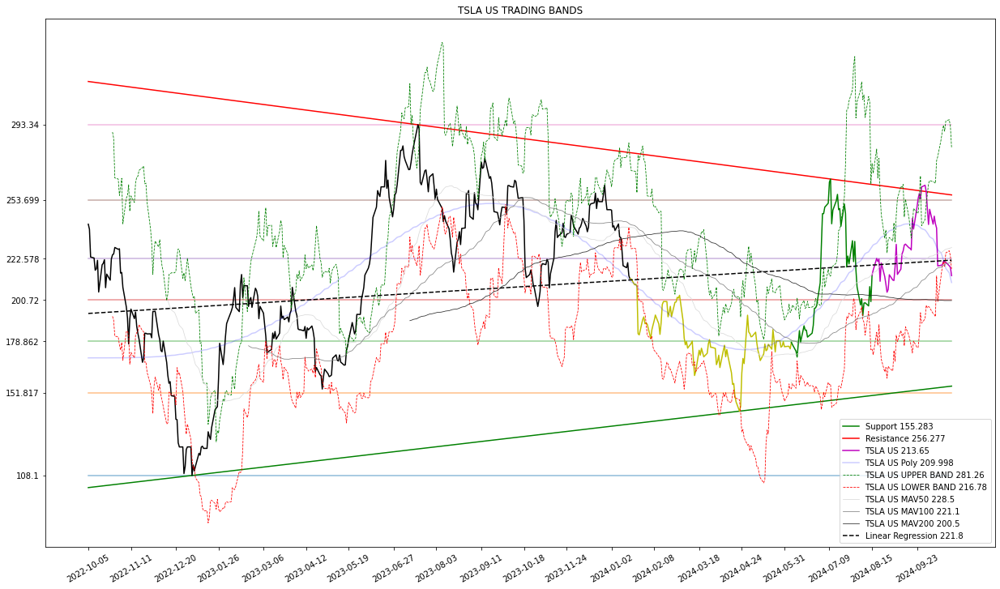

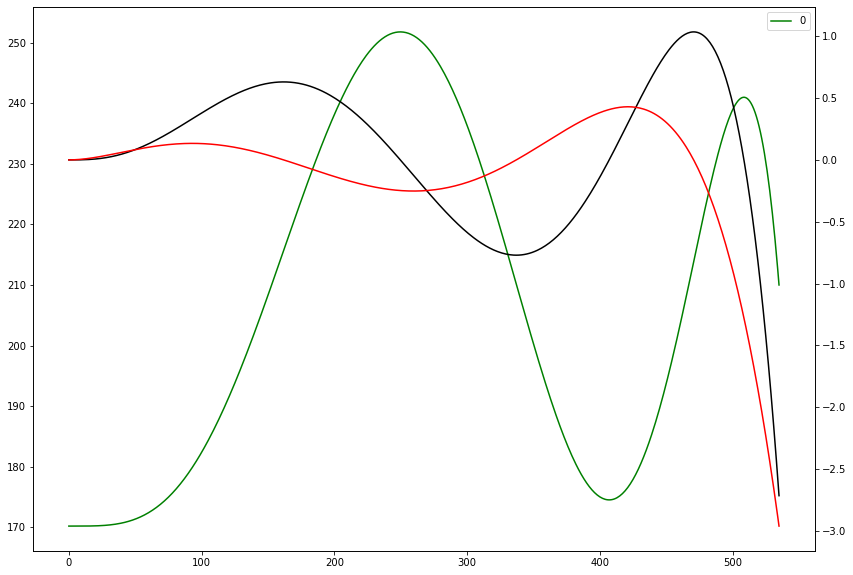

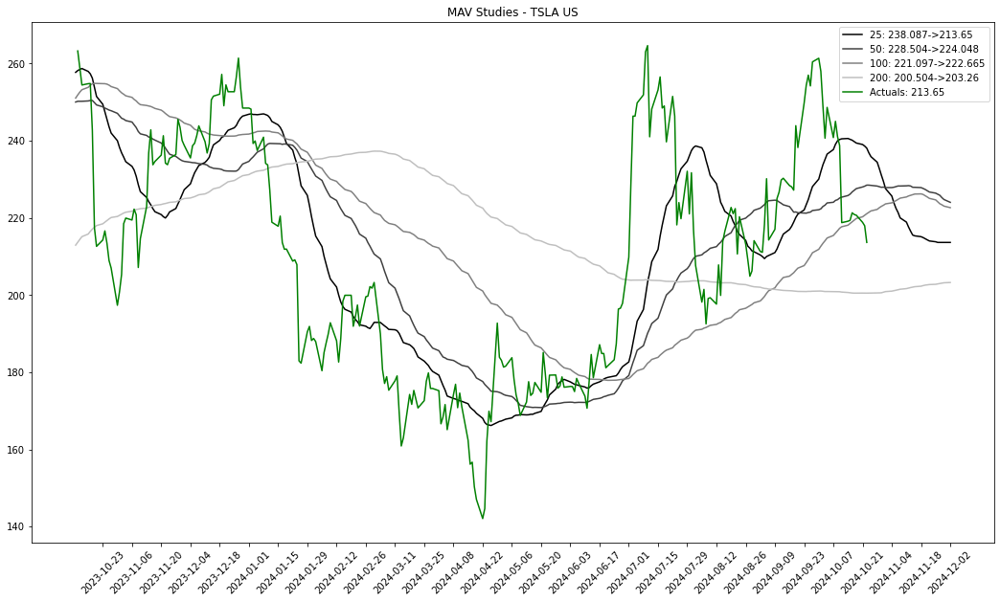

In [68]:
# Plots asset graph + bands

import pandas as pd
import numpy as np
import math
import os
import csv
import yfinance as yf
import psycopg2
import requests
import json
import tkinter as tk
import re
import matplotlib.pyplot as plt
from datetime import datetime
from datetime import timedelta
from datetime import date
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sqlalchemy import create_engine

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df 

def open_df(*args):
    open_str = args[0]
    
    query_open = 'SELECT * FROM ' + open_str
    opened_df = pd.read_sql_query(query_open, engine)
    opened_df = Set_DF(opened_df)
    opened_df = DD_Index(opened_df)
    opened_df = opened_df.sort_index(ascending = False)
    
    return opened_df

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def Bands(*args):
    
    ticker_series = args[0]
    lognormal = args[1]
    if (lognormal):
        returns_series = ticker_series.pct_change()
    else:
        returns_series = ticker_series.copy()
    vol_series = returns_series.rolling(window).std() * np.sqrt(window)
    if (lognormal):
        upper_series = ticker_series.shift(window) * (1 + vol_series * mult)
        lower_series = ticker_series.shift(window) * (1 - vol_series * mult)
    else:
        upper_series = ticker_series.shift(window) + vol_series * mult
        lower_series = ticker_series.shift(window) - vol_series * mult
        
    return upper_series, lower_series

def on_selection_field(value):
    global choice_asset
    choice_asset = value
    root.destroy()
    
def on_selection_pair(value):
    global choice_fx
    choice_fx = value
    root.destroy()    


dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = list(pd.DataFrame(tables_list, columns=['Old'])['Old'])

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = list(pd.DataFrame(tables_list, columns=['Old'])['Old'])
    
number_to_string = {'6160 HK': 'BGNE US','700 HK': 'TCEHY US','2330 TT': 'TSM US','6758 JP': 'SONY US','9868 HK': 'XPEV US'}
string_to_number = {'BGNE US': '6160 HK','TCEHY US': '700 HK','TSM US': '2330 TT','SONY US': '6758 JP','XPEV US': '9868 HK'}
clean_up = lambda x: re.sub(r'[^A-Z /^0-9]', '', str(x))
clean_up_save = lambda x: re.sub(r'[^A-Z ^0-9]', '', str(x))
int_to_str = lambda x: str(x)
str_to_int = lambda x: int(x)

today = date.today()
fibonacci_seq = [0.00, 23.60, 38.20, 50.00, 61.80, 78.60, 100.00]
fibonacci_list = []

Prices_df = open_df('prices_relation')
Prices_df.sort_index(inplace = True)

DM_Rates_df = open_df('global_rates_dm')
DM_Rates_df.sort_index(inplace = True)
rates_list = DM_Rates_df.columns.values.tolist()

FXPrices_df = open_df('fxprices_relation')
FXPrices_df.sort_index(inplace = True)
fx_list = FXPrices_df.columns.values.tolist()

fig1 = plt.figure(figsize = (21, 12))
plt.subplots_adjust(wspace = 0.1, hspace = 0.4)
ax1 = fig1.add_subplot(1, 1, 1)

ticker = input('Enter ticker: (rates for g10 rates, fx) ')
if (ticker != 'Crude Oil USD/Bbl'):
    ticker = ticker.upper()
    
if (ticker.upper() == 'RATES'):
    root = tk.Tk()
    tkvar = tk.StringVar(root)
    popupMenu = tk.OptionMenu(root, tkvar, *rates_list, command = on_selection_field)
    tk.Label(root, text = "Choose Asset: ").grid(row = 0, column = 0)
    popupMenu.grid(row = 1, column = 0)
    root.mainloop()
    ticker = choice_asset  
elif (ticker.upper() == 'FX'):
    root = tk.Tk()
    tkvar = tk.StringVar(root)
    popupMenu = tk.OptionMenu(root, tkvar, *fx_list, command = on_selection_pair)
    tk.Label(root, text = "Choose FX Pair: ").grid(row = 0, column = 0)
    popupMenu.grid(row = 1, column = 0)
    root.mainloop()
    ticker = choice_fx
    
if (ticker in DM_Rates_df.columns):
    Prices_df = DM_Rates_df.copy()
elif (ticker in FXPrices_df.columns):    
    Prices_df = FXPrices_df.copy()
    
window = int(input('Enter window (10): '))
mult = float(input('Enter std mult (0.25 FOR RATES OR 3): '))
Start_Date = input("Enter Start Date: (YY/MM/DD)")
try:
    Start_Date = today - timedelta(int(Start_Date))
except:
    Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()
End_Date = input("Enter End Date (empty for last): (YY/MM/DD)")
if (End_Date == ''):
    End_Date = Prices_df[ticker].dropna().index[-1]
else:
    End_Date = datetime.strptime(End_Date, "%y/%m/%d").date()
    
price_series = Prices_df[Prices_df.index >= Start_Date][ticker].dropna()
price_series = price_series[price_series.index <= End_Date]
    
lognormal = True
ga = True
if (ticker in DM_Rates_df.columns):
    lognormal = False
elif (ticker in Prices_df.columns):
    pass
else:
    ga = False
    
if (ga):
    upper_series = Bands(price_series, lognormal)[0]
    lower_series = Bands(price_series, lognormal)[1]
    len_f = len(price_series.index)

    mm50_df = price_series.rolling(50).mean()
    mm100_df = price_series.rolling(100).mean()
    mm200_df = price_series.rolling(200).mean()
    mm50_series = mm50_df[mm50_df.index <= End_Date]
    mm50_series = mm50_df[mm50_df.index >= Start_Date]
    mm100_series = mm100_df[mm100_df.index <= End_Date]
    mm100_series = mm100_df[mm100_df.index >= Start_Date]
    mm200_series = mm200_df[mm200_df.index <= End_Date]
    mm200_series = mm200_df[mm200_df.index >= Start_Date]

    upper_series = upper_series[upper_series.index <= End_Date]
    upper_series = upper_series[upper_series.index >= Start_Date]
    lower_series = lower_series[lower_series.index <= End_Date]
    lower_series = lower_series[lower_series.index >= Start_Date]

    ax1.set_xticks(price_series.index[::int(round(len_f / 20, 0))])        
    ax1.set_xticklabels(price_series.index[::int(round(len_f / 20, 0))], rotation = 30)
    ax1.set_title(ticker + ' TRADING BANDS')

    last_px = round(price_series.iloc[-1], 2)
    last_up = round(upper_series.iloc[-1], 2)
    last_down = round(lower_series.iloc[-1], 2)
    last_50 = round(mm50_series.iloc[-1], 2)
    last_100 = round(mm100_series.iloc[-1], 2)
    last_200 = round(mm200_series.iloc[-1], 2)

    local_max = price_series.max()
    local_min = price_series.min()
    hl_gap = (local_max - local_min)
    for f_level in fibonacci_seq:
        f_array = local_min + np.ones(len(price_series.index)) * (f_level / 100) * hl_gap
        f_series = pd.Series(f_array, index = price_series.index)
        fibonacci_list.append(round(f_series.iloc[0], 3))
        ax1.plot(f_series, alpha = 0.5)

    log = input('Log Scale? (Y/N)').upper()
    if (log == 'Y'):
        ax1.set_yscale('log')
    ax1.set_yticks(fibonacci_list)
    ax1.set_yticklabels(fibonacci_list)

    ticker_df = pd.DataFrame(price_series.values, index = np.arange(len(price_series.index)), columns = [ticker])
    p_degree = int(input('Enter poly degree (6): '))
    first_deriv = 1
    second_deriv = 2
    lin_reg = LinearRegression()
    x_Values = ticker_df.index.values.reshape(-1, 1)
    y_Values = np.array(ticker_df)    
    LR_Fit_1 = lin_reg.fit(x_Values, y_Values)
    Predictions1_df = pd.DataFrame(LR_Fit_1.predict(x_Values), index = price_series.index, columns = ['LR'])
    
    poly_features = PolynomialFeatures(degree = p_degree, include_bias = False)
    poly_X = poly_features.fit_transform(x_Values)
    LR_Fit = lin_reg.fit(poly_X, y_Values)
    Predictions_df = pd.DataFrame(LR_Fit.predict(poly_X), index = ticker_df.index, columns = ['Forecast'])
    PredictionsPlot_df = pd.DataFrame(LR_Fit.predict(poly_X), index = price_series.index, columns = ['Forecast'])

    poly_features_1d = PolynomialFeatures(degree = (p_degree - first_deriv), include_bias = False)
    poly_dX = poly_features_1d.fit_transform(x_Values)
    n, m = poly_dX.shape
    x0 = np.ones((n, 1))
    poly_dX_base = np.c_[x0, poly_dX]
    poly_deriv = np.array(list(np.poly1d(np.array(list(LR_Fit.coef_[0][::-1]) + [1])).deriv())[::-1])

    poly_features_2d = PolynomialFeatures(degree = (p_degree - second_deriv), include_bias = False)
    poly_2dX = poly_features_2d.fit_transform(x_Values)
    n2, m2 = poly_2dX.shape
    x0_2 = np.ones((n2, 1))
    poly_2dX_base = np.c_[x0_2, poly_2dX]
    poly_2deriv = np.array(list(np.poly1d(np.array(list(poly_deriv)[::-1])).deriv())[::-1])

    pd.DataFrame(poly_X.dot(LR_Fit.coef_[0]) + LR_Fit.intercept_).plot(figsize = (14, 10), c = 'g').twinx()
    plt.plot(poly_dX_base.dot(poly_deriv), c = 'k')
    plt.plot(20 * poly_2dX_base.dot(poly_2deriv), c = 'r')

    deriv01_df = pd.DataFrame(poly_dX_base.dot(poly_deriv), columns = ['Deriv 01'])
    deriv02_df = pd.DataFrame(poly_2dX_base.dot(poly_2deriv), columns = ['Deriv 02'])

    d01_df = deriv01_df.copy()
    d01_df['Abs'] = abs(d01_df['Deriv 01'])
    d01_df['Original Index'] = d01_df.index

    prev = 0
    Deriv0_pts_df = pd.DataFrame(np.nan, index = [0], columns = ['Local'])
    for idx in d01_df.index[1:]:
        if (d01_df.iloc[idx]['Deriv 01'] > 0) & (d01_df.iloc[prev]['Deriv 01'] < 0):
            Deriv0_pts_df.loc[idx] = 'Min'
        if (d01_df.iloc[idx]['Deriv 01'] < 0) & (d01_df.iloc[prev]['Deriv 01'] > 0):
            Deriv0_pts_df.loc[idx] = 'Max'
        prev = idx
    Deriv0_pts_df.drop([0], inplace = True)

    p = Deriv0_pts_df.index[0]
    lows_list = []
    highs_list = []
    sign = 1
    if (Deriv0_pts_df.loc[p][0] == 'Max'):
        sign = -1
        lows_list.append((ticker_df.loc[:p][ticker] * sign).max() * sign)
    else:
        highs_list.append((ticker_df.loc[:p][ticker] * sign).max() * sign)
    p = 0
    for i in Deriv0_pts_df.index[:-1]:
        n = Deriv0_pts_df.index[Deriv0_pts_df.index.values.tolist().index(i) + 1]
        sign = 1
        if (Deriv0_pts_df.loc[i][0] == 'Min'):
            sign = -1
            lows_list.append((ticker_df.loc[p: n][ticker] * sign).max() * sign)
        else:
            highs_list.append((ticker_df.loc[p: n][ticker] * sign).max() * sign)
        p = i  

    sign = 1
    if (len(Deriv0_pts_df.index) > 1):
        p = Deriv0_pts_df.index[-2]
        if (Deriv0_pts_df.iloc[-1][-1] == 'Max'):
            highs_list.append((ticker_df.loc[p:][ticker] * sign).max() * sign)
        else:
            sign = -1
            lows_list.append((ticker_df.loc[p:][ticker] * sign).max() * sign)
        lows_df = pd.DataFrame(lows_list, index = np.arange(len(lows_list)), columns = ['Levels'])
        highs_df = pd.DataFrame(highs_list, index = np.arange(len(highs_list)), columns = ['Levels'])
        lows_df['Positions'] = np.nan
        highs_df['Positions'] = np.nan
        for idx in lows_df.index:
            lows_df.loc[idx, 'Positions'] = ticker_df[ticker_df[ticker] == lows_list[idx]].index[0]
        for idx in highs_df.index:
            highs_df.loc[idx, 'Positions'] = ticker_df[ticker_df[ticker] == highs_list[idx]].index[0]    

        if (len(lows_df.index) > 1):  
            for j in np.arange(lows_df.shape[0] - 1):
                base_x = lows_df.loc[j, 'Positions']
                base_y = lows_df.loc[j, 'Levels']
                for i, curr in enumerate(lows_df.index[(j + 1):]):
                    lx_values = np.array([base_x, lows_df.loc[curr, 'Positions']]).reshape(-1, 1)
                    ly_values = np.array([base_y, lows_df.loc[curr, 'Levels']])
                    Low_Fit = lin_reg.fit(lx_values, ly_values)
                    lx_values = np.array([Predictions_df.index[0], base_x, lows_df.loc[curr, 'Positions'], Predictions_df.index[-1]]).reshape(-1, 1)
                    Low_df = pd.DataFrame(Low_Fit.predict(lx_values), index = [Predictions_df.index[0], base_x, lows_df.loc[curr, 'Positions'], Predictions_df.index[-1]], columns = ['Low'])
                    Low_df.index = Low_df.T.columns.map(lambda x: price_series.index[int(x)]).T
                    ax1.plot(Low_df, c = 'g', label = 'Support ' + str(round(Low_df.iloc[-1][0], 3)))

        if (len(highs_df.index) > 1): 
            for j in np.arange(highs_df.shape[0] - 1):
                base_x = highs_df.loc[j, 'Positions']
                base_y = highs_df.loc[j, 'Levels']
                for i, curr in enumerate(highs_df.index[(j + 1):]):
                    lx_values = np.array([base_x, highs_df.loc[curr, 'Positions']]).reshape(-1, 1)
                    ly_values = np.array([base_y, highs_df.loc[curr, 'Levels']])
                    High_Fit = lin_reg.fit(lx_values, ly_values)
                    lx_values = np.array([Predictions_df.index[0], base_x, highs_df.loc[curr, 'Positions'], Predictions_df.index[-1]]).reshape(-1, 1)
                    High_df = pd.DataFrame(High_Fit.predict(lx_values), index = [Predictions_df.index[0], base_x, highs_df.loc[curr, 'Positions'], Predictions_df.index[-1]], columns = ['High'])
                    High_df.index = High_df.T.columns.map(lambda x: price_series.index[int(x)]).T
                    ax1.plot(High_df, c = 'r', label = 'Resistance ' + str(round(High_df.iloc[-1][0], 3)))


    len_series = len(price_series.index)
    if (len_series > 200):
        ax1.plot(price_series[:-199], color = 'k')
        ax1.plot(price_series[-200:-99], color = 'y')
        ax1.plot(price_series[-100:-49], color = 'g')
        ax1.plot(price_series[-50:], color = 'm', label = ticker + ' ' + str(last_px))
    elif (len_series > 100):
        ax1.plot(price_series[:-99], color = 'k')
        ax1.plot(price_series[-100:-49], color = 'g')
        ax1.plot(price_series[-50:], color = 'm', label = ticker + ' ' + str(last_px))
    elif (len_series > 50):
        ax1.plot(price_series[:-49], color = 'k')
        ax1.plot(price_series[-50:], color = 'm', label = ticker + ' ' + str(last_px))
    else:
        ax1.plot(price_series, color = 'k', label = ticker + ' ' + str(last_px))
    ax1.plot(PredictionsPlot_df, c = 'b', alpha = 0.2, label = ticker + ' Poly ' + str(round(PredictionsPlot_df['Forecast'][-1], 3)))
    ax1.plot(upper_series, color = 'g', label = ticker + ' UPPER BAND ' + str(last_up), linestyle = 'dashed', linewidth = 0.8)
    ax1.plot(lower_series, color = 'r', label = ticker + ' LOWER BAND ' + str(last_down), linestyle = 'dashed', linewidth = 0.8)
    ax1.plot(mm50_series, color = '0.85', label = ticker + ' MAV50 ' + str(last_50), linewidth = 0.75)
    ax1.plot(mm100_series, color = '0.50', label = ticker + ' MAV100 ' + str(last_100), linewidth = 0.75)
    ax1.plot(mm200_series, color = '0.15', label = ticker + ' MAV200 ' + str(last_200), linewidth = 0.75)
    ax1.plot(Predictions1_df, color = 'k', label = 'Linear Regression ' + str(round(Predictions1_df.iloc[-1][0], 2)), linestyle = 'dashed')
#   ax1.set_ylim(price_series.min() * .75, price_series.max() * 1.25)
    ax1.legend(loc = 'best')

    fig2 = plt.figure(figsize = (18, 10))
    ax2 = fig2.add_subplot(1, 1, 1)
    shift_d = 40
    starting_p = 300

    ttoday = price_series.index[-1]
    comp_df = pd.DataFrame(price_series.iloc[-1], index = pd.date_range(ttoday + timedelta(1), ttoday + timedelta(shift_d), freq = 'B').date, columns = [price_series.name])
    merged_df = pd.concat([pd.DataFrame(price_series), comp_df])
    merged_df.sort_index(inplace = True)
    mav25sample_df = merged_df.rolling(25).mean()[-starting_p:]
    mav50sample_df = merged_df.rolling(50).mean()[-starting_p:]
    mav100sample_df = merged_df.rolling(100).mean()[-starting_p:]
    mav200sample_df = merged_df.rolling(200).mean()[-starting_p:]
    pxslice_df = price_series[price_series.index > mav25sample_df.index[0]]
    ax2.plot(mav25sample_df, label = '25: ' + str(round(mav25sample_df.loc[ttoday][0], 3)) + '->' + str(round(mav25sample_df.iloc[-1][0], 3)), c = '0')
    ax2.plot(mav50sample_df, label = '50: ' + str(round(mav50sample_df.loc[ttoday][0], 3)) + '->' + str(round(mav50sample_df.iloc[-1][0], 3)), c = '0.25')
    ax2.plot(mav100sample_df, label = '100: ' + str(round(mav100sample_df.loc[ttoday][0], 3)) + '->' + str(round(mav100sample_df.iloc[-1][0], 3)), c = '0.50')
    ax2.plot(mav200sample_df, label = '200: ' + str(round(mav200sample_df.loc[ttoday][0], 3)) + '->' + str(round(mav200sample_df.iloc[-1][0], 3)), c = '0.75')
    ax2.plot(pxslice_df, label = 'Actuals: ' + str(round(pxslice_df.iloc[-1], 3)), c = 'g')
    ax2.set_xticks(mav25sample_df.index[::-10])
    ax2.set_xticklabels(mav25sample_df.index[::-10], rotation = 45)
    ax2.set_title('MAV Studies - ' + ticker)
    ax2.legend(loc = 'best')

STD Scaling? (Y/y or empty) 
Log Scaling? (Y/y or empty) 
Enter asset 1: (empty to finish, RATES, FX, MACRO) QQQ US
Multi-year same asset analysis? (Y/y or empty) Y
Enter Year: (YYYY) 2000
Sequential Years? (Y/y or empty) Y

Correlations vs 2024: 
         20     40     60    100    180  Average Corr  Corr Score
2000  26.43  12.46   7.00   4.00   5.38         11.05       37.48
2001 -10.92   1.07  13.07   3.32   2.65          1.84       14.91
2002  50.37  24.94  15.30  22.08  18.28         26.19       76.56
2003  10.33   0.94  10.84   7.64   0.36          6.02       16.86
2004 -12.40  15.10  21.86  17.37  11.48         10.68       32.54
2005  13.99  -7.67  -8.04  -5.96   5.95         -0.35       13.64
2006  -2.82  -2.03   8.25   9.63   2.74          3.15       12.78
2007  14.80  13.79 -12.60  -0.36  -3.92          2.34       17.14
2008  21.60  23.94  13.25  12.54   8.34         15.93       39.87
2009   0.42 -13.83   2.84   1.64  10.22          0.26       10.48
2010  28.46  13.71  -4.54 

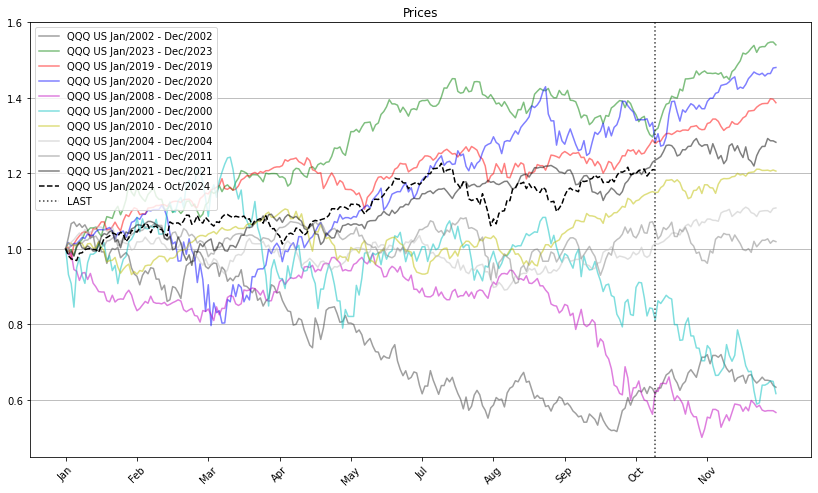


PREVIOUS QQQ US RETURNS (% to last trading day):

       C Score  Prev W  Prev M  YTD ttl  YTD DD  Y ttl
2002     76.56   -0.91   15.44   -38.52  -42.60  -36.7
2023     60.48   -2.47   -2.68    31.34   -9.47  54.03
2019     48.62    2.18    3.83    27.85   -0.77   38.7
2020     44.55   -4.42   -1.56    28.26  -10.28  48.04
2008     39.87    1.21  -15.76   -37.66  -37.66 -43.39
2000     37.48  -10.93  -13.50   -18.98  -34.81 -38.39
2010     33.98    1.05    6.34    14.89   -0.23  20.58
2004     32.54    0.98    5.36     1.37   -4.22  10.82
2011     30.85   -0.92   10.40     5.35   -2.64   1.89
2021     28.17    3.21    7.86    23.50    0.49  28.22
Mean     43.31   -1.10    1.57     3.74  -14.22   8.38
Median   38.67    0.03    4.60    10.12   -6.85   15.7
2024             -0.03    1.76    20.95   -1.39       

EXPECTED QQQ US RETURNS (% from last trading day):

       C Score  Next D Next W  Next M  2nd M fwd 3rd M fwd    RoP  Mid DD
2002     76.56    2.05   9.11   16.68      -9.42    

In [20]:
#SUPERPOSING GRAPHS

import pandas as pd
import numpy as np
import math
import os
import csv
import yfinance as yf
import psycopg2
import requests
import json
import tkinter as tk
import re
import matplotlib.pyplot as plt
from datetime import datetime
from datetime import timedelta
from datetime import date
from sklearn.linear_model import LinearRegression
from sqlalchemy import create_engine

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df 

def open_df(*args):
    open_str = args[0]
    
    query_open = 'SELECT * FROM ' + open_str
    opened_df = pd.read_sql_query(query_open, engine)
    opened_df = Set_DF(opened_df)
    opened_df = DD_Index(opened_df)
    
    return opened_df

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def Bands(ticker_series):
    
    returns_series = ticker_series.pct_change()
    vol_series = returns_series.ewm(halflife = 100).std() * np.sqrt(window)
    upper_series = ticker_series.shift(window) * (1 + vol_series * mult)
    lower_series = ticker_series.shift(window) * (1 - vol_series * mult)
    
    return upper_series, lower_series

def open_df(*args):
    open_str = args[0]
    
    query_open = 'SELECT * FROM ' + open_str
    opened_df = pd.read_sql_query(query_open, engine)
    opened_df = Set_DF(opened_df)
    opened_df = DD_Index(opened_df)
    opened_df = opened_df.sort_index()
    
    return opened_df

def on_selection_field(value):
    global choice_asset
    choice_asset = value
    root.destroy()
    
def on_selection_region(value):
    global choice_region
    choice_region = value
    root.destroy()    
    
def on_selection_sf(value):
    global choice_sf
    choice_sf = value
    root.destroy()    


dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

corr_floor = 50
corr_window = 20
c_limit = 30
sl_size = 10
corrW_l = [20, 40, 60, 100, 180]
today = date.today()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = list(pd.DataFrame(tables_list, columns=['Old'])['Old'])

try:
    Prices_df.index = Prices_df.T.columns.map(lambda x: x.date())
except:
    pass

stock_features_list = ['Prices', 'NTM P/E', 'NTM P/OI', 'NTM P/S', 'G E', 'G OI', 'G S', 'PEG1', 'PEG2', 'PEG3']

DM_Rates_df = open_df('global_rates_dm')
DM_Rates_df.sort_index(inplace = True)
country_macro_df = open_df('us_macro')
Prices_df = open_df('prices_relation')

FX_Prices_df = open_df('fxprices_relation')
FX_Pairs_List = FX_Prices_df.columns.tolist()
vayf_df = open_df('va_yf')

Color_dict = {1: '0.25', 2: 'g', 3: 'r', 4: 'b', 5: 'm', 6: 'c', 7: 'y', 8: '0.75', 9: '0.50', 10: 'k'}
figs = plt.figure(figsize = (14, 8))
axs = figs.add_subplot(1, 1, 1)
assets_list = pd.unique(Prices_df.T[Prices_df.columns.map(lambda x: x.find('USGG')) == -1].index.values.tolist() + DM_Rates_df.columns.values.tolist())
rates_list = DM_Rates_df.columns.values.tolist()
fx_list = FX_Prices_df.columns.values.tolist()

scaling = input('STD Scaling? (Y/y or empty) ').upper()
log = input('Log Scaling? (Y/y or empty) ').upper()

add_another = True
sa_analysis = False
sequential_years = False
stop = False
count = 0
comp_c = 0
choice_sf = 'Prices'
dates_df = pd.DataFrame(np.nan, index = ['dummy'], columns = ['St Dates', 'End Dates'])
while (add_another):
    count = count + 1
    if (count > c_limit):
        add_another = False
    if (not sa_analysis):
        ticker = input('Enter asset ' + str(count) + ': (empty to finish, RATES, FX, MACRO) ').upper()
        if (ticker == ''):
            add_another =  False
        else:
            add_another = True
            ticker_YF = ticker
            try:
                ticker_YF = vayf_df.loc[ticker, 'YF Ticker']
            except:
                pass
        if (ticker == 'RATES'):
            root = tk.Tk()
            tkvar = tk.StringVar(root)
            popupMenu = tk.OptionMenu(root, tkvar, *rates_list, command = on_selection_field)
            tk.Label(root, text = "Choose Asset: ").grid(row = 0, column = 0)
            popupMenu.grid(row = 1, column = 0)
            root.mainloop()
            ticker = choice_asset
            add_another = True
        elif (ticker == 'FX'):
            root = tk.Tk()
            tkvar = tk.StringVar(root)
            popupMenu = tk.OptionMenu(root, tkvar, *fx_list, command = on_selection_field)
            tk.Label(root, text = "Choose Asset: ").grid(row = 0, column = 0)
            popupMenu.grid(row = 1, column = 0)
            root.mainloop()
            ticker = choice_asset
            add_another = True
        elif (ticker == 'MACRO'):
            region_l = ['AU', 'CA', 'ES', 'EA', 'FR', 'DE', 'IT', 'GB', 'US']            
            root = tk.Tk()
            tkvar = tk.StringVar(root)
            popupMenu = tk.OptionMenu(root, tkvar, *region_l, command = on_selection_region)
            tk.Label(root, text = "Choose Region: ").grid(row = 0, column = 0)
            popupMenu.grid(row = 1, column = 0)
            root.mainloop()                                               
            macro_list = sorted(country_macro_df.columns.values.tolist())            
            country_macro_df = open_df(choice_region + '_macro')
            root = tk.Tk()
            tkvar = tk.StringVar(root)
            popupMenu = tk.OptionMenu(root, tkvar, *macro_list, command = on_selection_field)
            tk.Label(root, text = "Choose Asset: ").grid(row = 0, column = 0)
            popupMenu.grid(row = 1, column = 0)
            root.mainloop()
            ticker = choice_asset
            add_another = True
        else:
            if (count == 1):
                root = tk.Tk()
                tkvar = tk.StringVar(root)
                popupMenu = tk.OptionMenu(root, tkvar, *stock_features_list, command = on_selection_sf)
                tk.Label(root, text = "Choose stock feature: ").grid(row = 0, column = 0)
                popupMenu.grid(row = 1, column = 0)
                root.mainloop()
        if (count == 1):
            mysa_s = input('Multi-year same asset analysis? (Y/y or empty) ').upper()
            if (mysa_s == 'Y'):
                sa_analysis = True     
                comp_c = 252 - Prices_df[Prices_df.index >= datetime(today.year, 1, 1).date()].shape[0]
    if (add_another):
        if (not sa_analysis):
            start_date_s = input('Enter Start Date: (YY/MM/DD)')
            if (start_date_s == ''):
                if (ticker in Prices_df.columns):
                    start_date = Prices_df.index[0]
                elif (ticker in DM_Rates_df.columns):
                    start_date = DM_Rates_df.index[0]
                elif (ticker in FX_Prices_df.columns):
                    start_date = FX_Prices_df.index[0]
                elif (ticker in country_macro_df.columns):
                    start_date = country_macro_df.index[0]
            else:
                start_date = datetime.strptime(start_date_s, '%y/%m/%d').date()
                if (ticker in Prices_df.columns):
                    start_date = Prices_df[Prices_df.index >= start_date].index[0]
                elif (ticker in DM_Rates_df.columns):
                    start_date = DM_Rates_df[DM_Rates_df.index >= start_date].index[0]
                elif (ticker in FX_Prices_df.columns):
                    start_date = FX_Prices_df[FX_Prices_df.index >= start_date].index[0]
                elif (ticker in country_macro_df.columns):
                    start_date = country_macro_df[country_macro_df.index >= start_date].index[0]
                else:
                    print('N/A')
            if (count == 1):
                end_date_s = input('Enter End Date: (YY/MM/DD)')
            else:
                if (leng < len(First_series[First_series.index >= start_date].index)):
                    eq_end = First_series.index[First_series.index.values.tolist().index(start_date) + leng]
                else:
                    eq_end = Prices_df.index[-1]
                end_date_s = input('Enter End Date (' + eq_end.strftime('%y/%m/%d') + '): (YY/MM/DD)')
            if (end_date_s == ''):
                if (ticker in Prices_df.columns):
                    end_date = Prices_df.index[-1]
                elif (ticker in DM_Rates_df.columns):
                    end_date = DM_Rates_df.index[-1]
                elif (ticker in FX_Prices_df.columns):
                    end_date = FX_Prices_df.index[-1]
                elif (ticker in country_macro_df.columns):
                    end_date = country_macro_df.index[-1]
                else:
                    print('N/A')
            else:
                end_date = datetime.strptime(end_date_s, '%y/%m/%d').date()
                if (ticker in Prices_df.columns):
                    end_date = Prices_df[Prices_df.index <= end_date].index[-1]
                elif (ticker in DM_Rates_df.columns):
                    end_date = DM_Rates_df[DM_Rates_df.index <= end_date].index[-1]
                elif (ticker in FX_Prices_df.columns):
                    end_date = FX_Prices_df[FX_Prices_df.index <= end_date].index[-1]
                elif (ticker in country_macro_df.columns):
                    end_date = country_macro_df[country_macro_df.index <= end_date].index[-1]
                else:
                    print('N/A')  
        else:
            if (not sequential_years):
                period_start_s = input('Enter Year: (YYYY) ')
                if (period_start_s != ''):
                    period_start = int(period_start_s)
                    start_date = datetime(period_start, 1, 1).date()
                    end_date = datetime(period_start, 12, 31).date()
                else:
                    add_another = False
                if (count == 1):
                    seq_years = input('Sequential Years? (Y/y or empty) ').upper()
                if (seq_years == 'Y'):
                    sequential_years = True
            else:
                start_date = datetime(int(period_start) + count - 1, 1, 1).date()
                end_date = datetime(int(period_start) + count - 1, 12, 31).date()
                if ((int(period_start) + count - 1) > datetime.today().year):
                    stop = True
                    add_another = False
            if (count == c_limit) | (period_start_s == ''):
                start_date = datetime(datetime.today().year, 1, 1).date()
                end_date = datetime(datetime.today().year, 12, 31).date()
            if (ticker in Prices_df.columns) & (not stop):
                start_date = Prices_df[Prices_df.index >= start_date].index[0]
                end_date = Prices_df[Prices_df.index <= end_date].index[-1]
            elif (ticker in DM_Rates_df.columns) & (not stop):
                start_date = DM_Rates_df[DM_Rates_df.index >= start_date].index[0]
                end_date = DM_Rates_df[DM_Rates_df.index <= end_date].index[-1]
            elif (ticker in FX_Prices_df.columns) & (not stop):
                start_date = FX_Prices_df[FX_Prices_df.index >= start_date].index[0]
                end_date = FX_Prices_df[FX_Prices_df.index <= end_date].index[-1]
            elif (ticker in country_macro_df.columns) & (not stop):
                start_date = country_macro_df[country_macro_df.index >= start_date].index[0]
                end_date = country_macro_df[country_macro_df.index <= end_date].index[-1] 
        stC_date = start_date        
        if (start_date > Prices_df.index[-1]):
            add_another = False
            stop = True
        if (not stop):
            if (sa_analysis):
                stC_date = Prices_df.index[Prices_df.index.tolist().index(start_date) - comp_c]            
            if (ticker in Prices_df.columns):
                if (choice_sf == 'Prices'):
                    Px_series = Prices_df[Prices_df.index >= start_date][ticker].dropna()
                    Px_series = Px_series[Px_series.index <= end_date]
                    Px_seriesC = Prices_df[Prices_df.index >= stC_date][Prices_df[Prices_df.index >= stC_date].index <= end_date][ticker].dropna()
                else:
                    try:
                        stock_sql = re.sub(r' ', '', ticker.lower())
                        Px_series = open_df(stock_sql + '_metrics')
                        Px_series = Px_series[Px_series.index >= start_date][choice_sf].dropna()
                        Px_series = Px_series[Px_series.index <= end_date]  
                        Px_seriesC = Prices_df[Prices_df.index >= stC_date][Prices_df[Prices_df.index >= stC_date].index <= end_date][choice_sf].dropna()
                    except:
                        print('No metrics available for ' + ticker)

            elif (ticker in DM_Rates_df.columns) & (not stop):
                Px_series = DM_Rates_df[DM_Rates_df.index >= start_date][ticker].dropna()
                Px_series = Px_series[Px_series.index <= end_date]
                Px_seriesC = Prices_df[Prices_df.index >= stC_date][Prices_df[Prices_df.index >= stC_date].index <= end_date][ticker].dropna()
            elif (ticker in FX_Prices_df.columns) & (not stop):
                Px_series = FX_Prices_df[FX_Prices_df.index >= start_date][ticker].dropna()
                Px_series = Px_series[Px_series.index <= end_date]
                Px_seriesC = FX_Prices_df[FX_Prices_df.index >= stC_date][FX_Prices_df[FX_Prices_df.index >= stC_date].index <= end_date][ticker].dropna()
            elif (ticker in country_macro_df.columns) & (not stop):
                Px_series = country_macro_df[country_macro_df.index >= start_date][ticker].dropna()
                Px_series = Px_series[Px_series.index <= end_date]
                Px_seriesC = country_macro_df[country_macro_df.index >= stC_date][country_macro_df[country_macro_df.index >= stC_date].index <= end_date][ticker].dropna()
                Px_series.index = Px_series.index.map(lambda x: datetime(x.year, x.month, x.day))
                Px_seriesC.index = Px_seriesC.index.map(lambda x: datetime(x.year, x.month, x.day))
                Px_series = Px_series.resample('M').last()
                Px_seriesC = Px_seriesC.resample('M').last()
            if (scaling == 'Y'):
                Current_series = pd.Series(((Px_series / Px_series.std()) / (Px_series / Px_series.std())[0]).values, index = np.arange(len(Px_series)))
            else:
                Current_series = pd.Series(Px_series.values, index = np.arange(len(Px_series)))     
            Current_seriesC = pd.Series(Px_seriesC.values, index = np.arange(len(Px_seriesC)))
            if (end_date == Prices_df.index[-1]) & (ticker not in FX_Prices_df.columns):
                ticker_data = yf.Ticker(ticker_YF)
                ticker_data_df = ticker_data.history(start = today - timedelta(days = 10), end = today + timedelta(days = 1), interval = "15m")
                ticker_df = pd.DataFrame(ticker_data_df['Close'].values, index = np.arange(len(ticker_data_df.index)), columns = [ticker])
                Current_series.loc[Current_series.index[-1] + 1] = ticker_data_df['Close'][-1]   
            if (count == 1):
                First_series = Px_series.copy()
                if (sa_analysis):  
                    axisX_index = First_series.index.map(lambda x: x.strftime('%b'))
                else:
                    axisX_index = First_series.index.map(lambda x: x.strftime('%b-%Y'))
                leng = len(First_series.index)   
                if (sa_analysis):
                    cumulative_df = pd.DataFrame(Current_series.values, index = Current_series.index, columns = ['Series 1'])
                    dates_df.loc['Series 1'] = [start_date, end_date]
                else:
                    cumulative_df = pd.DataFrame(Current_series.values, index = Current_series.index, columns = [ticker])
                    dates_df.loc[ticker] = [start_date, end_date]
                cumulativeC_df = pd.DataFrame(Current_seriesC.values, index = Current_seriesC.index, columns = ['Series 1']) 
                if (choice_sf == 'Prices'):
                    Current_series /= Current_series.iloc[0]                 
            else:
                if (sa_analysis):
                    Current_series.name = 'Series ' + str(count)
                    dates_df.loc['Series ' + str(count)] = [start_date, end_date]
                else:
                    Current_series.name = ticker
                    dates_df.loc[ticker] = [start_date, end_date]
                if (choice_sf == 'Prices'):
                    Current_series /= Current_series.iloc[0]                     
                Current_seriesC.name = 'Series ' + str(count)
                try:
                    cumulative_df = cumulative_df.join(Current_series)
                    cumulativeC_df = cumulativeC_df.join(Current_seriesC)                
                except:
                    cumulative_df = cumulative_df.join(Current_series, rsuffix = ': ' + start_date.strftime('%d%b%y') + '-' + 
                                                       end_date.strftime('%d%b%y'))
                    cumulativeC_df = cumulativeC_df.join(Current_seriesC, rsuffix = ': ' + start_date.strftime('%d%b%y') + '-' + 
                                                         end_date.strftime('%d%b%y'))               
            
dates_df = dates_df.drop(['dummy'])  
cumulativeC_df = cumulativeC_df.dropna() / cumulativeC_df.dropna().iloc[0]
Scumulative_df = cumulative_df.copy()
last_series = cumulative_df.columns[-1]
idx = 0
if (count > 1):
    if (sa_analysis):
        pt_zero = cumulative_df.T.iloc[-1].T.dropna().index[-1]
        pf_1w = pt_zero - 5
        pf_1m = pt_zero - 21
        pt_1d = pt_zero + 1
        pt_1w = pt_zero + 5
        pt_1m = pt_zero + 21
        pt_2m = pt_zero + 42
        pt_3m = pt_zero + 63
        mid1_st = 100
        mid1_end = 175
        mid2_st = 125
        mid2_end = 200        

        rollingCorr_df = pd.DataFrame(np.nan, index = cumulativeC_df.columns.tolist()[:-1], columns = corrW_l)
        cumulativeC_df = cumulativeC_df.pct_change().dropna()
        for idx, ser in enumerate(cumulativeC_df.columns.values.tolist()[:-1]):   
            for c_corrW in corrW_l:    
                try:
                    rolling_corr = round((100 * cumulativeC_df[cumulativeC_df.columns[-1]][-c_corrW: ].corr(cumulativeC_df[cumulativeC_df.columns[idx]][-c_corrW: ])), 2)
                except:
                    print('Corr ' + str(c_corrW) + ' failed')
                rollingCorr_df.loc[ser, c_corrW] = rolling_corr

        rollingCorr_df = rollingCorr_df.T.dropna().T
        rollingCorr_df['Average Corr'] = rollingCorr_df.mean(axis = 1).map(lambda x: round(x, 2))
        rollingCorr_df['Corr Score'] = (rollingCorr_df['Average Corr'] + rollingCorr_df.max(axis = 1)).map(lambda x: round(min(100, x), 2))
        rollingCorrP_df = rollingCorr_df.copy()
        if (sa_analysis):
            rollingCorrP_df.index = rollingCorrP_df.index.map(lambda x: dates_df.loc[x, 'St Dates'].strftime('%Y'))    
        print('')
        print('Correlations vs ' + str(today.year) + ': ')
        print(rollingCorrP_df)
        print('')

        corr_floor = min(np.quantile(rollingCorr_df['Corr Score'].values, q = 0.6), corr_floor)
        seriesF_l = rollingCorr_df[rollingCorr_df['Corr Score'] >= corr_floor].sort_values(by = ['Corr Score'], ascending = False)[: sl_size].index.tolist()            
        Scumulative_df = cumulative_df[seriesF_l]    
        expRet_df = pd.DataFrame(np.nan, index = Scumulative_df.columns, columns = ['C Score', 'Next D', 'Next W', 'Next M', 
                                                                                    '2nd M fwd', '3rd M fwd', 'RoP', 'Mid DD'])
        prevRet_df = pd.DataFrame(np.nan, index = Scumulative_df.columns, columns = ['C Score', 'Prev W', 'Prev M', 'YTD ttl', 
                                                                                     'YTD DD', 'Y ttl'])        
        for idx, ccol in enumerate(Scumulative_df.columns):
            idx += 1        
            Current_series = Scumulative_df[ccol].fillna(method = 'ffill')
            corr_score = rollingCorr_df.loc[ccol, 'Corr Score']
            expRet_df.loc[ccol, 'C Score'] = round(corr_score, 2)
            prevRet_df.loc[ccol, 'C Score'] = round(corr_score, 2)
            expRet_df.loc[ccol, 'Next D'] = round(corr_score * (Current_series.iloc[pt_1d] / 
                                                                Current_series.iloc[pt_zero] - 1), 2)
            try:
                prevRet_df.loc[ccol, 'YTD ttl'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                               Current_series.iloc[0] - 1), 2)
            except:
                pass   
            try:
                prevRet_df.loc[ccol, 'Y ttl'] = round(100 * (Current_series.iloc[-1] / 
                                                             Current_series.iloc[0] - 1), 2)
            except:
                pass               
            try:
                prevRet_df.loc[ccol, 'YTD DD'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                              Current_series[:pt_zero].max() - 1), 2)
            except:
                pass                
            try:
                prevRet_df.loc[ccol, 'Prev W'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                              Current_series.iloc[pf_1w] - 1), 2)
            except:
                pass    
            try:
                prevRet_df.loc[ccol, 'Prev M'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                              Current_series.iloc[pf_1m] - 1), 2)
            except:
                pass                
            try:
                expRet_df.loc[ccol, 'Next W'] = round(100 * (Current_series.iloc[pt_1w] / 
                                                                    Current_series.iloc[pt_zero] - 1), 2)
            except:
                pass
            try:
                expRet_df.loc[ccol, 'Next M'] = round(100 * (Current_series.iloc[pt_1m] / 
                                                                    Current_series.iloc[pt_zero] - 1), 2)
            except:
                pass
            try:
                expRet_df.loc[ccol, '2nd M fwd'] = round(100 * (Current_series.iloc[pt_2m] / 
                                                                       Current_series.iloc[pt_1m] - 1), 2)        
            except:
                pass
            try:
                expRet_df.loc[ccol, '3rd M fwd'] = round(100 * (Current_series.iloc[pt_3m] / 
                                                                       Current_series.iloc[pt_2m] - 1), 2)        
            except:
                pass
            try:
                expRet_df.loc[ccol, 'RoP'] = round(100 * (Current_series.iloc[-1] / 
                                                                 Current_series.iloc[pt_3m] - 1), 2) 
            except:
                try:
                    expRet_df.loc[ccol, 'RoP'] = round(100 * (Current_series.iloc[-1] / 
                                                                     Current_series.iloc[pt_2m] - 1), 2)
                except:
                    try:
                        expRet_df.loc[ccol, 'RoP'] = round(100 * (Current_series.iloc[-1] / 
                                                                         Current_series.iloc[pt_1m] - 1), 2)
                    except:
                        expRet_df.loc[ccol, 'RoP'] = round(100 * (Current_series.iloc[-1] / 
                                                                         Current_series.iloc[pt_zero] - 1), 2)   
            try:
                expRet_df.loc[ccol, 'Mid DD'] = round(100 * (Current_series[mid2_st: min(mid2_end, Current_series.shape[0])].min() / 
                                                             Current_series[mid1_st: min(mid1_end, Current_series.shape[0])].max() - 1), 2)              
            except:
                pass                        

        short_list = expRet_df.sort_values(by = ['C Score'], ascending = False)[: sl_size].index.tolist()    
        for idx, c_yearS in enumerate(short_list):
            idx += 1
            Current_series = Scumulative_df[c_yearS]
            axs.plot(Current_series, c = Color_dict[idx], label = ticker + ' ' + dates_df.loc[c_yearS, 'St Dates'].strftime('%b/%Y') + 
                     ' - ' + dates_df.loc[c_yearS, 'End Dates'].strftime('%b/%Y'), alpha = 0.5)   

        expRet_df = expRet_df.dropna(how = 'all')
        if (sa_analysis):
            expRet_df.index = expRet_df.index.map(lambda x: dates_df.loc[x, 'St Dates'].strftime('%Y'))
            prevRet_df.index = prevRet_df.index.map(lambda x: dates_df.loc[x, 'St Dates'].strftime('%Y'))
        expRet_df.loc['Mean'] = round(expRet_df.mean(), 2)
        expRet_df.loc['Median'] = round(expRet_df.drop('Mean').median(), 2)
        expRet_df.loc['Up %'] = round(100 * expRet_df.drop(['Mean', 'Median'])[expRet_df.drop(['Mean', 'Median']) < 0].isna().sum() / 
                                      expRet_df.drop(['Mean', 'Median']).shape[0], 2)
        expRet_df.loc['Up %'] = expRet_df.loc['Up %'].replace({100: ''})
        expRet_df = expRet_df.fillna('')
        
        prevRet_df.loc['Mean'] = round(prevRet_df.mean(), 2)
        prevRet_df.loc['Median'] = round(prevRet_df.drop('Mean').median(), 2)
        prevRet_df = prevRet_df.fillna('')        
    else:
        for idx, ccol in enumerate(Scumulative_df.columns):
            idx += 1 
            Current_series = Scumulative_df[ccol]
            axs.plot(Current_series, c = Color_dict[idx], label = Scumulative_df.columns[idx - 1])
            plt.text(Current_series.index[-1], Current_series.iloc[-1], Scumulative_df.columns[idx - 1])
            
            
if (sa_analysis):        
    Current_series = cumulative_df.T.loc[last_series].T.dropna()
    prevRet_df.loc[str(today.year)] = np.nan
    try:
        prevRet_df.loc[str(today.year), 'YTD ttl'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                                  Current_series.iloc[0] - 1), 2)
    except:
        pass   
    try:
        prevRet_df.loc[str(today.year), 'YTD DD'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                                 Current_series.max() - 1), 2)
    except:
        pass                
    try:
        prevRet_df.loc[str(today.year), 'Prev W'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                                 Current_series.iloc[pf_1w] - 1), 2)
    except:
        pass    
    try:
        prevRet_df.loc[str(today.year), 'Prev M'] = round(100 * (Current_series.iloc[pt_zero] / 
                                                                 Current_series.iloc[pf_1m] - 1), 2)
    except:
        pass     
    prevRet_df = prevRet_df.fillna('')
    axs.plot(Current_series, c = 'k', linestyle = 'dashed', label = ticker + ' ' + dates_df.loc[cumulative_df.columns[-1], 'St Dates'].strftime('%b/%Y') + 
             ' - ' + dates_df.loc[cumulative_df.columns[-1], 'End Dates'].strftime('%b/%Y'))        
if (log == 'Y'):
    axs.set_yscale('log')    
axs.axvline(x = Current_series.dropna().index[-1], c = '0.25', label = 'LAST', linestyle = 'dotted')    
axs.legend(loc = 'best')
axs.set_xticks(cumulative_df.index[:: cumulative_df.shape[0] // 10])
axs.set_xticklabels(axisX_index[:: cumulative_df.shape[0] // 10], rotation = 45)
axs.grid(axis = 'y')
axs.set_title(choice_sf)
plt.show()

if (choice_sf == 'Prices') & (sa_analysis):
    print('')
    print('PREVIOUS ' + ticker + ' RETURNS (% to last trading day):')
    print('')
    print(prevRet_df)    
    print('')
    print('EXPECTED ' + ticker + ' RETURNS (% from last trading day):')
    print('')
    print(expRet_df)
    try:
        c_myDD = round(100 * (Current_series[mid2_st: min(mid2_end, Current_series.shape[0])].min() / 
                              Current_series[mid1_st: min(mid1_end, Current_series.shape[0])].max() - 1), 2) 
        print('')
        print('Current mid-year DD: ' + str(c_myDD) + '%')
    except:
        pass

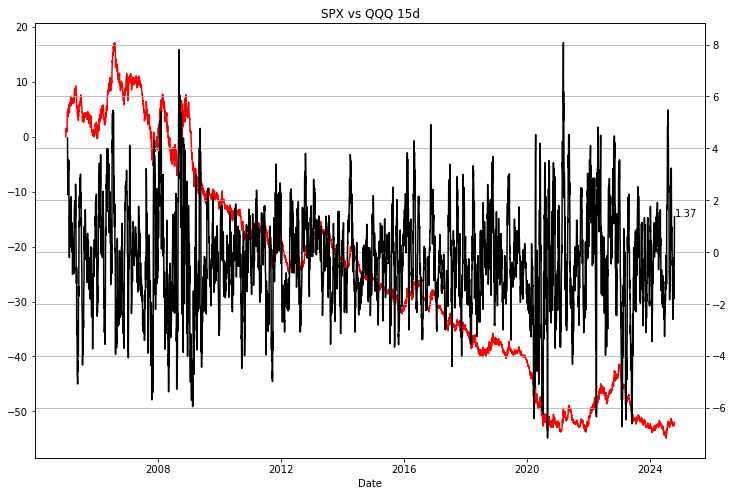

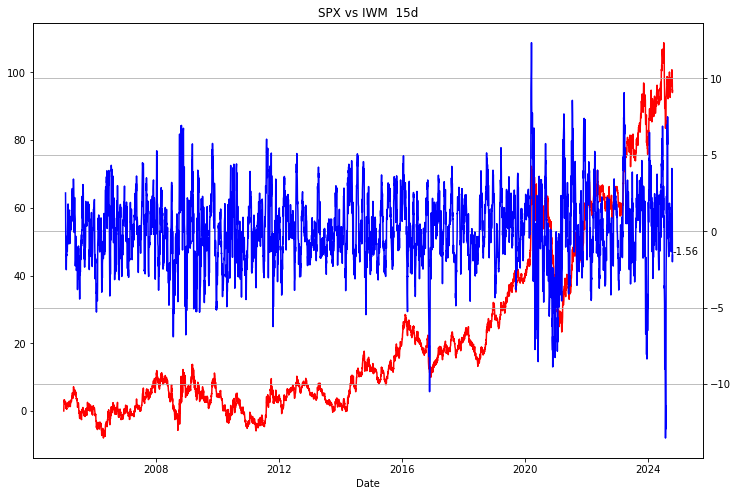

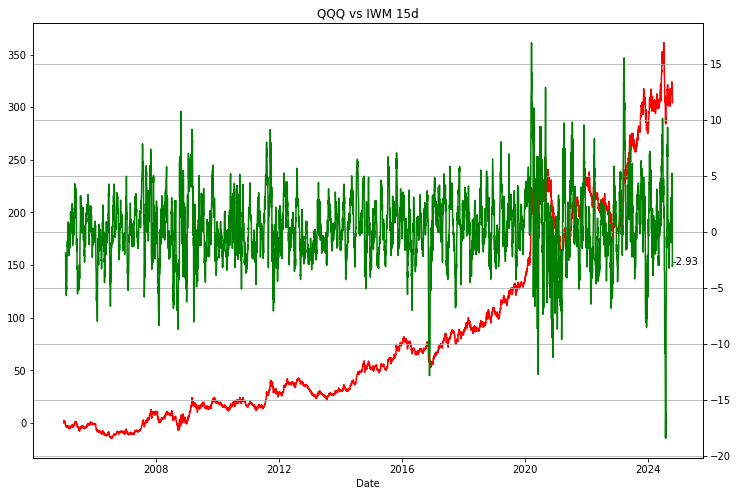

In [41]:
# SPREADS BETWEEN INDICES IN SPECIFIC WINDOWS

window = 15
idx1 = 'SPX'
idx2 = 'QQQ US'
idx3 = 'IWM US'
st_date = datetime(2005, 1, 1).date()

#Prices_df = open_df('prices_relation')

idx1_s = Prices_df[Prices_df.index >= st_date][idx1]
idx2_s = Prices_df[Prices_df.index >= st_date][idx2]
idx3_s = Prices_df[Prices_df.index >= st_date][idx3]

ret1 = round(100 * (idx1_s / idx1_s.shift(window) - 1), 2).dropna()
ret2 = round(100 * (idx2_s / idx2_s.shift(window) - 1), 2).dropna()
ret3 = round(100 * (idx3_s / idx3_s.shift(window) - 1), 2).dropna()

round(100 * (idx1_s / idx2_s / ((idx1_s / idx2_s).iloc[0]) - 1), 2).plot(c = 'r').twinx()
(ret1 - ret2).plot(figsize = (12, 8), c = 'k')
plt.text(ret2.index[-1], (ret1 - ret2).iloc[-1], str(round((ret1 - ret2).iloc[-1], 2)))
plt.grid(axis = 'y')
plt.title('SPX vs QQQ' + ' ' + str(window) + 'd')
plt.show()
round(100 * (idx1_s / idx3_s / ((idx1_s / idx3_s).iloc[0]) - 1), 2).plot(c = 'r').twinx()
(ret1 - ret3).plot(figsize = (12, 8), c = 'b')
plt.text(ret2.index[-1], (ret1 - ret3).iloc[-1], str(round((ret1 - ret3).iloc[-1], 2)))
plt.grid(axis = 'y')
plt.title('SPX vs IWM ' + ' ' + str(window) + 'd')
plt.show()
round(100 * (idx2_s / idx3_s / ((idx2_s / idx3_s).iloc[0]) - 1), 2).plot(c = 'r').twinx()
(ret2 - ret3).plot(figsize = (12, 8), c = 'g')
plt.text(ret2.index[-1], (ret2 - ret3).iloc[-1], str(round((ret2 - ret3).iloc[-1], 2)))
plt.grid(axis = 'y')
plt.title('QQQ vs IWM' + ' ' + str(window) + 'd')
plt.show()

Enter ALGO Ticker: nem us
Enter Days: 250
Enter Pol Degree (empty for 10): 15
Last 4 Earnings Dates:
31    2024-02-21
32    2024-04-25
33    2024-07-18
34    2024-10-23
dtype: object

Ammend Earnings Dates (empty or Y/y)? 


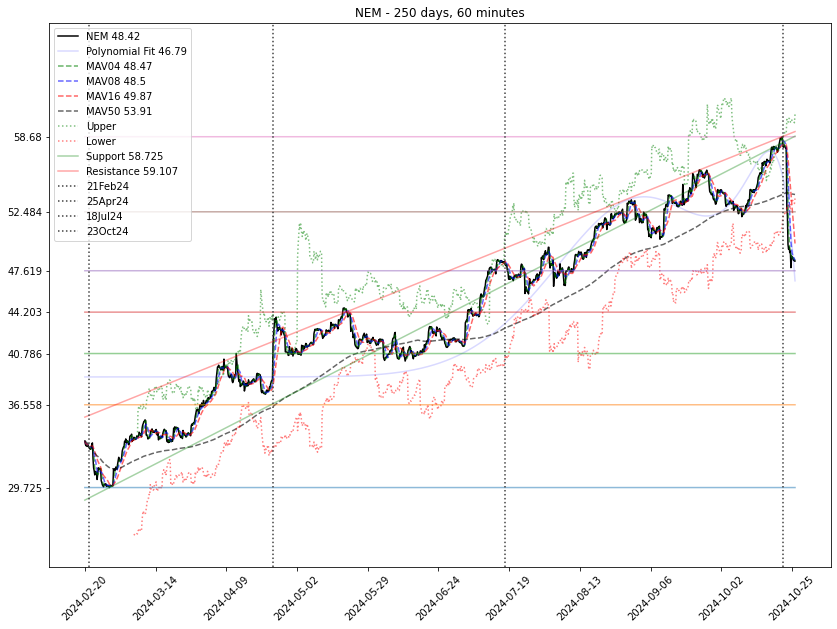

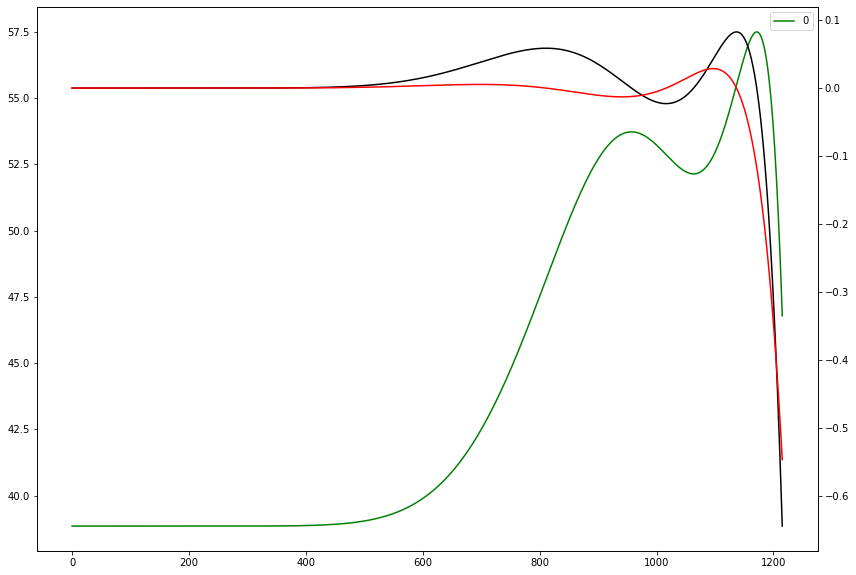

In [19]:
#INTRADAY STOCK GRAPHS

import pandas as pd
import os
import csv
import yfinance as yf
import tkinter as tk
import matplotlib.pyplot as plt
import numpy as np
from datetime import date
from datetime import timedelta
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures

def on_selection(value):
    global choice_lag
    choice_lag = value  # store the user's choice
    root.destroy()  # close window
     
today = date.today()
window = 42
band_m = 2

query_earnings = "SELECT * FROM ed_relation"
ed_df = pd.read_sql_query(query_earnings, engine)
ed_df = Set_DF(ed_df)
ed_df = DD_Index(ed_df)

fibonacci_seq = [0.00, 23.60, 38.20, 50.00, 61.80, 78.60, 100.00]
fibonacci_list = []
fig1 = plt.figure(figsize = (14, 10))
ax1 = fig1.add_subplot(1, 1, 1)

choiceAlgo_ticker = input('Enter ALGO Ticker: ').upper()
choice_ticker = choiceAlgo_ticker.split(' ')[0]
day_lag = int(input('Enter Days: '))  
start_date = today - timedelta(day_lag)

choice_list = ['5', '15', '30', '45', '60']
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a lag (minutes)").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()

ticker_data = yf.Ticker(choice_ticker)
ticker_data_df = ticker_data.history(start = start_date - timedelta(days = 1), end = today + timedelta(days = 1), interval = choice_lag + "m")
ticker_df = pd.DataFrame(ticker_data_df['Close'].values, index = np.arange(len(ticker_data_df.index)), columns = [choice_ticker])
PLOTticker_df = pd.DataFrame(ticker_data_df['Close'].values, index = ticker_data_df.index, columns = [choice_ticker])


p_degree = input('Enter Pol Degree (empty for 10): ')
if (p_degree != ''):
    p_degree = int(p_degree)
else:
    p_degree = 10
first_deriv = 1
second_deriv = 2
lin_reg = LinearRegression()
x_Values = ticker_df.index.values.reshape(-1, 1)
y_Values = np.array(ticker_df)
poly_features = PolynomialFeatures(degree = p_degree, include_bias = False)
poly_X = poly_features.fit_transform(x_Values)
LR_Fit = lin_reg.fit(poly_X, y_Values)
Predictions_df = pd.DataFrame(LR_Fit.predict(poly_X), index = ticker_df.index, columns = ['Forecast'])

upper_b = ((1 + band_m * ticker_df.pct_change().rolling(window).std() * np.sqrt(window)).shift(window) * ticker_df.shift(window)).dropna()
lower_b = ((1 - band_m * ticker_df.pct_change().rolling(window).std() * np.sqrt(window)).shift(window) * ticker_df.shift(window)).dropna()

mav04 = ticker_df.rolling(4, min_periods = 1).mean()
mav08 = ticker_df.rolling(8, min_periods = 1).mean()
mav16 = ticker_df.rolling(16, min_periods = 1).mean()
    
ax1.plot(ticker_df, c = 'k', label = choice_ticker + ' ' + str(round(ticker_df.iloc[-1][choice_ticker], 2)))
ax1.plot(Predictions_df, c = 'b', alpha = 0.15, label = 'Polynomial Fit ' + str(round(Predictions_df.iloc[-1][0], 2)))
ax1.plot(mav04, c = 'g', alpha = 0.6, linestyle = 'dashed', label = 'MAV04' + ' ' + str(round(mav04.iloc[-1][choice_ticker], 2)))
ax1.plot(mav08, c = 'b', alpha = 0.6, linestyle = 'dashed', label = 'MAV08' + ' ' + str(round(mav08.iloc[-1][choice_ticker], 2)))
ax1.plot(mav16, c = 'r', alpha = 0.6, linestyle = 'dashed', label = 'MAV16' + ' ' + str(round(mav16.iloc[-1][choice_ticker], 2)))
if (day_lag > 60):
    mav50 = ticker_df[::(ticker_df.shape[0] // day_lag) + 1].rolling(50, min_periods = 1).mean()
    ax1.plot(mav50, c = 'k', alpha = 0.6, linestyle = 'dashed', label = 'MAV50' + ' ' + str(round(mav50.iloc[-1][choice_ticker], 2)))

ax1.plot(upper_b, c = 'g', linestyle = 'dotted', alpha = 0.5, label = 'Upper')
ax1.plot(lower_b, c = 'r', linestyle = 'dotted', alpha = 0.5, label = 'Lower')

local_max = ticker_df[choice_ticker].max()
local_min = ticker_df[choice_ticker].min()
hl_gap = (local_max - local_min)
for f_level in fibonacci_seq:
    f_array = local_min + np.ones(len(ticker_df.index)) * (f_level / 100) * hl_gap
    f_series = pd.Series(f_array, index = ticker_df.index)
    fibonacci_list.append(round(f_series.iloc[0], 3))
    ax1.plot(f_series, alpha = 0.5)



poly_features_1d = PolynomialFeatures(degree = (p_degree - first_deriv), include_bias = False)
poly_dX = poly_features_1d.fit_transform(x_Values)
n, m = poly_dX.shape
x0 = np.ones((n, 1))
poly_dX_base = np.c_[x0, poly_dX]
poly_deriv = np.array(list(np.poly1d(np.array(list(LR_Fit.coef_[0][::-1]) + [1])).deriv())[::-1])

poly_features_2d = PolynomialFeatures(degree = (p_degree - second_deriv), include_bias = False)
poly_2dX = poly_features_2d.fit_transform(x_Values)
n2, m2 = poly_2dX.shape
x0_2 = np.ones((n2, 1))
poly_2dX_base = np.c_[x0_2, poly_2dX]
poly_2deriv = np.array(list(np.poly1d(np.array(list(poly_deriv)[::-1])).deriv())[::-1])


pd.DataFrame(poly_X.dot(LR_Fit.coef_[0]) + LR_Fit.intercept_).plot(figsize = (14, 10), c = 'g').twinx()
plt.plot(poly_dX_base.dot(poly_deriv), c = 'k')
plt.plot(20 * poly_2dX_base.dot(poly_2deriv), c = 'r')


deriv01_df = pd.DataFrame(poly_dX_base.dot(poly_deriv), columns = ['Deriv 01'])
deriv02_df = pd.DataFrame(poly_2dX_base.dot(poly_2deriv), columns = ['Deriv 02'])

d01_df = deriv01_df.copy()
d01_df['Abs'] = abs(d01_df['Deriv 01'])
d01_df['Original Index'] = d01_df.index

prev = 0
Deriv0_pts_df = pd.DataFrame(np.nan, index = [0], columns = ['Local'])
for idx in d01_df.index[1:]:
    if (d01_df.iloc[idx]['Deriv 01'] > 0) & (d01_df.iloc[prev]['Deriv 01'] < 0):
        Deriv0_pts_df.loc[idx] = 'Min'
    if (d01_df.iloc[idx]['Deriv 01'] < 0) & (d01_df.iloc[prev]['Deriv 01'] > 0):
        Deriv0_pts_df.loc[idx] = 'Max'
    prev = idx
Deriv0_pts_df.drop([0], inplace = True)

if (len(Deriv0_pts_df.index) > 1):
    p = Deriv0_pts_df.index[0]
    lows_list = []
    highs_list = []
    sign = 1
    if (Deriv0_pts_df.loc[p][0] == 'Max'):
        sign = -1
        lows_list.append((ticker_df.loc[:p][choice_ticker] * sign).max() * sign)
    else:
        highs_list.append((ticker_df.loc[:p][choice_ticker] * sign).max() * sign)
    p = 0
    for i in Deriv0_pts_df.index[:-1]:
        n = Deriv0_pts_df.index[Deriv0_pts_df.index.values.tolist().index(i) + 1]
        sign = 1
        if (Deriv0_pts_df.loc[i][0] == 'Min'):
            sign = -1
            lows_list.append((ticker_df.loc[p: n][choice_ticker] * sign).max() * sign)
        else:
            highs_list.append((ticker_df.loc[p: n][choice_ticker] * sign).max() * sign)
        p = i  
    sign = 1
    p = Deriv0_pts_df.index[-2]
    if (Deriv0_pts_df.iloc[-1][-1] == 'Max'):
        highs_list.append((ticker_df.loc[p:][choice_ticker] * sign).max() * sign)
    else:
        sign = -1
        lows_list.append((ticker_df.loc[p:][choice_ticker] * sign).max() * sign)
    lows_df = pd.DataFrame(lows_list, index = np.arange(len(lows_list)), columns = ['Levels'])
    highs_df = pd.DataFrame(highs_list, index = np.arange(len(highs_list)), columns = ['Levels'])
    lows_df['Positions'] = np.nan
    highs_df['Positions'] = np.nan
    for idx in lows_df.index:
        lows_df.loc[idx, 'Positions'] = ticker_df[ticker_df[choice_ticker] == lows_list[idx]].index[0]
    for idx in highs_df.index:
        highs_df.loc[idx, 'Positions'] = ticker_df[ticker_df[choice_ticker] == highs_list[idx]].index[0]    

    if (len(lows_df.index) > 1):  
        for j in np.arange(lows_df.shape[0] - 1):
            base_x = lows_df.loc[j, 'Positions']
            base_y = lows_df.loc[j, 'Levels']
            for i, curr in enumerate(lows_df.index[(j + 1):]):
                lx_values = np.array([base_x, lows_df.loc[curr, 'Positions']]).reshape(-1, 1)
                ly_values = np.array([base_y, lows_df.loc[curr, 'Levels']])
                Low_Fit = lin_reg.fit(lx_values, ly_values)
                lx_values = np.array([ticker_df.index[0], base_x, lows_df.loc[curr, 'Positions'], ticker_df.index[-1]]).reshape(-1, 1)
                Low_df = pd.DataFrame(Low_Fit.predict(lx_values), index = [ticker_df.index[0], base_x, lows_df.loc[curr, 'Positions'], ticker_df.index[-1]], columns = ['Low'])
                ax1.plot(Low_df, c = 'g', alpha = 0.35, label = 'Support ' + str(round(Low_df.iloc[-1][0], 3)))

    if (len(highs_df.index) > 1):  
        for j in np.arange(highs_df.shape[0] - 1):
            base_x = highs_df.loc[j, 'Positions']
            base_y = highs_df.loc[j, 'Levels']
            for i, curr in enumerate(highs_df.index[(j + 1):]):
                lx_values = np.array([base_x, highs_df.loc[curr, 'Positions']]).reshape(-1, 1)
                ly_values = np.array([base_y, highs_df.loc[curr, 'Levels']])
                High_Fit = lin_reg.fit(lx_values, ly_values)
                lx_values = np.array([ticker_df.index[0], base_x, highs_df.loc[curr, 'Positions'], ticker_df.index[-1]]).reshape(-1, 1)
                High_df = pd.DataFrame(High_Fit.predict(lx_values), index = [ticker_df.index[0], base_x, highs_df.loc[curr, 'Positions'], ticker_df.index[-1]], columns = ['High'])
                ax1.plot(High_df, c = 'r', alpha = 0.35, label = 'Resistance ' + str(round(High_df.iloc[-1][0], 3)))                

ax1.set_xticks(ticker_df.index[:: int(np.floor(ticker_df.shape[0] / 10))])
ax1.set_xticklabels(PLOTticker_df.index.map(lambda x: x.date())[:: int(np.floor(PLOTticker_df.shape[0] / 10))], rotation = 45)

if (choiceAlgo_ticker in ed_df.columns):
    yr_s = pd.Series(ed_df[choiceAlgo_ticker].index.map(lambda x: int(x.split('-')[1]) + int(x[0]) // 4), 
                     index = ed_df[choiceAlgo_ticker].index)
    eDt_df = pd.DataFrame(ed_df[choiceAlgo_ticker]).join(yr_s)
    eDt_df = eDt_df.replace({'': np.nan}).dropna()
    eDt_l = eDt_df.index.map(lambda x: datetime(int(eDt_df.loc[x, 'index']), int(eDt_df.loc[x, choiceAlgo_ticker][:2]), 
                                                int(eDt_df.loc[x, choiceAlgo_ticker][-2:])).date()).tolist()
    eDt_s = pd.Series(eDt_l)
    SeDt_s = eDt_s[eDt_s >= PLOTticker_df.index[0].date()]
    print('Last ' + str(SeDt_s.shape[0]) + ' Earnings Dates:')
    print(SeDt_s)
    print('')
    am_ed = input('Ammend Earnings Dates (empty or Y/y)? ').upper()
    if (am_ed == 'Y'):
        for e, c_ed in enumerate(SeDt_s[::-1].values):
            e += 1
            c_ED_str = str(input('Enter ' + str(e) + ' ED back (saved ' + c_ed.strftime('%d%b%y') + ') mmdd or empty to keep: '))
            save_EDdf = False
            if (c_ED_str != ''):
                try:
                    c_ED_int = int(c_ED_str)
                    ed_df.loc[ed_df.index[-e], choiceAlgo_ticker] = c_ED_str
                    SeDt_s.loc[SeDt_s.index[-e]] = datetime(int(ed_df.index[-e].split('-')[1]) + int(ed_df.index[-e][0]) // 4, 
                                                            int(c_ED_str[:2]), int(c_ED_str[-2:])).date()  
                    save_EDdf = True
                except:
                    print(c_ED_str + ' not saved')
                if (save_EDdf):
                    ed_df.to_sql('ed_relation', engine, index = True, if_exists = 'replace')
        
    for e_dt in SeDt_s.tolist():
        try:
            idx = PLOTticker_df.index.map(lambda x: x.date()).tolist().index(e_dt)
            ax1.axvline(x = idx, c = '0.25', label = e_dt.strftime('%d%b%y'), linestyle = 'dotted')
        except:
            pass

ax1.set_yticks(fibonacci_list)
ax1.set_yticklabels(fibonacci_list)
ax1.set_ylim([lower_b.min()[0] * 0.9, upper_b.max()[0] * 1.1])

ax1.set_title(choice_ticker + ' - ' + str(day_lag) + ' days, ' + str(choice_lag) + ' minutes')
ax1.legend(loc = 'best')

        0       1       2       3       4
0  100.00    5.60   80.85  -67.01   -7.62
1    5.60  100.00   -1.09   -3.40   68.43
2   80.85   -1.09  100.00  -82.51   -6.18
3  -67.01   -3.40  -82.51  100.00   -0.18
4   -7.62   68.43   -6.18   -0.18  100.00



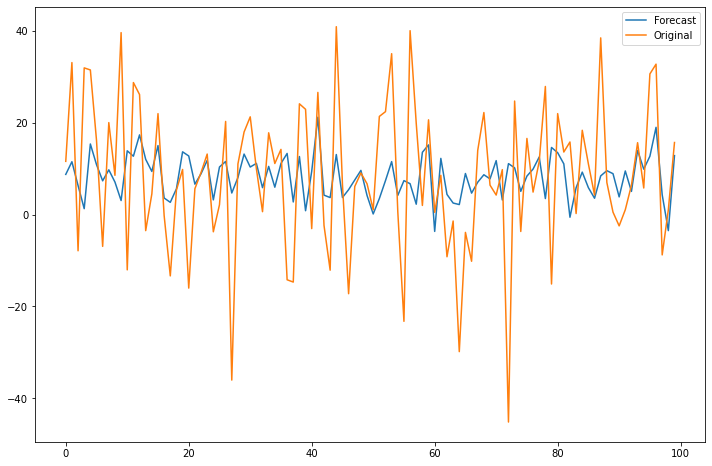

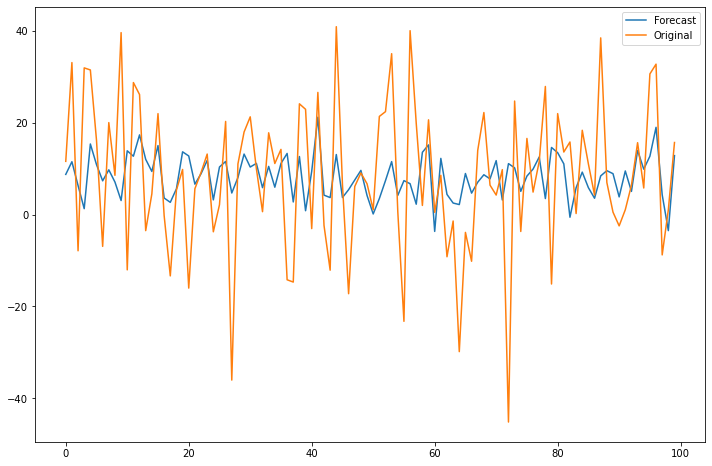

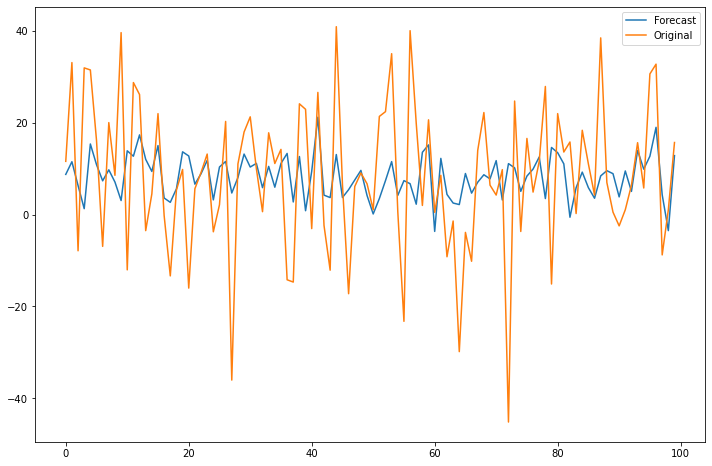

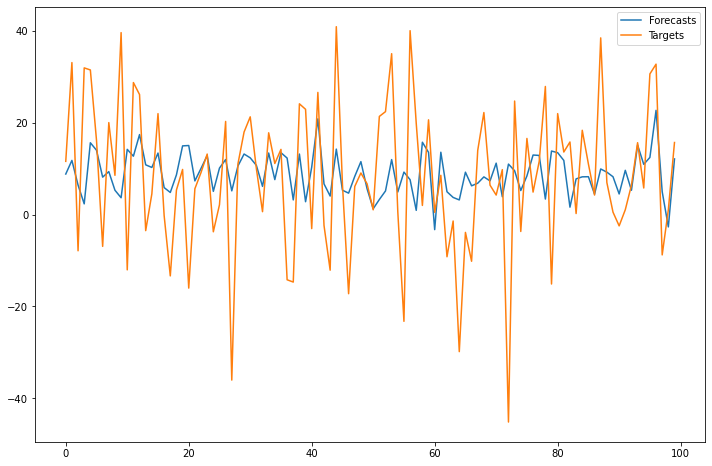

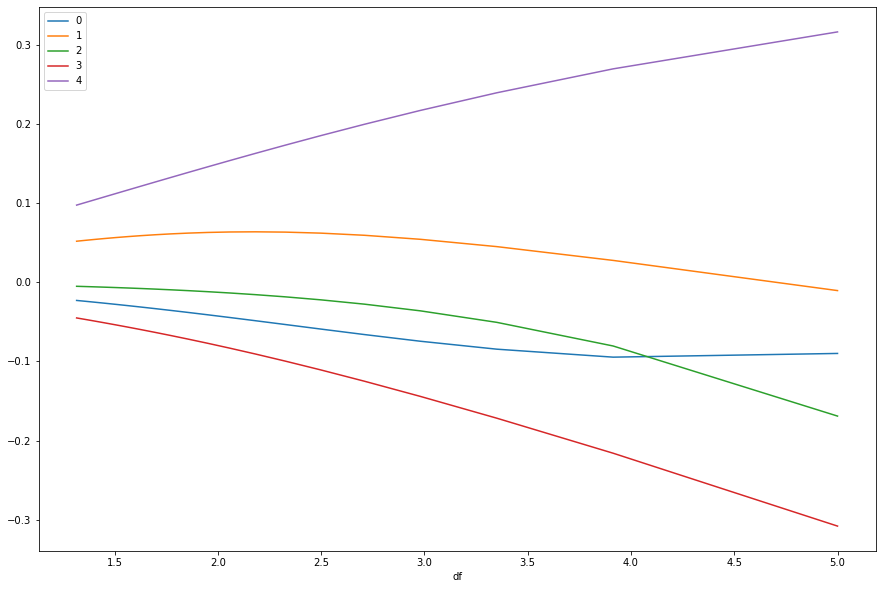

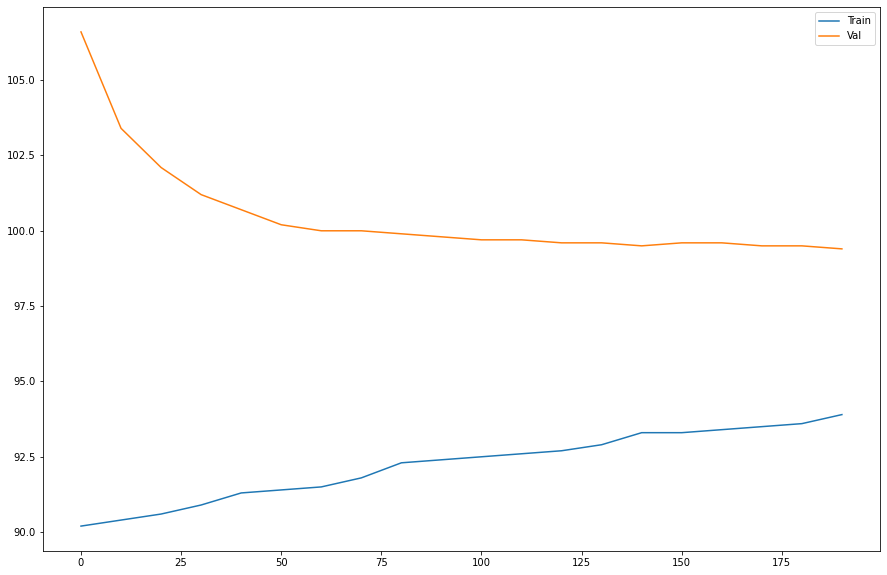

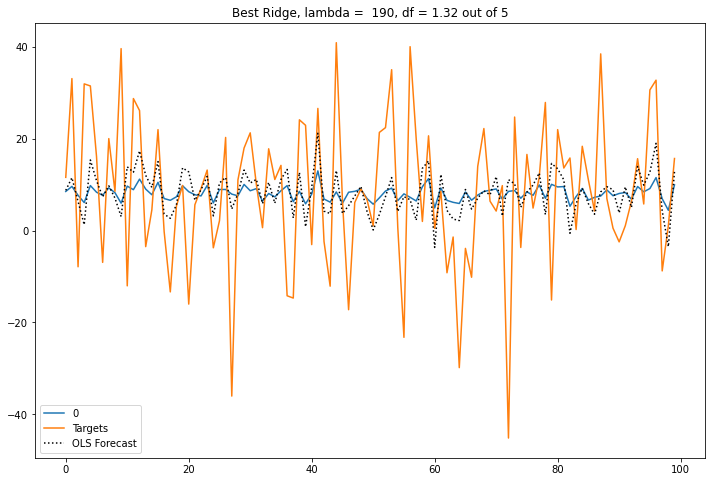

OLS       8.079
iOLS      8.079
cOLS      8.079
SVR       7.567
Ridge    26.787
dtype: float64

In [497]:
# REGRESSION LAB

from sklearn.linear_model import Ridge

def loadings(ret_s, res_s):
    
    Pbeta = 0
    PZ = 0      
    if (res_s.std() != 0):
        Pbeta = round(res_s.cov(ret_s) / (res_s.std() ** 2), 3)
        if (ret_s.std() != 0):        
            PZ = round(abs(Pbeta) / ((ret_s.std() ** 2) / (res_s.std() ** 2)), 3)
    
    return Pbeta, PZ

def svr_orthogonal(x_df, y_df):
    
    corr_s = abs(x_df.join(y_df['Targets']).corr()['Targets'].drop('Targets')).sort_values(ascending = False)  
    residuals_l = []
    for idx, c_feat in enumerate(corr_s.index):
        b_res_l = []
        for count in np.arange(idx):
            b_res = loadings(residuals_l[count], x_df[c_feat] - x_df[c_feat].mean() * 0)[0]
            b_res_l.append(b_res)
        z = x_df[c_feat] - x_df[c_feat].mean() * 0
        for count in np.arange(idx):
            z -= b_res_l[count] * residuals_l[count]
        residuals_l.append(z)        

    betas_df = pd.DataFrame(np.nan, index = corr_s.index, columns = ['SVR Betas', 'Z Score'])
    for idx, c_res in enumerate(residuals_l):
        Rt_res = y_df['Targets'].copy()
        for count in np.arange(idx):
            Rt_res -= betas_df.iloc[count]['SVR Betas'] * Rt_res
        betas_df.loc[corr_s.index[idx]] = loadings(Rt_res, c_res)
    
    return betas_df, corr_s

r2_s = pd.Series(np.nan, index = ['OLS', 'iOLS', 'cOLS', 'SVR', 'Ridge'])

x1 = np.random.normal(0, 1, 100)
x2 = np.random.normal(0, 2, 100)
x3 = np.random.normal(0, 3, 100) + 4 * x1
x4 = np.random.normal(0, 4, 100) - x3
x5 = np.random.normal(0, 2, 100) + x2
e = np.random.normal(0, 8, 100)

p_l = [0.3, 0.2, 0.4, 0.5, 0.75]
p_a = np.array(p_l)
x_m = np.matrix((x1, x2, x3, x4, x5))
y_a = p_a.dot(x_m) + 2 * e + 10
y_std = pd.DataFrame(y_a).T.std()[0]
#y_std = 1

x_m = (pd.DataFrame(x_m).T / pd.DataFrame(x_m).T.std()).T.values
y_a = (pd.DataFrame(y_a).T / y_std).T.values

print(round(100 * pd.DataFrame(x_m).T.corr(), 2))
print('')

## LINEAR REGRESSION OLS

LR_OLS_mod = LinearRegression()
OLS_mod = LR_OLS_mod.fit(x_m.T, y_a.T)
y_f = OLS_mod.predict(x_m.T)
y_f2 = OLS_mod.coef_.dot(x_m) + OLS_mod.intercept_
OLS_r2 = OLS_mod.score(x_m.T, y_a.T)
r2_s.loc['OLS'] = round(100 * OLS_r2, 3)
pd.DataFrame(y_f * y_std, columns = ['Forecast']).join(pd.DataFrame(y_a.T * y_std, 
                                                                    columns = ['Original'])).plot(figsize = (12, 8))

## LINEAR REGRESSION OLS, INTERCEPT

iLR_OLS_mod = LinearRegression()
i_a = np.ones(y_a.shape[1])
ix_m = np.insert(x_m.T, 0, i_a, axis = 1)
iOLS_mod = iLR_OLS_mod.fit(ix_m, y_a.T)
iy_f = iOLS_mod.predict(ix_m)
iy_f2 = iOLS_mod.coef_.dot(ix_m.T) + iOLS_mod.intercept_
iOLS_r2 = iOLS_mod.score(ix_m, y_a.T)
r2_s.loc['iOLS'] = round(100 * iOLS_r2, 3)
pd.DataFrame(iy_f * y_std, columns = ['Forecast']).join(pd.DataFrame(y_a.T * y_std, 
                                                                     columns = ['Original'])).plot(figsize = (12, 8))

## LINEAR REGRESSION OLS, CENTERED

cx_m = x_m - np.mean(x_m)
cy_a = y_a - np.mean(y_a)
cLR_OLS_mod = LinearRegression()
cOLS_mod = cLR_OLS_mod.fit(cx_m.T, cy_a.T)
cy_f = cOLS_mod.predict(cx_m.T)
cy_f2 = cOLS_mod.coef_.dot(cx_m) + cOLS_mod.intercept_
cOLS_r2 = cOLS_mod.score(cx_m.T, cy_a.T)
r2_s.loc['cOLS'] = round(100 * cOLS_r2, 3)
pd.DataFrame((cy_f + np.mean(y_a)) * y_std, columns = ['Forecast']).join(pd.DataFrame((cy_a.T + np.mean(y_a)) * y_std, 
                                                                                      columns = ['Original'])).plot(figsize = (12, 8))

## ORTHOGONAL BASIS REGRESSION
svrx_df = pd.DataFrame(x_m.T)
svry_df = pd.DataFrame(y_a.T, columns = ['Targets'])
y_mean = svry_df.mean()
svry_df = svry_df - y_mean.values
betas_df, corr_s = svr_orthogonal(svrx_df, svry_df)
svry_f = (betas_df['SVR Betas'] * svrx_df).sum(axis = 1) + y_mean.values
svry_f.name = 'Forecasts'
pd.DataFrame(svry_f * y_std).join((svry_df + y_mean) * y_std).plot(figsize = (12, 8))
SVR_r2 = (pd.DataFrame(svry_f).join(svry_df + y_mean).corr()['Forecasts'].drop('Forecasts').values ** 2)[0]
r2_s.loc['SVR'] = round(100 * SVR_r2, 3)


## RIDGE REGRESSION W/ DEGREES OS FREEDOM PLOT, X VALIDATION

xv_n = 10
ridge_n = 200
step = 10
lambda_array = np.arange(ridge_n)
lambda_array = lambda_array[::step]
x_df = pd.DataFrame(x_m.T)
y_df = pd.DataFrame(y_a.T)

cv_mse_df = pd.DataFrame(np.nan, index = lambda_array, columns = ['Train', 'Val'])
beta_df = pd.DataFrame(np.nan, index = lambda_array, columns = np.arange(x_df.shape[1]).tolist() + ['df'])
val_r2 = np.inf
for c_lambda in lambda_array:
    Rmodel = Ridge(alpha = c_lambda, normalize = False, tol = 0.001, solver = 'auto', random_state = 42)
    valRMSE_tot = 0
    trainRMSE_tot = 0
    for c in np.arange(xv_n):
        init_v = xv_n * c
        end_v = init_v + xv_n
        valX_df = x_df.iloc[init_v: end_v]
        valY_df = y_df.iloc[init_v: end_v]
        trainX_df = x_df.drop(valX_df.index)
        trainY_df = y_df.drop(valX_df.index)
        
        I_m = np.identity(trainX_df.shape[1])
        lambda_matrix = I_m * np.array([c_lambda] * trainX_df.shape[1])
        beta_array = np.linalg.inv((trainX_df.T.values.dot(trainX_df.values)) + lambda_matrix).dot(trainX_df.T.values.dot(trainY_df.values))
        hat_matrix = (trainX_df.values).dot(np.linalg.inv((trainX_df.T.values.dot(trainX_df.values)) + lambda_matrix)).dot(trainX_df.T.values)        
        
        if (c == 0):
            edf = np.trace(hat_matrix)
            beta_df.loc[c_lambda] = pd.DataFrame(beta_array)[0].tolist() + [edf]
        
        ridge_mod = Rmodel.fit(trainX_df.values, trainY_df.values)
        trainRidge_f = ridge_mod.predict(trainX_df.values)
        valRidge_f = ridge_mod.predict(valX_df.values)
        trainRidge_mse = round(np.sum((trainY_df.values - trainRidge_f) ** 2) / trainY_df.shape[0], 2)
        valRidge_mse = round(np.sum((valY_df.values - valRidge_f) ** 2) / valY_df.shape[0], 2)
        trainRMSE_tot += trainRidge_mse 
        valRMSE_tot += valRidge_mse 
    cv_mse_df.loc[c_lambda, 'Train'] = round(100 * trainRMSE_tot / xv_n, 2)
    cv_mse_df.loc[c_lambda, 'Val'] = round(100 * valRMSE_tot / xv_n, 2)
    if (valRMSE_tot < val_r2):
        bestRidge_f = ridge_mod.predict(x_df.values)
        bestLambda = c_lambda
        val_r2 = valRMSE_tot
        best_edf = edf
    

beta_df.index = beta_df['df']
beta_df = beta_df.drop(['df'], axis = 1)
beta_df.sort_index().plot(figsize = (15, 10))
cv_mse_df.plot(figsize = (15, 10))
pd.DataFrame(bestRidge_f * y_std).join((svry_df + y_mean) * y_std).plot(figsize = (12, 8))
pd.DataFrame(y_f * y_std, columns = ['OLS Forecast'])['OLS Forecast'].plot(c = 'k', linestyle = 'dotted').legend(loc = 'best')
plt.title('Best Ridge, lambda =  ' + str(bestLambda) + ', df = ' + str(round(best_edf, 2)) + ' out of ' + str(x_m.shape[0]))
plt.show()
Ridge_r2 = pd.DataFrame(bestRidge_f).join(y_df, rsuffix = '_label').corr().iloc[0, 1]
r2_s.loc['Ridge'] = round(100 * Ridge_r2, 3)

r2_s

OverBought incidences:
2.0    191831
2.5     95636
3.0     63245
3.5     54147
4.0     51947
4.5     51393
5.0     51214
dtype: int64
Average 1M fwd perf after OB:
2.0   -0.19
2.5   -0.95
3.0   -1.98
3.5   -2.89
4.0   -1.98
4.5   -1.49
5.0   -0.80
dtype: float64
StD 1M fwd perf after OB:
2.0    3.35
2.5    5.04
3.0    6.22
3.5    8.49
4.0    7.33
4.5    6.46
5.0    5.63
dtype: float64
ZS 1M fwd perf after OB:
2.0   -0.058
2.5   -0.190
3.0   -0.318
3.5   -0.340
4.0   -0.270
4.5   -0.230
5.0   -0.141
dtype: float64


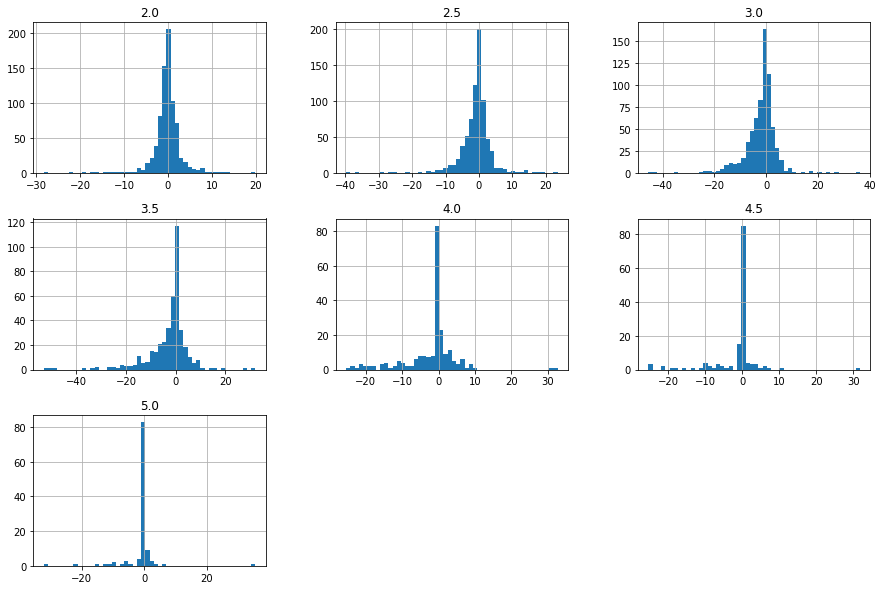



OverSold incidences:
2.0    209622
2.5    139807
3.0    100173
3.5     77269
4.0     64227
4.5     56542
5.0     52034
dtype: int64
Average 1M fwd perf after OS:
2.0     2.91
2.5     3.68
3.0     4.75
3.5     6.33
4.0     8.48
4.5    11.25
5.0    13.09
dtype: float64
StD 1M fwd perf after OS:
2.0     3.03
2.5     3.95
3.0     5.26
3.5     7.26
4.0    10.45
4.5    29.38
5.0    31.93
dtype: float64
ZS 1M fwd perf after OS:
2.0    0.960
2.5    0.931
3.0    0.903
3.5    0.872
4.0    0.812
4.5    0.383
5.0    0.410
dtype: float64


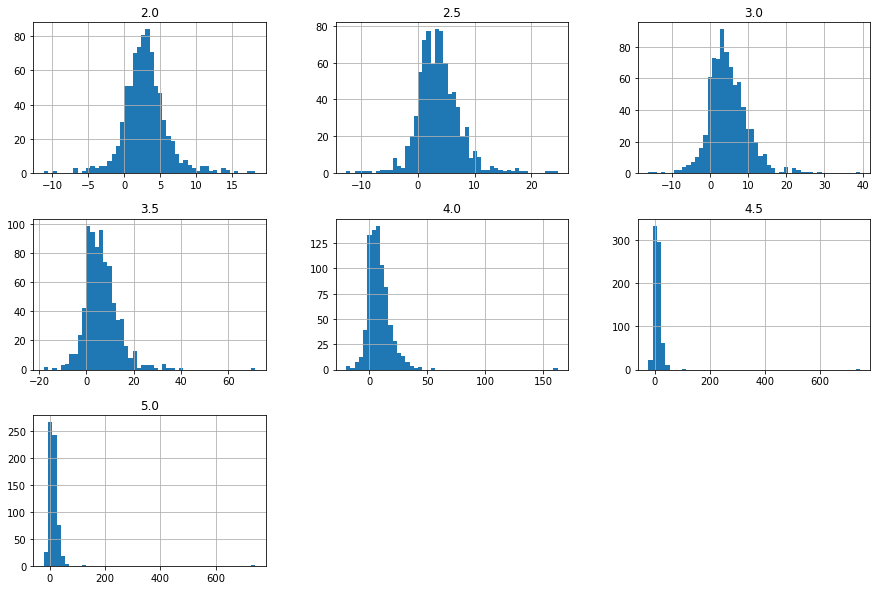

In [493]:
# FWD RETURNS CONDITIONAL ON Z-SCORE

import warnings

warnings.filterwarnings('ignore')
stocks = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Tickers_VA.csv")
all_tickers_l = stocks['tickers'].tolist()

MAV_w = 63
fwdP_w = 21
zs_l = [2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0]

all_tickers_l = [t for t in all_tickers_l if t in Prices_df.columns]
slicePxs_df = Prices_df[-4000:-fwdP_w][all_tickers_l]
MAVPxs_df = slicePxs_df.rolling(MAV_w).mean()
vol_df = slicePxs_df.pct_change().ewm(halflife = MAV_w).std() * np.sqrt(10)
devPxs_df = ((slicePxs_df - MAVPxs_df) / (vol_df * slicePxs_df)).dropna(how = 'all')
OBincidence_count = 0
OSincidence_count = 0
OBTracker_df = pd.DataFrame(np.nan, index = devPxs_df.columns, columns = zs_l)
OSTracker_df = pd.DataFrame(np.nan, index = devPxs_df.columns, columns = zs_l)
OBincidence_count_s = pd.Series(0, index = zs_l)
OSincidence_count_s = pd.Series(0, index = zs_l)
fullL = devPxs_df.shape[1]
for idx, ticker in enumerate(devPxs_df.columns):
    progress = round(100 * (idx + 1) / fullL, 2)
    print(str(progress) + '%', end = '\r')
    
    for zs_cap in zs_l:
        stDatesOB_l = devPxs_df[ticker].dropna()[devPxs_df[ticker].dropna() > zs_cap].index.tolist()
        endDatesOB_l = pd.Series(stDatesOB_l).map(lambda x: Prices_df.index[Prices_df.index.tolist().index(x) + fwdP_w]).tolist()
        OBincidence_count_s.loc[zs_cap] += len(stDatesOB_l)
        OBTracker_df.loc[ticker, zs_cap] = round(np.sum(100 * (Prices_df.loc[endDatesOB_l, ticker].values / 
                                                               Prices_df.loc[stDatesOB_l, ticker].values - 1)) / len(stDatesOB_l), 2)
    for zs_floor in zs_l:
        stDatesOS_l = devPxs_df[ticker].dropna()[devPxs_df[ticker].dropna() < -zs_floor].index.tolist()
        endDatesOS_l = pd.Series(stDatesOS_l).map(lambda x: Prices_df.index[Prices_df.index.tolist().index(x) + fwdP_w]).tolist()
        OSincidence_count_s.loc[zs_floor] += len(stDatesOS_l)
        OSTracker_df.loc[ticker, zs_floor] = round(np.sum(100 * (Prices_df.loc[endDatesOS_l, ticker].values / 
                                                                 Prices_df.loc[stDatesOS_l, ticker].values - 1)) / len(stDatesOS_l), 2)    
        
OBTracker_df = OBTracker_df.dropna(how = 'all')    
print('OverBought incidences:')
print(OBincidence_count_s)
print('Average 1M fwd perf after OB:')
print(round(OBTracker_df.mean(), 2))
print('StD 1M fwd perf after OB:')
print(round(OBTracker_df.std(), 2))
print('ZS 1M fwd perf after OB:')
print(round(OBTracker_df.mean() / OBTracker_df.std(), 3))
OBTracker_df.hist(bins = 50, figsize = (15, 10))  
plt.show()
print('')
print('')
OSTracker_df = OSTracker_df.dropna(how = 'all')
print('OverSold incidences:')
print(OSincidence_count_s)
print('Average 1M fwd perf after OS:')
print(round(OSTracker_df.mean(), 2))
print('StD 1M fwd perf after OS:')
print(round(OSTracker_df.std(), 2))
print('ZS 1M fwd perf after OS:')
print(round(OSTracker_df.mean() / OSTracker_df.std(), 3))
OSTracker_df.hist(bins = 50, figsize = (15, 10))  
plt.show()

Enter Start Date: (YY/MM/DD)17/01/01


Energy                  7.5
Industrials             9.2
Health Care            20.6
Hardware               35.5
Consumer Goods         38.3
Materials              44.5
Utilities              46.1
Software               50.8
Telecommunications     51.1
Consumer Services      57.2
Financials             58.5
Real Yields Inv       100.0
Name: Real Yields Inv, dtype: float64

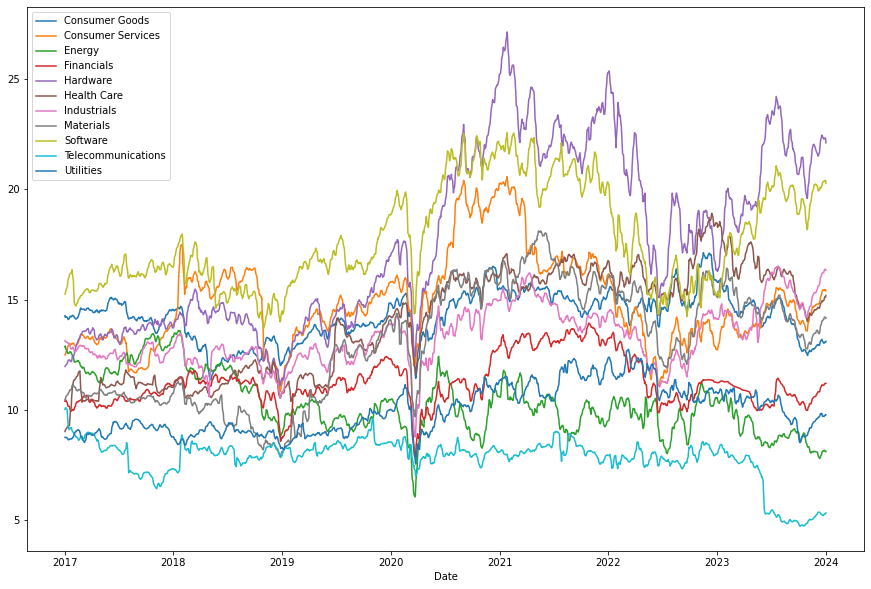

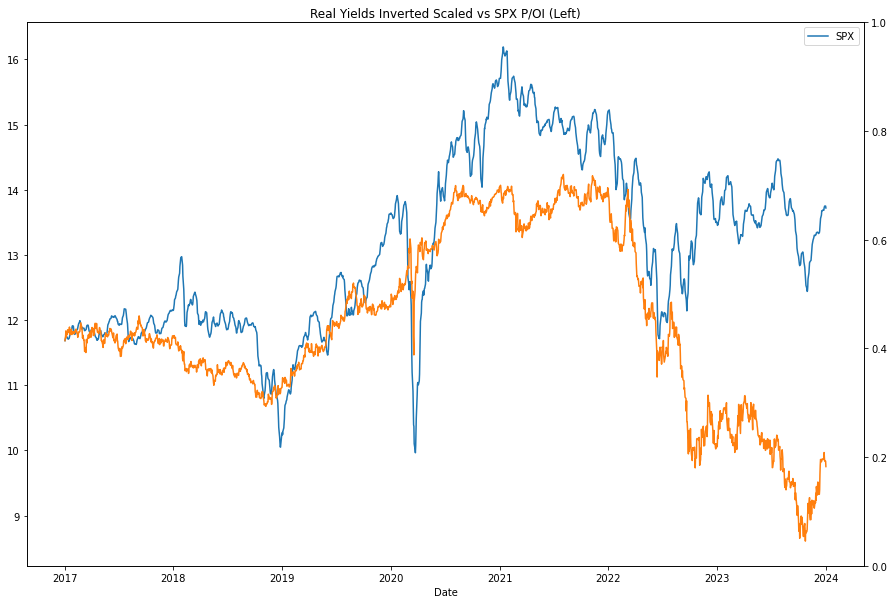

In [108]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\sector_pe.py

#Sector P/Es


import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def offset(c_stock, i_list, d_list, t_date, r_date, div_i):
    
    cutoff_date = r_date
    Start_Date = t_date
    ed_list = d_list
    y_list = i_list
    cur_index = 0
    nd_list = []
    for cur_ed_date in ed_list:                            
        cont=0
        seek_element = True
        ced = cur_ed_date
        cur_index = ed_df[c_stock].values.tolist()[cur_index:].index(cur_ed_date) + cur_index
        cur_index_plus = cur_index + 1
        if (cur_index_plus<len(ed_df.index)):
            cur_year = ed_df.index[cur_index_plus][len(ed_df.index[cur_index_plus])-4:]
        else:
            cur_year = today.year
        cur_ed_date = str(cur_year) + '-' + cur_ed_date[0:2] + '-' + cur_ed_date[2:]
        cur_ed_date = datetime.strptime(cur_ed_date, "%Y-%m-%d").date()
        if (cur_ed_date < cutoff_date):
            nd_list.append(cur_ed_date)        
    
    offs = round_down(len(pd.Series(nd_list)[pd.Series(nd_list) > t_date]) / div_i, 0)
    
    return offs

def on_selection(value):
    global choice
    choice = value  # store the user's choice
    root.destroy()  # close window

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")
engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

clean_up = lambda x: re.sub(r'[^A-Z /^0-9]', '', str(x))
clean_up_save = lambda x: re.sub(r'[^A-Z ^0-9]', '', str(x))
to_pxs = lambda x: Prices_df.loc[current_date, x]
clean_date = lambda x: datetime.strptime(x, "%d-%b-%y").date()

today = date.today()

Cutoff_Date = input("Enter Start Date: (YY/MM/DD)")
if (Cutoff_Date != ''):
    Cutoff_Date = datetime.strptime(Cutoff_Date, "%y/%m/%d").date()
else:
    Cutoff_Date = Val2_df.index[0]
    
query_mc = 'SELECT * FROM mkt_cap_relation'    
mc_df = pd.read_sql_query(query_mc, engine)
mc_df = Set_DF(mc_df)
mc_df = DD_Index(mc_df)
new_mc_df = mc_df.loc[mc_df.index >= Cutoff_Date][::-1]

query_val2 = "SELECT * FROM valuations_oi_relation"
Val2_df = pd.read_sql_query(query_val2, engine_metrics)
Val2_df = Set_DF(Val2_df)
Val2_df = DD_Index(Val2_df)
Val2_df = Val2_df[Val2_df.index >= Cutoff_Date][::-1]

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

e_df = (1 / Val2_df) * (new_mc_df)

sectors = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Custom_Segmentation.csv")
Sectors_df = pd.DataFrame(sectors)
Sectors_df = Set_DF(Sectors_df)
Sectors_df = DD_Index(Sectors_df)
    
choice_list = Sectors_df.columns.values.tolist()
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a classification: (Custom Sector 1)").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()   

map_sectors = lambda x: Sectors_df.loc[x, choice]

e_grouped = e_df.groupby(e_df.columns.map(map_sectors), axis = 1)
sectors_e_df = e_grouped.sum()

p_grouped = new_mc_df.groupby(new_mc_df.columns.map(map_sectors), axis = 1)
sectors_p_df = p_grouped.sum()

sectors_pe_df = sectors_p_df / sectors_e_df
spx_proxy = pd.DataFrame(sectors_pe_df.mean(axis = 1), index = sectors_pe_df.index, columns = ['SPX'])

ry_series = ((Prices_df[Prices_df.index >= spx_proxy.index[0]]['T10YIE'] - Prices_df[Prices_df.index >= spx_proxy.index[0]]['USGG10YR']))
std_ry_series = ry_series * (spx_proxy.rolling(5, min_periods = 1).mean().std().values[0] / ry_series.std())
std_ry_series = std_ry_series + (spx_proxy.iloc[0]['SPX'] - std_ry_series.iloc[0])
std_ry_series.name = 'Real Yields Inv'

sectors_pe_df.rolling(5, min_periods = 1).mean().plot(figsize = (15,10))
sectors_pe_df.to_sql('sectors_pe_relation', engine_metrics, index=True, if_exists='replace')
#std_ry_series.plot().twinx()

spx_proxy.rolling(5, min_periods = 1).mean().plot(figsize = (15,10), title = 'Real Yields Inverted Scaled vs SPX P/OI (Left)')
std_ry_series.plot().twinx()
sectors_pe_smooth = sectors_pe_df.rolling(5, min_periods = 1).mean().join(std_ry_series)
round(100 * sectors_pe_smooth.corr()['Real Yields Inv'].sort_values(), 1)

Rank sectors (Y/N)?N
Fit quality: 85.55


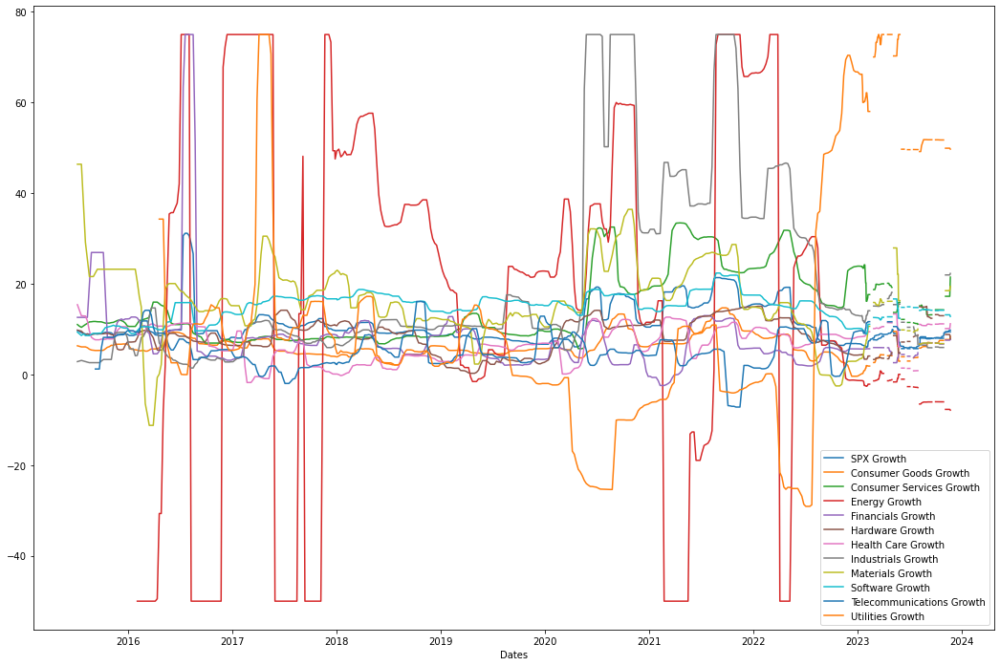

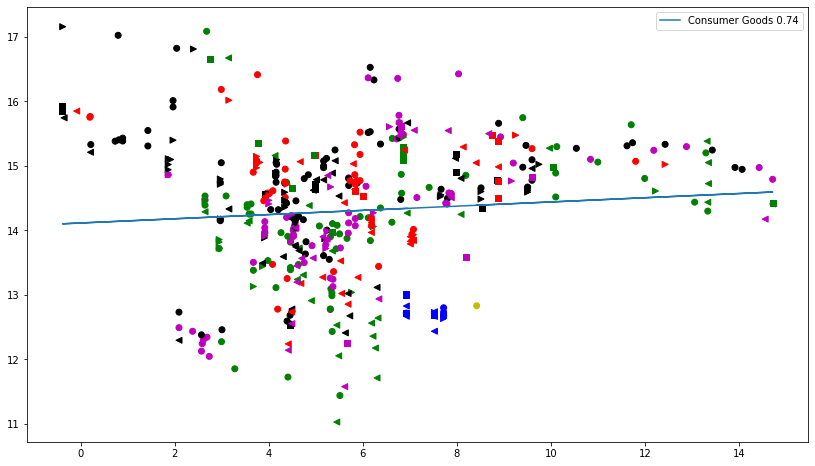

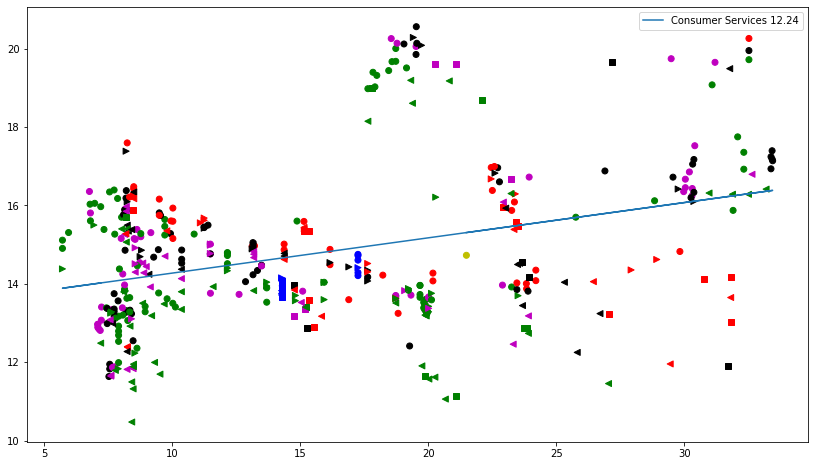

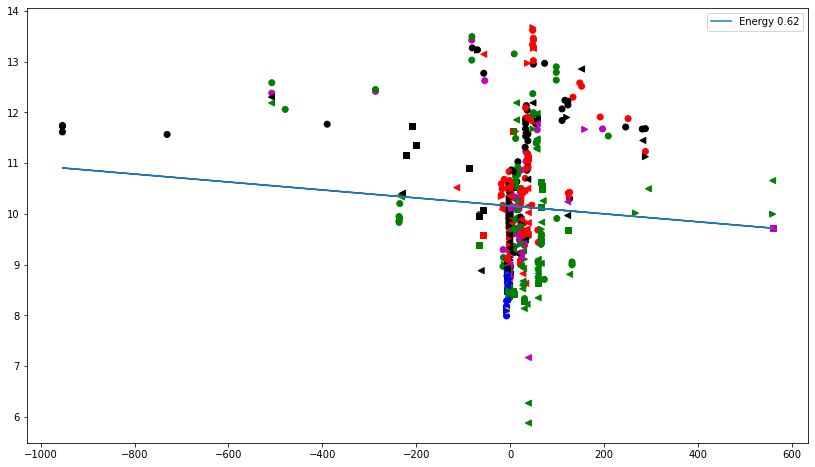

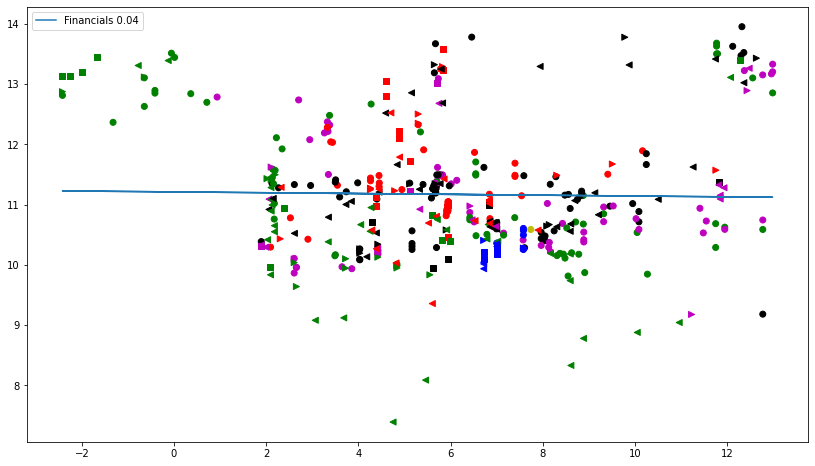

...

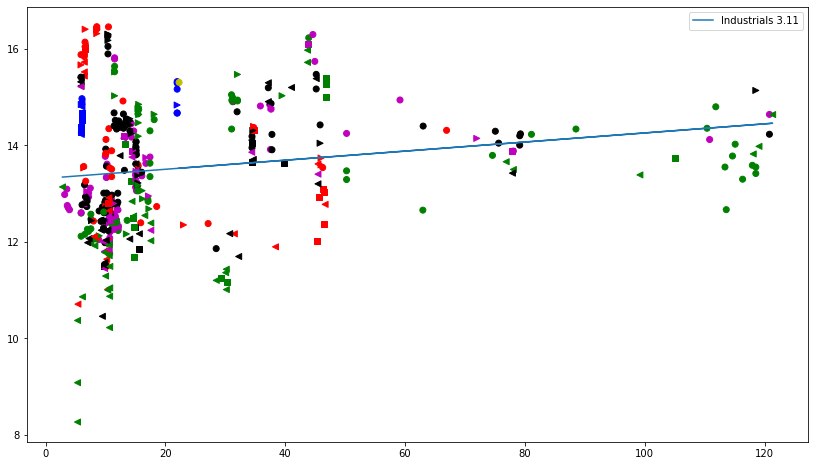

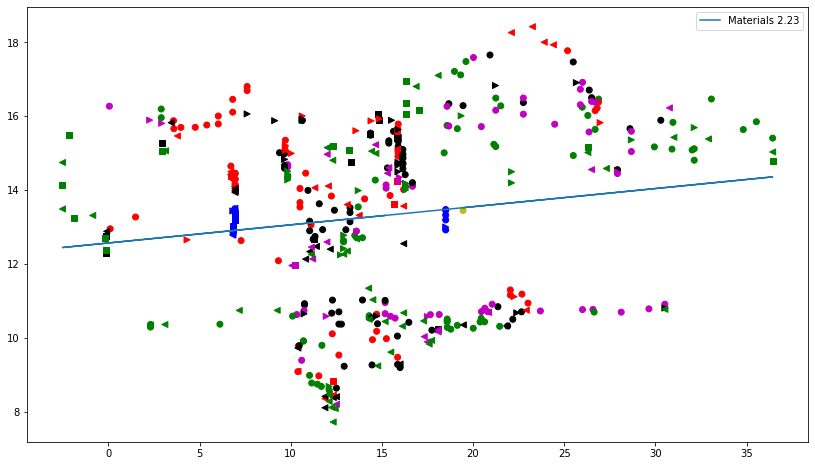

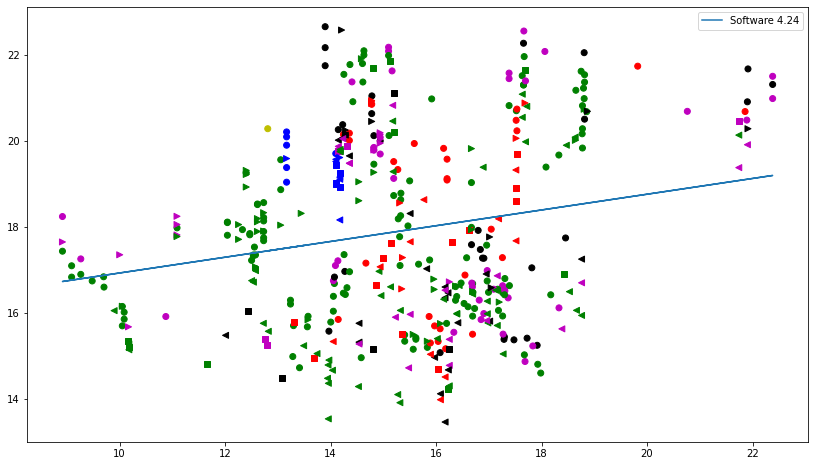

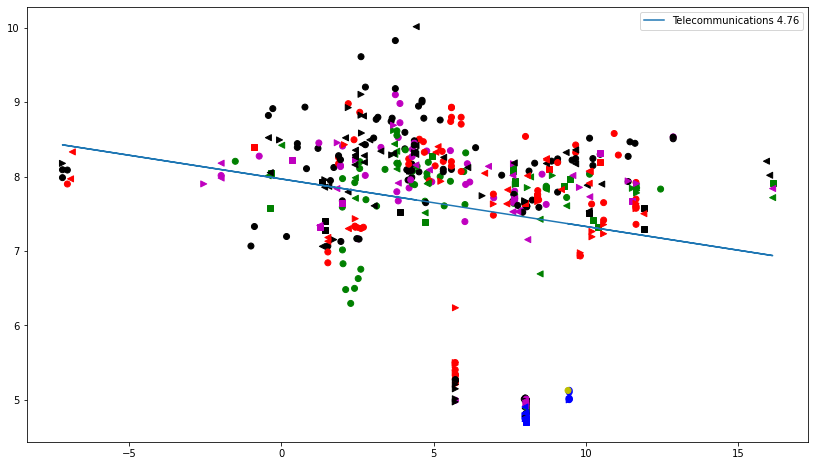

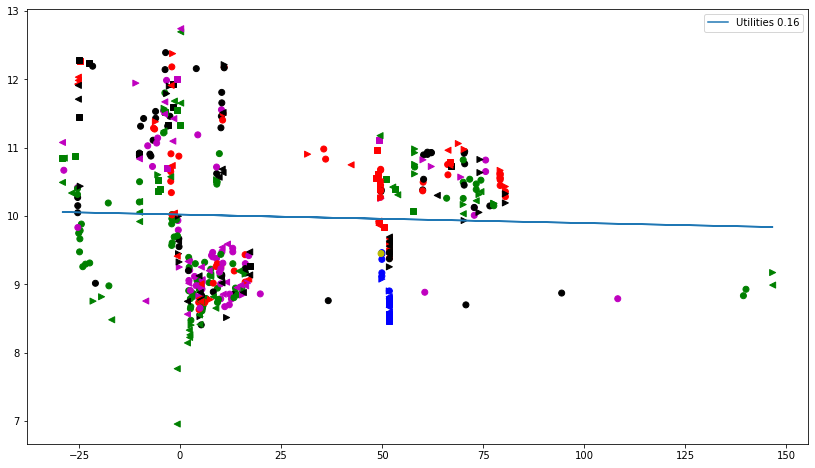

In [111]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\pe_visual.py

#P/E Visualization

from sklearn.linear_model import LinearRegression
to_summary = lambda x: summary_dict[x]
forecast_weight = 3

def loop_plot(plots, shapes):
    figs = {}
    axs = {}
    r_tot = 0
    markers = ['o', 's', '>', '<']
    
    for idx, plot in enumerate(plots):
        color_array = np.array(list(plot[2]) + ['b'] * (len(plot[0]) - len(plot[2]) - 1) + ['y'])
        figs[idx] = plt.figure(figsize = (14, 8))
        axs[idx] = figs[idx].add_subplot(1, 1, 1)
        
        for shape in np.unique(shapes):
            axs[idx].scatter(plot[0][shapes == shape], plot[1][shapes == shape], marker = markers[shape], c = color_array[shapes == shape])

        x_axis = plot[0].reshape(-1, 1)
        y_axis = plot[1]
        model = LinearRegression().fit(x_axis, y_axis)
        r_sq = model.score(x_axis, y_axis)
        y0 = model.intercept_
        growth = model.coef_[0]
        r2_curr = round(100 * r_sq, 2)
        r_tot = r_tot + r2_curr
        axs[idx].plot(x_axis, y0 + model.coef_[0] * x_axis, label = plot[3] + ' ' + str(r2_curr))
    
    return figs, axs, r_tot

map_position = lambda x: curr_series.index(x)

sectors_pe_df = sectors_pe_df.replace({np.inf: np.nan})
sectors_pe_df.fillna(method = 'ffill', inplace = True)
start_date = sectors_pe_df.index[0]

query_sector_prices = 'SELECT * FROM sector_indexes'    
Sector_Prices_df = pd.read_sql_query(query_sector_prices, engine)
Sector_Prices_df = Set_DF(Sector_Prices_df)
Sector_Prices_df = DD_Index(Sector_Prices_df)

ext = '_oi'
query_spx = "SELECT * FROM spx" + ext
spx_df = pd.read_sql_query(query_spx, engine)
spx_df = Set_DF(spx_df)
spx_df = DD_Index(spx_df)
spx_df['Realized'] = round(100 * (spx_df['Current'] / spx_df['Previous'] - 1), 2)
spx_df['Forecast'] = round(100 * (spx_df['Next'] / spx_df['Current'] - 1), 2)
oi_summary_df = pd.DataFrame(np.nan, index = spx_df.index, columns = ['SPX Realized', 'SPX Forecast'])
oi_summary2_df = pd.DataFrame(np.nan, index = spx_df.index, columns = ['SPX Growth'])

oi_summary_df['SPX Realized'] = spx_df['Realized']
oi_summary_df['SPX Forecast'] = spx_df['Forecast']
oi_summary2_df['SPX Growth'] = ((oi_summary_df['SPX Realized'] + forecast_weight * oi_summary_df['SPX Forecast']) / (1 + forecast_weight)).rolling(5, min_periods = 1).median()

for current_sector in sectors_pe_df.columns:
    query_sector = "SELECT * FROM " + re.sub(r'[^a-z_^0-9]', '', current_sector.lower()) + ext
    current_realized = current_sector + ' Realized'
    current_forecast = current_sector + ' Forecast'
    sector_df = pd.read_sql_query(query_sector, engine)
    sector_df = Set_DF(sector_df)
    sector_df = DD_Index(sector_df)
    sector_df[current_realized] = round(100 * (sector_df['Current'] / sector_df['Previous'] - 1), 2)
    sector_df[current_forecast] = round(100 * (sector_df['Next'] / sector_df['Current'] - 1), 2)
    oi_summary_df = oi_summary_df.join(sector_df[current_realized])
    oi_summary_df = oi_summary_df.join(sector_df[current_forecast])
    
    oi_summary2_df[current_sector + ' Growth'] = ((oi_summary_df[current_sector + ' Realized'] + forecast_weight * oi_summary_df[current_sector + ' Forecast']) / (1 + forecast_weight)).rolling(6, min_periods = 1).median() #/ ((oi_summary2_df['SPX Growth']).clip(1, 9) ** (1 / 3))
oi_summary_df.dropna(thresh = 5, axis = 0, inplace = True)

oi_summary2_df.clip(-50, 75).plot(figsize = (18, 12), legend = 'best')

oi_summary2_df.drop(['SPX Growth'], axis = 1, inplace = True)
oi_summary2_df.dropna(axis = 0, inplace = True)
oi_summary2_df = oi_summary2_df[oi_summary2_df.index >= start_date]

lag = 42
lower_bound = -0.04
upper_bound = 0.01
upper_bound2 = 0.04

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_sector_prices = 'SELECT * FROM sector_indexes'    
Sector_Prices_df = pd.read_sql_query(query_sector_prices, engine)
Sector_Prices_df = Set_DF(Sector_Prices_df)
Sector_Prices_df = DD_Index(Sector_Prices_df)
Sector_Prices_df.dropna(how = 'all', inplace = True)
Sector_Prices_df = Sector_Prices_df.join(Prices_df['SPX'])
Sector_Returns_df = (Sector_Prices_df.shift(-lag) / Sector_Prices_df - 1).dropna()
Ret_SPX = Sector_Returns_df['SPX']

Sector_Returns_df.drop(['SPX'], axis = 1, inplace = True)
#Sector_Returns_df = Sector_Returns_df.T - Ret_SPX
#Sector_Returns_df = Sector_Returns_df.T

rank = input('Rank sectors (Y/N)?').upper()
if (rank == 'Y'):
    lower_bound = 3
    upper_bound = 7
    upper_bound2 = 7
    for element in Sector_Returns_df.index:
        curr_series = Sector_Returns_df.loc[element].sort_values().index.values.tolist()
        Sector_Returns_df.loc[element] = Sector_Returns_df.columns.map(map_position)

Color_Codes_df = oi_summary2_df.join(Sector_Returns_df)
Color_Codes_df = Color_Codes_df[Sector_Returns_df.columns].dropna()

for x in Color_Codes_df.index:
    for y in Color_Codes_df.columns:
        if (Color_Codes_df.loc[x, y] < lower_bound):
            Color_Codes_df.loc[x, y] = 'r'
        elif (Color_Codes_df.loc[x, y] > upper_bound):
            if (Color_Codes_df.loc[x, y] < upper_bound2):
                Color_Codes_df.loc[x, y] = 'm'
            else:
                Color_Codes_df.loc[x, y] = 'g'
        else:
            Color_Codes_df.loc[x, y] = 'k'
            

Shape_Codes_df = pd.DataFrame(rr_df.loc[oi_summary2_df.index]['Real Yields Inv'].values, index = oi_summary2_df.index, columns = ['RR'])
Shape_Codes_df['TA'] = rr_df.loc[oi_summary2_df.index]['MAV QQQ'].values
Shape_Codes_df['Shapes'] = 0

for element in Shape_Codes_df.index:
    if (Shape_Codes_df.loc[element, 'RR'] == 1):
        if (Shape_Codes_df.loc[element, 'TA'] == 1):
            Shape_Codes_df.loc[element, 'Shapes'] = 1
        else:
            Shape_Codes_df.loc[element, 'Shapes'] = 2
    else:
        if (Shape_Codes_df.loc[element, 'TA'] == 1):
            Shape_Codes_df.loc[element, 'Shapes'] = 3
Shape_Codes_List = Shape_Codes_df['Shapes'].values.tolist()

r_tot = 0
sector_list = sectors_pe_df.columns.values.tolist()
sector_list = ['Software']

for sector in oi_summary2_df.columns:
    oi_summary2_df[sector] = oi_summary2_df[sector].replace({np.nan: oi_summary2_df[sector].dropna()[0]})

shapes = np.array(Shape_Codes_List)
plots = zip(np.array(oi_summary2_df.T), np.array(sectors_pe_df.loc[oi_summary2_df.index].T), np.array(Color_Codes_df.T), np.array(Sector_Returns_df.columns))
figs, axs, r_tot = loop_plot(plots, shapes) 

for idx in enumerate(axs):
    axs[idx[0]].legend(loc = 'best')
    
print('Fit quality: ' + str(r_tot))

In [ ]:
floor_zero = lambda x: max(x, 0)


sector_list = Sector_Prices_df.columns
em_df = pd.DataFrame(np.nan, index = Sector_Prices_df.index[Sector_Prices_df.index > oi_summary_df.index[0]], columns = ['Drop'])
#sector_list = ['Software']
new_oi_summary_df = em_df.join(oi_summary_df)
new_oi_summary_df.drop(['Drop'], axis = 1,  inplace = True)
new_oi_summary_df.fillna(method = 'ffill', inplace = True)
new_oi_summary_df.dropna(how = 'all', inplace = True)
em_df = em_df.loc[new_oi_summary_df.index]

for sector in sector_list:

    sector_series = (((new_oi_summary_df[sector + ' Realized'] - new_oi_summary_df[sector + ' Forecast']).map(floor_zero) + oi_summary_df[sector + ' Forecast']) - ((oi_summary_df[sector + ' Realized'] - new_oi_summary_df[sector + ' Forecast']).map(floor_zero) + new_oi_summary_df[sector + ' Forecast']).rolling(42, min_periods = 1).mean()).rolling(21, min_periods = 1).mean().dropna()
    sector_series.name = sector + ' em'
    em_df = em_df.join(sector_series)

em_df.drop(['Drop'], axis = 1, inplace = True)
em_df.fillna(method = 'ffill', inplace = True)
em_df = em_df.replace({0: np.nan})
em_df.dropna(how = 'all', inplace = True)
em_df = em_df.replace({np.nan: 0})

ranking = lambda x: int(list(current_em_series).index(x))
em_df.T.fillna('mean', inplace = True)
em_df.drop(['SPX em'], axis = 1, inplace = True)

for current_date in em_df.index:
    
    current_em_series = em_df.loc[current_date].sort_values(ascending = True).index
    em_df.loc[current_date] = em_df.columns.map(ranking) + 1

sector = 'Consumer Goods'
em_df[sector + ' em'].plot(figsize = (18, 12)).twinx()
Sector_Prices_df[sector].plot(c = 'g')
    
em_df

Enter Start Date: (YY/MM/DD)17/01/01


Energy                -45.0
Hardware               25.0
Industrials            31.0
Health Care            31.0
Financials             32.0
Materials              44.0
Consumer Goods         60.0
Telecommunications     62.0
Utilities              62.0
Software               65.0
Consumer Services      71.0
Real Yields Inv       100.0
Name: Real Yields Inv, dtype: float64

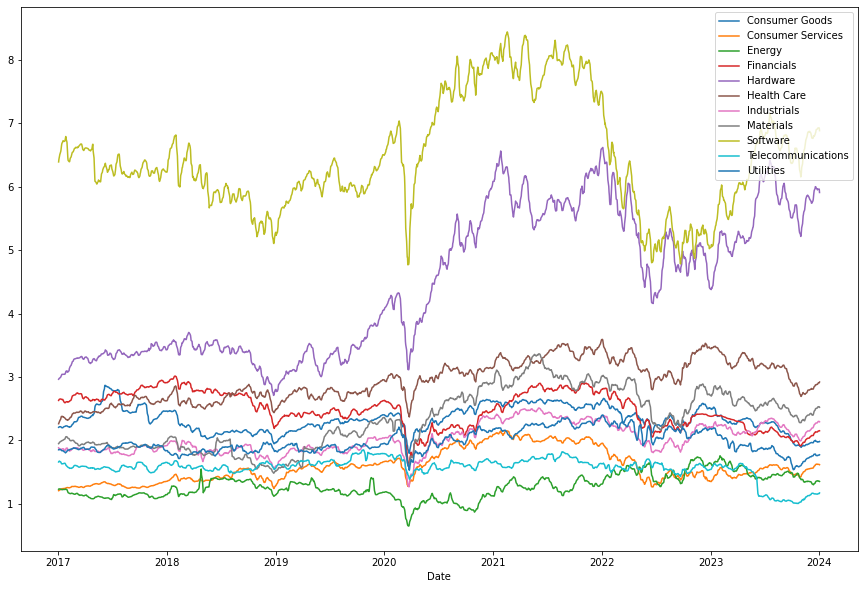

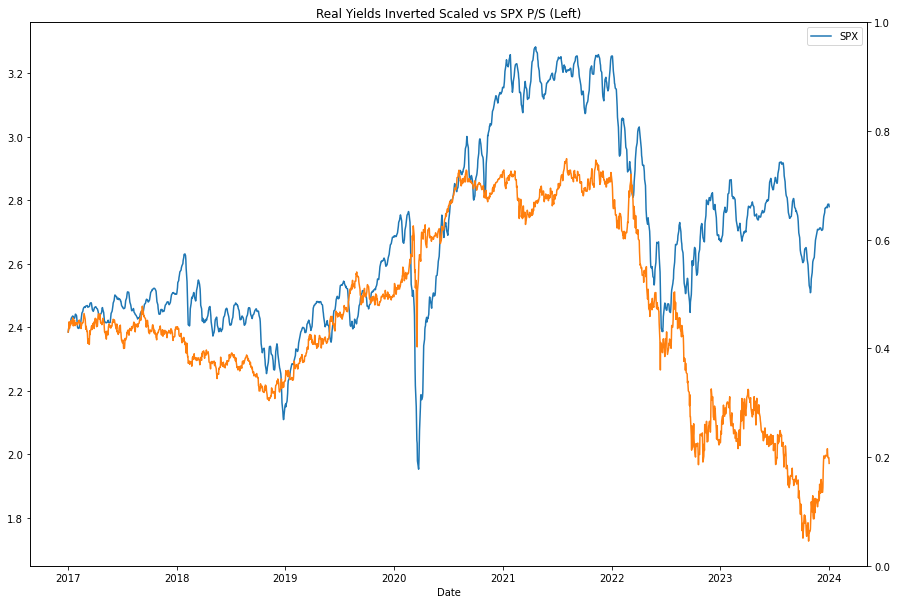

In [109]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\sector_ps.py

#Sector P/Ss


import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def offset(c_stock, i_list, d_list, t_date, r_date, div_i):
    
    cutoff_date = r_date
    Start_Date = t_date
    ed_list = d_list
    y_list = i_list
    cur_index = 0
    nd_list = []
    for cur_ed_date in ed_list:                            
        cont=0
        seek_element = True
        ced = cur_ed_date
        cur_index = ed_df[c_stock].values.tolist()[cur_index:].index(cur_ed_date) + cur_index
        cur_index_plus = cur_index + 1
        if (cur_index_plus<len(ed_df.index)):
            cur_year = ed_df.index[cur_index_plus][len(ed_df.index[cur_index_plus])-4:]
        else:
            cur_year = today.year
        cur_ed_date = str(cur_year) + '-' + cur_ed_date[0:2] + '-' + cur_ed_date[2:]
        cur_ed_date = datetime.strptime(cur_ed_date, "%Y-%m-%d").date()
        if (cur_ed_date < cutoff_date):
            nd_list.append(cur_ed_date)        
    
    offs = round_down(len(pd.Series(nd_list)[pd.Series(nd_list) > t_date]) / div_i, 0)
    
    return offs

def on_selection(value):
    global choice
    choice = value  # store the user's choice
    root.destroy()  # close window

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")
engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

clean_up = lambda x: re.sub(r'[^A-Z /^0-9]', '', str(x))
clean_up_save = lambda x: re.sub(r'[^A-Z ^0-9]', '', str(x))
to_pxs = lambda x: Prices_df.loc[current_date, x]
clean_date = lambda x: datetime.strptime(x, "%d-%b-%y").date()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

today = date.today()

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

Cutoff_Date = input("Enter Start Date: (YY/MM/DD)")
if (Cutoff_Date != ''):
    Cutoff_Date = datetime.strptime(Cutoff_Date, "%y/%m/%d").date()
else:
    Cutoff_Date = Val3_df.index[0]

query_mc = 'SELECT * FROM mkt_cap_relation'    
mc_df = pd.read_sql_query(query_mc, engine)
mc_df = Set_DF(mc_df)
mc_df = DD_Index(mc_df)
new_mc_df = mc_df.loc[mc_df.index >= Cutoff_Date][::-1]

query_val3 = "SELECT * FROM valuations_ps_relation"
Val3_df = pd.read_sql_query(query_val3, engine_metrics)
Val3_df = Set_DF(Val3_df)
Val3_df = DD_Index(Val3_df)
Val3_df = Val3_df[Val3_df.index >= Cutoff_Date][::-1]

s_df = (1 / Val3_df) * new_mc_df

sectors = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Custom_Segmentation.csv")
Sectors_df = pd.DataFrame(sectors)
Sectors_df = Set_DF(Sectors_df)
Sectors_df = DD_Index(Sectors_df)
    
choice_list = Sectors_df.columns.values.tolist()
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a classification: (Custom Sector 1)").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()   

map_sectors = lambda x: Sectors_df.loc[x, choice]

s_grouped = s_df.groupby(s_df.columns.map(map_sectors), axis = 1)
sectors_s_df = s_grouped.sum()

p_grouped = new_mc_df.groupby(new_mc_df.columns.map(map_sectors), axis = 1)
sectors_p_df = p_grouped.sum()

sectors_ps_df = sectors_p_df / sectors_s_df
spx_proxy = pd.DataFrame(sectors_ps_df.mean(axis = 1), index = sectors_ps_df.index, columns = ['SPX'])

ry_series = ((Prices_df[Prices_df.index >= spx_proxy.index[0]]['T10YIE'] - Prices_df[Prices_df.index >= spx_proxy.index[0]]['USGG10YR']))
std_ry_series = ry_series * (spx_proxy.rolling(5, min_periods = 1).mean().std().values[0] / ry_series.std())
std_ry_series = std_ry_series + (spx_proxy.iloc[0]['SPX'] - std_ry_series.iloc[0])
std_ry_series.name = 'Real Yields Inv'

sectors_ps_df.rolling(5, min_periods = 1).mean().plot(figsize = (15,10))
sectors_ps_df.to_sql('sectors_ps_relation', engine_metrics, index=True, if_exists='replace')
#std_ry_series.plot().twinx()

spx_proxy.rolling(5, min_periods = 1).mean().plot(figsize = (15,10), title = 'Real Yields Inverted Scaled vs SPX P/S (Left)')
std_ry_series.plot().twinx()
sectors_ps_smooth = sectors_ps_df.rolling(5, min_periods = 1).mean().join(std_ry_series)
round(100 * sectors_ps_smooth.corr()['Real Yields Inv'].sort_values())

Rank sectors (Y/N)?N
Fit quality: 88.86


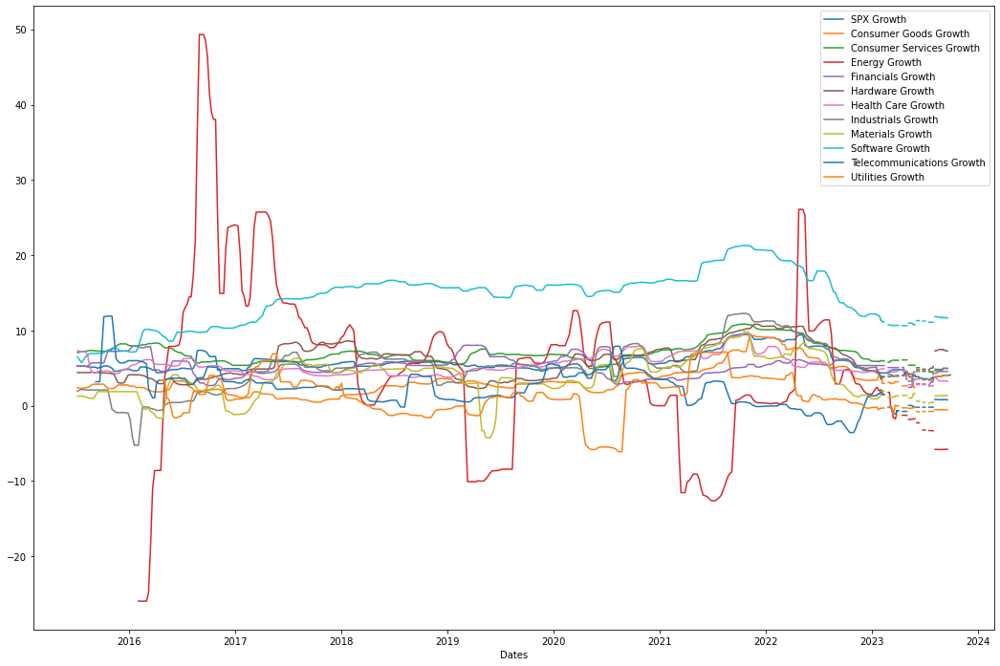

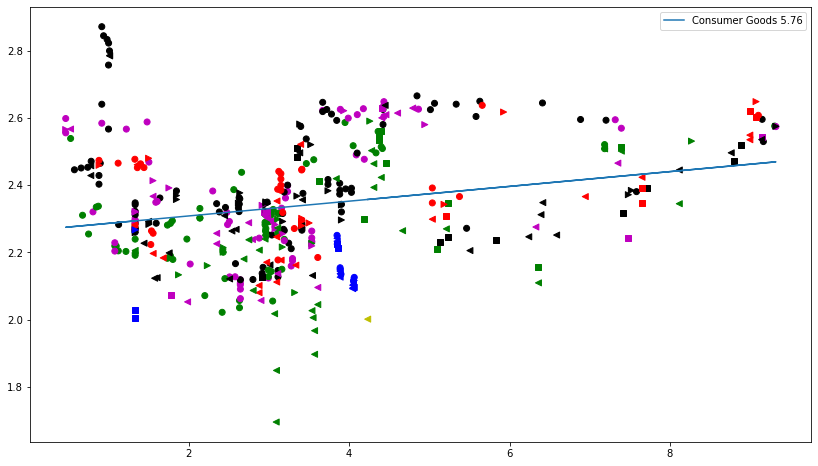

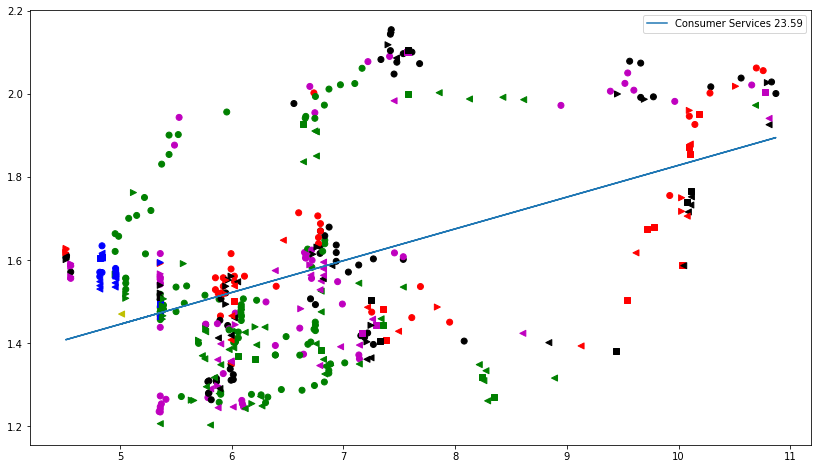

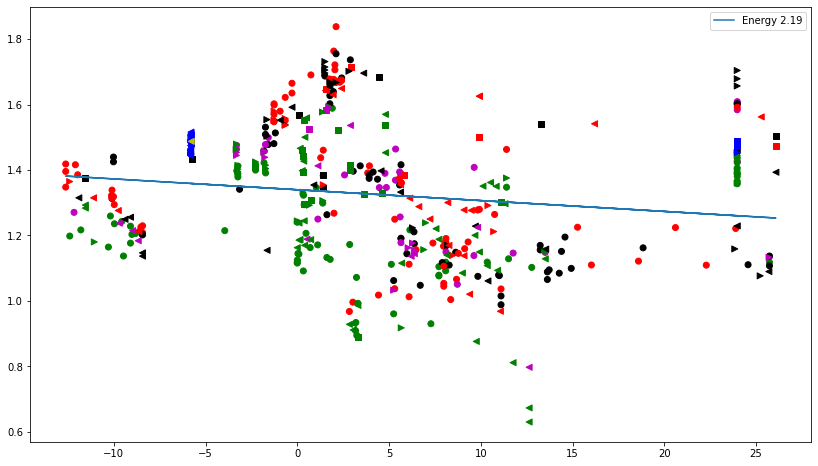

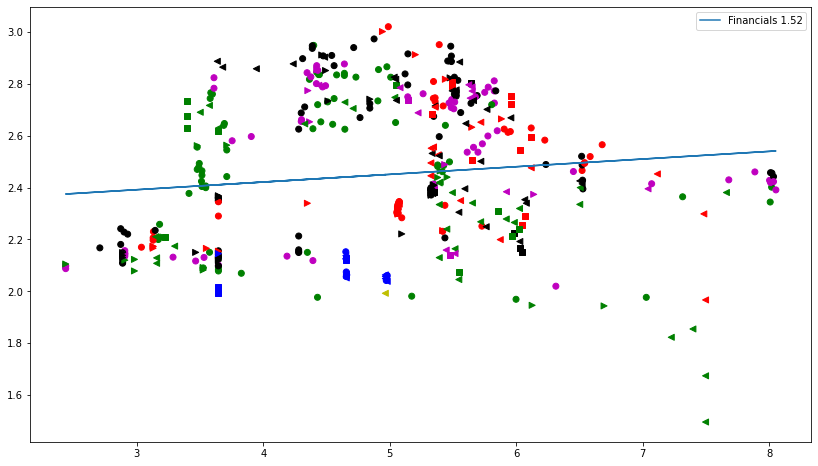

...

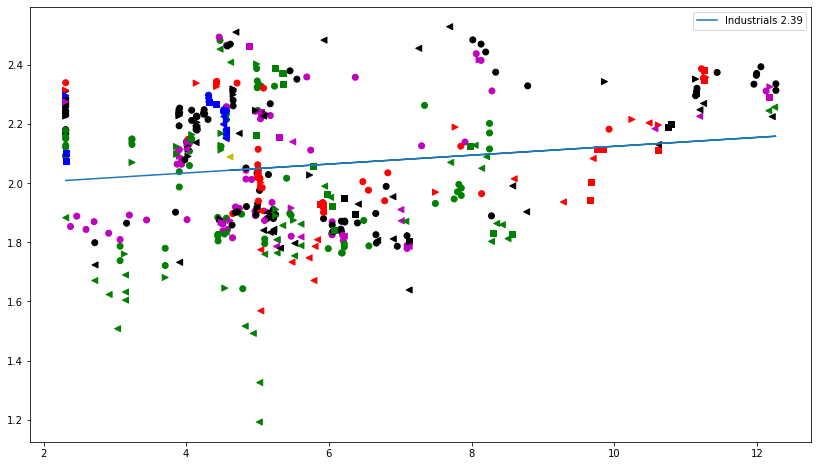

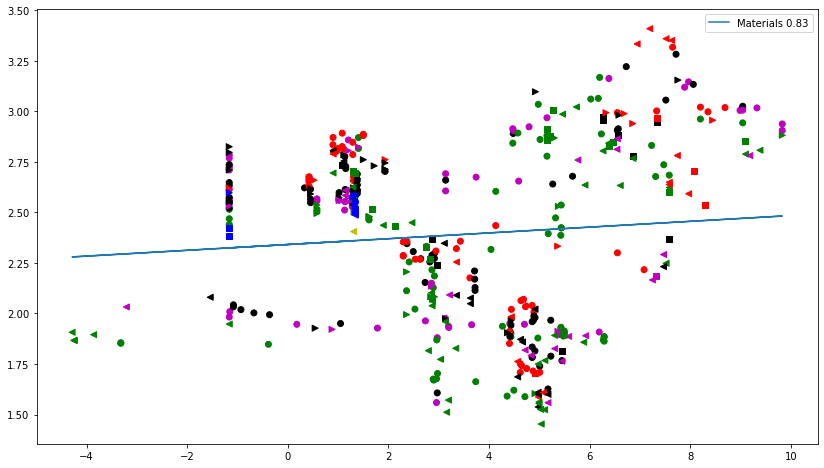

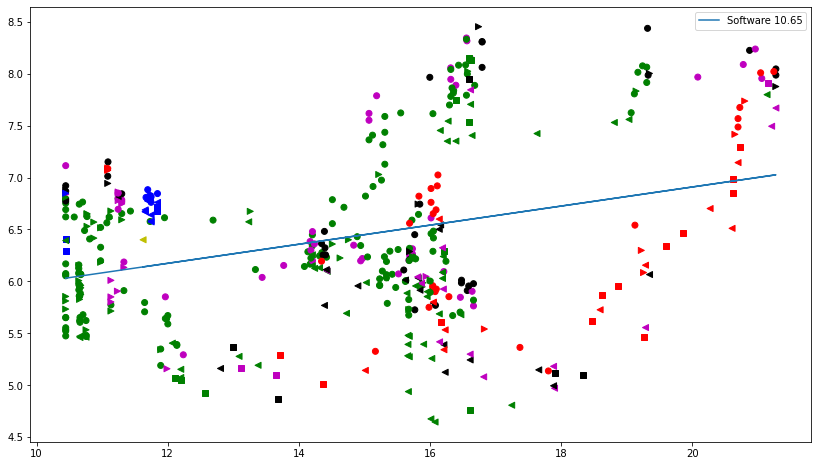

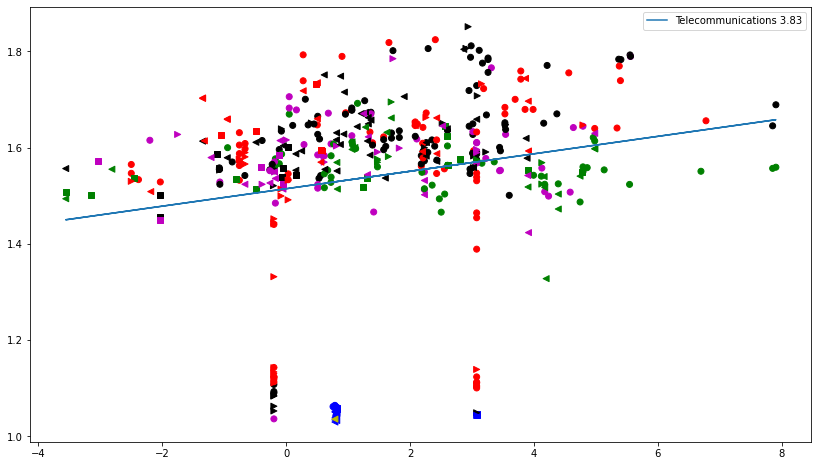

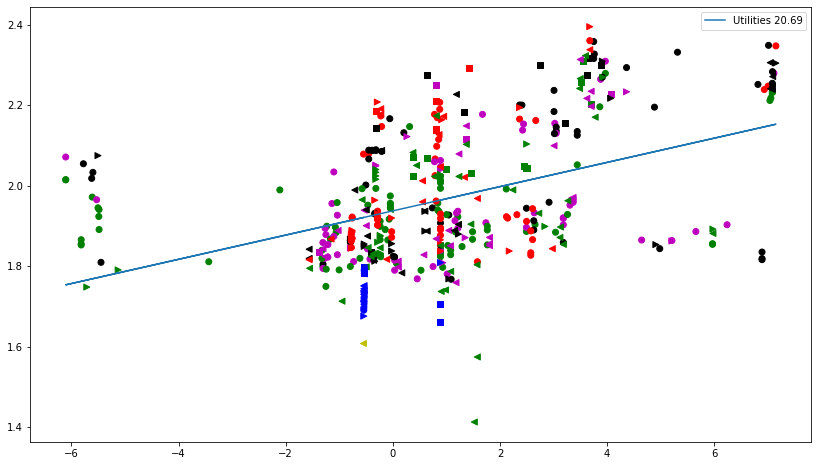

In [304]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\ps_visual.py

#P/S Visualization

from sklearn.linear_model import LinearRegression
to_summary = lambda x: summary_dict[x]
forecast_weight = 3

def loop_plot(plots, shapes):
    figs = {}
    axs = {}
    r_tot = 0
    markers = ['o', 's', '>', '<']
    
    for idx, plot in enumerate(plots):
        color_array = np.array(list(plot[2]) + ['b'] * (len(plot[0]) - len(plot[2]) - 1) + ['y'])
        figs[idx] = plt.figure(figsize = (14, 8))
        axs[idx] = figs[idx].add_subplot(1, 1, 1)
        
        for shape in np.unique(shapes):
            axs[idx].scatter(plot[0][shapes == shape], plot[1][shapes == shape], marker = markers[shape], c = color_array[shapes == shape])

        x_axis = plot[0].reshape(-1, 1)
        y_axis = plot[1]
        model = LinearRegression().fit(x_axis, y_axis)
        r_sq = model.score(x_axis, y_axis)
        y0 = model.intercept_
        growth = model.coef_[0]
        r2_curr = round(100 * r_sq, 2)
        r_tot = r_tot + r2_curr
        axs[idx].plot(x_axis, y0 + model.coef_[0] * x_axis, label = plot[3] + ' ' + str(r2_curr))
    
    return figs, axs, r_tot

map_position = lambda x: curr_series.index(x)

sectors_ps_df = sectors_ps_df.replace({np.inf: np.nan})
sectors_ps_df.fillna(method = 'ffill', inplace = True)
start_date = sectors_ps_df.index[0]

query_sector_prices = 'SELECT * FROM sector_indexes'    
Sector_Prices_df = pd.read_sql_query(query_sector_prices, engine)
Sector_Prices_df = Set_DF(Sector_Prices_df)
Sector_Prices_df = DD_Index(Sector_Prices_df)

ext = '_rev'
query_spx = "SELECT * FROM spx" + ext
spx_df = pd.read_sql_query(query_spx, engine)
spx_df = Set_DF(spx_df)
spx_df = DD_Index(spx_df)
spx_df['Realized'] = round(100 * (spx_df['Current'] / spx_df['Previous'] - 1), 2)
spx_df['Forecast'] = round(100 * (spx_df['Next'] / spx_df['Current'] - 1), 2)
rev_summary_df = pd.DataFrame(np.nan, index = spx_df.index, columns = ['SPX Realized', 'SPX Forecast'])
rev_summary2_df = pd.DataFrame(np.nan, index = spx_df.index, columns = ['SPX Growth'])

rev_summary_df['SPX Realized'] = spx_df['Realized']
rev_summary_df['SPX Forecast'] = spx_df['Forecast']
rev_summary2_df['SPX Growth'] = ((rev_summary_df['SPX Realized'] + forecast_weight * rev_summary_df['SPX Forecast']) / (1 + forecast_weight)).rolling(5, min_periods = 1).median()

for current_sector in sectors_ps_df.columns:
    query_sector = "SELECT * FROM " + re.sub(r'[^a-z_^0-9]', '', current_sector.lower()) + ext
    current_realized = current_sector + ' Realized'
    current_forecast = current_sector + ' Forecast'
    sector_df = pd.read_sql_query(query_sector, engine)
    sector_df = Set_DF(sector_df)
    sector_df = DD_Index(sector_df)
    sector_df[current_realized] = round(100 * (sector_df['Current'] / sector_df['Previous'] - 1), 2)
    sector_df[current_forecast] = round(100 * (sector_df['Next'] / sector_df['Current'] - 1), 2)
    rev_summary_df = rev_summary_df.join(sector_df[current_realized])
    rev_summary_df = rev_summary_df.join(sector_df[current_forecast])
    
    rev_summary2_df[current_sector + ' Growth'] = ((rev_summary_df[current_sector + ' Realized'] + forecast_weight * rev_summary_df[current_sector + ' Forecast']) / (1 + forecast_weight)).rolling(6, min_periods = 1).median() #/ ((rev_summary2_df['SPX Growth']).clip(1, 9) ** (1 / 3))
rev_summary_df.dropna(thresh = 5, axis = 0, inplace = True)
rev_summary2_df.plot(figsize = (18, 12), legend = 'best')
rev_summary2_df.drop(['SPX Growth'], axis = 1, inplace = True)
rev_summary2_df = rev_summary2_df[rev_summary2_df.index >= start_date]

lag = 42
lower_bound = -0.04
upper_bound = 0.01
upper_bound2 = 0.04

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_sector_prices = 'SELECT * FROM sector_indexes'    
Sector_Prices_df = pd.read_sql_query(query_sector_prices, engine)
Sector_Prices_df = Set_DF(Sector_Prices_df)
Sector_Prices_df = DD_Index(Sector_Prices_df)
Sector_Prices_df.dropna(how = 'all', inplace = True)
Sector_Prices_df = Sector_Prices_df.join(Prices_df['SPX'])
Sector_Returns_df = (Sector_Prices_df.shift(-lag) / Sector_Prices_df - 1).dropna()
Ret_SPX = Sector_Returns_df['SPX']

Sector_Returns_df.drop(['SPX'], axis = 1, inplace = True)
#Sector_Returns_df = Sector_Returns_df.T - Ret_SPX
#Sector_Returns_df = Sector_Returns_df.T

rank = input('Rank sectors (Y/N)?').upper()
if (rank == 'Y'):
    lower_bound = 3
    upper_bound = 7
    upper_bound2 = 7
    for element in Sector_Returns_df.index:
        curr_series = Sector_Returns_df.loc[element].sort_values().index.values.tolist()
        Sector_Returns_df.loc[element] = Sector_Returns_df.columns.map(map_position)

Color_Codes_df = rev_summary2_df.join(Sector_Returns_df)
Color_Codes_df = Color_Codes_df[Sector_Returns_df.columns].dropna()

for x in Color_Codes_df.index:
    for y in Color_Codes_df.columns:
        if (Color_Codes_df.loc[x, y] < lower_bound):
            Color_Codes_df.loc[x, y] = 'r'
        elif (Color_Codes_df.loc[x, y] > upper_bound):
            if (Color_Codes_df.loc[x, y] < upper_bound2):
                Color_Codes_df.loc[x, y] = 'm'
            else:
                Color_Codes_df.loc[x, y] = 'g'
        else:
            Color_Codes_df.loc[x, y] = 'k'
            

Shape_Codes_df = pd.DataFrame(rr_df.loc[rev_summary2_df.index]['Real Yields Inv'].values, index = rev_summary2_df.index, columns = ['RR'])
Shape_Codes_df['TA'] = rr_df.loc[rev_summary2_df.index]['MAV QQQ'].values
Shape_Codes_df['Shapes'] = 0

for element in Shape_Codes_df.index:
    if (Shape_Codes_df.loc[element, 'RR'] == 1):
        if (Shape_Codes_df.loc[element, 'TA'] == 1):
            Shape_Codes_df.loc[element, 'Shapes'] = 1
        else:
            Shape_Codes_df.loc[element, 'Shapes'] = 2
    else:
        if (Shape_Codes_df.loc[element, 'TA'] == 1):
            Shape_Codes_df.loc[element, 'Shapes'] = 3
Shape_Codes_List = Shape_Codes_df['Shapes'].values.tolist()

r_tot = 0
sector_list = sectors_ps_df.columns.values.tolist()
sector_list = ['Software']

for sector in rev_summary2_df.columns:
    rev_summary2_df[sector] = rev_summary2_df[sector].replace({np.nan: rev_summary2_df[sector].dropna()[0]})

shapes = np.array(Shape_Codes_List)
plots = zip(np.array(rev_summary2_df.T), np.array(sectors_ps_df.loc[rev_summary2_df.index].T), np.array(Color_Codes_df.T), np.array(Sector_Returns_df.columns))
figs, axs, r_tot = loop_plot(plots, shapes) 

for idx in enumerate(axs):
    axs[idx[0]].legend(loc = 'best')
    
print('Fit quality: ' + str(r_tot))

In [ ]:
floor_zero = lambda x: max(x, 0)


sector_list = Sector_Prices_df.columns
sm_df = pd.DataFrame(np.nan, index = Sector_Prices_df.index[Sector_Prices_df.index > rev_summary_df.index[0]], columns = ['Drop'])
#sector_list = ['Software']
new_rev_summary_df = sm_df.join(rev_summary_df)
new_rev_summary_df.drop(['Drop'], axis = 1,  inplace = True)
new_rev_summary_df.fillna(method = 'ffill', inplace = True)
new_rev_summary_df.dropna(how = 'all', inplace = True)
sm_df = sm_df.loc[new_rev_summary_df.index]

for sector in sector_list:

    sector_series = (((new_rev_summary_df[sector + ' Realized'] - new_rev_summary_df[sector + ' Forecast']).map(floor_zero) + rev_summary_df[sector + ' Forecast']) - ((rev_summary_df[sector + ' Realized'] - new_rev_summary_df[sector + ' Forecast']).map(floor_zero) + new_rev_summary_df[sector + ' Forecast']).rolling(42, min_periods = 1).mean()).rolling(21, min_periods = 1).mean().dropna()
    sector_series.name = sector + ' SM'
    sm_df = sm_df.join(sector_series)

sm_df.drop(['Drop'], axis = 1, inplace = True)
sm_df.fillna(method = 'ffill', inplace = True)
sm_df = sm_df.replace({0: np.nan})
sm_df.dropna(how = 'all', inplace = True)
sm_df = sm_df.replace({np.nan: 0})

ranking = lambda x: int(list(current_sm_series).index(x))
sm_df.T.fillna('mean', inplace = True)
sm_df.drop(['SPX SM'], axis = 1, inplace = True)

for current_date in sm_df.index:
    
    current_sm_series = sm_df.loc[current_date].sort_values(ascending = True).index
    sm_df.loc[current_date] = sm_df.columns.map(ranking) + 1

sector = 'Consumer Goods'
sm_df[sector + ' SM'].plot(figsize = (18, 12)).twinx()
Sector_Prices_df[sector].plot(c = 'g')
    
sm_df

In [12]:
#CREATES OPTIMAL SECTOR PORTFOLIOS - SHORT

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def round_up(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.ceil(n * multiplier) / multiplier)

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def on_selection(value):
    global choice
    choice = value
    root.destroy()

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()


cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

to_ETF = lambda x: Equivalence_df.loc[prev_date, x]
to_previous_prices = lambda x: Prices_df.loc[prev_date, x]
to_current_prices = lambda x: Prices_df.loc[current_date, x]

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

today = Prices_df.index[-1]

oride = False
oride_s = input("Override (Y/N)? ").upper()
if (oride_s == 'Y'):
    oride = True

query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

dates_list = Equivalence_df.index.values.tolist()

if ('equivalent_indexes_relation' in new_tables_list) & (not oride):
    query_eq_idx = 'SELECT * FROM equivalent_indexes_relation'    
    Equiv_Indexes_df = pd.read_sql_query(query_eq_idx, engine)
    Equiv_Indexes_df = Set_DF(Equiv_Indexes_df)
    Equiv_Indexes_df = DD_Index(Equiv_Indexes_df)
else:
    Equiv_Indexes_df = pd.DataFrame(np.nan, index = dates_list, columns = Equivalence_df.columns)
    Equiv_Indexes_df.iloc[0] = 1
    
if (oride):
    if (today not in dates_list):
        dates_list.append(today)
else:
    dates_list = dates_list[-2:]
    prev_date = Prices_df.index[Prices_df.index.values.tolist().index(today) - 1]
    

for idx, current_date in enumerate(dates_list):
    if (idx > 0):
        current_port_series = Equiv_Indexes_df.columns.map(to_ETF)
        previous_pxs_series = current_port_series.map(to_previous_prices)
        current_pxs_series = current_port_series.map(to_current_prices)
        base_series = Equiv_Indexes_df.loc[prev_date]
        Equiv_Indexes_df.loc[current_date] = base_series * (current_pxs_series / previous_pxs_series)
    
    prev_date = current_date
    
Equiv_Indexes_df.sort_index(inplace = True)
Equiv_Indexes_df.to_sql('equivalent_indexes_relation', engine, index = True, if_exists = 'replace')
Equiv_Indexes_df[-15:]

Override (Y/N)? Y


,Consumer Goods,Consumer Services,Energy,Financials,Hardware,Health Care,Industrials,Materials,Software,Telecommunications,Utilities
2023-12-07,1.447869,2.463404,1.071346,1.918501,3.879407,1.733903,1.974804,1.643606,3.126366,2.515285,1.531295
2023-12-08,1.437319,2.476240,1.083278,1.928146,3.896039,1.736859,1.983991,1.652481,3.139770,2.527930,1.525277
2023-12-11,1.450021,2.480177,1.085926,1.940384,3.927417,1.746649,2.000819,1.663977,3.165057,2.543976,1.536591
2023-12-12,1.453298,2.494857,1.073256,1.952660,3.954823,1.755585,2.011916,1.674667,3.183791,2.560070,1.531295
2023-12-13,1.481160,2.531985,1.085718,1.985485,4.009040,1.786728,2.032563,1.694232,3.231172,2.603105,1.587867
2023-12-14,1.460981,2.534152,1.115719,2.002030,4.001778,1.774704,2.057031,1.721460,3.225319,2.624798,1.566803
2023-12-15,1.458010,2.540576,1.107939,1.986285,4.018124,1.760447,2.049300,1.713998,3.238494,2.604155,1.537554
2023-12-18,1.463542,2.561345,1.110115,1.989221,4.042205,1.757950,2.044752,1.708552,3.257902,2.608004,1.522147
2023-12-19,1.466410,2.578256,1.123434,2.005233,4.062859,1.769777,2.060578,1.724284,3.274548,2.628996,1.530814
2023-12-20,1.443772,2.550014,1.117632,1.979667,4.014019,1.752760,2.037657,1.705123,3.235184,2.595478,1.513601


Ommit NP points? (Y/y or empty)Y


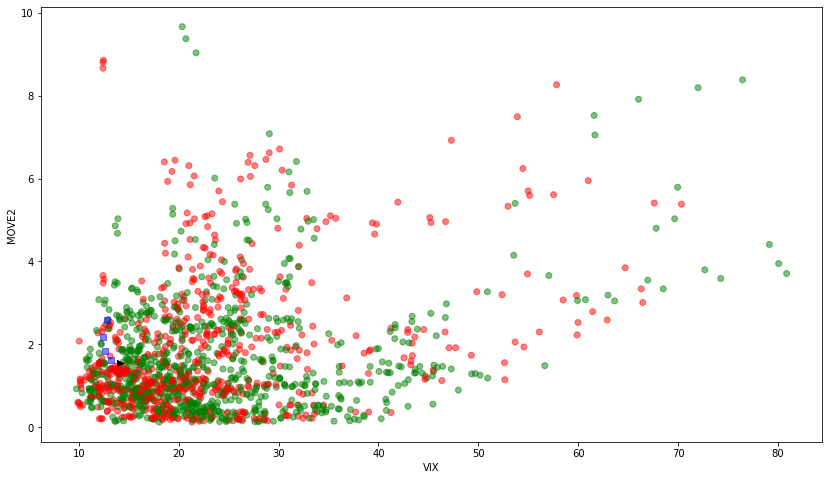

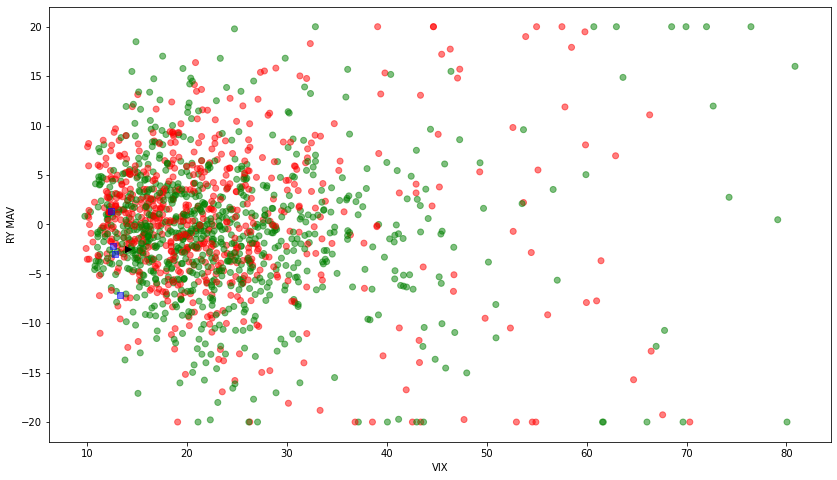

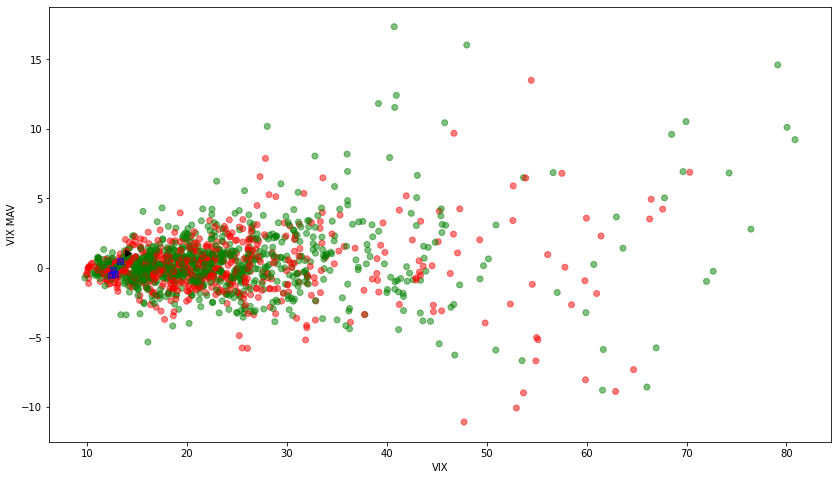

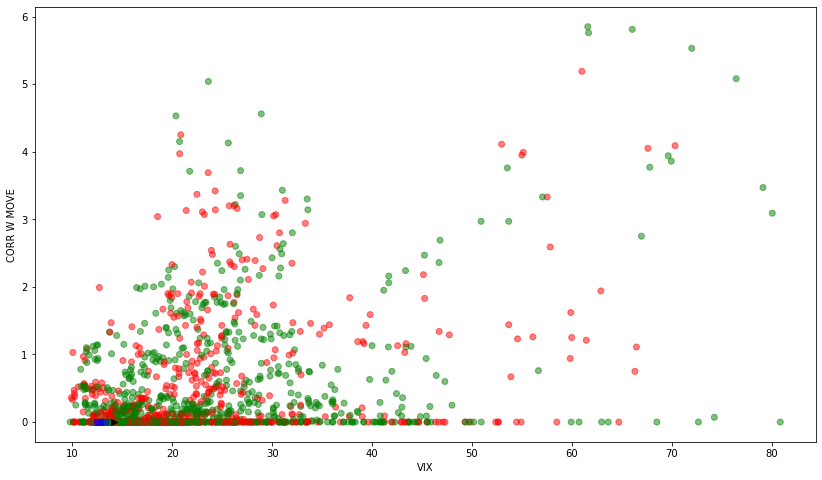

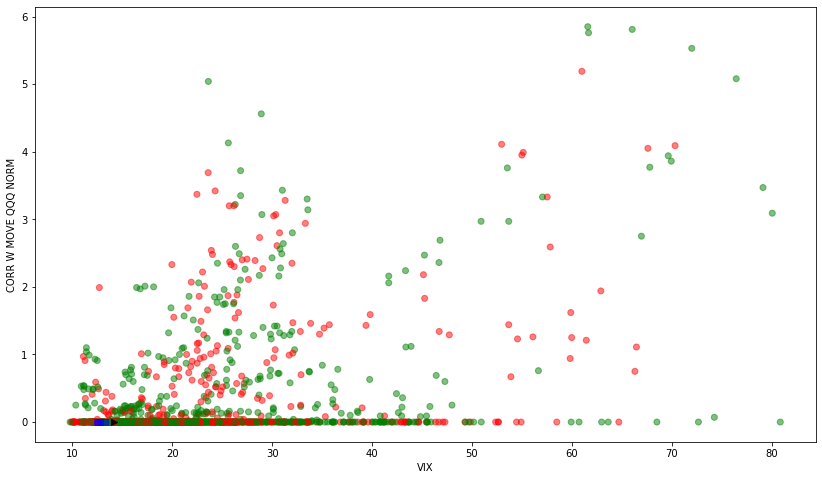

...

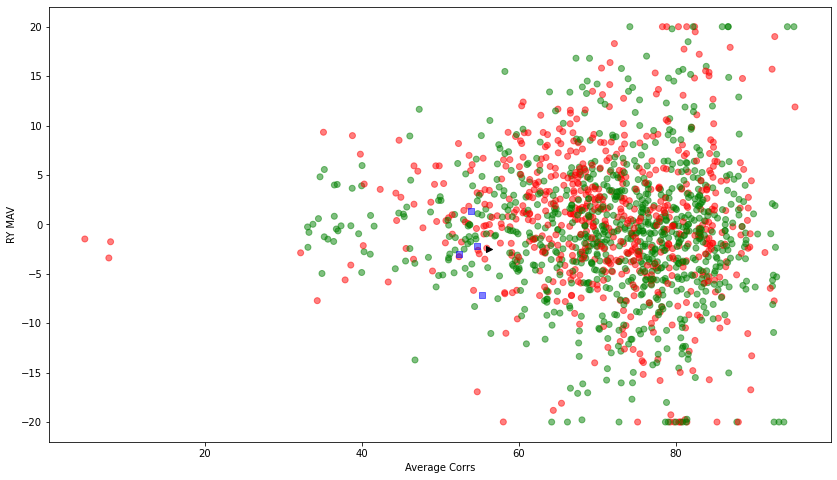

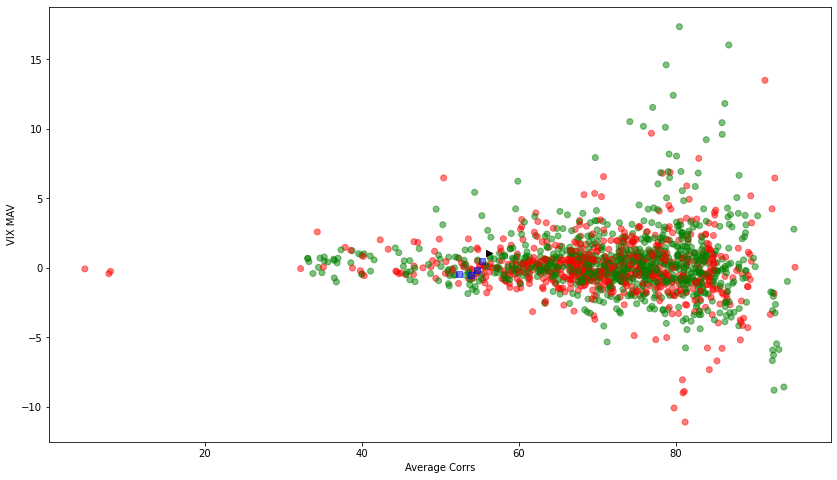

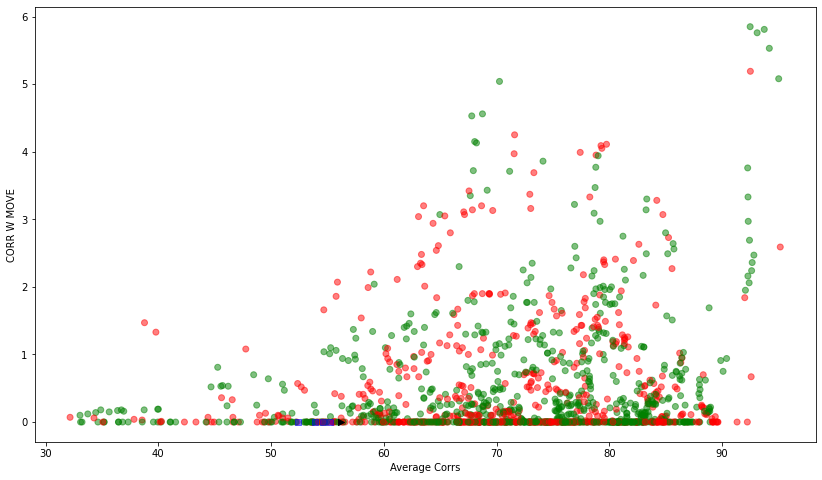

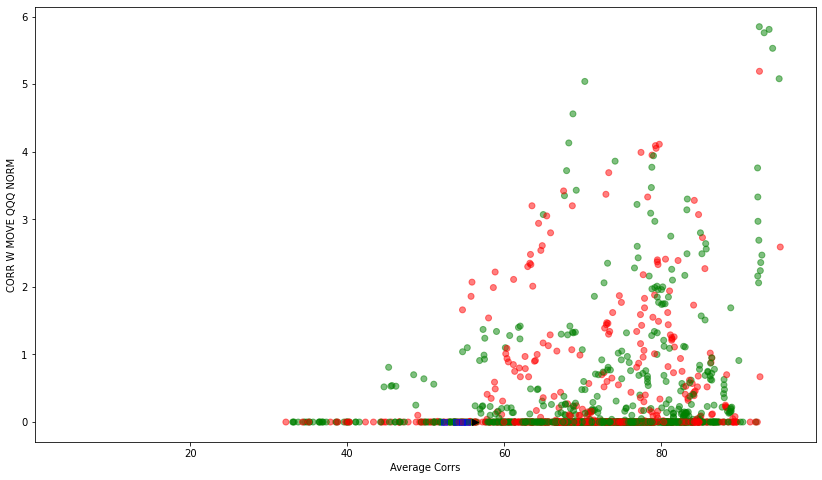

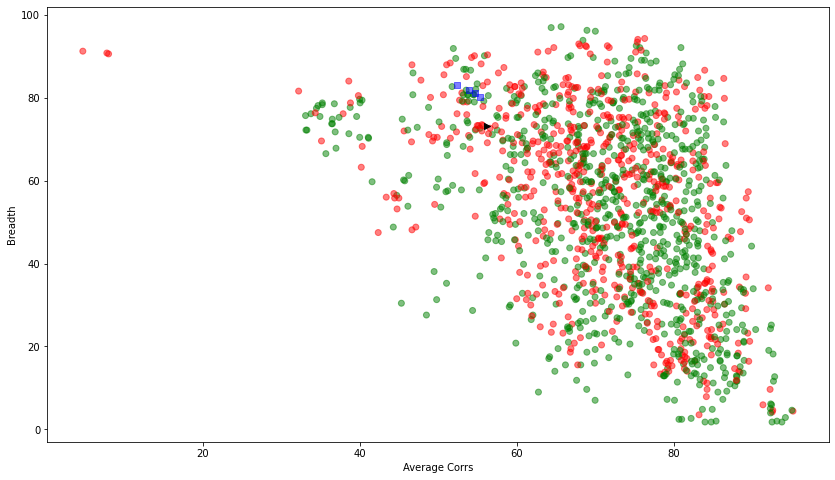

In [13]:
#Scatter Studies
import warnings

def round_up(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.ceil(n * multiplier) / multiplier)

warnings.filterwarnings('ignore')
to_roundup = lambda x: round_up(x)
to_int = lambda x: int(x)
markers = ['o', 's', '>', '<']
alphas = [0.5, 0.5, 1]
Sector_ETF_list = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US', 'XLF US',
'ARKK US', 'XLV US', 'QQQ US', 'SPX', 'IWM US', 'EWZ US']

thresh1 = 0
thresh2 = 7
move_sf = 5
window_corr = 21
window_mav = 5
window_mav2 = 14
window_ret = 5
window_move = 21
window_index = 42
margin = 0.5 / 100
move_thresh = 1
qqq_thresh = 2.5

Init_Date = datetime.strptime('2005-01-01', '%Y-%m-%d').date()

ommit = input('Ommit NP points? (Y/y or empty)').upper()
skip = False
if (ommit == 'Y'):
    skip = True
    
query_SPX = 'SELECT * FROM spx_constituents'    
SPXConstituents_df = pd.read_sql_query(query_SPX, engine)
SPXConstituents_df = Set_DF(SPXConstituents_df)
SPXConstituents_df = DD_Index(SPXConstituents_df)

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)
Returns_df = Prices_df.pct_change()
SectorReturns_df = Returns_df[Sector_ETF_list]

AggregateCorr_df = pd.DataFrame((SectorReturns_df.rolling(30).corr().unstack()['QQQ US'].sum(axis = 1) / len(SectorReturns_df.columns)), columns = ['Average Corrs'])
AggregateCorr_df = AggregateCorr_df.join((1 + Returns_df['QQQ US']).rolling(window_corr).apply(np.prod, raw = True) - 1)
AggregateCorr_df.dropna(inplace = True)
AggregateCorr_df = AggregateCorr_df[AggregateCorr_df.index > Init_Date]

SPX_list = SPXConstituents_df.iloc[0][SPXConstituents_df.iloc[0] != 'ZZZZ'].values.tolist()
SPX_list = [ticker for ticker in SPX_list if ticker in Prices_df.columns]
SPX_Pxs_df = Prices_df[SPX_list] 
MAV50_diff_df = (SPX_Pxs_df - SPX_Pxs_df.rolling(50).mean()).dropna(how = 'all')
MAV50_diff_df = MAV50_diff_df[MAV50_diff_df.index > Init_Date]
Count_Series = (1- MAV50_diff_df[MAV50_diff_df < 0].count(axis = 1) / len(MAV50_diff_df.columns))
Count_Series.name = 'Breadth'

Leads_df = pd.DataFrame(Prices_df[['SPX', 'QQQ US', 'USGG2YR', 'USGG10YR', 'T5YIFR', 'VIX']])
Leads_df['MOVE2'] = round((100 * Leads_df['USGG2YR'].rolling(window_move).std() * np.sqrt(1 / window_move)).rolling(move_sf).mean(), 2)
Leads_df['RY'] = Leads_df['USGG10YR'] - Leads_df['T5YIFR']
Leads_df['RY MAV'] = round((100 * (Leads_df['RY'] - Leads_df['RY'].rolling(window_mav).mean())).clip(-20, 20), 2)
Leads_df['VIX MAV'] = round(Leads_df['VIX'] - Leads_df['VIX'].rolling(window_mav).mean(), 2)
Leads_df['QQQ MAV'] = 1 - (Leads_df['QQQ US'] - (1 + margin) * Leads_df['QQQ US'].rolling(window_index).mean()).dropna().apply(round_up, 0).clip(0, 1)
Leads_df['MOVE SPX CORR'] = Leads_df['MOVE2'].rolling(2 * window_move).corr(Leads_df['SPX']).rolling(window_mav2).mean()
Leads_df['CORR W MOVE'] = round(Leads_df['MOVE2'] * abs(Leads_df['MOVE SPX CORR'].clip(-1, 0)), 2)
Leads_df['RY IND'] = np.nan
Leads_df.loc[Leads_df[Leads_df['RY MAV'] < thresh1].index, 'RY IND'] = 0
Leads_df.loc[Leads_df[Leads_df['RY MAV'] > thresh2].index, 'RY IND'] = 1
Leads_df['RY IND'] = Leads_df['RY IND'].fillna(method = 'ffill')
Leads_df['MOVE IND'] = (Leads_df['CORR W MOVE'] - move_thresh).dropna().apply(round_up, 0).clip(0, 1)
Leads_df['MIXED RATES IND'] = (Leads_df['MOVE IND'] + Leads_df['RY IND']).clip(0, 1)
Leads_df['HEDGE IND'] = Leads_df['MIXED RATES IND'] * Leads_df['QQQ MAV']
Leads_df['CORR W MOVE QQQ NORM'] = Leads_df['CORR W MOVE'] * Leads_df['QQQ MAV']

Leads_df['QQQ FWD R'] = round(100 * (Leads_df['QQQ US'].shift(-window_ret) / Leads_df['QQQ US'] - 1), 2)
Leads_df = Leads_df[Leads_df.index > Init_Date]
Leads_df = Leads_df.join(pd.DataFrame(round(100 * Count_Series, 2))).join(round(100 * AggregateCorr_df['Average Corrs'], 2))
Leads_df['RY IND'] = Leads_df['RY IND'].astype(int)
Leads_df['MIXED RATES IND'] = Leads_df['MIXED RATES IND'].fillna(0).astype(int)
Leads_df['HEDGE IND'] = Leads_df['HEDGE IND'].fillna(0).astype(int)

Leads_df['Colors'] = 'y'
Leads_df.loc[Leads_df[Leads_df['QQQ FWD R'] < -qqq_thresh].index, 'Colors'] = 'r'
Leads_df.loc[Leads_df[Leads_df['QQQ FWD R'] > qqq_thresh].index, 'Colors'] = 'g'
Leads_df.loc[Leads_df.index[-window_ret: ], 'Colors'] = 'b'
Leads_df.loc[Leads_df.index[-1], 'Colors'] = 'k'

Leads_df['Markers'] = 0
Leads_df.loc[Leads_df.index[-window_ret: ], 'Markers'] = 1
Leads_df.loc[Leads_df.index[-1], 'Markers'] = 2
mkr_list = pd.unique(Leads_df['Markers']).tolist()
if (skip):
    Leads_df.loc[Leads_df[Leads_df['Colors'] == 'y'].index, 'Markers'] = 3


test_features_list = ['VIX', 'MOVE2', 'RY MAV', 'VIX MAV', 'CORR W MOVE', 'CORR W MOVE QQQ NORM', 'Breadth', 'Average Corrs']
count = 0
for idx, curr_feature_x in enumerate(test_features_list):
    for idy, curr_feature_y in enumerate(test_features_list):
        if (curr_feature_x != curr_feature_y):            
            plt.figure(count, figsize = (14, 8))
            count = count + 1
            for mkr in mkr_list:
                plt.scatter(Leads_df[Leads_df['Markers'] == mkr][curr_feature_x], Leads_df[Leads_df['Markers'] == mkr][curr_feature_y], marker = markers[mkr], c = Leads_df[Leads_df['Markers'] == mkr]['Colors'], alpha = alphas[mkr])
                plt.xlabel(curr_feature_x)
                plt.ylabel(curr_feature_y)
                
new_original_hedge_df = pd.DataFrame(Leads_df['HEDGE IND'].values, index = Leads_df.index, columns = ['Hedge Status'])
#new_original_hedge_df.to_sql('hedge_relation', engine, index=True, if_exists='replace')


Tot SPX: 111.27
Tot QQQ: 161.05
Tot ARKK: 143.81

Tot Hedge SPX: 6.6
Tot Hedge QQQ: -1.38
Tot Hedge ARKK: -103.01

MAV QQQ               0           1
RATES INDEX                        
0            394.509026 -162.514696
1             58.040159 -146.224259

MAV QQQ         0    1
RATES INDEX           
0            1164  506
1             286  272

Cumulative Hedge: 152.96
Hedge Incidence: 13.02


291
290


,Real Yields Inv,SPX,QQQ US,ARKK US,MAV VIX,MAV QQQ,MOVE CORR,RATES INDEX,Real Yields Index,Hedge Status,HEDGE IND,Diff
Date,,,,,,,,,,,,
2023-10-25,1.0,-1.393677,-2.402500,-5.045069,1,1,0,1,9.32,1,1,0
2023-10-26,0.0,-0.627574,-1.206873,-0.283366,1,1,0,0,-2.14,1,0,-1
2023-10-27,0.0,-1.361601,-0.492030,-2.926968,1,1,0,0,-1.44,1,0,-1
2023-10-30,0.0,1.446304,1.330176,0.380562,1,1,0,0,-2.86,0,0,0
2023-10-31,0.0,0.628023,0.478236,2.303879,0,1,0,0,-4.04,0,0,0
2023-11-01,0.0,1.166858,1.852538,0.584379,0,1,0,0,-8.26,0,0,0
2023-11-02,0.0,1.815308,1.698520,8.488026,0,1,0,0,-14.46,0,0,0
2023-11-03,0.0,0.910020,1.174884,5.640021,0,0,0,0,-17.10,0,0,0
2023-11-06,0.0,0.046011,0.198526,-1.753258,0,0,0,0,-4.84,0,0,0


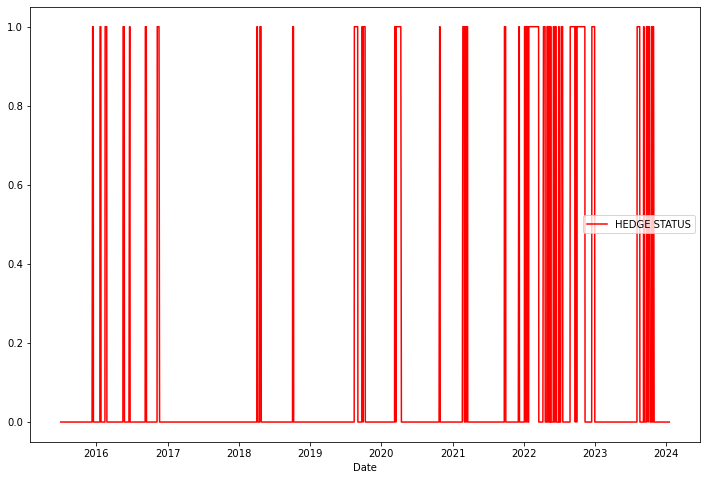

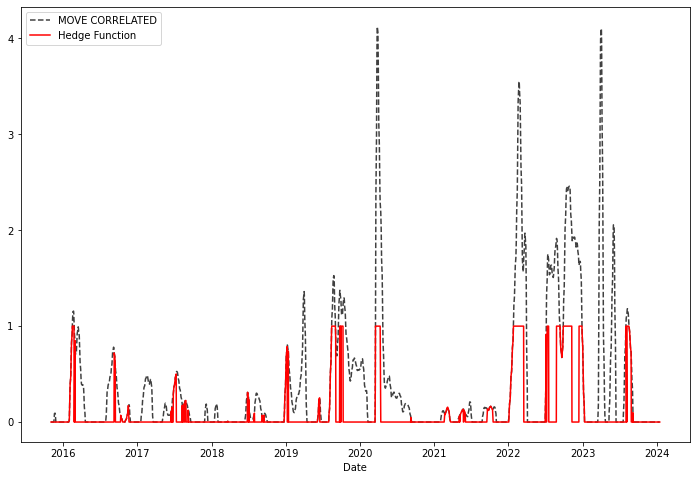

In [18]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\set_hedges.py

#Hedge Relation

def round_up(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.ceil(n * multiplier) / multiplier)


#thresh1 = 7
#thresh2 = 0
#window = 5
#margin = 0.005
to_roundup = lambda x: round_up(x)
to_int = lambda x: int(x)
thresh1 = 7
thresh2 = 0
window = 5
margin = 0.5 / 100
move_thresh = 1

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_val2 = "SELECT * FROM valuations_oi_relation"
Val2_df = pd.read_sql_query(query_val2, engine_metrics)
Val2_df = Set_DF(Val2_df)
Val2_df = DD_Index(Val2_df)

Prices_df['MAV VIX'] = Prices_df['VIX'].rolling(21).mean()
Prices_df['MAV QQQ'] = Prices_df['QQQ US'].rolling(42).mean()
Prices_df = Prices_df.loc[Prices_df.index > Val2_df.index[0]]
Ret_df = ((Prices_df / Prices_df.shift(1)) - 1).dropna(how = 'all', axis = 0) * 100
Prices_df['MOVE'] = (100 * (Prices_df['USGG2YR'].rolling(21).std() * np.sqrt(1 / 21))).rolling(8).mean()

Prices_df['MAV VIX'] = (Prices_df['VIX'] - Prices_df['MAV VIX']).clip(0, 1).map(to_roundup)
Prices_df['MAV QQQ'] = (Prices_df['QQQ US'] - (1 + margin) * Prices_df['MAV QQQ']).clip(0, 1).map(to_roundup)
Prices_df['MAV QQQ'] = Prices_df['MAV QQQ'] * (-1) + 1
Prices_df['MOVE'] = (100 * (Prices_df['USGG2YR'].rolling(21).std() * np.sqrt(1 / 21))).rolling(8).mean()
Prices_df['MOVE CORR'] = abs(Prices_df['MOVE'].rolling(42).corr(Prices_df['SPX']).rolling(21).mean().clip(-1, 0)) * Prices_df['MOVE']

ry_series = (Prices_df[Prices_df.index >= Val2_df.index[0]]['USGG10YR'] - Prices_df[Prices_df.index >= Val2_df.index[0]]['T5YIFR'])
ry_series.name = 'Real Yields Inv'

rr_series = (ry_series - ry_series.rolling(window, min_periods = 1).mean()) * 100
old_series = rr_series.copy()
old_series.name = 'Real Yields Index'
#rr_series.iloc[0] = 0
rr_series[rr_series < thresh2] = 0
rr_series[rr_series > thresh1] = 1
count = 0
for element in rr_series.index:
    if (rr_series.loc[element] != 0) & (rr_series.loc[element] != 1):
        rr_series.iloc[count] = rr_series.iloc[count - 1]
    count = count + 1
rr_df = pd.DataFrame(rr_series).join(Ret_df['SPX']).dropna(axis = 0)
rr_df = rr_df.join(Ret_df['QQQ US'])
rr_df = rr_df.join(Ret_df['ARKK US'])
rr_df = rr_df.join(Prices_df['MAV VIX'])
rr_df = rr_df.join(Prices_df['MAV QQQ'])
rr_df = rr_df.join(Prices_df['MOVE CORR'])
rr_df['MOVE CORR'] = (rr_df['MOVE CORR'].dropna() - move_thresh).apply(round_up, 0).clip(0, 1)
rr_df['RATES INDEX'] = (rr_df['Real Yields Inv'] + rr_df['MOVE CORR']).replace({np.nan: 0}).map(to_int).clip(0, 1)
rr_df = rr_df.join(old_series)

#rr_df['MAV QQQ'] = rr_df['MAV QQQ'].shift(1)
#rr_df['MAV VIX'] = rr_df['MAV VIX'].shift(1)
#rr_df['Real Yields Inv'] = rr_df['Real Yields Inv'].shift(1)
#rr_df.iloc[0] = 0

#hedge_actions = (rr_df[rr_df.columns[0]] != rr_df[rr_df.columns[0]].shift(1)).value_counts().loc[True]

rr_df['Hedge Status'] = (rr_df['MAV QQQ'] * rr_df['RATES INDEX']).replace({np.nan: 0}).map(to_int)
#rr_df['Hedge Signal'] = rr_series

c = 1
for element in rr_df.index[2:]:
    if (rr_df.iloc[c]['Hedge Status'] == 1) & (rr_df.iloc[c - 1]['Hedge Status'] == 0):
        rr_df.loc[element, 'Hedge Status'] = 1
    if (c > 1):
        if (rr_df.iloc[c]['Hedge Status'] == 1) & (rr_df.iloc[c - 1]['Hedge Status'] == 1) & (rr_df.iloc[c - 2]['Hedge Status'] == 0):
            rr_df.loc[element, 'Hedge Status'] = 1
#   if (c > 2):
#       if (rr_df.iloc[c]['Hedge Status'] == 1) & (rr_df.iloc[c - 1]['Hedge Status'] == 1) & (rr_df.iloc[c - 2]['Hedge Status'] == 1) & (rr_df.iloc[c - 3]['Hedge Status'] == 0):
#           rr_df.loc[element, 'Hedge Status'] = 1
#   if (c > 3):
#       if (rr_df.iloc[c]['Hedge Status'] == 1) & (rr_df.iloc[c - 1]['Hedge Status'] == 1) & (rr_df.iloc[c - 2]['Hedge Status'] == 1) & (rr_df.iloc[c - 3]['Hedge Status'] == 1) & (rr_df.iloc[c - 4]['Hedge Status'] == 0):
#           rr_df.loc[element, 'Hedge Status'] = 1
    c = c + 1

hedge_cumu = (rr_df['Hedge Status'] * rr_df['ARKK US']).sum()
original_hedge_df = pd.DataFrame(rr_df['Hedge Status'].values, index = rr_df.index, columns = ['Hedge Status'])

#print('Hedge Actions: ' + str(hedge_actions))
print('')
print('Tot SPX: ' + str(round(rr_df['SPX'].sum(), 2)))
print('Tot QQQ: ' + str(round(rr_df['QQQ US'].sum(), 2)))
print('Tot ARKK: ' + str(round(rr_df['ARKK US'].sum(), 2)))
print('')
print('Tot Hedge SPX: ' + str(round((rr_df['SPX'] * rr_df[rr_df.columns[0]]).sum(), 2)))
print('Tot Hedge QQQ: ' + str(round((rr_df['QQQ US'] * rr_df[rr_df.columns[0]]).sum(), 2)))
print('Tot Hedge ARKK: ' + str(round((rr_df['ARKK US'] * rr_df[rr_df.columns[0]]).sum(), 2)))

moves_pivot = pd.pivot_table(data = rr_df, index = ['RATES INDEX'], columns = ['MAV QQQ'], values = 'ARKK US', aggfunc = 'sum')
count_pivot = pd.pivot_table(data = rr_df, index = ['RATES INDEX'], columns = ['MAV QQQ'], values = 'ARKK US', aggfunc = 'count')

print('')
print(moves_pivot)
print('')
print(count_pivot)
print('')
print('Cumulative Hedge: ' + str(-round(hedge_cumu, 2)))
print('Hedge Incidence: ' + str(round(100 * original_hedge_df['Hedge Status'].sum() / len(original_hedge_df.index), 2)))
print('')

original_hedge_df.to_sql('hedge_relation', engine, index=True, if_exists='replace')
plt.figure(0, figsize = (12, 8))
rr_df['Hedge Status'].plot(c = 'r', label = 'HEDGE STATUS').legend(loc = 'best')
plt.figure(1, figsize = (12, 8))
Prices_df['MOVE CORR'].plot(c = 'k', label = 'MOVE CORRELATED', linestyle = 'dashed', alpha = 0.75).legend(loc = 'best')
(Prices_df['MOVE CORR'] * rr_df['MAV QQQ']).dropna().clip(0, 1).plot(c = 'r', label = 'Hedge Function').legend(loc = 'best')
print('')
if ('HEDGE IND' in rr_df.columns):
    rr_df.drop(['HEDGE IND'], axis = 1, inplace = True)
rr_df = rr_df.join(Leads_df['HEDGE IND'])
rr_df['Diff'] = rr_df['HEDGE IND'] - rr_df['Hedge Status']
print(rr_df['HEDGE IND'].sum())
print(rr_df['Hedge Status'].sum())
rr_df[-60:]

In [86]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\pca_sectors_algo.py

### NEW!!!!!!!!!!!!!!!!!!!!!!!!!!!

#PCA ANALYSIS ON SECTORS

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
import warnings
import joblib
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.svm import SVR


def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def on_selection(value):
    global choice_sector
    choice_sector = value  # store the user's choice
    root.destroy()  # close window
       
def PCA_DR(X):
    
    U, S, Vt = np.linalg.svd(X)
    pca = PCA(n_components = var_target)
    XD = pca.fit_transform(X)
    PCAL = len(XD[0, :])
    W = Vt.T[:, :PCAL]

    return W
    
def Transform_Final(Full_df, Tail_df):
            
    pca_key = PCA_DR(np.array(Full_df))  ##Slim_df
    Scaled_DR_df = pd.DataFrame(np.array(Full_df).dot(pca_key), index = Full_df.index)
    ScaledT_DR_df = pd.DataFrame(np.array(Tail_df).dot(pca_key), index = Tail_df.index)
            
    return Scaled_DR_df, ScaledT_DR_df

def Equiv(X):
    
    for sector in Equivalence_df.columns.values.tolist():
        print(sector)
        if (sector not in X.columns):
            X = ETF_Daily_Returns.join(Sector_Daily_Returns[sector])
        Equivalent_ETF = X.rolling(63, min_periods = 21).corr()[sector]
        Corr_df = Equivalent_ETF.unstack().dropna(how = 'all').drop(sector, axis = 1)
        corr_dates_list = Corr_df[Corr_df.index >= min(Equivalence_df.index)].index
        for current_date in corr_dates_list:
            Equivalence_df.loc[current_date, sector] = Corr_df.loc[current_date].sort_values().index[-1]
    Equivalence_df.dropna(how = 'all', inplace = True)
    Equivalence_df.to_sql('etf_equivalence_relation', engine, index = True, if_exists = 'replace')

ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
       'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']

scaling_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy = 'median')),
    ('std_scaler', StandardScaler())
])

to_round = lambda x: round(x, 2)
   
dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()
    
query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

today = Prices_df.index[-1]

if (today.weekday() == 5):
    today = today - timedelta(1)
elif (today.weekday() == 6):
    today = today - timedelta(2)

country_macro_df_name = 'us_macro'
query_macro = "SELECT * FROM " + country_macro_df_name
country_macro_df = pd.read_sql_query(query_macro, engine)
country_macro_df = Set_DF(country_macro_df)
country_macro_df = DD_Index(country_macro_df)
country_macro_df['ISM NEW ORDERS/INVENTORIES'] = country_macro_df['ISM MANUFACTURING NEW ORDERS'] / country_macro_df['ISM MANUFACTURING INVENTORIES']

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)
sectors_pxs_df = sectors_pxs_df.join(Prices_df['QQQ US'])
sectors_pxs_df = sectors_pxs_df.join(Prices_df['SPX'])
sectors_pxs_df.rename(columns = {'QQQ US': 'QQQ'}, inplace = True)

query_sector_adj = 'SELECT * FROM sector_indexes_corrections'    
sectors_correction_df = pd.read_sql_query(query_sector_adj, engine)
sectors_correction_df = Set_DF(sectors_correction_df)
sectors_correction_df = DD_Index(sectors_correction_df)
sectors_correction_df['SPX'] = 0
sectors_correction_df['QQQ'] = 0

query_sector_ps = 'SELECT * FROM sectors_ps_relation'    
sectors_ps_df = pd.read_sql_query(query_sector_ps, engine_metrics)
sectors_ps_df = Set_DF(sectors_ps_df)
sectors_ps_df = DD_Index(sectors_ps_df)

query_sector_pe = 'SELECT * FROM sectors_pe_relation'    
sectors_pe_df = pd.read_sql_query(query_sector_pe, engine_metrics)
sectors_pe_df = Set_DF(sectors_pe_df)
sectors_pe_df = DD_Index(sectors_pe_df)

query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

Sector_Daily_Returns = (sectors_pxs_df / (sectors_pxs_df.shift(1) + sectors_correction_df.shift(1)) - 1).dropna(how = 'all')
ETF_Daily_Returns = ((Prices_df[ETF_List] / Prices_df[ETF_List].shift(1)) - 1).loc[Sector_Daily_Returns.index]
Expanded_ETF_Daily_Returns = ETF_Daily_Returns.copy()

last_bus_day = date.today()
if (last_bus_day.weekday() == 5):
    last_bus_day = last_bus_day - timedelta(1)
if (last_bus_day.weekday() == 6):
    last_bus_day = last_bus_day - timedelta(2)

if (last_bus_day not in Equivalence_df.index) & (last_bus_day in Prices_df.index):
    Equiv(Expanded_ETF_Daily_Returns)
else:
    equivalence = input('Update Correlations (Y/N)? ').upper()
    if (equivalence == 'Y'):
        Equiv(Expanded_ETF_Daily_Returns) 
        
corr_list = []
corr_threshold = 0.20
corr_percentile = 0.85
pca_threshold = 15
window = 21
lag_returns = 10
correlation_window_ST = 350 #250
correlation_window_MT = 600 #500
var_target = 0.85
Fade_Parameter = 0.95
upper_bound = +20.00
lower_bound = -20.00
att_threshold = 7.00 #8.00
att_window_factor = 1.00 #2.00

ext = ''
opt = input('(O)ld or (N)ew? ').upper()
if (opt == 'N'):
    ext = '_new'
    correlation_window_ST = 350 #350
    correlation_window_MT = 700 #700
    corr_threshold = 0.25
    att_window_factor = 1
    att_threshold = 4

corr_choice = input('Correlations (S)hort Term, (M)edium Term or Both (empty): ').upper()
if (corr_choice == 'S'):
    corr_list.append(correlation_window_ST)
elif (corr_choice == 'M'):
    corr_list.append(correlation_window_MT)
else:
    corr_list = [correlation_window_ST, correlation_window_MT]

to_group = lambda x: x.split('MVR')[0][:-1]
to_find_up = lambda x: x.find(corr_up_str)
to_find_down = lambda x: x.find(corr_down_str)
to_find = lambda x: x.find(sector_up_forecast)
to_select_sector = lambda x: x in longs_list

full_sectors_list = sectors_pxs_df.columns.values.tolist()
    
choice_list = full_sectors_list.copy()
choice_list.append('ALL')
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a sector").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()

sector_list = []
if (choice_sector == 'ALL'):
    sector_list = full_sectors_list
else:
    sector_list.append(choice_sector)

try:    
    query_forecasts = 'SELECT * FROM lr_forecasts_relation' + ext   
    LR_Forecast_df = pd.read_sql_query(query_forecasts, engine)
    LR_Forecast_df = Set_DF(LR_Forecast_df)
    LR_Forecast_df = DD_Index(LR_Forecast_df)
except:
    LR_Forecast_df = pd.DataFrame(np.nan, index = pd.Index(date_range, name = 'Dates'), columns = ['Dummy'])

try:
    query_forecasts = 'SELECT * FROM rf_forecasts_relation' + ext 
    RF_Forecast_df = pd.read_sql_query(query_forecasts, engine)
    RF_Forecast_df = Set_DF(RF_Forecast_df)
    RF_Forecast_df = DD_Index(RF_Forecast_df)
except:
    RF_Forecast_df = pd.DataFrame(np.nan, index = pd.Index(date_range, name = 'Dates'), columns = ['Dummy'])
    
try:
    query_forecast = 'SELECT * FROM en_forecasts_relation' + ext 
    EN_Forecast_df = pd.read_sql_query(query_forecast, engine)
    EN_Forecast_df = Set_DF(EN_Forecast_df)
    EN_Forecast_df = DD_Index(EN_Forecast_df)
except:
    EN_Forecast_df = pd.DataFrame(np.nan, index = pd.Index(date_range, name = 'Dates'), columns = ['Dummy'])
    
backup_LR_Forecast_df = LR_Forecast_df.copy()
backup_RF_Forecast_df = RF_Forecast_df.copy()
backup_EN_Forecast_df = EN_Forecast_df.copy()

owr = False
skip = False
opt = input("(E)xpand/(N)ew/(O)verwrite/(U)pdate/(S)kip): ").upper()
if (opt == 'N') | (opt == 'O') | (opt == 'E'):
    Start_Date = input("Enter Start Date (empty for ALL): (YY/MM/DD)")
    if (Start_Date != ''):
        Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()
    else:
        Start_Date = mm_forecast_df.index[0]
    if (opt == 'N') | (opt == 'E'):
        owr = True
elif (opt == 'U'):
    Start_Date = Prices_df.index[-2] 
else:
    Start_Date = mm_forecast_df.index[0]
    skip = True

if (opt == 'N') | (opt == 'O') | (opt == 'E'):
    End_Date = input("Enter End Date (empty for ALL): (YY/MM/DD)")
    if (End_Date != ''):
        End_Date = datetime.strptime(End_Date, "%y/%m/%d").date()
    else:
        End_Date = Prices_df.index[-1]
else:
    End_Date = Prices_df.index[-1]
    
if (opt == 'E'):
    End_Date = Prices_df.index[Prices_df.index.values.tolist().index(End_Date) + lag_returns + 1]
    
date_array = Prices_df[Prices_df.index >= Start_Date].index.values
date_range = date_array[date_array <= End_Date].tolist()

if (owr):
    LR_Forecast_df = pd.DataFrame(np.nan, index = pd.Index(date_range, name = 'Dates'), columns = ['Dummy'])
    RF_Forecast_df = pd.DataFrame(np.nan, index = pd.Index(date_range, name = 'Dates'), columns = ['Dummy'])
    EN_Forecast_df = pd.DataFrame(np.nan, index = pd.Index(date_range, name = 'Dates'), columns = ['Dummy'])
    
poly_features = PolynomialFeatures(degree = 3, include_bias = False)
forest_reg = RandomForestRegressor()
lin_reg = LinearRegression()
lin_reg_en = ElasticNet(alpha = 10, l1_ratio = 0.5)

last_lr_forecast = 0
last_en_forecast = 0
count_sector = 0
if (not skip):
    for choice in sector_list:
        
        choice_L = re.sub(r'[^a-z^0-9]', '', choice.lower())
        AllFactors_df = pd.DataFrame(np.nan, index = Prices_df.index, columns = ['VIX', 'VIX MAV', 'MOVE 02', 'MOVE 02 MAV', 'MOVE 10', 'MOVE 10 MAV', 'Oil', 'Oil MAV', 'Real Yields', 'Real Yields MAV', '2Yr Nom', '2Yr Nom MAV', '10Yr Nom', '10Yr Nom MAV', 'YC', 'YC MAV', '5y5y IE', '5y5y IE MAV', 'EUR', 'EUR MAV'])

        vix_series = Prices_df['VIX']
        vix_series_mav = (vix_series - vix_series.rolling(window).mean())

        move2_series = (Prices_df['USGG2YR'].rolling(window).std() * np.sqrt(1 / window) * 100).rolling(window).mean()
        move2_series_mav = (move2_series - move2_series.rolling(window).mean())

        move10_series = (Prices_df['USGG10YR'].rolling(window).std() * np.sqrt(1 / window) * 100).rolling(window).mean()
        move10_series_mav = (move10_series - move10_series.rolling(window).mean())

        crude_series = Prices_df['Crude Oil USD/Bbl']
        crude_series_mav = (crude_series - crude_series.rolling(window).mean())

        ry_series = (Prices_df['USGG10YR'] - Prices_df['T10YIE'])
        ry_series_mav = (ry_series - ry_series.rolling(window).mean())

        twoyn_series = Prices_df['USGG2YR']
        twoyn_series_mav = (twoyn_series - twoyn_series.rolling(window).mean())

        tenyn_series = Prices_df['USGG10YR']
        tenyn_series_mav = (tenyn_series - tenyn_series.rolling(window).mean())

        yc_series = Prices_df['USGG10YR'] - Prices_df['USGG2YR']
        yc_series_mav = (yc_series - yc_series.rolling(window).mean())

        inf5y5y_series = Prices_df['T5YIFR']
        inf5y5y_series_mav = (inf5y5y_series - inf5y5y_series.rolling(window).mean())

        totbkcr_series = Prices_df['TOTBKCR Velocity']
        totbkcr_series_mav = (totbkcr_series - totbkcr_series.rolling(window).mean())

        totalslar_series = Prices_df['TOTALSLAR']
        totalslar_series_mav = (totalslar_series - totalslar_series.rolling(window).mean())

        drcclacbs_series = Prices_df['DRCCLACBS']
        drcclacbs_series_mav = (drcclacbs_series - drcclacbs_series.rolling(window).mean())

        m2cp_series = Prices_df['M2CP Velocity']
        m2mp_series = Prices_df['M2MP Velocity']
        m2_momentum_series = m2cp_series - m2mp_series

        eur_series = Prices_df['USDEUR']
        eur_series_mav = (eur_series - eur_series.rolling(window).mean())

        AllFactors_df['VIX'] = vix_series
        AllFactors_df['VIX MAV'] = vix_series_mav
        AllFactors_df['MOVE 02'] = move2_series
        AllFactors_df['MOVE 02 MAV'] = move2_series_mav
        AllFactors_df['MOVE 10'] = move10_series
        AllFactors_df['MOVE 10 MAV'] = move10_series_mav
        AllFactors_df['Oil'] = crude_series
        AllFactors_df['Oil MAV'] = crude_series_mav
        AllFactors_df['Real Yields'] = ry_series
        AllFactors_df['Real Yields MAV'] = ry_series_mav
        AllFactors_df['2Yr Nom'] = twoyn_series
        AllFactors_df['2Yr Nom MAV'] = twoyn_series_mav
        AllFactors_df['10Yr Nom'] = tenyn_series
        AllFactors_df['10Yr Nom MAV'] = tenyn_series_mav
        AllFactors_df['YC'] = yc_series
        AllFactors_df['YC MAV'] = yc_series_mav
        AllFactors_df['5y5y IE'] = inf5y5y_series
        AllFactors_df['5y5y IE MAV'] = inf5y5y_series_mav
        AllFactors_df['TOTBKCR Velocity'] = totbkcr_series
        AllFactors_df['TOTBKCR Velocity MAV'] = totbkcr_series_mav
        AllFactors_df['TOTALSLAR'] = totalslar_series
        AllFactors_df['TOTALSLAR MAV'] = totalslar_series_mav
        AllFactors_df['DRCCLACBS'] = drcclacbs_series
        AllFactors_df['DRCCLACBS MAV'] = drcclacbs_series_mav
        AllFactors_df['EUR'] = eur_series
        AllFactors_df['EUR MAV'] = eur_series_mav
        AllFactors_df['M2CP Velocity'] = m2cp_series
        AllFactors_df['M2MP Velocity'] = m2mp_series
        AllFactors_df['M2 Momentum'] = m2_momentum_series
        AllFactors_df.drop(['VIX', 'VIX MAV'], axis = 1, inplace = True)

        sector_return_string = choice + ' ' + str(lag_returns) + ' FWD Returns'

        crev_relation = re.sub(r'[^a-z_^0-9]', '', choice.lower()) + '_rev'
        query_crev = "SELECT * FROM " + crev_relation
        crev_df = pd.read_sql_query(query_crev, engine)
        crev_df = Set_DF(crev_df)
        crev_df = DD_Index(crev_df)
        rev_next_series = crev_df['Next'] / crev_df['Current'] - 1
        rev_current_series = crev_df['Current'] / crev_df['Previous'] - 1
        rev_next_series.name = choice + ' Next Rev'
        rev_current_series.name = choice + ' Current Rev'

        crev_relation = re.sub(r'[^a-z_^0-9]', '', choice.lower()) + '_oi'
        query_crev = "SELECT * FROM " + crev_relation
        crev_df = pd.read_sql_query(query_crev, engine)
        crev_df = Set_DF(crev_df)
        crev_df = DD_Index(crev_df)
        oi_next_series = crev_df['Next'] / crev_df['Current'] - 1
        oi_current_series = crev_df['Current'] / crev_df['Previous'] - 1
        oi_next_series.name = choice + ' Next OI'
        oi_current_series.name = choice + ' Current OI'

        sectors_daily_rets_df = sectors_pxs_df.pct_change()
        sectors_cumreturns = (sectors_daily_rets_df + 1).rolling(lag_returns).apply(np.prod, raw = True).dropna(how = 'all') - 1
        sectors_stds = sectors_daily_rets_df.ewm(halflife = 100).std() * np.sqrt(lag_returns)
        sectors_momentum = sectors_cumreturns / sectors_stds.loc[sectors_cumreturns.index]
        sectors_momentum_series = sectors_momentum[choice]
        momentum_name = choice + ' Momentum'
        sectors_momentum_series.name = momentum_name
        AllFactors_df = AllFactors_df.join(rev_current_series)
        AllFactors_df = AllFactors_df.join(rev_next_series)
        AllFactors_df = AllFactors_df.join(oi_current_series)
        AllFactors_df = AllFactors_df.join(oi_next_series)
        AllFactors_df.fillna(method = 'ffill', inplace = True)
        AllFactors_df.dropna(thresh = 20, inplace = True)
        selected_fields = pd.read_csv(r'C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/selected_fields_usmacro.csv')
        country_macro_narrow = country_macro_df[selected_fields['FIELDS']]
        AllFactors_df = AllFactors_df.join(sectors_momentum_series)
        AllFactors_df = AllFactors_df.join(country_macro_narrow)
        AllFactors_df = AllFactors_df.join(country_macro_df['ISM NEW ORDERS/INVENTORIES'])

        for corr in corr_list:
            avg_corr = 0
            Count_RF = 0
            Count_LR = 0
            Count_EN = 0
            RF_RMSE_ttl = 0
            LR_RMSE_ttl = 0
            EN_RMSE_ttl = 0
            current_column = choice + ' CORR' + str(corr)
            if (current_column not in LR_Forecast_df.columns):
                LR_Forecast_df[current_column] = np.nan
            if (current_column not in RF_Forecast_df.columns):
                RF_Forecast_df[current_column] = np.nan
            if (current_column not in EN_Forecast_df.columns):
                EN_Forecast_df[current_column] = np.nan

            original_components = 0
            prev_model = False
            for current_date in date_range:
                if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                    if (current_date in LR_Forecast_df.index):
                        LR_Forecast_df.drop(current_date, inplace = True)
                    if (current_date in RF_Forecast_df.index):
                        RF_Forecast_df.drop(current_date, inplace = True)
                    if (current_date in EN_Forecast_df.index):
                        EN_Forecast_df.drop(current_date, inplace = True)
                    date_range.remove(current_date)
                else:
                    Prev_date = date_range[date_range.index(current_date) - 1]
                    if (current_date not in LR_Forecast_df.index):
                        LR_Forecast_df.loc[current_date] = np.nan
                    if (current_date not in RF_Forecast_df.index):
                        RF_Forecast_df.loc[current_date] = np.nan
                    if (current_date not in EN_Forecast_df.index):
                        EN_Forecast_df.loc[current_date] = np.nan
                    sectors_pxs_df_slice = sectors_pxs_df[sectors_pxs_df.index <= current_date]
                    sectors_correction_df_slice = sectors_correction_df[sectors_correction_df.index <= current_date]
                    sectors_rets_df = 100 * (sectors_pxs_df_slice.shift(-lag_returns) / (sectors_pxs_df_slice + sectors_correction_df_slice) - 1)
                    sectors_rets_df.dropna(inplace = True)
                    sectors_rets_series = sectors_rets_df[choice]
                    sectors_rets_series.name = sector_return_string
                    try:
                        AllFactors_df.index = AllFactors_df.T.columns.map(lambda x: x.date())
                    except:
                        pass
                    AllFactors_df_slice =  AllFactors_df[AllFactors_df.index <= current_date].fillna(method = 'ffill') 
                    AllFactors_df_slice = AllFactors_df_slice[- int(round(att_window_factor * corr, 0)):]
                    
                    AllFactors_df_slice = AllFactors_df_slice.join(sectors_rets_series)
                    Slice_df = AllFactors_df_slice.copy()
                    Slice_df.sort_index(inplace = True)
                    corr_init = min(corr, len(Slice_df.index))

                    up_corr_df = pd.DataFrame(Slice_df.corr()[sector_return_string].sort_values())
                    
                    if (up_corr_df.loc[rev_next_series.name, sector_return_string] < 0):
                        up_corr_df.drop(rev_next_series.name, inplace = True)
                    if (up_corr_df.loc[rev_current_series.name, sector_return_string] < 0):
                        up_corr_df.drop(rev_current_series.name, inplace = True)
                    if (up_corr_df.loc[oi_next_series.name, sector_return_string] < 0):
                        up_corr_df.drop(oi_next_series.name, inplace = True)
                    if (up_corr_df.loc[oi_current_series.name, sector_return_string] < 0):
                        up_corr_df.drop(oi_current_series.name, inplace = True)
                    
                    up_corr_df = up_corr_df.drop(sector_return_string)
                    up_corr_df['ABS Corr'] = abs(up_corr_df[sector_return_string])
                    if (len(up_corr_df['ABS Corr'].dropna()) > 0):
                        corr_threshold2 = max(corr_threshold, np.quantile(up_corr_df['ABS Corr'].dropna(), q = corr_percentile))
                        up_corr_relevance = up_corr_df[up_corr_df['ABS Corr'] > corr_threshold2]
                        avg_corr = round(up_corr_relevance['ABS Corr'].mean(), 2)
                        original_components = len(up_corr_relevance.index)
                        att_exp = min(5, round(avg_corr * 10, 0))
                        if (original_components > 0):
                            att_factor = max(att_threshold - original_components, 1) ** att_exp
                            print(current_column + ' ' + current_date.strftime("%y/%m/%d") + ', ' + str(original_components) + ' Features, ' +  str(avg_corr) + ' Avg Corr')
                            Slice_ = AllFactors_df_slice[up_corr_relevance.index]
                            Slice_Slim = Slice_.join(AllFactors_df_slice[sector_return_string])
                            Slice_Slim = Slice_Slim.dropna()
                            Slice_Slim = Slice_Slim.drop([sector_return_string], axis = 1)
                            Slice_Slim_Scaled = pd.DataFrame(scaling_pipeline.fit_transform(Slice_Slim), index = Slice_Slim.index, columns = Slice_Slim.columns)
                            Slice_Scaled = pd.DataFrame(scaling_pipeline.fit_transform(Slice_), index = Slice_.index, columns = Slice_.columns)
                            Slice_Scaled_Labeled = Slice_Scaled.join(AllFactors_df_slice[sector_return_string])
                            Slice_Scaled_Labeled.dropna(inplace = True)
                            Tail_Scaled = Slice_Scaled[Slice_Scaled.index >= Slice_Slim.index[-1]].copy()

                            if (original_components >= pca_threshold):
                                DR_Scaled_Slim, DR_Scaled_Tail = Transform_Final(Slice_Scaled_Labeled.drop([sector_return_string], axis = 1), Tail_Scaled)
                            else:
                                DR_Scaled_Slim = Slice_Slim_Scaled
                                DR_Scaled_Tail = Tail_Scaled
                                
                            DR_Scaled_Labeled = DR_Scaled_Slim.join(AllFactors_df_slice[sector_return_string])
                            _Train = DR_Scaled_Labeled
                            _Train_Labels = _Train[sector_return_string]
                            _Train_Features = _Train.drop([sector_return_string], axis = 1)
                            poly_Train = poly_features.fit_transform(_Train_Features)
                            poly_Tail = poly_features.fit_transform(DR_Scaled_Tail)

                            curr_rf_model = forest_reg.fit(_Train_Features, _Train_Labels)
                            forest_reg_train_predictions = curr_rf_model.predict(_Train_Features)
                            forest_rmse = np.sqrt(mean_squared_error(forest_reg_train_predictions, _Train_Labels.values))

                            try:
                                RF_model = forest_reg.fit(_Train_Features, _Train_Labels)
                                RF_predictions_Train = RF_model.predict(_Train_Features)
                                RF_rmse = np.sqrt(mean_squared_error(RF_predictions_Train, _Train_Labels))
                                RF_RMSE_ttl = RF_RMSE_ttl + RF_rmse
                                RF_Live_Forecast = round(RF_model.predict(DR_Scaled_Tail)[-1], 2)
                                RF_Forecast_df.loc[current_date, current_column] = min(upper_bound, max(lower_bound, RF_Live_Forecast / att_factor))
                                Count_RF = Count_RF + 1
                            except:
                                print('RF Failed')
                                RF_Forecast_df.loc[current_date, current_column] = RF_Forecast_df.loc[Prev_date, current_column] * Fade_Parameter

                            try:
                                LR_model = lin_reg.fit(_Train_Features, _Train_Labels)
                                LR_predictions_Train = LR_model.predict(_Train_Features)
                                LR_rmse = np.sqrt(mean_squared_error(LR_predictions_Train, _Train_Labels))
                                LR_RMSE_ttl = LR_RMSE_ttl + LR_rmse
                                LR_Live_Forecast = round(LR_model.predict(DR_Scaled_Tail)[-1], 2)
                                LR_Forecast_df.loc[current_date, current_column] = min(upper_bound, max(lower_bound, LR_Live_Forecast / att_factor))
                                Count_LR = Count_LR + 1
                            except:
                                print('LR Failed')
                                LR_Forecast_df.loc[current_date, current_column] = LR_Forecast_df.loc[Prev_date, current_column] * Fade_Parameter

                            try:
                                EN_model = lin_reg_en.fit(poly_Train, _Train_Labels)
                                EN_predictions_Train = EN_model.predict(poly_Train)
                                EN_rmse = np.sqrt(mean_squared_error(EN_predictions_Train, _Train_Labels))
                                EN_RMSE_ttl = EN_RMSE_ttl + EN_rmse
                                EN_Live_Forecast = round(EN_model.predict(poly_Tail)[-1], 2)
                                EN_Forecast_df.loc[current_date, current_column] = min(upper_bound, max(lower_bound, EN_Live_Forecast / att_factor))
                                Count_EN = Count_EN + 1
                            except:
                                print('EN Failed')
                                EN_Forecast_df.loc[current_date, current_column] = EN_Forecast_df.loc[Prev_date, current_column] * Fade_Parameter

                        else:
                            print('NO RELEVANT CORRELATIONS!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')
                            LR_Forecast_df.loc[current_date, current_column] = LR_Forecast_df.loc[Prev_date, current_column] * Fade_Parameter
                            RF_Forecast_df.loc[current_date, current_column] = RF_Forecast_df.loc[Prev_date, current_column] * Fade_Parameter
                            EN_Forecast_df.loc[current_date, current_column] = EN_Forecast_df.loc[Prev_date, current_column] * Fade_Parameter
        
            print('')
            if (Count_LR > 0):
                print('Cumulative RMSE Train LR: ' + str(round(LR_RMSE_ttl / Count_LR, 2)))
            else:
                print('LR Forecasts N/A')
            if (Count_RF > 0):
                print('Cumulative RMSE Train RF: ' + str(round(RF_RMSE_ttl / Count_RF, 2)))
            else:
                print('RF Forecasts N/A')
            if (Count_EN > 0):
                print('Cumulative RMSE Train EN: ' + str(round(EN_RMSE_ttl / Count_EN, 2)))
            else:
                print('EN Forecasts N/A')
            print('')
    
        if (sector_return_string in LR_Forecast_df.columns):
            LR_Forecast_df.drop(sector_return_string, axis = 1, inplace = True)
        LR_Forecast_df = LR_Forecast_df.join(sectors_rets_series)
        if (sector_return_string in RF_Forecast_df.columns):
            RF_Forecast_df.drop(sector_return_string, axis = 1, inplace = True)
        RF_Forecast_df = RF_Forecast_df.join(sectors_rets_series)
        if (sector_return_string in EN_Forecast_df.columns):
            EN_Forecast_df.drop(sector_return_string, axis = 1, inplace = True)
        EN_Forecast_df = EN_Forecast_df.join(sectors_rets_series)
if ('Dummy' in LR_Forecast_df.columns):
    LR_Forecast_df.drop(['Dummy'], axis = 1, inplace = True)
if ('Dummy' in RF_Forecast_df.columns):
    RF_Forecast_df.drop(['Dummy'], axis = 1, inplace = True)
if ('Dummy' in EN_Forecast_df.columns):
    EN_Forecast_df.drop(['Dummy'], axis = 1, inplace = True)    

if  (opt == 'E'):
    LR_Forecast_df = pd.concat([LR_Forecast_df.loc[LR_Forecast_df.index < backup_LR_Forecast_df.index[0]].dropna(thresh = 25), backup_LR_Forecast_df])
    RF_Forecast_df = pd.concat([RF_Forecast_df.loc[RF_Forecast_df.index < backup_RF_Forecast_df.index[0]].dropna(thresh = 25), backup_RF_Forecast_df])
    EN_Forecast_df = pd.concat([EN_Forecast_df.loc[EN_Forecast_df.index < backup_EN_Forecast_df.index[0]].dropna(thresh = 25), backup_EN_Forecast_df])
        
LR_Forecast_df.sort_index(inplace = True)
RF_Forecast_df.sort_index(inplace = True)
EN_Forecast_df.sort_index(inplace = True)

if (opt != 'S'):
    proceed_save = input('Save (Y/N)? ').upper()
    if (proceed_save == 'Y'):
        LR_Forecast_df.clip(lower_bound, upper_bound).to_sql('lr_forecasts_relation' + ext, engine, index = True, if_exists = 'replace')
        RF_Forecast_df.clip(lower_bound, upper_bound).to_sql('rf_forecasts_relation' + ext, engine, index = True, if_exists = 'replace')
        EN_Forecast_df.clip(lower_bound, upper_bound).to_sql('en_forecasts_relation' + ext, engine, index = True, if_exists = 'replace')

Update Correlations (Y/N)? N
(O)ld or (N)ew? N
Correlations (S)hort Term, (M)edium Term or Both (empty): 
(E)xpand/(N)ew/(O)verwrite/(U)pdate/(S)kip): U

LR Forecasts N/A
RF Forecasts N/A
EN Forecasts N/A

NO RELEVANT CORRELATIONS!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

LR Forecasts N/A
RF Forecasts N/A
EN Forecasts N/A

Consumer Services CORR350 23/12/26, 13 Features, 0.29 Avg Corr

Cumulative RMSE Train LR: 2.74
Cumulative RMSE Train RF: 1.22
Cumulative RMSE Train EN: 3.53

Consumer Services CORR700 23/12/26, 7 Features, 0.27 Avg Corr

Cumulative RMSE Train LR: 3.74
Cumulative RMSE Train RF: 1.13
Cumulative RMSE Train EN: 4.01

Energy CORR350 23/12/26, 6 Features, 0.31 Avg Corr

Cumulative RMSE Train LR: 3.69
Cumulative RMSE Train RF: 2.2
Cumulative RMSE Train EN: 4.28

Energy CORR700 23/12/26, 2 Features, 0.31 Avg Corr

Cumulative RMSE Train LR: 4.78
Cumulative RMSE Train RF: 4.01
Cumulative RMSE Train EN: 5.15

Financials CORR350 23/12/26, 8 Features, 0.33 Avg Corr

Cumulative RMSE Train

In [87]:
#MODEL STATS REVAMPED

from scipy.stats import norm

ewm_factor = 3
LAG_returns = 10

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)
SECTOR_LIST = sectors_pxs_df.columns.values.tolist()

query_forecast = 'SELECT * FROM en_forecasts_relation'
en_forecast_df = pd.read_sql_query(query_forecast, engine)
en_forecast_df = Set_DF(en_forecast_df)
en_forecast_df = DD_Index(en_forecast_df)

query_forecast_N = 'SELECT * FROM en_forecasts_relation_new'
en_forecast_N_df = pd.read_sql_query(query_forecast_N, engine)
en_forecast_N_df = Set_DF(en_forecast_N_df)
en_forecast_N_df = DD_Index(en_forecast_N_df)

query_forecast = 'SELECT * FROM lr_forecasts_relation'
lr_forecast_df = pd.read_sql_query(query_forecast, engine)
lr_forecast_df = Set_DF(lr_forecast_df)
lr_forecast_df = DD_Index(lr_forecast_df)

query_forecast_N = 'SELECT * FROM lr_forecasts_relation_new'
lr_forecast_N_df = pd.read_sql_query(query_forecast_N, engine)
lr_forecast_N_df = Set_DF(lr_forecast_N_df)
lr_forecast_N_df = DD_Index(lr_forecast_N_df)

query_forecast = 'SELECT * FROM rf_forecasts_relation'
rf_forecast_df = pd.read_sql_query(query_forecast, engine)
rf_forecast_df = Set_DF(rf_forecast_df)
rf_forecast_df = DD_Index(rf_forecast_df)

query_forecast_N = 'SELECT * FROM rf_forecasts_relation_new'
rf_forecast_N_df = pd.read_sql_query(query_forecast_N, engine)
rf_forecast_N_df = Set_DF(rf_forecast_N_df)
rf_forecast_N_df = DD_Index(rf_forecast_N_df)

cp_o = int(rf_forecast_df.columns[0][-3:])
mp_o = int(rf_forecast_df.columns[1][-3:])
cp_n = int(rf_forecast_N_df.columns[0][-3:])
mp_n = int(rf_forecast_N_df.columns[1][-3:])

query_rv = 'SELECT * FROM best_rv_parameters_instant'
RV_o_df = pd.read_sql_query(query_rv, engine)
RV_o_df = Set_DF(RV_o_df)
RV_o_df = DD_Index(RV_o_df)

query_rv = 'SELECT * FROM best_rv_parameters_instant_new'
RV_n_df = pd.read_sql_query(query_rv, engine)
RV_n_df = Set_DF(RV_n_df)
RV_n_df = DD_Index(RV_n_df)

OPT = input('(S)tats or (B)acktest? ').upper()

if (OPT == 'B'):
    Start_Date = input("Enter Start Date: (YY/MM/DD)")
    Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()
    
    en_forecast_df = en_forecast_df[en_forecast_df.index >= Start_Date]
    en_forecast_N_df = en_forecast_N_df[en_forecast_N_df.index >= Start_Date]
    lr_forecast_df = lr_forecast_df[lr_forecast_df.index >= Start_Date]
    lr_forecast_N_df = lr_forecast_N_df[lr_forecast_N_df.index >= Start_Date]
    rf_forecast_df = rf_forecast_df[rf_forecast_df.index >= Start_Date]
    rf_forecast_N_df = rf_forecast_N_df[rf_forecast_N_df.index >= Start_Date]

if (OPT != 'B'):
    conf_interval_o = RV_o_df.loc['last', '0']
    std_mult_o = norm.ppf(conf_interval_o)
    UP_On_CP_o = RV_o_df.loc['last', '1']
    UP_Off_CP_o = RV_o_df.loc['last', '2']
    UP_On_MP_o = RV_o_df.loc['last', '3']
    UP_Off_MP_o = RV_o_df.loc['last', '4']
    
    conf_interval_n = RV_n_df.loc['last', '0']
    std_mult_n = norm.ppf(conf_interval_n)
    UP_On_CP_n = RV_n_df.loc['last', '1']
    UP_Off_CP_n = RV_n_df.loc['last', '2']
    UP_On_MP_n = RV_n_df.loc['last', '3']
    UP_Off_MP_n = RV_n_df.loc['last', '4']

    rs_b = False
    if (rs_b):
        lr_forecast_df = lr_forecast_df.ewm(halflife = ewm_factor).mean()
        en_forecast_df = en_forecast_df.ewm(halflife = ewm_factor).mean()

    lr_cp_mult_o = RV_o_df.loc['last', '5']
    rf_cp_mult_o = RV_o_df.loc['last', '6']
    en_cp_mult_o = RV_o_df.loc['last', '7']
    ttl_cp_mult_o = lr_cp_mult_o + en_cp_mult_o + rf_cp_mult_o

    lr_mp_mult_o = RV_o_df.loc['last', '8']
    rf_mp_mult_o = RV_o_df.loc['last', '9']
    en_mp_mult_o = RV_o_df.loc['last', '10']
    ttl_mp_mult_o = lr_mp_mult_o + en_mp_mult_o + rf_mp_mult_o
    
    lr_cp_mult_n = RV_n_df.loc['last', '5']
    rf_cp_mult_n = RV_n_df.loc['last', '6']
    en_cp_mult_n = RV_n_df.loc['last', '7']
    ttl_cp_mult_n = lr_cp_mult_n + en_cp_mult_n + rf_cp_mult_n

    lr_mp_mult_n = RV_n_df.loc['last', '8']
    rf_mp_mult_n = RV_n_df.loc['last', '9']
    en_mp_mult_n = RV_n_df.loc['last', '10']
    ttl_mp_mult_n = lr_mp_mult_n + en_mp_mult_n + rf_mp_mult_n

    mix_cp_forecast_df = (lr_cp_mult_o * lr_forecast_df + rf_cp_mult_o * rf_forecast_df + en_cp_mult_o * en_forecast_df) / ttl_cp_mult_o
    mix_cp_forecast_N_df = (lr_cp_mult_n * lr_forecast_N_df + rf_cp_mult_n * rf_forecast_N_df + en_cp_mult_n * en_forecast_N_df) / ttl_cp_mult_n
    mix_mp_forecast_df = (lr_mp_mult_o * lr_forecast_df + rf_mp_mult_o * rf_forecast_df + en_mp_mult_o * en_forecast_df) / ttl_mp_mult_o
    mix_mp_forecast_N_df = (lr_mp_mult_n * lr_forecast_N_df + rf_mp_mult_n * rf_forecast_N_df + en_mp_mult_n * en_forecast_N_df) / ttl_mp_mult_n

    mix_cp_forecast_Adj_df = mix_cp_forecast_df - mix_cp_forecast_df.clip(-20, 20).rolling(int(RV_o_df.loc['last', '16'])).std().rolling(int(RV_o_df.loc['last', '17'])).mean().replace({np.nan: 0}) * std_mult_o
    mix_mp_forecast_Adj_df = mix_mp_forecast_df - mix_mp_forecast_df.clip(-20, 20).rolling(int(RV_o_df.loc['last', '16'])).std().rolling(int(RV_o_df.loc['last', '17'])).mean().replace({np.nan: 0}) * std_mult_o
    mix_cp_forecast_N_Adj_df = mix_cp_forecast_N_df - mix_cp_forecast_N_df.clip(-20, 20).rolling(int(RV_n_df.loc['last', '16'])).std().rolling(int(RV_n_df.loc['last', '17'])).mean().replace({np.nan: 0}) * std_mult_n
    mix_mp_forecast_N_Adj_df = mix_mp_forecast_N_df - mix_mp_forecast_N_df.clip(-20, 20).rolling(int(RV_n_df.loc['last', '16'])).std().rolling(int(RV_n_df.loc['last', '17'])).mean().replace({np.nan: 0}) * std_mult_n

    RMSE_df = pd.DataFrame(np.nan, index = SECTOR_LIST, columns = ['LR CP Old', 'LR CP New', 'RF CP Old', 'RF CP New', 'EN CP Old', 'EN CP New', 'Mixed CP Old', 'Mixed CP New', 'LR MP Old', 'LR MP New', 'RF MP Old', 'RF MP New', 'EN MP Old', 'EN MP New', 'Mixed MP Old', 'Mixed MP New'])
    ClassAccuracy_df = pd.DataFrame(np.nan, index = SECTOR_LIST, columns = ['Mixed CP Old', 'Mixed CP New', 'Mixed MP Old', 'Mixed MP New'])
    
    for sector in SECTOR_LIST:
        CP_Return = 0
        MP_Return = 0
        sector_string_cp_o = sector + ' CORR' + str(cp_o)
        sector_string_cp_n = sector + ' CORR' + str(cp_n)
        sector_string_mp_o = sector + ' CORR' + str(mp_o)
        sector_string_mp_n = sector + ' CORR' + str(mp_n)
        ret_series = rf_forecast_df[sector + ' ' + str(LAG_returns) + ' FWD Returns']

        lr_cp_RMSE = np.sqrt(mean_squared_error(lr_forecast_df[sector_string_cp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        lr_cp_RMSE_N = np.sqrt(mean_squared_error(lr_forecast_N_df[sector_string_cp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        en_cp_RMSE = np.sqrt(mean_squared_error(en_forecast_df[sector_string_cp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        en_cp_RMSE_N = np.sqrt(mean_squared_error(en_forecast_N_df[sector_string_cp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        rf_cp_RMSE = np.sqrt(mean_squared_error(rf_forecast_df[sector_string_cp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        rf_cp_RMSE_N = np.sqrt(mean_squared_error(rf_forecast_N_df[sector_string_cp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        lr_mp_RMSE = np.sqrt(mean_squared_error(lr_forecast_df[sector_string_mp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        lr_mp_RMSE_N = np.sqrt(mean_squared_error(lr_forecast_N_df[sector_string_mp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        en_mp_RMSE = np.sqrt(mean_squared_error(en_forecast_df[sector_string_mp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        en_mp_RMSE_N = np.sqrt(mean_squared_error(en_forecast_N_df[sector_string_mp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        rf_mp_RMSE = np.sqrt(mean_squared_error(rf_forecast_df[sector_string_mp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        rf_mp_RMSE_N = np.sqrt(mean_squared_error(rf_forecast_N_df[sector_string_mp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        mixed_cp_RMSE = np.sqrt(mean_squared_error(mix_cp_forecast_df[sector_string_cp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        mixed_cp_RMSE_N = np.sqrt(mean_squared_error(mix_cp_forecast_N_df[sector_string_cp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        mixed_mp_RMSE = np.sqrt(mean_squared_error(mix_mp_forecast_df[sector_string_mp_o].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))
        mixed_mp_RMSE_N = np.sqrt(mean_squared_error(mix_mp_forecast_N_df[sector_string_mp_n].loc[ret_series.dropna().index].fillna(method = 'ffill').values, ret_series.dropna().values))

        RMSE_df.loc[sector, 'LR CP Old'] = round(lr_cp_RMSE, 2)
        RMSE_df.loc[sector, 'LR CP New'] = round(lr_cp_RMSE_N, 2)
        RMSE_df.loc[sector, 'RF CP Old'] = round(rf_cp_RMSE, 2)
        RMSE_df.loc[sector, 'RF CP New'] = round(rf_cp_RMSE_N, 2)
        RMSE_df.loc[sector, 'EN CP Old'] = round(en_cp_RMSE, 2)
        RMSE_df.loc[sector, 'EN CP New'] = round(en_cp_RMSE_N, 2)
        RMSE_df.loc[sector, 'Mixed CP Old'] = round(mixed_cp_RMSE, 2)
        RMSE_df.loc[sector, 'Mixed CP New'] = round(mixed_cp_RMSE_N, 2)
        RMSE_df.loc[sector, 'LR MP Old'] = round(lr_mp_RMSE, 2)
        RMSE_df.loc[sector, 'LR MP New'] = round(lr_mp_RMSE_N, 2)
        RMSE_df.loc[sector, 'RF MP Old'] = round(rf_mp_RMSE, 2)
        RMSE_df.loc[sector, 'RF MP New'] = round(rf_mp_RMSE_N, 2)
        RMSE_df.loc[sector, 'EN MP Old'] = round(en_mp_RMSE, 2)
        RMSE_df.loc[sector, 'EN MP New'] = round(en_mp_RMSE_N, 2)
        RMSE_df.loc[sector, 'Mixed MP Old'] = round(mixed_mp_RMSE, 2)
        RMSE_df.loc[sector, 'Mixed MP New'] = round(mixed_mp_RMSE_N, 2)

        UP_CP_SectorSeries = mix_cp_forecast_Adj_df[sector_string_cp_o][mix_cp_forecast_Adj_df[sector_string_cp_o] > UP_On_CP_o]
        DOWN_CP_SectorSeries = mix_cp_forecast_df[sector_string_cp_o][mix_cp_forecast_df[sector_string_cp_o] < UP_Off_CP_o]
        if (len(UP_CP_SectorSeries) > 0):
            Merged_CP_UP_Series = (pd.concat([UP_CP_SectorSeries, DOWN_CP_SectorSeries[DOWN_CP_SectorSeries.index > UP_CP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
            Full_Sector_CP_df = pd.DataFrame(ret_series).join(Merged_CP_UP_Series)[sector_string_cp_o].fillna(method = 'ffill').dropna()
            CP_Return = pd.DataFrame((1 + pd.DataFrame(Full_Sector_CP_df).join(sectors_pxs_df.pct_change()[sector].shift(-1)).prod(axis = 1)), columns = ['Factor']).expanding().apply(np.prod).iloc[-1][0]

        UP_MP_SectorSeries = mix_mp_forecast_Adj_df[sector_string_mp_o][mix_mp_forecast_Adj_df[sector_string_mp_o] > UP_On_MP_o]
        DOWN_MP_SectorSeries = mix_mp_forecast_df[sector_string_mp_o][mix_mp_forecast_df[sector_string_mp_o] < UP_Off_MP_o]
        if (len(UP_MP_SectorSeries) > 0):
            Merged_MP_UP_Series = (pd.concat([UP_MP_SectorSeries, DOWN_MP_SectorSeries[DOWN_MP_SectorSeries.index > UP_MP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
            Full_Sector_MP_df = pd.DataFrame(ret_series).join(Merged_MP_UP_Series)[sector_string_mp_o].fillna(method = 'ffill').dropna()
            MP_Return = pd.DataFrame((1 + pd.DataFrame(Full_Sector_MP_df).join(sectors_pxs_df.pct_change()[sector].shift(-1)).prod(axis = 1)), columns = ['Factor']).expanding().apply(np.prod).iloc[-1][0]

        ClassAccuracy_df.loc[sector, 'Mixed CP Old'] = round(CP_Return, 2)
        ClassAccuracy_df.loc[sector, 'Mixed MP Old'] = round(MP_Return, 2)

        UP_CP_SectorSeries = mix_cp_forecast_N_Adj_df[sector_string_cp_n][mix_cp_forecast_N_Adj_df[sector_string_cp_n] > UP_On_CP_n]
        DOWN_CP_SectorSeries = mix_cp_forecast_N_df[sector_string_cp_n][mix_cp_forecast_N_df[sector_string_cp_n] < UP_Off_CP_n]
        if (len(UP_CP_SectorSeries) > 0):
            Merged_CP_UP_Series = (pd.concat([UP_CP_SectorSeries, DOWN_CP_SectorSeries[DOWN_CP_SectorSeries.index > UP_CP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
            Full_Sector_CP_df = pd.DataFrame(ret_series).join(Merged_CP_UP_Series)[sector_string_cp_n].fillna(method = 'ffill').dropna()
            CP_Return = pd.DataFrame((1 + pd.DataFrame(Full_Sector_CP_df).join(sectors_pxs_df.pct_change()[sector].shift(-1)).prod(axis = 1)), columns = ['Factor']).expanding().apply(np.prod).iloc[-1][0]

        UP_MP_SectorSeries = mix_mp_forecast_N_Adj_df[sector_string_mp_n][mix_mp_forecast_N_Adj_df[sector_string_mp_n] > UP_On_MP_n]
        DOWN_MP_SectorSeries = mix_mp_forecast_N_df[sector_string_mp_n][mix_mp_forecast_N_df[sector_string_mp_n] < UP_Off_MP_o]
        if (len(UP_MP_SectorSeries) > 0):
            Merged_MP_UP_Series = (pd.concat([UP_MP_SectorSeries, DOWN_MP_SectorSeries[DOWN_MP_SectorSeries.index > UP_MP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
            Full_Sector_MP_df = pd.DataFrame(ret_series).join(Merged_MP_UP_Series)[sector_string_mp_n].fillna(method = 'ffill').dropna()
            MP_Return = pd.DataFrame((1 + pd.DataFrame(Full_Sector_MP_df).join(sectors_pxs_df.pct_change()[sector].shift(-1)).prod(axis = 1)), columns = ['Factor']).expanding().apply(np.prod).iloc[-1][0]

        ClassAccuracy_df.loc[sector, 'Mixed CP New'] = round(CP_Return, 2)
        ClassAccuracy_df.loc[sector, 'Mixed MP New'] = round(MP_Return, 2)


    print('NEW ST Forecasts:')
    print(round(mix_cp_forecast_N_df.T.loc[mix_cp_forecast_N_df.columns.map(lambda x: x.find('CORR' + str(cp_n))) != -1].T.iloc[-4:].T, 2))
    print('')
    print('NEW MT Forecasts:')
    print(round(mix_mp_forecast_N_df.T.loc[mix_mp_forecast_N_df.columns.map(lambda x: x.find('CORR' + str(mp_n))) != -1].T.iloc[-4:].T, 2))
    print('')
    print('')
    print('OLD ST Forecasts:')
    print(round(mix_cp_forecast_df.T.loc[mix_cp_forecast_df.columns.map(lambda x: x.find('CORR' + str(cp_o))) != -1].T.iloc[-4:].T, 2))
    print('')
    print('OLD MT Forecasts:')
    print(round(mix_mp_forecast_df.T.loc[mix_mp_forecast_df.columns.map(lambda x: x.find('CORR' + str(mp_o))) != -1].T.iloc[-4:].T, 2))
    print('')

    print('Classification Accuracy:')
    print('')
    print(ClassAccuracy_df)
    print('')
    print('Accuracy Summary:')
    print(ClassAccuracy_df.sum())

    RMSE_Summary_df = RMSE_df.groupby(RMSE_df.columns.map(lambda x: x.find('New')) != -1, axis = 1).mean()
    RMSE_Summary_df.rename(columns = {False: 'Old', True: 'New'}, inplace = True)

    print('')
    print('')
    print('RMSE Summary:')
    print(RMSE_Summary_df)
    print('')
    print('RMSE:')
    print('')
    print(RMSE_Summary_df.sum())
else:
    criteria_list = ['Perf OLD', 'Perf NEW']
    conf_interval_list = [0.80, 0.85, 0.90, 0.95]
    threshold_up_ST_ON_list = [5.50, 6.50, 7.50, 8.50]
    threshold_up_ST_OFF_list = [-3.00, -2.00, -1.50, -1.00]
    threshold_up_MT_ON_list = [1.50, 2.50, 3.50, 4.50]
    threshold_up_MT_OFF_list = [-3.50, -2.50, -1.50, -0.50]
    lr_st_mult_list = [0.10, 0.50, 0.85, 1.25]
    rf_st_mult_list = [1.50, 2.00, 2.50, 3.00]
    en_st_mult_list = [0.85, 1.35, 1.60, 2.00]
    lr_mt_mult_list = [0.25, 0.50, 0.75]
    rf_mt_mult_list = [0.50, 1.00, 1.50]
    en_mt_mult_list = [4.00, 5.00, 6.00]
    std_w_list = [10, 20, 30]
    std_a_list = [1, 5, 10]
    
    sample_size = len(conf_interval_list) * len(threshold_up_ST_ON_list) * len(threshold_up_ST_OFF_list) * len(threshold_up_MT_ON_list) * len(threshold_up_MT_OFF_list) * len(lr_st_mult_list) * len(rf_st_mult_list) * len(en_st_mult_list) * len(lr_mt_mult_list) * len(rf_mt_mult_list) * len(en_mt_mult_list) * len(std_w_list) * len(std_a_list)    
    print('Sample Space: ' + str("{:,d}".format(sample_size)))
    gs_size = int(input('Samples: '))
    gs_size = max(1, gs_size)
    print('Sampling Relevance: ' + str(round(100 * gs_size / sample_size, 2)) + '%')
    
    ci_array = np.random.choice(conf_interval_list, size = gs_size)
    t_up_st_on_array = np.random.choice(threshold_up_ST_ON_list, size = gs_size)
    t_up_st_off_array = np.random.choice(threshold_up_ST_OFF_list, size = gs_size)
    t_up_mt_on_array = np.random.choice(threshold_up_MT_ON_list, size = gs_size)
    t_up_mt_off_array = np.random.choice(threshold_up_MT_OFF_list, size = gs_size)
    lr_st_mult_array = np.random.choice(lr_st_mult_list, size = gs_size)
    rf_st_mult_array = np.random.choice(rf_st_mult_list, size = gs_size)
    en_st_mult_array = np.random.choice(en_st_mult_list, size = gs_size)
    lr_mt_mult_array = np.random.choice(lr_mt_mult_list, size = gs_size)
    rf_mt_mult_array = np.random.choice(rf_mt_mult_list, size = gs_size)
    en_mt_mult_array = np.random.choice(en_mt_mult_list, size = gs_size)
    std_w_array = np.random.choice(std_w_list, size = gs_size)
    std_a_array = np.random.choice(std_a_list, size = gs_size)
    random_vector = zip(ci_array, t_up_st_on_array, t_up_st_off_array, t_up_mt_on_array, t_up_mt_off_array, lr_st_mult_array, rf_st_mult_array, en_st_mult_array, lr_mt_mult_array, rf_mt_mult_array, en_mt_mult_array, std_w_array, std_a_array)
    
    existing_rv = False
    try:
        query_rv = 'SELECT * FROM alt_rv_parameters'
        RandomVectors_df = pd.read_sql_query(query_rv, engine)
        RandomVectors_df = Set_DF(RandomVectors_df)
        RandomVectors_df = DD_Index(RandomVectors_df) 
        existing_rv = True
        rv_len = len(RandomVectors_df.index)
        orite_s = input('Overwrite? (Y/N) ').upper()
        orite_b = False
        if (orite_s == 'Y'):
            orite_b = True 
    except:
        RandomVectors_df = pd.DataFrame(np.nan, index = np.arange(gs_size).astype(str), columns = np.arange(13).tolist() + criteria_list)
    
    if (orite_b):
        RandomVectors_df = pd.DataFrame(np.nan, index = np.arange(gs_size).astype(str), columns = np.arange(13).tolist() + criteria_list)
    Old_New = input('Optimize (O)ld or (N)ew? ').upper()
    if (Old_New != 'O'):
        criteria = 'Perf NEW'
    else:
        criteria = 'Perf OLD'
    
    for idx_, element in enumerate(random_vector):
        print(idx_)
        print(element)
        print('')
        if (existing_rv):
            index = idx_ + rv_len
        
        RandomVectors_df.loc[str(index)] = np.array(element).tolist() + [0] * (len(RandomVectors_df.columns) - len(element))
        conf_interval = element[0]
        std_mult = norm.ppf(conf_interval)
        UP_On_CP = element[1]
        UP_Off_CP = element[2]
        UP_On_MP = element[3]
        UP_Off_MP = element[4]
        lr_cp_mult = element[5]
        rf_cp_mult = element[6]
        en_cp_mult = element[7]
        ttl_cp_mult = lr_cp_mult + en_cp_mult + rf_cp_mult

        lr_mp_mult = element[8]
        rf_mp_mult = element[9]
        en_mp_mult = element[10]
        ttl_mp_mult = lr_mp_mult + en_mp_mult + rf_mp_mult
        STD_w = int(element[11])
        STD_a = int(element[12])
        
        mix_cp_forecast_df = (lr_cp_mult * lr_forecast_df + rf_cp_mult * rf_forecast_df + en_cp_mult * en_forecast_df) / ttl_cp_mult
        mix_cp_forecast_N_df = (lr_cp_mult * lr_forecast_N_df + rf_cp_mult * rf_forecast_N_df + en_cp_mult * en_forecast_N_df) / ttl_cp_mult
        mix_mp_forecast_df = (lr_mp_mult * lr_forecast_df + rf_mp_mult * rf_forecast_df + en_mp_mult * en_forecast_df) / ttl_mp_mult
        mix_mp_forecast_N_df = (lr_mp_mult * lr_forecast_N_df + rf_mp_mult * rf_forecast_N_df + en_mp_mult * en_forecast_N_df) / ttl_mp_mult

        mix_cp_forecast_Adj_df = mix_cp_forecast_df - mix_cp_forecast_df.clip(-20, 20).rolling(STD_w).std().rolling(STD_a).mean().replace({np.nan: 0}) * std_mult
        mix_mp_forecast_Adj_df = mix_mp_forecast_df - mix_mp_forecast_df.clip(-20, 20).rolling(STD_w).std().rolling(STD_a).mean().replace({np.nan: 0}) * std_mult
        mix_cp_forecast_N_Adj_df = mix_cp_forecast_N_df - mix_cp_forecast_N_df.clip(-20, 20).rolling(STD_w).std().rolling(STD_a).mean().replace({np.nan: 0}) * std_mult
        mix_mp_forecast_N_Adj_df = mix_mp_forecast_N_df - mix_mp_forecast_N_df.clip(-20, 20).rolling(STD_w).std().rolling(STD_a).mean().replace({np.nan: 0}) * std_mult
        
        All_Perf_OLD_df = pd.DataFrame(np.nan, index = mix_cp_forecast_Adj_df.index, columns = SECTOR_LIST)
        All_Perf_NEW_df = pd.DataFrame(np.nan, index = mix_cp_forecast_Adj_df.index, columns = SECTOR_LIST)
        
#       SECTOR_LIST = ['Software']
        for sector in SECTOR_LIST:
            sector_string_cp_o = sector + ' CORR' + str(cp_o)
            sector_string_cp_n = sector + ' CORR' + str(cp_n)
            sector_string_mp_o = sector + ' CORR' + str(mp_o)
            sector_string_mp_n = sector + ' CORR' + str(mp_n)
            
            Aux_df = pd.DataFrame(0, index = mix_cp_forecast_Adj_df.index, columns = ['Sector Cons'])
            UP_CP_SectorSeries = mix_cp_forecast_Adj_df[sector_string_cp_o][mix_cp_forecast_Adj_df[sector_string_cp_o] > UP_On_CP]
            DOWN_CP_SectorSeries = mix_cp_forecast_df[sector_string_cp_o][mix_cp_forecast_df[sector_string_cp_o] < UP_Off_CP]
            if (len(UP_CP_SectorSeries) > 0):
                Merged_CP_UP_Series = (pd.concat([UP_CP_SectorSeries, DOWN_CP_SectorSeries[DOWN_CP_SectorSeries.index > UP_CP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
                Aux_df = Aux_df.join(Merged_CP_UP_Series)
            else:
                Aux_df[sector_string_cp_o] = 0

            UP_MP_SectorSeries = mix_mp_forecast_Adj_df[sector_string_mp_o][mix_mp_forecast_Adj_df[sector_string_mp_o] > UP_On_MP]
            DOWN_MP_SectorSeries = mix_mp_forecast_df[sector_string_mp_o][mix_mp_forecast_df[sector_string_mp_o] < UP_Off_MP]
            if (len(UP_MP_SectorSeries) > 0):
                Merged_MP_UP_Series = (pd.concat([UP_MP_SectorSeries, DOWN_MP_SectorSeries[DOWN_MP_SectorSeries.index > UP_MP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
                Aux_df = Aux_df.join(Merged_MP_UP_Series)
            else:
                Aux_df[sector_string_mp_o] = 0
             
            Aux_df.fillna(0, inplace = True)
            Aux_df['Sector Cons'] = (Aux_df[sector_string_cp_o] + Aux_df[sector_string_mp_o]).clip(0, 1)
            Binary_Sector_df = pd.DataFrame(Aux_df['Sector Cons'])
            All_Perf_OLD_df[sector] = Binary_Sector_df.values
            
            
            Aux_df = pd.DataFrame(0, index = mix_cp_forecast_Adj_df.index, columns = ['Sector Cons'])
            UP_CP_SectorSeries = mix_cp_forecast_N_Adj_df[sector_string_cp_n][mix_cp_forecast_N_Adj_df[sector_string_cp_n] > UP_On_CP]
            DOWN_CP_SectorSeries = mix_cp_forecast_N_df[sector_string_cp_n][mix_cp_forecast_N_df[sector_string_cp_n] < UP_Off_CP]
            if (len(UP_CP_SectorSeries) > 0):
                Merged_CP_UP_Series = (pd.concat([UP_CP_SectorSeries, DOWN_CP_SectorSeries[DOWN_CP_SectorSeries.index > UP_CP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
                Aux_df = Aux_df.join(Merged_CP_UP_Series)
            else:
                Aux_df[sector_string_cp_n] = 0

            UP_MP_SectorSeries = mix_mp_forecast_N_Adj_df[sector_string_mp_n][mix_mp_forecast_N_Adj_df[sector_string_mp_n] > UP_On_MP]
            DOWN_MP_SectorSeries = mix_mp_forecast_N_df[sector_string_mp_n][mix_mp_forecast_N_df[sector_string_mp_n] < UP_Off_MP]
            if (len(UP_MP_SectorSeries) > 0):
                Merged_MP_UP_Series = (pd.concat([UP_MP_SectorSeries, DOWN_MP_SectorSeries[DOWN_MP_SectorSeries.index > UP_MP_SectorSeries.index[0]]]).sort_index()).clip(0,1)
                Aux_df = Aux_df.join(Merged_MP_UP_Series)
            else:
                Aux_df[sector_string_mp_n] = 0
             
            Aux_df.fillna(0, inplace = True)
            Aux_df['Sector Cons'] = (Aux_df[sector_string_cp_n] + Aux_df[sector_string_mp_n]).clip(0, 1)
            Binary_Sector_df = pd.DataFrame(Aux_df['Sector Cons'])
            All_Perf_NEW_df[sector] = Binary_Sector_df.values
            
        Returns_df = pd.DataFrame(sectors_pxs_df.pct_change().shift(-1), index = mix_cp_forecast_Adj_df.index)
        Returns_df.fillna(0, inplace = True)    
        
        totals_series = All_Perf_OLD_df.sum(axis = 1)
        All_Perf_OLD_df = (All_Perf_OLD_df.T * (1 / totals_series)).T.fillna(0)
        
        Results_Old_df = All_Perf_OLD_df * Returns_df
        result_old_ttl = 100 * Results_Old_df.sum().sum()
        
        totals_series = All_Perf_NEW_df.sum(axis = 1)
        All_Perf_NEW_df = (All_Perf_NEW_df.T * (1 / totals_series)).T.fillna(0)
        
        Results_New_df = All_Perf_NEW_df * Returns_df
        result_new_ttl = 100 * Results_New_df.sum().sum()
        
        print('Old: ' + str(round(result_old_ttl, 2)))
        print('New: ' + str(round(result_new_ttl, 2)))
        print('')
        
        RandomVectors_df.loc[str(index), 'Perf OLD'] = round(result_old_ttl, 2)
        RandomVectors_df.loc[str(index), 'Perf NEW'] = round(result_new_ttl, 2)
        RandomVectors_df.sort_values(by = criteria, ascending = False, inplace = True)
        print(RandomVectors_df[:5])
        print('')
    RandomVectors_df.to_sql('alt_rv_parameters', engine, index = True, if_exists = 'replace')

(S)tats or (B)acktest? S
NEW ST Forecasts:
Dates                       2023-12-20  2023-12-21  2023-12-22  2023-12-26
Consumer Goods CORR350           -1.02       -0.12        0.91         NaN
Consumer Services CORR350         2.48        2.91        3.09        2.74
Energy CORR350                    0.63        0.63        0.42        1.61
Financials CORR350                1.36        0.78        0.30        0.40
Hardware CORR350                  3.62        2.94        2.99        3.23
Health Care CORR350               0.46        0.73        0.13        0.38
Industrials CORR350               0.80        1.07        1.11        1.34
Materials CORR350                 2.08        2.60        1.67        1.71
Software CORR350                  2.20        1.91        1.67       -0.87
Telecommunications CORR350        0.87        0.90        0.74       -0.51
Utilities CORR350                 0.23       -4.87       -1.27       -1.29
QQQ CORR350                       2.93        2.93       

Enter window (empty for max): 200
(U)p or (D)own (empty = Up): 
Enter actual threshold: 

ST NEW median: 2.36
ST NEW mean: 2.61


ST OLD median: 0.64
ST OLD mean: 1.09


MT OLD median: 0.86
MT OLD mean: 0.09



,Software CORR350,Software CORR600,Software 10 FWD Returns,Software CORR350_NEW,Software CORR700,Software 10 FWD Returns_NEW
Dates,,,,,,
2023-12-05,3.460882,2.378235,3.520297,3.826522,0.505652,3.520297
2023-12-06,3.205294,1.980882,3.642335,3.693478,-0.747826,3.642335
2023-12-07,3.168235,1.883824,2.873720,3.659130,-0.334348,2.873720
2023-12-08,3.405882,0.699706,2.433645,3.170870,-0.399565,2.433645
2023-12-11,3.122647,1.871176,2.341578,3.633043,-0.384783,2.341578
2023-12-12,3.128529,1.434706,2.791945,3.317391,-0.457826,2.791945
2023-12-13,2.039706,1.543529,NaN,2.250000,0.382609,NaN
2023-12-14,2.472941,1.512353,NaN,2.596522,1.317391,NaN
2023-12-15,2.461765,1.476765,NaN,2.350000,1.445217,NaN


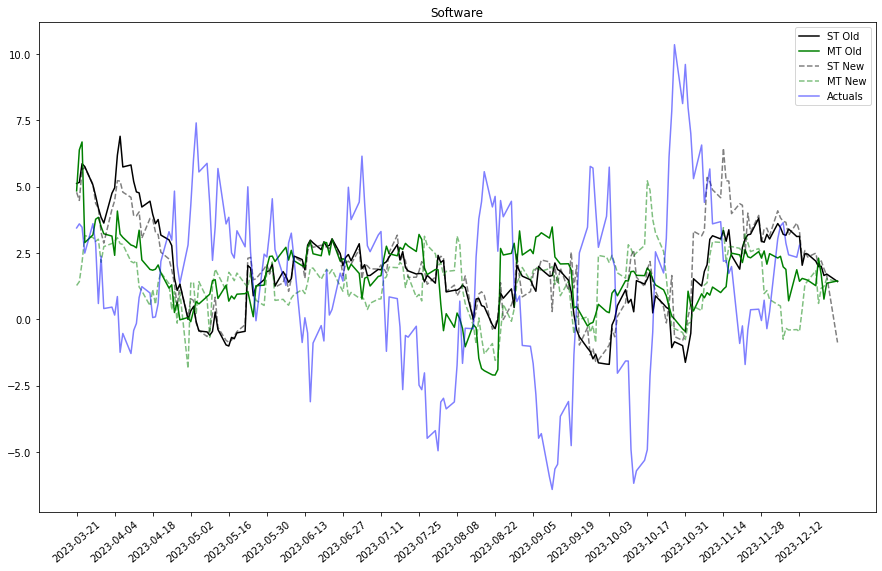

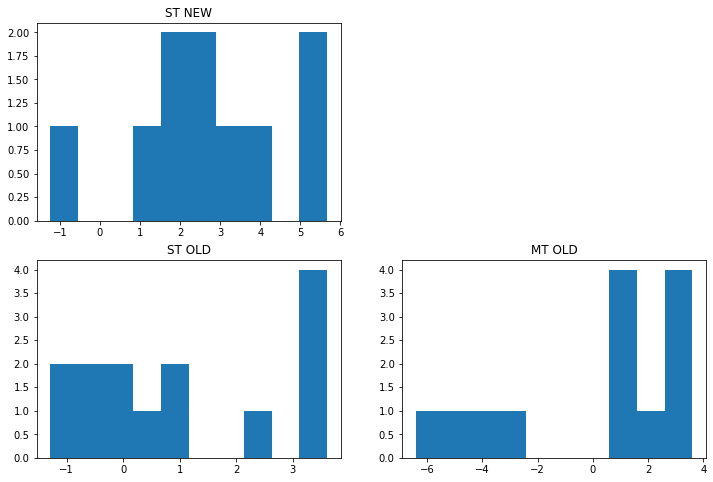

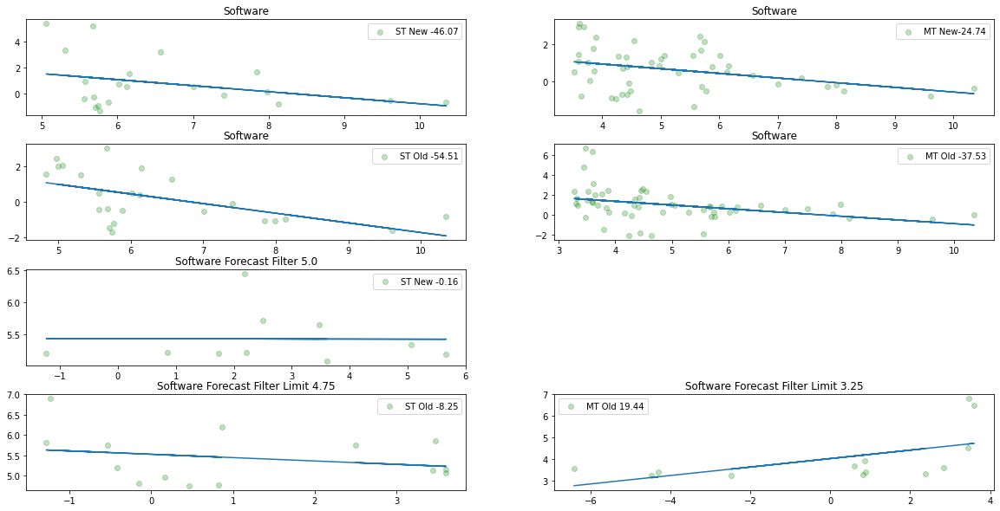

In [88]:
#RECENT SECTOR VISUALIZATION

def on_selection(value):
    global choice_sector
    choice_sector = value  # store the user's choice
    root.destroy()  # close window
    
query_rvo = 'SELECT * FROM best_rv_parameters_instant'
SelectedOld_RV_df = pd.read_sql_query(query_rvo, engine)
SelectedOld_RV_df = Set_DF(SelectedOld_RV_df)
SelectedOld_RV_df = DD_Index(SelectedOld_RV_df)

query_rvn = 'SELECT * FROM best_rv_parameters_instant_new'
SelectedNew_RV_df = pd.read_sql_query(query_rvn, engine)
SelectedNew_RV_df = Set_DF(SelectedNew_RV_df)
SelectedNew_RV_df = DD_Index(SelectedNew_RV_df)

up_st_old = SelectedOld_RV_df.loc['last', '1']
down_st_old = SelectedOld_RV_df.loc['last', '2']
up_mt_old = SelectedOld_RV_df.loc['last', '3']
down_mt_old = SelectedOld_RV_df.loc['last', '4']

up_st_new = SelectedNew_RV_df.loc['last', '1']
down_st_new = SelectedNew_RV_df.loc['last', '2']
up_mt_new = SelectedNew_RV_df.loc['last', '3']
down_mt_new = SelectedNew_RV_df.loc['last', '4']
    
choice_list = full_sectors_list.copy()
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a sector").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()

win = input('Enter window (empty for max): ')
if (win == ''):
    window = len(mix_cp_forecast_df.index)
else:
    window = int(win)
    
direction = input('(U)p or (D)own (empty = Up): ').upper()
cut = input('Enter actual threshold: ')
if (cut != ''):
    st_old = float(cut)
    mt_old = float(cut)
    st_new = float(cut)
    mt_new = float(cut)
else:
    if (direction != 'D'):
        st_old = up_st_old
        mt_old = up_mt_old
        st_new = up_st_new
        mt_new = up_mt_new
    else:
        st_old = down_st_old
        mt_old = down_mt_old
        st_new = down_st_new
        mt_new = down_mt_new

cp_o = int(mix_cp_forecast_df[-window:].T[mix_cp_forecast_df.columns.map(lambda x: x.find(choice_sector)) != -1].T.columns[0][-3:])
mp_o = int(mix_cp_forecast_df[-window:].T[mix_cp_forecast_df.columns.map(lambda x: x.find(choice_sector)) != -1].T.columns[1][-3:])
cp_n = int(mix_cp_forecast_N_df[-window:].T[mix_cp_forecast_N_df.columns.map(lambda x: x.find(choice_sector)) != -1].T.columns[0][-3:])
mp_n = int(mix_cp_forecast_N_df[-window:].T[mix_cp_forecast_N_df.columns.map(lambda x: x.find(choice_sector)) != -1].T.columns[1][-3:])

fig_1 = plt.figure(figsize = (15, 9))
fig2 = plt.figure(figsize = (12, 8))

ax0 = fig_1.add_subplot(1, 1, 1, title = choice_sector)
ax0.plot(mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(cp_o)], c = 'k', label = 'ST Old')
ax0.plot(mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(mp_o)], c = 'g', label = 'MT Old')
ax0.plot(mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(cp_n)], c = 'k', label = 'ST New', linestyle = 'dashed', alpha = 0.5)
ax0.plot(mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(mp_n)], c = 'g', label = 'MT New', linestyle = 'dashed', alpha = 0.5)
ax0.plot(mix_cp_forecast_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'], c = 'b', label = 'Actuals', alpha = 0.5)
ax0.legend(loc = 'best')
ax0.set_xticks(mix_cp_forecast_df[-window:].index[::int(round(window / 20, 0))])
ax0.set_xticklabels(mix_cp_forecast_df[-window:].index[::int(round(window / 20, 0))], rotation = 40)

x_labels_original = mix_cp_forecast_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns']
lin_reg_v = LinearRegression()

if (direction != 'D'):
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] >= st_new]
else:
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] <= st_new]

fig_1 = plt.figure(figsize = (20, 10))
y_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(cp_n)].loc[x_labels.index]
st_n_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
st_n_lr = st_n_model.predict(x_labels.dropna().values.reshape(-1, 1))
st_n_lr_df = pd.DataFrame(st_n_lr, index = x_labels.dropna().values)
ax1 = fig_1.add_subplot(4, 2, 1, title = choice_sector)
ax1.scatter(x_labels, y_labels, c = 'g', label = 'ST New ' + str(round(100 * st_n_model.coef_[0], 2)), alpha = 0.25)
ax1.plot(st_n_lr_df[st_n_lr_df.columns[0]])
ax1.legend(loc = 'best')

if (direction != 'D'):
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] >= mt_new]
else:
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] <= mt_new]

y_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(mp_n)].loc[x_labels.index]
mt_n_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
mt_n_lr = mt_n_model.predict(x_labels.dropna().values.reshape(-1, 1))
mt_n_lr_df = pd.DataFrame(mt_n_lr, index = x_labels.dropna().values)
ax2 = fig_1.add_subplot(4, 2, 2, title = choice_sector)
ax2.scatter(x_labels, y_labels, c = 'g', label = 'MT New' + str(round(100 * mt_n_model.coef_[0], 2)), alpha = 0.25)
ax2.plot(mt_n_lr_df[mt_n_lr_df.columns[0]])
ax2.legend(loc = 'best')

if (direction != 'D'):
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] >= st_old]
else:
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] <= st_old]

y_labels = mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(cp_o)].loc[x_labels.index]
st_o_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
st_o_lr = mt_n_model.predict(x_labels.dropna().values.reshape(-1, 1))
st_o_lr_df = pd.DataFrame(st_o_lr, index = x_labels.dropna().values)
ax3 = fig_1.add_subplot(4, 2, 3, title = choice_sector)
ax3.scatter(x_labels, y_labels, c = 'g', label = 'ST Old ' + str(round(100 * st_o_model.coef_[0], 2)), alpha = 0.25)
ax3.plot(st_o_lr_df[st_o_lr_df.columns[0]])
ax3.legend(loc = 'best')

if (direction != 'D'):
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] >= mt_old]
else:
    x_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'][mix_cp_forecast_N_df[-window:][choice_sector + ' ' + str(LAG_returns) + ' FWD Returns'] <= mt_old]

y_labels = mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(mp_o)].loc[x_labels.index]
mt_o_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
mt_o_lr = mt_o_model.predict(x_labels.dropna().values.reshape(-1, 1))
mt_o_lr_df = pd.DataFrame(mt_o_lr, index = x_labels.dropna().values)
ax4 = fig_1.add_subplot(4, 2, 4, title = choice_sector)
ax4.scatter(x_labels, y_labels, c = 'g', label = 'MT Old ' + str(round(100 * mt_o_model.coef_[0], 2)), alpha = 0.25)
ax4.plot(mt_o_lr_df[mt_o_lr_df.columns[0]])
ax4.legend(loc = 'best')



try:
    if (direction != 'D'):
        y_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(cp_n)][mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(cp_n)] >= st_new]
    else:
        y_labels = mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(cp_n)][mix_cp_forecast_N_df[-window:][choice_sector + ' CORR' + str(cp_n)] <= st_new]

    x_labels = x_labels_original.loc[y_labels.index]
    st_n_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
    st_n_lr = st_n_model.predict(x_labels.dropna().values.reshape(-1, 1))
    st_n_lr_df = pd.DataFrame(st_n_lr, index = x_labels.dropna().values)
    ax5 = fig_1.add_subplot(4, 2, 5, title = choice_sector + ' Forecast Filter ' + str(st_new))
    ax5.scatter(x_labels, y_labels, c = 'g', label = 'ST New ' + str(round(100 * st_n_model.coef_[0], 2)), alpha = 0.25)
    ax5.plot(st_n_lr_df[st_n_lr_df.columns[0]])
    ax5.legend(loc = 'best')
    
    h0 = fig2.add_subplot(2, 2, 1)
    h0.hist(x_labels, bins = 10)
    h0.set_title('ST NEW')
    print('')
    print('ST NEW median: ' + str(round(x_labels.median(), 2)))
    print('ST NEW mean: ' + str(round(x_labels.mean(), 2)))
    print('')
except:
    pass

try:
    if (direction != 'D'):
        y_labels = mix_mp_forecast_N_df[-window:][choice_sector + ' CORR' + str(mp_n)][mix_mp_forecast_N_df[-window:][choice_sector + ' CORR' + str(mp_n)] >= mt_new]
    else:
        y_labels = mix_mp_forecast_N_df[-window:][choice_sector + ' CORR' + str(mp_n)][mix_mp_forecast_N_df[-window:][choice_sector + ' CORR' + str(mp_n)] <= mt_new]

    x_labels = x_labels_original.loc[y_labels.index]
    mt_n_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
    mt_n_lr = mt_n_model.predict(x_labels.dropna().values.reshape(-1, 1))
    mt_n_lr_df = pd.DataFrame(mt_n_lr, index = x_labels.dropna().values)
    ax6 = fig_1.add_subplot(4, 2, 6, title = choice_sector + ' Forecast Filter Limit ' + str(mt_new))
    ax6.scatter(x_labels, y_labels, c = 'g', label = 'MT New' + str(round(100 * mt_n_model.coef_[0], 2)), alpha = 0.25)
    ax6.plot(mt_n_lr_df[mt_n_lr_df.columns[0]])
    ax6.legend(loc = 'best')
    
    h1 = fig2.add_subplot(2, 2, 2)
    h1.hist(x_labels, bins = 10)
    h1.set_title('MT NEW')
    print('')
    print('MT NEW median: ' + str(round(x_labels.median(), 2)))
    print('MT NEW mean: ' + str(round(x_labels.mean(), 2)))
    print('')
except:
    pass

try:
    if (direction != 'D'):
        y_labels = mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(cp_o)][mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(cp_o)] >= st_old]
    else:
        y_labels = mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(cp_o)][mix_cp_forecast_df[-window:][choice_sector + ' CORR' + str(cp_o)] <= st_old]

    x_labels = x_labels_original.loc[y_labels.index]
    st_o_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
    st_o_lr = mt_n_model.predict(x_labels.dropna().values.reshape(-1, 1))
    st_o_lr_df = pd.DataFrame(st_o_lr, index = x_labels.dropna().values)
    ax7 = fig_1.add_subplot(4, 2, 7, title = choice_sector + ' Forecast Filter Limit ' + str(st_old))
    ax7.scatter(x_labels, y_labels, c = 'g', label = 'ST Old ' + str(round(100 * st_o_model.coef_[0], 2)), alpha = 0.25)
    ax7.plot(st_o_lr_df[st_o_lr_df.columns[0]])
    ax7.legend(loc = 'best')
    
    h2 = fig2.add_subplot(2, 2, 3)
    h2.hist(x_labels, bins = 10)
    h2.set_title('ST OLD')
    print('')
    print('ST OLD median: ' + str(round(x_labels.median(), 2)))
    print('ST OLD mean: ' + str(round(x_labels.mean(), 2)))
    print('')
except:
    pass

try:
    if (direction != 'D'):
        y_labels = mix_mp_forecast_df[-window:][choice_sector + ' CORR' + str(mp_o)][mix_mp_forecast_df[-window:][choice_sector + ' CORR' + str(mp_o)] >= mt_old]
    else:
        y_labels = mix_mp_forecast_df[-window:][choice_sector + ' CORR' + str(mp_o)][mix_mp_forecast_df[-window:][choice_sector + ' CORR' + str(mp_o)] <= mt_old]

    x_labels = x_labels_original.loc[y_labels.index]
    mt_o_model = lin_reg_v.fit(x_labels.dropna().values.reshape(-1, 1), y_labels.loc[x_labels.dropna().index].fillna(method = 'ffill').values)
    mt_o_lr = mt_o_model.predict(x_labels.dropna().values.reshape(-1, 1))
    mt_o_lr_df = pd.DataFrame(mt_o_lr, index = x_labels.dropna().values)
    ax8 = fig_1.add_subplot(4, 2, 8, title = choice_sector + ' Forecast Filter Limit ' + str(mt_old))
    ax8.scatter(x_labels, y_labels, c = 'g', label = 'MT Old ' + str(round(100 * mt_o_model.coef_[0], 2)), alpha = 0.25)
    ax8.plot(mt_o_lr_df[mt_o_lr_df.columns[0]])
    ax8.legend(loc = 'best')
    
    h3 = fig2.add_subplot(2, 2, 4)
    h3.hist(x_labels, bins = 10)
    h3.set_title('MT OLD')
    print('')
    print('MT OLD median: ' + str(round(x_labels.median(), 2)))
    print('MT OLD mean: ' + str(round(x_labels.mean(), 2)))
    print('')
except:
    pass

plt.subplots_adjust(hspace = 0.3)
AllMixed_df = mix_cp_forecast_df[-15:].T[mix_cp_forecast_df.columns.map(lambda x: x.find(choice_sector)) != -1].T.join(mix_cp_forecast_N_df[-60:].T[mix_cp_forecast_N_df.columns.map(lambda x: x.find(choice_sector)) != -1].T, rsuffix = '_NEW')
AllMixed_df

(O)ld or (N)ew? O
Grid Search (L)ong, Grid Search (S)hort or Null? 
Trim Dates (Y/N)? N
RMSE adjustment (Y/N)? N
Select from file (Y/N)? N

0
(0.9, 8.0, -2.75, 3.5, -1.5, 0.1, 2.0, 0.85, 0.5, 0.5, 4.0, 15.0, -6.5, 2.0, -8.5, 2.5, 20.0, 5.0)

Consumer Goods EFF RATIO UP: 0.14
Consumer Goods LONG RATIO UP: 0.01
Consumer Goods ADJ RET UP: -266.5
Consumer Goods Efficiency SUM DOWN: 19.84
Consumer Services EFF RATIO UP: 0.54
Consumer Services LONG RATIO UP: 0.06
Consumer Services ADJ RET UP: -229.69
Consumer Services Efficiency SUM DOWN: -12.51
Energy EFF RATIO UP: 0.03
Energy LONG RATIO UP: 0.0
Energy ADJ RET UP: -381.54
Energy Efficiency SUM DOWN: 18.37
Financials EFF RATIO UP: 0.11
Financials LONG RATIO UP: 0.01
Financials ADJ RET UP: -174.14
Financials Efficiency SUM DOWN: 25.61
Hardware EFF RATIO UP: 0.62
Hardware LONG RATIO UP: 0.07
Hardware ADJ RET UP: -295.8
Hardware Efficiency SUM DOWN: 23.27
Health Care EFF RATIO UP: 0.6
Health Care LONG RATIO UP: 0.04
Health Care ADJ RET UP: -268

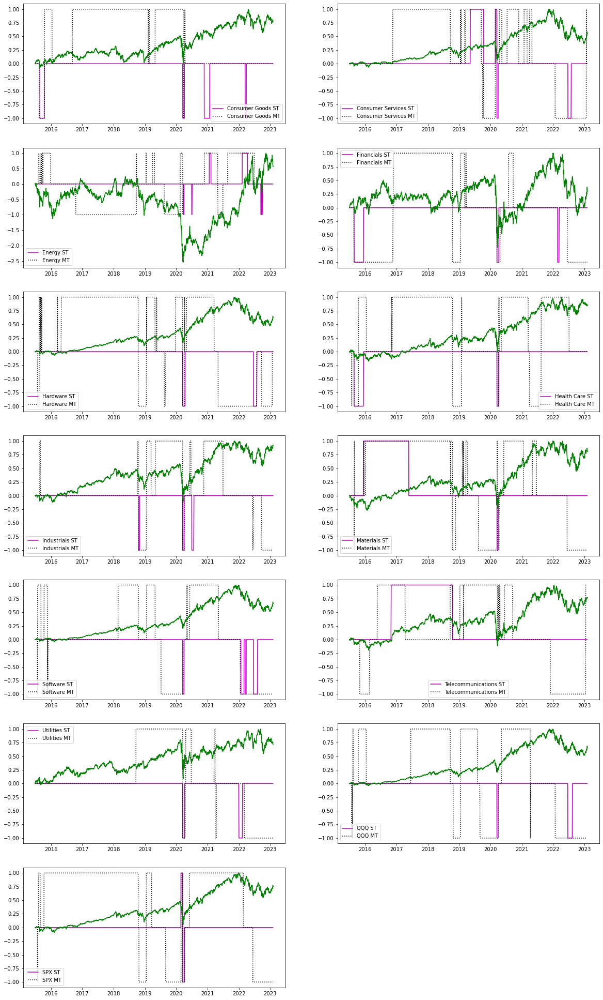

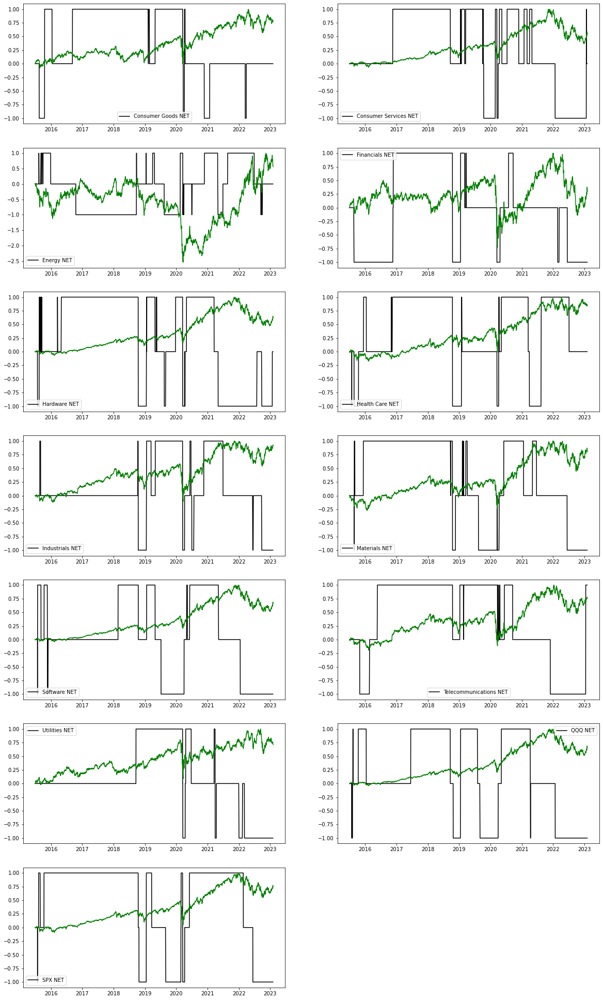

In [4]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\pca_sectors_algo_bm.py

#BINARY MATRIX GENERATOR

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
import warnings
import joblib
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.svm import SVR
from scipy.stats import norm

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()


def Sector_Allocations(forecast_df, d_list, s_list, window, up_on, up_off, down_on, down_off, rmse_mult, STD_w, STD_a):
    
    SectorPositions_df = pd.DataFrame(0, index = d_list, columns = s_list)
    
    for sector in s_list:
        window_str = sector + ' CORR' + str(window)
        sector_ret_str = sector + ' ' + str(lag_returns) + ' FWD Returns'
        sector_fwd_rets = forecast_df.T[forecast_df.columns.map(lambda x: x.find(sector_ret_str)) != -1].T.shift(lag_returns + 1)
        shifted_forecasts = forecast_df[window_str].shift(lag_returns + 1)
        
        std_series = forecast_df[window_str].clip(-20, 20).rolling(STD_w).std().replace({np.nan: 0}).rolling(STD_a).mean() * std_mult
        Ret_series_RAW = forecast_df[window_str]
        i = 0
        for current_date in d_list:
            
            Forecast_RAW = Ret_series_RAW.loc[current_date] 
            Forecast_STD = std_series.loc[current_date]
            Forecast_RMSE = 0
            if (RMSE_b):
                try:
                    Forecast_RMSE = np.sqrt(mean_squared_error(sector_fwd_rets[sector_fwd_rets.index < current_date][-10:], shifted_forecasts[shifted_forecasts.index < current_date][-10:]))
                except:
                    pass
            Forecast_RMSE = Forecast_RMSE / rmse_mult
            
            if (len(Ret_series_RAW[Ret_series_RAW.index < current_date].index) >= STD_w):
                Forecast_UP = Forecast_RAW - Forecast_STD - Forecast_RMSE
                Forecast_DOWN = Forecast_RAW + Forecast_STD + Forecast_RMSE
            else:
                Forecast_UP = 0
                Forecast_DOWN = 0
                
            if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                if (current_date in SectorPositions_df.index):
                    SectorPositions_df.drop(current_date, inplace = True)
                    i = i - 1
            else:
                if (Forecast_UP >= up_on):
                    SectorPositions_df.loc[current_date, sector] = 1
                elif (Forecast_DOWN <= down_on):
                    SectorPositions_df.loc[current_date, sector] = -1
                else:
                    if (i > 0):
                        SectorPositions_df.loc[current_date, sector] = SectorPositions_df.iloc[i - 1][sector]
                    else:
                        SectorPositions_df.loc[current_date, sector] = 0
                if (i > 0):
                    if (SectorPositions_df.iloc[i - 1][sector] == 1):
                        if (Forecast_RAW <= up_off): 
                            SectorPositions_df.loc[current_date, sector] = 0
                        if (Forecast_DOWN <= down_on):
                            SectorPositions_df.loc[current_date, sector] = -1
                    if (SectorPositions_df.iloc[i - 1][sector] == -1):
                        if (Forecast_RAW >= down_off): 
                            SectorPositions_df.loc[current_date, sector] = 0
                        if (Forecast_UP >= up_on):
                            SectorPositions_df.loc[current_date, sector] = 1
                i = i + 1
    
    return SectorPositions_df

def Simulation(Binary_df):
    
    to_date = lambda x: datetime(x.year, x.month, x.day)
    to_current = lambda x: sectors_pxs_rd_df.loc[current_date, x]
    to_previous = lambda x: sectors_pxs_rd_df.loc[prev_date, x] + sectors_correction_rd_df[prev_date: current_date].iloc[1:-1][x].sum()
    to_LLD = lambda x: sectors_pxs_rd_df.loc[last_long_date, x] + sectors_correction_rd_df[last_long_date: current_date].iloc[1:-1][x].sum()
    to_current_ss = lambda x: Equiv_Indexes_df.loc[current_date, x]
    to_previous_ss = lambda x: Equiv_Indexes_df.loc[prev_date, x]
    to_ETF = lambda x: Equivalence_df.loc[prev_date, x]
    to_ETF_LLD = lambda x: Equivalence_df.loc[last_long_date, x]
    to_ISN = lambda x: Equivalence_SN_df.loc[prev_date, x]
    to_ISN_LLD = lambda x: Equivalence_SN_df.loc[last_long_date, x]
    ETF_to_CurrPx = lambda x: Prices_df.loc[current_date, x]
    ETF_to_PrevPx = lambda x: Prices_df.loc[prev_date, x]
    ETF_to_LLDPx = lambda x: Prices_df.loc[last_long_date, x]
    to_level1 = lambda x: x.split(',')[0][2:-1]
    to_level2 = lambda x: int(x.split(',')[1][1:-1])

    ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
           'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']
    Sectors_OUT_list = ['Telecommunications']
    Sectors_ETF_list = []
    
    hedge_ratio = 1 / 2
    init_short_ratio = 15 / 100
    limit_short = 50 / 100

    Start_Date = Binary_df.index[0]
    active_ss = True
    AdjSectorPositions_df = Binary_df.copy()
    today = AdjSectorPositions_df.index[-1]      
    yest = AdjSectorPositions_df.index[AdjSectorPositions_df.index.values.tolist().index(today) - 1]

    active_hedges = True
    etf_mapping = True    
    ist_mapping = False
    ext = '_slim'
    fr = True

    query_sector_pxs = 'SELECT * FROM sector_indexes'    
    sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
    sectors_pxs_df = Set_DF(sectors_pxs_df)
    sectors_pxs_df = DD_Index(sectors_pxs_df)
    
    query_S_hedge = "SELECT * FROM new_hedge_relation"    
    S_hedge_df = pd.read_sql_query(query_S_hedge, engine)
    S_hedge_df = Set_DF(S_hedge_df)
    S_hedge_df = DD_Index(S_hedge_df)
    S_hedge_df = abs(S_hedge_df)
    S_hedge_STR = S_hedge_df.columns[0]

    query_Q_hedge = "SELECT * FROM hedge_relation"    
    Q_hedge_df = pd.read_sql_query(query_Q_hedge, engine)
    Q_hedge_df = Set_DF(Q_hedge_df)
    Q_hedge_df = DD_Index(Q_hedge_df)
    Q_hedge_df = abs(Q_hedge_df)
    Q_hedge_STR = Q_hedge_df.columns[0]

    sector_list = Binary_df.columns.values.tolist()
    if ('SPX' in sector_list):
        sector_list.remove('SPX')
    if ('QQQ' in sector_list):
        sector_list.remove('QQQ')

    Hedges_df = Q_hedge_df.copy()
    hedge_STR = Q_hedge_STR
    Opt_H = 'Q'
    if (Opt_H == 'O'):
        Hedges_df[hedge_STR] = (Q_hedge_df[Q_hedge_STR] + S_hedge_df[S_hedge_STR]).clip(0, 1).replace({np.nan: 0})    
    elif (Opt_H == 'A'):
        Hedges_df[hedge_STR] = (Q_hedge_df[Q_hedge_STR] * S_hedge_df[S_hedge_STR]).replace({np.nan: 0})   
    elif (Opt_H == 'S'):
        Hedges_df = S_hedge_df.copy()
        hedge_STR = S_hedge_STR

    query_sector_adj = 'SELECT * FROM sector_indexes_corrections'    
    sectors_correction_df = pd.read_sql_query(query_sector_adj, engine)
    sectors_correction_df = Set_DF(sectors_correction_df)
    sectors_correction_df = DD_Index(sectors_correction_df)

    query_equiv_idx = 'SELECT * FROM equivalent_indexes_relation'    
    Equiv_Indexes_df = pd.read_sql_query(query_equiv_idx, engine)
    Equiv_Indexes_df = Set_DF(Equiv_Indexes_df)
    Equiv_Indexes_df = DD_Index(Equiv_Indexes_df)

    rebalancing_series_lo = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({-1: 0}) == AdjSectorPositions_df.replace({-1: 0}).shift(1)).sum(axis = 1)
    rebalancing_series_lo.iloc[0] = 0
    rebalancing_series_lo.name = 'Rebalancings Long Only'
    rebalancing_dates_lo = rebalancing_series_lo[rebalancing_series_lo != 0].index.values.tolist()

    rebalancing_series_so = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({1: 0}) == AdjSectorPositions_df.replace({1: 0}).shift(1)).sum(axis = 1)
    rebalancing_series_so.iloc[0] = 0
    rebalancing_series_so.name = 'Rebalancings Short Only'
    rebalancing_dates_so = rebalancing_series_so[rebalancing_series_so != 0].index.values.tolist()

    rebalancing_series = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df == AdjSectorPositions_df.shift(1)).sum(axis = 1)
    rebalancing_series.iloc[0] = 0
    rebalancing_series.name = 'Rebalancings'
    rebalancing_dates = rebalancing_series[rebalancing_series != 0].index.values.tolist()

    if (yest not in rebalancing_dates):
        rebalancing_dates.append(yest)

    if (today not in rebalancing_dates):
        rebalancing_dates.append(today)

    if (active_hedges):    
        Hedged_positions = AdjSectorPositions_df.copy()
        Hedged_positions['Total Exp'] = Hedged_positions.replace({-1: 0}).sum(axis = 1).clip(0, 1) + (Hedged_positions.replace({1: 0}).sum(axis = 1) * init_short_ratio).map(lambda x: max(-limit_short, x))
        Hedged_positions = Hedged_positions.join(Hedges_df[hedge_STR])
        hedge_series_1 = Hedged_positions[Hedged_positions['Total Exp'] > 0][hedge_STR]
        hedge_series_2 = hedge_series_1.shift(1)
        rebalancing_dates = sorted(pd.unique(hedge_series_1[hedge_series_1 != hedge_series_2].index.values.tolist() + rebalancing_dates).tolist())

    sectors_pxs_rd_df = sectors_pxs_df.loc[rebalancing_dates] / 1000
    sectors_correction_rd_df = sectors_correction_df[sectors_correction_df.index > rebalancing_dates[0]] / 1000

    rebal_pct = round(100 * len(rebalancing_dates) / len(rebalancing_series.index), 2)
    print('Rebalancing % time: ' + str(rebal_pct))
    k_df = pd.DataFrame(AdjSectorPositions_df.loc[rebalancing_dates].astype(float).values, index = pd.Index(rebalancing_dates, name = 'Dates'), columns = [['Sectors'] * len(AdjSectorPositions_df.columns), AdjSectorPositions_df.columns])
    k_df.columns.names = ['Level', 'Sectors']
    spx_series = k_df['Sectors'].join(Prices_df['SPX'])['SPX']

    if (len(Sectors_OUT_list) > 0):
        for sec in Sectors_OUT_list:
            if (sec in k_df['Sectors'].columns):
                k_df['Sectors', sec] = float(0)

    k_df['Accounting', 'Cash'] = float(0)
    k_df['Accounting', 'Long'] = float(0)
    k_df['Accounting', 'Short Daily'] = float(0)
    k_df['Accounting', 'Short C'] = float(0)
    k_df['Accounting', 'Hedge Daily'] = float(0)
    k_df['Accounting', 'Hedge C'] = float(0)
    k_df['Accounting', 'Net'] = float(0)
    k_df['Exposure'] = float(0)
    k_df['Hedges'] = Hedges_df[hedge_STR]
    k_df.loc[k_df.index[0], ('Accounting', 'Long')] = k_df.iloc[0]['Sectors'].replace({-1: 0}).sum().clip(0, 1)
    k_df.loc[k_df.index[0], ('Accounting', 'Cash')] = 1 - k_df['Accounting', 'Long'][0]
    k_df.loc[k_df.index[0], ('Accounting', 'Net')] = 1

    Sector_Daily_Returns = (sectors_pxs_df / (sectors_pxs_df.shift(1) + sectors_correction_df.shift(1)) - 1).dropna(how = 'all')
    ETF_Daily_Returns = ((Prices_df[ETF_List] / Prices_df[ETF_List].shift(1)) - 1).loc[Sector_Daily_Returns.index]

    if (etf_mapping):
        query_eq = 'SELECT * FROM etf_equivalence_relation'    
        Equivalence_df = pd.read_sql_query(query_eq, engine)
        Equivalence_df = Set_DF(Equivalence_df)
        Equivalence_df = DD_Index(Equivalence_df)

    total_k = 1
    prev_k = 1
    prev_k_long = 1
    prev_date = rebalancing_dates[0]
    last_long_date = rebalancing_dates[0]
    last_short_date = rebalancing_dates[0]

    for idx, current_date in enumerate(rebalancing_dates[1:]): 
        idx = idx + 1
        short_ratio = init_short_ratio
        Updated_Short_Series = np.zeros(len(k_df['Sectors'].columns))
        Updated_Long_Series = np.zeros(len(k_df['Sectors'].columns))
        if (fr):
            last_long_date = prev_date
        else:
            last_long_date = list(pd.Series(rebalancing_dates_lo)[pd.Series(rebalancing_dates_lo) < current_date])[-1]


        if (etf_mapping):
            Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_PrevPx)
            LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF_LLD).map(ETF_to_LLDPx)
            Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_CurrPx)
            Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous_ss)
            Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current_ss)
        else:
            Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_previous)
            LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_LLD)
            Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_current)
            Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous)
            Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current)

        Previous_SPX_Px = spx_series[idx - 1]
        Current_SPX_Px = spx_series[idx]

        Previous_Long_Series = k_df.loc[last_long_date]['Sectors'].replace({-1: 0})
        Total_Longs_Previous = Previous_Long_Series.sum()
        Previous_Exposure = Total_Longs_Previous.clip(0, 1)

        if (prev_date not in rebalancing_dates_lo) & (not fr):
            Long_Adj_Series = Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)
            Total_Longs_Previous = (Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)).sum()
        else:
            Long_Adj_Series = Previous_Long_Series

        if (Total_Longs_Previous > 0):
            Updated_Long_Series = Long_Adj_Series * (Current_Pxs_Series_Long / Previous_Pxs_Series_Long) * (prev_k_long / Total_Longs_Previous)
            k_df.loc[current_date, ('Accounting', 'Long')] = Updated_Long_Series.sum()
            k_df.loc[current_date, ('Accounting', 'Cash')] = 0
        else:
            k_df.loc[current_date, ('Accounting', 'Cash')] = prev_k - k_df['Accounting', 'Short Daily'][idx - 1]

        if (active_ss):
            Previous_Short_Series = k_df.iloc[idx - 1]['Sectors'].replace({1: 0})
            if (abs(Previous_Short_Series.sum()) * short_ratio > limit_short):
                short_ratio = limit_short / abs(Previous_Short_Series.sum())

            Total_Shorts_Previous = Previous_Short_Series.sum() * short_ratio
            Previous_Exposure = Total_Longs_Previous.clip(0, 1) + Total_Shorts_Previous

            Base_Short_Series =  Previous_Short_Series * prev_k * short_ratio
            Updated_Short_Series = Base_Short_Series * (Current_Pxs_Series_Short / Previous_Pxs_Series_Short)
            Current_Short_Results = Updated_Short_Series - Base_Short_Series

            k_df.loc[current_date, ('Accounting', 'Short Daily')] = Current_Short_Results.sum()
            k_df.loc[current_date, ('Accounting', 'Short C')] = k_df['Accounting', 'Short C'][idx - 1] + k_df['Accounting', 'Short Daily'][idx]

        if (active_hedges):
            Previous_Hedge = 0
            if (k_df['Hedges'][idx - 1] == 1) & (Previous_Exposure > 0):
                Previous_Hedge = - Previous_Exposure * prev_k * hedge_ratio
                Previous_Exposure = Previous_Exposure * (1 - hedge_ratio)

            Updated_Hedge = Previous_Hedge * (Current_SPX_Px / Previous_SPX_Px)
            Current_Hedge_Results = Updated_Hedge - Previous_Hedge

            k_df.loc[current_date, ('Accounting', 'Hedge Daily')] = Current_Hedge_Results
            k_df.loc[current_date, ('Accounting', 'Hedge C')] = k_df['Accounting', 'Hedge C'][idx - 1] + k_df['Accounting', 'Hedge Daily'][idx]

        total_k = k_df['Accounting', 'Cash'][idx] + k_df['Accounting', 'Long'][idx] + k_df['Accounting', 'Short Daily'][idx] + k_df['Accounting', 'Hedge Daily'][idx]
        if (not fr) & (prev_k_long != prev_k):
            total_k = total_k + (k_df['Accounting', 'Short C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Short C')]) + (k_df['Accounting', 'Hedge C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Hedge C')]) - k_df['Accounting', 'Hedge Daily'][idx] - k_df['Accounting', 'Short Daily'][idx]
        k_df.loc[current_date, ('Accounting', 'Net')] = total_k
        k_df.loc[k_df.index[idx - 1], 'Exposure'] = Previous_Exposure 
        prev_k = total_k
        prev_k_long = prev_k
        prev_date = current_date

    ttl_perf = round(100 * (k_df['Accounting', 'Net'][-1] / k_df['Accounting', 'Net'][0] - 1), 2)
    dd_series = (k_df['Accounting', 'Net'] / k_df['Accounting', 'Net'].expanding().max() - 1)
    max_dd = round(100 * dd_series.min(), 2)
    cagr = round(100 * ((1 + ttl_perf / 100) ** (365 / (k_df.index[-1] - k_df.index[0]).days) - 1), 2)
    Acct_df = pd.DataFrame(k_df['Accounting'])
    Acct_df.index = Acct_df.T.columns.map(lambda x: datetime(x.year, x.month, x.day))
    Resampled_df = Acct_df.resample('M').last()
    Resampled_df.fillna(method = 'ffill', inplace = True)
    yearly_vol = round(100 * (Resampled_df['Net'] / Resampled_df['Net'].shift(1) - 1).std() * np.sqrt(12), 2)
    sharpe = round(cagr / yearly_vol, 2)
    cagr_dd = round(abs(cagr / max_dd), 2)

    return ttl_perf, max_dd, cagr, yearly_vol, sharpe, cagr_dd, rebal_pct

to_round = lambda x: round(x, 2)
to_find_ST = lambda x: x.find(corr_ST_str)
to_find_MT = lambda x: x.find(corr_MT_str)
to_year = lambda x: int(100 * int(int(str(x.year)[-2:])) + int(x.month))
sector_dict = {'SPX': 'SPX', 'QQQ': 'QQQ US'}

ext = ''
opt = input('(O)ld or (N)ew? ').upper()
if (opt == 'N'):
    ext = '_new'
    
query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

query_lr = 'SELECT * FROM lr_forecasts_relation' + ext 
LR_Forecasts_df = pd.read_sql_query(query_lr, engine)
LR_Forecasts_df = Set_DF(LR_Forecasts_df)
LR_Forecasts_df = DD_Index(LR_Forecasts_df)

query_rf = 'SELECT * FROM rf_forecasts_relation' + ext   
RF_Forecasts_df = pd.read_sql_query(query_rf, engine)
RF_Forecasts_df = Set_DF(RF_Forecasts_df)
RF_Forecasts_df = DD_Index(RF_Forecasts_df)

query_svr = 'SELECT * FROM svr_forecasts_relation' + ext   
SVR_Forecasts_df = pd.read_sql_query(query_svr, engine)
SVR_Forecasts_df = Set_DF(SVR_Forecasts_df)
SVR_Forecasts_df = DD_Index(SVR_Forecasts_df)

query_en = 'SELECT * FROM en_forecasts_relation' + ext  
EN_Forecasts_df = pd.read_sql_query(query_en, engine)
EN_Forecasts_df = Set_DF(EN_Forecasts_df)
EN_Forecasts_df = DD_Index(EN_Forecasts_df)

ewm_factor = 3
rs_b = False
if (rs_b):
    LR_Forecasts_df = LR_Forecasts_df.ewm(halflife = ewm_factor).mean()
    EN_Forecasts_df = EN_Forecasts_df.ewm(halflife = ewm_factor).mean()

query_corr = 'SELECT * FROM r_corr_relation' + ext
r_corr_df = pd.read_sql_query(query_corr, engine)
r_corr_df = Set_DF(r_corr_df)
r_corr_df = DD_Index(r_corr_df)

try:
    query_parameters = 'SELECT * FROM gs_parameters'
    RandomVectors_df = pd.read_sql_query(query_parameters, engine)
    RandomVectors_df = Set_DF(RandomVectors_df)
    RandomVectors_df = DD_Index(RandomVectors_df)
except:
    pass

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)
sectors_pxs_df = sectors_pxs_df.join(Prices_df['QQQ US'])
sectors_pxs_df = sectors_pxs_df.join(Prices_df['SPX'])
sectors_pxs_df.rename(columns = {'QQQ US': 'QQQ'}, inplace = True)

sector_list = sectors_pxs_df.columns.values.tolist()

lag_returns = 10
correlation_window_ST = 84
correlation_window_MT = 168

#EXP_tuple = (0.9, 5.5, -3.75, 3.0, -2.0, 0.5, 2.5, 1.0, 1.0, 1.25, 4.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42, 1) 
#EXP_tuple = (0.85, 5.5, -3.75, 4.0, -1.0, 0.5, 3.5, 1.0, 1.0, 1.25, 4.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42, 1)
##2020      (0.95, 5.5, -3.75, 4.0, -3.0, 0.5, 3.5, 1.0, 1.0, 0.5, 3.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42.0, 5.0)
##2021      (0.95, 6.5, -4.75, 3.0, -2.0, 0.1, 3.5, 0.5, 1.0, 1.25, 4.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42.0, 10.0)
#EXP_tuple = (0.91, 6.0, -3.45, 2.9, -2.2, 0.42, 2.9, 0.95, 0.95, 1.025, 3.85, 15.0, -6.5, 2.0, -8.5, 2.5, 25.2, 6.2) #MEDIAN 2001
#EXP_tuple = (0.85, 6.5, -3.75, 3.0, -1.0, 0.1, 2.5, 1.0, 0.5, 2.0, 5.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42.0, 5.0) #MEDIAN 2201
#EXP_tuple = (0.95, 5.5, -4.75, 4.0, -2.0, 0.1, 3.5, 1.0, 1.0, 0.5, 3.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42.0, 10.0) #MEDIAN 2207
#EXP_tuple = (0.85, 4.5, -2.75, 3.0, -3.0, 0.1, 2.5, 1.0, 0.5, 0.5, 4.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42, 1)
#EXP_tuple = (0.95, 6.5, -3.75, 4.0, -3.0, 0.1, 2.5, 0.5, 2.0, 2.0, 4.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42, 1)
#EXP_tuple = (0.85, 6.5, -4.75, 2.0, -1.0, 0.1, 3.5, 1.0, 0.5, 2.0, 5.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42.0, 10.0)
#EXP_tuple = (0.95, 4.5, -4.75, 4.0, -2.0, 1.1, 3.5, 0.5, 2.0, 1.25, 5.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42, 5)

EXP_tuple = (0.95, 5.5, -4.75, 4.0, -1.0, 1.1, 1.5, 0.5, 2.0, 0.5, 3.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42.0, 1.0)
query_rvi = 'SELECT * FROM best_rv_parameters_instant'
SelectedInst_RV_df = pd.read_sql_query(query_rvi, engine)
SelectedInst_RV_df = Set_DF(SelectedInst_RV_df)
SelectedInst_RV_df = DD_Index(SelectedInst_RV_df)
EXP_tuple = SelectedInst_RV_df.loc['last'].values


conf_interval_list = pd.Series(EXP_tuple[0]).values.tolist() ## 0.950
threshold_up_ST_ON_list = pd.Series(EXP_tuple[1]).values.tolist() ### 5.00
threshold_up_ST_OFF_list = pd.Series(EXP_tuple[2]).values.tolist() ### -2.60 -3.00 -2.60
threshold_up_MT_ON_list = pd.Series(EXP_tuple[3]).values.tolist() ### 5.35      4.35 O: 4.00
threshold_up_MT_OFF_list = pd.Series(EXP_tuple[4]).values.tolist() ### -1.75
lr_st_mult_list = pd.Series(EXP_tuple[5]).values.tolist() ### 1.50 2.50 2.50 O:2.50
rf_st_mult_list = pd.Series(EXP_tuple[6]).values.tolist() ### 2.25 2.50 2.50 O:2.00
en_st_mult_list = pd.Series(EXP_tuple[7]).values.tolist() ### 1.50
lr_mt_mult_list = pd.Series(EXP_tuple[8]).values.tolist() ### 1.00
rf_mt_mult_list = pd.Series(EXP_tuple[9]).values.tolist() ### 0.75 O: 0.50
en_mt_mult_list = pd.Series(EXP_tuple[10]).values.tolist() ### 4.50 4.50
rmse_mult_list = pd.Series(EXP_tuple[11]).values.tolist()
threshold_down_ST_ON_list = pd.Series(EXP_tuple[12]).values.tolist() ### -5.50      -5.00 O:-6.00
threshold_down_ST_OFF_list = pd.Series(EXP_tuple[13]).values.tolist() ### 1.00      0.00 O: 1.50
threshold_down_MT_ON_list = pd.Series(EXP_tuple[14]).values.tolist() ### -8.50 -8.50 -7.50
threshold_down_MT_OFF_list = pd.Series(EXP_tuple[15]).values.tolist() ### 2.50 O: 2.00
std_w_list = pd.Series(EXP_tuple[16]).values.tolist()
std_a_list = pd.Series(EXP_tuple[17]).values.tolist()

gs = False
gs_size = 1
opt_gs = input('Grid Search (L)ong, Grid Search (S)hort or Null? ').upper()
date_range = EN_Forecasts_df.index

trim_dates = input('Trim Dates (Y/N)? ').upper()
if (trim_dates == 'Y'):
    Start_Date = input("Enter Start Date: (YY/MM/DD)")
    if (Start_Date != ''):    
        Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()
        date_range = date_range[date_range >= Start_Date]
    End_Date = input("Enter End Date: (YY/MM/DD)")
    if (Start_Date != ''):    
        End_Date = datetime.strptime(End_Date, "%y/%m/%d").date()
        date_range = date_range[date_range <= End_Date]
    

if (opt_gs == 'L') | (opt_gs == 'S'):
    opt_cv = input('Tail test (Y/N)? ').upper()
    if (opt_cv == 'Y'):
        cut_year = input('Last Date (YYMM): ')
        if (cut_year != ''):
            co_year = 100 * int(cut_year[:2]) + int(cut_year[-2:])
        else:
            co_year = 100 * int(RF_Forecasts_df.index[-1].year) + int(RF_Forecasts_df.index[-1].month)
    else:
        co_year = 100 * int(RF_Forecasts_df.index[-1].year) + int(RF_Forecasts_df.index[-1].month)
    date_range = date_range[(pd.Series(date_range).map(to_year) <= co_year)]
    
NewAlgo_Final_SectorPositions_df = pd.DataFrame(0, index = date_range, columns = sector_list)
RMSE_b = False
RMSE_s = input('RMSE adjustment (Y/N)? ').upper()
if (RMSE_s == 'Y'):
    RMSE_b = True

#EXP_tuple = (0.95, 5.5, -4.75, 4.0, -1.0, 1.1, 1.5, 0.5, 2.0, 0.5, 3.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42.0, 1.0)
    
if (opt_gs == 'L'):
    gs = True
    conf_interval_list = [0.85, 0.90, 0.95]
    threshold_up_ST_ON_list = [4.50, 5.50, 6.50]
    threshold_up_ST_OFF_list = [-4.75, -3.75, -2.75]
    threshold_up_MT_ON_list = [2.00, 3.00, 4.00]
    threshold_up_MT_OFF_list = [-3.00, -2.00, -1.00]
    lr_st_mult_list = [0.10, 0.50, 1.10]
    rf_st_mult_list = [1.50, 2.50, 3.50]
    en_st_mult_list = [0.50, 1.00, 2.00]
    lr_mt_mult_list = [0.50, 1.00, 2.00]
    rf_mt_mult_list = [0.50, 1.25, 2.00]
    en_mt_mult_list = [3.25, 4.25, 5.25]
    rmse_mult_list = [15.00]
    std_w_list = [21, 42]
    std_a_list = [1, 5, 10]
elif (opt_gs == 'S'):
    gs = True
    threshold_down_ST_ON_list = [-6.50]
    threshold_down_ST_OFF_list = [2.00]
    threshold_down_MT_ON_list = [-8.50]
    threshold_down_MT_OFF_list = [2.50]
else:
    sff_q = input('Select from file (Y/N)? ').upper()
    if (sff_q == 'Y'):
        position = int(input('Enter Position: '))
        conf_interval_list = pd.Series(RandomVectors_df.loc[position, '0']).values.tolist()
        threshold_up_ST_ON_list = pd.Series(RandomVectors_df.loc[position, '1']).values.tolist()
        threshold_up_ST_OFF_list = pd.Series(RandomVectors_df.loc[position, '2']).values.tolist()
        threshold_up_MT_ON_list = pd.Series(RandomVectors_df.loc[position, '3']).values.tolist()
        threshold_up_MT_OFF_list = pd.Series(RandomVectors_df.loc[position, '4']).values.tolist()
        lr_st_mult_list = pd.Series(RandomVectors_df.loc[position, '5']).values.tolist()
        rf_st_mult_list = pd.Series(RandomVectors_df.loc[position, '6']).values.tolist()
        en_st_mult_list = pd.Series(RandomVectors_df.loc[position, '7']).values.tolist()
        lr_mt_mult_list = pd.Series(RandomVectors_df.loc[position, '8']).values.tolist()
        rf_mt_mult_list = pd.Series(RandomVectors_df.loc[position, '9']).values.tolist()
        en_mt_mult_list = pd.Series(RandomVectors_df.loc[position, '10']).values.tolist()
        rmse_mult_list = pd.Series(RandomVectors_df.loc[position, '11']).values.tolist()
        threshold_down_ST_ON_list = pd.Series(RandomVectors_df.loc[position, '12']).values.tolist()
        threshold_down_ST_OFF_list = pd.Series(RandomVectors_df.loc[position, '13']).values.tolist()
        threshold_down_MT_ON_list = pd.Series(RandomVectors_df.loc[position, '14']).values.tolist()
        threshold_down_MT_OFF_list = pd.Series(RandomVectors_df.loc[position, '15']).values.tolist()
        std_w_list = pd.Series(RandomVectors_df.loc[position, '16']).values.tolist()
        std_a_list = pd.Series(RandomVectors_df.loc[position, '17']).values.tolist()
          
if (gs):
    if (RMSE_b):
        sample_size = len(conf_interval_list) * len(threshold_up_ST_ON_list) * len(threshold_up_ST_OFF_list) * len(threshold_up_MT_ON_list) * len(threshold_up_MT_OFF_list) * len(lr_st_mult_list) * len(rf_st_mult_list) * len(en_st_mult_list) * len(lr_mt_mult_list) * len(rf_mt_mult_list) * len(en_mt_mult_list) * len(rmse_mult_list) * len(threshold_down_ST_ON_list) * len(threshold_down_ST_OFF_list) * len(threshold_down_MT_ON_list) * len(threshold_down_MT_OFF_list) * len(std_w_list) * len(std_a_list)
    else:
        sample_size = len(conf_interval_list) * len(threshold_up_ST_ON_list) * len(threshold_up_ST_OFF_list) * len(threshold_up_MT_ON_list) * len(threshold_up_MT_OFF_list) * len(lr_st_mult_list) * len(rf_st_mult_list) * len(en_st_mult_list) * len(lr_mt_mult_list) * len(rf_mt_mult_list) * len(en_mt_mult_list) * len(threshold_down_ST_ON_list) * len(threshold_down_ST_OFF_list) * len(threshold_down_MT_ON_list) * len(threshold_down_MT_OFF_list) * len(std_w_list) * len(std_a_list)
    print('Sample Space: ' + str("{:,d}".format(sample_size)))
    gs_size = int(input('Samples: '))
    print('Sampling Relevance: ' + str(round(100 * gs_size / sample_size, 2)) + '%')    
    ci_array = np.array([EXP_tuple[0]] + np.random.choice(conf_interval_list, size = gs_size).tolist())
    t_up_st_on_array = np.array([EXP_tuple[1]] + np.random.choice(threshold_up_ST_ON_list, size = gs_size).tolist())
    t_up_st_off_array = np.array([EXP_tuple[2]] + np.random.choice(threshold_up_ST_OFF_list, size = gs_size).tolist())
    t_up_mt_on_array = np.array([EXP_tuple[3]] + np.random.choice(threshold_up_MT_ON_list, size = gs_size).tolist())
    t_up_mt_off_array = np.array([EXP_tuple[4]] + np.random.choice(threshold_up_MT_OFF_list, size = gs_size).tolist())
    lr_st_mult_array = np.array([EXP_tuple[5]] + np.random.choice(lr_st_mult_list, size = gs_size).tolist())
    rf_st_mult_array = np.array([EXP_tuple[6]] + np.random.choice(rf_st_mult_list, size = gs_size).tolist())
    en_st_mult_array = np.array([EXP_tuple[7]] + np.random.choice(en_st_mult_list, size = gs_size).tolist())
    lr_mt_mult_array = np.array([EXP_tuple[8]] + np.random.choice(lr_mt_mult_list, size = gs_size).tolist())
    rf_mt_mult_array = np.array([EXP_tuple[9]] + np.random.choice(rf_mt_mult_list, size = gs_size).tolist())
    en_mt_mult_array = np.array([EXP_tuple[10]] + np.random.choice(en_mt_mult_list, size = gs_size).tolist())
    rmse_mult_array = np.array([EXP_tuple[11]] + np.random.choice(rmse_mult_list, size = gs_size).tolist())
    t_down_st_on_array = np.array([EXP_tuple[12]] + np.random.choice(threshold_down_ST_ON_list, size = gs_size).tolist())
    t_down_st_off_array = np.array([EXP_tuple[13]] + np.random.choice(threshold_down_ST_OFF_list, size = gs_size).tolist())
    t_down_mt_on_array = np.array([EXP_tuple[14]] + np.random.choice(threshold_down_MT_ON_list, size = gs_size).tolist())
    t_down_mt_off_array = np.array([EXP_tuple[15]] + np.random.choice(threshold_down_MT_OFF_list, size = gs_size).tolist())
    std_w_array = np.array([EXP_tuple[16]] + np.random.choice(std_w_list, size = gs_size).tolist())
    std_a_array = np.array([EXP_tuple[17]] + np.random.choice(std_a_list, size = gs_size).tolist())
else:
    ci_array = np.random.choice(conf_interval_list, size = gs_size)
    t_up_st_on_array = np.random.choice(threshold_up_ST_ON_list, size = gs_size)
    t_up_st_off_array = np.random.choice(threshold_up_ST_OFF_list, size = gs_size)
    t_up_mt_on_array = np.random.choice(threshold_up_MT_ON_list, size = gs_size)
    t_up_mt_off_array = np.random.choice(threshold_up_MT_OFF_list, size = gs_size)
    lr_st_mult_array = np.random.choice(lr_st_mult_list, size = gs_size)
    rf_st_mult_array = np.random.choice(rf_st_mult_list, size = gs_size)
    en_st_mult_array = np.random.choice(en_st_mult_list, size = gs_size)
    lr_mt_mult_array = np.random.choice(lr_mt_mult_list, size = gs_size)
    rf_mt_mult_array = np.random.choice(rf_mt_mult_list, size = gs_size)
    en_mt_mult_array = np.random.choice(en_mt_mult_list, size = gs_size)
    rmse_mult_array = np.random.choice(rmse_mult_list, size = gs_size)
    t_down_st_on_array = np.random.choice(threshold_down_ST_ON_list, size = gs_size)
    t_down_st_off_array = np.random.choice(threshold_down_ST_OFF_list, size = gs_size)
    t_down_mt_on_array = np.random.choice(threshold_down_MT_ON_list, size = gs_size)
    t_down_mt_off_array = np.random.choice(threshold_down_MT_OFF_list, size = gs_size)
    std_w_array = np.random.choice(std_w_list, size = gs_size)
    std_a_array = np.random.choice(std_a_list, size = gs_size)
    
random_vector = zip(ci_array, t_up_st_on_array, t_up_st_off_array, t_up_mt_on_array, t_up_mt_off_array, lr_st_mult_array, rf_st_mult_array, en_st_mult_array, lr_mt_mult_array, rf_mt_mult_array, en_mt_mult_array, rmse_mult_array, t_down_st_on_array, t_down_st_off_array, t_down_mt_on_array, t_down_mt_off_array, std_w_array, std_a_array)
GS_Results_df = pd.DataFrame(np.nan, index = np.arange(gs_size + 1), columns = ['Total Return', 'Max DD', 'CAGR', 'Adj CAGR', 'Yearly Vol', 'Sharpe', 'CAGR/DD', 'Rebalancing (%)'])  
RandomVectors_df = pd.DataFrame(np.nan, index = np.arange(gs_size + 1), columns = np.arange(18))

for idx_, element in enumerate(random_vector):
    print('')
    print(str(idx_))
    print(element)
    print('')
    
    RandomVectors_df.iloc[idx_] = element
    conf_interval = element[0]
    std_mult = norm.ppf(conf_interval)    

    threshold_up_ST_ON = element[1] 
    threshold_up_ST_OFF = element[2] 
    threshold_up_MT_ON = element[3] 
    threshold_up_MT_OFF = element[4] 
    threshold_down_ST_ON = element[12]
    threshold_down_ST_OFF = element[13]
    threshold_down_MT_ON = element[14]
    threshold_down_MT_OFF = element[15]

    lr_st_mult = element[5]
    rf_st_mult = element[6] 
    svr_st_mult = 0.00
    en_st_mult = element[7]
    ttl_st_mult = lr_st_mult + rf_st_mult + svr_st_mult + en_st_mult
    lr_mt_mult = element[8] 
    rf_mt_mult = element[9] 
    svr_mt_mult = 0.00
    en_mt_mult = element[10] 
    ttl_mt_mult = lr_mt_mult + rf_mt_mult + svr_mt_mult + en_mt_mult

    Selected_ST_df = (LR_Forecasts_df * lr_st_mult + RF_Forecasts_df * rf_st_mult + SVR_Forecasts_df * svr_st_mult + EN_Forecasts_df * en_st_mult) / ttl_st_mult
    Selected_MT_df = (LR_Forecasts_df * lr_mt_mult + RF_Forecasts_df * rf_mt_mult + SVR_Forecasts_df * svr_mt_mult + EN_Forecasts_df * en_mt_mult) / ttl_mt_mult

    Selected_ST_df = Selected_ST_df[Selected_ST_df.index <= date_range[-1]]
    Selected_MT_df = Selected_MT_df[Selected_MT_df.index <= date_range[-1]]

    NewAlgo_ST_SectorPositions_df = Sector_Allocations(Selected_ST_df, date_range, sector_list, correlation_window_ST, threshold_up_ST_ON, threshold_up_ST_OFF, threshold_down_ST_ON, threshold_down_ST_OFF, element[11], int(element[16]), int(element[17]))
    NewAlgo_MT_SectorPositions_df = Sector_Allocations(Selected_MT_df, date_range, sector_list, correlation_window_MT, threshold_up_MT_ON, threshold_up_MT_OFF, threshold_down_MT_ON, threshold_down_MT_OFF, element[11], int(element[16]), int(element[17]))
    NewAlgo_Final_SectorPositions_df = (NewAlgo_ST_SectorPositions_df + NewAlgo_MT_SectorPositions_df).clip(-1, 1)

    fig1 = plt.figure(figsize = (20, 35))
    fig2 = plt.figure(figsize = (20, 35))
    ef_up_TOT = 0
    ef_down_TOT = 0
    ret_up_TOT = 0
    ret_down_TOT = 0
    d_long_TOT = 0
    adj_ret_up_TOT = 0
    for idx, sector in enumerate(sector_list):  
        if (sector in sector_dict):
            ETF_equiv = sector_dict[sector]
        else:
            ETF_equiv = Equivalence_df.iloc[-1][sector]
        etf_series = Prices_df[ETF_equiv]
        etf_rets = round(100 * (etf_series / etf_series.shift(1) - 1), 2)
        returns_string = etf_rets.name + '_Returns'
        etf_rets.name = returns_string
        new_all = NewAlgo_Final_SectorPositions_df.copy()
        new_all = new_all.join(etf_rets)
            
        adj_ret_up = round(new_all[new_all[sector] == 1][returns_string][new_all[new_all[sector] == 1][returns_string] > 0].sum() + new_all[new_all[sector] == 1][returns_string][new_all[new_all[sector] == 1][returns_string] < 0].sum() * 2, 2)    
        ret_up = round(new_all[new_all[sector] == 1][returns_string].sum(), 2)
        ef_up = round(new_all[new_all[sector] == 1][returns_string].sum() / new_all[returns_string].sum(), 2)
        ef_down = round(new_all[new_all[sector] == -1][returns_string].sum(), 2)
        d_long = len(new_all[new_all[sector] == 1].index)     
        d_long_TOT = d_long_TOT + d_long
        ret_up_TOT = ret_up_TOT + ret_up
        adj_ret_up_TOT = adj_ret_up_TOT + adj_ret_up
        ef_up_TOT = ef_up_TOT + ef_up
        ef_down_TOT = ef_down_TOT + ef_down
        
        print(sector + ' EFF RATIO UP: ' + str(ef_up))
        print(sector + ' LONG RATIO UP: ' + str(round(ret_up / d_long, 2)))
        print(sector + ' ADJ RET UP: ' + str(adj_ret_up))
        print(sector + ' Efficiency SUM DOWN: ' + str(ef_down))
        
        if (not gs):
            corr_ST_str = sector + ' up CORR' + str(correlation_window_ST)
            corr_MT_str = sector + ' up CORR' + str(correlation_window_MT)
            grouped_corr_ST = r_corr_df.groupby(r_corr_df.columns.map(to_find_ST), axis = 1).mean()
            grouped_corr_MT = r_corr_df.groupby(r_corr_df.columns.map(to_find_MT), axis = 1).mean()

            Slice_Prices_series = Prices_df[Prices_df.index >= NewAlgo_Final_SectorPositions_df.index[0]][ETF_equiv]
            ax = {}
            ax[idx] = fig1.add_subplot(7, 2, idx + 1)
            ax[idx].plot(NewAlgo_ST_SectorPositions_df[sector], label = sector + ' ST', c = 'm')
            ax[idx].plot(NewAlgo_MT_SectorPositions_df[sector], label = sector + ' MT', c = 'k', linestyle = 'dotted')
            ax[idx].plot((Slice_Prices_series - Slice_Prices_series[0]) / (Slice_Prices_series.max() - Slice_Prices_series[0]), c = 'g')
            try:
                ax[idx].plot(grouped_corr_ST[0], c = 'b')
            except:
                pass
            try:
                ax[idx].plot(grouped_corr_MT[0], c = 'r')
            except:
                pass
            ax[idx].legend(loc = 'best')
    
    NewAlgo_Final_SectorPositions_df.sort_index(inplace = True)
    sim_results = Simulation(NewAlgo_Final_SectorPositions_df.drop(['SPX', 'QQQ'], axis = 1))
    
    print('')
    print('Total Return: ' + str(sim_results[0]))
    print('Max DD: ' + str(sim_results[1]))
    print('CAGR: ' + str(sim_results[2]))
    print('Yearly Vol: ' + str(sim_results[3]))
    print('Sharpe Ratio: ' + str(sim_results[4]))
    print('CAGR/DD Ratio: ' + str(sim_results[5]))
    print('')
    GS_Results_df.loc[idx_, 'Total Return'] = sim_results[0]
    GS_Results_df.loc[idx_, 'Max DD'] = sim_results[1]
    GS_Results_df.loc[idx_, 'CAGR'] = sim_results[2]
    GS_Results_df.loc[idx_, 'Yearly Vol'] = sim_results[3]
    GS_Results_df.loc[idx_, 'Sharpe'] = sim_results[4]
    GS_Results_df.loc[idx_, 'CAGR/DD'] = sim_results[5]
    GS_Results_df.loc[idx_, 'Rebalancing (%)'] = sim_results[6]
    GS_Results_df.loc[idx_, 'Adj CAGR'] = sim_results[2] * sim_results[4]
    
    GS_Results_df.sort_values(by = ['Adj CAGR'], ascending = False, inplace = True)
    print(GS_Results_df[:5])
    
    if (not gs):
        for idx, sector in enumerate(sector_list):  
            if (sector in sector_dict):
                ETF_equiv = sector_dict[sector]
            else:
                ETF_equiv = Equivalence_df.iloc[-1][sector]
            corr_ST_str = sector + ' up CORR' + str(correlation_window_ST)
            corr_MT_str = sector + ' up CORR' + str(correlation_window_MT)
            grouped_corr_ST = r_corr_df.groupby(r_corr_df.columns.map(to_find_ST), axis = 1).mean()
            grouped_corr_MT = r_corr_df.groupby(r_corr_df.columns.map(to_find_MT), axis = 1).mean()

            Slice_Prices_series = Prices_df[Prices_df.index >= NewAlgo_Final_SectorPositions_df.index[0]][ETF_equiv]
            ax = {}
            ax[idx] = fig2.add_subplot(7, 2, idx + 1)
            ax[idx].plot(NewAlgo_Final_SectorPositions_df[sector], label = sector + ' NET', c = 'k')
            ax[idx].plot((Slice_Prices_series - Slice_Prices_series[0]) / (Slice_Prices_series.max() - Slice_Prices_series[0]), c = 'g')
            try:
                ax[idx].plot(grouped_corr_ST[0], c = 'b')
            except:
                pass
            try:
                ax[idx].plot(grouped_corr_MT[0], c = 'r')
            except:
                pass
            ax[idx].legend(loc = 'best')

if (not gs):
    NewAlgo_Final_SectorPositions_df.to_sql('sector_trades_relation', engine, index = True, if_exists = 'replace')
else:
    save_gs = ''
    save_gs = input('Save GS files (Y/N)? ').upper()
    GS_Results_df.sort_values(by = ['Adj CAGR'], ascending = False, inplace = True)
    RandomVectors_df = RandomVectors_df.loc[GS_Results_df.index]
    if (save_gs == 'Y'):
        GS_Results_df.to_sql('gs_results', engine, index = True, if_exists = 'replace')
        RandomVectors_df.to_sql('gs_parameters', engine, index = True, if_exists = 'replace')
    show_size = min(50, len(GS_Results_df.index))
    if (opt_gs == 'L'):
        A = 0
        B = 12
    if (opt_gs == 'S'):
        A = 12
        B = len(RandomVectors_df.columns)
    print(RandomVectors_df.loc[GS_Results_df.index[:show_size]][RandomVectors_df.columns[A: B]])
    print('')
    print(GS_Results_df[:show_size])

Enter Start Date: (YY/MM/DD)15/10/01
Activate Short Selling (Y/N)? Y
Activate Hedges (Y/N)? Y
ETF Mapping (Y/N)? Y
Single name trading (Y/N)? N
Slim Port (Y/N)? Y
Frequent Rebalancings (Y/N)? Y
(S)istematic, (Q)uant hedge, (A)nd, (O)r? (O) Q
Rebalancing % time: 11.38
Dates
2016-12-31    17.08
2017-12-31     0.00
2018-12-31    36.19
2019-12-31    11.12
2020-12-31    31.20
2021-12-31    12.17
2022-12-31    27.96
2023-12-31    -3.16
Freq: A-DEC, Name: Net, dtype: float64

Total: 233.48%
CAGR: 17.82%
CAGR / DD: 1.0
Average exposure: 0.64

Average Long: 60.03
Median Long: 55.0

Longs:
['XLF US']

Shorts:
['RWR US', 'XLI US', 'XLB US', 'QQQ US', 'XLU US']

Algo Daily: 0.57%

RWR US Daily: -1.17%
XLB US Daily: -1.23%
XLI US Daily: -0.31%
XLY US Daily: -0.24%
XLP US Daily: 0.05%
XLE US Daily: -0.66%
XLF US Daily: -0.29%
ARKK US Daily: -1.49%
XLV US Daily: -0.16%
QQQ US Daily: -0.83%
IGV US Daily: -1.37%
SMH US Daily: -1.6%
SPX Daily: -0.65%
IWM US Daily: -0.97%
XLU US Daily: -0.23%



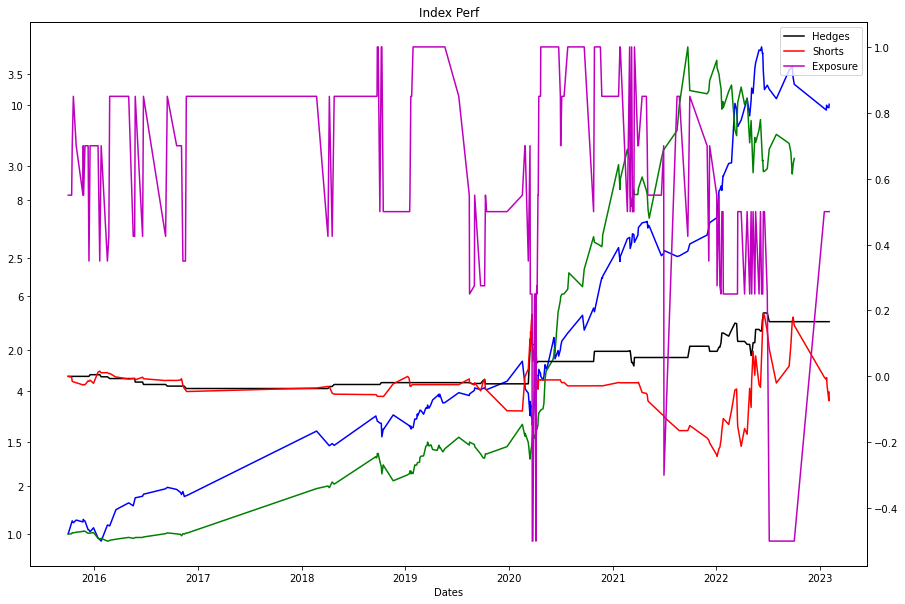

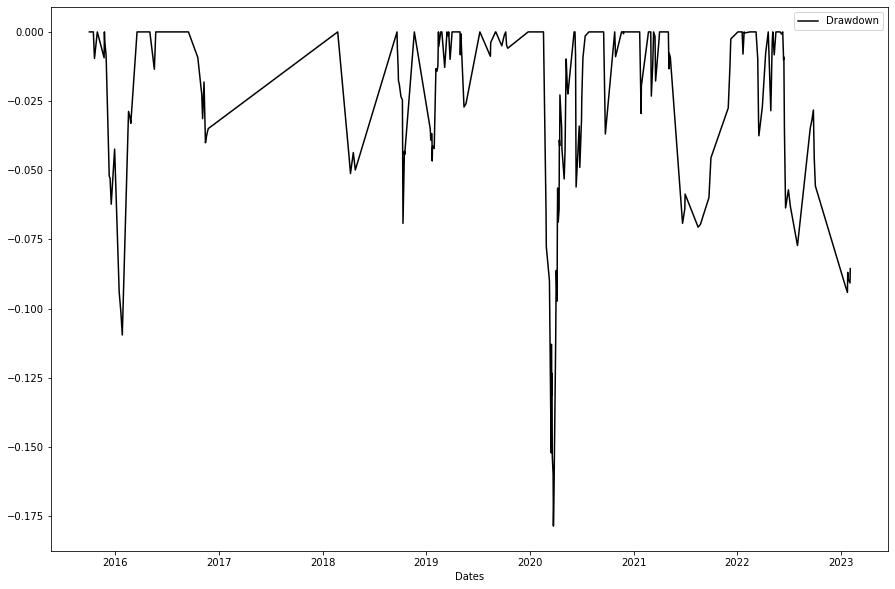

<Figure size 432x288 with 0 Axes>

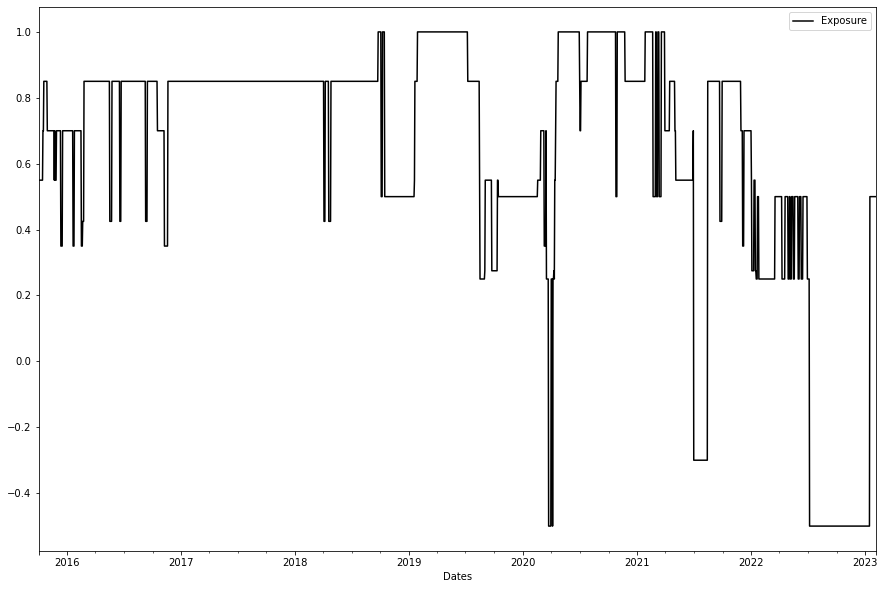

In [5]:
#SECTOR ALGO MVR BACKTESTING

%run C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\algo_pca.py

In [ ]:
#2021, 2K

query_parameters = 'SELECT * FROM gs_parameters'
RandomVectors_df = pd.read_sql_query(query_parameters, engine)
RandomVectors_df = Set_DF(RandomVectors_df)
RandomVectors_df = DD_Index(RandomVectors_df)

query_results = 'SELECT * FROM gs_results'
GS_Results_df = pd.read_sql_query(query_results, engine)
GS_Results_df = Set_DF(GS_Results_df)
GS_Results_df = DD_Index(GS_Results_df)

print(RandomVectors_df.loc[GS_Results_df.index[:show_size]][RandomVectors_df.columns[A: B]])
print('')
print(GS_Results_df[:show_size])

In [ ]:
#2020, 2K

query_parameters = 'SELECT * FROM gs_parameters'
RandomVectors_df = pd.read_sql_query(query_parameters, engine)
RandomVectors_df = Set_DF(RandomVectors_df)
RandomVectors_df = DD_Index(RandomVectors_df)

query_results = 'SELECT * FROM gs_results'
GS_Results_df = pd.read_sql_query(query_results, engine)
GS_Results_df = Set_DF(GS_Results_df)
GS_Results_df = DD_Index(GS_Results_df)

print(RandomVectors_df.loc[GS_Results_df.index[:show_size]])
print('')
print(GS_Results_df[:show_size])

In [ ]:
#2022, 1K

query_parameters = 'SELECT * FROM gs_parameters'
RandomVectors_df = pd.read_sql_query(query_parameters, engine)
RandomVectors_df = Set_DF(RandomVectors_df)
RandomVectors_df = DD_Index(RandomVectors_df)

query_results = 'SELECT * FROM gs_results'
GS_Results_df = pd.read_sql_query(query_results, engine)
GS_Results_df = Set_DF(GS_Results_df)
GS_Results_df = DD_Index(GS_Results_df)

print(RandomVectors_df.loc[GS_Results_df.index[:20]])
print('')
print(GS_Results_df[:20])

In [ ]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\pca_sectors_algo_fullbt.py

#FULL BACKTESTING

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
import warnings
import joblib
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.svm import SVR
from scipy.stats import norm

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def on_selection(value):
    global choice
    choice = value
    root.destroy()

def Sector_Allocations(forecast_df, d_list, s_list, window, up_on, up_off, down_on, down_off, rmse_mult, STD_w, STD_a):
    
    SectorPositions_df = pd.DataFrame(0, index = d_list, columns = s_list)
    
    for sector in s_list:
        window_str = sector + ' CORR' + str(window)
        sector_ret_str = sector + ' ' + str(lag_returns) + ' FWD Returns'
        sector_fwd_rets = forecast_df.T[forecast_df.columns.map(lambda x: x.find(sector_ret_str)) != -1].T.shift(lag_returns + 1)
        shifted_forecasts = forecast_df[window_str].shift(lag_returns + 1)
        
        std_series = forecast_df[window_str].clip(-20, 20).rolling(STD_w).std().replace({np.nan: 0}).rolling(STD_a).mean() * std_mult
        Ret_series_RAW = forecast_df[window_str]
        i = 0
        for current_date in d_list:
            
            Forecast_RAW = Ret_series_RAW.loc[current_date] 
            Forecast_STD = std_series.loc[current_date]
            Forecast_RMSE = 0
            if (RMSE_b):
                try:
                    Forecast_RMSE = np.sqrt(mean_squared_error(sector_fwd_rets[sector_fwd_rets.index < current_date][-10:], shifted_forecasts[shifted_forecasts.index < current_date][-10:]))
                except:
                    pass
            Forecast_RMSE = Forecast_RMSE / rmse_mult
            
            if (len(Ret_series_RAW[Ret_series_RAW.index < current_date].index) >= STD_w):
                Forecast_UP = Forecast_RAW - Forecast_STD - Forecast_RMSE
                Forecast_DOWN = Forecast_RAW + Forecast_STD + Forecast_RMSE
            else:
                Forecast_UP = 0
                Forecast_DOWN = 0
                
            if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                if (current_date in NewAlgo_SectorPositions_df.index):
                    SectorPositions_df.drop(current_date, inplace = True)
                    i = i - 1
            else:
                if (Forecast_UP >= up_on):
                    SectorPositions_df.loc[current_date, sector] = 1
                elif (Forecast_DOWN <= down_on):
                    SectorPositions_df.loc[current_date, sector] = -1
                else:
                    if (i > 0):
                        SectorPositions_df.loc[current_date, sector] = SectorPositions_df.iloc[i - 1][sector]
                    else:
                        SectorPositions_df.loc[current_date, sector] = 0
                if (i > 0):
                    if (SectorPositions_df.iloc[i - 1][sector] == 1):
                        if (Forecast_RAW <= up_off): 
                            SectorPositions_df.loc[current_date, sector] = 0
                    if (SectorPositions_df.iloc[i - 1][sector] == -1):
                        if (Forecast_RAW >= down_off): 
                            SectorPositions_df.loc[current_date, sector] = 0
                i = i + 1
    
    return SectorPositions_df

class Calibration:
    def Build_SectorPortfolios(NewSectorPositions_df, Current_Sector):

        clean_up = lambda x: re.sub(r'[^A-Z /^0-9]', '', str(x))
        clean_up_save = lambda x: re.sub(r'[^A-Z ^0-9]', '', str(x))
        to_int = lambda x: int(x)
        to_year = lambda x: str(x.split('QCY-')[1])
        to_quarter = lambda x: str(x.split('QCY-')[0])
        max_zero = lambda x: max(0, x)
        min_zero = lambda x: min(0, x)
        level1 = lambda x: int(x.split(',')[0][-1])
        level2 = lambda x: x.split(',')[1][2:-2]
        to_date = lambda x: datetime(int(x[:4]), int(x[4:6]), int(x[6:])).date()
        to_weekday = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index >= x][0]
        to_ED = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index.values.tolist().index(ED_series_compact[ED_series_compact < x].iloc[-1]) - 1]
        to_previous = lambda x: Stock_Summary_AUX_df.loc[x, metric]
        to_floor = lambda x: max(x, 1)
        to_sector = lambda x: Sectors_df.loc[x, 'Custom Sector 1']
        to_level1 = lambda x: x.split(',')[0][2:-1]
        to_level2 = lambda x: x.split(',')[1][2:-2]

        query_port = "SELECT * FROM port_db"
        Port_Select_DF = pd.read_sql_query(query_port, engine)
        Port_Select_DF = Set_DF(Port_Select_DF)
        Port_Select_DF = DD_Index(Port_Select_DF)
        Port_Select_DF = Port_Select_DF[::-1]
        Port_Select_DF.drop([Port_Select_DF.columns[0]], axis = 1, inplace = True)

        query_alloc = "SELECT * FROM alloc_db"
        Port_Alloc_DF = pd.read_sql_query(query_alloc, engine)
        Port_Alloc_DF = Set_DF(Port_Alloc_DF)
        Port_Alloc_DF = DD_Index(Port_Alloc_DF)
        Port_Alloc_DF = Port_Alloc_DF[::-1]
        Port_Alloc_DF.drop([Port_Alloc_DF.columns[0]], axis = 1, inplace = True)

        Start_Date = NewSectorPositions_df.index[0]
        initial_date = sectors_pxs_df.index[0]

        return_threshold = 5
        port_change_thresh = 0.35

        Sectors_ETF_list = ['Financials']
        over = 'O'
        ext = '_slim'

        sector_list = NewSectorPositions_df.columns.values.tolist()
        if ('SPX' in sector_list):
            sector_list.remove('SPX')
        if ('QQQ' in sector_list):
            sector_list.remove('QQQ')

        max_allocation = 25 / 100
        min_stocks = int(round(1 / max_allocation, 0))

        stock_list = Sectors_df[Sectors_df['Custom Sector 1'] == Current_Sector].index.values.tolist()
        
        date_series = NewSectorPositions_df[Current_Sector][NewSectorPositions_df[Current_Sector] == 1].index
        date_list = date_series.values.tolist()

        portfolio_str = re.sub(r'[^a-z_^0-9]', '', Current_Sector.lower()) + '_portfolio' + ext

        if (len(date_list) > 0):
            port_len = int(round(len(Sectors_df[Sectors_df['Custom Sector 1'] == Current_Sector].index) * 0.2, 0))
            div = 1
            if (Current_Sector in Sectors_ETF_list):
                div = 2
            relation_name = re.sub(r'[^a-z_^0-9]', '', Current_Sector.lower()) + '_portfolio' + ext
            Sector_Port_db = pd.DataFrame(np.nan, index = date_list, columns = (np.arange(port_len) + 1))

            if (len(Sector_Port_db.columns) < min_stocks):
                add_array = np.arange(min_stocks - len(Sector_Port_db.columns)) + Sector_Port_db.columns[-1] + 1
                for add in add_array:
                    Sector_Port_db[add] = np.nan

            valid_port_date = date_list[0]

            for idd, current_date in enumerate(date_list):

                if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                    pass
                else:
                    final_port_list = []
                    ETF_equiv = Equivalence_df.loc[current_date, Current_Sector]
                    date_range_forecast = sectors_pxs_df[sectors_pxs_df.index <= current_date].index.values.tolist()
                    Forecast_Summary_df = pd.DataFrame(np.nan, index = date_range_forecast, columns = ['Dummy'])

                    stocks_current_series = Port_Select_DF.loc[current_date]
                    stocks_selected_series = Port_Select_DF.loc[valid_port_date]

                    port_change_ratio = (len(pd.unique(stocks_current_series.tolist() + stocks_selected_series.tolist())) / len(stocks_current_series)) - 1
                    if (port_change_ratio >= port_change_thresh):
                        valid_port_date = current_date
                        stocks_selected_series = stocks_current_series

                    alloc_selected_series = Port_Alloc_DF.loc[valid_port_date].dropna()

                    stocks_selected_series = stocks_selected_series.loc[alloc_selected_series.index]
                    sector_selected_series = stocks_selected_series.map(to_sector)

                    sector_stocks = list(stocks_selected_series[sector_selected_series == Current_Sector])
                    port_a_len = len(sector_stocks)
                    final_port_list = sector_stocks[:port_len]

                    min_stocks_ = max(min_stocks, round_down(port_len / 4, 0))
                    if (len(final_port_list) < min_stocks_):
                        ETF_list = []
                        ETF_list.append(ETF_equiv)
                        ETF_list = ETF_list * (min_stocks_ - len(final_port_list))
                        final_port_list = final_port_list + ETF_list

                    if (len(final_port_list) == 0):
                        if (len(sector_stocks) > 0):
                            final_port_list = sorted(sector_stocks.copy())[::-1]
                        else:
                            final_port_list.append(ETF_equiv)
                        final_port_list = final_port_list + [''] * (port_len - len(final_port_list))

                    final_port_list_clean = pd.Series(final_port_list)[pd.Series(final_port_list) != ''].values.tolist()
                    final_len_clean = int(round_down(len(final_port_list_clean) / div, 0))
                    complement = len(final_port_list_clean) - final_len_clean

                    if (complement > 0):
                        final_port_list = final_port_list[:final_len_clean] + [ETF_equiv] * complement
                        final_port_list = final_port_list + [''] * (len(Sector_Port_db.columns) - len(final_port_list))

                    if (len(final_port_list) < port_len):
                        final_port_list = final_port_list + [''] * (port_len - len(final_port_list))

                    Sector_Port_db.loc[current_date] = final_port_list

            Sector_Port_db.dropna(how = 'all', inplace = True)
            Sector_Port_db.to_sql(relation_name, engine, index = True, if_exists = 'replace')

        return

    def Build_Indexes(NewSectorPositions_df, sector):

        clean_up = lambda x: re.sub(r'[^A-Z /^0-9]', '', str(x))
        clean_up_save = lambda x: re.sub(r'[^A-Z ^0-9]', '', str(x))
        to_int = lambda x: int(x)
        to_year = lambda x: str(x.split('QCY-')[1])
        to_quarter = lambda x: str(x.split('QCY-')[0])
        max_zero = lambda x: max(0, x)
        min_zero = lambda x: min(0, x)
        level1 = lambda x: int(x.split(',')[0][-1])
        level2 = lambda x: x.split(',')[1][2:-2]
        to_date = lambda x: datetime(int(x[:4]), int(x[4:6]), int(x[6:])).date()
        to_weekday = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index >= x][0]
        to_ED = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index.values.tolist().index(ED_series_compact[ED_series_compact < x].iloc[-1]) - 1]
        to_previous = lambda x: Stock_Summary_AUX_df.loc[x, metric]
        to_floor = lambda x: max(x, 1)
        to_sector = lambda x: Sectors_df.loc[x, 'Custom Sector 1']
        to_level1 = lambda x: x.split(',')[0][2:-1]
        to_level2 = lambda x: x.split(',')[1][2:-2]
        to_targets = lambda x: sector_targets.loc[x]
        to_previous_prices = lambda x: Prices_df.loc[prev_rebal_date, x]
        to_previous_prices_2 = lambda x: Prices_df.loc[curr_rebal_date, x]
        to_current_prices = lambda x: Prices_df.loc[current_date, x]
        to_level1 = lambda x: x.split(',')[0][2:-1]
        to_level2 = lambda x: int(x.split(',')[1][1:-1])
        to_region = lambda x: x[-2:]
        to_ccy = lambda x: FX_df.loc[x, 'Pair']

        companies_share = 1 / 10
        min_ps = 2
        global_cap = 30
        max_allocation = 25 / 100
#       nul_sector_list = ['Telecommunications']
        nul_sector_list = []

        query_fx = "SELECT * FROM fx_relation"
        FX_df = pd.read_sql_query(query_fx, engine)
        FX_df = Set_DF(FX_df)
        FX_df = DD_Index(FX_df)

        oride = True
        ext = '_slim'
        k = 0

        sector_relation = re.sub(r'[^a-z_^0-9]', '', sector.lower()) + '_portfolio' + ext
        equiv = Equivalence_df.iloc[-1][sector]
        new_sector = False

        if (sector_relation in new_tables_list) & (sector not in nul_sector_list):
            query_sp = 'SELECT * FROM ' + sector_relation   
            sector_port_df = pd.read_sql_query(query_sp, engine)
            sector_port_df = Set_DF(sector_port_df)
            sector_port_df = DD_Index(sector_port_df)
            if (type(sector_port_df.columns[0]) != str):
                sector_port_df.columns = sector_port_df.columns.astype(str)

            for sector_x in nul_sector_list:
                NewSectorPositions_df[sector_x] = float(0)

            sector_dates = NewSectorPositions_df[sector][NewSectorPositions_df[sector] == 1].index

            if (len(sector_dates) > 0):
                init_date = sector_dates[0]
                final_date = sector_dates[-1]
                date_spam = Prices_df.index[Prices_df.index >= init_date]
#               date_spam = date_spam[date_spam <= final_date]

                for current_date in sector_dates:
                    if (current_date not in sector_port_df.index):
                        sector_port_df.loc[current_date] = sector_port_df[sector_port_df.index > current_date].iloc[0]
                sector_port_df.sort_index(axis = 0, inplace = True)

                sector_targets = round(Sectors_df['Custom Sector 1'].dropna().value_counts() * companies_share, 0).astype(int)
                sector_targets = pd.Series(np.array(pd.DataFrame(sector_targets).T.columns.map(lambda x: max(int(1 / max_allocation), pd.DataFrame(sector_targets).T.iloc[0][x]))), index = sector_targets.index)
                sector_target = sector_targets[sector]

                sector_portfolio_df = pd.DataFrame(index = date_spam, columns = [['Stocks'] * sector_target, np.arange(sector_target)])
                sector_portfolio_df['Index'] = float(1)
                sector_portfolio_df['Date_BU'] = sector_portfolio_df.index
                new_sector = True

                sector_portfolio_df.sort_index(inplace = True)
                number_stocks01_df = pd.DataFrame(np.array(NewSectorPositions_df.replace({-1: 0})).dot(np.array(NewSectorPositions_df.columns.map(to_targets)).T).astype(int), index = NewSectorPositions_df.index, columns = ['Number of Stocks'])
                prev_list = []
                rebalancing_dates_list = []
                portfolio_string = re.sub(r'[^a-z_^0-9]', '', sector.lower()) + '_portfolio_selection' + ext

                for idx, current_date in enumerate(date_spam):
                    if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                        pass
                    else:
                        last_sr_date = sector_dates[sector_dates <= current_date][-1]
                        current_ns = number_stocks01_df.loc[last_sr_date][0]
                        base_number = int(NewSectorPositions_df.loc[last_sr_date].replace({-1: 0}).sum() * min_ps)
                        haircut = 0
                        if (current_ns > global_cap):
                            haircut = max(0, (current_ns - global_cap) / abs(current_ns - base_number))
                        hc_series = pd.Series((np.array(NewSectorPositions_df.loc[last_sr_date].replace({-1: 0})) * np.array(NewSectorPositions_df.columns.map(to_targets)) * haircut)).apply(round_down, 0)
                        final_ns_array = (np.array(NewSectorPositions_df.loc[last_sr_date].replace({-1: 0}) * np.array(NewSectorPositions_df.columns.map(to_targets))) - np.array(hc_series)).astype(int)
                        magic_number = final_ns_array[NewSectorPositions_df.columns.values.tolist().index(sector)]
                        current_list = sorted(sector_port_df.loc[last_sr_date][:magic_number].values.tolist() + [''] * (sector_target - len(sector_port_df.loc[last_sr_date][:magic_number].values.tolist())))[::-1]
                        sector_portfolio_df.loc[current_date, ['Stocks']] = current_list
                        sector_portfolio_df.loc[current_date, 'Index'] = float(1)
                        if (current_list != prev_list):
                            rebalancing_dates_list.append(current_date)
                        prev_list = current_list

                sector_portfolio_df.dropna(how = 'all', inplace = True)
                sector_portfolio_df.sort_index(inplace = True)

                date_spam_2 = sector_portfolio_df.index.values.tolist()
                if (not oride):
                    date_spam_2 = []
                    date_spam_2.append(today)
                    rebalancing_dates_list.append(sector_portfolio_df.index[-2])
                    rebalancing_dates_list = sorted(rebalancing_dates_list)

                for idx, current_date in enumerate(date_spam_2):
                    if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                        sector_portfolio_df.drop(current_date, inplace = True)
                    else:
                        current_prices = sector_portfolio_df.loc[current_date][sector_portfolio_df.loc[current_date] != '']['Stocks'].map(to_current_prices) / ('USD' + sector_portfolio_df.loc[current_date][sector_portfolio_df.loc[current_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_current_prices)
                        if (current_date == sector_portfolio_df.index[0]):
                            prev_k = 1
                            current_positions = prev_k / sector_portfolio_df.loc[current_date][sector_portfolio_df.loc[current_date] != '']['Stocks'].count() / current_prices
                        else:
                            prev_rebal_date = pd.Series(rebalancing_dates_list).values[pd.Series(rebalancing_dates_list).values < current_date][-1]
                            curr_rebal_date = pd.Series(rebalancing_dates_list).values[pd.Series(rebalancing_dates_list).values <= current_date][-1]
                            previous_prices = (sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].map(to_previous_prices) / ('USD' + sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_previous_prices)).values
                            previous_prices_2 = (sector_portfolio_df.loc[curr_rebal_date][sector_portfolio_df.loc[curr_rebal_date] != '']['Stocks'].map(to_previous_prices_2) / ('USD' + sector_portfolio_df.loc[curr_rebal_date][sector_portfolio_df.loc[curr_rebal_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_previous_prices_2)).values

                            previous_positions = (sector_portfolio_df.loc[prev_rebal_date, 'Index'][0] / sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].count() / previous_prices)
                            prev_k = (previous_positions * sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].map(to_previous_prices_2) / ('USD' + sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_previous_prices_2)).sum()
                            current_positions = (prev_k / sector_portfolio_df.loc[curr_rebal_date][sector_portfolio_df.loc[curr_rebal_date] != '']['Stocks'].count() / previous_prices_2) 
                        sector_portfolio_df.loc[current_date, 'Index'] = (current_positions * current_prices).sum()

                sector_portfolio_df['Date_BU'] = sector_portfolio_df.index
                sector_portfolio_df.sort_index(inplace = True)
                sector_portfolio_df.to_sql(portfolio_string, engine, index = True, if_exists = 'replace')
                print(sector)
                k = k + 1

        else:
            print(sector + ' Not Available')


        return

    def Simulation(Binary_df):

        to_date = lambda x: datetime(x.year, x.month, x.day)
        to_current = lambda x: sectors_pxs_rd_df.loc[current_date, x]
        to_previous = lambda x: sectors_pxs_rd_df.loc[prev_date, x] + sectors_correction_rd_df[prev_date: current_date].iloc[1:-1][x].sum()
        to_LLD = lambda x: sectors_pxs_rd_df.loc[last_long_date, x] + sectors_correction_rd_df[last_long_date: current_date].iloc[1:-1][x].sum()
        to_current_ss = lambda x: Equiv_Indexes_df.loc[current_date, x]
        to_previous_ss = lambda x: Equiv_Indexes_df.loc[prev_date, x]
        to_ETF = lambda x: Equivalence_df.loc[prev_date, x]
        to_ETF_LLD = lambda x: Equivalence_df.loc[last_long_date, x]
        to_ISN = lambda x: Equivalence_SN_df.loc[prev_date, x]
        to_ISN_LLD = lambda x: Equivalence_SN_df.loc[last_long_date, x]
        ETF_to_CurrPx = lambda x: Prices_df.loc[current_date, x]
        ETF_to_PrevPx = lambda x: Prices_df.loc[prev_date, x]
        ETF_to_LLDPx = lambda x: Prices_df.loc[last_long_date, x]
        to_level1 = lambda x: x.split(',')[0][2:-1]
        to_level2 = lambda x: int(x.split(',')[1][1:-1])

        ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
               'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']
#       Sectors_OUT_list = ['Telecommunications']
        Sectors_OUT_list = []
        Sectors_ETF_list = []

        hedge_ratio = 1 / 2
        init_short_ratio = 15 / 100
        limit_short = 50 / 100

        Start_Date = Binary_df.index[0]
        active_ss = True
        AdjSectorPositions_df = Binary_df.copy()
        today = AdjSectorPositions_df.index[-1]      
        yest = AdjSectorPositions_df.index[AdjSectorPositions_df.index.values.tolist().index(today) - 1]

        active_hedges = True
        etf_mapping = True    
        ist_mapping = True
        ext = '_slim'
        fr = True

        query_sector_pxs = 'SELECT * FROM sector_indexes'    
        sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
        sectors_pxs_df = Set_DF(sectors_pxs_df)
        sectors_pxs_df = DD_Index(sectors_pxs_df)

        sector_list = Binary_df.columns.values.tolist()
        if ('SPX' in sector_list):
            sector_list.remove('SPX')
        if ('QQQ' in sector_list):
            sector_list.remove('QQQ')

        query_S_hedge = "SELECT * FROM new_hedge_relation"    
        S_hedge_df = pd.read_sql_query(query_S_hedge, engine)
        S_hedge_df = Set_DF(S_hedge_df)
        S_hedge_df = DD_Index(S_hedge_df)
        S_hedge_df = abs(S_hedge_df)
        S_hedge_STR = S_hedge_df.columns[0]

        query_Q_hedge = "SELECT * FROM hedge_relation"    
        Q_hedge_df = pd.read_sql_query(query_Q_hedge, engine)
        Q_hedge_df = Set_DF(Q_hedge_df)
        Q_hedge_df = DD_Index(Q_hedge_df)
        Q_hedge_df = abs(Q_hedge_df)
        Q_hedge_STR = Q_hedge_df.columns[0]

        Hedges_df = Q_hedge_df.copy()
        hedge_STR = Q_hedge_STR
        Opt_H = 'Q'
        if (Opt_H == 'O'):
            Hedges_df[hedge_STR] = (Q_hedge_df[Q_hedge_STR] + S_hedge_df[S_hedge_STR]).clip(0, 1).replace({np.nan: 0})    
        elif (Opt_H == 'A'):
            Hedges_df[hedge_STR] = (Q_hedge_df[Q_hedge_STR] * S_hedge_df[S_hedge_STR]).replace({np.nan: 0})   
        elif (Opt_H == 'S'):
            Hedges_df = S_hedge_df.copy()
            hedge_STR = S_hedge_STR

        query_prices = 'SELECT * FROM prices_relation'    
        Prices_df = pd.read_sql_query(query_prices, engine)
        Prices_df = Set_DF(Prices_df)
        Prices_df = DD_Index(Prices_df)
        Prices_df.sort_index(inplace = True)

        query_sector_adj = 'SELECT * FROM sector_indexes_corrections'    
        sectors_correction_df = pd.read_sql_query(query_sector_adj, engine)
        sectors_correction_df = Set_DF(sectors_correction_df)
        sectors_correction_df = DD_Index(sectors_correction_df)

        query_equiv_idx = 'SELECT * FROM equivalent_indexes_relation'    
        Equiv_Indexes_df = pd.read_sql_query(query_equiv_idx, engine)
        Equiv_Indexes_df = Set_DF(Equiv_Indexes_df)
        Equiv_Indexes_df = DD_Index(Equiv_Indexes_df)

        rebalancing_series_lo = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({-1: 0}) == AdjSectorPositions_df.replace({-1: 0}).shift(1)).sum(axis = 1)
        rebalancing_series_lo.iloc[0] = 0
        rebalancing_series_lo.name = 'Rebalancings Long Only'
        rebalancing_dates_lo = rebalancing_series_lo[rebalancing_series_lo != 0].index.values.tolist()

        rebalancing_series_so = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({1: 0}) == AdjSectorPositions_df.replace({1: 0}).shift(1)).sum(axis = 1)
        rebalancing_series_so.iloc[0] = 0
        rebalancing_series_so.name = 'Rebalancings Short Only'
        rebalancing_dates_so = rebalancing_series_so[rebalancing_series_so != 0].index.values.tolist()

        rebalancing_series = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df == AdjSectorPositions_df.shift(1)).sum(axis = 1)
        rebalancing_series.iloc[0] = 0
        rebalancing_series.name = 'Rebalancings'
        rebalancing_dates = rebalancing_series[rebalancing_series != 0].index.values.tolist()

        if (yest not in rebalancing_dates):
            rebalancing_dates.append(yest)

        if (today not in rebalancing_dates):
            rebalancing_dates.append(today)

        if (active_hedges):    
            Hedged_positions = AdjSectorPositions_df.copy()
            Hedged_positions['Total Exp'] = Hedged_positions.replace({-1: 0}).sum(axis = 1).clip(0, 1) + (Hedged_positions.replace({1: 0}).sum(axis = 1) * init_short_ratio).map(lambda x: max(-limit_short, x))
            Hedged_positions = Hedged_positions.join(Hedges_df[hedge_STR])
            hedge_series_1 = Hedged_positions[Hedged_positions['Total Exp'] > 0][hedge_STR]
            hedge_series_2 = hedge_series_1.shift(1)
            rebalancing_dates = sorted(list(pd.unique(hedge_series_1[hedge_series_1 != hedge_series_2].index.values.tolist() + rebalancing_dates)))

        sectors_pxs_rd_df = sectors_pxs_df.loc[rebalancing_dates] / 1000
        sectors_correction_rd_df = sectors_correction_df[sectors_correction_df.index > rebalancing_dates[0]] / 1000

        rebal_pct = round(100 * len(rebalancing_dates) / len(rebalancing_series.index), 2)
        print('Rebalancing % time: ' + str(rebal_pct))
        k_df = pd.DataFrame(AdjSectorPositions_df.loc[rebalancing_dates].astype(float).values, index = pd.Index(rebalancing_dates, name = 'Dates'), columns = [['Sectors'] * len(AdjSectorPositions_df.columns), AdjSectorPositions_df.columns])
        k_df.columns.names = ['Level', 'Sectors']
        spx_series = k_df['Sectors'].join(Prices_df['SPX'])['SPX']

        if (len(Sectors_OUT_list) > 0):
            for sec in Sectors_OUT_list:
                if (sec in k_df['Sectors'].columns):
                    k_df['Sectors', sec] = float(0)

        k_df['Accounting', 'Cash'] = float(0)
        k_df['Accounting', 'Long'] = float(0)
        k_df['Accounting', 'Short Daily'] = float(0)
        k_df['Accounting', 'Short C'] = float(0)
        k_df['Accounting', 'Hedge Daily'] = float(0)
        k_df['Accounting', 'Hedge C'] = float(0)
        k_df['Accounting', 'Net'] = float(0)
        k_df['Exposure'] = float(0)
        k_df['Hedges'] = Hedges_df[hedge_STR]
        k_df.loc[k_df.index[0], ('Accounting', 'Long')] = k_df.iloc[0]['Sectors'].replace({-1: 0}).sum().clip(0, 1)
        k_df.loc[k_df.index[0], ('Accounting', 'Cash')] = 1 - k_df['Accounting', 'Long'][0]
        k_df.loc[k_df.index[0], ('Accounting', 'Net')] = 1

        Sector_Daily_Returns = (sectors_pxs_df / (sectors_pxs_df.shift(1) + sectors_correction_df.shift(1)) - 1).dropna(how = 'all')
        ETF_Daily_Returns = ((Prices_df[ETF_List] / Prices_df[ETF_List].shift(1)) - 1).loc[Sector_Daily_Returns.index]

        if (etf_mapping):
            query_eq = 'SELECT * FROM etf_equivalence_relation'    
            Equivalence_df = pd.read_sql_query(query_eq, engine)
            Equivalence_df = Set_DF(Equivalence_df)
            Equivalence_df = DD_Index(Equivalence_df)

        if (ist_mapping):
            print('')
            Equivalence_SN_df = Equivalence_df.copy()
            for current_sector in sector_list:
                current_sector_rel = re.sub(r'[^a-z_^0-9]', '', current_sector.lower()) + '_portfolio_selection' + ext
                if (current_sector_rel in new_tables_list):
                    query_index_port = 'SELECT * FROM ' + current_sector_rel  
                    Index_Port_df = pd.read_sql_query(query_index_port, engine)
                    Index_Port_df.index = pd.Index(Index_Port_df[Index_Port_df.columns[-1]], name = 'Date')
                    sector_index_series = Index_Port_df[Index_Port_df.columns[-2]]
                    Index_Port_df.drop(['Date', Index_Port_df.columns[-1], Index_Port_df.columns[-2]], axis = 1, inplace = True)
                    lev1_list = Index_Port_df.columns.map(to_level1).values.tolist()
                    lev2_list = Index_Port_df.columns.map(to_level2).values.tolist()
                    Index_Port_df.columns = [lev1_list, lev2_list]
                    Index_Port_df['Index'] = sector_index_series
                    Index_Port_df.sort_index(inplace = True)
                    index_series = Index_Port_df['Index']
                    index_series.name = current_sector + ' Index'
                    Prices_df = Prices_df.join(index_series)
                    Prices_df[current_sector + ' Index'].fillna(method = 'ffill')
                    Index_name = current_sector + ' Index'
                    Equivalence_SN_df[current_sector] = Index_name
                    print(current_sector + ' Single Name OK')

        total_k = 1
        prev_k = 1
        prev_k_long = 1
        prev_date = rebalancing_dates[0]
        last_long_date = rebalancing_dates[0]
        last_short_date = rebalancing_dates[0]

        for idx, current_date in enumerate(rebalancing_dates[1:]): 
            idx = idx + 1
            short_ratio = init_short_ratio
            Updated_Short_Series = np.zeros(len(k_df['Sectors'].columns))
            Updated_Long_Series = np.zeros(len(k_df['Sectors'].columns))
            if (fr):
                last_long_date = prev_date
            else:
                last_long_date = list(pd.Series(rebalancing_dates_lo)[pd.Series(rebalancing_dates_lo) < current_date])[-1]

            if (etf_mapping):
                Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_PrevPx)
                LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF_LLD).map(ETF_to_LLDPx)
                Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_CurrPx)
                Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous_ss)
                Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current_ss)
            else:
                Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_previous)
                LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_LLD)
                Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_current)
                Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous)
                Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current)

            if (ist_mapping):
                Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ISN).map(ETF_to_PrevPx)
                LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ISN_LLD).map(ETF_to_LLDPx)
                Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ISN).map(ETF_to_CurrPx)

            Previous_SPX_Px = spx_series[idx - 1]
            Current_SPX_Px = spx_series[idx]
            Previous_Long_Series = k_df.loc[last_long_date]['Sectors'].replace({-1: 0})
            Total_Longs_Previous = Previous_Long_Series.sum()
            Previous_Exposure = Total_Longs_Previous.clip(0, 1)

            if (prev_date not in rebalancing_dates_lo) & (not fr):
                Long_Adj_Series = Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)
                Total_Longs_Previous = (Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)).sum()
            else:
                Long_Adj_Series = Previous_Long_Series

            if (Total_Longs_Previous > 0):
                Updated_Long_Series = Long_Adj_Series * (Current_Pxs_Series_Long / Previous_Pxs_Series_Long) * (prev_k_long / Total_Longs_Previous)
                k_df.loc[current_date, ('Accounting', 'Long')] = Updated_Long_Series.sum()
                k_df.loc[current_date, ('Accounting', 'Cash')] = 0
            else:
                k_df.loc[current_date, ('Accounting', 'Cash')] = prev_k - k_df['Accounting', 'Short Daily'][idx - 1]

            if (active_ss):
                Previous_Short_Series = k_df.iloc[idx - 1]['Sectors'].replace({1: 0})
                if (abs(Previous_Short_Series.sum()) * short_ratio > limit_short):
                    short_ratio = limit_short / abs(Previous_Short_Series.sum())

                Total_Shorts_Previous = Previous_Short_Series.sum() * short_ratio
                Previous_Exposure = Total_Longs_Previous.clip(0, 1) + Total_Shorts_Previous

                Base_Short_Series =  Previous_Short_Series * prev_k * short_ratio
                Updated_Short_Series = Base_Short_Series * (Current_Pxs_Series_Short / Previous_Pxs_Series_Short)
                Current_Short_Results = Updated_Short_Series - Base_Short_Series

                k_df.loc[current_date, ('Accounting', 'Short Daily')] = Current_Short_Results.sum()
                k_df.loc[current_date, ('Accounting', 'Short C')] = k_df['Accounting', 'Short C'][idx - 1] + k_df['Accounting', 'Short Daily'][idx]

            if (active_hedges):
                Previous_Hedge = 0
                if (k_df['Hedges'][idx - 1] == 1) & (Previous_Exposure > 0):
                    Previous_Hedge = - Previous_Exposure * prev_k * hedge_ratio
                    Previous_Exposure = Previous_Exposure * (1 - hedge_ratio)

                Updated_Hedge = Previous_Hedge * (Current_SPX_Px / Previous_SPX_Px)
                Current_Hedge_Results = Updated_Hedge - Previous_Hedge

                k_df.loc[current_date, ('Accounting', 'Hedge Daily')] = Current_Hedge_Results
                k_df.loc[current_date, ('Accounting', 'Hedge C')] = k_df['Accounting', 'Hedge C'][idx - 1] + k_df['Accounting', 'Hedge Daily'][idx]

            total_k = k_df['Accounting', 'Cash'][idx] + k_df['Accounting', 'Long'][idx] + k_df['Accounting', 'Short Daily'][idx] + k_df['Accounting', 'Hedge Daily'][idx]
            if (not fr) & (prev_k_long != prev_k):
                total_k = total_k + (k_df['Accounting', 'Short C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Short C')]) + (k_df['Accounting', 'Hedge C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Hedge C')]) - k_df['Accounting', 'Hedge Daily'][idx] - k_df['Accounting', 'Short Daily'][idx]
            k_df.loc[current_date, ('Accounting', 'Net')] = total_k
            k_df.loc[k_df.index[idx - 1], 'Exposure'] = Previous_Exposure 
            prev_k = total_k
            prev_k_long = prev_k
            prev_date = current_date

        ttl_perf = round(100 * (k_df['Accounting', 'Net'][-1] / k_df['Accounting', 'Net'][0] - 1), 2)
        dd_series = (k_df['Accounting', 'Net'] / k_df['Accounting', 'Net'].expanding().max() - 1)
        max_dd = round(100 * dd_series.min(), 2)
        cagr = round(100 * ((1 + ttl_perf / 100) ** (365 / (k_df.index[-1] - k_df.index[0]).days) - 1), 2)
        Acct_df = pd.DataFrame(k_df['Accounting'])
        Acct_df.index = Acct_df.T.columns.map(lambda x: datetime(x.year, x.month, x.day))
        Resampled_df = Acct_df.resample('M').last()
        Resampled_df.fillna(method = 'ffill', inplace = True)
        yearly_vol = round(100 * (Resampled_df['Net'] / Resampled_df['Net'].shift(1) - 1).std() * np.sqrt(12), 2)
        sharpe = round(cagr / yearly_vol, 2)
        cagr_dd = round(abs(cagr / max_dd), 2)

        return ttl_perf, max_dd, cagr, yearly_vol, sharpe, cagr_dd, rebal_pct
    
warnings.simplefilter('error')    

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].tolist()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = pd.DataFrame(tables_list, columns=['Old'])['Old'].tolist()

ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
       'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']

to_round = lambda x: round(x, 2)
to_find_ST = lambda x: x.find(corr_ST_str)
to_find_MT = lambda x: x.find(corr_MT_str)
to_year = lambda x: int(100 * int(int(str(x.year)[-2:])) + int(x.month))
sector_dict = {'SPX': 'SPX', 'QQQ': 'QQQ US'}

query_parameters = 'SELECT * FROM gs_parameters'
RandomVectors_df = pd.read_sql_query(query_parameters, engine)
RandomVectors_df = Set_DF(RandomVectors_df)
RandomVectors_df = DD_Index(RandomVectors_df)

query_results = 'SELECT * FROM gs_results'
GS_Results_df = pd.read_sql_query(query_results, engine)
GS_Results_df = Set_DF(GS_Results_df)
GS_Results_df = DD_Index(GS_Results_df)

ext = ''
opt = input('(O)ld or (N)ew? ').upper()
if (opt == 'N'):
    ext = '_new'
    
sectors = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Custom_Segmentation.csv")
Sectors_df = pd.DataFrame(sectors)
Sectors_df = Set_DF(Sectors_df)
Sectors_df = DD_Index(Sectors_df)

query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

query_lr = 'SELECT * FROM lr_forecasts_relation' + ext 
LR_Forecasts_df = pd.read_sql_query(query_lr, engine)
LR_Forecasts_df = Set_DF(LR_Forecasts_df)
LR_Forecasts_df = DD_Index(LR_Forecasts_df)

query_rf = 'SELECT * FROM rf_forecasts_relation' + ext   
RF_Forecasts_df = pd.read_sql_query(query_rf, engine)
RF_Forecasts_df = Set_DF(RF_Forecasts_df)
RF_Forecasts_df = DD_Index(RF_Forecasts_df)

query_svr = 'SELECT * FROM svr_forecasts_relation' + ext   
SVR_Forecasts_df = pd.read_sql_query(query_svr, engine)
SVR_Forecasts_df = Set_DF(SVR_Forecasts_df)
SVR_Forecasts_df = DD_Index(SVR_Forecasts_df)

query_en = 'SELECT * FROM en_forecasts_relation' + ext  
EN_Forecasts_df = pd.read_sql_query(query_en, engine)
EN_Forecasts_df = Set_DF(EN_Forecasts_df)
EN_Forecasts_df = DD_Index(EN_Forecasts_df)

rs_b = False
if (rs_b):
    LR_Forecasts_df = LR_Forecasts_df.ewm(halflife = ewm_factor).mean()
    EN_Forecasts_df = EN_Forecasts_df.ewm(halflife = ewm_factor).mean()

today = RF_Forecasts_df.index[0]
date_range = EN_Forecasts_df.index

Start_Date = input("Enter Start Date: (YY/MM/DD)")
if (Start_Date == ''):
    Start_Date = date_range[0]
else:
    Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()
    if (Start_Date < date_range[0]):
        Start_Date = date_range[0]
    
date_range = date_range[date_range >= Start_Date]

RMSE_b = False
RMSE_s = input('RMSE adjustment (Y/N)? ').upper()
if (RMSE_s == 'Y'):
    RMSE_b = True

opt_cv = input('Tail test (Y/N)? ').upper()
if (opt_cv == 'Y'):
    cut_year = input('Last Date (YYMM): ')
    if (cut_year != ''):
        co_year = 100 * int(cut_year[:2]) + int(cut_year[-2:])
    else:
        co_year = 100 * int(EN_Forecasts_df.index[-1].year) + int(EN_Forecasts_df.index[-1].month)
else:
    co_year = 100 * int(EN_Forecasts_df.index[-1].year) + int(EN_Forecasts_df.index[-1].month)
date_range = date_range[(pd.Series(date_range).map(to_year) <= co_year)]
       
choice_list = GS_Results_df.columns.values.tolist()
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a Criteria: ").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()

print(choice)

GS_Results_df.sort_values(by = choice, ascending = False, inplace = True)
RandomVectors_df = RandomVectors_df.loc[GS_Results_df.index]

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)
sectors_pxs_df = sectors_pxs_df.join(Prices_df['QQQ US'])
sectors_pxs_df = sectors_pxs_df.join(Prices_df['SPX'])
sectors_pxs_df.rename(columns = {'QQQ US': 'QQQ'}, inplace = True)

sector_list = sectors_pxs_df.columns.values.tolist()

lag_returns = 10
correlation_window_ST = 84
correlation_window_MT = 168

nr_simulations = int(input('Enter # of simulations: '))
RandomVectors_Slice_df = RandomVectors_df.iloc[:nr_simulations].copy()
RandomVectors_Slice_df.loc['Median'] = RandomVectors_df[:nr_simulations].median()
RandomVectors_Slice_df.loc['Mean'] = RandomVectors_df[:nr_simulations].mean()
GS_Full_Results_df = pd.DataFrame(np.nan, index = np.arange(nr_simulations), columns = GS_Results_df.columns)

RandomVectors_Slice_matrix = np.array(RandomVectors_Slice_df)
for idx_, element in enumerate(RandomVectors_Slice_matrix):

#   element = (0.95, 5.5, -4.75, 4.0, -2.0, 0.1, 1.5, 0.5, 1.0, 0.5, 3.25, 15.0, -6.5, 2.0, -8.5, 2.5, 42, 5)    
    print('')
    print(str(idx_))
    print(element)
    print('')

    RandomVectors_df.iloc[idx_] = element
    conf_interval = element[0]
    std_mult = norm.ppf(conf_interval)    

    threshold_up_ST_ON = element[1] 
    threshold_up_ST_OFF = element[2] 
    threshold_up_MT_ON = element[3] 
    threshold_up_MT_OFF = element[4] 
    threshold_down_ST_ON = element[12]
    threshold_down_ST_OFF = element[13]
    threshold_down_MT_ON = element[14]
    threshold_down_MT_OFF = element[15]

    lr_st_mult = element[5]
    rf_st_mult = element[6] 
    svr_st_mult = 0.00
    en_st_mult = element[7]
    ttl_st_mult = lr_st_mult + rf_st_mult + svr_st_mult + en_st_mult
    lr_mt_mult = element[8] 
    rf_mt_mult = element[9] 
    svr_mt_mult = 0.00
    en_mt_mult = element[10] 
    ttl_mt_mult = lr_mt_mult + rf_mt_mult + svr_mt_mult + en_mt_mult

    Selected_ST_df = (LR_Forecasts_df * lr_st_mult + RF_Forecasts_df * rf_st_mult + SVR_Forecasts_df * svr_st_mult + EN_Forecasts_df * en_st_mult) / ttl_st_mult
    Selected_MT_df = (LR_Forecasts_df * lr_mt_mult + RF_Forecasts_df * rf_mt_mult + SVR_Forecasts_df * svr_mt_mult + EN_Forecasts_df * en_mt_mult) / ttl_mt_mult

    Selected_ST_df = Selected_ST_df[Selected_ST_df.index <= date_range[-1]]
    Selected_MT_df = Selected_MT_df[Selected_MT_df.index <= date_range[-1]]

    NewAlgo_ST_SectorPositions_df = Sector_Allocations(Selected_ST_df, date_range, sector_list, correlation_window_ST, threshold_up_ST_ON, threshold_up_ST_OFF, threshold_down_ST_ON, threshold_down_ST_OFF, element[11], int(element[16]), int(element[17]))
    NewAlgo_MT_SectorPositions_df = Sector_Allocations(Selected_MT_df, date_range, sector_list, correlation_window_MT, threshold_up_MT_ON, threshold_up_MT_OFF, threshold_down_MT_ON, threshold_down_MT_OFF, element[11], int(element[16]), int(element[17]))
    NewAlgo_Final_SectorPositions_df = (NewAlgo_ST_SectorPositions_df + NewAlgo_MT_SectorPositions_df).clip(-1, 1)
    NewAlgo_Final_SectorPositions_df.sort_index(inplace = True)
    
    if ('QQQ' in NewAlgo_Final_SectorPositions_df.columns):
        NewAlgo_Final_SectorPositions_df.drop(['QQQ'], axis = 1, inplace = True)
    if ('SPX' in NewAlgo_Final_SectorPositions_df.columns):
        NewAlgo_Final_SectorPositions_df.drop(['SPX'], axis = 1, inplace = True)
    
    sector_list = NewAlgo_Final_SectorPositions_df.replace({-1: 0}).sum()[NewAlgo_Final_SectorPositions_df.replace({-1: 0}).sum() != 0].index.values.tolist()
    for sector in sector_list:
        Calibration.Build_SectorPortfolios(NewAlgo_Final_SectorPositions_df, sector)        
        Calibration.Build_Indexes(NewAlgo_Final_SectorPositions_df, sector)
        
    sim_results = Calibration.Simulation(NewAlgo_Final_SectorPositions_df)

    print('')
    print('Total Return: ' + str(sim_results[0]))
    print('Max DD: ' + str(sim_results[1]))
    print('CAGR: ' + str(sim_results[2]))
    print('Yearly Vol: ' + str(sim_results[3]))
    print('Sharpe Ratio: ' + str(sim_results[4]))
    print('CAGR/DD Ratio: ' + str(sim_results[5]))
    print('')
    GS_Full_Results_df.loc[idx_, 'Total Return'] = sim_results[0]
    GS_Full_Results_df.loc[idx_, 'Max DD'] = sim_results[1]
    GS_Full_Results_df.loc[idx_, 'CAGR'] = sim_results[2]
    GS_Full_Results_df.loc[idx_, 'Yearly Vol'] = sim_results[3]
    GS_Full_Results_df.loc[idx_, 'Sharpe'] = sim_results[4]
    GS_Full_Results_df.loc[idx_, 'CAGR/DD'] = sim_results[5]
    GS_Full_Results_df.loc[idx_, 'Rebalancing (%)'] = sim_results[6]
    GS_Full_Results_df.loc[idx_, 'Adj CAGR'] = sim_results[2] * sim_results[4]

    GS_Full_Results_df.sort_values(by = ['CAGR'], ascending = False, inplace = True)
    print(GS_Full_Results_df[:5])


save_gs = ''
save_gs = input('Save Results (Y/N)? ').upper()
GS_Full_Results_df.sort_values(by = ['Adj CAGR'], ascending = False, inplace = True)
RandomVectors_df = RandomVectors_df.loc[GS_Results_df.index]
if (save_gs == 'Y'):
    GS_Full_Results_df.to_sql('gs_full_results', engine, index = True, if_exists = 'replace')
    
GS_Full_Results_df

(O)ld or (N)ew? N
Old Hedge Total: -117.89
Old Hedge Freq: 13.12
Tail test (Y/N)? N
RMSE adjustment (Y/N)? N
Grid Search (Y/N)? N
Select from file (Y/N)? N
0
(0.95, 10.0, -3.0, 1.0, -4.0, 2.0, 42.0, 5.0, 1.0, 4.0, 1.5, 0.5, 1.0, 5.0, 'Or')

QQQ Efficiency SUM DOWN: 17.73
SPX Efficiency SUM DOWN: 8.92
Rebalancing % time: 12.52

Hedge Frequency: 26.76
Total Return Hedge: -16.7
Max DD: -21.35
CAGR: 17.06
Yearly Vol: 12.88
Sharpe Ratio: 1.32
CAGR/DD Ratio: 0.8



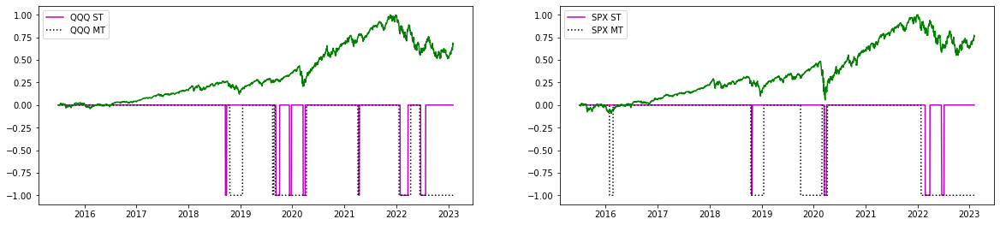

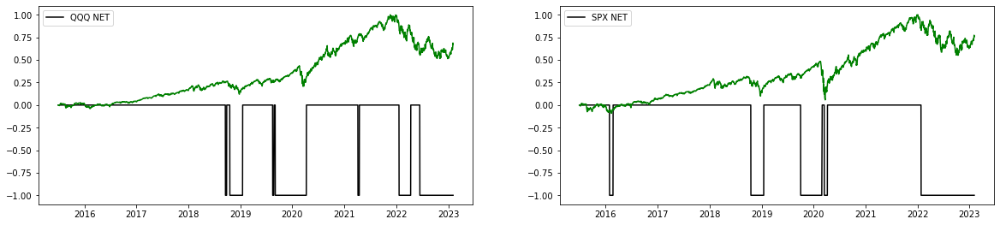

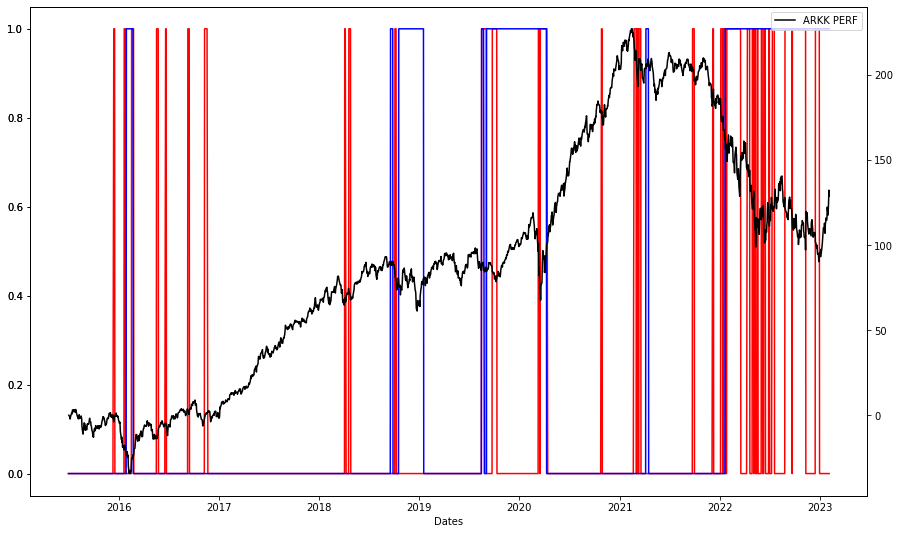

In [4]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\pca_hedges_algo_bm.py

#BINARY MATRIX GENERATOR - HEDGES

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
import warnings
import joblib
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.svm import SVR
from scipy.stats import norm

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].tolist()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = pd.DataFrame(tables_list, columns=['Old'])['Old'].tolist()


def Sector_Allocations(forecast_df, d_list, s_list, window, down_on, down_off, rmse_mult, STD_w, STD_a):
    
    SectorPositions_df = pd.DataFrame(0, index = d_list, columns = s_list)
    
    for sector in s_list:
        window_str = sector + ' CORR' + str(window)
        sector_ret_str = sector + ' ' + str(lag_returns) + ' FWD Returns'
        sector_fwd_rets = forecast_df.T[forecast_df.columns.map(lambda x: x.find(sector_ret_str)) != -1].T.shift(lag_returns + 1)
        shifted_forecasts = forecast_df[window_str].shift(lag_returns + 1)
        
        std_series = forecast_df[window_str].clip(-20, 20).rolling(STD_w).std().replace({np.nan: 0}).rolling(STD_a).mean() * std_mult
        Ret_series_RAW = forecast_df[window_str]
        i = 0
        for current_date in d_list:
            
            Forecast_RAW = Ret_series_RAW.loc[current_date] 
            Forecast_STD = std_series.loc[current_date]
            Forecast_RMSE = 0
            if (RMSE_b):
                try:
                    Forecast_RMSE = np.sqrt(mean_squared_error(sector_fwd_rets[sector_fwd_rets.index < current_date][-10:], shifted_forecasts[shifted_forecasts.index < current_date][-10:]))
                except:
                    pass
            Forecast_RMSE = Forecast_RMSE / rmse_mult
            
            if (len(Ret_series_RAW[Ret_series_RAW.index < current_date].index) >= STD_w):
                Forecast_DOWN = Forecast_RAW + Forecast_STD + Forecast_RMSE
            else:
                Forecast_DOWN = 0
                
            if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                if (current_date in SectorPositions_df.index):
                    SectorPositions_df.drop(current_date, inplace = True)
                    i = i - 1
            else:
                if (Forecast_DOWN <= down_on):
                    SectorPositions_df.loc[current_date, sector] = -1
                else:
                    if (i > 0):
                        SectorPositions_df.loc[current_date, sector] = SectorPositions_df.iloc[i - 1][sector]
                    else:
                        SectorPositions_df.loc[current_date, sector] = 0
                if (i > 0):
                    if (SectorPositions_df.iloc[i - 1][sector] == -1):
                        if (Forecast_RAW >= down_off): 
                            SectorPositions_df.loc[current_date, sector] = 0
                i = i + 1
    
    return SectorPositions_df

def Simulation(Hedges_df):
    
    to_date = lambda x: datetime(x.year, x.month, x.day)
    to_current = lambda x: sectors_pxs_rd_df.loc[current_date, x]
    to_previous = lambda x: sectors_pxs_rd_df.loc[prev_date, x] + sectors_correction_rd_df[prev_date: current_date].iloc[1:-1][x].sum()
    to_LLD = lambda x: sectors_pxs_rd_df.loc[last_long_date, x] + sectors_correction_rd_df[last_long_date: current_date].iloc[1:-1][x].sum()
    to_current_ss = lambda x: Equiv_Indexes_df.loc[current_date, x]
    to_previous_ss = lambda x: Equiv_Indexes_df.loc[prev_date, x]
    to_ETF = lambda x: Equivalence_df.loc[prev_date, x]
    to_ETF_LLD = lambda x: Equivalence_df.loc[last_long_date, x]
    to_ISN = lambda x: Equivalence_SN_df.loc[prev_date, x]
    to_ISN_LLD = lambda x: Equivalence_SN_df.loc[last_long_date, x]
    ETF_to_CurrPx = lambda x: Prices_df.loc[current_date, x]
    ETF_to_PrevPx = lambda x: Prices_df.loc[prev_date, x]
    ETF_to_LLDPx = lambda x: Prices_df.loc[last_long_date, x]
    to_level1 = lambda x: x.split(',')[0][2:-1]
    to_level2 = lambda x: int(x.split(',')[1][1:-1])

    ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
           'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']
#   Sectors_OUT_list = ['Telecommunications']
    Sectors_OUT_list = []
    Sectors_ETF_list = []
    
    hedge_ratio = 1 / 2
    init_short_ratio = 15 / 100
    limit_short = 50 / 100

    Start_Date = NewAlgo_Final_SectorPositions_df.index[0]
    active_ss = True
    AdjSectorPositions_df = NewAlgo_Final_SectorPositions_df.copy()
    today = AdjSectorPositions_df.index[-1]      
    yest = AdjSectorPositions_df.index[AdjSectorPositions_df.index.values.tolist().index(today) - 1]

    active_hedges = True
    etf_mapping = True    
    ist_mapping = False
    ext = '_slim'
    fr = True

    query_sector_pxs = 'SELECT * FROM sector_indexes'    
    sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
    sectors_pxs_df = Set_DF(sectors_pxs_df)
    sectors_pxs_df = DD_Index(sectors_pxs_df)
    
    query_hedges = 'SELECT * FROM hedge_relation'    
    cHedges_df = pd.read_sql_query(query_hedges, engine)
    cHedges_df = Set_DF(cHedges_df)
    cHedges_df = DD_Index(cHedges_df)
    
#   Hedges_df = cHedges_df.copy()
    Hedges_df = abs(Hedges_df)

    sector_list = NewAlgo_Final_SectorPositions_df.columns.values.tolist()
    if ('SPX' in sector_list):
        sector_list.remove('SPX')
    if ('QQQ' in sector_list):
        sector_list.remove('QQQ')

    hedge_STR = Hedges_df.columns[0]

    query_sector_adj = 'SELECT * FROM sector_indexes_corrections'    
    sectors_correction_df = pd.read_sql_query(query_sector_adj, engine)
    sectors_correction_df = Set_DF(sectors_correction_df)
    sectors_correction_df = DD_Index(sectors_correction_df)

    query_equiv_idx = 'SELECT * FROM equivalent_indexes_relation'    
    Equiv_Indexes_df = pd.read_sql_query(query_equiv_idx, engine)
    Equiv_Indexes_df = Set_DF(Equiv_Indexes_df)
    Equiv_Indexes_df = DD_Index(Equiv_Indexes_df)

    rebalancing_series_lo = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({-1: 0}) == AdjSectorPositions_df.replace({-1: 0}).shift(1)).sum(axis = 1)
    rebalancing_series_lo.iloc[0] = 0
    rebalancing_series_lo.name = 'Rebalancings Long Only'
    rebalancing_dates_lo = rebalancing_series_lo[rebalancing_series_lo != 0].index.values.tolist()

    rebalancing_series_so = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({1: 0}) == AdjSectorPositions_df.replace({1: 0}).shift(1)).sum(axis = 1)
    rebalancing_series_so.iloc[0] = 0
    rebalancing_series_so.name = 'Rebalancings Short Only'
    rebalancing_dates_so = rebalancing_series_so[rebalancing_series_so != 0].index.values.tolist()

    rebalancing_series = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df == AdjSectorPositions_df.shift(1)).sum(axis = 1)
    rebalancing_series.iloc[0] = 0
    rebalancing_series.name = 'Rebalancings'
    rebalancing_dates = rebalancing_series[rebalancing_series != 0].index.values.tolist()

    if (yest not in rebalancing_dates):
        rebalancing_dates.append(yest)

    if (today not in rebalancing_dates):
        rebalancing_dates.append(today)

    if (active_hedges):    
        Hedged_positions = AdjSectorPositions_df.copy()
        Hedged_positions['Total Exp'] = Hedged_positions.replace({-1: 0}).sum(axis = 1).clip(0, 1) + (Hedged_positions.replace({1: 0}).sum(axis = 1) * init_short_ratio).map(lambda x: max(-limit_short, x))
        Hedged_positions = Hedged_positions.join(Hedges_df[hedge_STR])
        hedge_series_1 = Hedged_positions[Hedged_positions['Total Exp'] > 0][hedge_STR]
        hedge_series_2 = hedge_series_1.shift(1)
        rebalancing_dates = sorted((pd.unique(hedge_series_1[hedge_series_1 != hedge_series_2].index.values.tolist() + rebalancing_dates)).tolist())

    sectors_pxs_rd_df = sectors_pxs_df.loc[rebalancing_dates] / 1000
    sectors_correction_rd_df = sectors_correction_df[sectors_correction_df.index > rebalancing_dates[0]] / 1000

    rebal_pct = round(100 * len(rebalancing_dates) / len(rebalancing_series.index), 2)
    print('Rebalancing % time: ' + str(rebal_pct))
    k_df = pd.DataFrame(AdjSectorPositions_df.loc[rebalancing_dates].astype(float).values, index = pd.Index(rebalancing_dates, name = 'Dates'), columns = [['Sectors'] * len(AdjSectorPositions_df.columns), AdjSectorPositions_df.columns])
    k_df.columns.names = ['Level', 'Sectors']
    spx_series = k_df['Sectors'].join(Prices_df['SPX'])['SPX']

    if (len(Sectors_OUT_list) > 0):
        for sec in Sectors_OUT_list:
            if (sec in k_df['Sectors'].columns):
                k_df['Sectors', sec] = float(0)

    k_df['Accounting', 'Cash'] = float(0)
    k_df['Accounting', 'Long'] = float(0)
    k_df['Accounting', 'Short Daily'] = float(0)
    k_df['Accounting', 'Short C'] = float(0)
    k_df['Accounting', 'Hedge Daily'] = float(0)
    k_df['Accounting', 'Hedge C'] = float(0)
    k_df['Accounting', 'Net'] = float(0)
    k_df['Exposure'] = float(0)
    k_df['Hedges'] = Hedges_df[hedge_STR]
    k_df.loc[k_df.index[0], ('Accounting', 'Long')] = k_df.iloc[0]['Sectors'].replace({-1: 0}).sum().clip(0, 1)
    k_df.loc[k_df.index[0], ('Accounting', 'Cash')] = 1 - k_df['Accounting', 'Long'][0]
    k_df.loc[k_df.index[0], ('Accounting', 'Net')] = 1

    Sector_Daily_Returns = (sectors_pxs_df / (sectors_pxs_df.shift(1) + sectors_correction_df.shift(1)) - 1).dropna(how = 'all')
    ETF_Daily_Returns = ((Prices_df[ETF_List] / Prices_df[ETF_List].shift(1)) - 1).loc[Sector_Daily_Returns.index]

    if (etf_mapping):
        query_eq = 'SELECT * FROM etf_equivalence_relation'    
        Equivalence_df = pd.read_sql_query(query_eq, engine)
        Equivalence_df = Set_DF(Equivalence_df)
        Equivalence_df = DD_Index(Equivalence_df)

    total_k = 1
    prev_k = 1
    prev_k_long = 1
    prev_date = rebalancing_dates[0]
    last_long_date = rebalancing_dates[0]
    last_short_date = rebalancing_dates[0]

    for idx, current_date in enumerate(rebalancing_dates[1:]): 
        idx = idx + 1
        short_ratio = init_short_ratio
        Updated_Short_Series = np.zeros(len(k_df['Sectors'].columns))
        Updated_Long_Series = np.zeros(len(k_df['Sectors'].columns))
        if (fr):
            last_long_date = prev_date
        else:
            last_long_date = list(pd.Series(rebalancing_dates_lo)[pd.Series(rebalancing_dates_lo) < current_date])[-1]


        if (etf_mapping):
            Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_PrevPx)
            LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF_LLD).map(ETF_to_LLDPx)
            Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_CurrPx)
            Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous_ss)
            Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current_ss)
        else:
            Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_previous)
            LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_LLD)
            Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_current)
            Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous)
            Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current)

        Previous_SPX_Px = spx_series[idx - 1]
        Current_SPX_Px = spx_series[idx]

        Previous_Long_Series = k_df.loc[last_long_date]['Sectors'].replace({-1: 0})
        Total_Longs_Previous = Previous_Long_Series.sum()
        Previous_Exposure = Total_Longs_Previous.clip(0, 1)

        if (prev_date not in rebalancing_dates_lo) & (not fr):
            Long_Adj_Series = Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)
            Total_Longs_Previous = (Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)).sum()
        else:
            Long_Adj_Series = Previous_Long_Series

        if (Total_Longs_Previous > 0):
            Updated_Long_Series = Long_Adj_Series * (Current_Pxs_Series_Long / Previous_Pxs_Series_Long) * (prev_k_long / Total_Longs_Previous)
            k_df.loc[current_date, ('Accounting', 'Long')] = Updated_Long_Series.sum()
            k_df.loc[current_date, ('Accounting', 'Cash')] = 0
        else:
            k_df.loc[current_date, ('Accounting', 'Cash')] = prev_k - k_df['Accounting', 'Short Daily'][idx - 1]

        if (active_ss):
            Previous_Short_Series = k_df.iloc[idx - 1]['Sectors'].replace({1: 0})
            if (abs(Previous_Short_Series.sum()) * short_ratio > limit_short):
                short_ratio = limit_short / abs(Previous_Short_Series.sum())

            Total_Shorts_Previous = Previous_Short_Series.sum() * short_ratio
            Previous_Exposure = Total_Longs_Previous.clip(0, 1) + Total_Shorts_Previous

            Base_Short_Series =  Previous_Short_Series * prev_k * short_ratio
            Updated_Short_Series = Base_Short_Series * (Current_Pxs_Series_Short / Previous_Pxs_Series_Short)
            Current_Short_Results = Updated_Short_Series - Base_Short_Series

            k_df.loc[current_date, ('Accounting', 'Short Daily')] = Current_Short_Results.sum()
            k_df.loc[current_date, ('Accounting', 'Short C')] = k_df['Accounting', 'Short C'][idx - 1] + k_df['Accounting', 'Short Daily'][idx]

        if (active_hedges):
            Previous_Hedge = 0
            if (k_df['Hedges'][idx - 1] == 1) & (Previous_Exposure > 0):
                Previous_Hedge = - Previous_Exposure * prev_k * hedge_ratio
                Previous_Exposure = Previous_Exposure * (1 - hedge_ratio)

            Updated_Hedge = Previous_Hedge * (Current_SPX_Px / Previous_SPX_Px)
            Current_Hedge_Results = Updated_Hedge - Previous_Hedge

            k_df.loc[current_date, ('Accounting', 'Hedge Daily')] = Current_Hedge_Results
            k_df.loc[current_date, ('Accounting', 'Hedge C')] = k_df['Accounting', 'Hedge C'][idx - 1] + k_df['Accounting', 'Hedge Daily'][idx]

        total_k = k_df['Accounting', 'Cash'][idx] + k_df['Accounting', 'Long'][idx] + k_df['Accounting', 'Short Daily'][idx] + k_df['Accounting', 'Hedge Daily'][idx]
        if (not fr) & (prev_k_long != prev_k):
            total_k = total_k + (k_df['Accounting', 'Short C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Short C')]) + (k_df['Accounting', 'Hedge C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Hedge C')]) - k_df['Accounting', 'Hedge Daily'][idx] - k_df['Accounting', 'Short Daily'][idx]
        k_df.loc[current_date, ('Accounting', 'Net')] = total_k
        k_df.loc[k_df.index[idx - 1], 'Exposure'] = Previous_Exposure 
        prev_k = total_k
        prev_k_long = prev_k
        prev_date = current_date

    ttl_perf = round(100 * (k_df['Accounting', 'Net'][-1] / k_df['Accounting', 'Net'][0] - 1), 2)
    dd_series = (k_df['Accounting', 'Net'] / k_df['Accounting', 'Net'].expanding().max() - 1)
    max_dd = round(100 * dd_series.min(), 2)
    cagr = round(100 * ((1 + ttl_perf / 100) ** (365 / (k_df.index[-1] - k_df.index[0]).days) - 1), 2)
    Acct_df = pd.DataFrame(k_df['Accounting'])
    Acct_df.index = Acct_df.T.columns.map(lambda x: datetime(x.year, x.month, x.day))
    Resampled_df = Acct_df.resample('M').last()
    Resampled_df.fillna(method = 'ffill', inplace = True)
    yearly_vol = round(100 * (Resampled_df['Net'] / Resampled_df['Net'].shift(1) - 1).std() * np.sqrt(12), 2)
    sharpe = round(cagr / yearly_vol, 2)
    cagr_dd = round(abs(cagr / max_dd), 2)

    return ttl_perf, max_dd, cagr, yearly_vol, sharpe, cagr_dd, rebal_pct, Hedges_df


to_round = lambda x: round(x, 2)
to_find_ST = lambda x: x.find(corr_ST_str)
to_find_MT = lambda x: x.find(corr_MT_str)
to_year = lambda x: x.year
sector_dict = {'SPX': 'SPX', 'QQQ': 'QQQ US'}

ext = ''
opt = input('(O)ld or (N)ew? ').upper()
if (opt == 'N'):
    ext = '_new'
    
query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

query_lr = 'SELECT * FROM lr_forecasts_relation' + ext 
LR_Forecasts_df = pd.read_sql_query(query_lr, engine)
LR_Forecasts_df = Set_DF(LR_Forecasts_df)
LR_Forecasts_df = DD_Index(LR_Forecasts_df)

query_rf = 'SELECT * FROM rf_forecasts_relation' + ext   
RF_Forecasts_df = pd.read_sql_query(query_rf, engine)
RF_Forecasts_df = Set_DF(RF_Forecasts_df)
RF_Forecasts_df = DD_Index(RF_Forecasts_df)

query_svr = 'SELECT * FROM svr_forecasts_relation' + ext   
SVR_Forecasts_df = pd.read_sql_query(query_svr, engine)
SVR_Forecasts_df = Set_DF(SVR_Forecasts_df)
SVR_Forecasts_df = DD_Index(SVR_Forecasts_df)

query_en = 'SELECT * FROM en_forecasts_relation' + ext  
EN_Forecasts_df = pd.read_sql_query(query_en, engine)
EN_Forecasts_df = Set_DF(EN_Forecasts_df)
EN_Forecasts_df = DD_Index(EN_Forecasts_df)

rs_b = False
ewm_factor = 3
if (rs_b):
    LR_Forecasts_df = LR_Forecasts_df.ewm(halflife = ewm_factor).mean()
    EN_Forecasts_df = EN_Forecasts_df.ewm(halflife = ewm_factor).mean()

query_corr = 'SELECT * FROM r_corr_relation' + ext
r_corr_df = pd.read_sql_query(query_corr, engine)
r_corr_df = Set_DF(r_corr_df)
r_corr_df = DD_Index(r_corr_df)

query_hedge = 'SELECT * FROM hedge_relation'
original_hedge_df = pd.read_sql_query(query_hedge, engine)
original_hedge_df = Set_DF(original_hedge_df)
original_hedge_df = DD_Index(original_hedge_df)

try:
    query_parameters = 'SELECT * FROM gs_hedge_parameters'
    RandomVectors_Hedge_df = pd.read_sql_query(query_parameters, engine)
    RandomVectors_Hedge_df = Set_DF(RandomVectors_Hedge_df)
    RandomVectors_Hedge_df = DD_Index(RandomVectors_Hedge_df)
except:
    pass

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

arkk_rets = round(100 * (Prices_df['ARKK US'] / Prices_df['ARKK US'].shift(1) - 1), 2).dropna()
original_hedge_df = original_hedge_df.join(arkk_rets)
OH_ttl = round(original_hedge_df[original_hedge_df['Hedge Status'] == 1]['ARKK US'].sum(), 2)
OH_freq = round(100 * len(original_hedge_df[original_hedge_df['Hedge Status'] == 1].index) / len(original_hedge_df.index), 2)
print('Old Hedge Total: ' + str(OH_ttl))
print('Old Hedge Freq: ' + str(OH_freq))

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)
sectors_pxs_df = sectors_pxs_df.join(Prices_df['QQQ US'])
sectors_pxs_df = sectors_pxs_df.join(Prices_df['SPX'])
sectors_pxs_df.rename(columns = {'QQQ US': 'QQQ'}, inplace = True)

opt_cv = input('Tail test (Y/N)? ').upper()
if (opt_cv == 'Y'):
    cut_year = input('Last Year (Y): ')
    if (cut_year != ''):
        co_year = int(cut_year)
    else:
        co_year = RF_Forecasts_df.index[-1].year
else:
    co_year = RF_Forecasts_df.index[-1].year

date_range = EN_Forecasts_df.index
date_range = date_range[(pd.Series(date_range).map(to_year) <= co_year)]

RMSE_b = False
RMSE_s = input('RMSE adjustment (Y/N)? ').upper()
if (RMSE_s == 'Y'):
    RMSE_b = True

sector_list = ['QQQ', 'SPX']

lag_returns = 10
correlation_window_ST = 84
correlation_window_MT = 168

#EXP_tuple = (0.9, 15.0, -3.0, 1.0, -3.0, 1.5, 21, 21, 1.50, 4.00, 1.50, 1.00, 0.75, 4.50)
#EXP_tuple = (0.9, 15.0, -4.0, 1.0, -2.0, 0.0, 21, 10, 2.00, 3.00, 1.50, 1.50, 1.00, 3.50)
EXP_tuple = (0.95, 10.0, -3.0, 1.0, -4.0, 2.0, 42.0, 5.0, 1.0, 4.0, 1.5, 0.5, 1.0, 5.0, 'Or')
#           (0.9, 15.0, -5.0, 2.0, -5.0, 0.5, 42.0, 5.0, 1.25, 3.0, 3.0, 0.75, 0.75, 3.5, 'Or')


conf_interval_list = pd.Series(EXP_tuple[0]).tolist() ## 
rmse_mult_list = pd.Series(EXP_tuple[1]).tolist() ##
threshold_down_ST_ON_list = pd.Series(EXP_tuple[2]).tolist() ##
threshold_down_ST_OFF_list = pd.Series(EXP_tuple[3]).tolist() ##
threshold_down_MT_ON_list = pd.Series(EXP_tuple[4]).tolist() ##
threshold_down_MT_OFF_list = pd.Series(EXP_tuple[5]).tolist() ##
std_w_list = pd.Series(EXP_tuple[6]).tolist() ##
std_a_list = pd.Series(EXP_tuple[7]).tolist() ##
lr_st_mult_list = pd.Series(EXP_tuple[8]).tolist() ###
rf_st_mult_list = pd.Series(EXP_tuple[9]).tolist() ###
en_st_mult_list = pd.Series(EXP_tuple[10]).tolist() ###
lr_mt_mult_list = pd.Series(EXP_tuple[11]).tolist() ###
rf_mt_mult_list = pd.Series(EXP_tuple[12]).tolist() ###
en_mt_mult_list = pd.Series(EXP_tuple[13]).tolist() ###
hedge_op_list = pd.Series(EXP_tuple[14]).tolist() ###

gs = False
gs_size = 1
opt_gs = input('Grid Search (Y/N)? ').upper()
if (opt_gs == 'Y'):
    gs = True
    conf_interval_list = [0.90, 0.95]
    rmse_mult_list = [10.00, 15.00]
    threshold_down_ST_ON_list = [-5.00, -4.00, -2.50]
    threshold_down_ST_OFF_list = [0.50, 2.00]
    threshold_down_MT_ON_list = [-5.00, -4.00, -2.50]
    threshold_down_MT_OFF_list = [0.50, 2.00]
    std_w_list = [21, 42]
    std_a_list = [5, 15]
    lr_st_mult_list = [1.25, 2.00]
    rf_st_mult_list = [2.00, 3.00, 4.25]
    en_st_mult_list = [1.25, 2.00, 3.00]
    lr_mt_mult_list = [0.75, 1.50]
    rf_mt_mult_list = [0.75, 1.25, 2.00]
    en_mt_mult_list = [2.00, 3.50, 4.75]
    hedge_op_list = ['Or', 'And', 'None']
else:
    sff_q = input('Select from file (Y/N)? ').upper()
    if (sff_q == 'Y'):
        position = int(input('Enter Position: '))
        conf_interval_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '0']))
        rmse_mult_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '1']))
        threshold_down_ST_ON_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '2']))
        threshold_down_ST_OFF_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '3']))
        threshold_down_MT_ON_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '4']))
        threshold_down_MT_OFF_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '5']))
        std_w_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '6']))
        std_a_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '7']))
        lr_st_mult_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '8']))
        rf_st_mult_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '9']))
        en_st_mult_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '10']))
        lr_mt_mult_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '11']))
        rf_mt_mult_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '12']))
        en_mt_mult_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '13']))
        hedge_op_list = list(pd.Series(RandomVectors_Hedge_df.loc[position, '14']))
if (gs):
    if (RMSE_b):
        sample_size = len(conf_interval_list) * len(lr_st_mult_list) * len(rf_st_mult_list) * len(en_st_mult_list) * len(lr_mt_mult_list) * len(rf_mt_mult_list) * len(en_mt_mult_list) * len(rmse_mult_list) * len(threshold_down_ST_ON_list) * len(threshold_down_ST_OFF_list) * len(threshold_down_MT_ON_list) * len(threshold_down_MT_OFF_list) * len(std_w_list) * len(std_a_list) * len(hedge_op_list)
    else:
        sample_size = len(conf_interval_list) * len(lr_st_mult_list) * len(rf_st_mult_list) * len(en_st_mult_list) * len(lr_mt_mult_list) * len(rf_mt_mult_list) * len(en_mt_mult_list) * len(threshold_down_ST_ON_list) * len(threshold_down_ST_OFF_list) * len(threshold_down_MT_ON_list) * len(threshold_down_MT_OFF_list) * len(std_w_list) * len(std_a_list) * len(hedge_op_list)
    print('Sample Space: ' + str("{:,d}".format(sample_size)))
    gs_size = int(input('Samples: '))
    print('Sampling Relevance: ' + str(round(100 * gs_size / sample_size, 2)) + '%')
    
ci_array = np.random.choice(conf_interval_list, size = gs_size)
rmse_mult_array = np.random.choice(rmse_mult_list, size = gs_size)
t_down_st_on_array = np.random.choice(threshold_down_ST_ON_list, size = gs_size)
t_down_st_off_array = np.random.choice(threshold_down_ST_OFF_list, size = gs_size)
t_down_mt_on_array = np.random.choice(threshold_down_MT_ON_list, size = gs_size)
t_down_mt_off_array = np.random.choice(threshold_down_MT_OFF_list, size = gs_size)
std_w_array = np.random.choice(std_w_list, size = gs_size)
std_a_array = np.random.choice(std_a_list, size = gs_size)
lr_st_mult_array = np.random.choice(lr_st_mult_list, size = gs_size)
rf_st_mult_array = np.random.choice(rf_st_mult_list, size = gs_size)
en_st_mult_array = np.random.choice(en_st_mult_list, size = gs_size)
lr_mt_mult_array = np.random.choice(lr_mt_mult_list, size = gs_size)
rf_mt_mult_array = np.random.choice(rf_mt_mult_list, size = gs_size)
en_mt_mult_array = np.random.choice(en_mt_mult_list, size = gs_size)
hedge_op_array = np.random.choice(hedge_op_list, size = gs_size)
    
random_vector_hedge = zip(ci_array, rmse_mult_array, t_down_st_on_array, t_down_st_off_array, t_down_mt_on_array, t_down_mt_off_array, std_w_array, std_a_array, lr_st_mult_array, rf_st_mult_array, en_st_mult_array, lr_mt_mult_array, rf_mt_mult_array, en_mt_mult_array, hedge_op_array)
GS_Hedge_Results_df = pd.DataFrame(np.nan, index = np.arange(gs_size), columns = ['Hedge Freq', 'Total Return Hedge', 'Total Return', 'Max DD', 'CAGR', 'Yearly Vol', 'Sharpe', 'CAGR/DD', 'Rebalancing (%)'])  
RandomVectors_Hedge_df = pd.DataFrame(np.nan, index = np.arange(gs_size), columns = np.arange(15))

query_sector_trades = 'SELECT * FROM sector_trades_relation'    
NewAlgo_Final_SectorPositions_df = pd.read_sql_query(query_sector_trades, engine)
NewAlgo_Final_SectorPositions_df = Set_DF(NewAlgo_Final_SectorPositions_df)
NewAlgo_Final_SectorPositions_df = DD_Index(NewAlgo_Final_SectorPositions_df)
if ('QQQ' in NewAlgo_Final_SectorPositions_df.columns):
    NewAlgo_Final_SectorPositions_df.drop(['QQQ'], axis = 1, inplace = True)
if ('SPX' in NewAlgo_Final_SectorPositions_df.columns):
    NewAlgo_Final_SectorPositions_df.drop(['SPX'], axis = 1, inplace = True)


for idx_, element in enumerate(random_vector_hedge):
    print(str(idx_))
    print(element)
    print('')
    
    RandomVectors_Hedge_df.iloc[idx_] = element
    conf_interval = element[0]
    std_mult = norm.ppf(conf_interval)    
    
    rmse_mult = element[1]
    threshold_down_ST_ON = element[2]
    threshold_down_ST_OFF = element[3]
    threshold_down_MT_ON = element[4]
    threshold_down_MT_OFF = element[5]
    std_window = int(element[6])
    std_avg = int(element[7])
    lr_st_mult = element[8]
    rf_st_mult = element[9] 
    svr_st_mult = 0.00
    en_st_mult = element[10]
    ttl_st_mult = lr_st_mult + rf_st_mult + svr_st_mult + en_st_mult
    lr_mt_mult = element[11] 
    rf_mt_mult = element[12] 
    svr_mt_mult = 0.00
    en_mt_mult = element[13] 
    ttl_mt_mult = lr_mt_mult + rf_mt_mult + svr_mt_mult + en_mt_mult
    hedge_op = element[14]

    Selected_ST_df = (LR_Forecasts_df * lr_st_mult + RF_Forecasts_df * rf_st_mult + SVR_Forecasts_df * svr_st_mult + EN_Forecasts_df * en_st_mult) / ttl_st_mult
    Selected_MT_df = (LR_Forecasts_df * lr_mt_mult + RF_Forecasts_df * rf_mt_mult + SVR_Forecasts_df * svr_mt_mult + EN_Forecasts_df * en_mt_mult) / ttl_mt_mult

    Selected_ST_df = Selected_ST_df[Selected_ST_df.index <= date_range[-1]]
    Selected_MT_df = Selected_MT_df[Selected_MT_df.index <= date_range[-1]]

    NewAlgo_ST_SectorPositions_df = Sector_Allocations(Selected_ST_df, date_range, sector_list, correlation_window_ST, threshold_down_ST_ON, threshold_down_ST_OFF, element[1], int(element[6]), int(element[7]))
    NewAlgo_MT_SectorPositions_df = Sector_Allocations(Selected_MT_df, date_range, sector_list, correlation_window_MT, threshold_down_MT_ON, threshold_down_MT_OFF, element[1], int(element[6]), int(element[7]))
    NewAlgo_Hedge_SectorPositions_df = (NewAlgo_ST_SectorPositions_df + NewAlgo_MT_SectorPositions_df).clip(-1, 0)

    fig1 = plt.figure(figsize = (20, 35))
    fig2 = plt.figure(figsize = (20, 35))
    ef_down_TOT = 0
    for idx, sector in enumerate(sector_list):  
        if (sector in sector_dict):
            ETF_equiv = sector_dict[sector]
        else:
            ETF_equiv = Equivalence_df.iloc[-1][sector]
        etf_series = Prices_df[ETF_equiv]
        etf_rets = round(100 * (etf_series / etf_series.shift(1) - 1), 2)
        returns_string = etf_rets.name + '_Returns'
        etf_rets.name = returns_string
        new_all = NewAlgo_Hedge_SectorPositions_df.copy()
        new_all = new_all.join(etf_rets)
            
        ef_down = round(new_all[new_all[sector] == -1][returns_string].sum(), 2)
        ef_down_TOT = ef_down_TOT + ef_down
        print(sector + ' Efficiency SUM DOWN: ' + str(ef_down))
        
        if (not gs):
            corr_ST_str = sector + ' up CORR' + str(correlation_window_ST)
            corr_MT_str = sector + ' up CORR' + str(correlation_window_MT)
            grouped_corr_ST = r_corr_df.groupby(r_corr_df.columns.map(to_find_ST), axis = 1).mean()
            grouped_corr_MT = r_corr_df.groupby(r_corr_df.columns.map(to_find_MT), axis = 1).mean()

            Slice_Prices_series = Prices_df[Prices_df.index >= NewAlgo_Final_SectorPositions_df.index[0]][ETF_equiv]
            ax = {}
            ax[idx] = fig1.add_subplot(7, 2, idx + 1)
            ax[idx].plot(NewAlgo_ST_SectorPositions_df[sector], label = sector + ' ST', c = 'm')
            ax[idx].plot(NewAlgo_MT_SectorPositions_df[sector], label = sector + ' MT', c = 'k', linestyle = 'dotted')
            ax[idx].plot((Slice_Prices_series - Slice_Prices_series[0]) / (Slice_Prices_series.max() - Slice_Prices_series[0]), c = 'g')
            try:
                ax[idx].plot(grouped_corr_ST[0], c = 'b')
            except:
                pass
            try:
                ax[idx].plot(grouped_corr_MT[0], c = 'r')
            except:
                pass
            ax[idx].legend(loc = 'best')
      
    NewAlgo_Hedge_SectorPositions_df = NewAlgo_Hedge_SectorPositions_df.join(original_hedge_df)
    NewAlgo_Hedge_SectorPositions_df['Hedge Status'] = NewAlgo_Hedge_SectorPositions_df['Hedge Status'] * (-1)
    NewAlgo_Hedge_SectorPositions_df['New Hedge Status'] = (NewAlgo_Hedge_SectorPositions_df['QQQ'] + NewAlgo_Hedge_SectorPositions_df['SPX']).clip(-1, 0)
    NH_ttl = round(NewAlgo_Hedge_SectorPositions_df[NewAlgo_Hedge_SectorPositions_df['New Hedge Status'] == -1]['ARKK US'].sum(), 2)
    NH_freq = round(100 * len(NewAlgo_Hedge_SectorPositions_df[NewAlgo_Hedge_SectorPositions_df['New Hedge Status'] == -1].index) / len(NewAlgo_Hedge_SectorPositions_df.index), 2)
    
    hedge_df = pd.DataFrame(NewAlgo_Hedge_SectorPositions_df['New Hedge Status'])
    if (element[14] == 'Or'):
        hedge_df['New Hedge Status'] = (hedge_df['New Hedge Status'] - original_hedge_df['Hedge Status']).clip(-1, 0)
    elif (element[14] == 'And'):
        hedge_df['New Hedge Status'] = (hedge_df['New Hedge Status'] * original_hedge_df['Hedge Status'])
        
    NewAlgo_Hedge_SectorPositions_df.sort_index(inplace = True)
    sim_results = Simulation(hedge_df)
    
    GS_Hedge_Results_df.loc[idx_, 'Total Return'] = sim_results[0]
    GS_Hedge_Results_df.loc[idx_, 'Max DD'] = sim_results[1]
    GS_Hedge_Results_df.loc[idx_, 'CAGR'] = sim_results[2]
    GS_Hedge_Results_df.loc[idx_, 'Yearly Vol'] = sim_results[3]
    GS_Hedge_Results_df.loc[idx_, 'Sharpe'] = sim_results[4]
    GS_Hedge_Results_df.loc[idx_, 'CAGR/DD'] = sim_results[5]
    GS_Hedge_Results_df.loc[idx_, 'Rebalancing (%)'] = sim_results[6]   
    GS_Hedge_Results_df.loc[idx_, 'Total Return Hedge'] = NH_ttl
    GS_Hedge_Results_df.loc[idx_, 'Hedge Freq'] = NH_freq
    
    print('')
    print('Hedge Frequency: ' + str(NH_freq))
    print('Total Return Hedge: ' + str(NH_ttl))
    print('Max DD: ' + str(sim_results[1]))
    print('CAGR: ' + str(sim_results[2]))
    print('Yearly Vol: ' + str(sim_results[3]))
    print('Sharpe Ratio: ' + str(sim_results[4]))
    print('CAGR/DD Ratio: ' + str(sim_results[5]))
    print('')
    
if (not gs):
    for idx, sector in enumerate(sector_list):  
        if (sector in sector_dict):
            ETF_equiv = sector_dict[sector]
        else:
            ETF_equiv = Equivalence_df.iloc[-1][sector]
        corr_ST_str = sector + ' up CORR' + str(correlation_window_ST)
        corr_MT_str = sector + ' up CORR' + str(correlation_window_MT)
        grouped_corr_ST = r_corr_df.groupby(r_corr_df.columns.map(to_find_ST), axis = 1).mean()
        grouped_corr_MT = r_corr_df.groupby(r_corr_df.columns.map(to_find_MT), axis = 1).mean()

        Slice_Prices_series = Prices_df[Prices_df.index >= NewAlgo_Hedge_SectorPositions_df.index[0]][ETF_equiv]
        ax = {}
        ax[idx] = fig2.add_subplot(7, 2, idx + 1)
        ax[idx].plot(NewAlgo_Hedge_SectorPositions_df[sector], label = sector + ' NET', c = 'k')
        ax[idx].plot((Slice_Prices_series - Slice_Prices_series[0]) / (Slice_Prices_series.max() - Slice_Prices_series[0]), c = 'g')
        try:
            ax[idx].plot(grouped_corr_ST[0], c = 'b')
        except:
            pass
        try:
            ax[idx].plot(grouped_corr_MT[0], c = 'r')
        except:
            pass
        ax[idx].legend(loc = 'best')

    plt.figure(figsize = (15, 9))
    (NewAlgo_Hedge_SectorPositions_df['Hedge Status'] * (-1)).plot(c = 'r', label = 'OLD HEDGE').twinx()
    (NewAlgo_Hedge_SectorPositions_df['New Hedge Status'] * (-1)).plot(c = 'b', label = 'NEW HEDGE').twinx()
    NewAlgo_Hedge_SectorPositions_df['ARKK US'].cumsum().plot(c = 'k', label = 'ARKK PERF').legend(loc = 'best')  
    pd.DataFrame(NewAlgo_Hedge_SectorPositions_df['New Hedge Status']).to_sql('new_hedge_relation', engine, index=True, if_exists='replace')
else:
    save_gs = ''
    save_gs = input('Save GS files (Y/N)? ').upper()
    GS_Hedge_Results_df.sort_values(by = ['CAGR'], ascending = False, inplace = True)
    RandomVectors_Hedge_df = RandomVectors_Hedge_df.loc[GS_Hedge_Results_df.index]
    if (save_gs == 'Y'):
        GS_Hedge_Results_df.to_sql('gs_hedge_results', engine, index = True, if_exists = 'replace')
        RandomVectors_Hedge_df.to_sql('gs_hedge_parameters', engine, index = True, if_exists = 'replace')
    show_size = min(50, len(GS_Hedge_Results_df.index))
    print('')
    print(RandomVectors_Hedge_df.loc[GS_Hedge_Results_df.index[:show_size]])
    print('')
    print(GS_Hedge_Results_df[:show_size])

    status_list = ['Hedge Status', 'New Hedge Status']
    Freq_df = NewAlgo_Hedge_SectorPositions_df[status_list]
    print('')
    print((Freq_df == Freq_df.shift(1)).dropna().value_counts().unstack())
    Hedge_Forecasts_df = pd.DataFrame(Selected_ST_df['QQQ CORR84'])
    Hedge_Forecasts_df = Hedge_Forecasts_df.join(Selected_MT_df['QQQ CORR168']).join(Selected_ST_df['SPX CORR84']).join(Selected_ST_df['SPX CORR168']).join(NewHedge_ST_SectorPositions_df).join(NewHedge_MT_SectorPositions_df, lsuffix = '_ST', rsuffix = '_MT')
    print(Hedge_Forecasts_df[-15:])

In [ ]:
query_parameters = 'SELECT * FROM gs_hedge_results'
GS_Hedge_Results_df = pd.read_sql_query(query_parameters, engine)
GS_Hedge_Results_df = Set_DF(GS_Hedge_Results_df)
GS_Hedge_Results_df = DD_Index(GS_Hedge_Results_df)
GS_Hedge_Results_df.sort_values(by = ['Total Return'], ascending = False, inplace = True)
print(GS_Hedge_Results_df[:50])

query_parameters = 'SELECT * FROM gs_hedge_parameters'
RandomVectors_Hedge_df = pd.read_sql_query(query_parameters, engine)
RandomVectors_Hedge_df = Set_DF(RandomVectors_Hedge_df)
RandomVectors_Hedge_df = DD_Index(RandomVectors_Hedge_df)
RandomVectors_Hedge_df.loc[GS_Hedge_Results_df.index][:50]

In [ ]:
#SECTOR ALGO MVR BACKTESTING

%run C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\algo_pca.py

In [ ]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\pca_sectors_algo_cv.py

#CROSS-VALIDATION ON LAST SAMPLE, SELECTED SECTOR

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
import warnings
import joblib
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.svm import SVR
from scipy.stats import norm

from sklearn.model_selection import GridSearchCV


#warnings.simplefilter('error')
warnings.filterwarnings('ignore')


def on_selection(value):
    global choice_sector
    choice_sector = value  # store the user's choice
    root.destroy()  # close window

def PCA_DR(X):
    
    U, S, Vt = np.linalg.svd(X)
    pca = PCA(n_components = var_target)
    XD = pca.fit_transform(X)
    PCAL = len(XD[0, :])
    W = Vt.T[:, :PCAL]

    return W
    
def Transform_Final(Full_df, Tail_df):
            
    pca_key = PCA_DR(np.array(Full_df))  ##Slim_df
    Scaled_DR_df = pd.DataFrame(np.array(Full_df).dot(pca_key), index = Full_df.index)
    ScaledT_DR_df = pd.DataFrame(np.array(Tail_df).dot(pca_key), index = Tail_df.index)
            
    return Scaled_DR_df, ScaledT_DR_df

scaling_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy = 'median')),
        ('std_scaler', StandardScaler())
    ])

ext = ''
opt = input('(O)ld or (N)ew? ').upper()
if (opt == 'N'):
    ext = '_new'
    
corr_threshold = 0.35
pca_threshold = 25 #15
conf_interval = 0.95
lag_returns = 10
window = 21
corr_percentile = 0.80
std_mult = norm.ppf(conf_interval)

f_type = input('Forecast Hedges (Y/N)? ').upper()
if (f_type == 'Y'):
    threshold_up_ST_ON = 500.00 ### 5.00
    threshold_up_ST_OFF = -200.60 ### -2.50
    threshold_up_MT_ON = 500.35 ### 5.50
    threshold_up_MT_OFF = -100.75 ### -1.75
    threshold_down_ST_ON = -3.00 ### -3.00
    threshold_down_ST_OFF = 1.00 ### 1.00
    threshold_down_MT_ON = -3.00 ### -3.50
    threshold_down_MT_OFF = 1.50 ### 1.50

    lr_st_mult = 1.50 
    rf_st_mult = 4.00
    svr_st_mult = 0.00
    en_st_mult = 1.50
    lr_mt_mult = 1.00 
    rf_mt_mult = 0.75
    svr_mt_mult = 0.00
    en_mt_mult = 4.50  
else:
    threshold_up_ST_ON = 5.00 ### 5.00
    threshold_up_ST_OFF = -2.60 ### -2.60 -3.00 -2.60
    threshold_up_MT_ON = 5.35 ### 5.35      4.35 O: 4.00
    threshold_up_MT_OFF = -1.75 ### -1.75
    threshold_down_ST_ON = -5.50 ### -5.50      -5.00 O:-6.00
    threshold_down_ST_OFF = 1.00 ### 1.00      0.00 O: 1.50
    threshold_down_MT_ON = -8.50 ### -8.50 -8.50 -7.50
    threshold_down_MT_OFF = 2.50 ### 2.50 O: 2.00

    lr_st_mult = 1.50 
    rf_st_mult = 2.25 
    svr_st_mult = 0.00
    en_st_mult = 1.50
    lr_mt_mult = 1.00 
    rf_mt_mult = 0.50 
    svr_mt_mult = 0.00
    en_mt_mult = 4.50 
    
ttl_st_mult = lr_st_mult + rf_st_mult + en_st_mult
ttl_mt_mult = lr_mt_mult + rf_mt_mult + en_mt_mult

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)
today = Prices_df.index[-1]

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)
sectors_pxs_df = sectors_pxs_df.join(Prices_df['QQQ US'])
sectors_pxs_df = sectors_pxs_df.join(Prices_df['SPX'])
sectors_pxs_df.rename(columns = {'QQQ US': 'QQQ'}, inplace = True)

query_sector_adj = 'SELECT * FROM sector_indexes_corrections'    
sectors_correction_df = pd.read_sql_query(query_sector_adj, engine)
sectors_correction_df = Set_DF(sectors_correction_df)
sectors_correction_df = DD_Index(sectors_correction_df)
sectors_correction_df['SPX'] = 0
sectors_correction_df['QQQ'] = 0

choice_list = sectors_pxs_df.columns.values.tolist()
choice_list.append('ALL')
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a sector").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()  

AllFactors_df = pd.DataFrame(np.nan, index = Prices_df.index, columns = ['VIX', 'VIX MAV', 'MOVE 02', 'MOVE 02 MAV', 'MOVE 10', 'MOVE 10 MAV', 'Oil', 'Oil MAV', 'Real Yields', 'Real Yields MAV', '2Yr Nom', '2Yr Nom MAV', '10Yr Nom', '10Yr Nom MAV', 'YC', 'YC MAV', '5y5y IE', '5y5y IE MAV', 'EUR', 'EUR MAV'])

vix_series = Prices_df['VIX']
vix_series_mav = (vix_series - vix_series.rolling(window).mean())

move2_series = (Prices_df['USGG2YR'].rolling(21).std() * np.sqrt(1 / 21) * 100).rolling(21).mean()
move2_series_mav = (move2_series - move2_series.rolling(window).mean())

move10_series = (Prices_df['USGG10YR'].rolling(21).std() * np.sqrt(1 / 21) * 100).rolling(21).mean()
move10_series_mav = (move10_series - move10_series.rolling(window).mean())

crude_series = Prices_df['Crude Oil USD/Bbl']
crude_series_mav = (crude_series - crude_series.rolling(window).mean())

ry_series = (Prices_df['USGG10YR'] - Prices_df['T10YIE'])
ry_series_mav = (ry_series - ry_series.rolling(window).mean())

twoyn_series = Prices_df['USGG2YR']
twoyn_series_mav = (twoyn_series - twoyn_series.rolling(window).mean())

tenyn_series = Prices_df['USGG10YR']
tenyn_series_mav = (tenyn_series - tenyn_series.rolling(window).mean())

yc_series = Prices_df['USGG10YR'] - Prices_df['USGG2YR']
yc_series_mav = (yc_series - yc_series.rolling(window).mean())

inf5y5y_series = Prices_df['T5YIFR']
inf5y5y_series_mav = (inf5y5y_series - inf5y5y_series.rolling(window).mean())

totbkcr_series = Prices_df['TOTBKCR Velocity']
totbkcr_series_mav = (totbkcr_series - totbkcr_series.rolling(window).mean())

totalslar_series = Prices_df['TOTALSLAR']
totalslar_series_mav = (totalslar_series - totalslar_series.rolling(window).mean())

drcclacbs_series = Prices_df['DRCCLACBS']
drcclacbs_series_mav = (drcclacbs_series - drcclacbs_series.rolling(window).mean())

m2cp_series = Prices_df['M2CP Velocity']
m2mp_series = Prices_df['M2MP Velocity']
m2_momentum_series = m2cp_series - m2mp_series

eur_series = Prices_df['USDEUR']
eur_series_mav = (eur_series - eur_series.rolling(window).mean())

AllFactors_df['VIX'] = vix_series
AllFactors_df['VIX MAV'] = vix_series_mav
AllFactors_df['MOVE 02'] = move2_series
AllFactors_df['MOVE 02 MAV'] = move2_series_mav
AllFactors_df['MOVE 10'] = move10_series
AllFactors_df['MOVE 10 MAV'] = move10_series_mav
AllFactors_df['Oil'] = crude_series
AllFactors_df['Oil MAV'] = crude_series_mav
AllFactors_df['Real Yields'] = ry_series
AllFactors_df['Real Yields MAV'] = ry_series_mav
AllFactors_df['2Yr Nom'] = twoyn_series
AllFactors_df['2Yr Nom MAV'] = twoyn_series_mav
AllFactors_df['10Yr Nom'] = tenyn_series
AllFactors_df['10Yr Nom MAV'] = tenyn_series_mav
AllFactors_df['YC'] = yc_series
AllFactors_df['YC MAV'] = yc_series_mav
AllFactors_df['5y5y IE'] = inf5y5y_series
AllFactors_df['5y5y IE MAV'] = inf5y5y_series_mav
AllFactors_df['TOTBKCR Velocity'] = totbkcr_series
AllFactors_df['TOTBKCR Velocity MAV'] = totbkcr_series_mav
AllFactors_df['TOTALSLAR'] = totalslar_series
AllFactors_df['TOTALSLAR MAV'] = totalslar_series_mav
AllFactors_df['DRCCLACBS'] = drcclacbs_series
AllFactors_df['DRCCLACBS MAV'] = drcclacbs_series_mav
AllFactors_df['EUR'] = eur_series
AllFactors_df['EUR MAV'] = eur_series_mav
AllFactors_df['M2CP Velocity'] = m2cp_series
AllFactors_df['M2MP Velocity'] = m2mp_series
AllFactors_df['M2 Momentum'] = m2_momentum_series
AllFactors_df.drop(['VIX', 'VIX MAV'], axis = 1, inplace = True)
sector_return_string = choice_sector + ' ' + str(lag_returns) + ' FWD Returns'
crev_relation = re.sub(r'[^a-z_^0-9]', '', choice_sector.lower()) + '_rev'
query_crev = "SELECT * FROM " + crev_relation
crev_df = pd.read_sql_query(query_crev, engine)
crev_df = Set_DF(crev_df)
crev_df = DD_Index(crev_df)
rev_next_series = crev_df['Next'] / crev_df['Current'] - 1
rev_current_series = crev_df['Current'] / crev_df['Previous'] - 1
rev_next_series.name = choice_sector + ' Next Rev'
rev_current_series.name = choice_sector + ' Current Rev'

crev_relation = re.sub(r'[^a-z_^0-9]', '', choice_sector.lower()) + '_oi'
query_crev = "SELECT * FROM " + crev_relation
crev_df = pd.read_sql_query(query_crev, engine)
crev_df = Set_DF(crev_df)
crev_df = DD_Index(crev_df)
oi_next_series = crev_df['Next'] / crev_df['Current'] - 1
oi_current_series = crev_df['Current'] / crev_df['Previous'] - 1
oi_next_series.name = choice_sector + ' Next OI'
oi_current_series.name = choice_sector + ' Current OI'

sectors_daily_rets_df = sectors_pxs_df.pct_change()
sectors_cumreturns = (sectors_daily_rets_df + 1).rolling(lag_returns).apply(np.prod, raw = True).dropna(how = 'all') - 1
sectors_stds = sectors_daily_rets_df.ewm(halflife = 100).std() * np.sqrt(lag_returns)
sectors_momentum = sectors_cumreturns / sectors_stds.loc[sectors_cumreturns.index]
sectors_momentum_series = sectors_momentum[choice_sector]
momentum_name = choice_sector + ' Momentum'
sectors_momentum_series.name = momentum_name

AllFactors_df = AllFactors_df.join(rev_current_series)
AllFactors_df = AllFactors_df.join(rev_next_series)
AllFactors_df = AllFactors_df.join(oi_current_series)
AllFactors_df = AllFactors_df.join(oi_next_series)

selected_fields = pd.read_csv(r'C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/selected_fields_usmacro.csv')

us_macro_df_name = 'us_macro'
query_us_macro = "SELECT * FROM " + us_macro_df_name
country_macro_df = pd.read_sql_query(query_us_macro, engine)
country_macro_df = Set_DF(country_macro_df)
country_macro_df = DD_Index(country_macro_df)
country_macro_df['ISM NEW ORDERS/INVENTORIES'] = country_macro_df['ISM MANUFACTURING NEW ORDERS'] / country_macro_df['ISM MANUFACTURING INVENTORIES']
country_macro_narrow = country_macro_df[selected_fields['FIELDS']]

AllFactors_df = AllFactors_df.join(sectors_momentum_series)
AllFactors_df = AllFactors_df.join(country_macro_narrow)
AllFactors_df = AllFactors_df.join(country_macro_df['ISM NEW ORDERS/INVENTORIES'])

AllFactors_df.fillna(method = 'ffill', inplace = True)
AllFactors_df.dropna(thresh = 20, inplace = True)

if (today in AllFactors_df.index):
    AllFactors_df.drop([today], inplace = True)

if (Prices_df.index[-1] in sectors_pxs_df.index):
    sectors_pxs_df.drop(Prices_df.index[-1], inplace = True)
sectors_rets_df = 100 * (sectors_pxs_df.shift(-lag_returns) / (sectors_pxs_df + sectors_correction_df) - 1)
sectors_rets_df.dropna(inplace = True)
sectors_rets_series = sectors_rets_df[choice_sector]
sectors_rets_series.name = sector_return_string

Features_Scaled_All = pd.DataFrame(scaling_pipeline.fit_transform(AllFactors_df), index = AllFactors_df.index, columns = AllFactors_df.columns)
All_Scaled_Labeled = Features_Scaled_All.join(sectors_rets_series)
Slim_Scaled_Labeled = All_Scaled_Labeled.dropna()
choice_sector_L = re.sub(r'[^a-z^0-9]', '', choice_sector.lower())

Start_Date = input("Enter Start Date: (YY/MM/DD)")
if (Start_Date == ''):
    Start_Date = sectors_pxs_df.index[0]
else:
    Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()

AllFactors_Labeled_df = AllFactors_df.join(sectors_rets_series)
AllFactors_Labeled_df = AllFactors_Labeled_df[AllFactors_Labeled_df.index >= Start_Date]

new_corr_percentile = input('Enter correlation percentile (' + str(corr_percentile) + '):')
if (new_corr_percentile == ''):
    new_corr_percentile = corr_percentile
else:
    new_corr_percentile = float(new_corr_percentile)
if (new_corr_percentile > 1) | (new_corr_percentile < 0):
    new_corr_percentile = corr_percentile

corr_cp_df = pd.DataFrame(AllFactors_Labeled_df[-correlation_window_ST:].corr()[sector_return_string])

if (corr_cp_df.loc[rev_next_series.name, sector_return_string] < 0):
    corr_cp_df.drop(rev_next_series.name, inplace = True)
if (corr_cp_df.loc[rev_current_series.name, sector_return_string] < 0):
    corr_cp_df.drop(rev_current_series.name, inplace = True)
if (corr_cp_df.loc[oi_next_series.name, sector_return_string] < 0):
    corr_cp_df.drop(oi_next_series.name, inplace = True)
if (corr_cp_df.loc[oi_current_series.name, sector_return_string] < 0):
    corr_cp_df.drop(oi_current_series.name, inplace = True)
    

corr_cp_df['ABS Corr'] = abs(corr_cp_df[sectors_rets_series.name])
corr_cp_df.sort_values(by = ['ABS Corr'], ascending = False, inplace = True)
corr_cp_df.drop(sectors_rets_series.name, inplace = True)
corr_threshold_cp = max(corr_threshold, np.quantile(corr_cp_df['ABS Corr'].dropna(), q = new_corr_percentile))
corr_cp_slim = corr_cp_df[corr_cp_df['ABS Corr'] > corr_threshold_cp]

corr_mp_df = pd.DataFrame(AllFactors_Labeled_df[-correlation_window_MT:].corr()[sector_return_string])

if (corr_mp_df.loc[rev_next_series.name, sector_return_string] < 0):
    corr_mp_df.drop(rev_next_series.name, inplace = True)
if (corr_mp_df.loc[rev_current_series.name, sector_return_string] < 0):
    corr_mp_df.drop(rev_current_series.name, inplace = True)
if (corr_mp_df.loc[oi_next_series.name, sector_return_string] < 0):
    corr_mp_df.drop(oi_next_series.name, inplace = True)
if (corr_mp_df.loc[oi_current_series.name, sector_return_string] < 0):
    corr_mp_df.drop(oi_current_series.name, inplace = True)
       

corr_mp_df['ABS Corr'] = abs(corr_mp_df[sectors_rets_series.name])
corr_mp_df.sort_values(by = ['ABS Corr'], ascending = False, inplace = True)
corr_mp_df.drop(sectors_rets_series.name, inplace = True)
corr_threshold_mp = max(corr_threshold, np.quantile(corr_mp_df['ABS Corr'].dropna(), q = new_corr_percentile))
corr_mp_slim = corr_mp_df[corr_mp_df['ABS Corr'] > corr_threshold_mp]

corr_cp_list = corr_cp_slim.index.values.tolist()
corr_mp_list = corr_mp_slim.index.values.tolist()

print('ST Factors:')
print(corr_cp_list)
print('')
print('MT Factors:')
print(corr_mp_list)

poly_features = PolynomialFeatures(degree = 4, include_bias = False)

All_Scaled_Labeled = Features_Scaled_All.join(sectors_rets_series)
Slim_Scaled_Labeled = All_Scaled_Labeled.dropna()
Tail_Scaled = All_Scaled_Labeled[All_Scaled_Labeled.index > Slim_Scaled_Labeled.index[-1]]
Tail_Scaled = Tail_Scaled.drop([sector_return_string], axis = 1)

Slim_Scaled_CP = Slim_Scaled_Labeled[corr_cp_list]
Slim_Scaled_MP = Slim_Scaled_Labeled[corr_mp_list]
Body_Labels_array = Slim_Scaled_Labeled[sector_return_string].values

comp_CP = len(Slim_Scaled_CP.columns)
comp_MP = len(Slim_Scaled_MP.columns)

if (comp_CP >= pca_threshold):
    DR_CP_Body, DR_CP_Tail = Transform_Final(Slim_Scaled_CP, Tail_Scaled[corr_cp_list])
else:
    DR_CP_Body = Slim_Scaled_CP
    DR_CP_Tail = Tail_Scaled[corr_cp_list]
                                               
if (comp_MP >= pca_threshold):
    DR_MP_Body, DR_MP_Tail = Transform_Final(Slim_Scaled_MP, Tail_Scaled[corr_mp_list])
else:
    DR_MP_Body = Slim_Scaled_MP
    DR_MP_Tail = Tail_Scaled[corr_mp_list] 
    
new_poly_features = PolynomialFeatures(degree = 4, include_bias = False)

poly_Body_CP = new_poly_features.fit_transform(DR_CP_Body)
poly_Tails_CP = new_poly_features.fit_transform(DR_CP_Tail)
poly_Body_MP = new_poly_features.fit_transform(DR_MP_Body)
poly_Tails_MP = new_poly_features.fit_transform(DR_MP_Tail)
    
if (new_corr_percentile == corr_percentile):
    new_model = input('New models (Y/N)? ').upper()
else:
    new_model = 'Y'
if (new_model == 'Y'):
    
    new_forest_reg_cp = RandomForestRegressor(n_estimators = 30)
    new_forest_reg_mp = RandomForestRegressor(n_estimators = 30)
    new_lin_reg_cp = LinearRegression()
    new_lin_reg_mp = LinearRegression()
    new_lin_reg_en_cp = ElasticNet(alpha = 10, l1_ratio = 0.5)
    new_lin_reg_en_mp = ElasticNet(alpha = 10, l1_ratio = 0.5)
    DR_CP_Body_Labeled = DR_CP_Body.join(sectors_rets_series)
    DR_MP_Body_Labeled = DR_MP_Body.join(sectors_rets_series)
    
    DR_CP_Train, DR_CP_Test = train_test_split(DR_CP_Body_Labeled, test_size = 0.1, random_state = 42)
    DR_MP_Train, DR_MP_Test = train_test_split(DR_MP_Body_Labeled, test_size = 0.1, random_state = 42)
    
    DR_CP_Train_features = DR_CP_Train.drop([sector_return_string], axis = 1)
    DR_MP_Train_features = DR_MP_Train.drop([sector_return_string], axis = 1)
    DR_CP_Train_labels = DR_CP_Train[sector_return_string]
    DR_MP_Train_labels = DR_MP_Train[sector_return_string]
    DR_CP_Test_features = DR_CP_Test.drop([sector_return_string], axis = 1)
    DR_MP_Test_features = DR_MP_Test.drop([sector_return_string], axis = 1)
    DR_CP_Test_labels = DR_CP_Test[sector_return_string]
    DR_MP_Test_labels = DR_MP_Test[sector_return_string]
    
    poly_Train_CP = new_poly_features.fit_transform(DR_CP_Train_features)
    poly_Train_MP = new_poly_features.fit_transform(DR_MP_Train_features)
    poly_Test_CP = new_poly_features.fit_transform(DR_CP_Test_features)
    poly_Test_MP = new_poly_features.fit_transform(DR_MP_Test_features)
    
    lr_CP = new_lin_reg_cp.fit(DR_CP_Train_features, DR_CP_Train_labels)
    lr_MP = new_lin_reg_mp.fit(DR_MP_Train_features, DR_MP_Train_labels)
    rf_CP = new_forest_reg_cp.fit(DR_CP_Train_features, DR_CP_Train_labels)
    rf_MP = new_forest_reg_mp.fit(DR_MP_Train_features, DR_MP_Train_labels)
    en_CP = new_lin_reg_en_cp.fit(poly_Train_CP, DR_CP_Train_labels)
    en_MP = new_lin_reg_en_mp.fit(poly_Train_MP, DR_MP_Train_labels)
    
    lr_train_predictions_CP = lr_CP.predict(DR_CP_Train_features)
    lr_train_predictions_MP = lr_MP.predict(DR_MP_Train_features)
    rf_train_predictions_CP = rf_CP.predict(DR_CP_Train_features)
    rf_train_predictions_MP = rf_MP.predict(DR_MP_Train_features)
    en_train_predictions_CP = en_CP.predict(poly_Train_CP)
    en_train_predictions_MP = en_MP.predict(poly_Train_MP)
    lr_test_predictions_CP = lr_CP.predict(DR_CP_Test_features)
    lr_test_predictions_MP = lr_MP.predict(DR_MP_Test_features)
    rf_test_predictions_CP = rf_CP.predict(DR_CP_Test_features)
    rf_test_predictions_MP = rf_MP.predict(DR_MP_Test_features)
    en_test_predictions_CP = en_CP.predict(poly_Test_CP)
    en_test_predictions_MP = en_MP.predict(poly_Test_MP)
    lr_body_predictions_CP = lr_CP.predict(DR_CP_Body)
    lr_body_predictions_MP = lr_MP.predict(DR_MP_Body)
    rf_body_predictions_CP = rf_CP.predict(DR_CP_Body)
    rf_body_predictions_MP = rf_MP.predict(DR_MP_Body)
    en_body_predictions_CP = en_CP.predict(poly_Body_CP)
    en_body_predictions_MP = en_MP.predict(poly_Body_MP)
    
    mixed_train_predictions_CP = (en_st_mult * en_train_predictions_CP + rf_st_mult * rf_train_predictions_CP + lr_st_mult * lr_train_predictions_CP) / ttl_st_mult
    mixed_train_predictions_MP = (en_mt_mult * en_train_predictions_MP + rf_mt_mult * rf_train_predictions_MP + lr_mt_mult * lr_train_predictions_MP) / ttl_mt_mult
    mixed_test_predictions_CP = (en_st_mult * en_test_predictions_CP + rf_st_mult * rf_test_predictions_CP + lr_st_mult * lr_test_predictions_CP) / ttl_st_mult
    mixed_test_predictions_MP = (en_mt_mult * en_test_predictions_MP + rf_mt_mult * rf_test_predictions_MP + lr_mt_mult * lr_test_predictions_MP) / ttl_mt_mult
    mixed_body_predictions_CP = (en_st_mult * en_body_predictions_CP + rf_st_mult * rf_body_predictions_CP + lr_st_mult * lr_body_predictions_CP) / ttl_st_mult
    mixed_body_predictions_MP = (en_mt_mult * en_body_predictions_MP + rf_mt_mult * rf_body_predictions_MP + lr_mt_mult * lr_body_predictions_MP) / ttl_mt_mult
    
    lr_cp_rmse_tr = round(np.sqrt(mean_squared_error(lr_train_predictions_CP, DR_CP_Train_labels)), 2)
    lr_mp_rmse_tr = round(np.sqrt(mean_squared_error(lr_train_predictions_MP, DR_MP_Train_labels)), 2)
    rf_cp_rmse_tr = round(np.sqrt(mean_squared_error(rf_train_predictions_CP, DR_CP_Train_labels)), 2)
    rf_mp_rmse_tr = round(np.sqrt(mean_squared_error(rf_train_predictions_MP, DR_MP_Train_labels)), 2)
    en_cp_rmse_tr = round(np.sqrt(mean_squared_error(en_train_predictions_CP, DR_CP_Train_labels)), 2)
    en_mp_rmse_tr = round(np.sqrt(mean_squared_error(en_train_predictions_MP, DR_MP_Train_labels)), 2)
    mixed_cp_rmse_tr = round(np.sqrt(mean_squared_error(mixed_train_predictions_CP, DR_CP_Train_labels)), 2)
    mixed_mp_rmse_tr = round(np.sqrt(mean_squared_error(mixed_train_predictions_MP, DR_MP_Train_labels)), 2)
    
    lr_cp_rmse = round(np.sqrt(mean_squared_error(lr_test_predictions_CP, DR_CP_Test_labels)), 2)
    lr_mp_rmse = round(np.sqrt(mean_squared_error(lr_test_predictions_MP, DR_MP_Test_labels)), 2)
    rf_cp_rmse = round(np.sqrt(mean_squared_error(rf_test_predictions_CP, DR_CP_Test_labels)), 2)
    rf_mp_rmse = round(np.sqrt(mean_squared_error(rf_test_predictions_MP, DR_MP_Test_labels)), 2)
    en_cp_rmse = round(np.sqrt(mean_squared_error(en_test_predictions_CP, DR_CP_Test_labels)), 2)
    en_mp_rmse = round(np.sqrt(mean_squared_error(en_test_predictions_MP, DR_MP_Test_labels)), 2)
    mixed_cp_rmse = round(np.sqrt(mean_squared_error(mixed_test_predictions_CP, DR_CP_Test_labels)), 2)
    mixed_mp_rmse = round(np.sqrt(mean_squared_error(mixed_test_predictions_MP, DR_MP_Test_labels)), 2)
    
    print('')
    print(choice_sector + ' Train RMSE:')
    print('LR Tr CP: ' + str(lr_cp_rmse_tr))
    print('LR Tr MP: ' + str(lr_mp_rmse_tr))
    print('RF Tr CP: ' + str(rf_cp_rmse_tr))
    print('RF Tr MP: ' + str(rf_mp_rmse_tr))
    print('EN Tr CP: ' + str(en_cp_rmse_tr))
    print('EN Tr MP: ' + str(en_mp_rmse_tr))
    print('Mixed Tr CP: ' + str(mixed_cp_rmse_tr))
    print('Mixed tr MP: ' + str(mixed_mp_rmse_tr))
    
    print('')
    print(choice_sector + ' Test RMSE:')
else:
    try:
        en_CP = joblib.load('C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/en_model' + ext + '_' + choice_sector_L + '_cp_last.joblib')
    except:
        print('CANT OPEN EN CP MODEL')
    try:
        en_MP = joblib.load('C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/en_model' + ext + '_' + choice_sector_L + '_mp_last.joblib')
    except:
        print('CANT OPEN EN MP MODEL')
    try:
        lr_CP = joblib.load('C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/lr_model' + ext + '_' + choice_sector_L + '_cp_last.joblib')
    except:
        print('CANT OPEN LR CP MODEL')
    try:
        lr_MP = joblib.load('C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/lr_model' + ext + '_' + choice_sector_L + '_mp_last.joblib')
    except:
        print('CANT OPEN LR MP MODEL')
    try:
        rf_CP = joblib.load('C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/rf_model' + ext + '_' + choice_sector_L + '_cp_last.joblib')
    except:
        print('CANT OPEN RF CP MODEL')
    try:
        rf_MP = joblib.load('C:/Users/Utilizador/OneDrive/Documentos/Malta/Systematic/rf_model' + ext + '_' + choice_sector_L + '_mp_last.joblib')
    except:
        print('CANT OPEN RF MP MODEL')

    en_body_predictions_CP = en_CP.predict(poly_Body_CP)
    en_body_predictions_MP = en_MP.predict(poly_Body_MP)
    rf_body_predictions_CP = rf_CP.predict(DR_CP_Body)
    rf_body_predictions_MP = rf_MP.predict(DR_MP_Body)
    lr_body_predictions_CP = lr_CP.predict(DR_CP_Body)
    lr_body_predictions_MP = lr_MP.predict(DR_MP_Body)
    mixed_body_predictions_CP = (en_st_mult * en_body_predictions_CP + rf_st_mult * rf_body_predictions_CP + lr_st_mult * lr_body_predictions_CP) / ttl_st_mult
    mixed_body_predictions_MP = (en_mt_mult * en_body_predictions_MP + rf_mt_mult * rf_body_predictions_MP + lr_mt_mult * lr_body_predictions_MP) / ttl_mt_mult

    Ensemble_BodyCP = (pd.Series(mixed_body_predictions_CP) - (pd.Series(mixed_body_predictions_CP).clip(-20, 20).rolling(21).std() * std_mult).rolling(21).mean())
    Ensemble_BodyMP = (pd.Series(mixed_body_predictions_MP) - (pd.Series(mixed_body_predictions_MP).clip(-20, 20).rolling(21).std() * std_mult).rolling(21).mean())
    Ensemble_BodyCP_df = pd.DataFrame(Ensemble_BodyCP.values, index = Slim_Scaled_Labeled.index, columns = ['Ensemble CP'])
    Ensemble_BodyMP_df = pd.DataFrame(Ensemble_BodyMP.values, index = Slim_Scaled_Labeled.index, columns = ['Ensemble MP'])

    plt.figure(0, figsize = (12, 8))
    Ensemble_BodyCP_df['Ensemble CP'].clip(-5, 5).plot(c = 'b').legend(loc = 'best')
    Ensemble_BodyMP_df['Ensemble MP'].clip(-5, 5).plot(c = 'g').legend(loc = 'best')
    AllFactors_Labeled_df[sector_return_string].clip(-5, 5).plot(c = 'k', linestyle = 'dashed', alpha = 0.35).legend(loc = 'best')

    Body_Labels_Range = abs(Body_Labels_array.max() - Body_Labels_array.min())
    Body_Labels_STD = Body_Labels_array.std()
    Body_Labels_array_ensemble_CP = Slim_Scaled_Labeled.loc[Ensemble_BodyCP_df.dropna().index][sector_return_string].values
    Body_Labels_array_ensemble_MP = Slim_Scaled_Labeled.loc[Ensemble_BodyMP_df.dropna().index][sector_return_string].values

    lr_cp_rmse = round(np.sqrt(mean_squared_error(lr_body_predictions_CP, Body_Labels_array)), 2)
    lr_mp_rmse = round(np.sqrt(mean_squared_error(lr_body_predictions_MP, Body_Labels_array)), 2)
    rf_cp_rmse = round(np.sqrt(mean_squared_error(rf_body_predictions_CP, Body_Labels_array)), 2)
    rf_mp_rmse = round(np.sqrt(mean_squared_error(rf_body_predictions_MP, Body_Labels_array)), 2)
    en_cp_rmse = round(np.sqrt(mean_squared_error(en_body_predictions_CP, Body_Labels_array)), 2)
    en_mp_rmse = round(np.sqrt(mean_squared_error(en_body_predictions_MP, Body_Labels_array)), 2)
    mixed_cp_rmse = round(np.sqrt(mean_squared_error(Ensemble_BodyCP_df.dropna()['Ensemble CP'].values, Body_Labels_array_ensemble_CP)), 2)
    mixed_mp_rmse = round(np.sqrt(mean_squared_error(Ensemble_BodyMP_df.dropna()['Ensemble MP'].values, Body_Labels_array_ensemble_MP)), 2)

    print('')
    print(choice_sector + ' Body RMSE:')

print('LR CP: ' + str(lr_cp_rmse))
print('LR MP: ' + str(lr_mp_rmse))
print('RF CP: ' + str(rf_cp_rmse))
print('RF MP: ' + str(rf_mp_rmse))
print('EN CP: ' + str(en_cp_rmse))
print('EN MP: ' + str(en_mp_rmse))
print('Mixed CP: ' + str(mixed_cp_rmse))
print('Mixed MP: ' + str(mixed_mp_rmse))
print('')
print('')

cv_ = input('CROSS VALIDATION (Y/N)? ').upper()
if (cv_ == 'Y'):
    print('')
    print('MAX Body Set: ' + str(round(Body_Labels_array.max(), 2)))
    print('MIN Body Set: ' + str(round(Body_Labels_array.min(), 2)))
    Body_Labels_Range = abs(Body_Labels_array.max() - Body_Labels_array.min())
    Body_Labels_STD = Body_Labels_array.std()

    scores_en_body_CP = cross_val_score(en_CP, poly_Body_CP, Body_Labels_array, scoring = 'neg_mean_squared_error', cv = 10)
    scores_en_body_MP = cross_val_score(en_MP, poly_Body_MP, Body_Labels_array, scoring = 'neg_mean_squared_error', cv = 10)
    scores_rf_body_CP = cross_val_score(rf_CP, DR_CP_Body, Body_Labels_array, scoring = 'neg_mean_squared_error', cv = 10)
    scores_rf_body_MP = cross_val_score(rf_MP, DR_MP_Body, Body_Labels_array, scoring = 'neg_mean_squared_error', cv = 10)
    scores_lr_body_CP = cross_val_score(lr_CP, DR_CP_Body, Body_Labels_array, scoring = 'neg_mean_squared_error', cv = 10)
    scores_lr_body_MP = cross_val_score(lr_MP, DR_MP_Body, Body_Labels_array, scoring = 'neg_mean_squared_error', cv = 10)

    en_body_rmse_cv_CP = np.sqrt(-scores_en_body_CP)
    en_body_rmse_cv_MP = np.sqrt(-scores_en_body_MP)
    mean_rmse_en_CP = round(en_body_rmse_cv_CP.mean(), 2)
    mean_rmse_en_MP = round(en_body_rmse_cv_MP.mean(), 2)
    std_rmse_en_CP = round(en_body_rmse_cv_CP.std(), 2)
    std_rmse_en_MP = round(en_body_rmse_cv_MP.std(), 2)
    en_dispersion_ratio_CP = round(mean_rmse_en_CP / Body_Labels_Range, 2)
    en_dispersion_ratio_MP = round(mean_rmse_en_MP / Body_Labels_Range, 2)
    en_std_ratio_CP = round(std_rmse_en_CP / Body_Labels_STD, 2)
    en_std_ratio_MP = round(std_rmse_en_MP / Body_Labels_STD, 2)

    rf_body_rmse_cv_CP = np.sqrt(-scores_rf_body_CP)
    rf_body_rmse_cv_MP = np.sqrt(-scores_rf_body_MP)
    mean_rmse_rf_CP = round(rf_body_rmse_cv_CP.mean(), 2)
    mean_rmse_rf_MP = round(rf_body_rmse_cv_MP.mean(), 2)
    std_rmse_rf_CP = round(rf_body_rmse_cv_CP.std(), 2)
    std_rmse_rf_MP = round(rf_body_rmse_cv_MP.std(), 2)
    rf_dispersion_ratio_CP = round(mean_rmse_rf_CP / Body_Labels_Range, 2)
    rf_dispersion_ratio_MP = round(mean_rmse_rf_MP / Body_Labels_Range, 2)
    rf_std_ratio_CP = round(std_rmse_rf_CP / Body_Labels_STD, 2)
    rf_std_ratio_MP = round(std_rmse_rf_MP / Body_Labels_STD, 2)

    lr_body_rmse_cv_CP = np.sqrt(-scores_lr_body_CP)
    lr_body_rmse_cv_MP = np.sqrt(-scores_lr_body_MP)
    mean_rmse_lr_CP = round(lr_body_rmse_cv_CP.mean(), 2)
    mean_rmse_lr_MP = round(lr_body_rmse_cv_MP.mean(), 2)
    std_rmse_lr_CP = round(lr_body_rmse_cv_CP.std(), 2)
    std_rmse_lr_MP = round(lr_body_rmse_cv_MP.std(), 2)
    lr_dispersion_ratio_CP = round(mean_rmse_lr_CP / Body_Labels_Range, 2)
    lr_dispersion_ratio_MP = round(mean_rmse_lr_MP / Body_Labels_Range, 2)
    lr_std_ratio_CP = round(std_rmse_lr_CP / Body_Labels_STD, 2)
    lr_std_ratio_MP = round(std_rmse_lr_MP / Body_Labels_STD, 2)

    print('')
    print('MAX Body Prediction CP LR: ' + str(round(lr_body_predictions_CP.max(), 2)))
    print('MAX Body Prediction MP LR: ' + str(round(lr_body_predictions_MP.max(), 2)))
    print('MIN Body Prediction CP LR: ' + str(round(lr_body_predictions_CP.min(), 2)))
    print('MIN Body Prediction MP LR: ' + str(round(lr_body_predictions_MP.min(), 2)))
    print('LINEAR REGRESSION DISPERSION RATIO CP: ' + str(lr_dispersion_ratio_CP))
    print('LINEAR REGRESSION DISPERSION RATIO MP: ' + str(lr_dispersion_ratio_MP))
    print('LINEAR REGRESSION STD RATIO CP: ' + str(lr_std_ratio_CP))
    print('LINEAR REGRESSION STD RATIO MP: ' + str(lr_std_ratio_MP))
    print('MEAN RMSE LR CP: ' + str(mean_rmse_lr_CP))
    print('MEAN RMSE LR MP: ' + str(mean_rmse_lr_MP))
    print('STD RMSE LR CP: ' + str(std_rmse_lr_CP))
    print('STD RMSE LR MP: ' + str(std_rmse_lr_MP))
    print('')
    print('MAX Body Prediction CP RF: ' + str(round(rf_body_predictions_CP.max(), 2)))
    print('MAX Body Prediction MP RF: ' + str(round(rf_body_predictions_MP.max(), 2)))
    print('MIN Body Prediction CP RF: ' + str(round(rf_body_predictions_CP.min(), 2)))
    print('MIN Body Prediction MP RF: ' + str(round(rf_body_predictions_MP.min(), 2)))
    print('RANDOM FOREST DISPERSION RATIO CP: ' + str(rf_dispersion_ratio_CP))
    print('RANDOM FOREST DISPERSION RATIO MP: ' + str(rf_dispersion_ratio_MP))
    print('RANDOM FOREST STD RATIO CP: ' + str(rf_std_ratio_CP))
    print('RANDOM FOREST STD RATIO MP: ' + str(rf_std_ratio_MP))
    print('MEAN RMSE RF CP: ' + str(mean_rmse_rf_CP))
    print('MEAN RMSE RF MP: ' + str(mean_rmse_rf_MP))
    print('STD RMSE RF CP: ' + str(std_rmse_rf_CP))
    print('STD RMSE RF MP: ' + str(std_rmse_rf_MP))
    print('')
    print('MAX Body Prediction CP EN: ' + str(round(en_body_predictions_CP.max(), 2)))
    print('MAX Body Prediction MP EN: ' + str(round(en_body_predictions_MP.max(), 2)))
    print('MIN Body Prediction CP EN: ' + str(round(en_body_predictions_CP.min(), 2)))
    print('MIN Body Prediction MP EN: ' + str(round(en_body_predictions_MP.min(), 2)))
    print('ELASTIC NET DISPERSION RATIO CP: ' + str(en_dispersion_ratio_CP))
    print('ELASTIC NET DISPERSION RATIO MP: ' + str(en_dispersion_ratio_MP))
    print('ELASTIC NET STD RATIO CP: ' + str(en_std_ratio_CP))
    print('ELASTIC NET STD RATIO MP: ' + str(en_std_ratio_MP))
    print('MEAN RMSE EN CP: ' + str(mean_rmse_en_CP))
    print('MEAN RMSE EN MP: ' + str(mean_rmse_en_MP))
    print('STD RMSE EN CP: ' + str(std_rmse_en_CP))
    print('STD RMSE EN MP: ' + str(std_rmse_en_MP))
    print('')



gs_ = input('GRID SEARCH (Y/N)? ').upper()
if (gs_ == 'Y'):
    param_grid_CP = [
        {'n_estimators': [20, 30, 40], 'max_features': pd.unique((np.arange(len(corr_cp_list)) + 2).clip(2, len(corr_cp_list))).tolist()},
        {'bootstrap': [False], 'n_estimators': [20, 30, 40], 'max_features': pd.unique((np.arange(len(corr_cp_list)) + 2).clip(2, len(corr_cp_list))).tolist()},
    ]
    
    param_grid_MP = [
        {'n_estimators': [20, 30, 40], 'max_features': pd.unique((np.arange(len(corr_mp_list)) + 2).clip(2, len(corr_mp_list))).tolist()},
        {'bootstrap': [False], 'n_estimators': [20, 30, 40], 'max_features': pd.unique((np.arange(len(corr_mp_list)) + 2).clip(2, len(corr_mp_list))).tolist()},
    ]

    grid_search_RF_CP = GridSearchCV(rf_CP, param_grid_CP, cv = 5, scoring = 'neg_mean_squared_error', return_train_score = True)
    grid_search_RF_MP = GridSearchCV(rf_MP, param_grid_MP, cv = 5, scoring = 'neg_mean_squared_error', return_train_score = True)
    grid_search_RF_CP.fit(DR_CP_Body, Body_Labels_array)
    grid_search_RF_MP.fit(DR_MP_Body, Body_Labels_array)
    cvres_CP = grid_search_RF_CP.cv_results_
    cvres_MP = grid_search_RF_MP.cv_results_

    print('')
    print('Short Term RF:')
    for mean_score, params in zip(cvres_CP['mean_test_score'], cvres_CP['params']):
        print(np.sqrt(-mean_score), params)

    print('')
    print('Medium Term RF:')
    for mean_score, params in zip(cvres_MP['mean_test_score'], cvres_MP['params']):
        print(np.sqrt(-mean_score), params)

    print('')
    feature_importances_CP = grid_search_RF_CP.best_estimator_.feature_importances_
    feature_importances_MP = grid_search_RF_MP.best_estimator_.feature_importances_
    CP_df = pd.DataFrame(sorted(zip(feature_importances_CP, DR_CP_Body.columns.values.tolist()), reverse = True), columns = ['Relevance ST', 'Feature'])
    CP_df.index = CP_df['Feature']
    CP_df.drop(['Feature'], axis = 1, inplace = True)
    CP_df = CP_df.join(round(100 * corr_cp_slim[sector_return_string], 2))
    print(CP_df)
    print('')
    print(AllFactors_df[CP_df.index][-10:])

    MP_df = pd.DataFrame(sorted(zip(feature_importances_MP, DR_MP_Body.columns.values.tolist()), reverse = True), columns = ['Relevance MT', 'Feature'])
    MP_df.index = MP_df['Feature']
    MP_df.drop(['Feature'], axis = 1, inplace = True)
    MP_df = MP_df.join(round(100 * corr_mp_slim[sector_return_string], 2))
    print(MP_df)
    print('')
    print(AllFactors_df[MP_df.index][-10:])
    
if (new_model == 'Y'):
    print('')
    Test_CP_df = pd.DataFrame(mixed_test_predictions_CP, index = DR_CP_Test_labels.index, columns = ['Forecasts CP'])
    Test_CP_df = Test_CP_df.join(DR_CP_Test_labels)
    Test_MP_df = pd.DataFrame(mixed_test_predictions_MP, index = DR_MP_Test_labels.index, columns = ['Forecasts MP'])
    Test_MP_df = Test_MP_df.join(DR_MP_Test_labels)
    Test_CP_df_01 = Test_CP_df[Test_CP_df['Forecasts CP'] >= threshold_up_ST_ON]
    if (len(Test_CP_df_01.index) > 0):
        ratio_CP_01 = round(len(Test_CP_df_01[Test_CP_df_01[sector_return_string] > 0][sector_return_string]) / len(Test_CP_df_01.index), 2)
    else:
        ratio_CP_01 = 0
    Test_CP_df_02 = Test_CP_df[Test_CP_df['Forecasts CP'] <= threshold_up_ST_OFF]
    if (len(Test_CP_df_02.index) > 0):
        ratio_CP_02 = round(len(Test_CP_df_02[Test_CP_df_02[sector_return_string] < 0][sector_return_string]) / len(Test_CP_df_02.index), 2)
    else:
        ratio_CP_02 = 0
    Test_MP_df_01 = Test_MP_df[Test_MP_df['Forecasts MP'] >= threshold_up_MT_ON]
    if (len(Test_MP_df_01.index) > 0):
        ratio_MP_01 = round(len(Test_MP_df_01[Test_MP_df_01[sector_return_string] > 0][sector_return_string]) / len(Test_MP_df_01.index), 2)
    else:
        ratio_MP_01 = 0
    Test_MP_df_02 = Test_MP_df[Test_MP_df['Forecasts MP'] <= threshold_up_MT_OFF]
    if (len(Test_MP_df_02.index) > 0):
        ratio_MP_02 = round(len(Test_MP_df_02[Test_MP_df_02[sector_return_string] < 0][sector_return_string]) / len(Test_MP_df_02.index), 2)
    else:
        ratio_MP_02 = 0
    ratio_list = [ratio_CP_01, ratio_CP_02, ratio_MP_01, ratio_MP_02]
    tests_list = ['CP Up Ratio', 'CP Down Ratio', 'MP Up Ratio', 'MP Down Ratio']
    Ratio_df = pd.DataFrame(ratio_list, index = pd.Index(tests_list, name = 'Up Tests'), columns = [choice_sector + ' Up Ratios'])
    print(Ratio_df)
    
    Test_CP_df_03 = Test_CP_df[Test_CP_df['Forecasts CP'] <= threshold_down_ST_ON]
    if (len(Test_CP_df_03.index) > 0):
        ratio_CP_03 = round(len(Test_CP_df_03[Test_CP_df_03[sector_return_string] < 0][sector_return_string]) / len(Test_CP_df_03.index), 2)
    else:
        ratio_CP_03 = 0
    Test_CP_df_04 = Test_CP_df[Test_CP_df['Forecasts CP'] >= threshold_down_ST_OFF]
    if (len(Test_CP_df_04.index) > 0):
        ratio_CP_04 = round(len(Test_CP_df_04[Test_CP_df_04[sector_return_string] > 0][sector_return_string]) / len(Test_CP_df_04.index), 2)
    else:
        ratio_CP_04 = 0
    Test_MP_df_03 = Test_MP_df[Test_MP_df['Forecasts MP'] <= threshold_down_MT_ON]
    if (len(Test_MP_df_03.index) > 0):
        ratio_MP_03 = round(len(Test_MP_df_03[Test_MP_df_03[sector_return_string] < 0][sector_return_string]) / len(Test_MP_df_03.index), 2)
    else:
        ratio_MP_03 = 0
    Test_MP_df_04 = Test_MP_df[Test_MP_df['Forecasts MP'] >= threshold_down_MT_OFF]
    if (len(Test_MP_df_04.index) > 0):
        ratio_MP_04 = round(len(Test_MP_df_04[Test_MP_df_04[sector_return_string] > 0][sector_return_string]) / len(Test_MP_df_04.index), 2)
    else:
        ratio_MP_04 = 0
    ratio_list_down = [ratio_CP_03, ratio_CP_04, ratio_MP_03, ratio_MP_04]
    tests_list_down = ['CP Down Ratio', 'CP Up Ratio', 'MP Down Ratio', 'MP Up Ratio']
    Ratio_df_down = pd.DataFrame(ratio_list_down, index = pd.Index(tests_list_down, name = 'Down Tests'), columns = [choice_sector + ' Down Ratios'])
    print('')
    print(Ratio_df_down)
    
    print('')
    Body_Labels_series = pd.Series(Body_Labels_array)
    Body_Labels_series.name = sector_return_string
    mixed_body_predictions_CP_adj = mixed_body_predictions_CP - pd.Series(mixed_body_predictions_CP).clip(-20, 20).rolling(21).std().rolling(21).mean().replace({np.nan: 0}).values * 1
    mixed_body_predictions_MP_adj = mixed_body_predictions_MP - pd.Series(mixed_body_predictions_MP).clip(-20, 20).rolling(21).std().rolling(21).mean().replace({np.nan: 0}).values * 1
    Body_CP_df = pd.DataFrame(mixed_body_predictions_CP_adj, index = Body_Labels_series.index, columns = ['Forecasts CP'])
    Body_CP_df = Body_CP_df.join(Body_Labels_series)
    Body_MP_df = pd.DataFrame(mixed_body_predictions_MP_adj, index = Body_Labels_series.index, columns = ['Forecasts MP'])
    Body_MP_df = Body_MP_df.join(Body_Labels_series)
    Body_CP_df_01 = Body_CP_df[Body_CP_df['Forecasts CP'] >= threshold_up_ST_ON]
    if (len(Body_CP_df_01.index) > 0):
        ratio_CP_01_adj = round(len(Body_CP_df_01[Body_CP_df_01[sector_return_string] > 0][sector_return_string]) / len(Body_CP_df_01.index), 2)
    else:
        ratio_CP_01_adj = 0

    Body_MP_df_01 = Body_MP_df[Body_MP_df['Forecasts MP'] >= threshold_up_MT_ON]
    if (len(Body_MP_df_01.index) > 0):
        ratio_MP_01_adj = round(len(Body_MP_df_01[Body_MP_df_01[sector_return_string] > 0][sector_return_string]) / len(Body_MP_df_01.index), 2)
    else:
        ratio_MP_01_adj = 0

    ratio_list_adj = [ratio_CP_01_adj, ratio_CP_02, ratio_MP_01_adj, ratio_MP_02]
    Body_list = ['CP Up Ratio', 'CP Down Ratio', 'MP Up Ratio', 'MP Down Ratio']
    Ratio_Body_df = pd.DataFrame(ratio_list_adj, index = pd.Index(Body_list, name = 'Up Bodys'), columns = [choice_sector + ' Up Adj Ratios'])
    print(Ratio_Body_df)

In [23]:
###### %%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\intra_sector_algo.py

#Intra Sector Portfolio Selection Algo *********************SKIP IF NO LONGS

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def round_up(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.ceil(n * multiplier) / multiplier)

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def on_selection(value):
    global choice
    choice = value
    root.destroy()

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

number_to_string = {'6160 HK': 'BGNE US','700 HK': 'TCEHY US','2330 TT': 'TSM US','6758 JP': 'SONY US','9868 HK': 'XPEV US'}
string_to_number = {'BGNE US': '6160 HK','TCEHY US': '700 HK','TSM US': '2330 TT','SONY US': '6758 JP','XPEV US': '9868 HK'}
clean_up = lambda x: re.sub(r'[^A-Z /^0-9]', '', str(x))
clean_up_save = lambda x: re.sub(r'[^A-Z ^0-9]', '', str(x))
to_int = lambda x: int(x)
to_year = lambda x: str(x.split('QCY-')[1])
to_quarter = lambda x: str(x.split('QCY-')[0])
max_zero = lambda x: max(0, x)
min_zero = lambda x: min(0, x)
level1 = lambda x: int(x.split(',')[0][-1])
level2 = lambda x: x.split(',')[1][2:-2]
to_date = lambda x: datetime(int(x[:4]), int(x[4:6]), int(x[6:])).date()
to_weekday = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index >= x][0]
to_ED = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index.values.tolist().index(ED_series_compact[ED_series_compact < x].iloc[-1]) - 1]
to_previous = lambda x: Stock_Summary_AUX_df.loc[x, metric]
to_floor = lambda x: max(x, 1)
to_sector = lambda x: Sectors_df.loc[x, 'Custom Sector 1']
to_level1 = lambda x: x.split(',')[0][2:-1]
to_level2 = lambda x: x.split(',')[1][2:-2]

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = list(pd.DataFrame(tables_list, columns=['Old'])['Old'])


ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
       'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

scaling_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy = 'median')),
        ('std_scaler', StandardScaler())
    ])

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_mc = 'SELECT * FROM mkt_cap_relation'    
mc_df = pd.read_sql_query(query_mc, engine)
mc_df = Set_DF(mc_df)
mc_df = DD_Index(mc_df)
mc_df = mc_df[::-1]

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)

query_sector_adj = 'SELECT * FROM sector_indexes_corrections'    
sectors_correction_df = pd.read_sql_query(query_sector_adj, engine)
sectors_correction_df = Set_DF(sectors_correction_df)
sectors_correction_df = DD_Index(sectors_correction_df)

query_vols = 'SELECT * FROM volatilities_relation'    
vols_df = pd.read_sql_query(query_vols, engine)
vols_df = Set_DF(vols_df)
vols_df = DD_Index(vols_df)

query_ierp = 'SELECT * FROM ind_erp_relation'    
ierp_df = pd.read_sql_query(query_ierp, engine)
ierp_df = Set_DF(ierp_df)
ierp_df = DD_Index(ierp_df)

query_corrs = 'SELECT * FROM correlations_relation'    
corrs_df = pd.read_sql_query(query_corrs, engine)
corrs_df = Set_DF(corrs_df)
corrs_df = DD_Index(corrs_df)

query_oi = 'SELECT * FROM valuations_oi_relation'    
val_oi_df = pd.read_sql_query(query_oi, engine_metrics)
val_oi_df = Set_DF(val_oi_df)
val_oi_df = DD_Index(val_oi_df)

query_ps = 'SELECT * FROM valuations_ps_relation'    
val_ps_df = pd.read_sql_query(query_ps, engine_metrics)
val_ps_df = Set_DF(val_ps_df)
val_ps_df = DD_Index(val_ps_df)

sectors = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Custom_Segmentation.csv")
Sectors_df = pd.DataFrame(sectors)
Sectors_df = Set_DF(Sectors_df)
Sectors_df = DD_Index(Sectors_df)
#Sectors_df.dropna(thresh = 3, inplace = True)

choice_list = list(pd.unique(Sectors_df['Custom Sector 1'].dropna())) + ['All']
root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *choice_list, command = on_selection)
tk.Label(root, text = "Choose a SECTOR: ").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()

query_ed = "SELECT * FROM ed_relation"
ed_df = pd.read_sql_query(query_ed, engine)
ed_df = Set_DF(ed_df)
ed_df = DD_Index(ed_df)
ed_df['AUX'] = ed_df.index
ed_df['AUX'] = (ed_df['AUX'].map(to_year) + ed_df['AUX'].map(to_quarter)).map(to_int)
ed_df.sort_values(by=['AUX'], inplace=True)
ed_df.drop('AUX', axis=1, inplace=True)

query_port = "SELECT * FROM port_db"
Port_Select_DF = pd.read_sql_query(query_port, engine)
Port_Select_DF = Set_DF(Port_Select_DF)
Port_Select_DF = DD_Index(Port_Select_DF)
Port_Select_DF = Port_Select_DF[::-1]
Port_Select_DF.drop([Port_Select_DF.columns[0]], axis = 1, inplace = True)

query_alloc = "SELECT * FROM alloc_db"
Port_Alloc_DF = pd.read_sql_query(query_alloc, engine)
Port_Alloc_DF = Set_DF(Port_Alloc_DF)
Port_Alloc_DF = DD_Index(Port_Alloc_DF)
Port_Alloc_DF = Port_Alloc_DF[::-1]
Port_Alloc_DF.drop([Port_Alloc_DF.columns[0]], axis = 1, inplace = True)

query_sector_trades = 'SELECT * FROM sector_trades_relation'    
NewSectorPositions_df = pd.read_sql_query(query_sector_trades, engine)
NewSectorPositions_df = Set_DF(NewSectorPositions_df)
NewSectorPositions_df = DD_Index(NewSectorPositions_df)

query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

Start_Date = input("Enter Start Date: (YY/MM/DD)")
if (Start_Date == ''):
    Start_Date = NewSectorPositions_df.index[0]
else:
    Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()

today = NewSectorPositions_df.index[-1]
initial_date = sectors_pxs_df.index[0]

lag_returns_m = 21
return_threshold = 5
port_change_thresh = 0.35

Sectors_ETF_list = ['Financials']
sector_list = []

if (choice == 'All'):
    sector_list = NewSectorPositions_df.columns.values.tolist()
    if ('SPX' in sector_list):
        sector_list.remove('SPX')
    if ('QQQ' in sector_list):
        sector_list.remove('QQQ')
else:
    sector_list.append(choice)
    
max_allocation = 25 / 100
min_stocks = int(round(1 / max_allocation, 0))

over = input('(O)verride or (U)pdate? ').upper()
if (over != 'O'):
    over = 'U'

ext = ''
ext_s = input("Slim Port (Y/N)? ").upper()
if (ext_s == 'Y'):
    ext = '_slim'
    

for choice in sector_list:
    
    stock_list = Sectors_df[Sectors_df['Custom Sector 1'] == choice].index.values.tolist()
    
    date_series = NewSectorPositions_df[choice][NewSectorPositions_df[choice] == 1].index
    date_series = date_series[date_series >= Start_Date]
    date_list = date_series.values.tolist()
#    date_series = FinalSectorPositions_df[choice]
#    date_series.name = 'Sector Dates'
#    Dummy_df = pd.DataFrame(np.nan, index = NewSectorPositions_df.index[NewSectorPositions_df.index >= Start_Date], columns = ['Dummy'])
#    Dummy_df = Dummy_df.join(date_series)
#    Dummy_df.drop(['Dummy'], axis = 1, inplace = True)
#    Dummy_df.fillna(method = 'ffill', inplace = True)
#    Dummy_df = Dummy_df.replace({np.nan: 0})
#    date_list = Dummy_df[Dummy_df['Sector Dates'] == 1].index.values.tolist()
    
    portfolio_str = re.sub(r'[^a-z_^0-9]', '', choice.lower()) + '_portfolio' + ext
    
    if (len(date_list) > 0):
        if (over == 'O') | (portfolio_str in new_tables_list):
            print(choice)
            print('')

            port_len = int(round(len(Sectors_df[Sectors_df['Custom Sector 1'] == choice].index) * 0.2, 0))
            div = 1
            if (choice in Sectors_ETF_list):
                div = 2
            relation_name = re.sub(r'[^a-z_^0-9]', '', choice.lower()) + '_portfolio' + ext
            if (over != 'O'):
                date_list = []
                date_list.append(today)
                query_sp = 'SELECT * FROM ' + portfolio_str    
                Sector_Port_db = pd.read_sql_query(query_sp, engine)
                Sector_Port_db = Set_DF(Sector_Port_db)
                Sector_Port_db = DD_Index(Sector_Port_db)
            else:
                Sector_Port_db = pd.DataFrame(np.nan, index = date_list, columns = (np.arange(port_len) + 1))
            
            if (len(Sector_Port_db.columns) < min_stocks):
                add_array = np.arange(min_stocks - len(Sector_Port_db.columns)) + Sector_Port_db.columns[-1] + 1
                for add in add_array:
                    Sector_Port_db[add] = np.nan

            valid_port_date = date_list[0]

            for idd, current_date in enumerate(date_list):

                if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                    pass
                else:
                    final_port_list = []
                    ETF_equiv = Equivalence_df.loc[current_date, choice]
                    print(str(idd + 1) + ' out of ' + str(len(date_list)))
                    date_range_forecast = sectors_pxs_df[sectors_pxs_df.index <= current_date].index.values.tolist()
                    Forecast_Summary_df = pd.DataFrame(np.nan, index = date_range_forecast, columns = ['Dummy'])

                    stocks_current_series = Port_Select_DF.loc[current_date]
                    stocks_selected_series = Port_Select_DF.loc[valid_port_date]

                    port_change_ratio = (len(pd.unique(list(stocks_current_series) + list(stocks_selected_series))) / len(stocks_current_series)) - 1
                    if (port_change_ratio >= port_change_thresh):
                        valid_port_date = current_date
                        stocks_selected_series = stocks_current_series

                    alloc_selected_series = Port_Alloc_DF.loc[valid_port_date].dropna()

                    stocks_selected_series = stocks_selected_series.loc[alloc_selected_series.index]
                    sector_selected_series = stocks_selected_series.map(to_sector)

                    sector_stocks = list(stocks_selected_series[sector_selected_series == choice])
                    port_a_len = len(sector_stocks)

                    if (port_a_len < port_len) & (ext_s != 'Y'):
                        for idx, stock in enumerate(stock_list):
                            if (stock in mc_df.columns.values.tolist()):

                                try:
                                    stock_sql = re.sub(r'[^a-z^0-9]', '', stock.lower())
                                    query_stockgrowth = "SELECT * FROM " + stock_sql + '_growth'
                                    StockGrowth_df = pd.read_sql_query(query_stockgrowth, engine_metrics)
                                    StockGrowth_df = Set_DF(StockGrowth_df)
                                    StockGrowth_df = DD_Index(StockGrowth_df)

                                    if (current_date >= StockGrowth_df.index[0]):
                                        query_stockmetrics = "SELECT * FROM " + stock_sql + '_metrics'
                                        StockMetrics_df = pd.read_sql_query(query_stockmetrics, engine_metrics)
                                        StockMetrics_df.index = StockMetrics_df[StockMetrics_df.columns[-1]]   
                                        StockMetrics_df.drop(StockMetrics_df.columns[-1], axis = 1, inplace = True)
                                        StockMetrics_df.index.name = 'Date'
                                        StockMetrics_df.columns = [StockMetrics_df.columns.map(level1), StockMetrics_df.columns.map(level2)]

                                        date_range = sectors_pxs_df.index.values.tolist()
                                        Stock_Summary_df = pd.DataFrame(np.nan, index = date_range, columns = ['Dummy'])
                                        if (StockGrowth_df.columns[0][0] == 'Y'):
                                            period_list = ['Y-1', 'Y0', 'Y1', 'Y2', 'Y3']
                                        else:
                                            period_list = ['Q-5', 'Q0', 'Q1', 'Q2', 'Q5', 'Q10']

                                        momentum_series = - ((Prices_df[stock] / Prices_df[stock].shift(lag_returns_m) - 1) / ((Prices_df[stock] / Prices_df[stock].shift(1) - 1).ewm(halflife = 100).std() * np.sqrt(lag_returns_m))).dropna()
                                        momentum_series.name = 'momentum'

                                        vol_series = vols_df[stock] / vols_df['SPX']
                                        vol_series.name = 'beta'

                                        corr_series = corrs_df[stock]
                                        corr_series.name = 'corr'

                                        ierp_series = ierp_df[stock]
                                        ierp_series.name = 'ierp'

                                        val_oi_series = val_oi_df[stock]
                                        val_oi_series.name = 'val pe'

                                        val_ps_series = val_ps_df[stock]
                                        val_ps_series.name = 'val ps'

                                        raw_growth_series = StockGrowth_df[period_list].median(axis = 1)
                                        raw_growth_series.name = 'raw growth'
                                        delta_growth_series = StockGrowth_df['Yearly Delta']
                                        delta_growth_series.name = 'growth delta'
                                        vol_adj_growth_series_01 = raw_growth_series * StockGrowth_df['R2'] ** (1 / 3)
                                        vol_adj_growth_series_02 = raw_growth_series / (StockGrowth_df['StD'] / 20)
                                        vol_adj_growth_series = (vol_adj_growth_series_01 - vol_adj_growth_series_02).map(max_zero) + vol_adj_growth_series_02
                                        vol_adj_growth_series = (vol_adj_growth_series - raw_growth_series).map(min_zero) + raw_growth_series
                                        vol_adj_growth_series.name = 'vol adj growth'

                                        Stock_Summary_df = Stock_Summary_df.join(raw_growth_series).join(vol_adj_growth_series).join(delta_growth_series).join(momentum_series).join(val_oi_series).join(val_ps_series).join(vol_series).join(corr_series).join(ierp_series)
                                        Stock_Summary_df = Stock_Summary_df.join(StockMetrics_df[3])

                                        Stock_Summary_df.drop(['Dummy'], axis = 1, inplace = True)
                                        Stock_Summary_df.fillna(method = 'ffill', inplace = True)
                                        Stock_Summary_df.dropna(thresh = round(len(Stock_Summary_df.columns) / 2, 0), inplace = True)
                                        Stock_Summary_df.fillna(method = 'bfill', inplace = True)

                                        StockED_df = pd.DataFrame(ed_df[stock][ed_df[stock] != ''].values, index = ed_df[stock][ed_df[stock] != ''].index, columns = ['ED'])
                                        last_q = StockED_df.index[-1]
                                        last_split = last_q.split('QCY-')
                                        if (int(last_split[0]) < 4):
                                            add_q = str(int(last_split[0]) + 1) + 'QCY-' + last_split[1]
                                        else:
                                            add_q = '1QCY-' + str(int(last_split[1] + 1))
                                        StockED_df.loc[add_q] = np.nan
                                        StockED_df = StockED_df.shift(1).dropna()
                                        StockED_df['Year'] = StockED_df.index
                                        StockED_df['ED'] = (StockED_df['Year'].map(to_year) + StockED_df['ED']).map(to_date)

                                        StockED_df = StockED_df[StockED_df['ED'] <= current_date]
                                        Stock_Summary_df = Stock_Summary_df[Stock_Summary_df.index <= current_date]

                                        ED_list = StockED_df['ED'].values.tolist()
                                        ED01 = StockED_df['ED'][StockED_df['ED'] < Stock_Summary_df.index[0]][-1]
                                        ED_series = pd.Series(sorted(ED_list))
                                        ED_series_compact = ED_series[ED_series >= Stock_Summary_df.index[0]]
                                        new_ED_list = ED_series_compact.values.tolist()
                                        new_ED_list.append(ED01)
                                        ED_series_compact = pd.Series(sorted(new_ED_list))


                                        Stock_Summary_AUX_df = Stock_Summary_df.copy()
                                        Stock_Summary_AUX_df.loc[ED01] = Stock_Summary_df.iloc[0]
                                        Stock_Summary_AUX_df.loc[ED01 - timedelta(1)] = Stock_Summary_df.iloc[0]
                                        Stock_Summary_AUX_df.sort_index(inplace = True)
                                        ED_series_compact = ED_series_compact.map(to_weekday)


                                        Stock_Summary_df['AUX'] = Stock_Summary_df.index
                                        Stock_Summary_df['AUX'] = Stock_Summary_df['AUX'].map(to_ED)
                                        Stock_Summary_df.loc[Stock_Summary_df['AUX'][0]] = Stock_Summary_df.iloc[0]
                                        Stock_Summary_df.sort_index(inplace = True)

                                        metric_list = Stock_Summary_df.columns.values.tolist()[9:-1]
                                        for metric in metric_list:
                                            delta_str = metric + ' delta'
                                            Stock_Summary_df[delta_str] = Stock_Summary_df[metric] - Stock_Summary_df['AUX'].map(to_previous)
                                        Stock_Summary_df.drop(['AUX'], axis = 1, inplace = True)

                                        return_series = round(100 * (Prices_df[stock].shift(-lag_returns) / Prices_df[stock] - 1), 2)
                                        return_series.name = str(lag_returns) + ' Fwd Returns'
                                        Stock_Summary_df = Stock_Summary_df.join(return_series)

                                        UP_Stock_Summary_df = Stock_Summary_df.dropna()[Stock_Summary_df.dropna()[return_series.name] > return_threshold]
                                        if (len(UP_Stock_Summary_df.index) > 0):
                                            relevance_series = (UP_Stock_Summary_df.rolling(126, min_periods = 63).corr()[return_series.name].unstack().median() + UP_Stock_Summary_df.corr()[return_series.name]).sort_values().drop([return_series.name])
                                            correlation_cut = min(0.2, np.quantile(relevance_series, q = 0.55))
                                            relevant_variables = relevance_series[relevance_series >= correlation_cut].index
                                            if (len(relevant_variables) > 0):
                                                Relevant_Stock_Summary_df = Stock_Summary_df[relevant_variables]

                                                Relevant_Stock_Summary_scaled = pd.DataFrame(scaling_pipeline.fit_transform(Relevant_Stock_Summary_df), index = Relevant_Stock_Summary_df.index, columns = Relevant_Stock_Summary_df.columns)
                                                RSSS_train = Relevant_Stock_Summary_scaled.join(return_series).dropna()
                                                RSSS_train = RSSS_train[RSSS_train[return_series.name] > return_threshold]
                                                y_array = np.array(RSSS_train[return_series.name])
                                                RSSS_train.drop(return_series.name, axis = 1, inplace = True)
                                                x_array = np.array(RSSS_train)


                                                model_Stock = LinearRegression().fit(x_array, y_array)
                                                Stock_Forecast_Series = round(Relevant_Stock_Summary_scaled.dot(model_Stock.coef_.T), 2)
                                                Stock_Forecast_Series.name = stock
                                                Forecast_Summary_df = Forecast_Summary_df.join(Stock_Forecast_Series)
                                                Forecast_Summary_df = Forecast_Summary_df / (Forecast_Summary_df.std().map(to_floor) ** (2))
                                                if ('Dummy' in Forecast_Summary_df.columns):
                                                    Forecast_Summary_df.drop(['Dummy'], axis = 1, inplace = True)

                                except:
                                    print('Problem with ' + stock)

                        if (len(Forecast_Summary_df.dropna().index) > 0):
                            complementary_port = Forecast_Summary_df.dropna().iloc[-1].sort_values(ascending = False).index.values.tolist()
                            complementary_port = Prices_df.loc[current_date, complementary_port][Prices_df.loc[current_date, complementary_port].replace({np.nan: 'z'}) != 'z'].index.values.tolist()
                            complementary_port = complementary_port[: (port_len - port_a_len)]
                            final_port_list = list(pd.unique(sector_stocks + complementary_port))
                            final_port_list = final_port_list + [''] * (port_len - len(final_port_list))

                    else:
                        final_port_list = sector_stocks[:port_len]

                    min_stocks_ = max(min_stocks, round_down(port_len / 4, 0))
                    if (len(final_port_list) < min_stocks_):
#                        final_port_list.append(ETF_equiv)
                        ETF_list = []
                        ETF_list.append(ETF_equiv)
                        ETF_list = ETF_list * (min_stocks_ - len(final_port_list))
                        final_port_list = final_port_list + ETF_list

                    if (len(final_port_list) == 0):
                        if (len(sector_stocks) > 0):
                            final_port_list = sorted(sector_stocks.copy())[::-1]
                        else:
                            final_port_list.append(ETF_equiv)
                        final_port_list = final_port_list + [''] * (port_len - len(final_port_list))

                    final_port_list_clean = pd.Series(final_port_list)[pd.Series(final_port_list) != ''].values.tolist()
                    final_len_clean = int(round_down(len(final_port_list_clean) / div, 0))
                    complement = len(final_port_list_clean) - final_len_clean

                    if (complement > 0):
                        final_port_list = final_port_list[:final_len_clean] + [ETF_equiv] * complement
                        final_port_list = final_port_list + [''] * (len(Sector_Port_db.columns) - len(final_port_list))

                    if (len(final_port_list) < port_len):
                        final_port_list = final_port_list + [''] * (port_len - len(final_port_list))

                    Sector_Port_db.loc[current_date] = final_port_list
                    print(final_port_list)


            Sector_Port_db.dropna(how = 'all', inplace = True)
            Sector_Port_db.to_sql(relation_name, engine, index = True, if_exists = 'replace')
        else:
            print(choice + ' not ready')
        
Sector_Port_db                                    

Enter Start Date: (YY/MM/DD)15/10/01
(O)verride or (U)pdate? O
Slim Port (Y/N)? Y
Consumer Goods

1 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
2 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
3 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
4 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
5 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
6 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
7 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
8 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
9 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
10 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
11 out of 1230
['EL US', 'STZ US', 'KMB US', 'CAG US', '', '', '', '', '', '']
12 out of 1230
['EL US', 'STZ US', 'KMB US

['STZ US', 'EL US', 'NKE US', 'CHD US', 'KMB US', '', '', '', '', '']
138 out of 1230
['STZ US', 'EL US', 'NKE US', 'CHD US', 'KMB US', '', '', '', '', '']
139 out of 1230
['STZ US', 'EL US', 'NKE US', 'CHD US', 'KMB US', '', '', '', '', '']
140 out of 1230
['STZ US', 'EL US', 'NKE US', 'CHD US', 'KMB US', '', '', '', '', '']
141 out of 1230
['STZ US', 'EL US', 'NKE US', 'CHD US', 'KMB US', '', '', '', '', '']
142 out of 1230
['NWL US', 'STZ US', 'XLP US', 'XLP US', '', '', '', '', '', '']
143 out of 1230
['NWL US', 'STZ US', 'XLP US', 'XLP US', '', '', '', '', '', '']
144 out of 1230
['NWL US', 'STZ US', 'XLP US', 'XLP US', '', '', '', '', '', '']
145 out of 1230
['NWL US', 'STZ US', 'XLP US', 'XLP US', '', '', '', '', '', '']
146 out of 1230
['NWL US', 'STZ US', 'XLP US', 'XLP US', '', '', '', '', '', '']
147 out of 1230
['NWL US', 'STZ US', 'XLP US', 'XLP US', '', '', '', '', '', '']
148 out of 1230
['NWL US', 'STZ US', 'XLP US', 'XLP US', '', '', '', '', '', '']
149 out of 1230
['N

['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
255 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
256 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
257 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
258 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
259 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
260 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
261 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
262 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
263 out of 1230
['NWL US', 'PM US', 'STZ US', 'MNST US', '', '', '', '', '', '']
264 out of 1230
['NWL US', 'PM US', 'NKE US', 'XLP US', '', '', '', '', '', '']
265 out of 1230
['NWL US', 'PM US', 'NKE US', 'XLP US', '', '', '', '', '', '']
266 out of 1230
['NWL US', 'PM US', 'NKE US', 

['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
389 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
390 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
391 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
392 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
393 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
394 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
395 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
396 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
397 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
398 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
399 out of 1230
['COTY US', 'PM US', 'XLP US', 'XLP US', '', '', '', '', '', '']
400 out of 1230
['COTY US', 'PM US', 'XLP US

['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
515 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
516 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
517 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
518 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
519 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
520 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
521 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
522 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
523 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
524 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
525 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
526 out of 1230
['XLP US', 'XLP US', 'XLP US

['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
727 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
728 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
729 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
730 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
731 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
732 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
733 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
734 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
735 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
736 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
737 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
738 out of 1230
['XLP US', 'XLP US', 'XLP US

['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
843 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
844 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
845 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
846 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
847 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
848 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
849 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
850 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
851 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
852 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
853 out of 1230
['XLP US', 'XLP US', 'XLP US', 'XLP US', '', '', '', '', '', '']
854 out of 1230
['XLP US', 'XLP US', 'XLP US

['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
962 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
963 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
964 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
965 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
966 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
967 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
968 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
969 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
970 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
971 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
972 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
973 out of 1230
['SAM US', 'DHI US', 'XLP US

['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1067 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1068 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1069 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1070 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1071 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1072 out of 1230
['SAM US', 'DHI US', 'NIO US', 'XLP US', '', '', '', '', '', '']
1073 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1074 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1075 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1076 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1077 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '', '', '', '']
1078 out of 1230
['SAM US', 'DHI US', 'NIO US', 'SPX', '', '', '',

['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1173 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1174 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1175 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1176 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1177 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1178 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1179 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1180 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1181 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1182 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1183 out of 1230
['SAM US', 'DHI US', 'XLP US', 'XLP US', '', '', '', '', '', '']
1184 out of 1230
['SAM US', 'DHI 

['JWN US', 'SIRI US', 'EXPE US', 'MELI US', 'AMZN US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '']
32 out of 856
['JWN US', 'SIRI US', 'EXPE US', 'MELI US', 'AMZN US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '']
33 out of 856
['JWN US', 'SIRI US', 'EXPE US', 'MELI US', 'AMZN US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '']
34 out of 856
['JWN US', 'SIRI US', 'EXPE US', 'MELI US', 'AMZN US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '']
35 out of 856
['JWN US', 'SIRI US', 'EXPE US', 'MELI US', 'AMZN US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '']
36 out of 856
['JWN US', 'SIRI US', 'EXPE US', 'MELI US', 'AMZN US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '']
37 out of 856
['JWN US', 'SIRI US', 'EXPE US', 'MELI US', 'AMZN US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '']
38 out of 856
['EXPE US', 'AMZN US', 'NFLX US', 'XLY US', '', '', '',

['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
127 out of 856
['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
128 out of 856
['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
129 out of 856
['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
130 out of 856
['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
131 out of 856
['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
132 out of 856
['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
133 out of 856
['NFLX US', 'MELI US', 'EXPE US', 'BKNG US', 'ETSY US', '', '', '', '', '', '', '', '', '', '', '', '', '']
134 out of 856
['NFLX US', 'MEL

['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']
216 out of 856
['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']
217 out of 856
['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']
218 out of 856
['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']
219 out of 856
['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']
220 out of 856
['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']
221 out of 856
['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']
222 out of 856
['NFLX US', 'MELI US', 'AMZN US', 'W US', 'EXPE US', 'ULTA US', '', '', '', '', '', '', '', '', '', '', '', '']

['FND US', 'MELI US', 'AMZN US', 'NFLX US', 'W US', 'ETSY US', 'ULTA US', 'EXPE US', '', '', '', '', '', '', '', '', '', '']
297 out of 856
['FND US', 'MELI US', 'AMZN US', 'NFLX US', 'W US', 'ETSY US', 'ULTA US', 'EXPE US', '', '', '', '', '', '', '', '', '', '']
298 out of 856
['FND US', 'MELI US', 'AMZN US', 'NFLX US', 'W US', 'ETSY US', 'ULTA US', 'EXPE US', '', '', '', '', '', '', '', '', '', '']
299 out of 856
['FND US', 'MELI US', 'AMZN US', 'NFLX US', 'W US', 'ETSY US', 'ULTA US', 'EXPE US', '', '', '', '', '', '', '', '', '', '']
300 out of 856
['FND US', 'MELI US', 'AMZN US', 'NFLX US', 'W US', 'ETSY US', 'ULTA US', 'EXPE US', '', '', '', '', '', '', '', '', '', '']
301 out of 856
['FND US', 'MELI US', 'AMZN US', 'NFLX US', 'W US', 'ETSY US', 'ULTA US', 'EXPE US', '', '', '', '', '', '', '', '', '', '']
302 out of 856
['FND US', 'MELI US', 'AMZN US', 'NFLX US', 'W US', 'ETSY US', 'ULTA US', 'EXPE US', '', '', '', '', '', '', '', '', '', '']
303 out of 856
['FND US', 'MELI US'

['AMZN US', 'NFLX US', 'FND US', 'ETSY US', 'MELI US', 'W US', 'CVNA US', 'EBAY US', 'DPZ US', '', '', '', '', '', '', '', '', '']
353 out of 856
['AMZN US', 'NFLX US', 'FND US', 'ETSY US', 'MELI US', 'W US', 'CVNA US', 'EBAY US', 'DPZ US', '', '', '', '', '', '', '', '', '']
354 out of 856
['AMZN US', 'NFLX US', 'FND US', 'ETSY US', 'MELI US', 'W US', 'CVNA US', 'EBAY US', 'DPZ US', '', '', '', '', '', '', '', '', '']
355 out of 856
['AMZN US', 'NFLX US', 'FND US', 'ETSY US', 'MELI US', 'W US', 'CVNA US', 'EBAY US', 'DPZ US', '', '', '', '', '', '', '', '', '']
356 out of 856
['AMZN US', 'NFLX US', 'FND US', 'ETSY US', 'MELI US', 'W US', 'CVNA US', 'EBAY US', 'DPZ US', '', '', '', '', '', '', '', '', '']
357 out of 856
['AMZN US', 'NFLX US', 'FND US', 'ETSY US', 'MELI US', 'W US', 'CVNA US', 'EBAY US', 'DPZ US', '', '', '', '', '', '', '', '', '']
358 out of 856
['AMZN US', 'NFLX US', 'FND US', 'ETSY US', 'MELI US', 'W US', 'CVNA US', 'EBAY US', 'DPZ US', '', '', '', '', '', '', '', '

['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
436 out of 856
['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
437 out of 856
['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
438 out of 856
['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
439 out of 856
['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
440 out of 856
['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
441 out of 856
['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
442 out of 856
['NFLX US', 'CVNA US', 'W US', 'DPZ US', 'AMZN US', 'QSR US', '', '', '', '', '', '', '', '', '', '', '', '']
443 out of 856


['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']
515 out of 856
['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']
516 out of 856
['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']
517 out of 856
['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']
518 out of 856
['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']
519 out of 856
['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']
520 out of 856
['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']
521 out of 856
['ETSY US', 'W US', 'CVNA US', 'FTCH US', 'NFLX US', 'BKNG US', '', '', '', '', '', '', '', '', '', '', '', '']

['CVNA US', 'ETSY US', 'SIRI US', 'MELI US', 'AMZN US', 'CHGG US', 'SPOT US', 'W US', 'HFG GR', 'LSXMA US', 'DIS US', 'FTCH US', '', '', '', '', '', '']
578 out of 856
['CVNA US', 'ETSY US', 'SIRI US', 'MELI US', 'AMZN US', 'CHGG US', 'SPOT US', 'W US', 'HFG GR', 'LSXMA US', 'DIS US', 'FTCH US', '', '', '', '', '', '']
579 out of 856
['CVNA US', 'ETSY US', 'SIRI US', 'MELI US', 'AMZN US', 'CHGG US', 'SPOT US', 'W US', 'HFG GR', 'LSXMA US', 'DIS US', 'FTCH US', '', '', '', '', '', '']
580 out of 856
['CVNA US', 'ETSY US', 'SIRI US', 'MELI US', 'AMZN US', 'CHGG US', 'SPOT US', 'W US', 'HFG GR', 'LSXMA US', 'DIS US', 'FTCH US', '', '', '', '', '', '']
581 out of 856
['CVNA US', 'ETSY US', 'SIRI US', 'MELI US', 'AMZN US', 'CHGG US', 'SPOT US', 'W US', 'HFG GR', 'LSXMA US', 'DIS US', 'FTCH US', '', '', '', '', '', '']
582 out of 856
['CVNA US', 'ETSY US', 'SIRI US', 'MELI US', 'AMZN US', 'CHGG US', 'SPOT US', 'W US', 'HFG GR', 'LSXMA US', 'DIS US', 'FTCH US', '', '', '', '', '', '']
583 out

['HFG GR', 'PTON US', 'ETSY US', 'CHGG US', 'MELI US', 'NFLX US', 'CHWY US', 'W US', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '', '']
647 out of 856
['HFG GR', 'PTON US', 'ETSY US', 'CHGG US', 'MELI US', 'NFLX US', 'CHWY US', 'W US', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '', '']
648 out of 856
['HFG GR', 'PTON US', 'ETSY US', 'CHGG US', 'MELI US', 'NFLX US', 'CHWY US', 'W US', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '', '']
649 out of 856
['HFG GR', 'PTON US', 'ETSY US', 'CHGG US', 'MELI US', 'NFLX US', 'CHWY US', 'W US', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '', '']
650 out of 856
['HFG GR', 'PTON US', 'ETSY US', 'CHGG US', 'MELI US', 'NFLX US', 'CHWY US', 'W US', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '', '']
651 out of 856
['HFG GR', 'PTON US', 'ETSY US', 'CHGG US', 'MELI US', 'NFLX US', 'CHWY US', 'W US', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '', '']
652 out of 856
['HFG GR', 'PTON US', 'ETSY US', '

['CHGG US', 'HFG GR', 'ETSY US', 'CHWY US', 'MELI US', 'AMZN US', 'PTON US', 'W US', 'CVNA US', 'PDD US', 'FTCH US', 'CABO US', '', '', '', '', '', '']
706 out of 856
['CHGG US', 'HFG GR', 'ETSY US', 'CHWY US', 'MELI US', 'AMZN US', 'PTON US', 'W US', 'CVNA US', 'PDD US', 'FTCH US', 'CABO US', '', '', '', '', '', '']
707 out of 856
['CHGG US', 'HFG GR', 'ETSY US', 'CHWY US', 'MELI US', 'AMZN US', 'PTON US', 'W US', 'CVNA US', 'PDD US', 'FTCH US', 'CABO US', '', '', '', '', '', '']
708 out of 856
['CHGG US', 'HFG GR', 'ETSY US', 'CHWY US', 'MELI US', 'AMZN US', 'PTON US', 'W US', 'CVNA US', 'PDD US', 'FTCH US', 'CABO US', '', '', '', '', '', '']
709 out of 856
['CHGG US', 'HFG GR', 'ETSY US', 'CHWY US', 'MELI US', 'AMZN US', 'PTON US', 'W US', 'CVNA US', 'PDD US', 'FTCH US', 'CABO US', '', '', '', '', '', '']
710 out of 856
['CHGG US', 'HFG GR', 'ETSY US', 'CHWY US', 'MELI US', 'AMZN US', 'PTON US', 'W US', 'CVNA US', 'PDD US', 'FTCH US', 'CABO US', '', '', '', '', '', '']
711 out of 85

['DISH US', 'PTON US', 'HFG GR', 'MGNI US', 'MELI US', 'CVNA US', 'EBAY US', 'ETSY US', 'CHWY US', 'PDD US', 'CHGG US', 'NFLX US', 'AMZN US', '', '', '', '', '']
765 out of 856
['DISH US', 'PTON US', 'HFG GR', 'MGNI US', 'MELI US', 'CVNA US', 'EBAY US', 'ETSY US', 'CHWY US', 'PDD US', 'CHGG US', 'NFLX US', 'AMZN US', '', '', '', '', '']
766 out of 856
['DISH US', 'PTON US', 'HFG GR', 'MGNI US', 'MELI US', 'CVNA US', 'EBAY US', 'ETSY US', 'CHWY US', 'PDD US', 'CHGG US', 'NFLX US', 'AMZN US', '', '', '', '', '']
767 out of 856
['DISH US', 'PTON US', 'HFG GR', 'MGNI US', 'MELI US', 'CVNA US', 'EBAY US', 'ETSY US', 'CHWY US', 'PDD US', 'CHGG US', 'NFLX US', 'AMZN US', '', '', '', '', '']
768 out of 856
['DISH US', 'PTON US', 'HFG GR', 'MGNI US', 'MELI US', 'CVNA US', 'EBAY US', 'ETSY US', 'CHWY US', 'PDD US', 'CHGG US', 'NFLX US', 'AMZN US', '', '', '', '', '']
769 out of 856
['DISH US', 'PTON US', 'HFG GR', 'MGNI US', 'MELI US', 'CVNA US', 'EBAY US', 'ETSY US', 'CHWY US', 'PDD US', 'CHGG 

['EXPE US', 'PTON US', 'MELI US', 'PDD US', 'ETSY US', 'MGNI US', 'CHWY US', 'CHGG US', 'HFG GR', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '']
819 out of 856
['EXPE US', 'PTON US', 'MELI US', 'PDD US', 'ETSY US', 'MGNI US', 'CHWY US', 'CHGG US', 'HFG GR', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '']
820 out of 856
['EXPE US', 'PTON US', 'MELI US', 'PDD US', 'ETSY US', 'MGNI US', 'CHWY US', 'CHGG US', 'HFG GR', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '']
821 out of 856
['EXPE US', 'PTON US', 'MELI US', 'PDD US', 'ETSY US', 'MGNI US', 'CHWY US', 'CHGG US', 'HFG GR', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '']
822 out of 856
['EXPE US', 'PTON US', 'MELI US', 'PDD US', 'ETSY US', 'MGNI US', 'CHWY US', 'CHGG US', 'HFG GR', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '', '']
823 out of 856
['EXPE US', 'PTON US', 'MELI US', 'PDD US', 'ETSY US', 'MGNI US', 'CHWY US', 'CHGG US', 'HFG GR', 'FTCH US', 'AMZN US', 'CVNA US', '', '', '', '', '',

['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
41 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
42 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
43 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
44 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
45 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
46 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
47 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
48 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
49 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
50 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
51 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
52 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
53 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
54 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
55 out of

['FANG US', 'DVN US', 'PXD US', 'MPC US', 'OXY US', 'RUN US', '']
178 out of 596
['FANG US', 'DVN US', 'PXD US', 'MPC US', 'OXY US', 'RUN US', '']
179 out of 596
['FANG US', 'DVN US', 'PXD US', 'MPC US', 'OXY US', 'RUN US', '']
180 out of 596
['FANG US', 'DVN US', 'PXD US', 'MPC US', 'OXY US', 'RUN US', '']
181 out of 596
['FANG US', 'DVN US', 'PXD US', 'MPC US', 'OXY US', 'RUN US', '']
182 out of 596
['FANG US', 'DVN US', 'PXD US', 'MPC US', 'OXY US', 'RUN US', '']
183 out of 596
['NOVA US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
184 out of 596
['NOVA US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
185 out of 596
['NOVA US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
186 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
187 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
188 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
189 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE US', '', '', '']
190 out of 596
['XLE US', 'XLE US', 'XLE US', 'XLE

['OKE US', 'COP US', 'XLE US', 'XLE US', '', '', '']
305 out of 596
['OKE US', 'COP US', 'XLE US', 'XLE US', '', '', '']
306 out of 596
['OKE US', 'COP US', 'XLE US', 'XLE US', '', '', '']
307 out of 596
['OKE US', 'COP US', 'XLE US', 'XLE US', '', '', '']
308 out of 596
['OKE US', 'COP US', 'XLE US', 'XLE US', '', '', '']
309 out of 596
['OKE US', 'COP US', 'XLE US', 'XLE US', '', '', '']
310 out of 596
['OKE US', 'COP US', 'XLE US', 'XLE US', '', '', '']
311 out of 596
['RUN US', 'PLUG US', 'XLE US', 'XLE US', '', '', '']
312 out of 596
['RUN US', 'PLUG US', 'XLE US', 'XLE US', '', '', '']
313 out of 596
['RUN US', 'PLUG US', 'XLE US', 'XLE US', '', '', '']
314 out of 596
['RUN US', 'PLUG US', 'XLE US', 'XLE US', '', '', '']
315 out of 596
['RUN US', 'PLUG US', 'XLE US', 'XLE US', '', '', '']
316 out of 596
['RUN US', 'PLUG US', 'XLE US', 'XLE US', '', '', '']
317 out of 596
['PXD US', 'DVN US', 'FANG US', 'XLE US', '', '', '']
318 out of 596
['PXD US', 'DVN US', 'FANG US', 'XLE US',

['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
412 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
413 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
414 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
415 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
416 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
417 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
418 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
419 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
420 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
421 out of 596
['FANG US', 'EQNR NO', 'DVN US', 'EOG US', 'PSX US', 'COP US', 'CVX US']
422 out of 596
['FANG US', 'EQNR NO', 'DVN US',

['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
511 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
512 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
513 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
514 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
515 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
516 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
517 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
518 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
519 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
520 out of 596
['OKE US', 'SEDG US', 'ENPH US', 'PXD US', 'EQNR NO', 'NOVA US', 'EOG US']
521 out of 596
['OKE US',

['EQIX US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
24 out of 375
['EQIX US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
25 out of 375
['EQIX US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
26 out of 375
['EQIX US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
27 out of 375
['EQIX US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
28 out of 375
['EQIX US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
29 out of 375
['EQIX US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', ''

['SIVB US', 'PGR US', 'PAGS US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
92 out of 375
['SIVB US', 'PGR US', 'PAGS US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
93 out of 375
['SIVB US', 'PGR US', 'PAGS US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
94 out of 375
['SIVB US', 'PGR US', 'PAGS US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
95 out of 375
['SIVB US', 'PGR US', 'PAGS US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
96 out of 375
['SIVB US', 'PGR US', 'PAGS US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
97 out of 375
['SIVB US', 'PGR US', 'PAGS US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '',

['MOH US', 'AJG US', 'FRC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
149 out of 375
['BX US', 'MOH US', 'COLD US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
150 out of 375
['BX US', 'MOH US', 'COLD US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
151 out of 375
['BX US', 'MOH US', 'COLD US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
152 out of 375
['BX US', 'MOH US', 'COLD US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
153 out of 375
['BX US', 'MOH US', 'COLD US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
154 out of 375
['BX US', 'MOH US', 'COLD US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '

['COLD US', 'MOH US', 'COIN US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
207 out of 375
['COLD US', 'MOH US', 'COIN US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
208 out of 375
['COLD US', 'MOH US', 'COIN US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
209 out of 375
['COLD US', 'MOH US', 'COIN US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
210 out of 375
['COLD US', 'MOH US', 'COIN US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
211 out of 375
['COLD US', 'MOH US', 'COIN US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
212 out of 375
['COLD US', 'MOH US', 'COIN US', 'XLF US', 'XLF US', 'XLF US', '

['PAGS US', 'OPEN US', 'SIVB US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
270 out of 375
['PAGS US', 'OPEN US', 'SIVB US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
271 out of 375
['PAGS US', 'OPEN US', 'SIVB US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
272 out of 375
['PAGS US', 'OPEN US', 'SIVB US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
273 out of 375
['PAGS US', 'OPEN US', 'SIVB US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
274 out of 375
['PAGS US', 'OPEN US', 'SIVB US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
275 out of 375
['PAGS US', 'OPEN US', 'SIVB US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', ''

['SBAC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
327 out of 375
['SBAC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
328 out of 375
['SBAC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
329 out of 375
['SBAC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
330 out of 375
['SBAC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
331 out of 375
['SBAC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
332 out of 375
['SBAC US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', 'XLF US', '', '', '', '', '', '', '', '', '', '', '', 

['GRMN US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
42 out of 1066
['GRMN US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
43 out of 1066
['GRMN US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
44 out of 1066
['GRMN US', 'EA US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
45 out of 1066
['GRMN US', 'EA US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
46 out of 1066
['GRMN US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
47 out of 1066
['JNPR US', 'CSCO US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
48 out of 1066
['JNPR US', 'CSCO US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
49 out of 1066
['JNPR US', 'CSCO US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
50 out of 1066
['JNPR US', 'CSCO US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
51 out of 1066
['JNPR US', 'CSCO US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
52 out of 1066
['JNPR US', 'CSCO US', 'QQQ US', 'QQQ US', '', '', '', '', '', '',

['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
169 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
170 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
171 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
172 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
173 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
174 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
175 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
176 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
177 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
178 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', '']
179 out of 1066
['ANET US', 'EA US', 'SMH US', 'SMH US', '', '', '', '', '', '', 

['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
295 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
296 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
297 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
298 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
299 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
300 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
301 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
302 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
303 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', '', '', '', '', '']
304 out of 1066
['ANET US', 'QRVO US', 'NTAP US', 'GRMN US', 'EA US', '', ''

['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
409 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
410 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
411 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
412 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
413 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
414 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
415 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
416 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
417 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'QQQ US', '', '', '', '', '', '', '']
418 out of 1066
['ANET US', 'NTES US', 'ATVI US', 'SMH US', '', '', '', '', '', '', '']
419 out of 1066
['ANET US', 'NTES US', 'ATVI US'

['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
512 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
513 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
514 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
515 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
516 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
517 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
518 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
519 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
520 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP US', 'TSLA US', '', '', '', '', '', '']
521 out of 1066
['NTES US', 'ANET US', 'NVDA US', 'IPGP 

['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
614 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
615 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
616 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
617 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
618 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
619 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
620 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', '', '', '']
621 out of 1066
['ANET US', 'MU US', 'NVDA US', 'IPGP US', 'LRCX US', 'AVGO US', 'KLAC US', 'TER US', ''

['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
704 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
705 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
706 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
707 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
708 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
709 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
710 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
711 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', '', '', '', '']
712 out of 1066
['NTES US', 'IPGP US', 'TSLA US', 'ANET US', 'NVDA US', 'LRCX US', '', ''

['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
795 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
796 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
797 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
798 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
799 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
800 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
801 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
802 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
803 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
804 out of 1066
['TSLA US', 'ANET US', 'LITE US', 'AVGO US', '', '', '', '', '', '', '']
805 out of 1066
['TSLA US', 'ANET US'

['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
903 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
904 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
905 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
906 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
907 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
908 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
909 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
910 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
911 out of 1066
['NTES US', 'NVDA US', 'ATVI US', 'SAIC US', '', '', '', '', '', '', '']
912 out of 1066
['NTES US', 'QQQ US', 'QQQ US', 'QQQ US', '', '', '', '', '', '', '']
913 out of 1066
['NTES US', 'QQQ US', 'Q

['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1015 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1016 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1017 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1018 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1019 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1020 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1021 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1022 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1023 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1024 out of 1066
['NVDA US', 'AMD US', 'AMAT US', 'IWM US', '', '', '', '', '', '', '']
1025 out of 1066
['NVDA US', 'AMD US', 'AMAT US',

['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
40 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
41 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
42 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
43 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
44 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
45 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
46 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY US', 'TMO US', 'HSIC US', '', '', '', '', '', '', '', '']
47 out of 617
['BDX US', 'HOLX US', 'EW US', 'PFE US', 'XRAY U

['HOLX US', 'EW US', 'ALGN US', 'GSK LN', 'BDX US', 'CRL US', 'TMO US', 'RMD US', 'AZN LN', 'HSIC US', '', '', '', '', '']
110 out of 617
['HOLX US', 'EW US', 'ALGN US', 'GSK LN', 'BDX US', 'CRL US', 'TMO US', 'RMD US', 'AZN LN', 'HSIC US', '', '', '', '', '']
111 out of 617
['HOLX US', 'EW US', 'ALGN US', 'GSK LN', 'BDX US', 'CRL US', 'TMO US', 'RMD US', 'AZN LN', 'HSIC US', '', '', '', '', '']
112 out of 617
['HOLX US', 'EW US', 'ALGN US', 'GSK LN', 'BDX US', 'CRL US', 'TMO US', 'RMD US', 'AZN LN', 'HSIC US', '', '', '', '', '']
113 out of 617
['HOLX US', 'EW US', 'ALGN US', 'GSK LN', 'BDX US', 'CRL US', 'TMO US', 'RMD US', 'AZN LN', 'HSIC US', '', '', '', '', '']
114 out of 617
['HOLX US', 'EW US', 'ALGN US', 'GSK LN', 'BDX US', 'CRL US', 'TMO US', 'RMD US', 'AZN LN', 'HSIC US', '', '', '', '', '']
115 out of 617
['HOLX US', 'EW US', 'ALGN US', 'GSK LN', 'BDX US', 'CRL US', 'TMO US', 'RMD US', 'AZN LN', 'HSIC US', '', '', '', '', '']
116 out of 617
['HOLX US', 'EW US', 'ALGN US', 'G

['VEEV US', 'ISRG US', 'EW US', 'DHR US', 'BDX US', 'CRL US', 'XRAY US', 'ALGN US', 'HOLX US', 'TMO US', 'WAT US', 'HSIC US', '', '', '']
180 out of 617
['VEEV US', 'ISRG US', 'EW US', 'DHR US', 'BDX US', 'CRL US', 'XRAY US', 'ALGN US', 'HOLX US', 'TMO US', 'WAT US', 'HSIC US', '', '', '']
181 out of 617
['VEEV US', 'ISRG US', 'EW US', 'DHR US', 'BDX US', 'CRL US', 'XRAY US', 'ALGN US', 'HOLX US', 'TMO US', 'WAT US', 'HSIC US', '', '', '']
182 out of 617
['VEEV US', 'ISRG US', 'EW US', 'DHR US', 'BDX US', 'CRL US', 'XRAY US', 'ALGN US', 'HOLX US', 'TMO US', 'WAT US', 'HSIC US', '', '', '']
183 out of 617
['VEEV US', 'ISRG US', 'EW US', 'DHR US', 'BDX US', 'CRL US', 'XRAY US', 'ALGN US', 'HOLX US', 'TMO US', 'WAT US', 'HSIC US', '', '', '']
184 out of 617
['VEEV US', 'ISRG US', 'EW US', 'DHR US', 'BDX US', 'CRL US', 'XRAY US', 'ALGN US', 'HOLX US', 'TMO US', 'WAT US', 'HSIC US', '', '', '']
185 out of 617
['VEEV US', 'ISRG US', 'EW US', 'DHR US', 'BDX US', 'CRL US', 'XRAY US', 'ALGN US'

['VEEV US', 'EW US', 'ISRG US', 'VRTX US', 'ALGN US', 'BSX US', 'CRL US', 'PFE US', 'ZBH US', 'DHR US', '', '', '', '', '']
251 out of 617
['VEEV US', 'EW US', 'ISRG US', 'VRTX US', 'ALGN US', 'BSX US', 'CRL US', 'PFE US', 'ZBH US', 'DHR US', '', '', '', '', '']
252 out of 617
['VEEV US', 'EW US', 'ISRG US', 'VRTX US', 'ALGN US', 'BSX US', 'CRL US', 'PFE US', 'ZBH US', 'DHR US', '', '', '', '', '']
253 out of 617
['VEEV US', 'EW US', 'ISRG US', 'VRTX US', 'ALGN US', 'BSX US', 'CRL US', 'PFE US', 'ZBH US', 'DHR US', '', '', '', '', '']
254 out of 617
['VEEV US', 'EW US', 'ISRG US', 'VRTX US', 'ALGN US', 'BSX US', 'CRL US', 'PFE US', 'ZBH US', 'DHR US', '', '', '', '', '']
255 out of 617
['VEEV US', 'EW US', 'ISRG US', 'VRTX US', 'ALGN US', 'BSX US', 'CRL US', 'PFE US', 'ZBH US', 'DHR US', '', '', '', '', '']
256 out of 617
['VEEV US', 'EW US', 'ISRG US', 'VRTX US', 'ALGN US', 'BSX US', 'CRL US', 'PFE US', 'ZBH US', 'DHR US', '', '', '', '', '']
257 out of 617
['VEEV US', 'EW US', 'ISRG 

['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
307 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
308 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
309 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
310 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
311 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
312 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
313 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
314 out of 617
['ABMD US', 'VEEV US', 'TDOC US', 'ALGN US', 'TMO US', '', '', '', '', '', '', '', '', '', '']
315 out of 617
['ABMD US'

['ALGN US', 'VEEV US', 'ISRG US', 'PKI US', 'EW US', 'BDX US', '', '', '', '', '', '', '', '', '']
384 out of 617
['ALGN US', 'VEEV US', 'ISRG US', 'PKI US', 'EW US', 'BDX US', '', '', '', '', '', '', '', '', '']
385 out of 617
['ALGN US', 'VEEV US', 'ISRG US', 'PKI US', 'EW US', 'BDX US', '', '', '', '', '', '', '', '', '']
386 out of 617
['VRTX US', 'ALGN US', 'ABMD US', 'VEEV US', 'ILMN US', 'DXCM US', 'ISRG US', 'ZTS US', '', '', '', '', '', '', '']
387 out of 617
['VRTX US', 'ALGN US', 'ABMD US', 'VEEV US', 'ILMN US', 'DXCM US', 'ISRG US', 'ZTS US', '', '', '', '', '', '', '']
388 out of 617
['VRTX US', 'ALGN US', 'ABMD US', 'VEEV US', 'ILMN US', 'DXCM US', 'ISRG US', 'ZTS US', '', '', '', '', '', '', '']
389 out of 617
['VRTX US', 'ALGN US', 'ABMD US', 'VEEV US', 'ILMN US', 'DXCM US', 'ISRG US', 'ZTS US', '', '', '', '', '', '', '']
390 out of 617
['VRTX US', 'ALGN US', 'ABMD US', 'VEEV US', 'ILMN US', 'DXCM US', 'ISRG US', 'ZTS US', '', '', '', '', '', '', '']
391 out of 617
['V

['ABMD US', 'ISRG US', 'VRTX US', 'DXCM US', 'VEEV US', 'TDOC US', 'ALGN US', 'CRL US', 'EXEL US', 'NVTA US', '', '', '', '', '']
453 out of 617
['ABMD US', 'ISRG US', 'VRTX US', 'DXCM US', 'VEEV US', 'TDOC US', 'ALGN US', 'CRL US', 'EXEL US', 'NVTA US', '', '', '', '', '']
454 out of 617
['ABMD US', 'ISRG US', 'VRTX US', 'DXCM US', 'VEEV US', 'TDOC US', 'ALGN US', 'CRL US', 'EXEL US', 'NVTA US', '', '', '', '', '']
455 out of 617
['ABMD US', 'ISRG US', 'VRTX US', 'DXCM US', 'VEEV US', 'TDOC US', 'ALGN US', 'CRL US', 'EXEL US', 'NVTA US', '', '', '', '', '']
456 out of 617
['ABMD US', 'ISRG US', 'VRTX US', 'DXCM US', 'VEEV US', 'TDOC US', 'ALGN US', 'CRL US', 'EXEL US', 'NVTA US', '', '', '', '', '']
457 out of 617
['ABMD US', 'ISRG US', 'VRTX US', 'DXCM US', 'VEEV US', 'TDOC US', 'ALGN US', 'CRL US', 'EXEL US', 'NVTA US', '', '', '', '', '']
458 out of 617
['ABMD US', 'ISRG US', 'VRTX US', 'DXCM US', 'VEEV US', 'TDOC US', 'ALGN US', 'CRL US', 'EXEL US', 'NVTA US', '', '', '', '', '']


['VEEV US', 'PFE US', 'DXCM US', 'MRNA US', 'EXEL US', '', '', '', '', '', '', '', '', '', '']
534 out of 617
['VEEV US', 'PFE US', 'DXCM US', 'MRNA US', 'EXEL US', '', '', '', '', '', '', '', '', '', '']
535 out of 617
['VEEV US', 'PFE US', 'DXCM US', 'MRNA US', 'EXEL US', '', '', '', '', '', '', '', '', '', '']
536 out of 617
['JAZZ US', 'PFE US', 'EXEL US', 'MRNA US', 'HZNP US', 'REGN US', 'AZN LN', 'ICLR US', 'DHR US', '', '', '', '', '', '']
537 out of 617
['JAZZ US', 'PFE US', 'EXEL US', 'MRNA US', 'HZNP US', 'REGN US', 'AZN LN', 'ICLR US', 'DHR US', '', '', '', '', '', '']
538 out of 617
['JAZZ US', 'PFE US', 'EXEL US', 'MRNA US', 'HZNP US', 'REGN US', 'AZN LN', 'ICLR US', 'DHR US', '', '', '', '', '', '']
539 out of 617
['JAZZ US', 'PFE US', 'EXEL US', 'MRNA US', 'HZNP US', 'REGN US', 'AZN LN', 'ICLR US', 'DHR US', '', '', '', '', '', '']
540 out of 617
['JAZZ US', 'PFE US', 'EXEL US', 'MRNA US', 'HZNP US', 'REGN US', 'AZN LN', 'ICLR US', 'DHR US', '', '', '', '', '', '']
541 o

['PFE US', 'JAZZ US', 'REGN US', 'STE US', 'HZNP US', 'ICLR US', 'SHL GR', 'DOCS US', '', '', '', '', '', '', '']
617 out of 617
['JAZZ US', 'ICLR US', 'HZNP US', 'PFE US', 'MRNA US', 'GILD US', 'STE US', 'ABBV US', 'REGN US', 'SHL GR', 'BAX US', '', '', '', '']
Industrials

1 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
2 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
3 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
4 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
5 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
6 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
7 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', ''

['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
103 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
104 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
105 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
106 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
107 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
108 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
109 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
110 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
111 out of 519
['JBHT US', 'XLI US

['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
203 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
204 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
205 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
206 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
207 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
208 out of 519
['XLI US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
209 out of 519
['KEYS US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
210 out of 519
['KEYS US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
211 out of 519
['KEYS US', 'XLI US', 'XLI

['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
299 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
300 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
301 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
302 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
303 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
304 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
305 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
306 out of 519
['JBHT US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
307 out of 519
['JBHT US', 'XLI US

['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
389 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
390 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
391 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
392 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
393 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
394 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
395 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
396 out of 519
['XYL US', 'INFO US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
397 out of 519
['XYL US', 'INFO US

['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
474 out of 519
['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
475 out of 519
['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
476 out of 519
['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
477 out of 519
['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
478 out of 519
['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
479 out of 519
['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
480 out of 519
['NOC US', 'BE US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
481 out of 519
['AXON US', 'XLI US', 'XLI US', 'XLI US', '', '', '', '', '', '', '', '', '', '', '', '', '']
482 out of 519
['AXON US', 'XLI US', 'XLI US', 'XL

['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
98 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
99 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
100 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
101 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
102 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
103 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
104 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
105 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
106 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
107 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
108 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
109 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
110 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
111 out of 1019
['PPG US', 'XLB US', 'XLB US', 'XLB US', '', '']
112 out of 1019
['PPG US', 'XLB US', 'XLB U

['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
226 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
227 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
228 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
229 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
230 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
231 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
232 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
233 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
234 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
235 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
236 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
237 out of 1019
['FNV CN', 'XLB US', 'XLB US', 'XLB US', '', '']
238 out of 1019
['XLB US', 'XLB US', 'XLB US', 'XLB US', '', '']
239 out of 1019
['XLB US', 'XLB US', 'XLB US', 'XLB US', '', '']
240 out of 1019
['XLB US', 'XLB US', 'XLB

['XLB US', 'XLB US', 'XLB US', 'XLB US', '', '']
382 out of 1019
['XLB US', 'XLB US', 'XLB US', 'XLB US', '', '']
383 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
384 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
385 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
386 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
387 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
388 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
389 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
390 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
391 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
392 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
393 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
394 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
395 out of 1019
['LYB US', 'XLB US', 'XLB US', 'XLB US', '', '']
396 out of 1019
['LYB US', 'XLB US', 'XLB

['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
534 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
535 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
536 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
537 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
538 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
539 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
540 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
541 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
542 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
543 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
544 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
545 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
546 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
547 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', '', '']
548 out of 1019
['SHW US', 'AA US', 'XLB US', 'XLB US', 

['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
667 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
668 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
669 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
670 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
671 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
672 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
673 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
674 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
675 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
676 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
677 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
678 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
679 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
680 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
681 out of 1019
['CE US', 'AA US', 'XLB US', 'XLB US', '', '']
682 out 

['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
798 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
799 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
800 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
801 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
802 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
803 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
804 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
805 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
806 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
807 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
808 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
809 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
810 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
811 out of 1019
['WRK US', 'XLB US', 'XLB US', 'XLB US', '', '']
812 out of 1019
['WRK US', 'XLB US', 'XLB

['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
945 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
946 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
947 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
948 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
949 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
950 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
951 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
952 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
953 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
954 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
955 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
956 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
957 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
958 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
959 out of 1019
['K CN', 'AEM CN', 'XLB US', 'XLB US', '', '']
960 out 

['FB US', 'HUBS US', 'FTNT US', 'PANW US', 'NOW US', 'SPLK US', 'GOOGL US', 'ZEN US', 'CRM US', 'ADBE US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
24 out of 850
['FB US', 'HUBS US', 'FTNT US', 'PANW US', 'NOW US', 'SPLK US', 'GOOGL US', 'ZEN US', 'CRM US', 'ADBE US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
25 out of 850
['FB US', 'HUBS US', 'FTNT US', 'PANW US', 'NOW US', 'SPLK US', 'GOOGL US', 'ZEN US', 'CRM US', 'ADBE US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
26 out of 850
['FB US', 'HUBS US', 'FTNT US', 'PANW US', 'NOW US', 'SPLK US', 'GOOGL US', 'ZEN US', 'CRM US', 'ADBE US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
27 out of 850
['FB US', 'HUBS US', 'FTNT US', 'PANW US', 'NOW US', 'SPLK US', 'GOOGL US', 'ZEN US', 'CRM US', 'ADBE US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
28 out of 850
['FB US', 'HUBS

['FB US', 'HUBS US', 'PCTY US', 'FTNT US', 'SQ US', 'TEAM US', 'GDDY US', 'NOW US', 'CRM US', 'SPLK US', 'ZEN US', 'PANW US', 'NLOK US', 'GOOGL US', 'ADBE US', 'PYPL US', '', '', '', '', '', '', '', '', '', '', '', '', '']
74 out of 850
['FB US', 'HUBS US', 'PCTY US', 'FTNT US', 'SQ US', 'TEAM US', 'GDDY US', 'NOW US', 'CRM US', 'SPLK US', 'ZEN US', 'PANW US', 'NLOK US', 'GOOGL US', 'ADBE US', 'PYPL US', '', '', '', '', '', '', '', '', '', '', '', '', '']
75 out of 850
['FB US', 'HUBS US', 'PCTY US', 'FTNT US', 'SQ US', 'TEAM US', 'GDDY US', 'NOW US', 'CRM US', 'SPLK US', 'ZEN US', 'PANW US', 'NLOK US', 'GOOGL US', 'ADBE US', 'PYPL US', '', '', '', '', '', '', '', '', '', '', '', '', '']
76 out of 850
['FB US', 'HUBS US', 'PCTY US', 'FTNT US', 'SQ US', 'TEAM US', 'GDDY US', 'NOW US', 'CRM US', 'SPLK US', 'ZEN US', 'PANW US', 'NLOK US', 'GOOGL US', 'ADBE US', 'PYPL US', '', '', '', '', '', '', '', '', '', '', '', '', '']
77 out of 850
['FB US', 'HUBS US', 'PCTY US', 'FTNT US', 'SQ US', 

['SQ US', 'GDDY US', 'FTNT US', 'RNG US', 'HUBS US', 'CYBR US', 'TEAM US', 'ADBE US', 'PYPL US', 'FB US', 'NOW US', 'PANW US', 'CRM US', 'NLOK US', 'ZEN US', 'GOOGL US', 'SPLK US', 'TWTR US', 'INTU US', 'MA US', '', '', '', '', '', '', '', '', '']
126 out of 850
['SQ US', 'GDDY US', 'FTNT US', 'RNG US', 'HUBS US', 'CYBR US', 'TEAM US', 'ADBE US', 'PYPL US', 'FB US', 'NOW US', 'PANW US', 'CRM US', 'NLOK US', 'ZEN US', 'GOOGL US', 'SPLK US', 'TWTR US', 'INTU US', 'MA US', '', '', '', '', '', '', '', '', '']
127 out of 850
['SQ US', 'GDDY US', 'FTNT US', 'RNG US', 'HUBS US', 'CYBR US', 'TEAM US', 'ADBE US', 'PYPL US', 'FB US', 'NOW US', 'PANW US', 'CRM US', 'NLOK US', 'ZEN US', 'GOOGL US', 'SPLK US', 'TWTR US', 'INTU US', 'MA US', '', '', '', '', '', '', '', '', '']
128 out of 850
['SQ US', 'GDDY US', 'FTNT US', 'RNG US', 'HUBS US', 'CYBR US', 'TEAM US', 'ADBE US', 'PYPL US', 'FB US', 'NOW US', 'PANW US', 'CRM US', 'NLOK US', 'ZEN US', 'GOOGL US', 'SPLK US', 'TWTR US', 'INTU US', 'MA US',

['TEAM US', 'FB US', 'HUBS US', 'RNG US', 'SQ US', 'PCTY US', 'CYBR US', 'GDDY US', 'NOW US', 'ADBE US', 'CRM US', 'SPLK US', 'PANW US', 'V US', 'ZEN US', 'NLOK US', 'TWTR US', '', '', '', '', '', '', '', '', '', '', '', '']
178 out of 850
['TEAM US', 'FB US', 'HUBS US', 'RNG US', 'SQ US', 'PCTY US', 'CYBR US', 'GDDY US', 'NOW US', 'ADBE US', 'CRM US', 'SPLK US', 'PANW US', 'V US', 'ZEN US', 'NLOK US', 'TWTR US', '', '', '', '', '', '', '', '', '', '', '', '']
179 out of 850
['TEAM US', 'FB US', 'HUBS US', 'RNG US', 'SQ US', 'PCTY US', 'CYBR US', 'GDDY US', 'NOW US', 'ADBE US', 'CRM US', 'SPLK US', 'PANW US', 'V US', 'ZEN US', 'NLOK US', 'TWTR US', '', '', '', '', '', '', '', '', '', '', '', '']
180 out of 850
['TEAM US', 'FB US', 'HUBS US', 'RNG US', 'SQ US', 'PCTY US', 'CYBR US', 'GDDY US', 'NOW US', 'ADBE US', 'CRM US', 'SPLK US', 'PANW US', 'V US', 'ZEN US', 'NLOK US', 'TWTR US', '', '', '', '', '', '', '', '', '', '', '', '']
181 out of 850
['TEAM US', 'FB US', 'HUBS US', 'RNG US'

['FB US', 'TEAM US', 'RNG US', 'QTWO US', 'NOW US', 'HUBS US', 'CYBR US', 'ZEN US', 'SHOP CN', 'EVBG US', 'CRM US', 'ADBE US', 'SQ US', 'PCTY US', 'SPLK US', 'NLOK US', 'GOOGL US', '', '', '', '', '', '', '', '', '', '', '', '']
223 out of 850
['FB US', 'TEAM US', 'RNG US', 'QTWO US', 'NOW US', 'HUBS US', 'CYBR US', 'ZEN US', 'SHOP CN', 'EVBG US', 'CRM US', 'ADBE US', 'SQ US', 'PCTY US', 'SPLK US', 'NLOK US', 'GOOGL US', '', '', '', '', '', '', '', '', '', '', '', '']
224 out of 850
['FB US', 'TEAM US', 'RNG US', 'QTWO US', 'NOW US', 'HUBS US', 'CYBR US', 'ZEN US', 'SHOP CN', 'EVBG US', 'CRM US', 'ADBE US', 'SQ US', 'PCTY US', 'SPLK US', 'NLOK US', 'GOOGL US', '', '', '', '', '', '', '', '', '', '', '', '']
225 out of 850
['FB US', 'TEAM US', 'RNG US', 'QTWO US', 'NOW US', 'HUBS US', 'CYBR US', 'ZEN US', 'SHOP CN', 'EVBG US', 'CRM US', 'ADBE US', 'SQ US', 'PCTY US', 'SPLK US', 'NLOK US', 'GOOGL US', '', '', '', '', '', '', '', '', '', '', '', '']
226 out of 850
['FB US', 'TEAM US', 'RN

['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
274 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
275 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
276 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', '

['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
302 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
303 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
304 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', '

['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
353 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
354 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', 'EVBG US', 'NLOK US', 'SQ US', 'TTD US', 'CRM US', 'ADBE US', 'QTWO US', 'PYPL US', 'MA US', 'SPLK US', 'GDDY US', 'ZEN US', 'INTU US', 'FTNT US', 'SNAP US', '', '', '', '']
355 out of 850
['FB US', 'TEAM US', 'RNG US', 'NOW US', 'GOOGL US', 'HUBS US', 'SHOP CN', 'PCTY US', 'CYBR US', 'NEWR US', '

['TEAM US', 'FB US', 'NOW US', 'RNG US', 'OKTA US', 'TTD US', 'SHOP CN', 'GOOGL US', 'HUBS US', 'MA US', 'ZEN US', 'FLT US', 'PCTY US', 'EVBG US', 'NEWR US', 'QTWO US', 'ADBE US', 'WDAY US', 'SPLK US', 'FTNT US', 'CRM US', 'PYPL US', 'SQ US', 'INTU US', '', '', '', '', '']
400 out of 850
['TEAM US', 'FB US', 'NOW US', 'RNG US', 'OKTA US', 'TTD US', 'SHOP CN', 'GOOGL US', 'HUBS US', 'MA US', 'ZEN US', 'FLT US', 'PCTY US', 'EVBG US', 'NEWR US', 'QTWO US', 'ADBE US', 'WDAY US', 'SPLK US', 'FTNT US', 'CRM US', 'PYPL US', 'SQ US', 'INTU US', '', '', '', '', '']
401 out of 850
['TEAM US', 'FB US', 'NOW US', 'RNG US', 'OKTA US', 'TTD US', 'SHOP CN', 'GOOGL US', 'HUBS US', 'MA US', 'ZEN US', 'FLT US', 'PCTY US', 'EVBG US', 'NEWR US', 'QTWO US', 'ADBE US', 'WDAY US', 'SPLK US', 'FTNT US', 'CRM US', 'PYPL US', 'SQ US', 'INTU US', '', '', '', '', '']
402 out of 850
['TEAM US', 'FB US', 'NOW US', 'RNG US', 'OKTA US', 'TTD US', 'SHOP CN', 'GOOGL US', 'HUBS US', 'MA US', 'ZEN US', 'FLT US', 'PCTY US

['FB US', 'COUP US', 'TEAM US', 'ADBE US', 'OKTA US', 'RNG US', 'CSGP US', 'TWLO US', 'ZEN US', 'HUBS US', 'FIVN US', 'SHOP CN', 'NEWR US', 'SPLK US', 'WDAY US', 'GOOGL US', 'NOW US', 'QTWO US', 'SQ US', 'EVBG US', 'CRM US', 'QLYS US', 'FLT US', '', '', '', '', '', '']
448 out of 850
['FB US', 'COUP US', 'TEAM US', 'ADBE US', 'OKTA US', 'RNG US', 'CSGP US', 'TWLO US', 'ZEN US', 'HUBS US', 'FIVN US', 'SHOP CN', 'NEWR US', 'SPLK US', 'WDAY US', 'GOOGL US', 'NOW US', 'QTWO US', 'SQ US', 'EVBG US', 'CRM US', 'QLYS US', 'FLT US', '', '', '', '', '', '']
449 out of 850
['FB US', 'COUP US', 'TEAM US', 'ADBE US', 'OKTA US', 'RNG US', 'CSGP US', 'TWLO US', 'ZEN US', 'HUBS US', 'FIVN US', 'SHOP CN', 'NEWR US', 'SPLK US', 'WDAY US', 'GOOGL US', 'NOW US', 'QTWO US', 'SQ US', 'EVBG US', 'CRM US', 'QLYS US', 'FLT US', '', '', '', '', '', '']
450 out of 850
['FB US', 'COUP US', 'TEAM US', 'ADBE US', 'OKTA US', 'RNG US', 'CSGP US', 'TWLO US', 'ZEN US', 'HUBS US', 'FIVN US', 'SHOP CN', 'NEWR US', 'SPLK

['MDB US', 'FB US', 'TEAM US', 'OKTA US', 'TWLO US', 'SHOP CN', 'NOW US', 'EVBG US', 'GOOGL US', 'TWOU US', 'HUBS US', 'WDAY US', 'CYBR US', 'COUP US', 'PANW US', 'ZEN US', 'RPD US', 'SPLK US', 'NEWR US', 'QLYS US', 'RNG US', 'CRM US', 'TWTR US', 'SNAP US', '', '', '', '', '']
494 out of 850
['MDB US', 'FB US', 'TEAM US', 'OKTA US', 'TWLO US', 'SHOP CN', 'NOW US', 'EVBG US', 'GOOGL US', 'TWOU US', 'HUBS US', 'WDAY US', 'CYBR US', 'COUP US', 'PANW US', 'ZEN US', 'RPD US', 'SPLK US', 'NEWR US', 'QLYS US', 'RNG US', 'CRM US', 'TWTR US', 'SNAP US', '', '', '', '', '']
495 out of 850
['MDB US', 'FB US', 'TEAM US', 'OKTA US', 'TWLO US', 'SHOP CN', 'NOW US', 'EVBG US', 'GOOGL US', 'TWOU US', 'HUBS US', 'WDAY US', 'CYBR US', 'COUP US', 'PANW US', 'ZEN US', 'RPD US', 'SPLK US', 'NEWR US', 'QLYS US', 'RNG US', 'CRM US', 'TWTR US', 'SNAP US', '', '', '', '', '']
496 out of 850
['MDB US', 'FB US', 'TEAM US', 'OKTA US', 'TWLO US', 'SHOP CN', 'NOW US', 'EVBG US', 'GOOGL US', 'TWOU US', 'HUBS US', 'W

['MDB US', 'FB US', 'TEAM US', 'NOW US', 'TTD US', 'OKTA US', 'RNG US', 'SHOP CN', 'QLYS US', 'GOOGL US', 'EVBG US', 'TWOU US', 'PANW US', 'ZEN US', 'TWTR US', 'TWLO US', 'SQ US', 'SPLK US', 'BL US', 'ADBE US', 'WDAY US', 'CYBR US', 'PCTY US', 'MTCH US', 'HUBS US', 'CRM US', '', '', '']
539 out of 850
['MDB US', 'FB US', 'TEAM US', 'NOW US', 'TTD US', 'OKTA US', 'RNG US', 'SHOP CN', 'QLYS US', 'GOOGL US', 'EVBG US', 'TWOU US', 'PANW US', 'ZEN US', 'TWTR US', 'TWLO US', 'SQ US', 'SPLK US', 'BL US', 'ADBE US', 'WDAY US', 'CYBR US', 'PCTY US', 'MTCH US', 'HUBS US', 'CRM US', '', '', '']
540 out of 850
['MDB US', 'FB US', 'TEAM US', 'NOW US', 'TTD US', 'OKTA US', 'RNG US', 'SHOP CN', 'QLYS US', 'GOOGL US', 'EVBG US', 'TWOU US', 'PANW US', 'ZEN US', 'TWTR US', 'TWLO US', 'SQ US', 'SPLK US', 'BL US', 'ADBE US', 'WDAY US', 'CYBR US', 'PCTY US', 'MTCH US', 'HUBS US', 'CRM US', '', '', '']
541 out of 850
['MDB US', 'FB US', 'TEAM US', 'NOW US', 'TTD US', 'OKTA US', 'RNG US', 'SHOP CN', 'QLYS US

['TEAM US', 'NOW US', 'OKTA US', 'ADBE US', 'SQ US', 'TTD US', 'ZEN US', 'TWLO US', 'GOOGL US', 'COUP US', 'RNG US', 'BL US', 'CRM US', 'EVBG US', 'TWOU US', 'NEWR US', 'MDB US', 'HUBS US', 'PANW US', 'SPLK US', 'WDAY US', 'MA US', 'PCTY US', 'ROKU US', 'MTCH US', 'GPN US', '', '', '']
584 out of 850
['TEAM US', 'NOW US', 'OKTA US', 'ADBE US', 'SQ US', 'TTD US', 'ZEN US', 'TWLO US', 'GOOGL US', 'COUP US', 'RNG US', 'BL US', 'CRM US', 'EVBG US', 'TWOU US', 'NEWR US', 'MDB US', 'HUBS US', 'PANW US', 'SPLK US', 'WDAY US', 'MA US', 'PCTY US', 'ROKU US', 'MTCH US', 'GPN US', '', '', '']
585 out of 850
['TEAM US', 'NOW US', 'OKTA US', 'ADBE US', 'SQ US', 'TTD US', 'ZEN US', 'TWLO US', 'GOOGL US', 'COUP US', 'RNG US', 'BL US', 'CRM US', 'EVBG US', 'TWOU US', 'NEWR US', 'MDB US', 'HUBS US', 'PANW US', 'SPLK US', 'WDAY US', 'MA US', 'PCTY US', 'ROKU US', 'MTCH US', 'GPN US', '', '', '']
586 out of 850
['TEAM US', 'NOW US', 'OKTA US', 'ADBE US', 'SQ US', 'TTD US', 'ZEN US', 'TWLO US', 'GOOGL US'

['TWLO US', 'NOW US', 'TEAM US', 'UPLD US', 'SQ US', 'ZS US', 'ZEN US', 'ADBE US', 'RNG US', 'TTD US', 'AVLR US', 'DOCU US', 'CRM US', 'NEWR US', 'MDB US', 'WDAY US', 'ESTC US', 'HUBS US', 'BL US', 'EVBG US', 'GOOGL US', 'FIVN US', 'ROKU US', 'DBX US', 'TENB US', 'FB US', 'SPLK US', 'GPN US', 'MTCH US']
624 out of 850
['TWLO US', 'NOW US', 'TEAM US', 'UPLD US', 'SQ US', 'ZS US', 'ZEN US', 'ADBE US', 'RNG US', 'TTD US', 'AVLR US', 'DOCU US', 'CRM US', 'NEWR US', 'MDB US', 'WDAY US', 'ESTC US', 'HUBS US', 'BL US', 'EVBG US', 'GOOGL US', 'FIVN US', 'ROKU US', 'DBX US', 'TENB US', 'FB US', 'SPLK US', 'GPN US', 'MTCH US']
625 out of 850
['TWLO US', 'NOW US', 'TEAM US', 'UPLD US', 'SQ US', 'ZS US', 'ZEN US', 'ADBE US', 'RNG US', 'TTD US', 'AVLR US', 'DOCU US', 'CRM US', 'NEWR US', 'MDB US', 'WDAY US', 'ESTC US', 'HUBS US', 'BL US', 'EVBG US', 'GOOGL US', 'FIVN US', 'ROKU US', 'DBX US', 'TENB US', 'FB US', 'SPLK US', 'GPN US', 'MTCH US']
626 out of 850
['TWLO US', 'NOW US', 'TEAM US', 'UPLD U

['TTD US', 'NOW US', 'TEAM US', 'ZS US', 'UPLD US', 'STNE US', 'DOCU US', 'SPLK US', 'TWLO US', 'ROKU US', 'EVBG US', 'HUBS US', 'WDAY US', 'CYBR US', 'ZEN US', 'RNG US', 'NEWR US', 'PANW US', 'OKTA US', 'SE US', 'CRM US', 'FB US', 'ESTC US', 'YEXT US', 'SNAP US', 'SQ US', 'COUP US', 'DBX US', 'TWOU US']
669 out of 850
['TTD US', 'NOW US', 'TEAM US', 'ZS US', 'UPLD US', 'STNE US', 'DOCU US', 'SPLK US', 'TWLO US', 'ROKU US', 'EVBG US', 'HUBS US', 'WDAY US', 'CYBR US', 'ZEN US', 'RNG US', 'NEWR US', 'PANW US', 'OKTA US', 'SE US', 'CRM US', 'FB US', 'ESTC US', 'YEXT US', 'SNAP US', 'SQ US', 'COUP US', 'DBX US', 'TWOU US']
670 out of 850
['TTD US', 'NOW US', 'TEAM US', 'ZS US', 'UPLD US', 'STNE US', 'DOCU US', 'SPLK US', 'TWLO US', 'ROKU US', 'EVBG US', 'HUBS US', 'WDAY US', 'CYBR US', 'ZEN US', 'RNG US', 'NEWR US', 'PANW US', 'OKTA US', 'SE US', 'CRM US', 'FB US', 'ESTC US', 'YEXT US', 'SNAP US', 'SQ US', 'COUP US', 'DBX US', 'TWOU US']
671 out of 850
['TTD US', 'NOW US', 'TEAM US', 'ZS U

['ZM US', 'COUP US', 'DOCU US', 'SHOP CN', 'CRWD US', 'FSLY US', 'DDOG US', 'NET US', 'ZS US', 'CRM US', 'GPN US', 'EVBG US', 'OKTA US', 'RPD US', 'ESTC US', 'FIVN US', 'RNG US', 'YEXT US', 'FB US', 'TWLO US', 'LPSN US', 'FTNT US', 'UPLD US', 'MNTV US', 'SQ US', 'SE US', 'QLYS US', 'SPT US', 'AVLR US']
710 out of 850
['ZM US', 'COUP US', 'DOCU US', 'SHOP CN', 'CRWD US', 'FSLY US', 'DDOG US', 'NET US', 'ZS US', 'CRM US', 'GPN US', 'EVBG US', 'OKTA US', 'RPD US', 'ESTC US', 'FIVN US', 'RNG US', 'YEXT US', 'FB US', 'TWLO US', 'LPSN US', 'FTNT US', 'UPLD US', 'MNTV US', 'SQ US', 'SE US', 'QLYS US', 'SPT US', 'AVLR US']
711 out of 850
['ZM US', 'COUP US', 'DOCU US', 'SHOP CN', 'CRWD US', 'FSLY US', 'DDOG US', 'NET US', 'ZS US', 'CRM US', 'GPN US', 'EVBG US', 'OKTA US', 'RPD US', 'ESTC US', 'FIVN US', 'RNG US', 'YEXT US', 'FB US', 'TWLO US', 'LPSN US', 'FTNT US', 'UPLD US', 'MNTV US', 'SQ US', 'SE US', 'QLYS US', 'SPT US', 'AVLR US']
712 out of 850
['ZM US', 'COUP US', 'DOCU US', 'SHOP CN', 

['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY US', 'CRWD US', 'SQ US', 'NET US', 'AVLR US', 'NOW US', 'PYPL US', 'DDOG US', 'TWOU US', 'ROKU US', 'PINS US', 'SNAP US', 'RPD US', 'FIVN US', 'MTCH US', 'OKTA US', 'RNG US', 'BILL US', 'SE US', 'TWLO US', 'TENB US', 'PD US', 'DT US', 'FTNT US', 'GPN US']
749 out of 850
['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY US', 'CRWD US', 'SQ US', 'NET US', 'AVLR US', 'NOW US', 'PYPL US', 'DDOG US', 'TWOU US', 'ROKU US', 'PINS US', 'SNAP US', 'RPD US', 'FIVN US', 'MTCH US', 'OKTA US', 'RNG US', 'BILL US', 'SE US', 'TWLO US', 'TENB US', 'PD US', 'DT US', 'FTNT US', 'GPN US']
750 out of 850
['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY US', 'CRWD US', 'SQ US', 'NET US', 'AVLR US', 'NOW US', 'PYPL US', 'DDOG US', 'TWOU US', 'ROKU US', 'PINS US', 'SNAP US', 'RPD US', 'FIVN US', 'MTCH US', 'OKTA US', 'RNG US', 'BILL US', 'SE US', 'TWLO US', 'TENB US', 'PD US', 'DT US', 'FTNT US', 'GPN US']
751 out of 850
['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY

['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY US', 'CRWD US', 'SQ US', 'NET US', 'AVLR US', 'NOW US', 'PYPL US', 'DDOG US', 'TWOU US', 'ROKU US', 'PINS US', 'SNAP US', 'RPD US', 'FIVN US', 'MTCH US', 'OKTA US', 'RNG US', 'BILL US', 'SE US', 'TWLO US', 'TENB US', 'PD US', 'DT US', 'FTNT US', 'GPN US']
788 out of 850
['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY US', 'CRWD US', 'SQ US', 'NET US', 'AVLR US', 'NOW US', 'PYPL US', 'DDOG US', 'TWOU US', 'ROKU US', 'PINS US', 'SNAP US', 'RPD US', 'FIVN US', 'MTCH US', 'OKTA US', 'RNG US', 'BILL US', 'SE US', 'TWLO US', 'TENB US', 'PD US', 'DT US', 'FTNT US', 'GPN US']
789 out of 850
['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY US', 'CRWD US', 'SQ US', 'NET US', 'AVLR US', 'NOW US', 'PYPL US', 'DDOG US', 'TWOU US', 'ROKU US', 'PINS US', 'SNAP US', 'RPD US', 'FIVN US', 'MTCH US', 'OKTA US', 'RNG US', 'BILL US', 'SE US', 'TWLO US', 'TENB US', 'PD US', 'DT US', 'FTNT US', 'GPN US']
790 out of 850
['ZM US', 'SHOP CN', 'DOCU US', 'ZS US', 'FSLY

['TTD US', 'PINS US', 'SNAP US', 'LSPD CN', 'XRX US', 'ZI US', 'WB US', 'JAMF US', 'DT US', 'NOW US', 'FTNT US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
826 out of 850
['TTD US', 'PINS US', 'SNAP US', 'LSPD CN', 'XRX US', 'ZI US', 'WB US', 'JAMF US', 'DT US', 'NOW US', 'FTNT US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
827 out of 850
['TTD US', 'PINS US', 'SNAP US', 'LSPD CN', 'XRX US', 'ZI US', 'WB US', 'JAMF US', 'DT US', 'NOW US', 'FTNT US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
828 out of 850
['TTD US', 'PINS US', 'SNAP US', 'LSPD CN', 'XRX US', 'ZI US', 'WB US', 'JAMF US', 'DT US', 'NOW US', 'FTNT US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
829 out of 850
['TTD US', 'PINS US', 'SNAP US', 'LSPD CN', 'XRX US', 'ZI US', 'WB US', 'JAMF US', 'DT US', 'NOW US', 'FTNT US', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
830 out of 850


['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
50 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
51 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
52 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
53 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
54 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
55 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
56 out of 946
['XLU US', 'XLU US', 'XLU US', 'XLU US']
57 out of 946
['XLU US', 'XLU US', 'XLU US', 'XLU US']
58 out of 946
['XLU US', 'XLU US', 'XLU US', 'XLU US']
59 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
60 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
61 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
62 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
63 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
64 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
65 out of 946
['QQQ US', 'QQQ US', 'QQQ US', 'QQQ US']
66 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
67 out of 946
['XLP US',

['XLY US', 'XLY US', 'XLY US', 'XLY US']
232 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
233 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
234 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
235 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
236 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
237 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
238 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
239 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
240 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
241 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
242 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
243 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
244 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
245 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
246 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
247 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
248 out of 946
['XLY US', 'XLY US', 'XLY US', 'XLY US']
249 out

['XLV US', 'XLV US', 'XLV US', 'XLV US']
399 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
400 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
401 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
402 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
403 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
404 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
405 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
406 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
407 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
408 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
409 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
410 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
411 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
412 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
413 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
414 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
415 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
416 out

['XLP US', 'XLP US', 'XLP US', 'XLP US']
547 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
548 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
549 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
550 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
551 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
552 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
553 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
554 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
555 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
556 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
557 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
558 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
559 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
560 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
561 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
562 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
563 out of 946
['XLP US', 'XLP US', 'XLP US', 'XLP US']
564 out

['XLV US', 'XLV US', 'XLV US', 'XLV US']
728 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
729 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
730 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
731 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
732 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
733 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
734 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
735 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
736 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
737 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
738 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
739 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
740 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
741 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
742 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
743 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
744 out of 946
['XLV US', 'XLV US', 'XLV US', 'XLV US']
745 out

['CLNX SM', 'TMUS US', 'SPX', 'SPX']
882 out of 946
['CLNX SM', 'TMUS US', 'SPX', 'SPX']
883 out of 946
['CLNX SM', 'TMUS US', 'SPX', 'SPX']
884 out of 946
['CLNX SM', 'TMUS US', 'SPX', 'SPX']
885 out of 946
['CLNX SM', 'TMUS US', 'SPX', 'SPX']
886 out of 946
['CLNX SM', 'TMUS US', 'XLY US', 'XLY US']
887 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
888 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
889 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
890 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
891 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
892 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
893 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
894 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
895 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
896 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
897 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
898 out of 946
['CLNX SM', 'TMUS US', 'XLI US', 'XLI US']
8

['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
97 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
98 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
99 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
100 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
101 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
102 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
103 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
104 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
105 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
106 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
107 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
108 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
109 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
110 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
111 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', ''

['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
251 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
252 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
253 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
254 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
255 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
256 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
257 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
258 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
259 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
260 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
261 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
262 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
263 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
264 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US', '', '']
265 out of 363
['XLU US', 'XLU US', 'XLU US', 'XLU US',

,1,2,3,4,5,6
2019-02-04,EVRG US,XLU US,XLU US,XLU US,,
2019-02-05,EVRG US,XLU US,XLU US,XLU US,,
2019-02-06,EVRG US,XLU US,XLU US,XLU US,,
2019-02-07,EVRG US,XLU US,XLU US,XLU US,,
2019-02-08,EVRG US,XLU US,XLU US,XLU US,,
...,...,...,...,...,...,...
2021-03-25,EIX US,NRG US,XLU US,XLU US,,
2021-03-26,EIX US,NRG US,XLU US,XLU US,,
2021-03-29,EIX US,NRG US,XLU US,XLU US,,
2021-03-30,EIX US,NRG US,XLU US,XLU US,,


Override (Y/N)? Y
Slim Port (Y/N)? Y
Consumer Goods
Consumer Services
Energy
Financials
Hardware
Health Care
Industrials
Materials
Software
Telecommunications
Utilities


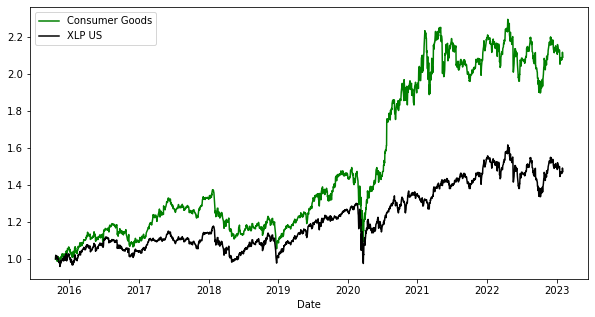

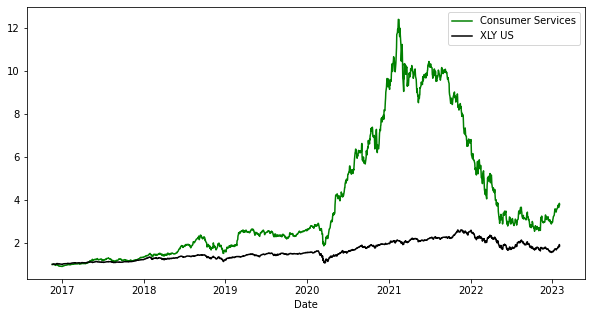

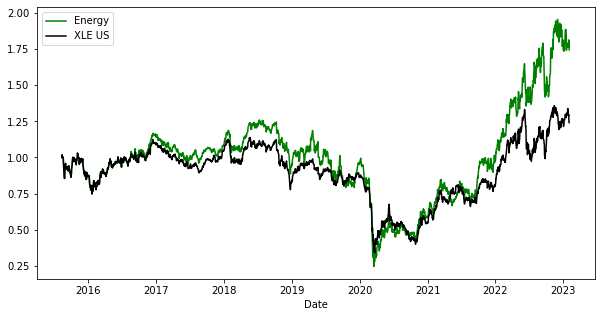

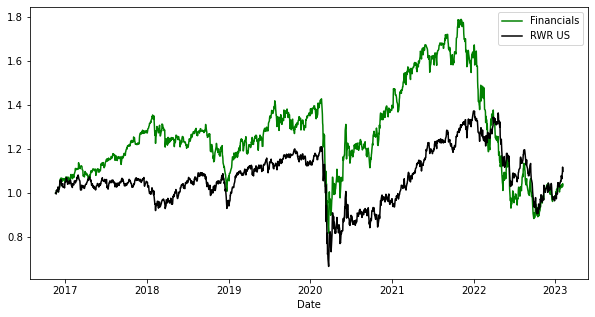

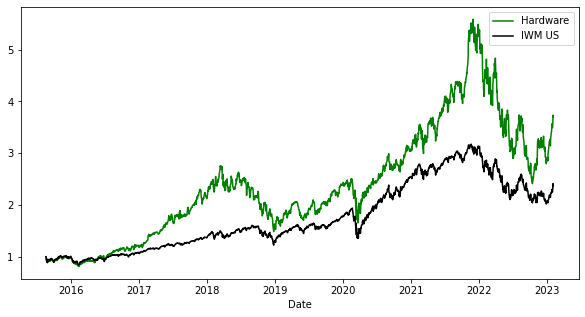

...

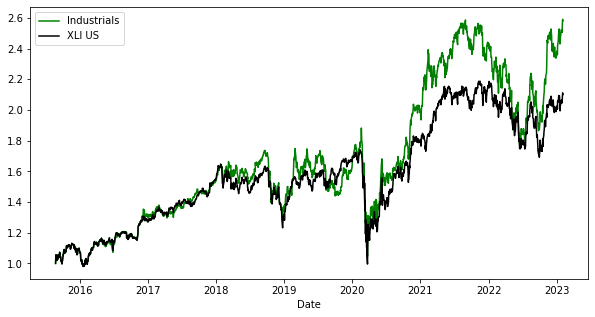

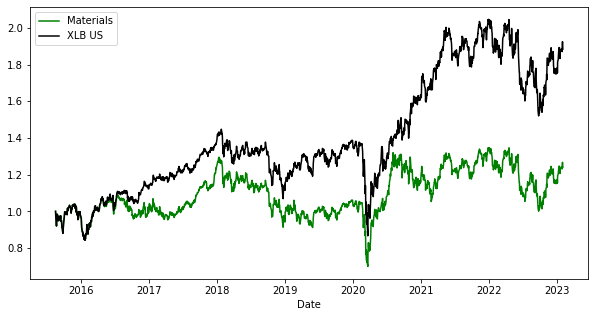

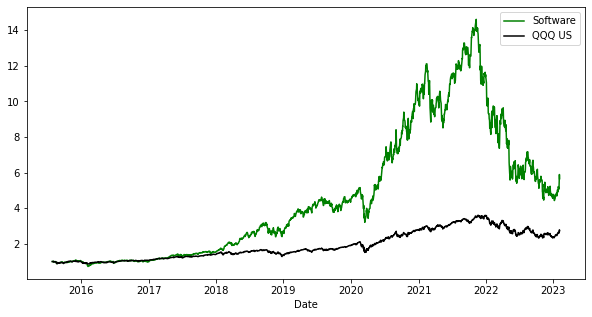

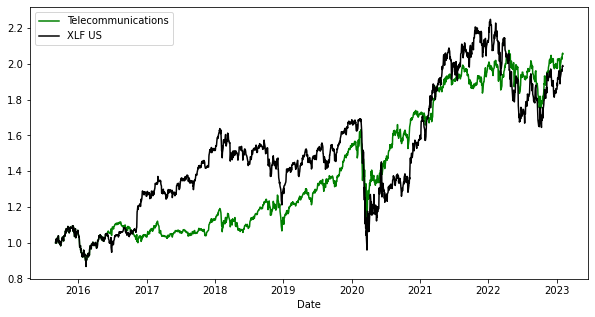

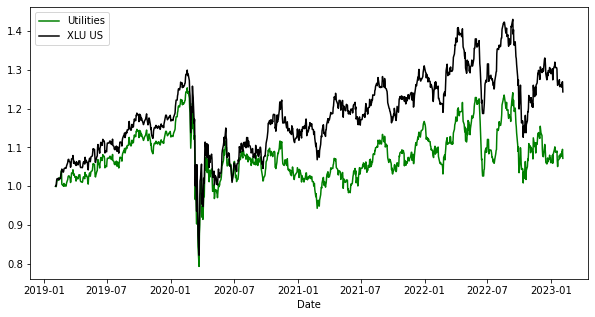

In [24]:
#CREATES OPTIMAL SECTOR PORTFOLIOS 

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
#import mysql.connector
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def round_up(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.ceil(n * multiplier) / multiplier)

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def on_selection(value):
    global choice
    choice = value
    root.destroy()

dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

number_to_string = {'6160 HK': 'BGNE US','700 HK': 'TCEHY US','2330 TT': 'TSM US','6758 JP': 'SONY US','9868 HK': 'XPEV US'}
string_to_number = {'BGNE US': '6160 HK','TCEHY US': '700 HK','TSM US': '2330 TT','SONY US': '6758 JP','XPEV US': '9868 HK'}
clean_up = lambda x: re.sub(r'[^A-Z /^0-9]', '', str(x))
clean_up_save = lambda x: re.sub(r'[^A-Z ^0-9]', '', str(x))
to_int = lambda x: int(x)
to_year = lambda x: str(x.split('QCY-')[1])
to_quarter = lambda x: str(x.split('QCY-')[0])
max_zero = lambda x: max(0, x)
min_zero = lambda x: min(0, x)
level1 = lambda x: int(x.split(',')[0][-1])
level2 = lambda x: x.split(',')[1][2:-2]
to_date = lambda x: datetime(int(x[:4]), int(x[4:6]), int(x[6:])).date()
to_weekday = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index >= x][0]
to_ED = lambda x: Stock_Summary_AUX_df.index[Stock_Summary_AUX_df.index.values.tolist().index(ED_series_compact[ED_series_compact < x].iloc[-1]) - 1]
to_previous = lambda x: Stock_Summary_AUX_df.loc[x, metric]
to_floor = lambda x: max(x, 1)
to_sector = lambda x: Sectors_df.loc[x, 'Custom Sector 1']
to_level1 = lambda x: x.split(',')[0][2:-1]
to_level2 = lambda x: x.split(',')[1][2:-2]
to_targets = lambda x: sector_targets.loc[x]
to_previous_prices = lambda x: Prices_df.loc[prev_rebal_date, x]
to_previous_prices_2 = lambda x: Prices_df.loc[curr_rebal_date, x]
to_current_prices = lambda x: Prices_df.loc[current_date, x]
to_level1 = lambda x: x.split(',')[0][2:-1]
to_level2 = lambda x: int(x.split(',')[1][1:-1])
to_region = lambda x: x[-2:]
to_ccy = lambda x: FX_df.loc[x, 'Pair']

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()


ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
       'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

companies_share = 1 / 10
min_ps = 2
global_cap = 35
max_allocation = 25 / 100
#nul_sector_list = ['Telecommunications']
nul_sector_list = []

sectors = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Custom_Segmentation.csv")
Sectors_df = pd.DataFrame(sectors)
Sectors_df = Set_DF(Sectors_df)
Sectors_df = DD_Index(Sectors_df)
sector_list = list(pd.Series(pd.unique(Sectors_df['Custom Sector 1'])).dropna())

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

today = Prices_df.index[-1]

query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

query_nsp = 'SELECT * FROM sector_trades_relation'    
NewSectorPositions_df = pd.read_sql_query(query_nsp, engine)
NewSectorPositions_df = Set_DF(NewSectorPositions_df)
NewSectorPositions_df = DD_Index(NewSectorPositions_df)
if ('QQQ' in NewSectorPositions_df.columns):
    NewSectorPositions_df.drop(['QQQ'], axis = 1, inplace = True)
if ('SPX' in NewSectorPositions_df.columns):
    NewSectorPositions_df.drop(['SPX'], axis = 1, inplace = True)

sector_list = NewSectorPositions_df.columns.values.tolist()
if ('SPX' in sector_list):
    sector_list.remove('SPX')
if ('QQQ' in sector_list):
    sector_list.remove('QQQ')

query_fx = "SELECT * FROM fx_relation"
FX_df = pd.read_sql_query(query_fx, engine)
FX_df = Set_DF(FX_df)
FX_df = DD_Index(FX_df)

oride = False
oride_s = input("Override (Y/N)? ").upper()
if (oride_s == 'Y'):
    oride = True
    
ext = ''
ext_s = input("Slim Port (Y/N)? ").upper()
if (ext_s == 'Y'):
    ext = '_slim'

k = 0
#sector_list = ['Software']
for sector in sector_list:
    sector_relation = re.sub(r'[^a-z_^0-9]', '', sector.lower()) + '_portfolio' + ext
    equiv = Equivalence_df.iloc[-1][sector]
    new_sector = False
    
    if (sector_relation in new_tables_list) & (sector not in nul_sector_list):
        query_sp = 'SELECT * FROM ' + sector_relation   
        sector_port_df = pd.read_sql_query(query_sp, engine)
        sector_port_df = Set_DF(sector_port_df)
        sector_port_df = DD_Index(sector_port_df)
        if (type(sector_port_df.columns[0]) != str):
            sector_port_df.columns = sector_port_df.columns.astype(str)
            
        for sector_x in nul_sector_list:
            NewSectorPositions_df[sector_x] = float(0)

        sector_dates = NewSectorPositions_df[sector][NewSectorPositions_df[sector] == 1].index
        
        if (len(sector_dates) > 0):
            init_date = sector_dates[0]
            final_date = sector_dates[-1]
            date_spam = Prices_df.index[Prices_df.index >= init_date]
#           date_spam = date_spam[date_spam <= final_date]

            for current_date in sector_dates:
                if (current_date not in sector_port_df.index):
                    sector_port_df.loc[current_date] = sector_port_df[sector_port_df.index > current_date].iloc[0]
            sector_port_df.sort_index(axis = 0, inplace = True)

            sector_targets = round(Sectors_df['Custom Sector 1'].dropna().value_counts() * companies_share, 0).astype(int)
            sector_targets = pd.Series(np.array(pd.DataFrame(sector_targets).T.columns.map(lambda x: max(int(1 / max_allocation), pd.DataFrame(sector_targets).T.iloc[0][x]))), index = sector_targets.index)
            sector_target = sector_targets[sector]

            portfolio_string = re.sub(r'[^a-z_^0-9]', '', sector.lower()) + '_portfolio_selection' + ext

            if (portfolio_string in new_tables_list) & (not oride):
                query_index_port = 'SELECT * FROM ' + portfolio_string  
                sector_portfolio_df = pd.read_sql_query(query_index_port, engine)
                sector_portfolio_df.index = pd.Index(sector_portfolio_df[sector_portfolio_df.columns[-1]], name = 'Date')
                sector_index_series = sector_portfolio_df[sector_portfolio_df.columns[-2]]
                sector_portfolio_df.drop(['Date', sector_portfolio_df.columns[-1], sector_portfolio_df.columns[-2]], axis = 1, inplace = True)
                lev1_list = sector_portfolio_df.columns.map(to_level1).values.tolist()
                lev2_list = sector_portfolio_df.columns.map(to_level2).values.tolist()
                sector_portfolio_df.columns = [lev1_list, lev2_list]
                sector_portfolio_df['Index'] = sector_index_series
            else:
                sector_portfolio_df = pd.DataFrame(index = date_spam, columns = [['Stocks'] * sector_target, np.arange(sector_target)])
                sector_portfolio_df['Index'] = float(1)
                sector_portfolio_df['Date_BU'] = sector_portfolio_df.index
                new_sector = True

            sector_portfolio_df.sort_index(inplace = True)
            number_stocks01_df = pd.DataFrame(np.array(NewSectorPositions_df.replace({-1: 0})).dot(np.array(NewSectorPositions_df.columns.map(to_targets)).T).astype(int), index = NewSectorPositions_df.index, columns = ['Number of Stocks'])
            prev_list = []
            rebalancing_dates_list = []

            for idx, current_date in enumerate(date_spam):
                if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                    pass
                else:
                    if (current_date not in sector_portfolio_df.index) | (oride) | (new_sector) | (current_date == today):
                        last_sr_date = sector_dates[sector_dates <= current_date][-1]
                        current_ns = number_stocks01_df.loc[last_sr_date][0]
                        base_number = int(NewSectorPositions_df.loc[last_sr_date].replace({-1: 0}).sum() * min_ps)
                        haircut = 0
                        if (current_ns > global_cap):
                            haircut = max(0, (current_ns - global_cap) / abs(current_ns - base_number))
                        hc_series = pd.Series((np.array(NewSectorPositions_df.loc[last_sr_date].replace({-1: 0})) * np.array(NewSectorPositions_df.columns.map(to_targets)) * haircut)).apply(round_down, 0)
                        final_ns_array = (np.array(NewSectorPositions_df.loc[last_sr_date].replace({-1: 0}) * np.array(NewSectorPositions_df.columns.map(to_targets))) - np.array(hc_series)).astype(int)
                        magic_number = final_ns_array[NewSectorPositions_df.columns.values.tolist().index(sector)]
                        current_list = sorted(sector_port_df.loc[last_sr_date][:magic_number].values.tolist() + [''] * (sector_target - len(sector_port_df.loc[last_sr_date][:magic_number].values.tolist())))[::-1]
                        sector_portfolio_df.loc[current_date, ['Stocks']] = current_list
                        sector_portfolio_df.loc[current_date, 'Index'] = float(1)
                        if (current_list != prev_list):
                            rebalancing_dates_list.append(current_date)
                        prev_list = current_list

            sector_portfolio_df.dropna(how = 'all', inplace = True)
            sector_portfolio_df.sort_index(inplace = True)

            date_spam_2 = sector_portfolio_df.index.values.tolist()
            if (not oride):
                date_spam_2 = []
                date_spam_2.append(today)
                rebalancing_dates_list.append(sector_portfolio_df.index[-2])
                rebalancing_dates_list = sorted(rebalancing_dates_list)

            for idx, current_date in enumerate(date_spam_2):
                if ((current_date.day == 25) & (current_date.month == 12)) | ((current_date.day == 1) & (current_date.month == 1)):
                    sector_portfolio_df.drop(current_date, inplace = True)
                else:
                    if (sector_portfolio_df.loc[current_date, 'Index'][0] == 1) | (oride) | (current_date == today):
                        current_prices = sector_portfolio_df.loc[current_date][sector_portfolio_df.loc[current_date] != '']['Stocks'].map(to_current_prices) / ('USD' + sector_portfolio_df.loc[current_date][sector_portfolio_df.loc[current_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_current_prices)
                        if (current_date == sector_portfolio_df.index[0]):
                            prev_k = 1
                            current_positions = prev_k / sector_portfolio_df.loc[current_date][sector_portfolio_df.loc[current_date] != '']['Stocks'].count() / current_prices
                        else:
                            prev_rebal_date = pd.Series(rebalancing_dates_list).values[pd.Series(rebalancing_dates_list).values < current_date][-1]
                            curr_rebal_date = pd.Series(rebalancing_dates_list).values[pd.Series(rebalancing_dates_list).values <= current_date][-1]
                            previous_prices = (sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].map(to_previous_prices) / ('USD' + sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_previous_prices)).values
                            previous_prices_2 = (sector_portfolio_df.loc[curr_rebal_date][sector_portfolio_df.loc[curr_rebal_date] != '']['Stocks'].map(to_previous_prices_2) / ('USD' + sector_portfolio_df.loc[curr_rebal_date][sector_portfolio_df.loc[curr_rebal_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_previous_prices_2)).values

                            previous_positions = (sector_portfolio_df.loc[prev_rebal_date, 'Index'][0] / sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].count() / previous_prices)
                            prev_k = (previous_positions * sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].map(to_previous_prices_2) / ('USD' + sector_portfolio_df.loc[prev_rebal_date][sector_portfolio_df.loc[prev_rebal_date] != '']['Stocks'].replace({'SPX': 'SPX US', 'QQQ': 'QQQ US'}).map(to_region).map(to_ccy)).map(to_previous_prices_2)).sum()
                            current_positions = (prev_k / sector_portfolio_df.loc[curr_rebal_date][sector_portfolio_df.loc[curr_rebal_date] != '']['Stocks'].count() / previous_prices_2) 

                        sector_portfolio_df.loc[current_date, 'Index'] = (current_positions * current_prices).sum()

            sector_portfolio_df['Date_BU'] = sector_portfolio_df.index
            sector_portfolio_df.sort_index(inplace = True)
            sector_portfolio_df.to_sql(portfolio_string, engine, index = True, if_exists = 'replace')
            print(sector)
            k = k + 1
            plt.figure(k, figsize = (10, 5))
            sector_portfolio_df['Index'].plot(c = 'g', label = sector).legend(loc = 'best')
            (Prices_df.loc[sector_portfolio_df.index][equiv] / Prices_df.loc[sector_portfolio_df.index][equiv][0]).plot(c = 'k', label = equiv).legend(loc = 'best')

    else:
        print(sector + ' Not Available')

Enter Start Date: (YY/MM/DD)15/10/01
Activate Short Selling (Y/N)? Y
Activate Hedges (Y/N)? Y
ETF Mapping (Y/N)? Y
Single name trading (Y/N)? Y
Slim Port (Y/N)? Y
Frequent Rebalancings (Y/N)? Y
(S)istematic, (Q)uant hedge, (A)nd, (O)r? (O) Q
Rebalancing % time: 12.64

Consumer Goods Single Name OK
Consumer Services Single Name OK
Energy Single Name OK
Financials Single Name OK
Hardware Single Name OK
Health Care Single Name OK
Industrials Single Name OK
Materials Single Name OK
Software Single Name OK
Telecommunications Single Name OK
Utilities Single Name OK
Dates
2016-12-31    12.26
2017-12-31    25.32
2018-12-31    33.82
2019-12-31    19.66
2020-12-31    62.73
2021-12-31    36.38
2022-12-31    56.77
2023-12-31     6.96
Freq: A-DEC, Name: Net, dtype: float64

Total: 755.49%
CAGR: 33.93%
CAGR / DD: 3.11
Average exposure: 0.74

Average Long: 64.83
Median Long: 70.0

Longs:
['XLY US', 'IWM US', 'QQQ US', 'XLF US']

Shorts:
['XLP US', 'XLI US', 'XLB US']

Algo Daily: -1.24%

RWR US Daily

Level      Accounting                                                        \
Sectors          Cash   Long Short Daily Short C Hedge Daily Hedge C    Net   
Dates                                                                         
2022-11-10        0.0  8.614      -0.334   0.111      -0.125   0.431  8.155   
2022-12-15        0.0  7.805       0.059   0.170       0.000   0.431  7.864   
2022-12-30        0.0  7.874       0.088   0.258       0.036   0.468  7.998   
2023-01-13        0.0  8.498      -0.204   0.054       0.000   0.468  8.294   
2023-01-17        0.0  8.221       0.014   0.068       0.000   0.468  8.235   
2023-01-20        0.0  8.175       0.035   0.103       0.000   0.468  8.210   
2023-01-25        0.0  8.420      -0.047   0.056       0.000   0.468  8.373   
2023-01-31        0.0  8.545      -0.066  -0.010       0.000   0.468  8.480   
2023-02-02        0.0  8.743      -0.081  -0.090       0.000   0.468  8.662   
2023-02-03        0.0  8.519       0.036  -0.054       0.000   0.468  8.555   

Level      Exposure  
Sectors              
Dates                
2022-11-10     0.50  
2022-12-15     0.25  
2022-12-30     0.50  
2023-01-13     0.50  
2023-01-17     0.50  
2023-01-20     0.50  
2023-01-25     0.50  
2023-01-31     0.50  
2023-02-02     0.55  
2023-02-03     0.55

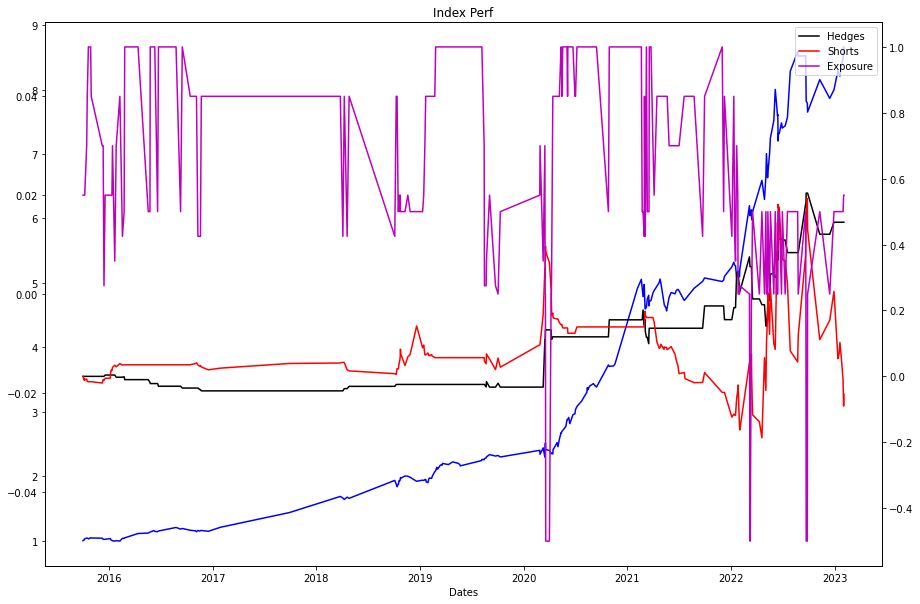

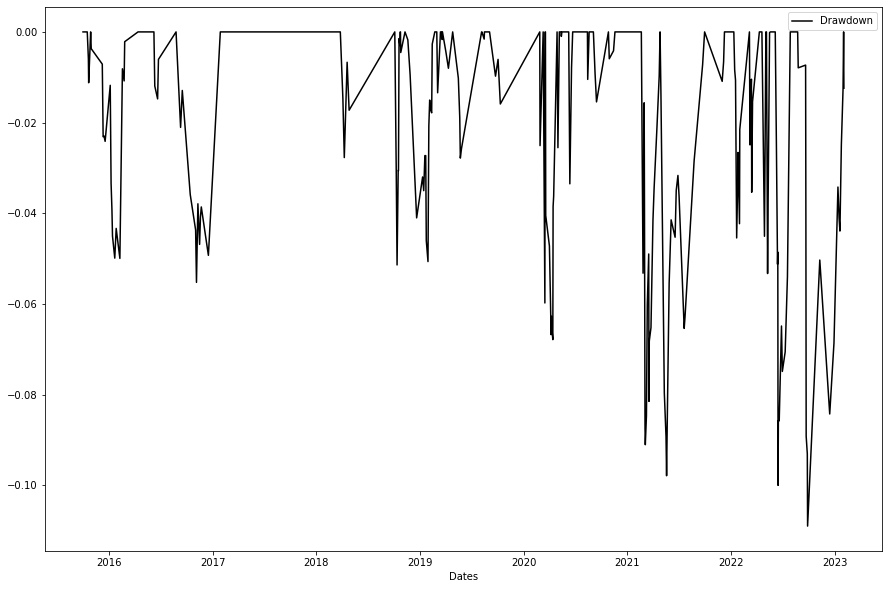

<Figure size 432x288 with 0 Axes>

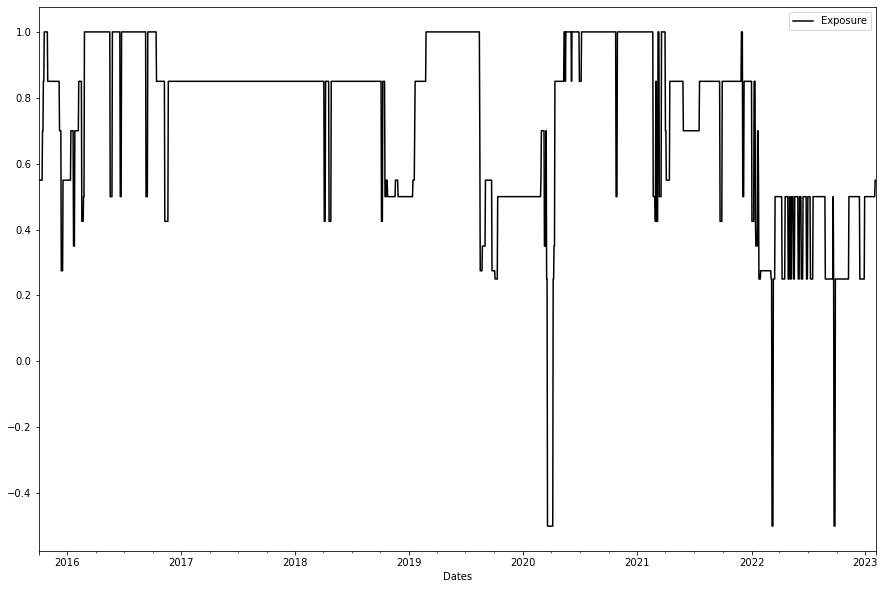

In [25]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\algo_pca.py

#SECTOR ALGO MVR BACKTESTING

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
from datetime import datetime
from datetime import timedelta
from datetime import date
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
import warnings


def Average(lst):
    return sum(lst) / len(lst)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def Filter_df(tbf_df, merging_dates_list):
    
    filter_df = pd.DataFrame(merging_dates_list, columns=['Date'])
    merged_df = pd.merge(tbf_df, filter_df, on='Date')
    merged_df.index = filter_df['Date'] 
    merged_df.index.name = 'Date'
    merged_df.drop(['Date'], axis=1, inplace=True)
    
    
    return merged_df

def offset(c_stock, i_list, d_list, t_date, r_date, div_i):
    
    cutoff_date = r_date
    Start_Date = t_date
    ed_list = d_list
    y_list = i_list
    cur_index = 0
    nd_list = []
    for cur_ed_date in ed_list:                            
        cont=0
        seek_element = True
        ced = cur_ed_date
        cur_index = ed_df[c_stock].values.tolist()[cur_index:].index(cur_ed_date) + cur_index
        cur_index_plus = cur_index + 1
        if (cur_index_plus<len(ed_df.index)):
            cur_year = ed_df.index[cur_index_plus][len(ed_df.index[cur_index_plus])-4:]
        else:
            cur_year = today.year
        cur_ed_date = str(cur_year) + '-' + cur_ed_date[0:2] + '-' + cur_ed_date[2:]
        cur_ed_date = datetime.strptime(cur_ed_date, "%Y-%m-%d").date()
        if (cur_ed_date < cutoff_date):
            nd_list.append(cur_ed_date)        
    
    offs = round_down(len(pd.Series(nd_list)[pd.Series(nd_list) > t_date]) / div_i, 0)
    
    return offs

#warnings.simplefilter('error')
    
dbase = "visiblealpha_laptop"
dbase_metrics = "metrics_laptop"

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

engine_metrics = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase_metrics))

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase_metrics, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list_metrics = pd.DataFrame(tables_list, columns=['Old'])['Old'].values.tolist()

hedge_ratio = 1 / 2
init_short_ratio = 15 / 100
limit_short = 50 / 100

to_date = lambda x: datetime(x.year, x.month, x.day)
to_current = lambda x: sectors_pxs_rd_df.loc[current_date, x]
to_previous = lambda x: sectors_pxs_rd_df.loc[prev_date, x] + sectors_correction_rd_df[prev_date: current_date].iloc[1:-1][x].sum()
to_LLD = lambda x: sectors_pxs_rd_df.loc[last_long_date, x] + sectors_correction_rd_df[last_long_date: current_date].iloc[1:-1][x].sum()
to_current_ss = lambda x: Equiv_Indexes_df.loc[current_date, x]
to_previous_ss = lambda x: Equiv_Indexes_df.loc[prev_date, x]
to_ETF = lambda x: Equivalence_df.loc[prev_date, x]
to_ETF_LLD = lambda x: Equivalence_df.loc[last_long_date, x]
to_ISN = lambda x: Equivalence_SN_df.loc[prev_date, x]
to_ISN_LLD = lambda x: Equivalence_SN_df.loc[last_long_date, x]
ETF_to_CurrPx = lambda x: Prices_df.loc[current_date, x]
ETF_to_PrevPx = lambda x: Prices_df.loc[prev_date, x]
ETF_to_LLDPx = lambda x: Prices_df.loc[last_long_date, x]
to_level1 = lambda x: x.split(',')[0][2:-1]
to_level2 = lambda x: int(x.split(',')[1][1:-1])

ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
       'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']
#Sectors_OUT_list = ['Telecommunications']
Sectors_OUT_list = []
Sectors_ETF_list = []

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)
Prices_df = Prices_df[ETF_List]

query_sector_trades = 'SELECT * FROM sector_trades_relation'    
NewSectorPositions_df = pd.read_sql_query(query_sector_trades, engine)
NewSectorPositions_df = Set_DF(NewSectorPositions_df)
NewSectorPositions_df = DD_Index(NewSectorPositions_df)
if ('QQQ' in NewSectorPositions_df.columns):
    NewSectorPositions_df.drop(['QQQ'], axis = 1, inplace = True)
if ('SPX' in NewSectorPositions_df.columns):
    NewSectorPositions_df.drop(['SPX'], axis = 1, inplace = True)

Start_Date = input("Enter Start Date: (YY/MM/DD)")
if (Start_Date == ''):
    Start_Date = NewSectorPositions_df.index[0]
else:
    Start_Date = datetime.strptime(Start_Date, "%y/%m/%d").date()
    if (Start_Date < NewSectorPositions_df.index[0]):
        Start_Date = NewSectorPositions_df.index[0]
    Start_Date = NewSectorPositions_df.index[NewSectorPositions_df.index <= Start_Date][-1]

NewSectorPositions_df = NewSectorPositions_df[NewSectorPositions_df.index >= Start_Date]

active_ss = False
Opt_S = input("Activate Short Selling (Y/N)? ").upper()
if (Opt_S == 'Y'):
    active_ss = True
    AdjSectorPositions_df = NewSectorPositions_df.copy()
else:
    AdjSectorPositions_df = NewSectorPositions_df.replace({-1: 0})

today = AdjSectorPositions_df.index[-1]      
yest = AdjSectorPositions_df.index[AdjSectorPositions_df.index.values.tolist().index(today) - 1]

active_hedges = False
Opt_H = input("Activate Hedges (Y/N)? ").upper()
if (Opt_H == 'Y'):
    active_hedges = True
    
etf_mapping = False
Opt_ETF = input("ETF Mapping (Y/N)? ").upper()
if (Opt_ETF == 'Y'):
    etf_mapping = True
    
ist_mapping = False
Opt_IST = input("Single name trading (Y/N)? ").upper()
if (Opt_IST == 'Y'):
    ist_mapping = True
    
ext = ''
ext_s = input("Slim Port (Y/N)? ").upper()
if (ext_s == 'Y'):
    ext = '_slim'

fr = False
reb = input("Frequent Rebalancings (Y/N)? ").upper()
if (reb == 'Y'):
    fr = True

query_sector_pxs = 'SELECT * FROM sector_indexes'    
sectors_pxs_df = pd.read_sql_query(query_sector_pxs, engine)
sectors_pxs_df = Set_DF(sectors_pxs_df)
sectors_pxs_df = DD_Index(sectors_pxs_df)

sector_list = NewSectorPositions_df.columns.values.tolist()
if ('SPX' in sector_list):
    sector_list.remove('SPX')
if ('QQQ' in sector_list):
    sector_list.remove('QQQ')

query_algo01 = 'SELECT * FROM algo_01'    
Algo01_df = pd.read_sql_query(query_algo01, engine_metrics)
Algo01_df = Set_DF(Algo01_df)
Algo01_df = DD_Index(Algo01_df)

query_S_hedge = "SELECT * FROM new_hedge_relation"    
S_hedge_df = pd.read_sql_query(query_S_hedge, engine)
S_hedge_df = Set_DF(S_hedge_df)
S_hedge_df = DD_Index(S_hedge_df)
S_hedge_df = abs(S_hedge_df)
S_hedge_STR = S_hedge_df.columns[0]

query_Q_hedge = "SELECT * FROM hedge_relation"    
Q_hedge_df = pd.read_sql_query(query_Q_hedge, engine)
Q_hedge_df = Set_DF(Q_hedge_df)
Q_hedge_df = DD_Index(Q_hedge_df)
Q_hedge_df = abs(Q_hedge_df)
Q_hedge_STR = Q_hedge_df.columns[0]

hedge_df = Q_hedge_df.copy()
hedge_STR = Q_hedge_STR
Opt_H = input("(S)istematic, (Q)uant hedge, (A)nd, (O)r? (O) ").upper()
if (Opt_H == 'O'):
    hedge_df[hedge_STR] = (Q_hedge_df[Q_hedge_STR] + S_hedge_df[S_hedge_STR]).clip(0, 1).replace({np.nan: 0})    
elif (Opt_H == 'A'):
    hedge_df[hedge_STR] = (Q_hedge_df[Q_hedge_STR] * S_hedge_df[S_hedge_STR]).replace({np.nan: 0})   
elif (Opt_H == 'S'):
    hedge_df = S_hedge_df.copy()
    hedge_STR = S_hedge_STR

query_sector_adj = 'SELECT * FROM sector_indexes_corrections'    
sectors_correction_df = pd.read_sql_query(query_sector_adj, engine)
sectors_correction_df = Set_DF(sectors_correction_df)
sectors_correction_df = DD_Index(sectors_correction_df)
                                 
query_equiv_idx = 'SELECT * FROM equivalent_indexes_relation'    
Equiv_Indexes_df = pd.read_sql_query(query_equiv_idx, engine)
Equiv_Indexes_df = Set_DF(Equiv_Indexes_df)
Equiv_Indexes_df = DD_Index(Equiv_Indexes_df)

rebalancing_series_lo = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({-1: 0}) == AdjSectorPositions_df.replace({-1: 0}).shift(1)).sum(axis = 1)
rebalancing_series_lo.iloc[0] = 0
rebalancing_series_lo.name = 'Rebalancings Long Only'
rebalancing_dates_lo = rebalancing_series_lo[rebalancing_series_lo != 0].index.values.tolist()

rebalancing_series_so = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df.replace({1: 0}) == AdjSectorPositions_df.replace({1: 0}).shift(1)).sum(axis = 1)
rebalancing_series_so.iloc[0] = 0
rebalancing_series_so.name = 'Rebalancings Short Only'
rebalancing_dates_so = rebalancing_series_so[rebalancing_series_so != 0].index.values.tolist()

rebalancing_series = len(AdjSectorPositions_df.columns) - (AdjSectorPositions_df == AdjSectorPositions_df.shift(1)).sum(axis = 1)
rebalancing_series.iloc[0] = 0
rebalancing_series.name = 'Rebalancings'
rebalancing_dates = rebalancing_series[rebalancing_series != 0].index.values.tolist()

if (yest not in rebalancing_dates):
    rebalancing_dates.append(yest)

if (today not in rebalancing_dates):
    rebalancing_dates.append(today)

if (active_hedges):    
    Hedged_positions = AdjSectorPositions_df.copy()
    Hedged_positions['Total Exp'] = Hedged_positions.replace({-1: 0}).sum(axis = 1).clip(0, 1) + (Hedged_positions.replace({1: 0}).sum(axis = 1) * init_short_ratio).map(lambda x: max(-limit_short, x))
    Hedged_positions = Hedged_positions.join(hedge_df[hedge_STR])
    hedge_series_1 = Hedged_positions[Hedged_positions['Total Exp'] > 0][hedge_STR]
    hedge_series_2 = hedge_series_1.shift(1)
    rebalancing_dates = sorted(pd.unique(hedge_series_1[hedge_series_1 != hedge_series_2].index.values.tolist() + rebalancing_dates).tolist())

sectors_pxs_rd_df = sectors_pxs_df.loc[rebalancing_dates] / 1000
sectors_correction_rd_df = sectors_correction_df[sectors_correction_df.index > rebalancing_dates[0]] / 1000

rebal_pct = round(100 * len(rebalancing_dates) / len(rebalancing_series.index), 2)
print('Rebalancing % time: ' + str(rebal_pct))
k_df = pd.DataFrame(AdjSectorPositions_df.loc[rebalancing_dates].astype(float).values, index = pd.Index(rebalancing_dates, name = 'Dates'), columns = [['Sectors'] * len(AdjSectorPositions_df.columns), AdjSectorPositions_df.columns])
k_df.columns.names = ['Level', 'Sectors']
spx_series = k_df['Sectors'].join(Prices_df['SPX'])['SPX']

if (len(Sectors_OUT_list) > 0):
    for sec in Sectors_OUT_list:
        if (sec in k_df['Sectors'].columns):
            k_df['Sectors', sec] = float(0)

k_df['Accounting', 'Cash'] = float(0)
k_df['Accounting', 'Long'] = float(0)
k_df['Accounting', 'Short Daily'] = float(0)
k_df['Accounting', 'Short C'] = float(0)
k_df['Accounting', 'Hedge Daily'] = float(0)
k_df['Accounting', 'Hedge C'] = float(0)
k_df['Accounting', 'Net'] = float(0)
k_df['Exposure'] = float(0)
k_df['Hedges'] = hedge_df[hedge_STR]
k_df.loc[k_df.index[0], ('Accounting', 'Long')] = k_df.iloc[0]['Sectors'].replace({-1: 0}).sum().clip(0, 1)
k_df.loc[k_df.index[0], ('Accounting', 'Cash')] = 1 - k_df['Accounting', 'Long'][0]
k_df.loc[k_df.index[0], ('Accounting', 'Net')] = 1

Sector_Daily_Returns = (sectors_pxs_df / (sectors_pxs_df.shift(1) + sectors_correction_df.shift(1)) - 1).dropna(how = 'all')
ETF_Daily_Returns = ((Prices_df[ETF_List] / Prices_df[ETF_List].shift(1)) - 1).loc[Sector_Daily_Returns.index]

if (etf_mapping):
    query_eq = 'SELECT * FROM etf_equivalence_relation'    
    Equivalence_df = pd.read_sql_query(query_eq, engine)
    Equivalence_df = Set_DF(Equivalence_df)
    Equivalence_df = DD_Index(Equivalence_df)
    
if (ist_mapping):
    print('')
    Equivalence_SN_df = Equivalence_df.copy()
    for current_sector in sector_list:
        current_sector_rel = re.sub(r'[^a-z_^0-9]', '', current_sector.lower()) + '_portfolio_selection' + ext
        if (current_sector_rel in new_tables_list):
            
            query_index_port = 'SELECT * FROM ' + current_sector_rel  
            Index_Port_df = pd.read_sql_query(query_index_port, engine)
            Index_Port_df.index = pd.Index(Index_Port_df[Index_Port_df.columns[-1]], name = 'Date')
            sector_index_series = Index_Port_df[Index_Port_df.columns[-2]]
            Index_Port_df.drop(['Date', Index_Port_df.columns[-1], Index_Port_df.columns[-2]], axis = 1, inplace = True)
            lev1_list = Index_Port_df.columns.map(to_level1).values.tolist()
            lev2_list = Index_Port_df.columns.map(to_level2).values.tolist()
            Index_Port_df.columns = [lev1_list, lev2_list]
            Index_Port_df['Index'] = sector_index_series
            Index_Port_df.sort_index(inplace = True)
            
            index_series = Index_Port_df['Index']
            index_series.name = current_sector + ' Index'
            Prices_df = Prices_df.join(index_series)
            Prices_df[current_sector + ' Index'].fillna(method = 'ffill')
            Index_name = current_sector + ' Index'
            Equivalence_SN_df[current_sector] = Index_name
            print(current_sector + ' Single Name OK')

total_k = 1
prev_k = 1
prev_k_long = 1
prev_date = rebalancing_dates[0]
last_long_date = rebalancing_dates[0]
last_short_date = rebalancing_dates[0]

for idx, current_date in enumerate(rebalancing_dates[1:]): 
    idx = idx + 1
    short_ratio = init_short_ratio
    Updated_Short_Series = np.zeros(len(k_df['Sectors'].columns))
    Updated_Long_Series = np.zeros(len(k_df['Sectors'].columns))
    if (fr):
        last_long_date = prev_date
    else:
        last_long_date = list(pd.Series(rebalancing_dates_lo)[pd.Series(rebalancing_dates_lo) < current_date])[-1]
        
    
    if (etf_mapping):
        Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_PrevPx)
        LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF_LLD).map(ETF_to_LLDPx)
        Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ETF).map(ETF_to_CurrPx)
        Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous_ss)
        Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current_ss)
    else:
        Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_previous)
        LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_LLD)
        Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_current)
        Previous_Pxs_Series_Short = k_df['Sectors'].columns.map(to_previous)
        Current_Pxs_Series_Short = k_df['Sectors'].columns.map(to_current)
        
    if (ist_mapping):
        Previous_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ISN).map(ETF_to_PrevPx)
        LLD_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ISN_LLD).map(ETF_to_LLDPx)
        Current_Pxs_Series_Long = k_df['Sectors'].columns.map(to_ISN).map(ETF_to_CurrPx)
    
    Previous_SPX_Px = spx_series[idx - 1]
    Current_SPX_Px = spx_series[idx]
    
    Previous_Long_Series = k_df.loc[last_long_date]['Sectors'].replace({-1: 0})
    Total_Longs_Previous = Previous_Long_Series.sum()
    Previous_Exposure = Total_Longs_Previous.clip(0, 1)
    
    if (prev_date not in rebalancing_dates_lo) & (not fr):
        Long_Adj_Series = Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)
        Total_Longs_Previous = (Previous_Long_Series * (Previous_Pxs_Series_Long / LLD_Pxs_Series_Long)).sum()
    else:
        Long_Adj_Series = Previous_Long_Series
    
    if (Total_Longs_Previous > 0):
        Updated_Long_Series = Long_Adj_Series * (Current_Pxs_Series_Long / Previous_Pxs_Series_Long) * (prev_k_long / Total_Longs_Previous)
        k_df.loc[current_date, ('Accounting', 'Long')] = Updated_Long_Series.sum()
        k_df.loc[current_date, ('Accounting', 'Cash')] = 0
    else:
        k_df.loc[current_date, ('Accounting', 'Cash')] = prev_k - k_df['Accounting', 'Short Daily'][idx - 1]
    
    if (active_ss):
        Previous_Short_Series = k_df.iloc[idx - 1]['Sectors'].replace({1: 0})
        if (abs(Previous_Short_Series.sum()) * short_ratio > limit_short):
            short_ratio = limit_short / abs(Previous_Short_Series.sum())
        
        Total_Shorts_Previous = Previous_Short_Series.sum() * short_ratio
        Previous_Exposure = Total_Longs_Previous.clip(0, 1) + Total_Shorts_Previous
        
        Base_Short_Series =  Previous_Short_Series * prev_k * short_ratio
        Updated_Short_Series = Base_Short_Series * (Current_Pxs_Series_Short / Previous_Pxs_Series_Short)
        Current_Short_Results = Updated_Short_Series - Base_Short_Series
        
        k_df.loc[current_date, ('Accounting', 'Short Daily')] = Current_Short_Results.sum()
        k_df.loc[current_date, ('Accounting', 'Short C')] = k_df['Accounting', 'Short C'][idx - 1] + k_df['Accounting', 'Short Daily'][idx]
    
    if (active_hedges):
        Previous_Hedge = 0
        if (k_df['Hedges'][idx - 1] == 1) & (Previous_Exposure > 0):
            Previous_Hedge = - Previous_Exposure * prev_k * hedge_ratio
            Previous_Exposure = Previous_Exposure * (1 - hedge_ratio)
        
        Updated_Hedge = Previous_Hedge * (Current_SPX_Px / Previous_SPX_Px)
        Current_Hedge_Results = Updated_Hedge - Previous_Hedge
        
        k_df.loc[current_date, ('Accounting', 'Hedge Daily')] = Current_Hedge_Results
        k_df.loc[current_date, ('Accounting', 'Hedge C')] = k_df['Accounting', 'Hedge C'][idx - 1] + k_df['Accounting', 'Hedge Daily'][idx]

    total_k = k_df['Accounting', 'Cash'][idx] + k_df['Accounting', 'Long'][idx] + k_df['Accounting', 'Short Daily'][idx] + k_df['Accounting', 'Hedge Daily'][idx]
    if (not fr) & (prev_k_long != prev_k):
        total_k = total_k + (k_df['Accounting', 'Short C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Short C')]) + (k_df['Accounting', 'Hedge C'][idx] - k_df.loc[last_long_date, ('Accounting', 'Hedge C')]) - k_df['Accounting', 'Hedge Daily'][idx] - k_df['Accounting', 'Short Daily'][idx]
    k_df.loc[current_date, ('Accounting', 'Net')] = total_k
    k_df.loc[k_df.index[idx - 1], 'Exposure'] = Previous_Exposure 
    prev_k = total_k
    prev_k_long = prev_k
    prev_date = current_date
    
k_df.loc[k_df.index[-1], 'Exposure'] = k_df.iloc[-1]['Sectors'].replace({-1: 0}).sum().clip(0, 1) + k_df.iloc[-1]['Sectors'].replace({1: 0}).sum() * short_ratio
if (k_df['Exposure'][-1] > 0) & (k_df['Hedges'][-1] == 1):
    k_df.loc[k_df.index[-1], 'Exposure'] = k_df.loc[k_df.index[-1], 'Exposure'][0] * (1 - hedge_ratio)
    
Algo_joined = k_df['Accounting'].join(Algo01_df['Algo TC'])['Algo TC']
Algo_joined = Algo_joined / Algo_joined[0]
Algo_joined.name = 'Algo 01'

ttl_perf = k_df['Accounting', 'Net'][-1] / k_df['Accounting', 'Net'][0] - 1
dd_series = (k_df['Accounting', 'Net'] / k_df['Accounting', 'Net'].expanding().max() - 1)
max_dd = round(100 * dd_series.min(), 2)
cagr = (1 + ttl_perf) ** (365 / (k_df.index[-1] - k_df.index[0]).days) - 1
Acct_df = pd.DataFrame(k_df['Accounting'])
Acct_df.index = Acct_df.T.columns.map(to_date)
Resampled_df = Acct_df.resample('Y').last()
Resampled_df.fillna(method = 'ffill', inplace = True)
Ann_series = round(100 * (Resampled_df['Net'] / Resampled_df['Net'].shift(1) - 1).dropna(), 2)
print(Ann_series)
print('')
print('Total: ' + str(round(100 * ttl_perf, 2)) + '%')
print('CAGR: ' + str(round(100 * cagr, 2)) + '%')
print('CAGR / DD: ' + str(round(abs(100 * cagr / max_dd), 2)))
plt.figure(0, figsize = (15, 10))
k_df['Accounting', 'Net'].plot(c = 'b').twinx()
Algo_joined.plot(c = 'g').twinx()
k_df['Accounting', 'Hedge C'].plot(c = 'k', label = 'Hedges').legend()
k_df['Accounting', 'Short C'].plot(c = 'r', label = 'Shorts').legend()
k_df['Exposure'].plot(c = 'm', label = 'Exposure').legend(loc = 'best')
plt.title('Index Perf')
plt.figure(1, figsize = (15, 10))
dd_series.plot(c = 'k', label = 'Drawdown').legend()

date_range = pd.date_range(k_df.index[0],k_df.index[-1], freq = 'B') 
exposure_df = pd.DataFrame(np.nan, index = pd.Index(date_range, name = 'Dates'), columns = ['Dummy'])
exposure_df = exposure_df.join(k_df['Exposure'])
exposure_df.fillna(method = 'ffill', inplace = True)
exposure_df.drop(['Dummy'], axis = 1, inplace = True)
print('Average exposure: ' + str(round(exposure_df['Exposure'].mean(), 2)))
plt.figure(2)
exposure_df.plot(c = 'k', label = 'Exposure', figsize = (15, 10)).legend(loc = 'best')

if (etf_mapping):
    long_list = Equivalence_df.iloc[-1][k_df.iloc[-1]['Sectors'][k_df.iloc[-1]['Sectors'] == 1].index.values.tolist()].values.tolist()
    short_list = Equivalence_df.iloc[-1][k_df.iloc[-1]['Sectors'][k_df.iloc[-1]['Sectors'] == -1].index.values.tolist()].values.tolist()
else:
    long_list = k_df.iloc[-1]['Sectors'][k_df.iloc[-1]['Sectors'] == 1].index.values.tolist()
    short_list = k_df.iloc[-1]['Sectors'][k_df.iloc[-1]['Sectors'] == -1].index.values.tolist()

daily_algo = round(100 * (k_df['Accounting', 'Net'][-1] / k_df['Accounting', 'Net'][-2] - 1), 2)

print('')
print('Average Long: ' + str(round(k_df['Exposure'].mean() * 100, 2)))
print('Median Long: ' + str(round(k_df['Exposure'].median() * 100, 2)))
print('')
print('Longs:')
print(long_list)
print('')
print('Shorts:')
print(short_list)
print('')
print('Algo Daily: ' + str(daily_algo) + '%')
print('')

for sector in ETF_List:
    daily_sector = round(100 * (Prices_df.iloc[-1][sector] / Prices_df.iloc[-2][sector] - 1), 2)
    print(sector + ' Daily: ' + str(daily_sector) + '%')
    
print('')
k_df['Date_BU'] = k_df.index
k_df['Accounting'] = round(k_df['Accounting'], 3)
k_df.to_sql('long_short_summary', engine, index = True, if_exists = 'replace')

k_df[['Accounting', 'Exposure']][-10:]

In [ ]:
18.175
18.76

In [ ]:
14.25
15.70
7.71 8.58 9.62 10.25 12.835

In [26]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\new_algo_01.py

#BUILDS DAILY PORTFOLIO RELATION 

to_level1 = lambda x: x.split(',')[0][2:-1]
to_level2 = lambda x: x.split(',')[1][2:-2]
to_level1a = lambda x: x.split(',')[0][2:-1]
to_level2a = lambda x: int(x.split(',')[1][1:-1])
to_level1b = lambda x: x.split(',')[0][2:-1]
to_level2b = lambda x: re.sub(r'[^0-9]', '', x.split(',')[1])
to_ETF = lambda x: Equivalence_df.loc[current_date, x]
to_current_px = lambda x: Prices_df.loc[current_date, x]
to_previous_px = lambda x: Prices_df.loc[prev_date, x]
to_current_ss = lambda x: Equiv_Indexes_df.loc[current_date, x]
to_previous_ss = lambda x: Equiv_Indexes_df.loc[prev_date, x]

Sectors_OUT_list = ['Telecommunications']

query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)

query_equiv_idx = 'SELECT * FROM equivalent_indexes_relation'    
Equiv_Indexes_df = pd.read_sql_query(query_equiv_idx, engine)
Equiv_Indexes_df = Set_DF(Equiv_Indexes_df)
Equiv_Indexes_df = DD_Index(Equiv_Indexes_df)

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_nsp = 'SELECT * FROM sector_trades_relation'    
NewSectorPositions_df = pd.read_sql_query(query_nsp, engine)
NewSectorPositions_df = Set_DF(NewSectorPositions_df)
NewSectorPositions_df = DD_Index(NewSectorPositions_df)

query_ls_summary = 'SELECT * FROM long_short_summary'
ls_summary_df = pd.read_sql_query(query_ls_summary, engine)
ls_summary_df.index = pd.Index(ls_summary_df[ls_summary_df.columns[-1]], name = 'Dates')
ls_summary_df.drop(['Dates'], axis = 1, inplace = True)
lev1_list = ls_summary_df.columns.map(to_level1).values.tolist()
lev2_list = ls_summary_df.columns.map(to_level2).values.tolist()
ls_summary_df.columns = [lev1_list, lev2_list]
date_range = NewSectorPositions_df.index[NewSectorPositions_df.index >= ls_summary_df.index[0]].values.tolist()

start_date = ls_summary_df.index[0]
today = Prices_df.index[-1]

oride = False
oride_s = input("Override (Y/N)? ").upper()
if (oride_s == 'Y'):
    oride = True
    
ext = ''
ext_s = input("Slim Port (Y/N)? ").upper()
if (ext_s == 'Y'):
    ext = '_slim'
    
if (not oride):
    query_fls_summary = 'SELECT * FROM full_long_short_summary' + ext
    Full_Portfolio_df = pd.read_sql_query(query_fls_summary, engine)
    Full_Portfolio_df.index = pd.Index(Full_Portfolio_df[Full_Portfolio_df.columns[-1]], name = 'Dates')
    Full_Portfolio_df.drop(['Dates'], axis = 1, inplace = True)
    lev1_list = Full_Portfolio_df.columns.map(to_level1b).values.tolist()
    lev2_list = Full_Portfolio_df.columns.map(to_level2b).values.tolist()
    Full_Portfolio_df.columns = [lev1_list, lev2_list]
    date_list = []
    date_list.append(today)
else:
    Full_Portfolio_df = pd.DataFrame(index = pd.Index(date_range, name = 'Dates'), columns = [['Longs'] * 40, np.arange(40).astype(str)])
    date_list = Full_Portfolio_df.index.values.tolist()
    for c in np.arange(10):
        Full_Portfolio_df['Shorts', str(c)] = np.nan
    
for current_date in date_list:
    
    print(current_date)
    short_sectors_list = []
    long_sectors_list = []
    long_stocks_list = []
    ls_date = ls_summary_df[ls_summary_df.index <= current_date].index[-1]
    if (ls_summary_df.loc[ls_date, 'Sectors'][ls_summary_df.loc[ls_date, 'Sectors'] == -1].sum() < 0):
        short_sectors_list = pd.Series(ls_summary_df.loc[ls_date, 'Sectors'][ls_summary_df.loc[ls_date, 'Sectors'] == -1].index.values.tolist()).values.tolist()
    Full_Portfolio_df.loc[current_date, 'Shorts'] = short_sectors_list + [''] * (len(Full_Portfolio_df['Shorts'].columns) - len(short_sectors_list))
    
    if (ls_summary_df.loc[ls_date, 'Sectors'][ls_summary_df.loc[ls_date, 'Sectors'] == 1].sum() > 0):
        long_sectors_list = ls_summary_df.loc[ls_date, 'Sectors'][ls_summary_df.loc[ls_date, 'Sectors'] == 1].index.values.tolist()
    for sector in long_sectors_list:
        portfolio_string = re.sub(r'[^a-z_^0-9]', '', sector.lower()) + '_portfolio_selection' + ext
        query_index_port = 'SELECT * FROM ' + portfolio_string
        sector_portfolio_df = pd.read_sql_query(query_index_port, engine)
        sector_portfolio_df.index = pd.Index(sector_portfolio_df[sector_portfolio_df.columns[-1]], name = 'Date')
        sector_index_series = sector_portfolio_df[sector_portfolio_df.columns[-2]]
        sector_portfolio_df.drop(['Date', sector_portfolio_df.columns[-1], sector_portfolio_df.columns[-2]], axis = 1, inplace = True)
        lev1_list = sector_portfolio_df.columns.map(to_level1a).values.tolist()
        lev2_list = sector_portfolio_df.columns.map(to_level2a).values.tolist()
        sector_portfolio_df.columns = [lev1_list, lev2_list]
        sector_portfolio_df['Index'] = sector_index_series
        sector_portfolio_df.sort_index(inplace = True)
        
        add_list = sector_portfolio_df.loc[current_date, 'Stocks'].values.tolist()
        long_stocks_list = sorted(long_stocks_list + add_list)[::-1]
    long_stocks_list = long_stocks_list[:40]
    Full_Portfolio_df.loc[current_date, 'Longs'] = long_stocks_list + [''] * (len(Full_Portfolio_df['Longs'].columns) - len(long_stocks_list))
    
    
hedges_expanded_df = pd.DataFrame(np.nan, index = Full_Portfolio_df.index, columns = ['Dummy'])
hedges_expanded_df = hedges_expanded_df.join(k_df['Hedges']).drop(['Dummy'], axis = 1)
hedges_expanded_df.fillna(method = 'ffill', inplace = True)
hedges_expanded_df = hedges_expanded_df.replace({0: '', 1: 'SPX'})
Full_Portfolio_df['Hedges'] = hedges_expanded_df['Hedges']
Full_Portfolio_df['Hedges'] = (Full_Portfolio_df['Longs'][Full_Portfolio_df['Longs'] != ''].T.count().clip(0, 1) * Full_Portfolio_df['Hedges'])
Full_Portfolio_df['Dates_BU'] = Full_Portfolio_df.index
Full_Portfolio_df.sort_index(inplace = True)
Full_Portfolio_df.to_sql('full_long_short_summary' + ext, engine, index = True, if_exists = 'replace')
print('Longs:')
print(Full_Portfolio_df['Longs'][-10:])
print('')
print('Shorts:')
print(Full_Portfolio_df['Shorts'][-10:])

Override (Y/N)? Y
Slim Port (Y/N)? Y
2015-10-01
2015-10-02
2015-10-05
2015-10-06
2015-10-07
2015-10-08
2015-10-09
2015-10-12
2015-10-13
2015-10-14
2015-10-15
2015-10-16
2015-10-19
2015-10-20
2015-10-21
2015-10-22
2015-10-23
2015-10-26
2015-10-27
2015-10-28
2015-10-29
2015-10-30
2015-11-02
2015-11-03
2015-11-04
2015-11-05
2015-11-06
2015-11-09
2015-11-10
2015-11-11
2015-11-12
2015-11-13
2015-11-16
2015-11-17
2015-11-18
2015-11-19
2015-11-20
2015-11-23
2015-11-24
2015-11-25
2015-11-26
2015-11-27
2015-11-30
2015-12-01
2015-12-02
2015-12-03
2015-12-04
2015-12-07
2015-12-08
2015-12-09
2015-12-10
2015-12-11
2015-12-14
2015-12-15
2015-12-16
2015-12-17
2015-12-18
2015-12-21
2015-12-22
2015-12-23
2015-12-24
2015-12-28
2015-12-29
2015-12-30
2015-12-31
2016-01-04
2016-01-05
2016-01-06
2016-01-07
2016-01-08
2016-01-11
2016-01-12
2016-01-13
2016-01-14
2016-01-15
2016-01-18
2016-01-19
2016-01-20
2016-01-21
2016-01-22
2016-01-25
2016-01-26
2016-01-27
2016-01-28
2016-01-29
2016-02-01
2016-02-02
2016-0

2018-08-10
2018-08-13
2018-08-14
2018-08-15
2018-08-16
2018-08-17
2018-08-20
2018-08-21
2018-08-22
2018-08-23
2018-08-24
2018-08-27
2018-08-28
2018-08-29
2018-08-30
2018-08-31
2018-09-03
2018-09-04
2018-09-05
2018-09-06
2018-09-07
2018-09-10
2018-09-11
2018-09-12
2018-09-13
2018-09-14
2018-09-17
2018-09-18
2018-09-19
2018-09-20
2018-09-21
2018-09-24
2018-09-25
2018-09-26
2018-09-27
2018-09-28
2018-10-01
2018-10-02
2018-10-03
2018-10-04
2018-10-05
2018-10-08
2018-10-09
2018-10-10
2018-10-11
2018-10-12
2018-10-15
2018-10-16
2018-10-17
2018-10-18
2018-10-19
2018-10-22
2018-10-23
2018-10-24
2018-10-25
2018-10-26
2018-10-29
2018-10-30
2018-10-31
2018-11-01
2018-11-02
2018-11-05
2018-11-06
2018-11-07
2018-11-08
2018-11-09
2018-11-12
2018-11-13
2018-11-14
2018-11-15
2018-11-16
2018-11-19
2018-11-20
2018-11-21
2018-11-22
2018-11-23
2018-11-26
2018-11-27
2018-11-28
2018-11-29
2018-11-30
2018-12-03
2018-12-04
2018-12-05
2018-12-06
2018-12-07
2018-12-10
2018-12-11
2018-12-12
2018-12-13
2018-12-14

2021-07-05
2021-07-06
2021-07-07
2021-07-08
2021-07-09
2021-07-12
2021-07-13
2021-07-14
2021-07-15
2021-07-16
2021-07-19
2021-07-20
2021-07-21
2021-07-22
2021-07-23
2021-07-26
2021-07-27
2021-07-28
2021-07-29
2021-07-30
2021-08-02
2021-08-03
2021-08-04
2021-08-05
2021-08-06
2021-08-09
2021-08-10
2021-08-11
2021-08-12
2021-08-13
2021-08-16
2021-08-17
2021-08-18
2021-08-19
2021-08-20
2021-08-23
2021-08-24
2021-08-25
2021-08-26
2021-08-27
2021-08-30
2021-08-31
2021-09-01
2021-09-02
2021-09-03
2021-09-06
2021-09-07
2021-09-08
2021-09-09
2021-09-10
2021-09-13
2021-09-14
2021-09-15
2021-09-16
2021-09-17
2021-09-20
2021-09-21
2021-09-22
2021-09-23
2021-09-24
2021-09-27
2021-09-28
2021-09-29
2021-09-30
2021-10-01
2021-10-04
2021-10-05
2021-10-06
2021-10-07
2021-10-08
2021-10-11
2021-10-12
2021-10-13
2021-10-14
2021-10-15
2021-10-18
2021-10-19
2021-10-20
2021-10-21
2021-10-22
2021-10-25
2021-10-26
2021-10-27
2021-10-28
2021-10-29
2021-11-01
2021-11-02
2021-11-03
2021-11-04
2021-11-05
2021-11-08

Slim Port (Y/N)? Y
Enable Shorts (Y/N)? Y
Enable Hedges (Y/N)? Y
Trading fee (25): 25
2015
2016
2017
2018
2019
2020
2021
2022
2023

Full Rebalancings: 241
Sector Rebalancings: 252
Pct Rebalancings: 25.85%
Pct Hedged: 12.64

            Yearly Performance  Annual Vol  Max Yearly Drawdown  \
2015-12-31                0.54         NaN                 5.17   
2016-12-31                4.65       13.14                 9.61   
2017-12-31               31.80       10.96                 8.47   
2018-12-31               19.10       15.91                12.20   
2019-12-31               15.96       13.50                 8.90   
2020-12-31               66.10       22.33                11.32   
2021-12-31               11.18       21.97                15.40   
2022-12-31               44.55       29.52                18.11   
2023-12-31                5.43       24.50                13.75   

            Annual Sharpe  Annual CAGR/DD  
2015-12-31            NaN            0.10  
2016-12-31       

,Long,Long Cash,Short,Short Cash,Short Acct,Hedge,Hedge Cash,Hedge Acct,Costs,Costs Acct,Net
2023-01-23,5.310,0.0,-2.635,2.703,-0.024,0.0,0.324,0.0,1.153,0.012,5.274
2023-01-24,5.336,0.0,-2.644,2.703,-0.033,0.0,0.324,0.0,1.156,0.016,5.288
2023-01-25,5.356,0.0,-2.653,2.715,-0.030,0.0,0.324,0.0,1.162,0.019,5.307
2023-01-26,5.399,0.0,-2.665,2.715,-0.012,0.0,0.324,0.0,1.162,0.007,5.381
2023-01-27,5.455,0.0,-2.676,2.715,-0.023,0.0,0.324,0.0,1.162,0.007,5.426
2023-01-30,5.357,0.0,-2.652,2.715,0.002,0.0,0.324,0.0,1.162,0.007,5.352
2023-01-31,5.416,0.0,-2.684,2.704,-0.042,0.0,0.324,0.0,1.171,0.007,5.368
2023-02-01,5.444,0.0,-2.713,2.704,-0.029,0.0,0.324,0.0,1.171,0.009,5.406
2023-02-02,5.534,0.0,-2.464,2.433,-0.051,0.0,0.324,0.0,1.188,0.009,5.475
2023-02-03,5.384,0.0,-2.425,2.417,0.023,0.0,0.324,0.0,1.188,0.017,5.390


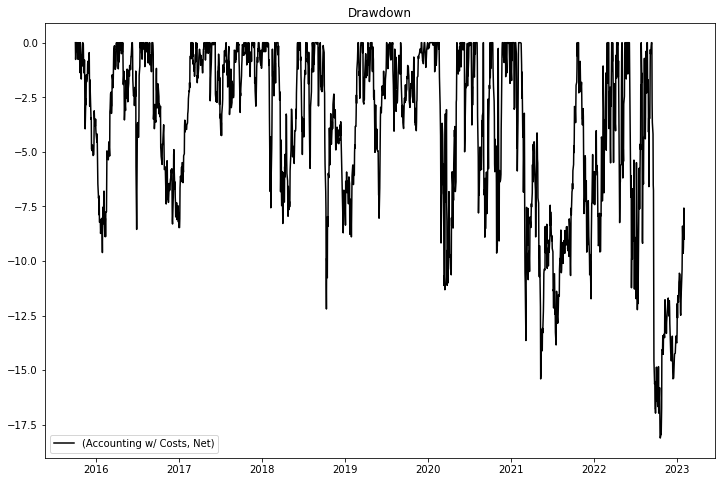

<Figure size 432x288 with 0 Axes>

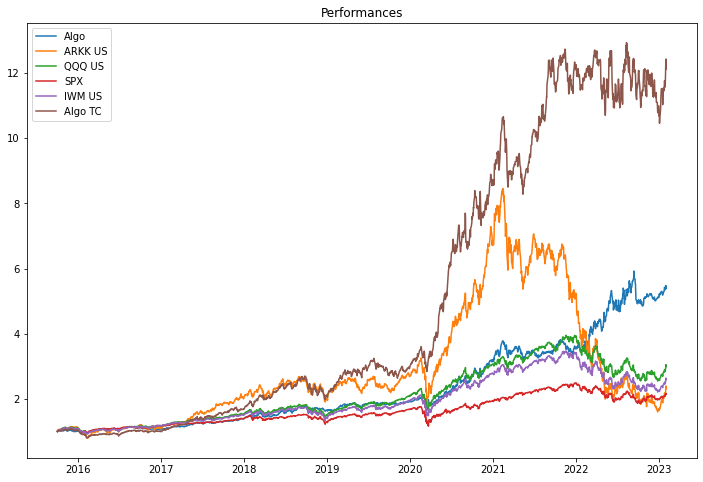

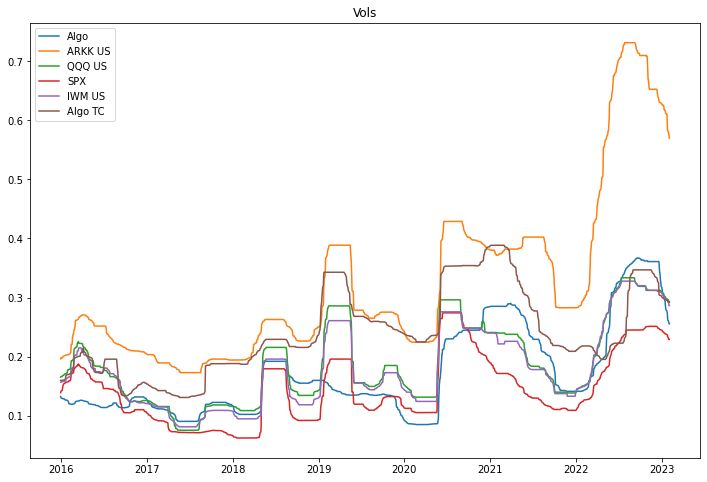

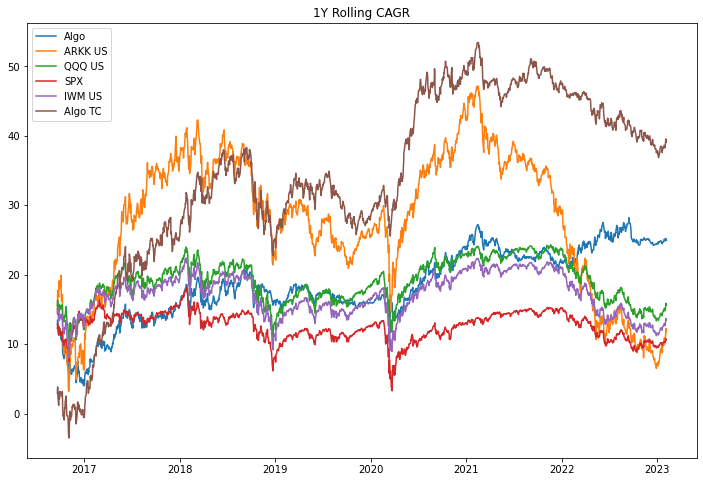

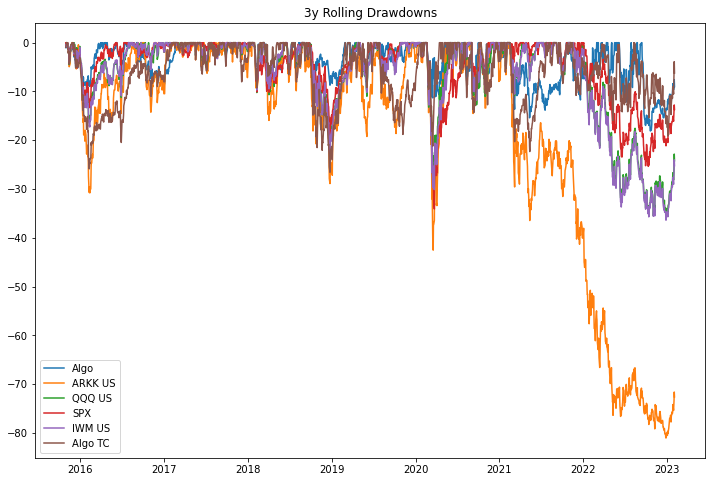

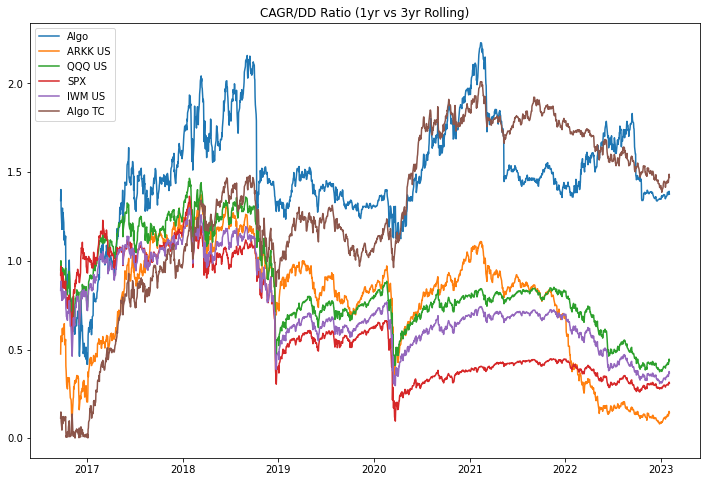

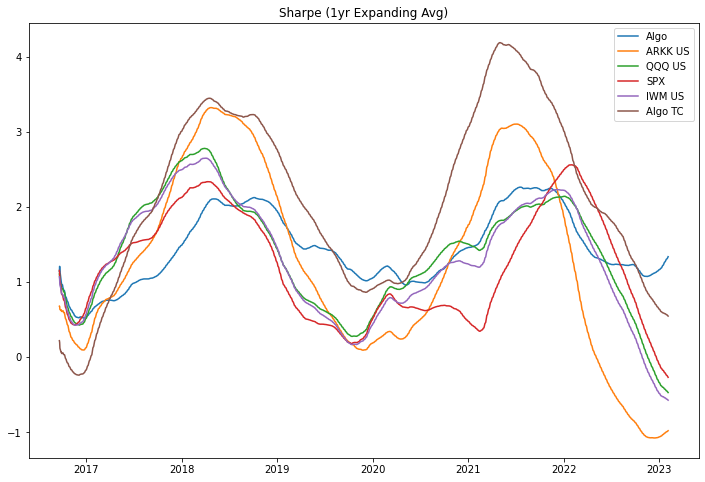

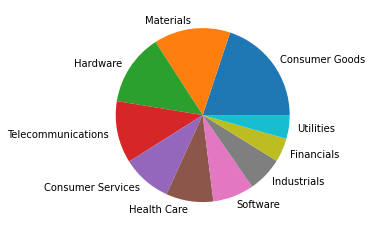

In [28]:
#%%writefile C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\new_algo_02.py

to_level1 = lambda x: x.split(',')[0][2:-1]
to_level2 = lambda x: x.split(',')[1][2:-2]
to_lsd = lambda x: current_long_sectors_df.loc[x, 'Last SR date']
to_norm = lambda x: sector_norm_df.loc[x]
to_stock_allocations = lambda x: (1 / current_long_sectors_df.loc[x, 'Number of Stocks'])
to_previous_px = lambda x: Prices_df.loc[previous_date, x] / Prices_df.loc[previous_date, ('USD' + FX_df.loc[x[-2:], 'Pair'])]
to_current_px = lambda x: Prices_df.loc[current_date, x] / Prices_df.loc[current_date, ('USD' + FX_df.loc[x[-2:], 'Pair'])]
to_previous_short_px = lambda x: Equiv_Indexes_df.loc[previous_date, x]
to_current_short_px = lambda x: Equiv_Indexes_df.loc[current_date, x]
to_last_sector_px = lambda x: Prices_df.loc[lsd_series[curr_allocations_stocks_df.T.columns.values.tolist().index(x)], x] / Prices_df.loc[lsd_series[curr_allocations_stocks_df.T.columns.values.tolist().index(x)], ('USD' + FX_df.loc[x[-2:], 'Pair'])] #.fillna(method = 'bfill')
to_ETF = lambda x: Equivalence_df.loc[current_date, x]
to_ISN = lambda x: Equivalence_SN_df.loc[prev_date, x]
to_previous_ETF = lambda x: Equivalence_df.loc[previous_date, x]
to_date = lambda x: datetime(x.year, x.month, x.day)
to_datetime = lambda x: x.date()

hedge_ratio = 1 / 2
init_short_ratio = 15 / 100
limit_short = 50 / 100

ETF_List = ['RWR US', 'XLB US', 'XLI US', 'XLY US', 'XLP US', 'XLE US',
       'XLF US', 'ARKK US', 'XLV US', 'QQQ US', 'IGV US', 'SMH US', 'SPX', 'IWM US', 'XLU US']
#Sectors_OUT_list = ['Telecommunications']
Sectors_OUT_list = []
Hedge_Instrument = 'SPX'

sectors = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Custom_Segmentation.csv")
Sectors_df = pd.DataFrame(sectors)
Sectors_df = Set_DF(Sectors_df)
Sectors_df = DD_Index(Sectors_df)

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)
Prices_df.sort_index(inplace = True)

query_fx = "SELECT * FROM fx_relation"
FX_df = pd.read_sql_query(query_fx, engine)
FX_df = Set_DF(FX_df)
FX_df = DD_Index(FX_df)

query_ls_summary = 'SELECT * FROM long_short_summary'
ls_summary_df = pd.read_sql_query(query_ls_summary, engine)
ls_summary_df.index = pd.Index(ls_summary_df[ls_summary_df.columns[-1]], name = 'Dates')
ls_summary_df.drop(['Dates'], axis = 1, inplace = True)
lev1_list = ls_summary_df.columns.map(to_level1).values.tolist()
lev2_list = ls_summary_df.columns.map(to_level2).values.tolist()
ls_summary_df.columns = [lev1_list, lev2_list]
start_date = ls_summary_df.index[0]

today = Prices_df.index[-1]
date_range = Prices_df[Prices_df.index >= start_date].index

query_eq = 'SELECT * FROM etf_equivalence_relation'    
Equivalence_df = pd.read_sql_query(query_eq, engine)
Equivalence_df = Set_DF(Equivalence_df)
Equivalence_df = DD_Index(Equivalence_df)
Equivalence_df = Equivalence_df[Equivalence_df.index >= start_date]

query_equiv_idx = 'SELECT * FROM equivalent_indexes_relation'    
Equiv_Indexes_df = pd.read_sql_query(query_equiv_idx, engine)
Equiv_Indexes_df = Set_DF(Equiv_Indexes_df)
Equiv_Indexes_df = DD_Index(Equiv_Indexes_df)
Equiv_Indexes_df = Equiv_Indexes_df[Equiv_Indexes_df.index >= start_date]

query_disc = 'SELECT * FROM discretionary_algo_perf'    
Disc_Algo_df = pd.read_sql_query(query_disc, engine)
Disc_Algo_df = Set_DF(Disc_Algo_df)
Disc_Algo_df = DD_Index(Disc_Algo_df)
Disc_Algo_df.loc[Disc_Algo_df.index[0], 'Algo TC'] = 1

ext = ''
ext_s = input("Slim Port (Y/N)? ").upper()
if (ext_s == 'Y'):
    ext = '_slim'

enable_shorts = False
shorts_str = input("Enable Shorts (Y/N)? ").upper()
if (shorts_str == 'Y'):
    enable_shorts = True
    
enable_hedges = False
hedges_str = input("Enable Hedges (Y/N)? ").upper()
if (hedges_str == 'Y'):
    enable_hedges = True

trading_fee = float(input("Trading fee (25): ")) / 10000

sectors_list = ls_summary_df['Sectors'].columns.values.tolist()
    
for sec_remove in Sectors_OUT_list:
    if (sec_remove in sectors_list):
        sectors_list.remove(sec_remove)
        Equivalence_df.drop(sec_remove, axis = 1, inplace = True)
    
for i in np.arange(40):
    Full_Portfolio_df['Positions Long', str(i)] = float(0)
    
for c in np.arange(10):
    Full_Portfolio_df['Positions Short', str(c)] = float(0)

Full_Portfolio_df['Positions Hedge'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Long'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Long Cash'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Short'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Short Cash'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Short Acct'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Hedge'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Hedge Cash'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Hedge Acct'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Costs'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Costs Acct'] = float(0)
Full_Portfolio_df['Accounting w/ Costs', 'Net'] = float(0)

if (not enable_shorts):
    ls_summary_df['Sectors'] = ls_summary_df['Sectors'].clip(0, 1)
    
if (not enable_hedges):
    ls_summary_df['Hedges'] = 0

date_list_df = ls_summary_df['Sectors'].copy()
date_list_df['Hedges'] = ls_summary_df['Hedges'].values
date_series = (len(date_list_df.columns) - (date_list_df == date_list_df.shift(1)).sum(axis = 1)).clip(0, 1)
full_rebalancing_dates = sorted(pd.unique(date_series[date_series == 1].index.values.tolist() + date_list_df.index[-2:].values.tolist()).tolist())    

trade_count = 0
count_sector = 0
count_full = 0
start_k = 1
total_accounted_shortcash = 0
total_accounted_hedgecash = 0
total_accounted_tradecost = 0

start_year = 0

try:
    Full_Portfolio_df.index = Full_Portfolio_df.T.columns.map(to_datetime)
except:
    pass

Full_Portfolio_df.sort_index(inplace = True)
dates_list = Full_Portfolio_df.index.values.tolist()

#cut_date = k_df['Sectors']['Telecommunications'][k_df['Sectors']['Telecommunications'] == 1].index[1]
#dates_list = pd.Series(dates_list)[pd.Series(dates_list) <= cut_date].tolist()

for idx, current_date in enumerate(dates_list):
    if (start_year != current_date.year):
        print(current_date.year)
    start_year = current_date.year
    previous_date = dates_list[dates_list.index(current_date) - 1]
    pla_array = np.zeros(40)
    psa_array = np.zeros(10)
    pln_list = []
    psn_list = []
    new_long_positions_list = []
    new_short_positions_list = []
    stock_trading_costs_long = 0
    sector_trading_costs_long = 0
    stock_trading_costs_short = 0
    sector_trading_costs_short = 0
    stock_trading_costs_hedge = 0
    trading_costs_hedge = 0
    total_trading_costs = 0
    current_trading_costs = 0
    current_long = 0
    current_long_cash = 0
    current_short = 0
    current_short_acct = 0
    current_hedge = 0
    current_hedge_acct = 0
    curr_hedge = 0
    prev_hedge = 0
    exposure = 0
    pln_count = 0
    cln_count = 0
    csn_count = 0
    net_new_short_cash = 0
    net_new_hedge_cash = 0
    short_ratio = init_short_ratio
    lfr_date = pd.Series(full_rebalancing_dates)[pd.Series(full_rebalancing_dates) <= current_date].tolist()[-1] 

    if (idx > 0):
        previous_long_sectors_df = current_long_sectors_df.copy()
        pln_series = Full_Portfolio_df['Longs'].iloc[idx - 1][Full_Portfolio_df['Longs'].iloc[idx - 1] != '']
        plp_series = Full_Portfolio_df['Positions Long'].iloc[idx - 1][Full_Portfolio_df['Positions Long'].iloc[idx - 1] != 0]
        plcp_array = pln_series.map(to_current_px).values
        pln_count = pln_series.count()
        if (pln_count > 0):
            current_long = (plp_series.values * plcp_array).sum()
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Long')] = current_long
        else:
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Long Cash')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Long Cash'] + Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Long']
            current_long_cash = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Long Cash')]
        
        Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Costs Acct')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Costs'] - total_accounted_tradecost
        total_trading_costs = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Costs Acct')]
            
        if (enable_shorts):
            psn_series = Full_Portfolio_df['Shorts'].iloc[idx - 1][Full_Portfolio_df['Shorts'].iloc[idx - 1] != '']
            psp_series = Full_Portfolio_df['Positions Short'].iloc[idx - 1][Full_Portfolio_df['Positions Short'].iloc[idx - 1] != 0]
            pscp_array = psn_series.map(to_current_short_px).values
            if (psn_series.count() > 0):
                Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Cash')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Short Cash']
                current_short = (psp_series.values * pscp_array).sum()
                Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short')] = current_short
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Cash')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Short Cash']
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Acct')] = current_short + Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Cash')] - total_accounted_shortcash
            current_short_acct = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Acct')]
                
        if (enable_hedges):
            phcp_scalar = Prices_df.loc[current_date, Hedge_Instrument]
            if (Full_Portfolio_df['Positions Hedge'].iloc[idx - 1] != 0):
                php_scalar = Full_Portfolio_df['Positions Hedge'].iloc[idx - 1]
                Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Cash')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Hedge Cash']
                current_hedge = php_scalar * phcp_scalar
                Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge')] = current_hedge
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Cash')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Hedge Cash']
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Acct')] = current_hedge + Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Cash')] - total_accounted_hedgecash
            current_hedge_acct = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Acct')]
                
        base_k = current_long + current_long_cash
        Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Net')] = base_k + current_short_acct + current_hedge_acct - total_trading_costs
    elif (idx == 0):
        cln_count = Full_Portfolio_df['Longs'].iloc[idx][Full_Portfolio_df['Longs'].iloc[idx] != ''].count()
        Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Net')] = start_k
        if (cln_count > 0):
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Long')] = 1
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Long Cash')] = 0
        else:
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Long')] = 0
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Long Cash')] = 1
        base_k = start_k

    cln_series = Full_Portfolio_df['Longs'].iloc[idx][Full_Portfolio_df['Longs'].iloc[idx] != '']
    cln_sectors_list = ls_summary_df.loc[lfr_date, 'Sectors'][ls_summary_df.loc[lfr_date, 'Sectors'] == 1].index.values.tolist()
    clcp_array = cln_series.map(to_current_px).values
    cln_count = cln_series.count()
    
    csn_series = Full_Portfolio_df['Shorts'].iloc[idx][Full_Portfolio_df['Shorts'].iloc[idx] != '']
    cscp_array = csn_series.map(to_current_short_px).values
    csn_count = csn_series.count()
    
    chcp_scalar = Prices_df.loc[current_date, Hedge_Instrument]
    
    stocks_list = []
    sector_map_list = []
    current_long_sectors_df = pd.DataFrame(np.nan, index = pd.Index(cln_sectors_list, name = 'Sectors'), columns = ['Last SR date', 'Reset Sector', 'Number of Stocks'])
    current_long_sectors_df['Stocks List'] = ''
    if (cln_count > 0):
        for current_sector in cln_sectors_list:
            portfolio_string = re.sub(r'[^a-z_^0-9]', '', current_sector.lower()) + '_portfolio_selection' + ext
            query_index_port = 'SELECT * FROM ' + portfolio_string  
            sector_portfolio_df = pd.read_sql_query(query_index_port, engine)
            sector_portfolio_df.index = pd.Index(sector_portfolio_df[sector_portfolio_df.columns[-1]], name = 'Date')
            sector_index_series = sector_portfolio_df[sector_portfolio_df.columns[-2]]
            sector_portfolio_df.drop(['Date', sector_portfolio_df.columns[-1], sector_portfolio_df.columns[-2]], axis = 1, inplace = True)
            lev1_list = sector_portfolio_df.columns.map(to_level1).values.tolist()
            lev2_list = sector_portfolio_df.columns.map(to_level2).values.tolist()
            sector_portfolio_df.columns = [lev1_list, lev2_list]
            sector_portfolio_df['Index'] = sector_index_series
            sector_portfolio_df.sort_index(inplace = True)
            found_sector_date = True
            csd = current_date
            psd = csd
            while (csd > sector_portfolio_df.index[0]) & (found_sector_date):
                psd = sector_portfolio_df.index[sector_portfolio_df.index.values.tolist().index(csd) - 1]
                if (sector_portfolio_df.loc[csd, 'Stocks'].values.tolist() != sector_portfolio_df.loc[psd, 'Stocks'].values.tolist()):
                    found_sector_date = False
                else:
                    csd = psd 
            stocks_list = stocks_list + sector_portfolio_df.loc[current_date, 'Stocks'][sector_portfolio_df.loc[current_date, 'Stocks'] != ''].values.tolist()
            sector_map_list = sector_map_list + [current_sector] * sector_portfolio_df.loc[current_date, 'Stocks'][sector_portfolio_df.loc[current_date, 'Stocks'] != ''].count()
            for stock_add in sector_portfolio_df.loc[psd, 'Stocks'][sector_portfolio_df.loc[psd, 'Stocks'] != ''].values.tolist():
                if (stock_add not in stocks_list):
                    stocks_list.append(stock_add)
                    sector_map_list.append(current_sector)
            current_long_sectors_df.loc[current_sector, 'Last SR date'] = csd
            current_long_sectors_df.loc[current_sector, 'Reset Sector'] = 0
            current_long_sectors_df.loc[current_sector, 'Number of Stocks'] = sector_portfolio_df.loc[current_date, 'Stocks'][sector_portfolio_df.loc[current_date, 'Stocks'] != ''].count()
            current_long_sectors_df.at[current_sector, 'Stocks List'] = sector_portfolio_df.loc[current_date, 'Stocks'][sector_portfolio_df.loc[current_date, 'Stocks'] != ''].values.tolist()
            if (current_date == csd):
                current_long_sectors_df.loc[current_sector, 'Reset Sector'] = 1 / sector_portfolio_df.loc[current_date][sector_portfolio_df.loc[current_date] != '']['Stocks'].count()
        
    if (csn_count > 0) & (enable_shorts) & (current_date not in full_rebalancing_dates):
        current_shorts_array = csn_series.values
        current_shorts_ETF_array = csn_series.map(to_ETF).values
        short_allocations_stocks_df = pd.DataFrame(np.nan, index = current_shorts_array, columns = ['Delta Traded'])
        for k, current_short_ETF in enumerate(current_shorts_ETF_array):
            if (psn_series.map(to_previous_ETF).values[k] == current_short_ETF):
                short_allocations_stocks_df.loc[current_shorts_array[k], 'Delta Traded'] = 0
            else:
                short_allocations_stocks_df.loc[current_shorts_array[k], 'Delta Traded'] = 2 * psp_series.values[k] * cscp_array[k] 
        sector_trading_costs_short = abs(short_allocations_stocks_df['Delta Traded'].sum()) * trading_fee
        current_trading_costs = current_trading_costs + sector_trading_costs_short
        if (sector_trading_costs_short > 0):
            count_sector = count_sector + 1
                                        
    if (current_date in current_long_sectors_df['Last SR date'].values) & (current_date not in full_rebalancing_dates):
        ###('SECTOR REB')
        
        count_sector = count_sector + 1
        if (cln_count > 0):
            sectors_short_list = current_long_sectors_df[current_long_sectors_df['Reset Sector'] != 0].index.values.tolist()
            prev_stocks_df = pd.DataFrame(plp_series.values * plcp_array, index = pln_series.values, columns = ['Allocations d-1'])
            prev_stocks_list = []
            prev_sectors_list = []
            for prev_sector in previous_long_sectors_df.index:
                prev_stocks_list = prev_stocks_list + previous_long_sectors_df.loc[prev_sector, 'Stocks List']
                prev_sectors_list = prev_sectors_list + [prev_sector] * len(previous_long_sectors_df.loc[prev_sector, 'Stocks List'])
            prev_allocations_stocks_df = pd.DataFrame({'Sector': prev_sectors_list}, index = pd.Index(prev_stocks_list, name = 'Stocks'))
            prev_allocations_stocks_df['Allocations d-1'] = prev_stocks_df['Allocations d-1'].values
            prev_allocations_stocks_df['Allocations d-1'] = prev_allocations_stocks_df['Allocations d-1'] / prev_allocations_stocks_df['Sector'].map(lambda x: prev_allocations_stocks_df.groupby(prev_allocations_stocks_df['Sector']).sum().loc[x, 'Allocations d-1'])
            prev_stocks_df['Sector'] = prev_allocations_stocks_df['Sector'].values
            cur_stocks_list = []
            cur_sectors_list = []
            for curr_sector in current_long_sectors_df.index:
                cur_stocks_list = cur_stocks_list + current_long_sectors_df.loc[curr_sector, 'Stocks List']
                cur_sectors_list = cur_sectors_list + [curr_sector] * len(current_long_sectors_df.loc[curr_sector, 'Stocks List'])
            curr_allocations_stocks_df = pd.DataFrame({'Sector': cur_sectors_list}, index = pd.Index(cur_stocks_list, name = 'Stocks'))
            curr_allocations_stocks_df['Allocations d0'] = np.nan

            prev_allocations_stocks_df['Dummy'] = prev_allocations_stocks_df.index 
            curr_allocations_stocks_df['Dummy'] = curr_allocations_stocks_df.index
            prev_allocations_stocks_df.index = prev_allocations_stocks_df['Dummy'] + '-' + prev_allocations_stocks_df['Sector']
            curr_allocations_stocks_df.index = curr_allocations_stocks_df['Dummy'] + '-' + curr_allocations_stocks_df['Sector']

            for j, new_sector in enumerate(curr_allocations_stocks_df['Sector']):
                new_stock = curr_allocations_stocks_df.index[j]
                if (new_sector in sectors_short_list):
                    curr_allocations_stocks_df.loc[new_stock, 'Allocations d0'] = current_long_sectors_df.loc[new_sector, 'Reset Sector']
                else:
                    curr_allocations_stocks_df.loc[new_stock, 'Allocations d0'] = prev_allocations_stocks_df.loc[new_stock, 'Allocations d-1']

            compact_prev_df = pd.DataFrame(prev_allocations_stocks_df.T.groupby(prev_allocations_stocks_df.T.columns, axis = 1).sum().T['Allocations d-1'])
            compact_curr_df = pd.DataFrame(curr_allocations_stocks_df.T.groupby(curr_allocations_stocks_df.T.columns, axis = 1).sum().T['Allocations d0'])
            merge_allocations_df = pd.merge(compact_prev_df, compact_curr_df, left_index = True, right_index = True, how = 'outer').fillna(0)
            sector_allocations_series = merge_allocations_df.T.columns.map(lambda x: prev_stocks_df.groupby(prev_stocks_df['Sector']).sum().loc[x.split('-')[-1], 'Allocations d-1']).values
            sector_trading_costs_long = (abs(merge_allocations_df['Allocations d0'] - merge_allocations_df['Allocations d-1']).values * sector_allocations_series).sum() * trading_fee
            curr_allocations_stocks_df.index = curr_allocations_stocks_df['Dummy']
            curr_allocations_stocks_df.drop(['Dummy'], axis = 1, inplace = True)
            clcp_array = curr_allocations_stocks_df.T.columns.map(to_current_px).values
            sector_allocations_series = curr_allocations_stocks_df['Sector'].map(lambda x: prev_stocks_df.groupby(prev_stocks_df['Sector']).sum().loc[x, 'Allocations d-1']).values
            new_deltas_array = curr_allocations_stocks_df['Allocations d0'].values * sector_allocations_series
            new_long_positions_list = (new_deltas_array / clcp_array).tolist()            
            
        
        current_trading_costs = current_trading_costs + sector_trading_costs_long
        
        Full_Portfolio_df.loc[current_date, 'Longs'] = curr_allocations_stocks_df.index.values.tolist() + [''] * (40 - len(curr_allocations_stocks_df.index))
        Full_Portfolio_df.loc[current_date, 'Positions Long'] = new_long_positions_list + [0] * (40 - len(clcp_array))
        Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Costs')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Costs'] + current_trading_costs
        if (enable_shorts):
            Full_Portfolio_df.loc[current_date, 'Positions Short'] = Full_Portfolio_df.iloc[idx - 1]['Positions Short'].values
        if (enable_hedges):
            Full_Portfolio_df.loc[current_date, 'Positions Hedge'] = Full_Portfolio_df.iloc[idx - 1]['Positions Hedge'].values

    elif (current_date in full_rebalancing_dates):
        ###('FULL REB')
        
        base_k = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Net')]
        count_full = count_full + 1
        cur_stocks_list = []
        cur_sectors_list = []
        for curr_sector in current_long_sectors_df.index:
            cur_stocks_list = cur_stocks_list + current_long_sectors_df.loc[curr_sector, 'Stocks List']
            cur_sectors_list = cur_sectors_list + [curr_sector] * len(current_long_sectors_df.loc[curr_sector, 'Stocks List'])

        curr_allocations_stocks_df = pd.DataFrame({'Sector': cur_sectors_list}, index = pd.Index(cur_stocks_list, name = 'Stocks'))
        
        if (len(current_long_sectors_df.index) > 0):
            curr_allocations_stocks_df['Sector Weights'] = (1 / len(current_long_sectors_df.index))
            clcp2_array = curr_allocations_stocks_df.T.columns.map(to_current_px).values
            lsd_series = curr_allocations_stocks_df['Sector'].map(to_lsd)
            cllrp_array = curr_allocations_stocks_df.T.columns.map(to_last_sector_px).values
            stock_adj_array = (clcp2_array / cllrp_array)
            curr_allocations_stocks_df['Stock Weights'] = (1 / curr_allocations_stocks_df['Sector'].map(lambda x: current_long_sectors_df.loc[x, 'Number of Stocks']))
            curr_allocations_stocks_df['Stock Weights'] = curr_allocations_stocks_df['Stock Weights'] * stock_adj_array
            sector_norm_df = curr_allocations_stocks_df.groupby(['Sector'], axis = 0).sum()['Stock Weights']
            curr_allocations_stocks_df['Stock Weights'] = curr_allocations_stocks_df['Stock Weights'] / curr_allocations_stocks_df['Sector'].map(to_norm)
            curr_allocations_stocks_df['Allocations d0'] = curr_allocations_stocks_df['Sector Weights'] * curr_allocations_stocks_df['Stock Weights']
        else:
            curr_allocations_stocks_df['Allocations d0'] = 0

        if (idx > 0) & (pln_count > 0):
            prev_allocations_array = plp_series.values * plcp_array / (plp_series.values * plcp_array).sum()  
            prev_allocations_stocks_df = pd.DataFrame(prev_allocations_array, index = pln_series.values, columns = ['Allocations d-1'])
        else:
            prev_allocations_stocks_df = pd.DataFrame(0, index = cln_series.values, columns = ['Allocations d-1'])
            
        clcp_array = curr_allocations_stocks_df.T.columns.map(to_current_px).values
        merge_allocations_df = pd.merge(prev_allocations_stocks_df.groupby(prev_allocations_stocks_df.index).sum(), curr_allocations_stocks_df.groupby(curr_allocations_stocks_df.index).sum()['Allocations d0'], left_index = True, right_index = True, how = 'outer').fillna(0)
        stock_trading_costs_long = (abs(merge_allocations_df['Allocations d0'] - merge_allocations_df['Allocations d-1']).values * base_k).sum() * trading_fee
        new_long_positions_list = (base_k * curr_allocations_stocks_df['Allocations d0'].values / clcp_array).tolist()
        
        Full_Portfolio_df.loc[current_date, 'Longs'] = curr_allocations_stocks_df.index.values.tolist() + [''] * (40 - len(curr_allocations_stocks_df.index))
        Full_Portfolio_df.loc[current_date, 'Positions Long'] = new_long_positions_list + [0] * (40 - len(clcp_array))
        
        if (enable_shorts):
            if (csn_count > 0):
                short_ratio = - min(init_short_ratio, limit_short / csn_count)
            currs_allocations_stocks_df = pd.DataFrame(short_ratio, index = csn_series.values, columns = ['Allocations d0'])
            if (idx > 0):
                prevs_deltas_array = psp_series.values * psn_series.map(to_current_short_px).values
                prevs_allocations_array = prevs_deltas_array / base_k
                prevs_allocations_stocks_df = pd.DataFrame(prevs_allocations_array, index = psn_series.values, columns = ['Allocations d-1'])
            else:
                prevs_allocations_stocks_df = pd.DataFrame(0, index = csn_series.values, columns = ['Allocations d-1'])
            merge_allocations_df = pd.merge(prevs_allocations_stocks_df, currs_allocations_stocks_df, left_index = True, right_index = True, how = 'outer').fillna(0)
            stock_trading_costs_short = (abs(merge_allocations_df['Allocations d0'] - merge_allocations_df['Allocations d-1']).values * base_k).sum() * trading_fee
            new_short_positions_list = (base_k * currs_allocations_stocks_df['Allocations d0'].values / cscp_array).tolist()
            net_new_short_cash = (merge_allocations_df['Allocations d-1'] - merge_allocations_df['Allocations d0']).sum() * base_k
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Cash')] = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Cash')] + net_new_short_cash
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short')] = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short')] - net_new_short_cash
            Full_Portfolio_df.loc[current_date, 'Positions Short'] = new_short_positions_list + [0] * (10 - len(cscp_array))
            
        if (enable_hedges):
            exposure = (cln_count.clip(0, 1) + (csn_count * short_ratio)) * base_k
            if (ls_summary_df.loc[current_date, 'Hedges'][0] == 1) & (exposure > 0):
                curr_hedge = - exposure * hedge_ratio
            if (idx > 0):
                prev_hedge = Full_Portfolio_df.iloc[idx - 1]['Positions Hedge'][0] * phcp_scalar
            net_new_hedge_cash = prev_hedge - curr_hedge
            new_hedge_position_scalar = curr_hedge / chcp_scalar
            stock_trading_costs_hedge = abs(net_new_hedge_cash) * trading_fee
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Cash')] = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Cash')] + net_new_hedge_cash
            Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge')] = Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge')] - net_new_hedge_cash
            Full_Portfolio_df.loc[current_date, 'Positions Hedge'] = new_hedge_position_scalar
            
        current_trading_costs = current_trading_costs + stock_trading_costs_long + stock_trading_costs_short + stock_trading_costs_hedge
        Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Costs')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Costs'] + current_trading_costs
        total_accounted_shortcash = total_accounted_shortcash + Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Short Acct')]
        total_accounted_hedgecash = total_accounted_hedgecash + Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Hedge Acct')]
        total_accounted_tradecost = total_accounted_tradecost + Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Costs Acct')]
     
    else:
        ###('NOTHING')
        Full_Portfolio_df.loc[current_date, 'Longs'] = Full_Portfolio_df.iloc[idx - 1]['Longs'].values
        Full_Portfolio_df.loc[current_date, 'Positions Long'] = Full_Portfolio_df.iloc[idx - 1]['Positions Long'].values
        Full_Portfolio_df.loc[current_date, 'Positions Short'] = Full_Portfolio_df.iloc[idx - 1]['Positions Short'].values
        Full_Portfolio_df.loc[current_date, 'Positions Hedge'] = Full_Portfolio_df.iloc[idx - 1]['Positions Hedge'].values
        Full_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Costs')] = Full_Portfolio_df.iloc[idx - 1]['Accounting w/ Costs', 'Costs']

print('')
print('Full Rebalancings: ' + str(count_full))
print('Sector Rebalancings: ' + str(count_sector))
print('Pct Rebalancings: ' + str(round(100 * (count_full + count_sector) / len(Full_Portfolio_df.index), 2)) + '%')
print('Pct Hedged: ' + str(round(100 * Full_Portfolio_df['Hedges'].value_counts().loc['SPX'] / len(Full_Portfolio_df.index), 2)))
print('')

Full_Portfolio_df.index = Full_Portfolio_df['Accounting w/ Costs'].T.columns.map(to_date)
FP_Resampled_df = Full_Portfolio_df['Accounting w/ Costs', 'Net'].resample('Y').last()
FP_Resampled_df = FP_Resampled_df.fillna(method = 'ffill')
FP_Resampled_df.loc[datetime(start_date.year, start_date.month, start_date.day)] = 1
FP_Resampled_df.sort_index(inplace = True)
Summary_Table = round(100 * FP_Resampled_df.pct_change().dropna(), 2)

Summary_df = pd.DataFrame(Summary_Table.values, index = Summary_Table.index, columns = ['Yearly Performance'])
Vol_Series = (Full_Portfolio_df['Accounting w/ Costs', 'Net'].pct_change().rolling(126).std() * np.sqrt(252) * 100).resample('Y').mean()
Vol_Series.name = 'Annual Vol'
DD_Series = abs(100 * ((Full_Portfolio_df['Accounting w/ Costs', 'Net'] - Full_Portfolio_df['Accounting w/ Costs', 'Net'].expanding().max()) / Full_Portfolio_df['Accounting w/ Costs', 'Net'].expanding().max()).resample('Y').min())
DD_Series.name = 'Max Yearly Drawdown'
Summary_df = Summary_df.join(round(Vol_Series, 2))
Summary_df = Summary_df.join(round(DD_Series, 2))
Summary_df = Summary_df.fillna(method = 'ffill')
Summary_df['Annual Sharpe'] = round(Summary_df['Yearly Performance'] / Summary_df['Annual Vol'], 2)
Summary_df['Annual CAGR/DD'] = round(Summary_df['Yearly Performance'] / Summary_df['Max Yearly Drawdown'], 2)
print(Summary_df)

CAGR = round(100 * ((Full_Portfolio_df['Accounting w/ Costs', 'Net'][-1] / Full_Portfolio_df['Accounting w/ Costs', 'Net'][0]) ** (252 / len(Full_Portfolio_df.index)) - 1), 2)
Max_DD = abs(round(100 * min(((Full_Portfolio_df['Accounting w/ Costs', 'Net'] - Full_Portfolio_df['Accounting w/ Costs', 'Net'].expanding().max()) / Full_Portfolio_df['Accounting w/ Costs', 'Net'].expanding().max())), 2))
Golden_Ratio = round(CAGR / Max_DD, 2)
Full_Portfolio_df.index = Full_Portfolio_df.T.columns.map(lambda x: x.date)

##### DAILY TRADES

Trade_Portfolio_df = Full_Portfolio_df[Full_Portfolio_df.index <= current_date].copy()
Current_DD = abs(round(100 * (Trade_Portfolio_df.loc[current_date, ('Accounting w/ Costs', 'Net')] / Trade_Portfolio_df['Accounting w/ Costs', 'Net'].max() - 1), 2))
previous_date = Trade_Portfolio_df.index[-2]
long_series_prev = Trade_Portfolio_df.iloc[-2]['Longs'][Trade_Portfolio_df.iloc[-2]['Longs'] != '']
long_series_curr = Trade_Portfolio_df.iloc[-1]['Longs'][Trade_Portfolio_df.iloc[-1]['Longs'] != '']
short_series_prev = Trade_Portfolio_df.iloc[-2]['Shorts'][Trade_Portfolio_df.iloc[-2]['Shorts'] != ''].map(to_previous_ETF)
short_series_curr = Trade_Portfolio_df.iloc[-1]['Shorts'][Trade_Portfolio_df.iloc[-1]['Shorts'] != ''].map(to_ETF)
long_alloc_prev = Trade_Portfolio_df.iloc[-2]['Positions Long'][Trade_Portfolio_df.iloc[-2]['Positions Long'] != 0]
long_alloc_curr = Trade_Portfolio_df.iloc[-1]['Positions Long'][Trade_Portfolio_df.iloc[-1]['Positions Long'] != 0]
short_alloc_prev = Trade_Portfolio_df.iloc[-2]['Positions Short'][Trade_Portfolio_df.iloc[-2]['Positions Short'] != 0]
short_alloc_curr = Trade_Portfolio_df.iloc[-1]['Positions Short'][Trade_Portfolio_df.iloc[-1]['Positions Short'] != 0]

short_alloc_prev_array = short_alloc_prev.values * Trade_Portfolio_df.iloc[-2]['Shorts'][Trade_Portfolio_df.iloc[-2]['Shorts'] != ''].map(to_previous_short_px).values / short_series_prev.map(to_previous_px).values
short_alloc_curr_array = short_alloc_curr.values * Trade_Portfolio_df.iloc[-1]['Shorts'][Trade_Portfolio_df.iloc[-1]['Shorts'] != ''].map(to_current_short_px).values / short_series_curr.map(to_current_px).values

consolidated_list = list(pd.unique(long_series_prev.values.tolist() + long_series_curr.values.tolist() + short_series_prev.values.tolist() + short_series_curr.values.tolist()))
trades_df = pd.DataFrame(np.nan, index = pd.Index(consolidated_list, name = 'Stocks'), columns = ['Dummy'])
long_prev_df = pd.DataFrame(long_alloc_prev.values, index = long_series_prev.values, columns = ['Previous Allocations'])
long_curr_df = pd.DataFrame(long_alloc_curr.values, index = long_series_curr.values, columns = ['Current Allocations'])
short_prev_df = pd.DataFrame(short_alloc_prev_array, index = short_series_prev.values, columns = ['Previous Allocations S'])
short_curr_df = pd.DataFrame(short_alloc_curr_array, index = short_series_curr.values, columns = ['Current Allocations S'])
trades_df = trades_df.join(long_prev_df).join(long_curr_df).join(short_prev_df).join(short_curr_df)

trades_df.drop(['Dummy'], axis = 1, inplace = True)
trades_df = trades_df.replace({np.nan: 0}) * start_k
grouped_trades_df = trades_df.T.groupby(trades_df.index, axis = 1).sum().T

Final_Trades_df = pd.DataFrame(np.nan, index = trades_df.index, columns = ['Long Trades', 'Short Trades'])
Final_Trades_df['Long Trades'] = grouped_trades_df['Current Allocations'] - grouped_trades_df['Previous Allocations']
Final_Trades_df['Short Trades'] = grouped_trades_df['Current Allocations S'] - grouped_trades_df['Previous Allocations S']

print('')
print('CAGR: ' + str(CAGR))
print('Max Drawdown: ' + str(Max_DD))
print('Current Drawdown: ' + str(Current_DD))
print('CAGR/DD Ratio: ' + str(Golden_Ratio))
print('Daily P&L: ' + str(round(100 * (Full_Portfolio_df['Accounting w/ Costs', 'Net'][-1] / Full_Portfolio_df['Accounting w/ Costs', 'Net'][-2] - 1), 2)) + '%')
print('')
print('MEDIAN METRICS:')
print(Summary_df.median())
print('')
print('MEAN METRICS:')
print(Summary_df.mean())
print('')
print('Day Trades:')
print(Final_Trades_df)

Summary_df = pd.DataFrame(Full_Portfolio_df['Accounting w/ Costs', 'Net'].values, index = Full_Portfolio_df.index, columns = ['Algo'])
Summary_df = Summary_df.join(Prices_df['ARKK US']).join(Prices_df['QQQ US']).join(Prices_df['SPX']).join(Prices_df['IWM US']).join(Disc_Algo_df['Algo TC'])
Summary_df = Summary_df / Summary_df.iloc[0]

plt.figure(0)
DD_Series_Daily = 100 * ((Full_Portfolio_df['Accounting w/ Costs', 'Net'] - Full_Portfolio_df['Accounting w/ Costs', 'Net'].expanding().max()) / Full_Portfolio_df['Accounting w/ Costs', 'Net'].expanding().max())
DD_Series_Daily.plot(title = 'Drawdown', figsize = (12, 8), c = 'k').legend(loc = 'best')
plt.figure(1)
Summary_df.plot(title = 'Performances', figsize = (12, 8)).legend(loc = 'best')
plt.figure(2)
Volatilities_df = (Summary_df.pct_change().rolling(42).std() * np.sqrt(252)).dropna().rolling(126, min_periods = 21).median().dropna()
Volatilities_df.plot(title = 'Vols', figsize = (12, 8)).legend(loc = 'best')
plt.figure(3)
Rolling_CAGR_df = pd.DataFrame(100 * ((np.array(Summary_df.T) ** (252 / (np.arange(len(Summary_df.index)) + 1))).T - 1), index = Summary_df.index, columns = Summary_df.columns)[252:]
Rolling_CAGR_df.plot(title = '1Y Rolling CAGR', figsize = (12, 8)).legend(loc = 'best')
plt.figure(4)
Rolling_DD_df = 100 * (Summary_df / Summary_df.rolling(756, min_periods = 21).max() - 1)
Rolling_DD_df.plot(title = '3y Rolling Drawdowns', figsize = (12, 8)).legend(loc = 'best')
plt.figure(5)
CAGR_DD_Ratio_df = abs(Rolling_CAGR_df / Rolling_DD_df.expanding().min()).dropna()
CAGR_DD_Ratio_df.plot(title = 'CAGR/DD Ratio (1yr vs 3yr Rolling)', figsize = (12, 8)).legend(loc = 'best')
plt.figure(6)
Sharpe_df = ((Summary_df / Summary_df.shift(252) - 1).dropna() / Volatilities_df).dropna().rolling(252, min_periods = 1).mean()
Sharpe_df.plot(title = 'Sharpe (1yr Expanding Avg)', figsize = (12, 8)).legend(loc = 'best')

print('')
print('1Y Perf Max/Min Ratio')
print(abs((Summary_df / Summary_df.shift(252) - 1).dropna().max() / (Summary_df / Summary_df.shift(252) - 1).dropna().min()))

print('')
print('Average Vols')
print(round(100 * Volatilities_df.mean(), 2))

print('')
print('Average CAGR')
print(round(Rolling_CAGR_df.mean(), 2))

print('')
print('Average Drawdowns')
print(round(Rolling_DD_df.mean(), 2))

print('')
print('Max Drawdowns')
print(round(Rolling_DD_df.min(), 2))

print('')
print('Average CAGR/DD')
print(round(CAGR_DD_Ratio_df.mean(), 2))

print('')
print('Min CAGR/DD')
print(round(CAGR_DD_Ratio_df.min(), 2))

print('')
print('Average Sharpe')
print(round(Sharpe_df.mean(), 2))
print('')

Summary_df.index = Summary_df.T.columns.map(to_date)
Summary_df.sort_index(inplace = True)
Summary_df.loc[Summary_df.index[0] - timedelta(365)] = 1
Summary_Y_df = Summary_df.resample('Y').last()
Summary_Perf_Y_df = round((100 * Summary_Y_df.pct_change().dropna()), 2)
print('Yearly Performances:')
print(Summary_Perf_Y_df)
print('')
print('Performance Median:')
print(round(Summary_Perf_Y_df.median(), 2))
print('')
print('Average performances:')
print(round(Summary_Perf_Y_df.mean(), 2))
print('')
print('Performance Deviation:')
print(round(Summary_Perf_Y_df.std(), 2))

print('')
Sector_Sum_df = pd.DataFrame(0, index = Full_Portfolio_df.index, columns = ['Dummy'])
Sector_Sum_df = Sector_Sum_df.join(ls_summary_df['Sectors'])
Sector_Sum_df.drop(['Dummy'], axis = 1, inplace = True)
Sector_Sum_df.fillna(method = 'ffill', inplace = True)
Sector_Summary_df = pd.DataFrame(Sector_Sum_df.sum().sort_values(ascending = False), columns = ['Absolute'])
Sector_Summary_df['Relative'] = round(100 * Sector_Summary_df['Absolute'] / Sector_Summary_df['Absolute'].sum(), 2)

plt.figure(8)
plt.pie(Sector_Summary_df['Relative'][Sector_Summary_df['Relative'] > 0], labels = Sector_Summary_df['Relative'][Sector_Summary_df['Relative'] > 0].index)
print('# OF SECTOR APPEARANCES:')
print('')
print(Sector_Summary_df)

USD_Prices_df = pd.DataFrame(np.array(Prices_df[pd.unique(Full_Portfolio_df['Longs'].iloc[-2][Full_Portfolio_df['Longs'].iloc[-2] != ''].values.tolist())]) / np.array(Prices_df['USD' + Prices_df[pd.unique(Full_Portfolio_df['Longs'].iloc[-2][Full_Portfolio_df['Longs'].iloc[-2] != ''].values.tolist())].columns.map(lambda x: x[-2:]).map(lambda x: FX_df.loc[x, 'Pair'])]), index = Prices_df.index, columns = Prices_df[pd.unique(Full_Portfolio_df['Longs'].iloc[-2][Full_Portfolio_df['Longs'].iloc[-2] != ''].values.tolist())].columns)
current_date = Full_Portfolio_df.index[-2]
cash_allocations = Full_Portfolio_df['Positions Long'].iloc[-2][Full_Portfolio_df['Positions Long'].iloc[-2] != 0] * Full_Portfolio_df['Longs'].iloc[-2][Full_Portfolio_df['Longs'].iloc[-2] != ''].map(to_current_px)
relative_allocations = round(100 * cash_allocations / cash_allocations.sum(), 2)
relative_allocations_df = pd.DataFrame(relative_allocations.values, index = pd.Index(Full_Portfolio_df['Longs'].iloc[-2][Full_Portfolio_df['Longs'].iloc[-2] != ''].values, name = 'Stocks'), columns = ['Allocation'])
relative_allocations_df = relative_allocations_df.join(round(100 * USD_Prices_df[pd.unique(relative_allocations_df.index.values.tolist())].pct_change().iloc[-1], 2))
relative_allocations_df['Contributions'] = round(relative_allocations_df['Allocation'] * relative_allocations_df[relative_allocations_df.columns[-1]] / 100, 2)

cash_allocations_short = Full_Portfolio_df['Positions Short'].iloc[-2][Full_Portfolio_df['Positions Short'].iloc[-2] != 0] * Full_Portfolio_df['Shorts'].iloc[-2][Full_Portfolio_df['Shorts'].iloc[-2] != ''].map(to_current_short_px)
relative_allocations_short = round(100 * cash_allocations_short / cash_allocations.sum(), 2)
relative_allocations_short_df = pd.DataFrame(relative_allocations_short.values, index = pd.Index(Full_Portfolio_df['Shorts'].iloc[-2][Full_Portfolio_df['Shorts'].iloc[-2] != ''].map(to_ETF).values, name = 'Stocks'), columns = ['Allocation'])
relative_allocations_short_df = relative_allocations_short_df.join(round(100 * Prices_df[pd.unique(relative_allocations_short_df.index.values.tolist())].pct_change().iloc[-1], 2))
relative_allocations_short_df['Contributions'] = round(relative_allocations_short_df['Allocation'] * relative_allocations_short_df[relative_allocations_short_df.columns[-1]] / 100, 2)

relative_allocations_full_df = pd.concat([relative_allocations_df, relative_allocations_short_df])

if (Full_Portfolio_df['Hedges'].iloc[-1] != ''):
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1]] = np.nan
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], 'Allocation'] = round(100 * (Full_Portfolio_df['Positions Hedge'].iloc[-1] * Prices_df.iloc[-1][Full_Portfolio_df['Hedges'].iloc[-1]]) / cash_allocations.sum(), 2)
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], today] = round(100 * Prices_df[Full_Portfolio_df['Hedges'].iloc[-1]].pct_change()[-1], 2)
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], 'Contributions'] = round(relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], 'Allocation'] * relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], today] / 100, 2)

relative_allocations_full_df.loc['Costs'] = ''
relative_allocations_full_df.loc['Costs', 'Contributions'] = - round(100 * (total_trading_costs / Full_Portfolio_df['Accounting w/ Costs'][-10:]['Net'][-1]), 2)
relative_allocations_full_df.loc['Costs', 'Allocation'] = 0
relative_allocations_full_df.loc[''] = 0
relative_allocations_full_df.loc['Totals'] = relative_allocations_full_df.sum()
relative_allocations_full_df.loc['Totals', today] = ''
relative_allocations_full_df.loc['Costs', 'Allocation'] = ''
relative_allocations_full_df.loc[''] = ''

print('')
print('Daily Summary')
print(relative_allocations_full_df)
print('')

Full_Portfolio_df['Accounting w/ Costs'] = round(Full_Portfolio_df['Accounting w/ Costs'], 3)
Full_Portfolio_df['Accounting w/ Costs'][-10:]

In [ ]:
7.27 8.09 13.20 14.16
6.59 7.01 7.75 8.22 9.72

In [ ]:
36.64 34.15  +/- 38.77           40.40  35.86 +/- 46.57       51.14 46.65 +/- 28.40        52.80 49.55 +/- 31.42  

In [ ]:
SHARPE AVG 1.70 1.67 1.92 2.01 1.75

In [ ]:
CAGR/DD AVG 1.39 1.31 2.19 2.26 1.35

In [ ]:
MAX DD -25.58 -26.77 -22.53 -21.68

In [ ]:
AVG VOL 21.09 21.44 23.08 22.51

In [ ]:
AVG CAGR 27.02 24.85 38.69 39.22

In [ ]:
CAGR 32.45 34.47 43.69 46.02

In [ ]:
REB 165/82 (13.86%) 147/80 (12.74%) 166/94 (14.57%)

In [137]:
USD_Prices_df = pd.DataFrame(np.array(Prices_df[pd.unique(relative_allocations_df.index.values.tolist())]) / np.array(Prices_df['USD' + Prices_df[pd.unique(relative_allocations_df.index.values.tolist())].columns.map(lambda x: x[-2:]).map(lambda x: FX_df.loc[x, 'Pair'])]), index = Prices_df.index, columns = Prices_df[pd.unique(relative_allocations_df.index.values.tolist())].columns)
current_date = Full_Portfolio_df.index[-2]
cash_allocations = Full_Portfolio_df['Positions Long'].iloc[-2][Full_Portfolio_df['Positions Long'].iloc[-2] != 0] * Full_Portfolio_df['Longs'].iloc[-2][Full_Portfolio_df['Longs'].iloc[-2] != ''].map(to_current_px)
relative_allocations = round(100 * cash_allocations / cash_allocations.sum(), 2)
relative_allocations_df = pd.DataFrame(relative_allocations.values, index = pd.Index(Full_Portfolio_df['Longs'].iloc[-2][Full_Portfolio_df['Longs'].iloc[-2] != ''].values, name = 'Stocks'), columns = ['Allocation'])
relative_allocations_df = relative_allocations_df.join(round(100 * USD_Prices_df[pd.unique(relative_allocations_df.index.values.tolist())].pct_change().iloc[-1], 2))
relative_allocations_df['Contributions'] = round(relative_allocations_df['Allocation'] * relative_allocations_df[relative_allocations_df.columns[-1]] / 100, 2)

cash_allocations_short = Full_Portfolio_df['Positions Short'].iloc[-2][Full_Portfolio_df['Positions Short'].iloc[-2] != 0] * Full_Portfolio_df['Shorts'].iloc[-2][Full_Portfolio_df['Shorts'].iloc[-2] != ''].map(to_current_short_px)
relative_allocations_short = round(100 * cash_allocations_short / cash_allocations.sum(), 2)
relative_allocations_short_df = pd.DataFrame(relative_allocations_short.values, index = pd.Index(Full_Portfolio_df['Shorts'].iloc[-2][Full_Portfolio_df['Shorts'].iloc[-2] != ''].map(to_ETF).values, name = 'Stocks'), columns = ['Allocation'])
relative_allocations_short_df = relative_allocations_short_df.join(round(100 * Prices_df[pd.unique(relative_allocations_short_df.index.values.tolist())].pct_change().iloc[-1], 2))
relative_allocations_short_df['Contributions'] = round(relative_allocations_short_df['Allocation'] * relative_allocations_short_df[relative_allocations_short_df.columns[-1]] / 100, 2)

relative_allocations_full_df = pd.concat([relative_allocations_df, relative_allocations_short_df])

if (Full_Portfolio_df['Hedges'].iloc[-1] != ''):
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1]] = np.nan
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], 'Allocation'] = round(100 * (Full_Portfolio_df['Positions Hedge'].iloc[-1] * Prices_df.iloc[-1][Full_Portfolio_df['Hedges'].iloc[-1]]) / cash_allocations.sum(), 2)
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], today] = round(100 * Prices_df[Full_Portfolio_df['Hedges'].iloc[-1]].pct_change()[-1], 2)
    relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], 'Contributions'] = round(relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], 'Allocation'] * relative_allocations_full_df.loc[Full_Portfolio_df['Hedges'].iloc[-1], today] / 100, 2)

relative_allocations_full_df.loc['Costs'] = ''
relative_allocations_full_df.loc['Costs', 'Contributions'] = - round(100 * (total_trading_costs / Full_Portfolio_df['Accounting w/ Costs'][-10:]['Net'][-1]), 2)
relative_allocations_full_df.loc['Costs', 'Allocation'] = 0
relative_allocations_full_df.loc[''] = 0
relative_allocations_full_df.loc['Totals'] = relative_allocations_full_df.sum()
relative_allocations_full_df.loc['Totals', today] = ''
relative_allocations_full_df.loc['Costs', 'Allocation'] = ''
relative_allocations_full_df.loc[''] = ''
relative_allocations_full_df

,Allocation,2023-02-03,Contributions
ANET US,6.79,-1.09,-0.07
ASM NA,6.46,0.38,0.02
BKNG US,3.99,0.02,0.0
CLNX SM,9.19,-3.15,-0.29
DKNG US,4.57,-0.88,-0.04
EXPE US,4.36,-2.26,-0.1
HLT US,4.08,-0.2,-0.01
LULU US,3.79,-1.03,-0.04
MAR US,4.11,-0.99,-0.04
MCHP US,6.73,0.96,0.06


In [40]:
#LISTS INDIVIDUAL PORTFOLIOS

sector_relation = 'hardware_portfolio_selection_slim'
query_index_port = 'SELECT * FROM ' + sector_relation  
sector_portfolio_df = pd.read_sql_query(query_index_port, engine)
sector_portfolio_df.index = pd.Index(sector_portfolio_df[sector_portfolio_df.columns[-1]], name = 'Date')
sector_index_series = sector_portfolio_df[sector_portfolio_df.columns[-2]]
sector_portfolio_df.drop(['Date', sector_portfolio_df.columns[-1], sector_portfolio_df.columns[-2]], axis = 1, inplace = True)
lev1_list = sector_portfolio_df.columns.map(to_level1).values.tolist()
lev2_list = sector_portfolio_df.columns.map(to_level2).values.tolist()
sector_portfolio_df.columns = [lev1_list, lev2_list]
sector_portfolio_df['Index'] = sector_index_series
sector_portfolio_df[-20:]

Stocks                                        Index
                                                                
Date                                                            
2023-01-06  NVDA US  IWM US   AMD US  AMAT US           3.203315
2023-01-09  NVDA US  IWM US   AMD US  AMAT US           3.306392
2023-01-10  NVDA US  IWM US   AMD US  AMAT US           3.353271
2023-01-11  NVDA US  IWM US   AMD US  AMAT US           3.394203
2023-01-12  NVDA US  IWM US   AMD US  AMAT US           3.453286
2023-01-13  NVDA US  IWM US   AMD US  AMAT US           3.482529
2023-01-16  NVDA US  IWM US   AMD US  AMAT US           3.482529
2023-01-17  NVDA US  IWM US   AMD US  AMAT US           3.527894
2023-01-18  NVDA US  IWM US   AMD US  AMAT US           3.497998
2023-01-19  NVDA US  IWM US   AMD US  AMAT US           3.393591
2023-01-20  NVDA US  IWM US   AMD US  AMAT US           3.534876
2023-01-23  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.722211
2023-01-24  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.742962
2023-01-25  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.745419
2023-01-26  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.859592
2023-01-27  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.916988
2023-01-30  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.835848
2023-01-31  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.870970
2023-02-01  TTWO US  STM FP  MCHP US   ASM NA  ANET US  3.981628
2023-02-02  TTWO US  STM FP  MCHP US   ASM NA  ANET US  4.100640

In [32]:
#LISTS INDIVIDUAL PORTFOLIOS

sector_relation = 'telecommunications_portfolio_selection_slim'
query_index_port = 'SELECT * FROM ' + sector_relation  
sector_portfolio_df = pd.read_sql_query(query_index_port, engine)
sector_portfolio_df.index = pd.Index(sector_portfolio_df[sector_portfolio_df.columns[-1]], name = 'Date')
sector_index_series = sector_portfolio_df[sector_portfolio_df.columns[-2]]
sector_portfolio_df.drop(['Date', sector_portfolio_df.columns[-1], sector_portfolio_df.columns[-2]], axis = 1, inplace = True)
lev1_list = sector_portfolio_df.columns.map(to_level1).values.tolist()
lev2_list = sector_portfolio_df.columns.map(to_level2).values.tolist()
sector_portfolio_df.columns = [lev1_list, lev2_list]
sector_portfolio_df['Index'] = sector_index_series
sector_portfolio_df[-20:]

Stocks                              Index
                                                     
Date                                                 
2023-01-06  XLP US  XLP US  XLP US   DTE GR  2.026247
2023-01-09  XLP US  XLP US  XLP US   DTE GR  2.017095
2023-01-10  XLP US  XLP US  XLP US   DTE GR  2.018006
2023-01-11  XLP US  XLP US  XLP US   DTE GR  2.021218
2023-01-12  XLP US  XLP US  XLP US   DTE GR  2.019956
2023-01-13  XLP US  XLP US  XLP US   DTE GR  2.027757
2023-01-16  XLF US  XLF US  XLF US  CLNX SM  2.032194
2023-01-17  XLF US  XLF US  XLF US  CLNX SM  2.031379
2023-01-18  XLF US  XLF US  XLF US  CLNX SM  2.015563
2023-01-19  XLF US  XLF US  XLF US  CLNX SM  1.990036
2023-01-20  XLF US  XLF US  XLF US  CLNX SM  2.067057
2023-01-23  XLF US  XLF US  XLF US  CLNX SM  2.078966
2023-01-24  XLF US  XLF US  XLF US  CLNX SM  2.088331
2023-01-25  XLF US  XLF US  XLF US  CLNX SM  2.096622
2023-01-26  XLF US  XLF US  XLF US  CLNX SM  2.088479
2023-01-27  XLF US  XLF US  XLF US  CLNX SM  2.099950
2023-01-30  XLF US  XLF US  XLF US  CLNX SM  2.094514
2023-01-31  XLF US  XLF US  XLF US  CLNX SM  2.109255
2023-02-01  XLF US  XLF US  XLF US  CLNX SM  2.111900
2023-02-02  XLF US  XLF US  XLF US  CLNX SM  2.136103

In [ ]:
#ELASTIC NET STUDIES

poly_NEW_features = PolynomialFeatures(degree = 4, include_bias = False)

labels = Features_Scaled_All.join(sectors_rets_series)[sectors_rets_series.name].dropna()
New_Data_df = DR_MP_Body.copy()
New_Data_df = New_Data_df.join(labels)
NEW_Train, NEW_Test = train_test_split(New_Data_df, test_size = 0.2, random_state = 42)

NEW_Train_features = NEW_Train.drop([sectors_rets_series.name], axis = 1) 
NEW_Train_labels = NEW_Train[sectors_rets_series.name]
NEW_Test_features = NEW_Test.drop([sectors_rets_series.name], axis = 1) 
NEW_Test_labels = NEW_Test[sectors_rets_series.name]

NEW_lin_reg = LinearRegression()
NEW_lr_model = NEW_lin_reg.fit(NEW_Train_features, NEW_Train_labels)
NEW_LR_train_predictions = NEW_lr_model.predict(NEW_Train_features)
NEW_LR_test_predictions = NEW_lr_model.predict(NEW_Test_features)

NEW_LR_train_rmse = np.sqrt(mean_squared_error(NEW_LR_train_predictions, NEW_Train_labels))
NEW_LR_test_rmse = np.sqrt(mean_squared_error(NEW_LR_test_predictions, NEW_Test_labels))
print('LR TRAIN RMSE ' + str(c) + ' :' + str(round(NEW_LR_train_rmse, 2)))
print('LR TEST RMSE ' + str(c) + ' :' + str(round(NEW_LR_test_rmse, 2)))
print('')

for idx, c in enumerate(list(np.arange(10) + 3)):

    NEW_lin_reg_en = ElasticNet(alpha = c, l1_ratio = 0.5)
    poly_Body_Train = poly_NEW_features.fit_transform(NEW_Train_features)
    poly_Body_Test = poly_NEW_features.fit_transform(NEW_Test_features)

    NEW_en_model = NEW_lin_reg_en.fit(poly_Body_Train, NEW_Train_labels)
    NEW_EN_train_predictions = NEW_en_model.predict(poly_Body_Train)
    NEW_EN_test_predictions = NEW_en_model.predict(poly_Body_Test)

    NEW_EN_train_rmse = np.sqrt(mean_squared_error(NEW_EN_train_predictions, NEW_Train_labels))
    NEW_EN_test_rmse = np.sqrt(mean_squared_error(NEW_EN_test_predictions, NEW_Test_labels))
    print('EN TRAIN RMSE ' + str(c) + ' :' + str(round(NEW_EN_train_rmse, 2)))
    print('EN TEST RMSE ' + str(c) + ' :' + str(round(NEW_EN_test_rmse, 2)))
    print('')
    plt.figure(idx, figsize = (12, 8))
    pd.Series(NEW_EN_train_predictions, index = NEW_Train_labels.index).clip(-5, 5).plot(c = 'k', label = 'EN ' + str(c)).legend(loc = 'best')
    pd.Series(NEW_LR_train_predictions, index = NEW_Train_labels.index).clip(-5, 5).plot(c = 'b', alpha = 0.6,  label = 'LR').legend(loc = 'best')
    pd.Series((NEW_LR_train_predictions + NEW_EN_train_predictions) / 2, index = NEW_Train_labels.index).clip(-5, 5).plot(c = 'r', alpha = 0.8,  label = 'LR').legend(loc = 'best')
    NEW_Train_labels.clip(-5, 5).plot(c = 'g', linestyle = 'dotted', alpha = 0.5, label = 'Actuals').legend(loc = 'best')

In [ ]:
#LISTS INDIVIDUAL PORTFOLIOS

sector_relation = 'software_portfolio_selection' + ext
query_index_port = 'SELECT * FROM ' + sector_relation  
sector_portfolio_df = pd.read_sql_query(query_index_port, engine)
sector_portfolio_df.index = pd.Index(sector_portfolio_df[sector_portfolio_df.columns[-1]], name = 'Date')
sector_index_series = sector_portfolio_df[sector_portfolio_df.columns[-2]]
sector_portfolio_df.drop(['Date', sector_portfolio_df.columns[-1], sector_portfolio_df.columns[-2]], axis = 1, inplace = True)
lev1_list = sector_portfolio_df.columns.map(to_level1).values.tolist()
lev2_list = sector_portfolio_df.columns.map(to_level2).values.tolist()
sector_portfolio_df.columns = [lev1_list, lev2_list]
sector_portfolio_df['Index'] = sector_index_series
sector_portfolio_df.sort_index(inplace = True)
sector_portfolio_df

In [ ]:
#LISTS INDIVIDUAL PORTFOLIOS

sector_relation = 'materials_portfolio_selection' + ext
query_index_port = 'SELECT * FROM ' + sector_relation  
sector_portfolio_df = pd.read_sql_query(query_index_port, engine)
sector_portfolio_df.index = pd.Index(sector_portfolio_df[sector_portfolio_df.columns[-1]], name = 'Date')
sector_index_series = sector_portfolio_df[sector_portfolio_df.columns[-2]]
sector_portfolio_df.drop(['Date', sector_portfolio_df.columns[-1], sector_portfolio_df.columns[-2]], axis = 1, inplace = True)
lev1_list = sector_portfolio_df.columns.map(to_level1).values.tolist()
lev2_list = sector_portfolio_df.columns.map(to_level2).values.tolist()
sector_portfolio_df.columns = [lev1_list, lev2_list]
sector_portfolio_df['Index'] = sector_index_series
sector_portfolio_df.sort_index(inplace = True)
sector_portfolio_df[14:55]

In [ ]:
#DOUBLE CHECK

exp_df = Full_Portfolio_df['Positions Long'][:55].copy()
for current_date in exp_df.index[:55]:
    exp_df.loc[current_date] = list(Full_Portfolio_df.loc[current_date, 'Positions Long'][Full_Portfolio_df.loc[current_date, 'Positions Long'] != 0].values * Full_Portfolio_df.loc[current_date, 'Longs'][Full_Portfolio_df.loc[current_date, 'Longs'] != ''].map(to_current_px).values) + [0] * (40 - Full_Portfolio_df.loc[current_date, 'Positions Long'][Full_Portfolio_df.loc[current_date, 'Positions Long'] != 0].count())
exp_df.sum(axis = 1)

In [ ]:
#POLYNOMIAL REGRESSION

from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression

query_prices = 'SELECT * FROM prices_relation'    
Prices_df = pd.read_sql_query(query_prices, engine)
Prices_df = Set_DF(Prices_df)
Prices_df = DD_Index(Prices_df)

order = 9
mult = 1
samples = 750
lin_reg = LinearRegression()
y_array =  np.flip(np.array(pd.unique(Prices_df['M2SL'][:samples].dropna())))
x_array = np.arange(len(y_array)).reshape(-1, 1)

y_array = y_array.astype(float)
x_array = x_array.astype(float)

x_array = x_array / mult
m2_feat = PolynomialFeatures(degree = order, include_bias = False)
x_poly = m2_feat.fit_transform(x_array)
PolyModel_M2 = lin_reg.fit(x_poly, y_array)
m2_predict = PolyModel_M2.predict(x_poly)

pd.DataFrame(np.flip(pd.unique(Prices_df['M2SL'][:samples].dropna()))).plot(figsize = (15,11))

cum_matrix = np.arange((1 + order) ** 2).reshape((1 + order), (1 + order))
y_vector = np.arange(1 + order)
y_vector = y_vector.astype(float)
cum_matrix = cum_matrix.astype(float)

i = 0
while (i <= order):
    y_vector[i] = ((x_array.T ** (order - i)) * y_array).sum()
    k = 0
    while (k <= order):
        cum_matrix[i, k] = (x_array.T ** (2 * order - i - k)).sum()
        k = k + 1
    i = i + 1

poly_coefs = y_vector.dot(np.linalg.inv(cum_matrix))
reg_poly = np.poly1d(poly_coefs)
plt.plot(x_array * mult, reg_poly(x_array))

deriv_01 = reg_poly.deriv()
deriv_02 = deriv_01.deriv()

pd.DataFrame(deriv_01(x_array)[1:-1]).plot(figsize = (12, 8))
plt.plot(deriv_02(x_array)[1:-1])

Custom Sector 5

Enter Start Date (empty for 1st available or YY/MM/DD): 19/01/01
Enter End Date (empty for last or YY/MM/DD): 
Override portfolio (Y/y or empty)? Y
02-Jan-19
Fundamentals date: 01-Jan-2019
PCA dt: 02-Jan-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  28.22   3.89  1.12 -4.98 -4.99 -4.99 -4.98 -1.65
2    1.0    3.0   0.04  25.11   2.84  1.05 -3.86 -3.87 -3.86 -3.86 -1.28
3    1.0    5.0   0.05  24.20   2.78  1.11 -3.85 -3.87 -3.86 -3.85 -1.28
4    3.0    1.0   0.04  25.24   2.99  1.30 -4.26 -4.27 -4.27 -4.26 -1.41
5    3.0    3.0   0.04  24.02   2.59  1.15 -3.70 -3.72 -3.71 -3.70 -1.23
6    3.0    5.0   0.05  23.67   2.46  1.12 -3.53 -3.55 -3.54 -3.53 -1.17
7    5.0    1.0   0.04  23.69   2.41  1.21 -3.59 -3.60 -3.59 -3.59 -1.19
8    5.0    3.0   0.05  23.35   2.35  1.16 -3.48 -3.49 -3.48 -3.48 -1.15
9    5.0    5.0   0.05  23.26   2.36  1.11 -3.42 -3.44 -3.43 -3.42 -1.13

fGP failed for NWSA US
          Ideal    M

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.22  19.54   1.19  0.55 -1.55 -1.56 -1.55 -1.55 -0.51
2    1.0    3.0   0.27  20.10   1.34  0.53 -1.64 -1.66 -1.65 -1.64 -0.54
3    1.0    5.0   0.29  20.36   1.40  0.53 -1.68 -1.70 -1.69 -1.68 -0.55
4    3.0    1.0   0.27  18.94   0.87  0.56 -1.19 -1.20 -1.19 -1.19 -0.39
5    3.0    3.0   0.24  19.49   1.01  0.56 -1.35 -1.36 -1.36 -1.35 -0.44
6    3.0    5.0   0.26  19.73   1.12  0.54 -1.44 -1.45 -1.44 -1.43 -0.47
7    5.0    1.0   0.29  18.86   0.82  0.56 -1.13 -1.14 -1.13 -1.12 -0.37
8    5.0    3.0   0.26  19.12   0.90  0.56 -1.23 -1.24 -1.23 -1.23 -0.40
9    5.0    5.0   0.25  19.48   0.98  0.56 -1.32 -1.33 -1.32 -1.32 -0.43

MeanR error for IRM US
fGP failed for NWSA US
MeanR error for CI US
          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc    VA  1M Fwd      Sector
IRM US    0.508  0.0  56.558  34.366  73.63  10.00  0.00   11.33       REITs
DXC US    0.580  0.0  26.452  40.510  67.54  10

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.18  25.79   2.45  0.92 -3.22 -3.26 -3.26 -3.22 -1.06
2    1.0    3.0   0.24  28.17   3.05  0.82 -3.68 -3.74 -3.72 -3.67 -1.20
3    1.0    5.0   0.25  28.58   3.15  0.82 -3.76 -3.82 -3.80 -3.76 -1.23
4    3.0    1.0   0.12  22.68   1.35  1.07 -2.31 -2.33 -2.33 -2.31 -0.76
5    3.0    3.0   0.18  25.80   2.46  0.92 -3.23 -3.27 -3.26 -3.22 -1.06
6    3.0    5.0   0.22  27.32   2.85  0.86 -3.53 -3.58 -3.57 -3.53 -1.15
7    5.0    1.0   0.13  22.46   1.09  1.07 -2.04 -2.06 -2.06 -2.04 -0.67
8    5.0    3.0   0.14  23.94   1.91  1.00 -2.79 -2.82 -2.82 -2.79 -0.92
9    5.0    5.0   0.18  25.80   2.46  0.92 -3.23 -3.27 -3.26 -3.22 -1.06

MeanR error for UNM US
MeanR error for MET US
MeanR error for LNC US
fGP failed for UHS US
fGP failed for OMC US
fGP failed for PPL US
fGP failed for V US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MET US     0.0  0.0   3.702  16.870  

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UNM US     0.0  0.0   4.310  22.508  22.14  10.00   0.00    9.26    Insurers
MET US     0.0  0.0   7.646  12.888  20.53  10.00   0.00    0.05    Insurers
UHS US     0.0  0.0  12.128   7.476  19.60  10.00   0.00    6.94  Health Car
POWL US    0.0  0.0   0.000  17.396  17.40   8.57   0.53    6.36  Electrical
NOW US     0.0  0.0   0.912   2.128   3.04   4.94   0.00   19.16  Data Softw
NFLX US    0.0  0.0   1.000   2.608   3.61   4.60   0.00    7.74  Consumer S
VRTX US    0.0  0.0   0.000   0.000   0.00   4.16   0.00   -1.16  Pharmaceut
TEAM US    0.0  0.0   0.000   0.000   0.00   4.16   0.00    6.83  Data Softw
MU US      0.0  0.0   0.000   0.000   0.00   4.16   0.00   11.12    Hardware
ANET US    0.0  0.0   0.000   0.000   0.00   4.12   0.00    1.53    Hardware
ALGN US    0.0  0.0   0.000   0.000   0.00   3.88   0.00   19.53  Health Car
MSCI US    0.0  0.0   2.320  -0.250   2.07   3.86   0.00   13.60  Financial 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.25  21.69   0.45  0.90 -1.13 -1.16 -1.17 -1.13 -0.36
2    1.0    3.0   0.28  21.72   0.44  0.90 -1.09 -1.13 -1.14 -1.09 -0.35
3    1.0    5.0   0.29  21.84   0.45  0.92 -1.11 -1.15 -1.15 -1.11 -0.35
4    3.0    1.0   0.23  21.95   0.46  0.79 -1.05 -1.07 -1.08 -1.04 -0.34
5    3.0    3.0   0.25  21.69   0.45  0.90 -1.13 -1.16 -1.17 -1.13 -0.36
6    3.0    5.0   0.27  21.68   0.44  0.88 -1.08 -1.11 -1.12 -1.08 -0.34
7    5.0    1.0   0.27  22.09   0.44  0.75 -0.96 -0.98 -0.98 -0.95 -0.31
8    5.0    3.0   0.19  21.77   0.48  0.90 -1.21 -1.24 -1.24 -1.21 -0.39
9    5.0    5.0   0.25  21.69   0.45  0.90 -1.13 -1.16 -1.17 -1.13 -0.36

fGP failed for UHS US
MeanR error for UNM US
MeanR error for MET US
MeanR error for LNC US
fGP failed for UNP US
fGP failed for OMC US
fGP failed for V US
fGP failed for PPL US
MeanR error for PGR US
fGP failed for NSC US
         Ideal  Mom   IdMLR   IdPCA    Sum  All

fGP failed for PPL US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MET US     0.0  0.0   8.196  11.418  19.61  10.00   0.00    0.77    Insurers
UNM US     0.0  0.0   4.700  16.874  21.57  10.00   0.00   10.76    Insurers
UHS US     0.0  0.0  12.520  10.946  22.06  10.00   0.00    6.47  Health Car
PRU US     0.0  0.0  15.252   2.708  17.96   9.17   0.00    5.46    Insurers
NOW US     0.0  0.0   0.980   2.196   3.18   4.94   0.00   24.55  Data Softw
NFLX US    0.0  0.0   1.852   3.082   4.93   4.63   0.00    8.12  Consumer S
MU US      0.0  0.0   0.000   0.000   0.00   4.11   0.00   16.53    Hardware
VRTX US    0.0  0.0   0.000   0.000   0.00   4.11   0.00    0.05  Pharmaceut
TEAM US    0.0  0.0   0.000   0.000   0.00   4.11   0.00   13.24  Data Softw
ANET US    0.0  0.0   0.000   0.000   0.00   4.07   0.00   10.61    Hardware
ALGN US    0.0  0.0   0.000   0.000   0.00   3.83   0.00   31.13  Health Car
MSCI US    0.0  0.0   2.926   0.362   3.29   3.81   0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.19  22.43   1.62  0.60 -2.06 -2.09 -2.08 -2.06 -0.68
2    1.0    3.0   0.16  23.13   2.23  0.65 -2.75 -2.77 -2.77 -2.74 -0.90
3    1.0    5.0   0.17  23.15   2.27  0.64 -2.77 -2.80 -2.79 -2.77 -0.91
4    3.0    1.0   0.25  22.13   1.11  0.64 -1.54 -1.56 -1.56 -1.53 -0.50
5    3.0    3.0   0.19  22.42   1.62  0.60 -2.06 -2.09 -2.08 -2.06 -0.68
6    3.0    5.0   0.16  22.78   1.97  0.64 -2.47 -2.50 -2.49 -2.47 -0.81
7    5.0    1.0   0.26  22.09   1.00  0.65 -1.43 -1.45 -1.45 -1.42 -0.47
8    5.0    3.0   0.23  22.20   1.29  0.59 -1.68 -1.70 -1.70 -1.67 -0.55
9    5.0    5.0   0.19  22.42   1.62  0.60 -2.06 -2.08 -2.08 -2.06 -0.67

fGP failed for UHS US
MeanR error for MET US
MeanR error for UNM US
MeanR error for LNC US
MeanR error for PFG US
fGP failed for OMC US
fGP failed for UNP US
fGP failed for NSC US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PRU US     0

fGP failed for UNP US
fGP failed for MS US
fGP failed for NSC US
fGP failed for OMC US
fGP failed for PPL US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PRU US     0.0  0.0  15.294   8.288  23.58  10.00   0.00    3.27    Insurers
UHS US     0.0  0.0  13.392  13.712  24.48  10.00   0.00    3.84  Health Car
MET US     0.0  0.0   6.606  12.486  19.09   9.87   0.00   -0.42    Insurers
NTNX US    0.0  0.0   5.526  11.596  17.12   6.46   0.18    6.92  Data Softw
UNM US     0.0  0.0   3.322  13.648  16.97   6.32   0.00    8.03    Insurers
NOW US     0.0  0.0   0.270   1.622   1.89   4.69   0.00   25.93  Data Softw
NFLX US    0.0  0.0   2.238   3.454   5.69   4.52   0.00    1.04  Consumer S
TEAM US    0.0  0.0   0.000   0.000   0.00   3.98   0.00   12.89  Data Softw
MU US      0.0  0.0   0.000   0.000   0.00   3.98   0.00   23.94    Hardware
VRTX US    0.0  0.0   0.000   0.000   0.00   3.98   0.00   -1.29  Pharmaceut
LNC US     0.0  0.0   9.164   5.504  14.67  

PCA dt: 21-Jan-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.21  25.52   3.64  0.65 -4.12 -4.16 -4.14 -4.12 -1.35
2    1.0    3.0   0.24  25.67   3.72  0.66 -4.18 -4.24 -4.21 -4.18 -1.37
3    1.0    5.0   0.26  25.89   3.82  0.66 -4.26 -4.32 -4.30 -4.27 -1.39
4    3.0    1.0   0.17  24.84   3.23  0.72 -3.81 -3.85 -3.83 -3.81 -1.26
5    3.0    3.0   0.21  25.51   3.63  0.65 -4.12 -4.16 -4.14 -4.12 -1.35
6    3.0    5.0   0.23  25.48   3.65  0.65 -4.10 -4.15 -4.13 -4.10 -1.34
7    5.0    1.0   0.16  24.53   3.00  0.76 -3.63 -3.66 -3.65 -3.63 -1.20
8    5.0    3.0   0.19  25.26   3.50  0.68 -4.02 -4.06 -4.04 -4.02 -1.32
9    5.0    5.0   0.21  25.51   3.64  0.65 -4.12 -4.16 -4.14 -4.12 -1.35

fGP failed for UHS US
MeanR error for UNM US
MeanR error for LNC US
MeanR error for PFG US
fGP failed for UNP US
MeanR error for PGR US
fGP failed for MTB US
fGP failed for NSC US
fGP failed for PPL US
fGP failed for OMC US
MeanR error for MET US
  

fGP failed for UNP US
fGP failed for MTB US
MeanR error for PGR US
fGP failed for NSC US
fGP failed for OMC US
fGP failed for PPL US
MeanR error for MET US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NTNX US    0.0  0.0   8.574  13.144  21.72  10.00   0.11    4.91  Data Softw
UHS US     0.0  0.0  10.322  12.004  21.87  10.00   0.00    2.84  Health Car
UNM US     0.0  0.0   4.940  14.288  19.23  10.00   0.00    9.74    Insurers
LNC US     0.0  0.0   9.302   5.080  14.38   5.22   0.00    7.65    Insurers
NFLX US    0.0  0.0   0.808   1.872   2.68   4.78   0.00   10.69  Consumer S
PFG US     0.0  0.0   6.340   7.124  13.46   4.52   0.00    5.45    Insurers
NOW US     0.0  0.0   0.000   0.000   0.00   4.36   0.00   23.59  Data Softw
VRTX US    0.0  0.0   0.000   0.000   0.00   4.36   0.00   -3.12  Pharmaceut
MU US      0.0  0.0   0.000   0.000   0.00   4.36   0.00   24.62    Hardware
TEAM US    0.0  0.0   0.000   0.000   0.00   4.36   0.00   13.87  Data Sof

Fundamentals date: 08-Jan-2019
PCA dt: 24-Jan-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.18  23.17   2.87  0.87 -3.58 -3.61 -3.60 -3.58 -1.18
2    1.0    3.0   0.21  23.55   3.08  0.86 -3.75 -3.79 -3.78 -3.75 -1.23
3    1.0    5.0   0.22  23.65   3.13  0.85 -3.79 -3.83 -3.82 -3.79 -1.24
4    3.0    1.0   0.13  22.96   2.79  0.87 -3.54 -3.57 -3.56 -3.54 -1.17
5    3.0    3.0   0.18  23.17   2.86  0.87 -3.57 -3.61 -3.60 -3.57 -1.18
6    3.0    5.0   0.19  23.34   2.98  0.86 -3.67 -3.71 -3.70 -3.67 -1.21
7    5.0    1.0   0.12  22.98   2.79  0.88 -3.57 -3.59 -3.58 -3.57 -1.18
8    5.0    3.0   0.16  22.88   2.70  0.87 -3.43 -3.46 -3.45 -3.43 -1.13
9    5.0    5.0   0.18  23.16   2.86  0.87 -3.57 -3.61 -3.60 -3.58 -1.18

fGP failed for UHS US
MeanR error for UNM US
MeanR error for LNC US
MeanR error for PFG US
MeanR error for PGR US
fGP failed for UNP US
fGP failed for MTB US
fGP failed for PPL US
fGP failed for NSC US
fGP failed for O

         Ideal  Mom  IdMLR   IdPCA    Sum  Alloc    VA  1M Fwd      Sector
UHS US     0.0  0.0  7.342   8.932  16.27  10.00  0.00    2.49  Health Car
NTNX US    0.0  0.0  8.480  10.466  18.95  10.00  0.08   -1.91  Data Softw
UNM US     0.0  0.0  4.878  16.126  19.47  10.00  0.00    8.93    Insurers
VRTX US    0.0  0.0  0.000   0.000   0.00   4.48  0.00   -1.67  Pharmaceut
TEAM US    0.0  0.0  0.000   0.000   0.00   4.48  0.00   11.36  Data Softw
NOW US     0.0  0.0  0.000   0.000   0.00   4.48  0.00   24.03  Data Softw
MU US      0.0  0.0  0.000   0.000   0.00   4.48  0.00    9.73    Hardware
ANET US    0.0  0.0  0.000   0.000   0.00   4.44  0.00   22.90    Hardware
PANW US    0.0  0.0  1.190   2.858   4.05   4.35  0.00   11.52  Data Softw
LNC US     0.0  0.0  7.044   4.382  11.43   4.19  0.00    6.49    Insurers
ALGN US    0.0  0.0  0.000   0.000   0.00   4.18  0.00   15.46  Health Car
MSCI US    0.0  0.0  2.204   1.056   3.26   4.13  0.00    8.75  Financial 
NFLX US    0.0  0.0  0.00

Fundamentals date: 08-Jan-2019
PCA dt: 29-Jan-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.11  21.96   2.45  0.91 -3.26 -3.28 -3.27 -3.26 -1.08
2    1.0    3.0   0.15  22.01   2.53  0.87 -3.27 -3.29 -3.28 -3.27 -1.08
3    1.0    5.0   0.16  22.12   2.60  0.85 -3.30 -3.33 -3.32 -3.30 -1.09
4    3.0    1.0   0.14  21.31   1.94  0.85 -2.66 -2.68 -2.67 -2.66 -0.88
5    3.0    3.0   0.11  21.96   2.45  0.91 -3.26 -3.28 -3.27 -3.26 -1.08
6    3.0    5.0   0.12  22.10   2.59  0.91 -3.39 -3.41 -3.41 -3.39 -1.12
7    5.0    1.0   0.14  21.26   1.87  0.86 -2.60 -2.62 -2.62 -2.60 -0.86
8    5.0    3.0   0.13  21.55   2.20  0.87 -2.95 -2.97 -2.96 -2.95 -0.98
9    5.0    5.0   0.11  21.95   2.45  0.91 -3.25 -3.27 -3.27 -3.25 -1.08

fGP failed for UHS US
MeanR error for UNM US
MeanR error for LNC US
MeanR error for PFG US
MeanR error for PGR US
fGP failed for PPL US
fGP failed for UNP US
fGP failed for OMC US
fGP failed for NSC US
fGP failed for M

fGP failed for NSC US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
UHS US     0.0  0.0  9.026  9.360  11.68  10.00  0.00    4.37  Health Car
PGR US     0.0  0.0  4.200  5.188   9.39   9.93  0.00    9.21    Insurers
KEYS US    0.0  0.0  4.608  4.010   8.62   7.16  0.00   15.16  Electrical
PFG US     0.0  0.0  3.658  4.666   8.32   6.57  0.00    9.35    Insurers
OKTA US    0.0  0.0  4.136  4.318   8.45   6.35  0.00    7.57  Data Softw
TEAM US    0.0  0.0  0.000  0.000   0.00   4.35  0.00   13.12  Data Softw
NOW US     0.0  0.0  0.000  0.000   0.00   4.35  0.00   23.42  Data Softw
MU US      0.0  0.0  0.000  0.000   0.00   4.35  0.00    6.90    Hardware
VRTX US    0.0  0.0  0.000  0.000   0.00   4.35  0.00    0.91  Pharmaceut
ANET US    0.0  0.0  0.000  0.000   0.00   4.30  0.00   35.68    Hardware
PANW US    0.0  0.0  0.376  2.170   2.55   4.18  0.00   15.70  Data Softw
ALGN US    0.0  0.0  0.000  0.000   0.00   4.05  0.00   11.23  Health Car
MSCI US    0.0  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  28.04   6.98  4.67 -11.51 -11.58 -11.56 -11.51 -3.81
2    1.0    3.0   0.24  30.54   8.13  5.77 -13.70 -13.82 -13.78 -13.70 -4.51
3    1.0    5.0   0.27  31.55   8.60  6.23 -14.61 -14.75 -14.69 -14.61 -4.80
4    3.0    1.0   0.11  25.40   5.80  3.58  -9.29  -9.32  -9.31  -9.29 -3.08
5    3.0    3.0   0.16  28.05   6.99  4.67 -11.53 -11.59 -11.57 -11.53 -3.81
6    3.0    5.0   0.19  28.94   7.40  5.11 -12.34 -12.42 -12.40 -12.34 -4.08
7    5.0    1.0   0.09  24.47   5.36  3.18  -8.45  -8.48  -8.47  -8.45 -2.81
8    5.0    3.0   0.13  26.85   6.41  4.16 -10.45 -10.50 -10.48 -10.45 -3.46
9    5.0    5.0   0.16  28.04   6.99  4.67 -11.52 -11.59 -11.57 -11.52 -3.81

fGP failed for UHS US
MeanR error for UNM US
MeanR error for STNE US
MeanR error for VEEV US
fGP failed for NWSA US
fGP failed for PPL US
MeanR error for LNC US
fGP failed for MTB US
fGP failed for UNP US
fGP failed for OMC US
  

fGP failed for LUV US
         Ideal  Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UHS US     0.0  0.0  6.792   7.354  14.15  10.00   0.00    1.89  Health Car
TWLO US    0.0  0.0  7.996  20.564  17.82   7.71   4.25    1.59  Data Softw
VRTX US    0.0  0.0  1.580   1.408   2.99   6.20   0.00   -0.10  Pharmaceut
MU US      0.0  0.0  0.000   0.000   0.00   5.19   0.00    1.32    Hardware
STNE US    0.0  0.0  0.000   0.000   0.00   5.19   0.00   37.21     Fintech
LEN US     0.0  0.0  0.000   0.000   0.00   5.19   0.00   -1.18  Consumer D
ANET US    0.0  0.0  0.000   0.000   0.00   5.06   0.00   27.17    Hardware
PANW US    0.0  0.0  1.054   2.758   3.81   5.05   0.00    6.44  Data Softw
ADBE US    0.0  0.0  0.000   0.000   0.00   4.95   0.00    1.04  Applicatio
VEEV US    0.0  0.0  0.000   0.000   0.00   4.76   0.00    0.77  Applicatio
KEYS US    0.0  0.0  4.932   4.300   9.23   4.62   0.00   13.09  Electrical
LITE US    0.0  0.0  0.000   0.000   0.00   4.58   0.00   -3.69  E

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.25  29.57   7.55  3.70 -11.05 -11.17 -11.12 -11.05 -3.62
2    1.0    3.0   0.29  31.46   8.62  4.51 -12.89 -13.05 -12.98 -12.88 -4.22
3    1.0    5.0   0.30  32.00   8.94  4.80 -13.49 -13.66 -13.58 -13.48 -4.41
4    3.0    1.0   0.19  27.27   6.29  2.90  -9.01  -9.09  -9.06  -9.01 -2.97
5    3.0    3.0   0.25  29.57   7.55  3.70 -11.04 -11.16 -11.11 -11.04 -3.62
6    3.0    5.0   0.27  30.60   8.14  4.13 -12.04 -12.18 -12.12 -12.04 -3.94
7    5.0    1.0   0.20  26.91   5.92  2.53  -8.27  -8.35  -8.32  -8.27 -2.72
8    5.0    3.0   0.22  28.41   6.95  3.26 -10.01 -10.11 -10.07 -10.01 -3.29
9    5.0    5.0   0.25  29.57   7.55  3.70 -11.05 -11.17 -11.12 -11.05 -3.62

fGP failed for WYNN US
fGP failed for UHS US
fGP failed for NWSA US
fGP failed for PPL US
MeanR error for UNM US
fGP failed for TTD US
fGP failed for ZION US
fGP failed for LVS US
fGP failed for UNP US
          Ideal  Mom   IdML

fGP failed for UHS US
MeanR error for UNM US
fGP failed for PPL US
fGP failed for ZION US
fGP failed for UNP US
          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WYNN US     0.0  0.0  14.110  10.094  24.20  10.00   0.00   -5.75  Consumer D
VEEV US     0.0  0.0  20.114  15.538  27.12  10.00   0.00    1.42  Applicatio
LEN US      0.0  0.0   0.000   0.000   0.00   5.28   0.00    3.33  Consumer D
VRTX US     0.0  0.0   0.000   0.000   0.00   5.28   0.00   -1.62  Pharmaceut
STNE US     0.0  0.0   0.000   0.000   0.00   5.28   0.00   40.67     Fintech
MU US       0.0  0.0   0.000   0.000   0.00   5.28   0.00   -1.85    Hardware
ANET US     0.0  0.0   0.000   0.000   0.00   5.15   0.00   24.64    Hardware
ADBE US     0.0  0.0   0.000   0.000   0.00   5.03   0.00    0.39  Applicatio
PANW US     0.0  0.0   0.674   2.204   2.88   4.91   0.00    6.92  Data Softw
LITE US     0.0  0.0   0.000   0.000   0.00   4.66   0.00    9.72  Electrical
LVS US      0.0  0.0   7.372  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.26  31.87   8.86  4.59 -13.24 -13.38 -13.33 -13.23 -4.35
2    1.0    3.0   0.21  31.73   8.76  4.70 -13.29 -13.40 -13.36 -13.28 -4.38
3    1.0    5.0   0.18  31.31   8.48  4.60 -12.92 -13.01 -12.98 -12.92 -4.27
4    3.0    1.0   0.23  30.21   8.05  4.00 -11.85 -11.96 -11.92 -11.84 -3.90
5    3.0    3.0   0.26  31.88   8.86  4.59 -13.24 -13.38 -13.34 -13.24 -4.35
6    3.0    5.0   0.24  31.85   8.89  4.68 -13.36 -13.49 -13.45 -13.36 -4.40
7    5.0    1.0   0.22  29.71   7.78  3.78 -11.37 -11.47 -11.44 -11.36 -3.74
8    5.0    3.0   0.24  31.02   8.45  4.30 -12.54 -12.67 -12.63 -12.54 -4.13
9    5.0    5.0   0.26  31.88   8.87  4.59 -13.24 -13.38 -13.34 -13.24 -4.35

fGP failed for NWSA US
fGP failed for PPL US
fGP failed for WYNN US
MeanR error for UNM US
fGP failed for UHS US
fGP failed for UNP US
fGP failed for ZION US
fGP failed for MA US
fGP failed for NSC US
fGP failed for LUV US
      

fGP failed for PPL US
fGP failed for UHS US
MeanR error for UNM US
fGP failed for WYNN US
fGP failed for UNP US
fGP failed for NSC US
fGP failed for LVS US
fGP failed for ZION US
fGP failed for MTB US
fGP failed for LUV US
MeanR error for LNC US
fGP failed for MA US
          Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US     0.0  0.0  11.618  5.634  16.45  10.00   0.00    2.30  Applicatio
TWLO US     0.0  0.0   6.206  9.966  16.17   8.25   3.13    9.97  Data Softw
KEYS US     0.0  0.0   5.384  4.452   9.84   5.57   0.00    7.52  Electrical
VRTX US     0.0  0.0   0.000  0.000   0.00   5.30   0.00    0.90  Pharmaceut
LEN US      0.0  0.0   0.000  0.000   0.00   5.30   0.00   -1.11  Consumer D
STNE US     0.0  0.0   0.000  0.000   0.00   5.30   0.00   43.60     Fintech
MU US       0.0  0.0   0.000  0.000   0.00   5.30   0.00   -3.89    Hardware
ANET US     0.0  0.0   0.000  0.000   0.00   5.17   0.00   22.67    Hardware
PANW US     0.0  0.0   1.142  2.128   3.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  21.21   3.04  1.16 -4.10 -4.12 -4.12 -4.10 -1.36
2    1.0    3.0   0.08  21.76   3.11  1.14 -4.17 -4.19 -4.18 -4.17 -1.38
3    1.0    5.0   0.08  22.14   3.15  1.12 -4.21 -4.22 -4.22 -4.21 -1.40
4    3.0    1.0   0.11  21.02   3.05  1.10 -4.06 -4.08 -4.07 -4.06 -1.35
5    3.0    3.0   0.10  21.22   3.03  1.16 -4.10 -4.12 -4.12 -4.10 -1.36
6    3.0    5.0   0.09  21.53   3.06  1.14 -4.11 -4.13 -4.13 -4.11 -1.36
7    5.0    1.0   0.11  20.92   3.05  1.09 -4.04 -4.06 -4.05 -4.04 -1.34
8    5.0    3.0   0.10  21.15   3.06  1.12 -4.08 -4.10 -4.09 -4.08 -1.35
9    5.0    5.0   0.10  21.21   3.03  1.16 -4.10 -4.12 -4.12 -4.10 -1.36

fGP failed for NWSA US
MeanR error for UNM US
fGP failed for UNP US
fGP failed for UHS US
fGP failed for NSC US
MeanR error for LNC US
fGP failed for MTB US
fGP failed for MA US
          Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US     0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.11  22.11   3.01  1.18 -4.08 -4.10 -4.10 -4.08 -1.35
2    1.0    3.0   0.09  22.90   2.87  1.19 -3.98 -4.00 -3.99 -3.98 -1.32
3    1.0    5.0   0.09  23.04   2.79  1.18 -3.89 -3.90 -3.90 -3.89 -1.29
4    3.0    1.0   0.12  22.09   3.08  1.26 -4.23 -4.25 -4.25 -4.23 -1.40
5    3.0    3.0   0.11  22.12   3.01  1.17 -4.08 -4.10 -4.10 -4.08 -1.35
6    3.0    5.0   0.10  22.13   2.94  1.20 -4.05 -4.06 -4.06 -4.05 -1.34
7    5.0    1.0   0.12  21.95   3.02  1.26 -4.17 -4.19 -4.19 -4.17 -1.38
8    5.0    3.0   0.12  22.19   3.09  1.27 -4.26 -4.28 -4.28 -4.26 -1.41
9    5.0    5.0   0.11  22.12   3.01  1.17 -4.08 -4.10 -4.10 -4.08 -1.35

fGP failed for UNP US
fGP failed for NSC US
fGP failed for UHS US
fGP failed for MTB US
fGP failed for TTD US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US    0.0  0.0  9.380  4.450  10.72  10.00   0.00    2.78  Applicatio
KEYS US  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  21.98   3.01  1.01 -3.92 -3.94 -3.94 -3.92 -1.30
2    1.0    3.0   0.09  22.65   2.84  1.02 -3.79 -3.80 -3.79 -3.78 -1.26
3    1.0    5.0   0.08  23.27   2.91  1.19 -4.04 -4.04 -4.04 -4.04 -1.34
4    3.0    1.0   0.11  21.69   3.23  1.09 -4.22 -4.24 -4.23 -4.22 -1.40
5    3.0    3.0   0.10  21.96   3.00  1.00 -3.91 -3.93 -3.93 -3.91 -1.30
6    3.0    5.0   0.09  22.04   2.91  1.02 -3.85 -3.86 -3.86 -3.85 -1.28
7    5.0    1.0   0.12  21.64   3.24  1.09 -4.23 -4.25 -4.24 -4.23 -1.40
8    5.0    3.0   0.11  21.90   3.12  0.98 -4.00 -4.02 -4.02 -4.00 -1.33
9    5.0    5.0   0.10  21.97   3.00  1.01 -3.92 -3.93 -3.93 -3.92 -1.30

fGP failed for UNP US
fGP failed for NSC US
fGP failed for UHS US
fGP failed for TTD US
fGP failed for MTB US
fGP failed for ZION US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US    0.0  0.0  8.072  3.418  10.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  19.39   1.59  1.21 -2.73 -2.74 -2.74 -2.73 -0.91
2    1.0    3.0   0.07  20.51   1.84  1.29 -3.07 -3.07 -3.07 -3.07 -1.02
3    1.0    5.0   0.07  20.98   1.85  1.30 -3.10 -3.10 -3.10 -3.10 -1.03
4    3.0    1.0   0.08  18.83   1.56  1.12 -2.61 -2.61 -2.61 -2.61 -0.87
5    3.0    3.0   0.07  19.40   1.58  1.21 -2.73 -2.73 -2.73 -2.73 -0.91
6    3.0    5.0   0.07  19.80   1.75  1.25 -2.94 -2.94 -2.94 -2.94 -0.98
7    5.0    1.0   0.08  18.73   1.55  1.07 -2.55 -2.56 -2.56 -2.55 -0.85
8    5.0    3.0   0.08  19.17   1.63  1.15 -2.71 -2.71 -2.71 -2.71 -0.90
9    5.0    5.0   0.07  19.40   1.58  1.21 -2.73 -2.73 -2.73 -2.73 -0.91

fGP failed for UNP US
fGP failed for NSC US
fGP failed for ODFL US
fGP failed for ZION US
fGP failed for MTB US
fGP failed for UHS US
fGP failed for MAR US
fGP failed for PPL US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
QTWO US    0.0  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.30   2.34  1.24 -3.52 -3.53 -3.53 -3.52 -1.17
2    1.0    3.0   0.07  22.04   2.46  1.32 -3.73 -3.73 -3.73 -3.73 -1.24
3    1.0    5.0   0.07  22.62   2.49  1.32 -3.76 -3.76 -3.76 -3.76 -1.25
4    3.0    1.0   0.07  20.56   2.43  1.27 -3.65 -3.65 -3.65 -3.65 -1.21
5    3.0    3.0   0.07  21.63   2.65  1.45 -4.04 -4.05 -4.05 -4.04 -1.34
6    3.0    5.0   0.07  21.68   2.41  1.29 -3.64 -3.64 -3.65 -3.64 -1.21
7    5.0    1.0   0.07  20.54   2.50  1.28 -3.73 -3.73 -3.73 -3.72 -1.24
8    5.0    3.0   0.07  21.36   2.68  1.42 -4.04 -4.04 -4.04 -4.04 -1.34
9    5.0    5.0   0.07  21.29   2.33  1.24 -3.52 -3.52 -3.52 -3.52 -1.17

fGP failed for TTD US
fGP failed for PPL US
fGP failed for UNP US
fGP failed for NSC US
fGP failed for ZION US
fGP failed for MTB US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
QTWO US    0.0  0.0  4.250  3.862  8.11

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.62   2.27  0.91 -3.12 -3.13 -3.13 -3.12 -1.04
2    1.0    3.0   0.07  20.52   2.43  0.91 -3.28 -3.28 -3.28 -3.27 -1.09
3    1.0    5.0   0.07  21.28   2.38  0.91 -3.23 -3.24 -3.23 -3.23 -1.08
4    3.0    1.0   0.06  19.31   2.56  1.06 -3.56 -3.57 -3.57 -3.56 -1.19
5    3.0    3.0   0.06  19.62   2.27  0.91 -3.12 -3.13 -3.12 -3.12 -1.04
6    3.0    5.0   0.07  20.20   2.33  0.91 -3.18 -3.18 -3.18 -3.18 -1.06
7    5.0    1.0   0.06  19.09   2.56  1.06 -3.57 -3.57 -3.57 -3.57 -1.19
8    5.0    3.0   0.06  19.30   2.24  0.91 -3.09 -3.10 -3.10 -3.09 -1.03
9    5.0    5.0   0.06  19.62   2.27  0.91 -3.12 -3.12 -3.12 -3.12 -1.04

fGP failed for PPL US
fGP failed for TTD US
fGP failed for UNP US
fGP failed for NSC US
fGP failed for ZION US
fGP failed for MTB US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
QTWO US    0.0  0.0  3.918  3.840  7.76   7.65   0.00    0.64 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.19   2.18  1.11 -3.23 -3.23 -3.23 -3.23 -1.07
2    1.0    3.0   0.08  21.74   2.11  1.11 -3.16 -3.17 -3.17 -3.16 -1.05
3    1.0    5.0   0.08  21.78   2.16  1.11 -3.20 -3.20 -3.20 -3.20 -1.06
4    3.0    1.0   0.07  20.35   2.09  1.08 -3.11 -3.11 -3.12 -3.11 -1.03
5    3.0    3.0   0.08  21.01   2.08  1.11 -3.13 -3.13 -3.14 -3.13 -1.04
6    3.0    5.0   0.08  21.26   2.08  1.12 -3.13 -3.13 -3.13 -3.12 -1.04
7    5.0    1.0   0.07  20.36   2.39  1.19 -3.52 -3.52 -3.52 -3.52 -1.17
8    5.0    3.0   0.07  20.67   2.10  1.10 -3.13 -3.14 -3.14 -3.13 -1.04
9    5.0    5.0   0.08  21.19   2.18  1.11 -3.22 -3.23 -3.23 -3.22 -1.07

fGP failed for UHS US
fGP failed for PPL US
fGP failed for MCO US
fGP failed for UNP US
fGP failed for ODFL US
fGP failed for MA US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KMI US     0.0  0.0  4.508  2.648  7.16   7.43   0.00    1.01  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  19.00   2.26  0.97 -3.17 -3.17 -3.17 -3.17 -1.06
2    1.0    3.0   0.06  20.14   2.31  0.95 -3.21 -3.21 -3.21 -3.21 -1.07
3    1.0    5.0   0.06  20.37   2.31  0.95 -3.22 -3.22 -3.22 -3.22 -1.07
4    3.0    1.0   0.07  18.18   2.22  0.99 -3.15 -3.15 -3.15 -3.15 -1.05
5    3.0    3.0   0.07  18.99   2.27  0.97 -3.17 -3.18 -3.18 -3.17 -1.06
6    3.0    5.0   0.06  19.58   2.32  0.96 -3.23 -3.23 -3.23 -3.22 -1.07
7    5.0    1.0   0.07  17.96   2.20  1.01 -3.15 -3.15 -3.15 -3.14 -1.05
8    5.0    3.0   0.07  18.47   2.27  0.98 -3.19 -3.19 -3.19 -3.19 -1.06
9    5.0    5.0   0.07  18.79   2.32  0.98 -3.24 -3.25 -3.25 -3.24 -1.08

fGP failed for PPL US
fGP failed for UHS US
fGP failed for MA US
fGP failed for UNP US
fGP failed for MTB US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KMI US     0.0  0.0  4.996  3.282  8.28   9.42   0.00   -0.40      Energy
QTWO US    0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  19.59   1.84  1.09 -2.87 -2.87 -2.87 -2.87 -0.95
2    1.0    3.0   0.07  19.58   1.98  1.04 -2.96 -2.96 -2.96 -2.96 -0.98
3    1.0    5.0   0.07  19.68   2.01  1.05 -3.00 -3.00 -3.00 -2.99 -1.00
4    3.0    1.0   0.08  19.05   1.80  1.11 -2.84 -2.84 -2.84 -2.84 -0.94
5    3.0    3.0   0.07  19.59   1.84  1.09 -2.86 -2.86 -2.86 -2.86 -0.95
6    3.0    5.0   0.07  19.75   1.88  1.08 -2.89 -2.89 -2.89 -2.89 -0.96
7    5.0    1.0   0.08  19.00   1.74  1.12 -2.79 -2.80 -2.79 -2.79 -0.93
8    5.0    3.0   0.08  19.21   1.83  1.11 -2.86 -2.87 -2.87 -2.86 -0.95
9    5.0    5.0   0.07  19.59   1.84  1.09 -2.86 -2.87 -2.87 -2.86 -0.95

fGP failed for PPL US
fGP failed for UNP US
fGP failed for NSC US
fGP failed for MA US
fGP failed for MCO US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KMI US     0.0  0.0  5.274  3.526  8.80  10.00   0.00    1.06      Energy
QTWO US    0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  20.05   2.18  1.13 -3.25 -3.25 -3.25 -3.24 -1.08
2    1.0    3.0   0.07  20.08   1.90  1.03 -2.87 -2.87 -2.87 -2.87 -0.95
3    1.0    5.0   0.07  20.06   1.84  1.01 -2.78 -2.79 -2.78 -2.78 -0.93
4    3.0    1.0   0.07  20.08   2.27  1.29 -3.49 -3.50 -3.50 -3.49 -1.16
5    3.0    3.0   0.07  20.06   2.17  1.13 -3.24 -3.24 -3.24 -3.24 -1.08
6    3.0    5.0   0.07  20.11   2.11  1.12 -3.16 -3.17 -3.17 -3.16 -1.05
7    5.0    1.0   0.07  20.01   2.31  1.31 -3.56 -3.56 -3.56 -3.55 -1.18
8    5.0    3.0   0.07  20.21   2.22  1.24 -3.40 -3.40 -3.40 -3.40 -1.13
9    5.0    5.0   0.07  20.05   2.17  1.13 -3.24 -3.24 -3.24 -3.24 -1.08

fGP failed for PPL US
fGP failed for NSC US
fGP failed for UNP US
fGP failed for MTB US
fGP failed for MCO US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KMI US     0.0  0.0  5.012  3.152  8.16  10.00   0.00   -0.10      Energy
QTWO US    

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.98   3.09  1.23 -4.27 -4.27 -4.27 -4.27 -1.42
2    1.0    3.0   0.06  19.76   3.03  1.13 -4.11 -4.11 -4.11 -4.10 -1.37
3    1.0    5.0   0.06  19.67   3.03  1.09 -4.06 -4.07 -4.07 -4.06 -1.35
4    3.0    1.0   0.06  20.04   3.24  1.44 -4.63 -4.63 -4.63 -4.63 -1.54
5    3.0    3.0   0.06  19.98   3.09  1.23 -4.27 -4.27 -4.27 -4.27 -1.42
6    3.0    5.0   0.06  19.79   3.11  1.18 -4.23 -4.24 -4.23 -4.23 -1.41
7    5.0    1.0   0.07  19.75   3.36  1.48 -4.78 -4.78 -4.78 -4.78 -1.59
8    5.0    3.0   0.06  19.95   3.14  1.29 -4.37 -4.38 -4.38 -4.37 -1.46
9    5.0    5.0   0.06  19.98   3.09  1.23 -4.27 -4.27 -4.27 -4.27 -1.42

fGP failed for PPL US
fGP failed for MTB US
fGP failed for UNP US
fGP failed for MCO US
fGP failed for NSC US
fGP failed for MA US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  4.980  4.398  8.05  10.00   0.73    7.63  E

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  19.43   3.15  1.27 -4.38 -4.38 -4.38 -4.38 -1.46
2    1.0    3.0   0.06  19.75   2.94  1.20 -4.09 -4.09 -4.09 -4.09 -1.36
3    1.0    5.0   0.06  19.48   3.00  1.12 -4.08 -4.08 -4.08 -4.08 -1.36
4    3.0    1.0   0.05  19.39   3.31  1.34 -4.60 -4.60 -4.60 -4.60 -1.53
5    3.0    3.0   0.05  19.45   3.16  1.28 -4.38 -4.39 -4.39 -4.38 -1.46
6    3.0    5.0   0.05  19.45   3.08  1.24 -4.27 -4.28 -4.27 -4.27 -1.42
7    5.0    1.0   0.06  19.39   3.32  1.36 -4.64 -4.64 -4.64 -4.64 -1.54
8    5.0    3.0   0.05  19.43   3.23  1.31 -4.49 -4.50 -4.49 -4.49 -1.50
9    5.0    5.0   0.05  19.45   3.16  1.28 -4.39 -4.39 -4.39 -4.39 -1.46

fGP failed for PPL US
fGP failed for MCO US
fGP failed for MTB US
fGP failed for V US
fGP failed for MA US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.554  4.776  8.29   9.06   0.72    5.57  Electrical
LNTH US    0.0

PCA dt: 20-Mar-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.61   2.90  1.34 -4.19 -4.20 -4.20 -4.19 -1.40
2    1.0    3.0   0.06  19.77   2.86  1.32 -4.13 -4.13 -4.13 -4.13 -1.37
3    1.0    5.0   0.06  19.80   2.83  1.31 -4.09 -4.09 -4.09 -4.09 -1.36
4    3.0    1.0   0.06  19.53   2.82  1.38 -4.15 -4.16 -4.15 -4.15 -1.38
5    3.0    3.0   0.06  19.61   2.90  1.34 -4.19 -4.19 -4.19 -4.19 -1.39
6    3.0    5.0   0.06  19.70   2.87  1.33 -4.15 -4.15 -4.15 -4.15 -1.38
7    5.0    1.0   0.06  19.21   2.88  1.38 -4.21 -4.21 -4.21 -4.21 -1.40
8    5.0    3.0   0.06  19.50   2.92  1.34 -4.22 -4.22 -4.22 -4.22 -1.40
9    5.0    5.0   0.06  19.60   2.90  1.34 -4.19 -4.19 -4.19 -4.19 -1.39

fGP failed for MCO US
fGP failed for PPL US
fGP failed for MTB US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.426  5.076  8.69   9.71   0.71    4.03  Electrical
LNTH US    0.0  0.0  4.392  3.682  

Fundamentals date: 08-Mar-2019
PCA dt: 22-Mar-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.51   2.88  1.30 -4.13 -4.13 -4.13 -4.13 -1.38
2    1.0    3.0   0.06  19.79   2.91  1.30 -4.16 -4.16 -4.16 -4.16 -1.38
3    1.0    5.0   0.06  19.79   2.92  1.32 -4.19 -4.20 -4.19 -4.19 -1.40
4    3.0    1.0   0.06  19.03   2.70  1.24 -3.89 -3.89 -3.89 -3.89 -1.29
5    3.0    3.0   0.06  19.51   2.87  1.30 -4.12 -4.13 -4.12 -4.12 -1.37
6    3.0    5.0   0.06  19.59   2.90  1.30 -4.16 -4.16 -4.16 -4.16 -1.38
7    5.0    1.0   0.06  19.20   2.61  1.24 -3.80 -3.81 -3.80 -3.80 -1.27
8    5.0    3.0   0.06  19.05   2.61  1.25 -3.82 -3.82 -3.82 -3.82 -1.27
9    5.0    5.0   0.06  19.52   2.88  1.30 -4.12 -4.13 -4.13 -4.12 -1.37

fGP failed for MCO US
fGP failed for PPL US
fGP failed for UHS US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.650  4.998  9.19   9.44   0.69    6.88  Electrical
KMI 

Fundamentals date: 08-Mar-2019
PCA dt: 26-Mar-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  24.31   5.89  3.85 -9.67 -9.68 -9.68 -9.67 -3.22
2    1.0    3.0   0.06  22.16   4.46  2.86 -7.26 -7.27 -7.26 -7.26 -2.42
3    1.0    5.0   0.06  21.06   3.87  2.41 -6.23 -6.23 -6.23 -6.23 -2.07
4    3.0    1.0   0.06  21.88   4.57  2.80 -7.32 -7.32 -7.32 -7.32 -2.44
5    3.0    3.0   0.06  20.94   3.98  2.41 -6.34 -6.34 -6.34 -6.34 -2.11
6    3.0    5.0   0.06  20.45   3.67  2.18 -5.80 -5.80 -5.80 -5.80 -1.93
7    5.0    1.0   0.06  21.04   4.06  2.37 -6.38 -6.38 -6.38 -6.38 -2.12
8    5.0    3.0   0.06  20.72   3.70  2.20 -5.85 -5.86 -5.86 -5.85 -1.95
9    5.0    5.0   0.05  20.13   3.51  2.06 -5.52 -5.52 -5.52 -5.51 -1.84

fGP failed for MCO US
fGP failed for PPL US
fGP failed for NSC US
fGP failed for UHS US
fGP failed for V US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.830  5.142  4.35

Fundamentals date: 08-Mar-2019
PCA dt: 28-Mar-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  20.06   2.62  1.34 -3.92 -3.92 -3.92 -3.92 -1.30
2    1.0    3.0   0.05  19.31   2.09  1.13 -3.18 -3.18 -3.18 -3.18 -1.06
3    1.0    5.0   0.05  19.28   2.09  1.11 -3.16 -3.16 -3.16 -3.16 -1.05
4    3.0    1.0   0.05  19.65   2.64  1.25 -3.85 -3.86 -3.86 -3.85 -1.28
5    3.0    3.0   0.05  19.85   2.46  1.23 -3.65 -3.66 -3.66 -3.65 -1.22
6    3.0    5.0   0.05  19.44   2.39  1.21 -3.56 -3.56 -3.56 -3.56 -1.19
7    5.0    1.0   0.05  19.53   2.65  1.20 -3.80 -3.80 -3.80 -3.80 -1.27
8    5.0    3.0   0.05  19.81   2.51  1.22 -3.69 -3.69 -3.69 -3.69 -1.23
9    5.0    5.0   0.05  19.81   2.43  1.21 -3.60 -3.61 -3.61 -3.60 -1.20

fGP failed for MCO US
fGP failed for NSC US
fGP failed for MA US
fGP failed for V US
fGP failed for PPL US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.088  5.058  4.468

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  18.49   2.58  1.53 -4.06 -4.07 -4.06 -4.06 -1.35
2    1.0    3.0   0.07  17.45   1.91  1.25 -3.10 -3.10 -3.10 -3.10 -1.03
3    1.0    5.0   0.07  16.94   1.45  1.07 -2.46 -2.46 -2.46 -2.46 -0.82
4    3.0    1.0   0.05  18.24   2.37  1.27 -3.59 -3.60 -3.60 -3.59 -1.20
5    3.0    3.0   0.06  17.64   2.03  1.16 -3.14 -3.14 -3.14 -3.14 -1.04
6    3.0    5.0   0.06  17.35   1.84  1.12 -2.90 -2.91 -2.91 -2.90 -0.97
7    5.0    1.0   0.06  18.22   2.29  1.20 -3.44 -3.45 -3.44 -3.44 -1.15
8    5.0    3.0   0.05  17.76   2.10  1.11 -3.17 -3.17 -3.17 -3.17 -1.05
9    5.0    5.0   0.06  17.50   1.94  1.09 -2.97 -2.98 -2.98 -2.97 -0.99

MeanR error for PGR US
fGP failed for MCO US
fGP failed for NSC US
fGP failed for MA US
fGP failed for UNP US
fGP failed for V US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.298  5.172  4.848  9.78  10.00   0.65   -2.37

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  16.98   0.86  0.72 -1.50 -1.50 -1.50 -1.50 -0.50
2    1.0    3.0   0.07  16.64   0.97  0.87 -1.77 -1.78 -1.77 -1.77 -0.59
3    1.0    5.0   0.07  16.48   0.99  0.90 -1.83 -1.83 -1.83 -1.83 -0.61
4    3.0    1.0   0.10  17.21   0.84  0.68 -1.43 -1.43 -1.43 -1.43 -0.47
5    3.0    3.0   0.09  16.98   0.86  0.72 -1.50 -1.50 -1.50 -1.50 -0.50
6    3.0    5.0   0.08  16.91   0.93  0.81 -1.67 -1.67 -1.67 -1.67 -0.55
7    5.0    1.0   0.10  17.07   0.83  0.67 -1.41 -1.41 -1.41 -1.41 -0.47
8    5.0    3.0   0.10  17.10   0.84  0.69 -1.44 -1.45 -1.44 -1.44 -0.48
9    5.0    5.0   0.09  16.98   0.86  0.72 -1.50 -1.50 -1.50 -1.50 -0.50

MeanR error for PGR US
fGP failed for MCO US
fGP failed for NSC US
fGP failed for MA US
fGP failed for LVS US
fGP failed for UNP US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.472  5.262  10.73  10.00   0.77   -2.93

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  17.40   1.29  0.88 -2.11 -2.12 -2.12 -2.11 -0.70
2    1.0    3.0   0.07  17.27   1.26  0.95 -2.15 -2.15 -2.15 -2.15 -0.71
3    1.0    5.0   0.07  17.24   1.18  0.97 -2.08 -2.08 -2.08 -2.08 -0.69
4    3.0    1.0   0.07  17.64   1.35  0.84 -2.13 -2.13 -2.13 -2.13 -0.71
5    3.0    3.0   0.07  17.41   1.29  0.88 -2.11 -2.12 -2.12 -2.11 -0.70
6    3.0    5.0   0.07  17.29   1.27  0.91 -2.12 -2.12 -2.12 -2.12 -0.71
7    5.0    1.0   0.07  17.51   1.35  0.84 -2.13 -2.13 -2.13 -2.13 -0.71
8    5.0    3.0   0.07  17.52   1.32  0.86 -2.12 -2.12 -2.12 -2.12 -0.70
9    5.0    5.0   0.07  17.40   1.29  0.88 -2.11 -2.12 -2.12 -2.11 -0.70

MeanR error for PGR US
fGP failed for MCO US
fGP failed for NSC US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.194  5.104  10.25  10.00   0.75   -1.45  Electrical
PGR US     0.0  0.0  4.138  5.692   9.83  10.00   0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  17.14   1.09  0.64 -1.67 -1.67 -1.67 -1.67 -0.55
2    1.0    3.0   0.07  17.51   1.01  0.84 -1.78 -1.78 -1.78 -1.78 -0.59
3    1.0    5.0   0.07  17.54   1.01  0.82 -1.77 -1.78 -1.77 -1.77 -0.59
4    3.0    1.0   0.07  17.16   1.23  0.65 -1.81 -1.81 -1.81 -1.81 -0.60
5    3.0    3.0   0.07  17.15   1.09  0.64 -1.67 -1.67 -1.67 -1.67 -0.55
6    3.0    5.0   0.07  17.57   1.16  0.81 -1.90 -1.91 -1.90 -1.90 -0.63
7    5.0    1.0   0.07  17.16   1.27  0.65 -1.86 -1.86 -1.86 -1.86 -0.62
8    5.0    3.0   0.07  17.15   1.16  0.65 -1.74 -1.74 -1.74 -1.74 -0.58
9    5.0    5.0   0.07  17.15   1.09  0.64 -1.67 -1.67 -1.67 -1.67 -0.55

fGP failed for MCO US
MeanR error for PGR US
fGP failed for NSC US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.348  5.070  10.42  10.00   0.74   -3.74  Electrical
PWR US     0.0  0.0  4.608  4.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  17.49   1.54  0.93 -2.39 -2.40 -2.39 -2.39 -0.80
2    1.0    3.0   0.08  18.18   1.52  0.99 -2.44 -2.44 -2.44 -2.44 -0.81
3    1.0    5.0   0.08  18.20   1.49  1.01 -2.43 -2.43 -2.43 -2.43 -0.81
4    3.0    1.0   0.08  17.50   1.64  0.90 -2.47 -2.47 -2.47 -2.47 -0.82
5    3.0    3.0   0.08  17.50   1.54  0.93 -2.39 -2.40 -2.40 -2.39 -0.80
6    3.0    5.0   0.08  18.17   1.56  0.97 -2.46 -2.46 -2.46 -2.46 -0.82
7    5.0    1.0   0.08  17.53   1.68  0.89 -2.49 -2.50 -2.50 -2.49 -0.83
8    5.0    3.0   0.08  17.55   1.60  0.91 -2.43 -2.44 -2.43 -2.43 -0.81
9    5.0    5.0   0.08  17.50   1.54  0.93 -2.39 -2.40 -2.40 -2.39 -0.80

fGP failed for MCO US
MeanR error for PGR US
fGP failed for NSC US
fGP failed for LVS US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.602  5.286  10.89  10.00   0.72   -6.06  Electrical
VEEV US    0.0  0.0  5.324  3.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  17.65   1.35  0.94 -2.22 -2.22 -2.22 -2.21 -0.74
2    1.0    3.0   0.09  17.43   1.20  0.98 -2.11 -2.11 -2.11 -2.11 -0.70
3    1.0    5.0   0.08  17.21   0.96  0.97 -1.86 -1.86 -1.86 -1.86 -0.62
4    3.0    1.0   0.08  17.57   1.53  0.93 -2.39 -2.39 -2.39 -2.38 -0.79
5    3.0    3.0   0.09  17.65   1.35  0.94 -2.22 -2.22 -2.22 -2.21 -0.74
6    3.0    5.0   0.09  17.61   1.29  0.95 -2.17 -2.17 -2.17 -2.17 -0.72
7    5.0    1.0   0.08  17.52   1.58  0.93 -2.45 -2.45 -2.45 -2.44 -0.81
8    5.0    3.0   0.08  17.58   1.46  0.94 -2.32 -2.33 -2.33 -2.32 -0.77
9    5.0    5.0   0.09  17.66   1.35  0.94 -2.21 -2.22 -2.22 -2.21 -0.74

fGP failed for NSC US
fGP failed for MCO US
MeanR error for UNM US
fGP failed for V US
MeanR error for PGR US
fGP failed for PNC US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.622  5.604  11.23  10.00   0.70   -8.63

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.70  16.22   0.73  0.17 -0.30 -0.28 -0.27 -0.29 -0.08
2    1.0    3.0   0.68  16.17   0.69  0.19 -0.29 -0.28 -0.26 -0.29 -0.08
3    1.0    5.0   0.67  16.14   0.69  0.19 -0.30 -0.29 -0.27 -0.30 -0.09
4    3.0    1.0   0.71  16.24   0.74  0.16 -0.28 -0.27 -0.25 -0.28 -0.08
5    3.0    3.0   0.70  16.22   0.73  0.17 -0.30 -0.28 -0.27 -0.29 -0.08
6    3.0    5.0   0.69  16.22   0.73  0.17 -0.30 -0.29 -0.28 -0.30 -0.09
7    5.0    1.0   0.71  16.25   0.74  0.16 -0.28 -0.26 -0.25 -0.27 -0.08
8    5.0    3.0   0.70  16.24   0.73  0.16 -0.28 -0.27 -0.26 -0.28 -0.08
9    5.0    5.0   0.70  16.22   0.73  0.17 -0.30 -0.28 -0.27 -0.29 -0.08

fGP failed for NDAQ US
fGP failed for MCO US
fGP failed for V US
MeanR error for LNC US
fGP failed for LVS US
MeanR error for UNM US
fGP failed for NSC US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NDAQ US    0.0  0.0  53.920  45.058  

fGP failed for ODFL US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NDAQ US    0.0  0.0  47.770  31.004  30.53  10.00   0.00    0.34  Financial 
VEEV US    0.0  0.0   3.092   2.074   5.17   6.54   1.01   10.90  Applicatio
VRTX US    0.0  0.0   0.000   0.000   0.00   6.15   0.00    0.34  Pharmaceut
CYBR US    0.0  0.0   0.000   0.000   0.00   6.15   0.00    9.41  Data Softw
STNE US    0.0  0.0   0.000   0.000   0.00   6.15   0.24   -2.41     Fintech
TTWO US    0.0  0.0   0.000   0.000   0.00   5.88   0.00   17.54  Consumer S
SQ US      0.0  0.0   0.000   0.000   0.00   5.81   0.00   -7.68     Fintech
J US       0.0  0.0   0.000   0.000   0.00   5.47   0.00   -0.51  Industrial
PANW US    0.0  0.0   0.000   0.000   0.00   5.30   0.00   -4.18  Data Softw
ADSK US    0.0  0.0   0.000   0.000   0.00   5.28   0.00    3.03  Applicatio
SMCI US    0.0  0.0   0.000   0.000   0.00   5.22   0.00   -9.65    Hardware
ANET US    0.0  0.0   0.000   0.000   0.00   4.80   0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.19  15.10   0.87  0.66 -1.36 -1.36 -1.36 -1.36 -0.45
2    1.0    3.0   0.18  15.11   0.87  0.73 -1.44 -1.44 -1.44 -1.43 -0.48
3    1.0    5.0   0.18  15.14   0.88  0.75 -1.46 -1.47 -1.47 -1.46 -0.49
4    3.0    1.0   0.18  15.21   0.81  0.59 -1.24 -1.25 -1.25 -1.24 -0.41
5    3.0    3.0   0.19  15.10   0.87  0.66 -1.36 -1.36 -1.36 -1.35 -0.45
6    3.0    5.0   0.19  15.15   0.83  0.70 -1.36 -1.37 -1.37 -1.36 -0.45
7    5.0    1.0   0.18  15.30   0.81  0.58 -1.24 -1.24 -1.24 -1.23 -0.41
8    5.0    3.0   0.19  15.12   0.82  0.60 -1.25 -1.25 -1.25 -1.25 -0.41
9    5.0    5.0   0.19  15.10   0.87  0.66 -1.36 -1.36 -1.36 -1.35 -0.45

fGP failed for NDAQ US
MeanR error for LNC US
fGP failed for NSC US
fGP failed for MCO US
fGP failed for MA US
fGP failed for UNP US
fGP failed for V US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NDAQ US    0.0  0.0  14.770  11.446  17

         Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NDAQ US    0.0  0.0  12.978  9.380  16.62  10.00   0.00    0.79  Financial 
KEYS US    0.0  0.0   5.136  4.948  10.08   8.45   0.52  -17.89  Electrical
VEEV US    0.0  0.0   3.508  2.924   6.43   6.87   0.88    5.78  Applicatio
CYBR US    0.0  0.0   0.000  0.000   0.00   5.43   0.00    7.74  Data Softw
VRTX US    0.0  0.0   0.000  0.000   0.00   5.43   0.00   -1.71  Pharmaceut
STNE US    0.0  0.0   0.000  0.000   0.00   5.43   0.21   10.38     Fintech
TTWO US    0.0  0.0   0.000  0.000   0.00   5.19   0.00   11.73  Consumer S
SQ US      0.0  0.0   0.000  0.000   0.00   5.14   0.00   -8.27     Fintech
J US       0.0  0.0   0.000  0.000   0.00   4.83   0.00   -4.42  Industrial
PANW US    0.0  0.0   0.000  0.000   0.00   4.69   0.00   -5.43  Data Softw
ADSK US    0.0  0.0   0.000  0.000   0.00   4.67   0.00   -0.71  Applicatio
SMCI US    0.0  0.0   0.000  0.000   0.00   4.61   0.00   -8.98    Hardware
ANET US    0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  16.38   1.64  1.23 -2.79 -2.80 -2.80 -2.79 -0.93
2    1.0    3.0   0.08  16.44   1.67  1.26 -2.86 -2.86 -2.86 -2.86 -0.95
3    1.0    5.0   0.07  16.25   1.63  1.23 -2.80 -2.80 -2.80 -2.80 -0.93
4    3.0    1.0   0.09  16.82   1.66  1.35 -2.93 -2.93 -2.93 -2.93 -0.98
5    3.0    3.0   0.08  16.38   1.63  1.24 -2.79 -2.79 -2.79 -2.79 -0.93
6    3.0    5.0   0.08  16.48   1.71  1.30 -2.93 -2.94 -2.94 -2.93 -0.98
7    5.0    1.0   0.09  16.87   1.67  1.40 -2.99 -2.99 -2.99 -2.99 -1.00
8    5.0    3.0   0.09  16.60   1.65  1.28 -2.85 -2.85 -2.85 -2.85 -0.95
9    5.0    5.0   0.08  16.38   1.63  1.24 -2.79 -2.79 -2.79 -2.79 -0.93

fGP failed for NSC US
fGP failed for MCO US
fGP failed for NDAQ US
fGP failed for MA US
fGP failed for UNP US
fGP failed for ODFL US
fGP failed for PNC US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KEYS US    0.0  0.0  5.616  5.480  11.1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  16.60   1.97  0.60 -2.52 -2.52 -2.52 -2.52 -0.84
2    1.0    3.0   0.06  15.55   1.71  0.53 -2.19 -2.19 -2.19 -2.19 -0.73
3    1.0    5.0   0.07  15.61   1.81  0.64 -2.39 -2.39 -2.39 -2.39 -0.80
4    3.0    1.0   0.06  17.03   1.98  0.70 -2.63 -2.63 -2.63 -2.63 -0.88
5    3.0    3.0   0.05  16.59   1.97  0.60 -2.52 -2.52 -2.52 -2.52 -0.84
6    3.0    5.0   0.05  16.07   1.87  0.56 -2.38 -2.38 -2.38 -2.38 -0.79
7    5.0    1.0   0.06  17.38   1.97  0.74 -2.66 -2.66 -2.66 -2.66 -0.89
8    5.0    3.0   0.05  16.84   2.00  0.63 -2.58 -2.58 -2.58 -2.58 -0.86
9    5.0    5.0   0.05  16.59   1.97  0.60 -2.52 -2.52 -2.52 -2.52 -0.84

fGP failed for NSC US
fGP failed for MCO US
MeanR error for LNC US
fGP failed for NDAQ US
fGP failed for MA US
fGP failed for UNP US
fGP failed for PNC US
fGP failed for V US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
VEEV US    0.0  0.0 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  15.70   1.69  0.63 -2.24 -2.24 -2.24 -2.24 -0.74
2    1.0    3.0   0.10  15.30   1.54  0.61 -2.05 -2.06 -2.06 -2.05 -0.68
3    1.0    5.0   0.11  15.24   1.49  0.60 -1.99 -1.99 -1.99 -1.99 -0.66
4    3.0    1.0   0.05  16.85   2.11  0.67 -2.73 -2.73 -2.73 -2.73 -0.91
5    3.0    3.0   0.09  15.71   1.69  0.63 -2.24 -2.24 -2.24 -2.24 -0.75
6    3.0    5.0   0.10  15.39   1.39  0.50 -1.80 -1.80 -1.80 -1.80 -0.60
7    5.0    1.0   0.06  17.16   2.11  0.72 -2.78 -2.78 -2.78 -2.78 -0.93
8    5.0    3.0   0.06  16.18   1.93  0.67 -2.54 -2.55 -2.55 -2.54 -0.85
9    5.0    5.0   0.09  15.70   1.69  0.63 -2.24 -2.24 -2.24 -2.24 -0.74

fGP failed for NDAQ US
MeanR error for LNC US
fGP failed for MA US
fGP failed for NSC US
fGP failed for MCO US
fGP failed for UNP US
fGP failed for PNC US
fGP failed for MS US
         Ideal  Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NDAQ US    0.0  0

         Ideal  Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NDAQ US    0.0  0.0  3.770  11.994  13.29  10.00   0.00   -1.76  Financial 
VEEV US    0.0  0.0  4.158   3.548   7.71   8.56   0.67    9.50  Applicatio
TSN US     0.0  0.0  4.392   4.194   8.59   6.37   0.00    1.03     Staples
PANW US    0.0  0.0  0.742   2.132   2.87   5.47   0.00  -18.88  Data Softw
VRTX US    0.0  0.0  0.000   0.000   0.00   5.12   0.00   -1.98  Pharmaceut
STNE US    0.0  0.0  0.000   0.000   0.00   5.12   0.16   -5.44     Fintech
CYBR US    0.0  0.0  0.000   0.000   0.00   5.12   0.00    3.22  Data Softw
TTWO US    0.0  0.0  0.000   0.000   0.00   4.89   0.00    8.50  Consumer S
SQ US      0.0  0.0  0.000   0.000   0.00   4.84   0.00   -8.55     Fintech
LNC US     0.0  0.0  5.374   2.492   7.87   4.83   0.00  -10.41    Insurers
OXY US     0.0  0.0  0.000   0.000   0.00   4.65   0.00  -13.22      Energy
J US       0.0  0.0  0.000   0.000   0.00   4.55   0.00   -1.89  Industrial
ADSK US    0

PCA dt: 06-May-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  15.87   2.08  0.74 -2.77 -2.77 -2.77 -2.77 -0.92
2    1.0    3.0   0.08  15.23   1.81  0.72 -2.46 -2.46 -2.46 -2.46 -0.82
3    1.0    5.0   0.09  15.19   1.73  0.66 -2.31 -2.31 -2.31 -2.31 -0.77
4    3.0    1.0   0.06  17.07   1.99  0.87 -2.81 -2.81 -2.81 -2.81 -0.93
5    3.0    3.0   0.05  15.87   2.07  0.74 -2.76 -2.77 -2.77 -2.76 -0.92
6    3.0    5.0   0.06  15.49   1.95  0.73 -2.62 -2.62 -2.62 -2.62 -0.87
7    5.0    1.0   0.07  17.13   2.01  0.91 -2.86 -2.86 -2.86 -2.86 -0.95
8    5.0    3.0   0.05  16.31   2.08  0.81 -2.84 -2.84 -2.84 -2.84 -0.95
9    5.0    5.0   0.05  15.87   2.07  0.74 -2.77 -2.77 -2.77 -2.77 -0.92

fGP failed for NDAQ US
MeanR error for LNC US
fGP failed for NSC US
fGP failed for MCO US
fGP failed for UNP US
fGP failed for MAR US
fGP failed for MA US
fGP failed for LVS US
fGP failed for JPM US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc    

Fundamentals date: 16-Apr-2019
PCA dt: 08-May-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  14.83   2.11  0.86 -2.92 -2.92 -2.92 -2.92 -0.97
2    1.0    3.0   0.07  14.60   1.94  0.81 -2.68 -2.68 -2.68 -2.68 -0.89
3    1.0    5.0   0.07  14.55   1.90  0.75 -2.59 -2.59 -2.59 -2.59 -0.86
4    3.0    1.0   0.07  15.45   2.12  1.03 -3.08 -3.09 -3.09 -3.09 -1.03
5    3.0    3.0   0.06  14.83   2.11  0.86 -2.91 -2.91 -2.91 -2.91 -0.97
6    3.0    5.0   0.06  14.61   2.01  0.82 -2.77 -2.78 -2.77 -2.77 -0.92
7    5.0    1.0   0.07  15.50   2.14  1.07 -3.15 -3.15 -3.15 -3.15 -1.05
8    5.0    3.0   0.06  15.09   2.14  0.91 -2.99 -3.00 -3.00 -2.99 -1.00
9    5.0    5.0   0.06  14.83   2.11  0.86 -2.91 -2.91 -2.91 -2.91 -0.97

MeanR error for LNC US
fGP failed for NDAQ US
fGP failed for NSC US
fGP failed for MCO US
fGP failed for UNP US
fGP failed for MA US
fGP failed for JPM US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA    Sum 

Fundamentals date: 16-Apr-2019
PCA dt: 10-May-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  16.14   3.42  1.94 -5.31 -5.31 -5.31 -5.31 -1.77
2    1.0    3.0   0.07  14.73   2.51  1.20 -3.65 -3.65 -3.65 -3.65 -1.22
3    1.0    5.0   0.07  14.41   2.39  0.99 -3.32 -3.32 -3.32 -3.32 -1.10
4    3.0    1.0   0.06  15.33   2.75  1.50 -4.19 -4.19 -4.19 -4.19 -1.39
5    3.0    3.0   0.07  14.45   2.34  1.12 -3.41 -3.41 -3.41 -3.41 -1.13
6    3.0    5.0   0.07  14.27   2.26  0.99 -3.19 -3.19 -3.19 -3.19 -1.06
7    5.0    1.0   0.07  15.20   2.54  1.29 -3.77 -3.77 -3.77 -3.77 -1.25
8    5.0    3.0   0.07  14.61   2.37  1.15 -3.45 -3.46 -3.46 -3.45 -1.15
9    5.0    5.0   0.07  14.23   2.27  0.99 -3.20 -3.20 -3.20 -3.20 -1.06

fGP failed for NDAQ US
MeanR error for LNC US
fGP failed for NSC US
fGP failed for UNP US
fGP failed for MA US
fGP failed for MCO US
fGP failed for MAR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fw

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NDAQ US    0.0  0.036  3.950  8.736  12.72  10.00   0.00    4.80  Financial 
VEEV US    0.0  0.910  5.614  5.474  12.00  10.00   0.53   21.88  Applicatio
TSN US     0.0  0.000  6.622  6.252  12.76   6.22   0.00    3.44     Staples
OXY US     0.0  0.000  0.000  0.000   0.00   5.32   0.00   -9.45      Energy
VRTX US    0.0  0.000  0.000  0.000   0.00   5.23   0.00    4.49  Pharmaceut
CYBR US    0.0  0.000  0.000  0.000   0.00   5.23   0.00    7.64  Data Softw
STNE US    0.0  0.000  0.000  0.000   0.00   5.23   0.13    5.05     Fintech
TTWO US    0.0  0.000  0.000  0.000   0.00   5.00   0.00   10.28  Consumer S
SQ US      0.0  0.000  0.000  0.000   0.00   4.94   0.00   12.49     Fintech
LNC US     0.0  0.000  4.998  4.688   9.69   4.92   0.00    3.30    Insurers
J US       0.0  0.000  0.000  0.000   0.00   4.65   0.00    3.38  Industrial
PANW US    0.0  0.000  0.000  0.000   0.00   4.51   0.00  -10.56  Data Softw

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  21.03   5.02  2.91 -7.88 -7.88 -7.88 -7.88 -2.62
2    1.0    3.0   0.06  18.61   3.65  1.84 -5.43 -5.44 -5.43 -5.43 -1.81
3    1.0    5.0   0.07  17.69   3.12  1.41 -4.47 -4.48 -4.48 -4.47 -1.49
4    3.0    1.0   0.06  19.31   4.05  2.10 -6.10 -6.11 -6.10 -6.10 -2.03
5    3.0    3.0   0.06  18.16   3.41  1.57 -4.91 -4.92 -4.92 -4.91 -1.64
6    3.0    5.0   0.07  17.52   2.83  1.24 -4.01 -4.01 -4.01 -4.01 -1.33
7    5.0    1.0   0.06  18.76   3.59  1.76 -5.30 -5.30 -5.30 -5.30 -1.76
8    5.0    3.0   0.06  18.13   3.20  1.44 -4.58 -4.58 -4.58 -4.58 -1.52
9    5.0    5.0   0.07  17.14   2.64  1.02 -3.60 -3.61 -3.60 -3.60 -1.20

fGP failed for NDAQ US
MeanR error for LNC US
fGP failed for NSC US
fGP failed for MA US
fGP failed for UNP US
fGP failed for MCO US
MeanR error for MET US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US    0.0  1.726  4.770  4.740 

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US    0.0  2.054  5.116  4.834  11.96  10.00   0.00   14.16  Applicatio
NDAQ US    0.0  0.000  4.032  6.584  10.62  10.00   0.00    5.26  Financial 
PAYX US    0.0  0.000  4.200  5.128   9.33   8.12   0.00    0.05  Applicatio
KEYS US    0.0  2.720  1.888  1.752   6.36   5.47   0.04   -1.60  Electrical
ADSK US    0.0  0.000  0.000  0.000   0.00   4.95   0.00  -10.48  Applicatio
CYBR US    0.0  0.000  0.000  0.000   0.00   4.95   0.89   -0.98  Data Softw
PANW US    0.0  0.000  0.000  0.000   0.00   4.95   0.00   -9.58  Data Softw
SMCI US    0.0  0.000  0.000  0.000   0.00   4.94   0.00  -12.39    Hardware
SQ US      0.0  0.000  0.000  0.000   0.00   4.69   0.00    7.82     Fintech
LNTH US    0.0  2.316  4.218  3.058   9.59   4.55   0.00    2.92  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000   0.00   4.46   0.00    6.52  Consumer S
LNC US     0.0  0.000  4.032  5.360   9.39   4.37   0.00   -2.10    Insurers

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  22.43   5.60  3.39 -8.93 -8.94 -8.93 -8.93 -2.97
2    1.0    3.0   0.07  20.92   4.85  2.64 -7.43 -7.44 -7.44 -7.43 -2.47
3    1.0    5.0   0.08  20.14   4.17  1.98 -6.08 -6.08 -6.08 -6.08 -2.02
4    3.0    1.0   0.08  21.65   5.03  2.68 -7.64 -7.65 -7.65 -7.64 -2.54
5    3.0    3.0   0.09  20.56   4.26  2.02 -6.19 -6.20 -6.20 -6.19 -2.06
6    3.0    5.0   0.11  20.17   3.82  1.66 -5.40 -5.40 -5.40 -5.39 -1.80
7    5.0    1.0   0.11  20.83   4.31  2.04 -6.26 -6.27 -6.26 -6.26 -2.08
8    5.0    3.0   0.12  20.40   3.89  1.67 -5.46 -5.47 -5.46 -5.46 -1.82
9    5.0    5.0   0.13  20.15   3.64  1.46 -4.99 -4.99 -4.99 -4.99 -1.66

MeanR error for LNC US
fGP failed for NSC US
fGP failed for MA US
MeanR error for PGR US
fGP failed for UNP US
fGP failed for NDAQ US
fGP failed for V US
         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PCTY US    0.0  2.458   6.976   7.58

fGP failed for NSC US
fGP failed for MA US
MeanR error for PGR US
fGP failed for MKTX US
fGP failed for UNP US
fGP failed for NDAQ US
fGP failed for V US
         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US    0.0  3.814   3.944   4.392  12.15  10.00   0.00   18.64  Applicatio
PAYX US    0.0  0.000   4.492   5.644  10.14   7.72   0.00    0.03  Applicatio
LNC US     0.0  0.000   4.944   7.348  12.29   7.01   0.00   -3.48    Insurers
ADSK US    0.0  0.000   0.000   0.000   0.00   5.95   0.00   -4.94  Applicatio
CYBR US    0.0  0.000   0.000   0.000   0.00   5.95   0.86    0.96  Data Softw
PANW US    0.0  0.000   0.000   0.000   0.00   5.95   0.00   -8.18  Data Softw
SMCI US    0.0  0.000   0.000   0.000   0.00   5.94   0.00   -6.83    Hardware
SQ US      0.0  0.000   0.000   0.000   0.00   5.64   0.00   10.22     Fintech
ETSY US    0.0  0.000   0.000   0.000   0.00   5.36   0.00    4.49  Consumer S
WAB US     0.0  0.000   0.000   0.000   0.00   4.81   0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  22.00   4.71  4.93 -9.57 -9.58 -9.58 -9.57 -3.19
2    1.0    3.0   0.09  19.64   3.08  3.90 -6.91 -6.92 -6.91 -6.91 -2.30
3    1.0    5.0   0.09  18.63   2.48  3.31 -5.70 -5.71 -5.71 -5.70 -1.90
4    3.0    1.0   0.06  21.46   4.20  4.38 -8.52 -8.53 -8.52 -8.52 -2.84
5    3.0    3.0   0.07  19.43   2.91  3.56 -6.41 -6.42 -6.42 -6.41 -2.13
6    3.0    5.0   0.08  18.56   2.39  3.16 -5.48 -5.49 -5.49 -5.48 -1.82
7    5.0    1.0   0.06  20.83   3.61  3.85 -7.41 -7.41 -7.41 -7.41 -2.47
8    5.0    3.0   0.06  19.13   2.92  3.21 -6.08 -6.09 -6.09 -6.08 -2.03
9    5.0    5.0   0.07  18.65   2.26  3.02 -5.21 -5.22 -5.22 -5.22 -1.74

MeanR error for PGR US
         Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ADP US   0.660  0.028 -1.524  25.490  21.62  10.00   0.00    4.36  Applicatio
CYBR US  1.268  6.360  4.260   4.624  16.51  10.00   0.85   -4.15  Data Softw
ENPH US  0.6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  22.62   4.37  4.76 -9.07 -9.08 -9.07 -9.07 -3.02
2    1.0    3.0   0.07  20.60   3.37  4.06 -7.37 -7.38 -7.38 -7.37 -2.45
3    1.0    5.0   0.09  20.09   2.53  3.97 -6.42 -6.43 -6.42 -6.42 -2.14
4    3.0    1.0   0.06  22.37   4.02  4.29 -8.26 -8.27 -8.26 -8.26 -2.75
5    3.0    3.0   0.06  20.60   3.33  3.64 -6.91 -6.92 -6.92 -6.91 -2.30
6    3.0    5.0   0.08  20.09   2.49  3.80 -6.21 -6.22 -6.22 -6.21 -2.07
7    5.0    1.0   0.06  21.76   3.67  3.87 -7.49 -7.50 -7.50 -7.49 -2.50
8    5.0    3.0   0.06  20.72   3.19  3.56 -6.70 -6.70 -6.70 -6.70 -2.23
9    5.0    5.0   0.07  19.84   2.61  3.44 -5.99 -6.00 -6.00 -5.99 -1.99

MeanR error for PGR US
         Ideal     Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ADP US   2.084   0.000 -1.596  22.110  22.60  10.00   0.00    2.27  Applicatio
ENPH US  2.004  11.070  5.244   6.290  23.11   9.91   0.00    6.05      Energy
CYBR US  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  22.64   4.33  5.56 -9.82 -9.83 -9.82 -9.82 -3.27
2    1.0    3.0   0.06  21.02   3.77  4.64 -8.35 -8.36 -8.35 -8.35 -2.78
3    1.0    5.0   0.07  19.83   2.80  4.56 -7.29 -7.30 -7.30 -7.29 -2.43
4    3.0    1.0   0.06  22.04   4.07  4.96 -8.97 -8.98 -8.98 -8.97 -2.99
5    3.0    3.0   0.06  20.59   3.40  4.48 -7.83 -7.84 -7.83 -7.83 -2.61
6    3.0    5.0   0.06  19.57   2.85  4.18 -6.97 -6.97 -6.97 -6.97 -2.32
7    5.0    1.0   0.06  21.61   3.79  4.71 -8.45 -8.46 -8.46 -8.45 -2.81
8    5.0    3.0   0.06  20.70   3.45  4.34 -7.73 -7.74 -7.74 -7.73 -2.57
9    5.0    5.0   0.06  19.72   3.05  3.85 -6.85 -6.85 -6.85 -6.85 -2.28

MeanR error for PGR US
         Ideal     Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ADP US   2.772   0.000  0.044  18.436  21.25  10.00   0.00    2.59  Applicatio
CYBR US  5.380   6.740  4.554   4.816  21.49  10.00   0.81   -2.96  Data Softw
ENPH US  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  21.96   4.88  5.76 -10.58 -10.58 -10.58 -10.57 -3.52
2    1.0    3.0   0.06  21.03   4.53  5.26  -9.73  -9.74  -9.73  -9.73 -3.24
3    1.0    5.0   0.06  20.16   4.12  4.88  -8.95  -8.96  -8.95  -8.95 -2.98
4    3.0    1.0   0.06  21.33   4.66  5.27  -9.88  -9.88  -9.88  -9.87 -3.29
5    3.0    3.0   0.06  20.58   4.11  4.93  -8.98  -8.99  -8.98  -8.98 -2.99
6    3.0    5.0   0.06  19.93   3.76  4.60  -8.31  -8.32  -8.31  -8.31 -2.77
7    5.0    1.0   0.06  20.77   4.19  5.01  -9.14  -9.15  -9.15  -9.14 -3.04
8    5.0    3.0   0.06  20.13   3.82  4.67  -8.44  -8.45  -8.44  -8.44 -2.81
9    5.0    5.0   0.06  19.42   3.37  4.30  -7.62  -7.62  -7.62  -7.62 -2.54

MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US  6.204   7.394  2.850  2.980  19.43  10.00   0.00    5.95  Applicatio
ENPH US  2.680  15.754  5.304  6.614  23.79  10.00

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  21.27   4.29  4.98 -9.21 -9.22 -9.22 -9.21 -3.07
2    1.0    3.0   0.06  20.10   3.99  4.61 -8.54 -8.55 -8.55 -8.54 -2.84
3    1.0    5.0   0.06  18.86   3.77  4.22 -7.94 -7.94 -7.94 -7.94 -2.64
4    3.0    1.0   0.06  20.75   4.06  4.68 -8.69 -8.69 -8.69 -8.69 -2.89
5    3.0    3.0   0.06  19.60   3.88  4.33 -8.16 -8.17 -8.16 -8.16 -2.72
6    3.0    5.0   0.06  18.58   3.62  4.06 -7.63 -7.64 -7.63 -7.63 -2.54
7    5.0    1.0   0.06  19.99   3.91  4.41 -8.27 -8.27 -8.27 -8.27 -2.75
8    5.0    3.0   0.06  18.88   3.71  4.14 -7.80 -7.80 -7.80 -7.80 -2.60
9    5.0    5.0   0.06  18.30   3.47  4.00 -7.41 -7.42 -7.42 -7.41 -2.47

MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  1.576  13.346  5.172  6.424  19.84  10.00   0.00   18.79      Energy
VEEV US  3.552   6.280  3.136  3.558  16.53  10.00   0.00    8.42  Applicatio
CYBR US  3.2

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  22.75   4.31  4.85 -9.11 -9.12 -9.11 -9.11 -3.03
2    1.0    3.0   0.06  21.68   4.15  4.60 -8.70 -8.70 -8.70 -8.70 -2.90
3    1.0    5.0   0.06  20.91   3.93  4.32 -8.20 -8.21 -8.21 -8.20 -2.73
4    3.0    1.0   0.06  22.06   4.19  4.65 -8.78 -8.79 -8.79 -8.78 -2.92
5    3.0    3.0   0.06  21.19   4.00  4.34 -8.29 -8.30 -8.30 -8.29 -2.76
6    3.0    5.0   0.06  20.49   3.75  4.19 -7.88 -7.89 -7.89 -7.88 -2.62
7    5.0    1.0   0.05  21.39   4.12  4.39 -8.46 -8.46 -8.46 -8.46 -2.82
8    5.0    3.0   0.05  20.69   3.86  4.23 -8.04 -8.05 -8.05 -8.04 -2.68
9    5.0    5.0   0.06  19.98   3.52  4.11 -7.58 -7.59 -7.59 -7.58 -2.53

MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  2.728  13.354  4.614  6.112  22.49  10.00   0.00   25.26      Energy
VEEV US  6.236   6.794  2.856  3.380  19.27  10.00   0.00    6.95  Applicatio
CYBR US  5.9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  23.93   5.00  4.82 -9.77 -9.78 -9.78 -9.77 -3.25
2    1.0    3.0   0.06  23.10   4.78  4.61 -9.35 -9.36 -9.36 -9.35 -3.11
3    1.0    5.0   0.05  22.18   4.44  4.32 -8.72 -8.72 -8.72 -8.71 -2.90
4    3.0    1.0   0.06  23.81   4.86  4.57 -9.38 -9.39 -9.39 -9.38 -3.12
5    3.0    3.0   0.05  22.60   4.48  4.32 -8.76 -8.76 -8.76 -8.76 -2.92
6    3.0    5.0   0.05  21.95   4.28  4.09 -8.32 -8.33 -8.33 -8.32 -2.77
7    5.0    1.0   0.05  23.26   4.54  4.32 -8.82 -8.83 -8.83 -8.82 -2.94
8    5.0    3.0   0.05  22.44   4.38  4.10 -8.43 -8.43 -8.43 -8.43 -2.81
9    5.0    5.0   0.06  21.94   4.01  4.05 -8.01 -8.02 -8.02 -8.01 -2.67

MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  3.864  15.384  4.416  6.074  25.75  10.00   0.00   26.13      Energy
ZS US    7.944   8.514  2.698  2.932  22.09   8.49   0.00    9.61  Data Softw
ZM US    8.4

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  23.46   4.80  4.66 -9.41 -9.42 -9.42 -9.41 -3.13
2    1.0    3.0   0.06  22.62   4.67  4.45 -9.07 -9.08 -9.08 -9.07 -3.02
3    1.0    5.0   0.06  21.92   4.26  4.38 -8.59 -8.59 -8.59 -8.58 -2.86
4    3.0    1.0   0.06  22.93   4.73  4.53 -9.22 -9.22 -9.22 -9.21 -3.07
5    3.0    3.0   0.06  22.17   4.35  4.40 -8.70 -8.71 -8.71 -8.70 -2.90
6    3.0    5.0   0.06  21.79   4.08  4.35 -8.38 -8.39 -8.39 -8.38 -2.79
7    5.0    1.0   0.06  22.48   4.40  4.37 -8.72 -8.73 -8.73 -8.72 -2.90
8    5.0    3.0   0.06  22.07   4.12  4.32 -8.39 -8.39 -8.39 -8.38 -2.79
9    5.0    5.0   0.06  21.70   3.89  4.23 -8.06 -8.07 -8.07 -8.06 -2.68

MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  2.692  13.232  4.686  5.978  23.17   9.99   0.00   14.05      Energy
VEEV US  6.128   6.638  2.792  3.164  18.72   9.50   0.00    5.17  Applicatio
ZM US    6.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  23.95   4.97  5.53 -10.44 -10.45 -10.44 -10.44 -3.48
2    1.0    3.0   0.07  23.20   4.56  5.54 -10.04 -10.04 -10.04 -10.04 -3.34
3    1.0    5.0   0.08  22.83   4.14  5.47  -9.55  -9.55  -9.55  -9.55 -3.18
4    3.0    1.0   0.07  23.44   4.66  5.55 -10.15 -10.16 -10.16 -10.15 -3.38
5    3.0    3.0   0.08  22.93   4.23  5.50  -9.67  -9.67  -9.67  -9.67 -3.22
6    3.0    5.0   0.08  22.72   3.97  5.40  -9.31  -9.31  -9.31  -9.30 -3.10
7    5.0    1.0   0.07  23.07   4.28  5.43  -9.65  -9.66  -9.66  -9.65 -3.21
8    5.0    3.0   0.08  22.81   3.99  5.34  -9.26  -9.27  -9.27  -9.26 -3.09
9    5.0    5.0   0.08  22.55   3.70  5.20  -8.83  -8.84  -8.84  -8.83 -2.94

MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  1.644  12.940  4.552  5.982  22.66   9.59   0.00   13.44      Energy
ZS US    3.436   6.886  3.256  3.640  17.22   8.71

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  23.19   4.70  6.70 -11.34 -11.34 -11.34 -11.33 -3.78
2    1.0    3.0   0.08  22.80   4.33  6.71 -10.97 -10.98 -10.98 -10.97 -3.65
3    1.0    5.0   0.08  22.43   4.04  6.65 -10.62 -10.62 -10.63 -10.62 -3.54
4    3.0    1.0   0.08  22.88   4.30  6.67 -10.90 -10.91 -10.91 -10.90 -3.63
5    3.0    3.0   0.08  22.58   4.05  6.62 -10.60 -10.60 -10.61 -10.60 -3.53
6    3.0    5.0   0.08  22.47   3.85  6.51 -10.29 -10.29 -10.29 -10.29 -3.43
7    5.0    1.0   0.08  22.61   4.03  6.49 -10.46 -10.47 -10.47 -10.46 -3.48
8    5.0    3.0   0.08  22.52   3.82  6.41 -10.16 -10.17 -10.17 -10.16 -3.38
9    5.0    5.0   0.08  22.41   3.64  6.33  -9.90  -9.91  -9.91  -9.90 -3.30

MeanR error for PGR US
MeanR error for ALL US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  2.412   5.628  1.706  1.862  11.61   9.51   0.64    5.38  Data Softw
MSFT US  1.948   0.000  5.2

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  22.00   4.25  6.65 -10.83 -10.84 -10.84 -10.83 -3.61
2    1.0    3.0   0.09  21.61   3.95  6.76 -10.64 -10.64 -10.64 -10.64 -3.54
3    1.0    5.0   0.09  21.50   3.77  6.79 -10.48 -10.49 -10.48 -10.48 -3.49
4    3.0    1.0   0.08  21.58   3.95  6.64 -10.53 -10.53 -10.53 -10.53 -3.51
5    3.0    3.0   0.09  21.55   3.75  6.68 -10.36 -10.37 -10.36 -10.36 -3.45
6    3.0    5.0   0.09  21.47   3.60  6.68 -10.21 -10.21 -10.21 -10.21 -3.40
7    5.0    1.0   0.08  21.41   3.73  6.47 -10.13 -10.14 -10.14 -10.13 -3.38
8    5.0    3.0   0.08  21.25   3.58  6.47  -9.98  -9.98  -9.98  -9.98 -3.33
9    5.0    5.0   0.09  21.18   3.46  6.45  -9.84  -9.85  -9.84  -9.84 -3.28

MeanR error for PGR US
MeanR error for ALL US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  2.328   6.794  1.934  2.002  13.06  10.00   0.62    6.09  Data Softw
MSFT US  1.892   0.000  5.3

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  22.24   4.04  6.95 -10.92 -10.92 -10.92 -10.92 -3.64
2    1.0    3.0   0.09  22.29   3.72  7.17 -10.82 -10.82 -10.82 -10.81 -3.60
3    1.0    5.0   0.10  22.40   3.50  7.21 -10.63 -10.63 -10.63 -10.62 -3.54
4    3.0    1.0   0.09  21.93   3.74  6.90 -10.56 -10.57 -10.57 -10.56 -3.52
5    3.0    3.0   0.09  22.00   3.49  6.95 -10.37 -10.37 -10.37 -10.37 -3.46
6    3.0    5.0   0.10  22.07   3.32  6.96 -10.20 -10.20 -10.20 -10.20 -3.40
7    5.0    1.0   0.08  21.58   3.47  6.64 -10.04 -10.04 -10.04 -10.04 -3.35
8    5.0    3.0   0.09  21.75   3.27  6.69  -9.89  -9.89  -9.89  -9.89 -3.30
9    5.0    5.0   0.10  21.82   3.15  6.70  -9.76  -9.76  -9.77  -9.76 -3.25

MeanR error for PGR US
MeanR error for HIG US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  2.172   5.346  0.908  0.786   9.21   8.42   0.60   11.02  Data Softw
MSFT US  1.756   0.000  5.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  20.15   3.58  6.12 -9.63 -9.63 -9.63 -9.63 -3.21
2    1.0    3.0   0.06  19.12   3.42  5.71 -9.07 -9.08 -9.07 -9.07 -3.02
3    1.0    5.0   0.06  18.31   3.31  5.30 -8.56 -8.56 -8.56 -8.56 -2.85
4    3.0    1.0   0.06  19.12   3.43  5.64 -9.02 -9.02 -9.02 -9.02 -3.00
5    3.0    3.0   0.06  18.28   3.31  5.23 -8.49 -8.49 -8.49 -8.49 -2.83
6    3.0    5.0   0.05  17.64   3.20  4.88 -8.04 -8.04 -8.04 -8.04 -2.68
7    5.0    1.0   0.05  18.07   3.24  5.03 -8.22 -8.22 -8.22 -8.21 -2.74
8    5.0    3.0   0.05  17.49   3.14  4.72 -7.81 -7.81 -7.81 -7.81 -2.60
9    5.0    5.0   0.05  17.03   3.06  4.46 -7.48 -7.48 -7.48 -7.48 -2.49

MeanR error for HIG US
MeanR error for PGR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  2.096  4.804  1.184  1.326   9.41   9.46   0.59   18.96  Data Softw
TDG US   1.200  1.902  4.126  3.754  10.98   9.11   0.00    4.17  Ind

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  21.28   3.80  6.29 -10.01 -10.02 -10.02 -10.01 -3.33
2    1.0    3.0   0.07  20.23   3.78  5.63  -9.35  -9.35  -9.36  -9.35 -3.11
3    1.0    5.0   0.06  19.66   3.70  5.38  -9.03  -9.03  -9.03  -9.03 -3.01
4    3.0    1.0   0.07  20.21   3.76  5.69  -9.40  -9.40  -9.40  -9.40 -3.13
5    3.0    3.0   0.06  19.57   3.69  5.28  -8.92  -8.92  -8.93  -8.92 -2.97
6    3.0    5.0   0.06  19.12   3.59  5.06  -8.61  -8.61  -8.61  -8.61 -2.87
7    5.0    1.0   0.06  19.29   3.61  5.04  -8.60  -8.60  -8.60  -8.60 -2.86
8    5.0    3.0   0.05  18.93   3.52  4.86  -8.33  -8.34  -8.34  -8.33 -2.78
9    5.0    5.0   0.05  18.60   3.40  4.67  -8.02  -8.02  -8.02  -8.02 -2.67

MeanR error for PGR US
MeanR error for HIG US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WM US    0.876  1.460  3.270  4.308   9.91  10.00   0.61    2.24  Industrial
CYBR US  1.696  3.986  1.228 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.85   4.42  5.55 -9.91 -9.91 -9.91 -9.91 -3.30
2    1.0    3.0   0.07  20.76   4.06  5.09 -9.09 -9.09 -9.09 -9.09 -3.03
3    1.0    5.0   0.06  20.41   3.76  4.67 -8.37 -8.38 -8.38 -8.37 -2.79
4    3.0    1.0   0.06  20.72   4.02  5.13 -9.09 -9.09 -9.09 -9.09 -3.03
5    3.0    3.0   0.06  20.22   3.84  4.67 -8.46 -8.47 -8.47 -8.46 -2.82
6    3.0    5.0   0.06  19.83   3.33  4.28 -7.56 -7.56 -7.56 -7.56 -2.52
7    5.0    1.0   0.06  20.12   3.70  4.56 -8.21 -8.22 -8.22 -8.21 -2.74
8    5.0    3.0   0.05  19.45   3.35  4.04 -7.35 -7.35 -7.35 -7.35 -2.45
9    5.0    5.0   0.05  19.33   3.19  3.88 -7.02 -7.02 -7.02 -7.02 -2.34

MeanR error for PGR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  2.388  3.054  1.120  0.970   7.53   8.49   0.00    9.14  Data Softw
STNE US  2.528  0.000  0.646  0.378   3.55   7.24   0.00   22.76     Fintech
LNTH US  0.900 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  22.52   4.38  5.90 -10.22 -10.22 -10.23 -10.22 -3.40
2    1.0    3.0   0.06  21.78   4.19  5.50  -9.64  -9.64  -9.64  -9.64 -3.21
3    1.0    5.0   0.06  21.26   3.99  5.04  -8.98  -8.99  -8.99  -8.98 -2.99
4    3.0    1.0   0.06  22.05   4.18  5.46  -9.58  -9.59  -9.59  -9.58 -3.19
5    3.0    3.0   0.06  21.49   3.91  4.97  -8.84  -8.84  -8.84  -8.83 -2.94
6    3.0    5.0   0.06  21.22   3.73  4.64  -8.31  -8.31  -8.32  -8.31 -2.77
7    5.0    1.0   0.06  21.73   3.75  4.93  -8.63  -8.63  -8.64  -8.63 -2.87
8    5.0    3.0   0.07  21.68   3.49  4.86  -8.30  -8.30  -8.30  -8.29 -2.76
9    5.0    5.0   0.07  21.45   3.12  4.70  -7.76  -7.76  -7.76  -7.76 -2.58

MeanR error for PGR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   1.512  0.460  9.828  5.930  17.73  10.00   0.00   22.02    Hardware
CYBR US  3.932  4.036  0.886  0.710   9.56   8.14   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  21.56   4.24  6.05 -10.24 -10.24 -10.24 -10.24 -3.41
2    1.0    3.0   0.06  21.03   4.07  5.51  -9.53  -9.53  -9.53  -9.53 -3.17
3    1.0    5.0   0.06  20.58   3.71  5.31  -8.97  -8.97  -8.97  -8.97 -2.99
4    3.0    1.0   0.06  21.17   4.02  5.49  -9.46  -9.46  -9.46  -9.46 -3.15
5    3.0    3.0   0.07  21.22   3.56  5.47  -8.98  -8.98  -8.98  -8.97 -2.99
6    3.0    5.0   0.08  21.04   3.25  5.55  -8.73  -8.73  -8.73  -8.73 -2.91
7    5.0    1.0   0.07  21.52   3.43  5.57  -8.94  -8.94  -8.94  -8.94 -2.98
8    5.0    3.0   0.08  21.21   3.09  5.61  -8.63  -8.63  -8.63  -8.63 -2.87
9    5.0    5.0   0.10  21.39   2.85  5.64  -8.41  -8.41  -8.41  -8.41 -2.80

MeanR error for PGR US
MeanR error for HIG US
         Ideal     Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   1.632   0.852  10.070  8.808  21.36  10.00   0.00   24.65    Hardware
CYBR US  2.836   4.446   

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  3.232   5.384  0.698  0.370   9.68   8.66   0.00   -6.75  Data Softw
INTU US  3.288   0.000  1.728  0.634   5.65   7.63   0.00    0.69  Applicatio
ETSY US  2.888   3.360 -0.514  0.336   6.07   6.74   0.00  -12.66  Consumer S
ADSK US  0.000   0.000  0.000  0.000   0.00   6.26   0.00  -11.95  Applicatio
VRTX US  0.000   0.000  0.000  0.000   0.00   6.26   0.00    2.34  Pharmaceut
STNE US  0.000   0.000  0.000  0.000   0.00   6.26   0.00   19.03     Fintech
HUBS US  0.000   0.000  0.000  0.000   0.00   5.36   0.00    9.76  Data Softw
CRM US   0.000   0.000  0.000  0.000   0.00   5.11   0.00   -7.97  Data Softw
SQ US    0.000   0.000  0.000  0.000   0.00   4.91   0.00  -15.44     Fintech
ANET US  0.000   0.000  0.000  0.000   0.00   4.62   0.00  -13.28    Hardware
LNTH US  1.664   7.032  2.088  1.834  12.62   4.53   0.00  -16.43  Pharmaceut
WDAY US  0.000   0.000  0.000  0.000   0.00   4.40   1.04  -12.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  21.71   4.28  7.21 -11.43 -11.43 -11.43 -11.43 -3.81
2    1.0    3.0   0.07  21.40   4.05  6.96 -10.95 -10.95 -10.95 -10.95 -3.65
3    1.0    5.0   0.07  20.82   3.82  6.55 -10.32 -10.32 -10.32 -10.32 -3.44
4    3.0    1.0   0.07  21.30   3.89  6.94 -10.77 -10.77 -10.77 -10.77 -3.59
5    3.0    3.0   0.06  20.92   3.78  6.56 -10.29 -10.29 -10.29 -10.28 -3.43
6    3.0    5.0   0.06  20.26   3.60  6.07  -9.62  -9.62  -9.62  -9.62 -3.21
7    5.0    1.0   0.06  20.95   3.71  6.51 -10.17 -10.17 -10.17 -10.17 -3.39
8    5.0    3.0   0.06  20.34   3.55  6.05  -9.55  -9.55  -9.55  -9.55 -3.18
9    5.0    5.0   0.06  19.96   3.41  5.54  -8.90  -8.90  -8.90  -8.90 -2.97

MeanR error for PGR US
MeanR error for HIG US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  3.348   5.282  0.966  0.176   9.77   8.11   0.00  -11.25  Data Softw
STNE US  3.340   0.000  2.6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  22.35   4.31  7.65 -11.90 -11.90 -11.90 -11.90 -3.96
2    1.0    3.0   0.08  21.86   4.08  7.31 -11.33 -11.34 -11.34 -11.33 -3.78
3    1.0    5.0   0.07  21.24   3.96  6.80 -10.71 -10.71 -10.71 -10.71 -3.57
4    3.0    1.0   0.07  21.84   4.07  7.28 -11.29 -11.29 -11.29 -11.29 -3.76
5    3.0    3.0   0.07  21.51   3.86  6.76 -10.56 -10.56 -10.56 -10.56 -3.52
6    3.0    5.0   0.06  20.90   3.70  6.24  -9.88  -9.89  -9.89  -9.88 -3.29
7    5.0    1.0   0.06  21.12   3.92  6.57 -10.43 -10.43 -10.44 -10.43 -3.48
8    5.0    3.0   0.06  20.47   3.77  6.01  -9.73  -9.74  -9.74  -9.73 -3.24
9    5.0    5.0   0.05  19.67   3.70  5.52  -9.17  -9.17  -9.18  -9.17 -3.06

MeanR error for PGR US
MeanR error for HIG US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  3.012   5.436  2.074  1.436  11.96   9.60   0.00  -18.04  Data Softw
INTU US  3.060   0.000  2.7

PCA dt: 18-Jul-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  22.32   4.10  8.93 -12.96 -12.96 -12.96 -12.96 -4.32
2    1.0    3.0   0.09  21.63   3.88  8.63 -12.44 -12.44 -12.44 -12.44 -4.15
3    1.0    5.0   0.08  20.63   3.79  8.04 -11.76 -11.76 -11.76 -11.76 -3.92
4    3.0    1.0   0.09  21.41   3.91  8.44 -12.28 -12.28 -12.28 -12.28 -4.09
5    3.0    3.0   0.08  20.42   3.78  7.84 -11.56 -11.56 -11.56 -11.56 -3.85
6    3.0    5.0   0.07  19.55   3.58  7.19 -10.71 -10.70 -10.70 -10.70 -3.57
7    5.0    1.0   0.08  20.21   3.71  7.57 -11.21 -11.21 -11.21 -11.21 -3.74
8    5.0    3.0   0.07  19.59   3.53  6.94 -10.42 -10.41 -10.41 -10.41 -3.47
9    5.0    5.0   0.07  18.76   3.40  6.35  -9.70  -9.70  -9.70  -9.70 -3.23

MeanR error for HIG US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   1.836   0.638  7.212  7.238  16.92   9.19   0.00   17.61    Hardware
CYBR US  3.172   6.574  1.978 

Fundamentals date: 08-Jul-2019
PCA dt: 22-Jul-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  22.44   4.21  8.47 -12.61 -12.60 -12.61 -12.60 -4.20
2    1.0    3.0   0.09  21.88   4.03  8.08 -12.04 -12.04 -12.04 -12.03 -4.01
3    1.0    5.0   0.08  21.09   3.77  7.48 -11.18 -11.18 -11.18 -11.18 -3.72
4    3.0    1.0   0.08  21.42   3.98  7.81 -11.72 -11.72 -11.72 -11.72 -3.91
5    3.0    3.0   0.08  20.93   3.69  7.21 -10.84 -10.83 -10.84 -10.84 -3.61
6    3.0    5.0   0.08  20.47   3.49  6.61 -10.03 -10.03 -10.03 -10.03 -3.34
7    5.0    1.0   0.07  20.42   3.62  6.86 -10.42 -10.42 -10.42 -10.42 -3.47
8    5.0    3.0   0.07  20.14   3.46  6.33  -9.73  -9.73  -9.73  -9.73 -3.24
9    5.0    5.0   0.08  20.12   3.21  6.18  -9.33  -9.33  -9.33  -9.33 -3.11

MeanR error for HIG US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   1.624   1.078  8.138  8.356  19.20  10.00   0.00   15.96    Hardware

Fundamentals date: 08-Jul-2019
PCA dt: 24-Jul-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  20.73   3.89  7.34 -11.16 -11.16 -11.16 -11.16 -3.72
2    1.0    3.0   0.08  19.94   3.38  6.48  -9.79  -9.79  -9.79  -9.79 -3.26
3    1.0    5.0   0.11  20.07   2.77  6.38  -9.07  -9.06  -9.06  -9.06 -3.01
4    3.0    1.0   0.08  19.55   3.20  6.33  -9.46  -9.45  -9.45  -9.45 -3.15
5    3.0    3.0   0.11  19.87   2.70  6.29  -8.91  -8.90  -8.90  -8.91 -2.96
6    3.0    5.0   0.10  19.36   2.71  5.68  -8.31  -8.30  -8.30  -8.31 -2.76
7    5.0    1.0   0.10  19.47   2.59  6.10  -8.61  -8.59  -8.59  -8.60 -2.86
8    5.0    3.0   0.10  19.07   2.62  5.54  -8.08  -8.07  -8.07  -8.08 -2.69
9    5.0    5.0   0.10  18.65   2.57  5.00  -7.49  -7.48  -7.48  -7.49 -2.49

MeanR error for HIG US
         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   0.940  0.778  11.040  10.736  19.52  10.00   0.00    7.01    Hardwa

         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   0.980  1.022  12.150  11.754  19.38   9.08   0.00    3.79    Hardware
CYBR US  1.708  3.726   2.290   1.184   8.91   8.18   0.00  -21.18  Data Softw
INTU US  1.732  0.106   2.412   1.240   5.49   7.17   0.00   -1.02  Applicatio
STNE US  1.740  0.000   1.288   1.014   4.04   6.96   0.00   -5.25     Fintech
VRTX US  0.000  0.000   0.000   0.000   0.00   5.82   0.00    6.26  Pharmaceut
ADSK US  0.000  0.000   0.000   0.000   0.00   5.82   0.00  -15.26  Applicatio
HUBS US  0.000  0.000   0.000   0.000   0.00   4.98   0.00   10.72  Data Softw
ETSY US  0.000  0.000   0.000   0.000   0.00   4.93   0.00  -21.30  Consumer S
CRM US   0.000  0.000   0.000   0.000   0.00   4.75   0.00   -4.88  Data Softw
SQ US    0.000  0.000   0.000   0.000   0.00   4.57   0.00  -22.79     Fintech
WEC US   1.128  0.400   5.604   3.388  10.52   4.53   0.00    7.84   Utilities
ANET US  0.000  0.000   0.000   0.000   0.00   4.30 

Fundamentals date: 08-Jul-2019
PCA dt: 29-Jul-2019
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  20.96   3.59  7.70 -11.23 -11.22 -11.22 -11.23 -3.74
2    1.0    3.0   0.13  21.13   2.80  7.46 -10.17 -10.15 -10.15 -10.16 -3.38
3    1.0    5.0   0.13  20.36   2.78  6.61  -9.29  -9.27  -9.27  -9.28 -3.08
4    3.0    1.0   0.13  20.86   2.73  7.36 -10.00  -9.99  -9.99 -10.00 -3.32
5    3.0    3.0   0.13  20.26   2.71  6.55  -9.17  -9.16  -9.16  -9.17 -3.04
6    3.0    5.0   0.12  19.65   2.74  5.85  -8.50  -8.49  -8.49  -8.50 -2.82
7    5.0    1.0   0.12  19.95   2.69  6.42  -9.02  -9.00  -9.00  -9.01 -2.99
8    5.0    3.0   0.12  19.44   2.70  5.75  -8.36  -8.34  -8.35  -8.36 -2.78
9    5.0    5.0   0.12  18.97   2.79  5.32  -8.01  -8.00  -8.00  -8.01 -2.66

MeanR error for HIG US
         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CYBR US  1.860  2.956   2.382   1.036   8.23   8.01   0.00  -21.05  Data Sof

         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WEC US   0.848  0.258   6.764   4.256  12.13   7.81   0.00    9.75   Utilities
CYBR US  1.304  2.440   1.896   0.604   6.24   7.37   0.00  -20.21  Data Softw
INTU US  1.320  0.124   2.652   1.416   5.51   7.36   0.00    0.83  Applicatio
STNE US  1.320  0.000   1.934   1.578   4.83   7.29   0.00  -14.28     Fintech
ADSK US  0.000  0.000   0.000   0.000   0.00   5.98   0.00  -12.61  Applicatio
VRTX US  0.000  0.000   0.000   0.000   0.00   5.98   0.00    5.19  Pharmaceut
ASM NA   0.748  1.570  14.682  14.572  21.99   5.65   0.00    0.94    Hardware
HUBS US  0.000  0.000   0.000   0.000   0.00   5.12   0.00    9.59  Data Softw
ETSY US  0.000  0.000   0.000   0.000   0.00   5.07   0.00  -20.09  Consumer S
CRM US   0.000  0.000   0.000   0.000   0.00   4.89   0.00   -3.27  Data Softw
SQ US    0.000  0.000   0.000   0.000   0.00   4.69   0.00  -22.79     Fintech
ANET US  0.000  0.000   0.000   0.000   0.00   4.42 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  21.36   5.64  8.07 -13.64 -13.63 -13.63 -13.63 -4.54
2    1.0    3.0   0.09  19.57   5.34  7.12 -12.38 -12.38 -12.38 -12.38 -4.12
3    1.0    5.0   0.08  17.60   4.98  6.10 -11.01 -11.01 -11.01 -11.01 -3.67
4    3.0    1.0   0.08  18.98   5.40  6.93 -12.27 -12.26 -12.27 -12.26 -4.09
5    3.0    3.0   0.07  17.55   5.04  6.00 -10.98 -10.97 -10.98 -10.98 -3.66
6    3.0    5.0   0.07  16.61   4.84  5.55 -10.33 -10.32 -10.33 -10.33 -3.44
7    5.0    1.0   0.07  17.06   5.01  5.73 -10.68 -10.67 -10.68 -10.67 -3.56
8    5.0    3.0   0.07  16.37   4.90  5.45 -10.29 -10.29 -10.29 -10.29 -3.43
9    5.0    5.0   0.07  16.06   4.87  5.32 -10.12 -10.12 -10.12 -10.12 -3.37

MeanR error for CDNS US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
HSY US   0.328  1.206  5.468  5.704  12.71   7.85   2.11    4.48     Staples
INTU US  1.116  0.000  3.006  1.622   5.74   7.37  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  21.79   5.00  7.99 -12.92 -12.91 -12.91 -12.91 -4.30
2    1.0    3.0   0.09  21.27   4.88  7.78 -12.59 -12.58 -12.59 -12.59 -4.19
3    1.0    5.0   0.09  20.08   4.42  7.10 -11.45 -11.44 -11.45 -11.45 -3.81
4    3.0    1.0   0.09  21.15   4.85  7.57 -12.34 -12.34 -12.34 -12.34 -4.11
5    3.0    3.0   0.08  20.03   4.41  6.98 -11.32 -11.31 -11.32 -11.32 -3.77
6    3.0    5.0   0.07  18.71   4.18  6.47 -10.59 -10.59 -10.59 -10.59 -3.53
7    5.0    1.0   0.08  19.71   4.41  6.91 -11.25 -11.25 -11.25 -11.25 -3.75
8    5.0    3.0   0.07  18.73   4.17  6.38 -10.49 -10.49 -10.49 -10.49 -3.49
9    5.0    5.0   0.07  17.70   3.94  5.96  -9.84  -9.84  -9.84  -9.84 -3.28

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TTWO US  3.172  0.000  4.632  3.874  11.68   8.22   0.00   14.11  Consumer S
INTU US  4.180  0.000  3.242  1.848   9.27   7.95   0.00    7.84  Applicati

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.13  23.93   3.40  11.16 -14.47 -14.46 -14.46 -14.46 -4.82
2    1.0    3.0   0.13  23.34   3.21  10.92 -14.03 -14.02 -14.03 -14.03 -4.67
3    1.0    5.0   0.12  22.68   3.09  10.50 -13.51 -13.50 -13.50 -13.50 -4.50
4    3.0    1.0   0.12  23.17   3.28  10.71 -13.90 -13.89 -13.89 -13.89 -4.63
5    3.0    3.0   0.11  22.43   3.14  10.32 -13.37 -13.36 -13.37 -13.37 -4.45
6    3.0    5.0   0.10  21.64   2.93   9.74 -12.59 -12.58 -12.59 -12.59 -4.19
7    5.0    1.0   0.11  22.24   3.18  10.03 -13.13 -13.12 -13.13 -13.13 -4.37
8    5.0    3.0   0.10  21.50   3.00   9.50 -12.42 -12.42 -12.42 -12.42 -4.14
9    5.0    5.0   0.09  20.74   2.87   9.03 -11.82 -11.82 -11.82 -11.82 -3.94

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  3.244  12.956  4.726  4.816  22.14   7.75   0.00  -17.86      Energy
INTU US  3.648   0.368  3.112  1.892   9.02   7.44   0.00    8.

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.12  24.28   3.57  10.20 -13.69 -13.68 -13.69 -13.68 -4.56
2    1.0    3.0   0.11  23.83   3.34  10.09 -13.34 -13.33 -13.34 -13.34 -4.44
3    1.0    5.0   0.11  23.22   3.24   9.71 -12.87 -12.86 -12.87 -12.86 -4.28
4    3.0    1.0   0.11  23.85   3.39  10.04 -13.34 -13.33 -13.34 -13.34 -4.44
5    3.0    3.0   0.11  23.26   3.23   9.70 -12.85 -12.84 -12.85 -12.85 -4.28
6    3.0    5.0   0.10  22.71   3.24   9.30 -12.46 -12.45 -12.46 -12.46 -4.15
7    5.0    1.0   0.10  23.29   3.35   9.61 -12.87 -12.87 -12.88 -12.87 -4.28
8    5.0    3.0   0.10  22.66   3.30   9.25 -12.47 -12.47 -12.48 -12.47 -4.15
9    5.0    5.0   0.09  21.95   3.20   8.72 -11.85 -11.85 -11.85 -11.85 -3.95

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US  4.936   8.314  0.706  0.628  14.58   8.58   0.25  -10.88  Applicatio
ZM US    4.948   2.470  1.294  1.100   9.81   7.15   0.00  -16.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0    0.1  23.39   3.08  9.15 -12.15 -12.15 -12.15 -12.15 -4.05
2    1.0    3.0    0.1  23.37   3.03  9.32 -12.26 -12.26 -12.27 -12.26 -4.08
3    1.0    5.0    0.1  23.15   2.86  9.31 -12.09 -12.09 -12.09 -12.09 -4.03
4    3.0    1.0    0.1  23.33   3.10  9.27 -12.29 -12.28 -12.29 -12.29 -4.09
5    3.0    3.0    0.1  23.09   2.88  9.25 -12.04 -12.04 -12.05 -12.04 -4.01
6    3.0    5.0    0.1  22.92   2.85  9.16 -11.94 -11.93 -11.94 -11.93 -3.97
7    5.0    1.0    0.1  23.05   3.00  9.13 -12.06 -12.05 -12.06 -12.05 -4.01
8    5.0    3.0    0.1  22.80   2.88  9.06 -11.87 -11.86 -11.87 -11.86 -3.95
9    5.0    5.0    0.1  22.35   2.71  8.83 -11.47 -11.46 -11.47 -11.46 -3.82

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VEEV US  6.516   6.982  0.742  0.542  14.78   7.83   0.24  -11.91  Applicatio
ZM US    6.556   5.332  1.140  0.784  13.81   7.62   0.00  -15.44  Applic

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  25.19   2.45  9.79 -12.17 -12.16 -12.17 -12.17 -4.05
2    1.0    3.0   0.09  24.79   2.29  9.78 -12.00 -12.00 -12.00 -12.00 -4.00
3    1.0    5.0   0.09  24.60   2.26  9.71 -11.90 -11.90 -11.90 -11.90 -3.96
4    3.0    1.0   0.09  24.67   2.30  9.66 -11.90 -11.89 -11.90 -11.89 -3.96
5    3.0    3.0   0.09  24.47   2.21  9.57 -11.71 -11.71 -11.71 -11.71 -3.90
6    3.0    5.0   0.09  24.21   2.17  9.43 -11.54 -11.54 -11.54 -11.54 -3.84
7    5.0    1.0   0.09  24.50   2.28  9.40 -11.62 -11.61 -11.62 -11.61 -3.87
8    5.0    3.0   0.09  24.23   2.09  9.29 -11.31 -11.31 -11.31 -11.31 -3.77
9    5.0    5.0   0.09  24.02   2.07  9.14 -11.14 -11.14 -11.14 -11.14 -3.71

MeanR error for CPRX US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US   9.708  18.330  4.910  4.896  32.38   8.99   0.00  -25.86      Energy
ZM US    10.228   5.714  1.656  1.328  18.93   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  24.32   2.47  9.87 -12.27 -12.27 -12.27 -12.27 -4.09
2    1.0    3.0   0.09  23.92   2.41  9.79 -12.14 -12.13 -12.14 -12.13 -4.04
3    1.0    5.0   0.09  23.86   2.44  9.67 -12.04 -12.04 -12.04 -12.04 -4.01
4    3.0    1.0   0.09  23.94   2.43  9.66 -12.02 -12.02 -12.02 -12.02 -4.01
5    3.0    3.0   0.09  23.82   2.47  9.55 -11.96 -11.95 -11.96 -11.95 -3.98
6    3.0    5.0   0.09  23.55   2.49  9.39 -11.81 -11.81 -11.81 -11.81 -3.93
7    5.0    1.0   0.08  23.73   2.35  9.33 -11.61 -11.61 -11.61 -11.61 -3.87
8    5.0    3.0   0.08  23.66   2.39  9.24 -11.57 -11.57 -11.57 -11.57 -3.86
9    5.0    5.0   0.08  23.30   2.38  9.00 -11.31 -11.31 -11.31 -11.31 -3.77

MeanR error for CPRX US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    9.716   4.736  1.406  1.040  16.90   8.12   0.78   -9.16  Applicatio
ENPH US  9.340  18.278  5.054  5.018  31.66   7.6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  23.44   1.92  8.72 -10.58 -10.58 -10.58 -10.58 -3.52
2    1.0    3.0   0.09  23.05   1.75  8.96 -10.64 -10.64 -10.64 -10.64 -3.55
3    1.0    5.0   0.09  23.00   1.71  9.08 -10.72 -10.72 -10.72 -10.72 -3.57
4    3.0    1.0   0.09  22.90   1.72  8.83 -10.48 -10.48 -10.48 -10.48 -3.49
5    3.0    3.0   0.09  22.81   1.62  8.95 -10.51 -10.51 -10.51 -10.50 -3.50
6    3.0    5.0   0.09  22.52   1.59  8.96 -10.47 -10.47 -10.47 -10.47 -3.49
7    5.0    1.0   0.09  22.51   1.59  8.69 -10.21 -10.21 -10.21 -10.21 -3.40
8    5.0    3.0   0.09  22.42   1.57  8.77 -10.26 -10.26 -10.26 -10.26 -3.42
9    5.0    5.0   0.08  22.11   1.56  8.73 -10.22 -10.22 -10.22 -10.22 -3.41

MeanR error for CPRX US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    11.056   5.582  1.056  0.762  18.46   8.48   0.72   -9.02  Applicatio
TTWO US   8.708   0.000  5.070  3.912  17.69   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  22.91   2.09  8.98 -11.02 -11.01 -11.01 -11.02 -3.67
2    1.0    3.0   0.08  22.76   2.05  9.06 -11.04 -11.04 -11.04 -11.04 -3.68
3    1.0    5.0   0.09  22.67   2.05  9.05 -11.04 -11.04 -11.03 -11.04 -3.68
4    3.0    1.0   0.08  22.70   2.06  8.95 -10.95 -10.95 -10.95 -10.95 -3.65
5    3.0    3.0   0.08  22.64   2.04  8.96 -10.94 -10.93 -10.93 -10.93 -3.64
6    3.0    5.0   0.09  22.56   2.05  8.95 -10.93 -10.93 -10.93 -10.93 -3.64
7    5.0    1.0   0.08  22.57   2.05  8.86 -10.85 -10.85 -10.84 -10.84 -3.61
8    5.0    3.0   0.08  22.45   2.04  8.84 -10.81 -10.81 -10.81 -10.81 -3.60
9    5.0    5.0   0.08  22.17   1.99  8.78 -10.70 -10.70 -10.70 -10.70 -3.57

MeanR error for CPRX US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    9.904   5.464  1.308  0.840  17.52   8.10   0.66   -9.83  Applicatio
ENPH US  9.532  18.058  4.832  4.878  32.21   7.6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  20.74   2.08  5.40 -7.42 -7.43 -7.42 -7.42 -2.47
2    1.0    3.0   0.06  20.52   1.88  5.48 -7.31 -7.31 -7.31 -7.30 -2.43
3    1.0    5.0   0.06  20.61   1.91  5.59 -7.44 -7.44 -7.44 -7.44 -2.48
4    3.0    1.0   0.06  20.51   1.87  5.43 -7.25 -7.25 -7.25 -7.25 -2.42
5    3.0    3.0   0.06  20.51   1.87  5.52 -7.34 -7.35 -7.34 -7.34 -2.45
6    3.0    5.0   0.06  20.39   1.87  5.59 -7.41 -7.41 -7.41 -7.41 -2.47
7    5.0    1.0   0.06  20.49   1.87  5.47 -7.29 -7.29 -7.29 -7.29 -2.43
8    5.0    3.0   0.06  20.31   1.85  5.52 -7.31 -7.31 -7.31 -7.31 -2.44
9    5.0    5.0   0.06  20.25   1.85  5.54 -7.34 -7.34 -7.34 -7.34 -2.45

MeanR error for CPRX US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    11.916   6.330  1.042  0.654  19.94   8.09   0.61  -13.22  Applicatio
INTU US  11.572   0.910  3.092  2.446  18.02   7.56   0.00   -5.92  Applicatio
ENPH US 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.39   1.77  6.39 -8.11 -8.11 -8.11 -8.11 -2.70
2    1.0    3.0   0.07  21.12   1.68  6.48 -8.10 -8.10 -8.10 -8.10 -2.70
3    1.0    5.0   0.07  21.05   1.69  6.52 -8.15 -8.15 -8.15 -8.15 -2.72
4    3.0    1.0   0.07  21.28   1.65  6.45 -8.04 -8.04 -8.04 -8.04 -2.68
5    3.0    3.0   0.07  21.24   1.65  6.50 -8.10 -8.10 -8.10 -8.10 -2.70
6    3.0    5.0   0.07  21.04   1.62  6.49 -8.06 -8.06 -8.06 -8.06 -2.69
7    5.0    1.0   0.07  21.08   1.61  6.41 -7.97 -7.97 -7.97 -7.96 -2.65
8    5.0    3.0   0.07  21.01   1.61  6.43 -7.99 -7.99 -7.99 -7.98 -2.66
9    5.0    5.0   0.07  20.82   1.62  6.41 -7.97 -7.97 -7.97 -7.97 -2.66

MeanR error for CPRX US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  10.808  17.488  4.554  4.856  32.99  10.00   0.00  -28.54      Energy
ZM US    11.120   6.780  0.658  0.462  19.02   7.72   0.57  -16.32  Applicatio
INTU US 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.34   1.64  6.21 -7.80 -7.80 -7.80 -7.80 -2.60
2    1.0    3.0   0.07  21.15   1.57  6.25 -7.77 -7.77 -7.77 -7.76 -2.59
3    1.0    5.0   0.07  21.04   1.55  6.27 -7.76 -7.76 -7.76 -7.76 -2.59
4    3.0    1.0   0.06  20.97   1.56  6.15 -7.66 -7.66 -7.66 -7.66 -2.55
5    3.0    3.0   0.07  21.03   1.38  6.14 -7.47 -7.47 -7.47 -7.47 -2.49
6    3.0    5.0   0.07  20.40   1.50  6.01 -7.45 -7.45 -7.46 -7.45 -2.48
7    5.0    1.0   0.06  20.53   1.50  6.01 -7.47 -7.47 -7.47 -7.46 -2.49
8    5.0    3.0   0.06  20.43   1.51  6.00 -7.45 -7.45 -7.45 -7.45 -2.48
9    5.0    5.0   0.06  20.07   1.48  5.82 -7.25 -7.25 -7.25 -7.25 -2.42

MeanR error for CPRX US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  7.240  13.586  3.532  4.100  25.86  10.00   0.00  -26.83      Energy
ZM US    7.684   5.312  0.806  0.794  14.60   7.53   0.53  -17.30  Applicatio
INTU US  7.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  21.22   1.31  6.00 -7.25 -7.25 -7.25 -7.25 -2.41
2    1.0    3.0   0.10  21.69   1.18  6.13 -7.24 -7.23 -7.23 -7.24 -2.41
3    1.0    5.0   0.10  21.35   1.17  5.91 -7.01 -7.00 -7.00 -7.01 -2.33
4    3.0    1.0   0.09  21.50   1.14  6.03 -7.10 -7.09 -7.09 -7.10 -2.36
5    3.0    3.0   0.09  21.21   1.09  5.76 -6.78 -6.77 -6.78 -6.78 -2.25
6    3.0    5.0   0.09  20.80   1.09  5.51 -6.53 -6.52 -6.52 -6.53 -2.17
7    5.0    1.0   0.09  20.95   1.09  5.64 -6.67 -6.66 -6.66 -6.67 -2.22
8    5.0    3.0   0.09  20.60   1.09  5.42 -6.44 -6.43 -6.43 -6.43 -2.14
9    5.0    5.0   0.09  20.34   1.07  5.13 -6.13 -6.12 -6.12 -6.13 -2.04

MeanR error for CPRX US
         Ideal     Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
ASM NA   5.916   7.370  11.996  13.602  29.04  10.00   0.00    4.68   
ENPH US  5.960  13.542   2.736   3.436  25.67  10.00   0.00  -19.53   
ZM US    6.220   4.292   1.422  

         Ideal     Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
ASM NA   5.696   6.458  13.032  14.570  28.28  10.00   0.00    3.75   
ENPH US  5.696  12.566   2.650   3.444  24.36  10.00   0.00   -7.28   
ZM US    5.976   4.332   1.408   1.146  12.86   7.19   0.73  -17.43   
VEEV US  5.956   4.654  -0.158  -0.112  10.34   6.65   0.00   -3.40   
ZS US    5.252   8.896  -1.362  -1.672  11.11   5.61   0.83  -26.53   
ADSK US  0.000   0.000   0.000   0.000   0.00   5.21   0.00   -0.90   
SQ US    0.000   0.000   0.000   0.000   0.00   5.01   0.00   -0.59   
MSFT US  4.576   0.000   2.032   2.068   8.68   4.98   0.00   -1.38   
VRTX US  0.000   0.000   0.000   0.000   0.00   4.83   0.00   -4.14   
WDAY US  0.000   0.000   0.000   0.000   0.00   4.35   0.00   -1.15   
STZ US   3.808   0.000   2.174   2.588   8.57   4.20   0.09   -5.46   
CPRX US  3.436   6.058   4.584   3.582  17.66   3.97   0.00  -22.40   
CYBR US  0.000   0.000   0.000   0.000   0.00   3.84   0.00   -9.58   
GILD U

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.17   1.12  5.27 -6.34 -6.33 -6.33 -6.34 -2.11
2    1.0    3.0   0.09  21.41   1.01  4.07 -5.02 -5.01 -5.01 -5.01 -1.66
3    1.0    5.0   0.16  22.54   0.87  2.76 -3.53 -3.49 -3.49 -3.51 -1.15
4    3.0    1.0   0.07  20.76   0.98  4.79 -5.72 -5.72 -5.72 -5.72 -1.90
5    3.0    3.0   0.07  20.57   1.00  3.68 -4.63 -4.62 -4.62 -4.63 -1.54
6    3.0    5.0   0.12  21.69   0.93  2.83 -3.67 -3.65 -3.65 -3.66 -1.21
7    5.0    1.0   0.07  19.86   1.01  3.86 -4.81 -4.80 -4.81 -4.81 -1.60
8    5.0    3.0   0.07  20.24   1.03  3.39 -4.37 -4.36 -4.36 -4.36 -1.45
9    5.0    5.0   0.09  20.92   0.97  2.82 -3.73 -3.71 -3.72 -3.72 -1.23

MeanR error for CPRX US
         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SNPS US  3.160  1.084  -2.882  20.654  22.02  10.00   0.00   -5.18    Hardware
ENPH US  6.292  5.638   2.148   2.710  16.79  10.00   0.00    1.89      Energy
ASM NA  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.11  20.72   1.10  1.44 -2.46 -2.45 -2.45 -2.46 -0.81
2    1.0    3.0   0.11  21.26   1.19  1.62 -2.73 -2.71 -2.71 -2.73 -0.90
3    1.0    5.0   0.11  21.21   1.20  1.62 -2.75 -2.73 -2.73 -2.75 -0.90
4    3.0    1.0   0.11  20.33   1.10  1.46 -2.48 -2.47 -2.47 -2.48 -0.82
5    3.0    3.0   0.11  20.74   1.10  1.44 -2.46 -2.44 -2.44 -2.46 -0.81
6    3.0    5.0   0.11  20.84   1.08  1.45 -2.45 -2.43 -2.43 -2.45 -0.80
7    5.0    1.0   0.11  20.20   1.10  1.46 -2.48 -2.46 -2.46 -2.47 -0.81
8    5.0    3.0   0.11  20.53   1.09  1.48 -2.49 -2.48 -2.48 -2.49 -0.82
9    5.0    5.0   0.11  20.75   1.10  1.44 -2.46 -2.44 -2.44 -2.46 -0.81

MeanR error for CPRX US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LRCX US  0.016  0.0   5.718   5.528  11.26  10.00   0.00    0.26    Hardware
ASM NA   0.036  0.0  12.374  11.138  14.39  10.00   0.00    7.06    Hardware
CPRX US  0.020

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.11  20.75   1.18  1.69 -2.79 -2.78 -2.78 -2.79 -0.92
2    1.0    3.0   0.12  21.16   1.15  1.63 -2.70 -2.68 -2.68 -2.70 -0.88
3    1.0    5.0   0.13  21.25   1.14  1.62 -2.68 -2.65 -2.65 -2.67 -0.88
4    3.0    1.0   0.12  20.72   1.21  1.67 -2.79 -2.77 -2.77 -2.79 -0.92
5    3.0    3.0   0.13  21.14   1.17  1.68 -2.76 -2.74 -2.74 -2.76 -0.90
6    3.0    5.0   0.13  21.25   1.16  1.68 -2.75 -2.72 -2.72 -2.74 -0.90
7    5.0    1.0   0.12  20.65   1.22  1.65 -2.78 -2.76 -2.76 -2.78 -0.91
8    5.0    3.0   0.13  21.05   1.19  1.67 -2.77 -2.75 -2.75 -2.77 -0.91
9    5.0    5.0   0.13  21.23   1.17  1.67 -2.76 -2.73 -2.73 -2.75 -0.90

MeanR error for CPRX US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LRCX US  0.176  0.0   5.552   5.676  11.40  10.00   0.00    0.31    Hardware
ASM NA   0.424  0.0  14.258  13.068  15.57  10.00   0.00    7.02    Hardware
ZS US    0.000

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.82   2.94  0.88 -3.77 -3.76 -3.76 -3.76 -1.25
2    1.0    3.0   0.07  20.95   3.00  0.97 -3.92 -3.91 -3.91 -3.91 -1.30
3    1.0    5.0   0.07  21.50   2.98  1.00 -3.92 -3.91 -3.91 -3.92 -1.30
4    3.0    1.0   0.06  18.67   2.85  0.79 -3.59 -3.59 -3.59 -3.59 -1.19
5    3.0    3.0   0.06  19.83   2.94  0.88 -3.77 -3.76 -3.76 -3.77 -1.25
6    3.0    5.0   0.07  20.38   2.97  0.92 -3.85 -3.84 -3.84 -3.84 -1.28
7    5.0    1.0   0.06  18.37   2.81  0.76 -3.52 -3.52 -3.52 -3.52 -1.17
8    5.0    3.0   0.06  19.26   2.89  0.84 -3.68 -3.68 -3.68 -3.68 -1.22
9    5.0    5.0   0.06  19.83   2.94  0.88 -3.77 -3.76 -3.76 -3.76 -1.25

fGP failed for ODFL US
fGP failed for UPS US
fGP failed for UHS US
fGP failed for MA US
fGP failed for NWSA US
fGP failed for MGM US
fGP failed for JPM US
fGP failed for MCO US
fGP failed for MKTX US
fGP failed for LUV US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  20.69   1.57  1.91 -3.42 -3.41 -3.41 -3.42 -1.13
2    1.0    3.0   0.11  21.52   1.53  1.70 -3.15 -3.13 -3.13 -3.14 -1.03
3    1.0    5.0   0.13  21.76   1.43  1.60 -2.95 -2.92 -2.92 -2.94 -0.96
4    3.0    1.0   0.11  20.28   1.50  1.50 -2.92 -2.91 -2.91 -2.92 -0.96
5    3.0    3.0   0.13  21.14   1.44  1.48 -2.83 -2.81 -2.81 -2.83 -0.93
6    3.0    5.0   0.14  21.48   1.38  1.47 -2.75 -2.72 -2.72 -2.75 -0.90
7    5.0    1.0   0.12  20.11   1.55  1.38 -2.84 -2.82 -2.82 -2.84 -0.93
8    5.0    3.0   0.14  20.92   1.48  1.31 -2.70 -2.68 -2.68 -2.70 -0.88
9    5.0    5.0   0.14  21.23   1.43  1.31 -2.64 -2.61 -2.61 -2.64 -0.86

MeanR error for CPRX US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   1.296  0.0  14.300  12.980  16.41  10.00   0.00    1.73    Hardware
LRCX US  0.540  0.0   5.838   5.870  12.25  10.00   0.00   -1.33    Hardware
ENPH US  1.228

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.50   1.52  2.08 -3.56 -3.55 -3.55 -3.56 -1.18
2    1.0    3.0   0.09  20.27   1.14  1.76 -2.84 -2.82 -2.82 -2.83 -0.93
3    1.0    5.0   0.11  20.41   1.23  1.55 -2.71 -2.68 -2.68 -2.70 -0.89
4    3.0    1.0   0.09  19.24   1.46  1.60 -2.99 -2.98 -2.98 -2.99 -0.99
5    3.0    3.0   0.11  20.27   1.39  1.49 -2.81 -2.79 -2.78 -2.80 -0.92
6    3.0    5.0   0.12  20.51   1.39  1.48 -2.78 -2.76 -2.76 -2.78 -0.91
7    5.0    1.0   0.11  19.66   1.49  1.49 -2.91 -2.89 -2.89 -2.90 -0.95
8    5.0    3.0   0.12  20.35   1.43  1.44 -2.79 -2.76 -2.76 -2.78 -0.91
9    5.0    5.0   0.13  20.64   1.40  1.43 -2.74 -2.71 -2.71 -2.74 -0.89

MeanR error for CPRX US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   1.912  0.0  14.696  12.666  16.89  10.00   0.00    3.75    Hardware
LRCX US  0.800  0.0   5.960   5.896  12.66  10.00   0.00   -1.40    Hardware
ENPH US  1.812

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.94   1.89  2.39 -4.24 -4.24 -4.24 -4.24 -1.41
2    1.0    3.0   0.07  21.39   1.81  1.95 -3.71 -3.70 -3.70 -3.71 -1.23
3    1.0    5.0   0.09  22.08   1.63  1.77 -3.33 -3.32 -3.32 -3.33 -1.10
4    3.0    1.0   0.07  19.91   2.00  1.72 -3.67 -3.66 -3.66 -3.67 -1.22
5    3.0    3.0   0.09  20.93   1.80  1.70 -3.44 -3.43 -3.43 -3.44 -1.14
6    3.0    5.0   0.11  21.27   1.44  1.60 -2.97 -2.95 -2.95 -2.96 -0.97
7    5.0    1.0   0.09  19.56   1.82  1.49 -3.24 -3.23 -3.23 -3.24 -1.07
8    5.0    3.0   0.10  20.70   1.69  1.51 -3.13 -3.11 -3.11 -3.12 -1.03
9    5.0    5.0   0.12  21.11   1.48  1.52 -2.92 -2.90 -2.90 -2.91 -0.95

MeanR error for CPRX US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LRCX US  1.296  0.0   6.490   6.466  14.25  10.00   0.00    9.93    Hardware
ASM NA   3.084  0.0  12.058  10.554  17.17  10.00   0.00    8.63    Hardware
ENPH US  3.008

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.13   2.25  2.22 -4.43 -4.43 -4.43 -4.43 -1.48
2    1.0    3.0   0.07  21.29   2.08  1.76 -3.79 -3.78 -3.78 -3.79 -1.26
3    1.0    5.0   0.09  21.75   1.99  1.44 -3.38 -3.36 -3.36 -3.37 -1.11
4    3.0    1.0   0.07  20.27   1.97  1.48 -3.40 -3.39 -3.39 -3.40 -1.13
5    3.0    3.0   0.09  21.18   1.91  1.27 -3.12 -3.10 -3.10 -3.11 -1.03
6    3.0    5.0   0.10  21.69   1.90  1.24 -3.07 -3.05 -3.05 -3.06 -1.01
7    5.0    1.0   0.08  20.59   1.92  1.14 -3.00 -2.99 -2.99 -3.00 -0.99
8    5.0    3.0   0.10  21.26   1.91  1.17 -3.02 -3.00 -3.00 -3.01 -0.99
9    5.0    5.0   0.11  21.75   1.89  1.19 -3.00 -2.98 -2.98 -2.99 -0.98

MeanR error for CPRX US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA   2.756  0.0  9.930  8.916  16.82  10.00   0.00   11.54    Hardware
LRCX US  1.188  0.0  6.874  7.116  15.18  10.00   0.00   22.24    Hardware
ENPH US  2.724  0.0 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.09   1.44  2.98 -4.38 -4.38 -4.38 -4.38 -1.46
2    1.0    3.0   0.04  19.78   1.33  2.31 -3.61 -3.60 -3.61 -3.60 -1.20
3    1.0    5.0   0.05  19.51   1.35  1.89 -3.20 -3.20 -3.20 -3.20 -1.06
4    3.0    1.0   0.04  19.11   1.42  2.26 -3.65 -3.65 -3.65 -3.65 -1.21
5    3.0    3.0   0.05  19.18   1.47  1.79 -3.22 -3.21 -3.22 -3.22 -1.07
6    3.0    5.0   0.05  19.35   1.48  1.58 -3.02 -3.02 -3.02 -3.02 -1.01
7    5.0    1.0   0.05  18.66   1.52  1.81 -3.29 -3.28 -3.28 -3.28 -1.09
8    5.0    3.0   0.05  19.12   1.51  1.53 -2.99 -2.99 -2.99 -2.99 -1.00
9    5.0    5.0   0.06  19.09   1.49  1.22 -2.66 -2.66 -2.66 -2.66 -0.89

MeanR error for CPRX US
          Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA    3.564  0.0  10.596  9.182  13.22  10.00   0.00    8.73    Hardware
ENPH US   3.536  0.0   1.246  2.476   7.26   7.00   0.00  -13.59      Energy
ZS US     0.00

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.42   0.94  2.75 -3.66 -3.66 -3.66 -3.66 -1.22
2    1.0    3.0   0.07  17.98   0.97  2.07 -2.98 -2.98 -2.98 -2.98 -0.99
3    1.0    5.0   0.10  17.87   0.87  1.74 -2.53 -2.53 -2.52 -2.53 -0.84
4    3.0    1.0   0.04  18.49   1.18  2.21 -3.36 -3.36 -3.36 -3.36 -1.12
5    3.0    3.0   0.05  17.89   1.17  1.83 -2.96 -2.96 -2.96 -2.96 -0.99
6    3.0    5.0   0.08  18.06   0.99  1.62 -2.55 -2.54 -2.54 -2.55 -0.85
7    5.0    1.0   0.05  18.17   1.14  1.81 -2.91 -2.91 -2.91 -2.91 -0.97
8    5.0    3.0   0.05  17.98   1.11  1.55 -2.63 -2.62 -2.62 -2.63 -0.87
9    5.0    5.0   0.07  17.96   1.03  1.46 -2.44 -2.43 -2.43 -2.44 -0.81

MeanR error for CPRX US
MeanR error for ALL US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TYL US    1.612  0.0  1.466  9.924  13.00  10.00   0.00    3.78  Applicatio
ASM NA    3.728  0.0  7.980  7.344  14.54  10.00   0.00   20.44    Har

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.80   1.74  2.84 -4.54 -4.54 -4.54 -4.54 -1.51
2    1.0    3.0   0.04  19.22   1.55  2.44 -3.96 -3.96 -3.96 -3.96 -1.32
3    1.0    5.0   0.04  18.84   1.47  2.09 -3.52 -3.52 -3.52 -3.52 -1.17
4    3.0    1.0   0.04  19.06   1.78  2.36 -4.11 -4.11 -4.11 -4.11 -1.37
5    3.0    3.0   0.04  18.73   1.65  2.07 -3.68 -3.68 -3.68 -3.68 -1.22
6    3.0    5.0   0.05  18.71   1.55  1.89 -3.40 -3.40 -3.40 -3.40 -1.13
7    5.0    1.0   0.05  18.66   1.78  2.04 -3.78 -3.78 -3.77 -3.78 -1.26
8    5.0    3.0   0.05  18.58   1.66  1.87 -3.49 -3.48 -3.48 -3.49 -1.16
9    5.0    5.0   0.05  18.51   1.56  1.74 -3.26 -3.26 -3.25 -3.26 -1.08

MeanR error for ALL US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA    4.456  0.100  7.508  7.434  13.68  10.00   0.00   20.30    Hardware
MPC US    2.108  0.000  4.990  4.590  11.69   9.24   0.00   10.00      Energy
ENPH US   4.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  20.56   1.72  3.58 -5.27 -5.27 -5.27 -5.27 -1.75
2    1.0    3.0   0.05  20.26   1.49  3.21 -4.66 -4.66 -4.66 -4.66 -1.55
3    1.0    5.0   0.05  19.53   1.74  2.73 -4.43 -4.42 -4.42 -4.43 -1.47
4    3.0    1.0   0.05  19.78   1.75  3.14 -4.86 -4.86 -4.86 -4.86 -1.62
5    3.0    3.0   0.05  19.44   1.50  2.69 -4.16 -4.16 -4.16 -4.16 -1.38
6    3.0    5.0   0.05  19.34   1.40  2.46 -3.82 -3.82 -3.82 -3.82 -1.27
7    5.0    1.0   0.05  19.60   2.09  2.71 -4.76 -4.76 -4.76 -4.76 -1.58
8    5.0    3.0   0.05  19.22   1.57  2.50 -4.03 -4.03 -4.03 -4.03 -1.34
9    5.0    5.0   0.06  18.67   1.29  2.12 -3.36 -3.35 -3.36 -3.36 -1.12

MeanR error for ALL US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA    4.780  0.342  8.530  8.362  15.06  10.00   0.00   19.39    Hardware
MPC US    2.256  0.000  5.350  5.070  12.68   9.36   0.00    9.40      Energy
ENPH US   4.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  21.08   1.65  5.28 -6.89 -6.89 -6.89 -6.89 -2.30
2    1.0    3.0   0.05  21.13   1.71  5.08 -6.74 -6.74 -6.74 -6.74 -2.24
3    1.0    5.0   0.05  20.08   1.31  4.39 -5.66 -5.66 -5.66 -5.66 -1.88
4    3.0    1.0   0.05  20.98   1.81  4.93 -6.70 -6.70 -6.70 -6.70 -2.23
5    3.0    3.0   0.05  20.34   1.69  4.38 -6.03 -6.03 -6.03 -6.03 -2.01
6    3.0    5.0   0.05  19.91   1.54  3.96 -5.45 -5.45 -5.45 -5.46 -1.82
7    5.0    1.0   0.05  20.41   2.05  4.29 -6.30 -6.30 -6.30 -6.30 -2.10
8    5.0    3.0   0.05  19.99   1.59  3.92 -5.47 -5.46 -5.46 -5.47 -1.82
9    5.0    5.0   0.06  19.86   1.51  3.75 -5.21 -5.21 -5.21 -5.21 -1.73

MeanR error for ALL US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA    5.568  1.020  8.574  8.262  16.13  10.00   0.00   15.57    Hardware
MPC US    2.620  0.000  5.690  5.328  13.64   9.33   0.00    3.61      Energy
ENPH US   5.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.43   1.43  3.32 -4.72 -4.72 -4.72 -4.72 -1.57
2    1.0    3.0   0.05  18.57   1.17  2.99 -4.11 -4.11 -4.11 -4.11 -1.37
3    1.0    5.0   0.06  18.30   1.05  2.84 -3.84 -3.84 -3.84 -3.84 -1.28
4    3.0    1.0   0.06  19.19   1.27  3.27 -4.50 -4.50 -4.50 -4.50 -1.50
5    3.0    3.0   0.06  18.69   1.22  3.06 -4.23 -4.23 -4.23 -4.23 -1.41
6    3.0    5.0   0.07  18.43   1.15  2.95 -4.04 -4.04 -4.04 -4.04 -1.34
7    5.0    1.0   0.07  19.04   1.35  3.27 -4.56 -4.55 -4.55 -4.56 -1.52
8    5.0    3.0   0.07  18.86   1.24  3.12 -4.30 -4.30 -4.30 -4.30 -1.43
9    5.0    5.0   0.08  18.64   1.13  3.02 -4.09 -4.09 -4.09 -4.09 -1.36

MeanR error for ALL US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA    2.944  0.072  9.168  8.806  14.59  10.00   0.00   16.66    Hardware
MPC US    1.528  0.000  5.590  5.280  12.40  10.00   0.00    0.31      Energy
TYL US    1.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.77   1.28  3.02 -4.27 -4.26 -4.27 -4.27 -1.42
2    1.0    3.0   0.06  18.79   1.41  2.70 -4.06 -4.06 -4.06 -4.06 -1.35
3    1.0    5.0   0.07  18.89   1.37  2.73 -4.04 -4.03 -4.03 -4.04 -1.34
4    3.0    1.0   0.06  18.23   1.31  2.72 -3.99 -3.98 -3.98 -3.99 -1.33
5    3.0    3.0   0.06  18.60   1.51  2.64 -4.09 -4.09 -4.09 -4.09 -1.36
6    3.0    5.0   0.06  18.86   1.42  2.61 -3.98 -3.98 -3.98 -3.98 -1.32
7    5.0    1.0   0.07  18.47   1.29  2.45 -3.68 -3.67 -3.67 -3.68 -1.22
8    5.0    3.0   0.07  18.54   1.54  2.35 -3.84 -3.83 -3.83 -3.84 -1.28
9    5.0    5.0   0.06  18.70   1.50  2.64 -4.08 -4.08 -4.08 -4.08 -1.36

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MPC US    1.036  0.0  5.502  4.376  10.91  10.00   0.00    0.92      Energy
ASM NA    1.984  0.0  8.238  7.386  12.62  10.00   0.00   22.31    Hardware
ZS US     0.000  0.0  0.000  0.000   0.00

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.02   1.72  2.62 -4.30 -4.30 -4.30 -4.30 -1.43
2    1.0    3.0   0.05  16.90   1.25  2.42 -3.63 -3.62 -3.62 -3.63 -1.21
3    1.0    5.0   0.05  16.78   1.52  2.17 -3.64 -3.64 -3.64 -3.64 -1.21
4    3.0    1.0   0.07  17.50   1.20  2.38 -3.53 -3.53 -3.52 -3.53 -1.17
5    3.0    3.0   0.07  17.14   1.23  2.21 -3.39 -3.38 -3.38 -3.39 -1.13
6    3.0    5.0   0.07  17.38   1.49  2.17 -3.61 -3.61 -3.61 -3.61 -1.20
7    5.0    1.0   0.08  17.50   1.20  2.06 -3.19 -3.18 -3.18 -3.19 -1.06
8    5.0    3.0   0.08  17.30   1.22  2.32 -3.48 -3.48 -3.48 -3.48 -1.16
9    5.0    5.0   0.08  17.26   1.20  2.14 -3.28 -3.27 -3.27 -3.28 -1.09

MeanR error for ALL US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA    2.500  0.0  7.420  6.340  13.66  10.00   0.00   17.37    Hardware
MPC US    1.304  0.0  6.374  5.090  12.77  10.00   0.00   -4.36      Energy
ZS US     0.000  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  16.00   3.13  0.98 -4.05 -4.05 -4.05 -4.05 -1.35
2    1.0    3.0   0.06  16.69   3.30  1.07 -4.32 -4.32 -4.32 -4.32 -1.44
3    1.0    5.0   0.06  16.85   3.43  1.09 -4.47 -4.47 -4.47 -4.47 -1.49
4    3.0    1.0   0.07  15.51   3.02  0.88 -3.85 -3.84 -3.84 -3.85 -1.28
5    3.0    3.0   0.06  16.00   3.13  0.98 -4.06 -4.05 -4.05 -4.06 -1.35
6    3.0    5.0   0.06  16.28   3.21  1.02 -4.18 -4.18 -4.18 -4.19 -1.39
7    5.0    1.0   0.07  15.47   2.97  0.87 -3.79 -3.78 -3.78 -3.79 -1.26
8    5.0    3.0   0.06  15.78   3.06  0.94 -3.94 -3.94 -3.93 -3.94 -1.31
9    5.0    5.0   0.06  16.00   3.13  0.98 -4.06 -4.06 -4.05 -4.06 -1.35

fGP failed for ODFL US
fGP failed for JPM US
fGP failed for PNC US
fGP failed for MCO US
fGP failed for UHS US
fGP failed for MKTX US
fGP failed for USB US
fGP failed for UPS US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MPC US     0.0  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  17.06   3.10  0.93 -3.97 -3.97 -3.97 -3.97 -1.32
2    1.0    3.0   0.07  17.89   3.25  1.00 -4.20 -4.19 -4.19 -4.20 -1.39
3    1.0    5.0   0.07  18.09   3.28  1.01 -4.24 -4.23 -4.23 -4.24 -1.40
4    3.0    1.0   0.07  16.19   2.95  0.85 -3.74 -3.74 -3.73 -3.74 -1.24
5    3.0    3.0   0.07  17.15   3.04  0.93 -3.92 -3.91 -3.91 -3.92 -1.30
6    3.0    5.0   0.07  17.66   3.18  0.98 -4.10 -4.09 -4.09 -4.10 -1.36
7    5.0    1.0   0.07  15.93   2.91  0.82 -3.67 -3.67 -3.67 -3.67 -1.22
8    5.0    3.0   0.07  16.63   2.98  0.89 -3.81 -3.80 -3.80 -3.81 -1.27
9    5.0    5.0   0.07  17.15   3.04  0.93 -3.92 -3.91 -3.91 -3.92 -1.30

fGP failed for ODFL US
fGP failed for JPM US
fGP failed for PNC US
fGP failed for NTRS US
fGP failed for MKTX US
fGP failed for MCO US
fGP failed for MS US
fGP failed for UHS US
fGP failed for LVS US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      S

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  17.10   3.17  0.92 -4.04 -4.03 -4.03 -4.04 -1.34
2    1.0    3.0   0.07  17.97   3.23  0.98 -4.16 -4.15 -4.15 -4.16 -1.38
3    1.0    5.0   0.07  18.09   3.28  1.00 -4.22 -4.21 -4.21 -4.22 -1.40
4    3.0    1.0   0.07  16.21   3.05  0.83 -3.82 -3.81 -3.81 -3.82 -1.27
5    3.0    3.0   0.07  17.08   3.17  0.92 -4.04 -4.03 -4.03 -4.04 -1.34
6    3.0    5.0   0.07  17.61   3.21  0.97 -4.12 -4.11 -4.11 -4.12 -1.37
7    5.0    1.0   0.07  16.19   2.93  0.94 -3.81 -3.81 -3.80 -3.81 -1.27
8    5.0    3.0   0.07  16.61   3.11  0.87 -3.93 -3.92 -3.92 -3.93 -1.31
9    5.0    5.0   0.07  17.08   3.17  0.92 -4.04 -4.03 -4.03 -4.04 -1.34

fGP failed for ODFL US
fGP failed for JPM US
fGP failed for PNC US
fGP failed for MKTX US
fGP failed for NTRS US
fGP failed for MS US
fGP failed for LUV US
fGP failed for V US
fGP failed for LVS US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sec

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.19   1.84  2.38 -4.18 -4.18 -4.18 -4.18 -1.39
2    1.0    3.0   0.05  17.29   1.48  1.99 -3.43 -3.43 -3.43 -3.43 -1.14
3    1.0    5.0   0.06  17.43   1.46  2.04 -3.45 -3.45 -3.45 -3.45 -1.15
4    3.0    1.0   0.06  17.18   1.36  2.15 -3.46 -3.46 -3.46 -3.46 -1.15
5    3.0    3.0   0.06  17.42   1.38  2.03 -3.35 -3.35 -3.35 -3.36 -1.12
6    3.0    5.0   0.06  17.35   1.39  2.02 -3.35 -3.35 -3.35 -3.35 -1.12
7    5.0    1.0   0.07  17.39   1.23  2.20 -3.37 -3.37 -3.37 -3.37 -1.12
8    5.0    3.0   0.07  17.59   1.32  2.14 -3.40 -3.40 -3.40 -3.40 -1.13
9    5.0    5.0   0.07  17.62   1.36  2.10 -3.40 -3.40 -3.40 -3.40 -1.13

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ASM NA    2.468  0.0  8.218  7.312  12.43  10.00   0.00   12.09    Hardware
MPC US    1.252  0.0  5.028  4.240  10.52   9.58   0.00   -5.18      Energy
BMY US    1.384  0.0  3.588  5.028  10.00

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.51   3.08  1.15 -4.19 -4.19 -4.19 -4.19 -1.39
2    1.0    3.0   0.05  20.20   3.19  1.11 -4.26 -4.25 -4.25 -4.26 -1.41
3    1.0    5.0   0.06  20.97   3.15  1.10 -4.21 -4.20 -4.20 -4.22 -1.39
4    3.0    1.0   0.05  17.26   2.29  1.13 -3.39 -3.38 -3.38 -3.39 -1.13
5    3.0    3.0   0.05  18.36   2.37  1.07 -3.40 -3.39 -3.39 -3.40 -1.13
6    3.0    5.0   0.05  19.44   2.67  1.08 -3.71 -3.70 -3.70 -3.71 -1.23
7    5.0    1.0   0.05  16.84   2.04  0.97 -2.96 -2.96 -2.96 -2.96 -0.98
8    5.0    3.0   0.05  17.84   2.35  0.88 -3.19 -3.18 -3.18 -3.19 -1.06
9    5.0    5.0   0.05  18.56   2.29  1.05 -3.30 -3.30 -3.30 -3.31 -1.10

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KLAC US  0.240  0.0  4.616  4.934  8.40  10.00   0.00  -10.14    Hardware
INFO US  0.260  0.0  2.984  4.682  7.93  10.00   1.13    3.69  Industrial
CDW US   0.436  0.0  2.888  4.454  7.78   7.53 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  18.44   2.32  0.83 -3.10 -3.10 -3.10 -3.10 -1.03
2    1.0    3.0   0.07  18.94   2.53  0.81 -3.28 -3.28 -3.28 -3.28 -1.09
3    1.0    5.0   0.07  19.08   2.59  0.80 -3.34 -3.33 -3.33 -3.34 -1.11
4    3.0    1.0   0.06  17.42   1.82  0.72 -2.50 -2.49 -2.49 -2.50 -0.83
5    3.0    3.0   0.07  18.16   2.04  0.77 -2.76 -2.75 -2.75 -2.76 -0.92
6    3.0    5.0   0.07  18.54   2.12  0.77 -2.84 -2.83 -2.83 -2.84 -0.94
7    5.0    1.0   0.06  17.42   1.72  0.69 -2.36 -2.36 -2.36 -2.36 -0.79
8    5.0    3.0   0.07  17.72   1.89  0.74 -2.57 -2.57 -2.57 -2.57 -0.85
9    5.0    5.0   0.07  18.21   2.00  0.76 -2.70 -2.70 -2.70 -2.70 -0.90

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KLAC US  0.076  0.0  4.336  4.804  9.14  10.00   0.00   -6.39    Hardware
CDW US   0.136  0.0  3.642  5.342  9.12  10.00   0.00    1.10    Hardware
TYL US   0.172  0.0  3.186  4.496  7.85   7.87 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  17.85   2.06  0.88 -2.89 -2.89 -2.89 -2.90 -0.96
2    1.0    3.0   0.07  18.67   2.24  0.85 -3.04 -3.03 -3.03 -3.04 -1.01
3    1.0    5.0   0.07  18.72   2.17  0.87 -2.98 -2.97 -2.97 -2.98 -0.99
4    3.0    1.0   0.06  17.41   1.93  0.86 -2.73 -2.73 -2.73 -2.73 -0.91
5    3.0    3.0   0.06  17.86   2.01  0.87 -2.83 -2.82 -2.82 -2.83 -0.94
6    3.0    5.0   0.06  18.44   2.13  0.85 -2.93 -2.92 -2.92 -2.93 -0.97
7    5.0    1.0   0.06  17.38   1.90  0.87 -2.71 -2.71 -2.71 -2.72 -0.90
8    5.0    3.0   0.06  17.59   1.95  0.85 -2.75 -2.75 -2.75 -2.75 -0.91
9    5.0    5.0   0.06  17.86   2.00  0.87 -2.81 -2.81 -2.81 -2.81 -0.94

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KLAC US  0.024  0.0  4.342  4.658  8.33  10.00   0.00   -7.65    Hardware
TYL US   0.048  0.0  2.888  4.812  7.75  10.00   0.00    2.75  Applicatio
CDW US   0.040  0.0  2.820  4.230  7.09   5.70 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  17.11   2.63  0.87 -3.46 -3.45 -3.46 -3.46 -1.15
2    1.0    3.0   0.06  17.25   2.48  0.85 -3.28 -3.28 -3.28 -3.28 -1.09
3    1.0    5.0   0.06  17.39   2.60  0.83 -3.38 -3.38 -3.38 -3.38 -1.12
4    3.0    1.0   0.05  16.31   2.16  0.79 -2.91 -2.91 -2.91 -2.91 -0.97
5    3.0    3.0   0.06  16.68   2.24  0.81 -3.00 -3.00 -3.00 -3.00 -1.00
6    3.0    5.0   0.06  16.93   2.31  0.81 -3.06 -3.06 -3.06 -3.06 -1.02
7    5.0    1.0   0.06  15.81   1.92  0.76 -2.62 -2.62 -2.62 -2.62 -0.87
8    5.0    3.0   0.06  16.34   2.21  0.79 -2.94 -2.94 -2.94 -2.94 -0.98
9    5.0    5.0   0.06  16.67   2.19  0.79 -2.93 -2.93 -2.93 -2.93 -0.98

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
TYL US   0.328  0.0  4.480  6.118  9.94  10.00   0.00    0.37  Applicatio
KLAC US  0.148  0.0  4.604  4.852  9.60  10.00   0.00   -4.19    Hardware
JAZZ US  0.404  0.0  3.712  3.624  7.74   9.23 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.71   3.46  0.97 -4.40 -4.40 -4.40 -4.40 -1.46
2    1.0    3.0   0.05  19.26   3.18  0.90 -4.04 -4.04 -4.05 -4.04 -1.35
3    1.0    5.0   0.05  18.86   2.90  0.88 -3.74 -3.74 -3.74 -3.74 -1.25
4    3.0    1.0   0.05  18.60   2.67  0.84 -3.47 -3.47 -3.48 -3.47 -1.16
5    3.0    3.0   0.05  19.11   2.82  0.89 -3.66 -3.66 -3.67 -3.67 -1.22
6    3.0    5.0   0.05  19.04   2.77  0.87 -3.60 -3.60 -3.60 -3.60 -1.20
7    5.0    1.0   0.05  18.13   2.44  0.84 -3.24 -3.24 -3.25 -3.24 -1.08
8    5.0    3.0   0.05  18.25   2.50  0.84 -3.30 -3.30 -3.30 -3.30 -1.10
9    5.0    5.0   0.05  18.52   2.59  0.72 -3.27 -3.27 -3.27 -3.27 -1.09

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  0.524  0.0  4.576  4.994  10.09  10.00   0.00   -3.04    Hardware
JAZZ US  1.440  0.0  4.622  4.500  10.21  10.00   0.00   10.51  Pharmaceut
EW US    1.284  0.0  4.828  2.928   9.04   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.29   2.63  1.56 -4.16 -4.16 -4.16 -4.16 -1.38
2    1.0    3.0   0.04  17.81   2.66  1.00 -3.63 -3.63 -3.63 -3.63 -1.21
3    1.0    5.0   0.04  17.27   2.57  0.93 -3.46 -3.46 -3.47 -3.46 -1.15
4    3.0    1.0   0.04  17.83   2.50  0.98 -3.45 -3.45 -3.45 -3.45 -1.15
5    3.0    3.0   0.04  17.58   2.54  0.93 -3.43 -3.43 -3.43 -3.43 -1.14
6    3.0    5.0   0.04  17.18   2.48  0.88 -3.33 -3.33 -3.33 -3.33 -1.11
7    5.0    1.0   0.04  17.30   2.25  0.51 -2.72 -2.72 -2.73 -2.72 -0.91
8    5.0    3.0   0.04  17.10   2.38  0.62 -2.96 -2.96 -2.97 -2.96 -0.99
9    5.0    5.0   0.04  16.85   2.34  0.62 -2.93 -2.93 -2.93 -2.93 -0.97

MeanR error for CI US
MeanR error for ALL US
          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
TYL US    1.800  0.0  3.040  5.086  9.93   9.86   0.24    2.40  Applicatio
BMY US    1.012  0.0  3.336  5.738  9.97   9.28   1.19   11.21  Pharmaceut

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  20.82   2.17  1.07 -3.19 -3.19 -3.19 -3.19 -1.06
2    1.0    3.0   0.12  23.07   1.99  0.51 -2.43 -2.40 -2.41 -2.44 -0.79
3    1.0    5.0   0.17  24.66   1.79  0.50 -2.22 -2.14 -2.15 -2.23 -0.68
4    3.0    1.0   0.11  22.63   2.12  0.55 -2.60 -2.57 -2.58 -2.60 -0.85
5    3.0    3.0   0.16  24.17   1.74  0.44 -2.10 -2.03 -2.04 -2.11 -0.65
6    3.0    5.0   0.20  25.34   1.60  0.42 -1.94 -1.83 -1.85 -1.96 -0.57
7    5.0    1.0   0.15  23.56   1.78  0.46 -2.16 -2.10 -2.11 -2.17 -0.68
8    5.0    3.0   0.19  24.84   1.60  0.42 -1.94 -1.85 -1.86 -1.96 -0.58
9    5.0    5.0   0.23  25.80   1.49  0.38 -1.81 -1.67 -1.69 -1.82 -0.51

MeanR error for CI US
MeanR error for ALL US
          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UPLD US   5.840  0.0  25.208  35.920  28.80  10.00   0.00   -5.68  Applicatio
LHX US    4.644  0.0   5.856   5.230  15.73  10.00   0.00   -3.61  I

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  19.33   1.98  1.15 -3.09 -3.09 -3.09 -3.09 -1.03
2    1.0    3.0   0.08  19.37   1.64  0.72 -2.30 -2.29 -2.30 -2.31 -0.76
3    1.0    5.0   0.10  19.47   1.41  0.68 -2.02 -2.01 -2.01 -2.03 -0.66
4    3.0    1.0   0.07  18.95   1.50  0.74 -2.18 -2.18 -2.18 -2.19 -0.72
5    3.0    3.0   0.09  19.27   1.38  0.68 -1.99 -1.98 -1.98 -2.00 -0.65
6    3.0    5.0   0.10  19.56   1.27  0.67 -1.87 -1.85 -1.86 -1.87 -0.61
7    5.0    1.0   0.08  18.67   1.38  0.68 -1.99 -1.99 -1.99 -2.00 -0.66
8    5.0    3.0   0.09  19.20   1.25  0.67 -1.86 -1.85 -1.85 -1.86 -0.61
9    5.0    5.0   0.10  19.30   1.13  0.57 -1.63 -1.61 -1.62 -1.64 -0.53

MeanR error for CI US
MeanR error for ALL US
          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UPLD US   4.436  0.0  10.136  13.926  19.44  10.00   0.00   -2.98  Applicatio
DT US     3.524  0.0   5.508   7.314  16.35  10.00   0.00    6.95  D

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  20.42   2.02  1.42 -3.40 -3.40 -3.41 -3.40 -1.13
2    1.0    3.0   0.08  20.99   1.84  1.01 -2.79 -2.78 -2.79 -2.80 -0.92
3    1.0    5.0   0.10  21.57   1.77  0.60 -2.30 -2.28 -2.28 -2.30 -0.75
4    3.0    1.0   0.06  20.10   1.66  1.06 -2.67 -2.67 -2.67 -2.68 -0.89
5    3.0    3.0   0.09  20.65   1.57  0.59 -2.10 -2.09 -2.09 -2.10 -0.69
6    3.0    5.0   0.10  21.18   1.42  0.56 -1.91 -1.89 -1.90 -1.92 -0.62
7    5.0    1.0   0.07  19.75   1.40  0.59 -1.94 -1.93 -1.94 -1.94 -0.64
8    5.0    3.0   0.09  20.48   1.41  0.56 -1.91 -1.89 -1.90 -1.91 -0.63
9    5.0    5.0   0.10  20.83   1.27  0.55 -1.75 -1.73 -1.73 -1.75 -0.57

MeanR error for CI US
          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
DT US     3.812  0.0   4.512   6.466  14.79  10.00   0.00   -1.87  Data Softw
UPLD US   4.768  0.0  12.754  18.716  20.26  10.00   0.00   -4.32  Applicatio
ADSK US   5.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.92   2.16  1.47 -3.59 -3.59 -3.59 -3.59 -1.19
2    1.0    3.0   0.06  19.53   1.98  1.21 -3.14 -3.13 -3.14 -3.14 -1.04
3    1.0    5.0   0.08  19.70   2.01  1.03 -2.98 -2.97 -2.98 -2.98 -0.99
4    3.0    1.0   0.06  19.92   2.04  1.27 -3.27 -3.26 -3.27 -3.27 -1.09
5    3.0    3.0   0.07  19.47   1.77  1.08 -2.79 -2.79 -2.79 -2.80 -0.93
6    3.0    5.0   0.08  19.62   1.78  0.80 -2.51 -2.51 -2.51 -2.52 -0.83
7    5.0    1.0   0.07  19.57   1.79  1.18 -2.92 -2.91 -2.92 -2.92 -0.97
8    5.0    3.0   0.08  19.42   1.58  1.05 -2.57 -2.56 -2.57 -2.57 -0.85
9    5.0    5.0   0.09  19.32   1.43  0.75 -2.11 -2.10 -2.10 -2.11 -0.70

MeanR error for CI US
MeanR error for ALL US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UPLD US   5.536  0.0  6.386  7.456  18.41  10.00   0.00   -4.22  Applicatio
DT US     4.472  0.0  5.978  7.626  18.08   8.33   0.00   -4.43  Data So

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.57   2.74  1.73 -4.44 -4.44 -4.44 -4.44 -1.48
2    1.0    3.0   0.06  18.71   2.33  1.30 -3.58 -3.58 -3.58 -3.59 -1.19
3    1.0    5.0   0.07  18.59   2.17  1.00 -3.11 -3.11 -3.11 -3.11 -1.03
4    3.0    1.0   0.05  18.96   2.40  1.37 -3.72 -3.71 -3.72 -3.72 -1.24
5    3.0    3.0   0.07  18.34   2.00  1.04 -2.98 -2.98 -2.98 -2.98 -0.99
6    3.0    5.0   0.08  18.20   1.70  0.56 -2.20 -2.20 -2.20 -2.20 -0.73
7    5.0    1.0   0.06  18.47   2.04  1.08 -3.07 -3.06 -3.07 -3.07 -1.02
8    5.0    3.0   0.07  18.14   1.73  0.86 -2.53 -2.53 -2.53 -2.53 -0.84
9    5.0    5.0   0.08  18.17   1.56  0.54 -2.04 -2.03 -2.03 -2.04 -0.67

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INCY US   4.232  0.0  6.190  6.334  16.76  10.00   0.00   -7.57  Pharmaceut
UPLD US   5.944  0.0  8.596  9.466  19.23  10.00   0.00   -1.46  Applicatio
DT US     4.936  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.52   2.57  1.73 -4.27 -4.27 -4.27 -4.27 -1.42
2    1.0    3.0   0.05  17.51   2.16  1.45 -3.58 -3.58 -3.58 -3.58 -1.19
3    1.0    5.0   0.06  16.44   1.87  1.22 -3.04 -3.04 -3.05 -3.04 -1.01
4    3.0    1.0   0.05  17.81   2.25  1.49 -3.70 -3.70 -3.70 -3.70 -1.23
5    3.0    3.0   0.06  16.61   1.91  1.26 -3.13 -3.13 -3.13 -3.13 -1.04
6    3.0    5.0   0.06  15.94   1.65  1.07 -2.67 -2.67 -2.67 -2.67 -0.89
7    5.0    1.0   0.05  16.72   1.88  1.28 -3.12 -3.12 -3.12 -3.12 -1.04
8    5.0    3.0   0.06  16.11   1.64  1.15 -2.73 -2.74 -2.74 -2.74 -0.91
9    5.0    5.0   0.07  15.51   1.49  0.60 -2.03 -2.03 -2.03 -2.03 -0.67

MeanR error for CI US
MeanR error for ALL US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INCY US   3.816  0.0  5.934  6.860  16.61  10.00   0.00   -9.51  Pharmaceut
DT US     4.396  0.0  5.982  7.506  16.93   8.29   0.00    4.08  Data So

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.16   2.81  1.92 -4.70 -4.70 -4.70 -4.70 -1.57
2    1.0    3.0   0.04  16.60   2.66  1.69 -4.32 -4.32 -4.32 -4.32 -1.44
3    1.0    5.0   0.04  16.00   2.69  1.47 -4.12 -4.12 -4.13 -4.13 -1.37
4    3.0    1.0   0.04  17.47   2.81  1.75 -4.52 -4.52 -4.52 -4.52 -1.51
5    3.0    3.0   0.04  15.90   2.43  1.56 -3.95 -3.95 -3.95 -3.95 -1.32
6    3.0    5.0   0.04  15.43   2.49  1.41 -3.87 -3.87 -3.87 -3.87 -1.29
7    5.0    1.0   0.04  16.03   2.52  1.62 -4.11 -4.11 -4.11 -4.11 -1.37
8    5.0    3.0   0.04  15.19   2.28  1.41 -3.65 -3.66 -3.66 -3.66 -1.22
9    5.0    5.0   0.04  14.30   2.13  0.71 -2.80 -2.80 -2.80 -2.80 -0.93

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INCY US   4.292  0.0  4.524  5.536  13.43  10.00   0.00  -18.14  Pharmaceut
FTNT US   5.140  0.0  4.050  3.766  12.96   9.61   0.00    8.12  Data Softw
DT US     4.784  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.79   2.71  2.17 -4.85 -4.85 -4.85 -4.85 -1.62
2    1.0    3.0   0.04  16.31   2.57  1.96 -4.50 -4.50 -4.50 -4.50 -1.50
3    1.0    5.0   0.04  15.33   2.30  1.71 -3.97 -3.97 -3.97 -3.97 -1.32
4    3.0    1.0   0.04  16.98   2.69  2.06 -4.71 -4.70 -4.71 -4.71 -1.57
5    3.0    3.0   0.04  15.66   2.35  1.85 -4.16 -4.16 -4.16 -4.16 -1.39
6    3.0    5.0   0.04  14.96   2.07  1.63 -3.67 -3.67 -3.67 -3.67 -1.22
7    5.0    1.0   0.04  16.06   2.45  2.01 -4.42 -4.42 -4.42 -4.42 -1.47
8    5.0    3.0   0.04  15.22   2.13  1.71 -3.80 -3.80 -3.80 -3.80 -1.27
9    5.0    5.0   0.04  15.09   2.13  1.55 -3.64 -3.64 -3.64 -3.64 -1.21

MeanR error for CI US
MeanR error for ALL US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INCY US   4.244  0.0  4.874  5.686  12.85  10.00   0.00  -20.05  Pharmaceut
FTNT US   5.012  0.0  3.520  3.260  11.79   8.67   0.00    9.77  Data So

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.16   2.88  2.19 -5.03 -5.03 -5.03 -5.03 -1.68
2    1.0    3.0   0.04  16.60   2.78  2.00 -4.75 -4.75 -4.75 -4.75 -1.58
3    1.0    5.0   0.04  15.79   2.84  1.86 -4.66 -4.66 -4.66 -4.66 -1.55
4    3.0    1.0   0.04  17.94   2.98  2.18 -5.12 -5.12 -5.13 -5.12 -1.71
5    3.0    3.0   0.04  16.53   2.89  1.92 -4.77 -4.77 -4.77 -4.77 -1.59
6    3.0    5.0   0.04  15.56   2.78  1.74 -4.48 -4.48 -4.48 -4.48 -1.49
7    5.0    1.0   0.04  16.47   2.81  2.07 -4.85 -4.85 -4.85 -4.85 -1.61
8    5.0    3.0   0.04  15.89   2.66  1.81 -4.44 -4.44 -4.44 -4.44 -1.48
9    5.0    5.0   0.04  15.46   2.74  1.70 -4.40 -4.40 -4.40 -4.40 -1.47

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INCY US   5.180  0.0  4.318  5.184  13.35  10.00   0.00  -17.64  Pharmaceut
ADSK US   7.856  0.0  2.292  2.488  12.64   9.22   0.00    8.13  Applicatio
FTNT US   6.148  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.82   3.22  2.16 -5.36 -5.35 -5.35 -5.36 -1.78
2    1.0    3.0   0.04  15.69   3.52  2.05 -5.54 -5.54 -5.54 -5.54 -1.85
3    1.0    5.0   0.04  15.07   3.64  1.92 -5.52 -5.52 -5.52 -5.52 -1.84
4    3.0    1.0   0.04  16.22   3.61  2.13 -5.72 -5.71 -5.71 -5.72 -1.90
5    3.0    3.0   0.04  15.42   3.59  1.98 -5.54 -5.53 -5.53 -5.54 -1.84
6    3.0    5.0   0.04  15.01   3.58  1.82 -5.36 -5.36 -5.36 -5.36 -1.79
7    5.0    1.0   0.04  15.57   3.60  2.08 -5.65 -5.65 -5.65 -5.65 -1.88
8    5.0    3.0   0.04  15.14   3.75  1.93 -5.64 -5.64 -5.64 -5.64 -1.88
9    5.0    5.0   0.04  15.22   3.65  1.72 -5.33 -5.33 -5.33 -5.33 -1.78

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   6.840  0.0  3.590  3.268  13.70   9.79   0.00    8.84  Data Softw
ADSK US   8.692  0.0  1.510  1.986  12.19   7.13   0.00    3.66  Applicatio
DT US     6.264  0.0  2.152  3.900  12.32

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.62   3.27  2.21 -5.46 -5.46 -5.46 -5.46 -1.82
2    1.0    3.0   0.04  16.39   3.77  2.25 -5.99 -5.99 -5.99 -5.99 -2.00
3    1.0    5.0   0.04  15.46   3.84  1.95 -5.75 -5.75 -5.75 -5.75 -1.92
4    3.0    1.0   0.04  15.94   3.53  2.27 -5.76 -5.76 -5.76 -5.76 -1.92
5    3.0    3.0   0.04  15.49   3.59  2.10 -5.66 -5.66 -5.66 -5.66 -1.88
6    3.0    5.0   0.04  15.68   3.85  1.85 -5.67 -5.67 -5.67 -5.67 -1.89
7    5.0    1.0   0.04  15.59   3.58  2.30 -5.85 -5.85 -5.85 -5.85 -1.95
8    5.0    3.0   0.04  15.48   3.66  1.99 -5.61 -5.61 -5.61 -5.61 -1.87
9    5.0    5.0   0.04  15.16   3.53  1.77 -5.26 -5.26 -5.26 -5.26 -1.75

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   5.416  0.0  3.870  3.436  12.72  10.00   0.00   10.27  Data Softw
BMY US    2.276  0.0  4.440  6.574  12.87   7.35   0.23    5.75  Pharmaceut
DT US     5.044  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.78   3.20  2.32 -5.50 -5.49 -5.49 -5.50 -1.83
2    1.0    3.0   0.04  16.45   4.08  2.28 -6.33 -6.33 -6.33 -6.33 -2.11
3    1.0    5.0   0.04  16.13   4.19  1.97 -6.13 -6.13 -6.13 -6.13 -2.04
4    3.0    1.0   0.04  16.46   3.47  2.41 -5.85 -5.85 -5.85 -5.85 -1.95
5    3.0    3.0   0.04  16.31   4.09  2.15 -6.21 -6.20 -6.20 -6.21 -2.07
6    3.0    5.0   0.04  15.96   4.08  1.85 -5.89 -5.89 -5.89 -5.89 -1.96
7    5.0    1.0   0.04  15.68   3.47  2.29 -5.72 -5.72 -5.72 -5.72 -1.91
8    5.0    3.0   0.04  16.04   3.99  2.00 -5.95 -5.95 -5.95 -5.95 -1.98
9    5.0    5.0   0.04  15.36   3.69  1.72 -5.37 -5.37 -5.37 -5.37 -1.79

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   5.872  0.0  4.524  4.100  13.30   9.37   0.00    9.89  Data Softw
BMY US    2.448  0.0  3.992  5.830  12.27   7.46   0.22    5.05  Pharmaceut
ADSK US   7.472  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.02   3.14  2.64 -5.75 -5.75 -5.75 -5.75 -1.91
2    1.0    3.0   0.04  15.97   3.96  2.54 -6.46 -6.46 -6.46 -6.46 -2.15
3    1.0    5.0   0.04  15.28   4.04  2.17 -6.18 -6.18 -6.18 -6.18 -2.06
4    3.0    1.0   0.04  16.27   3.69  2.82 -6.48 -6.48 -6.48 -6.48 -2.16
5    3.0    3.0   0.04  15.73   3.95  2.42 -6.33 -6.33 -6.33 -6.33 -2.11
6    3.0    5.0   0.04  15.61   4.21  2.10 -6.27 -6.27 -6.27 -6.27 -2.09
7    5.0    1.0   0.04  15.67   3.60  2.64 -6.20 -6.20 -6.20 -6.20 -2.07
8    5.0    3.0   0.04  15.41   3.95  2.26 -6.17 -6.17 -6.17 -6.17 -2.06
9    5.0    5.0   0.04  15.13   3.94  1.91 -5.81 -5.81 -5.81 -5.81 -1.94

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   6.208  0.0  3.524  3.300  13.03   8.18   0.00    9.29  Data Softw
DT US     5.864  0.0  2.842  4.294  13.00   8.03   0.00    1.44  Data Softw
BMY US    2.608  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.68   3.13  2.30 -5.40 -5.40 -5.40 -5.40 -1.80
2    1.0    3.0   0.04  16.21   3.64  2.23 -5.84 -5.84 -5.84 -5.84 -1.95
3    1.0    5.0   0.04  16.08   4.10  1.89 -5.95 -5.95 -5.95 -5.95 -1.98
4    3.0    1.0   0.04  17.02   3.69  2.46 -6.12 -6.12 -6.12 -6.12 -2.04
5    3.0    3.0   0.04  16.16   3.72  2.13 -5.81 -5.81 -5.81 -5.81 -1.94
6    3.0    5.0   0.04  15.96   4.13  1.85 -5.94 -5.93 -5.93 -5.94 -1.98
7    5.0    1.0   0.04  16.12   3.68  2.31 -5.96 -5.95 -5.95 -5.96 -1.98
8    5.0    3.0   0.04  15.97   4.00  2.00 -5.96 -5.96 -5.96 -5.96 -1.99
9    5.0    5.0   0.04  15.84   3.91  1.69 -5.57 -5.57 -5.57 -5.57 -1.86

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
DT US     6.488  0.0  3.172  4.616  14.13   8.17   0.00    8.89  Data Softw
FTNT US   6.780  0.0  3.522  3.398  13.70   7.70   0.00    6.50  Data Softw
BMY US    2.876  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.54   2.94  2.15 -5.05 -5.05 -5.05 -5.05 -1.68
2    1.0    3.0   0.04  16.24   3.55  2.10 -5.62 -5.62 -5.62 -5.62 -1.87
3    1.0    5.0   0.04  15.44   3.61  1.79 -5.36 -5.36 -5.36 -5.36 -1.79
4    3.0    1.0   0.04  16.18   3.17  2.14 -5.28 -5.28 -5.28 -5.28 -1.76
5    3.0    3.0   0.04  15.89   3.61  1.97 -5.55 -5.55 -5.55 -5.55 -1.85
6    3.0    5.0   0.04  15.43   3.71  1.74 -5.41 -5.41 -5.41 -5.41 -1.80
7    5.0    1.0   0.04  15.84   3.60  2.10 -5.67 -5.67 -5.67 -5.67 -1.89
8    5.0    3.0   0.04  15.53   3.64  1.84 -5.45 -5.44 -5.44 -5.45 -1.81
9    5.0    5.0   0.04  15.54   3.81  1.63 -5.40 -5.40 -5.40 -5.40 -1.80

MeanR error for CI US
           Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US    7.784  0.0  3.398  3.440  14.62   7.73   0.00    9.84  Data Softw
DT US      7.392  0.0  2.928  3.994  14.31   7.25   0.00   22.53  Data Softw
ADSK US    9.964

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.67   2.98  2.57 -5.51 -5.51 -5.51 -5.51 -1.84
2    1.0    3.0   0.04  17.56   3.16  2.56 -5.69 -5.69 -5.69 -5.69 -1.90
3    1.0    5.0   0.04  17.24   3.38  2.25 -5.60 -5.60 -5.60 -5.60 -1.87
4    3.0    1.0   0.04  17.89   3.20  2.65 -5.81 -5.81 -5.82 -5.82 -1.94
5    3.0    3.0   0.04  17.46   3.37  2.46 -5.79 -5.79 -5.80 -5.79 -1.93
6    3.0    5.0   0.04  16.93   3.44  2.14 -5.55 -5.54 -5.55 -5.55 -1.85
7    5.0    1.0   0.04  17.03   3.08  2.53 -5.58 -5.58 -5.58 -5.58 -1.86
8    5.0    3.0   0.04  17.07   3.41  2.37 -5.74 -5.74 -5.74 -5.74 -1.91
9    5.0    5.0   0.04  16.74   3.43  2.04 -5.43 -5.43 -5.43 -5.43 -1.81

MeanR error for CI US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TYL US    5.096  0.0  4.800  5.178  15.07   9.53   0.66    7.37  Applicatio
FTNT US   7.120  0.0  3.554  3.776  14.45   8.07   0.00    4.75  Data Softw
ENPH US   9.204  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.02   2.72  2.36 -5.05 -5.05 -5.05 -5.05 -1.68
2    1.0    3.0   0.04  17.11   3.01  2.35 -5.34 -5.33 -5.34 -5.34 -1.78
3    1.0    5.0   0.04  16.29   3.26  2.15 -5.38 -5.37 -5.38 -5.38 -1.79
4    3.0    1.0   0.04  17.83   2.88  2.42 -5.27 -5.27 -5.27 -5.27 -1.76
5    3.0    3.0   0.04  16.90   2.87  2.16 -5.00 -5.00 -5.00 -5.00 -1.67
6    3.0    5.0   0.04  16.64   3.20  1.97 -5.14 -5.14 -5.14 -5.14 -1.71
7    5.0    1.0   0.04  17.64   2.81  2.26 -5.04 -5.03 -5.04 -5.04 -1.68
8    5.0    3.0   0.04  16.97   3.08  2.05 -5.09 -5.09 -5.09 -5.09 -1.70
9    5.0    5.0   0.04  16.72   3.12  1.84 -4.93 -4.93 -4.93 -4.93 -1.64

MeanR error for CI US
           Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TYL US     5.932  0.0   5.636  5.682  17.25  10.00   0.64    6.09  Applicatio
SYNA US    2.484  0.0  16.482  2.080  18.22   8.24   0.00    3.85  Electrical
DT US      8.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.92   2.49  2.21 -4.68 -4.67 -4.68 -4.68 -1.56
2    1.0    3.0   0.04  16.60   2.63  2.17 -4.77 -4.77 -4.77 -4.77 -1.59
3    1.0    5.0   0.04  15.58   2.95  1.92 -4.83 -4.83 -4.83 -4.83 -1.61
4    3.0    1.0   0.04  16.63   2.82  2.13 -4.91 -4.91 -4.91 -4.91 -1.64
5    3.0    3.0   0.04  15.86   2.90  2.09 -4.96 -4.96 -4.96 -4.96 -1.65
6    3.0    5.0   0.04  14.97   2.81  1.87 -4.65 -4.65 -4.65 -4.65 -1.55
7    5.0    1.0   0.04  16.12   2.84  2.14 -4.94 -4.94 -4.94 -4.94 -1.65
8    5.0    3.0   0.04  15.26   2.75  2.02 -4.74 -4.73 -4.74 -4.74 -1.58
9    5.0    5.0   0.04  14.57   2.99  1.84 -4.80 -4.80 -4.80 -4.80 -1.60

MeanR error for CI US
           Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US    7.704  0.0  4.056  4.108  15.87   8.14   0.00    2.30  Data Softw
TYL US     5.596  0.0  5.216  5.158  15.89   7.76   0.62    5.89  Applicatio
ENPH US   10.044

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.70   2.37  2.46 -4.80 -4.80 -4.80 -4.80 -1.60
2    1.0    3.0   0.04  17.65   2.52  2.37 -4.86 -4.85 -4.86 -4.86 -1.62
3    1.0    5.0   0.04  16.67   2.32  2.20 -4.48 -4.48 -4.48 -4.48 -1.49
4    3.0    1.0   0.04  17.84   2.45  2.52 -4.94 -4.94 -4.94 -4.94 -1.64
5    3.0    3.0   0.04  17.09   2.28  2.35 -4.60 -4.60 -4.60 -4.60 -1.53
6    3.0    5.0   0.04  16.09   2.09  2.09 -4.15 -4.15 -4.15 -4.15 -1.38
7    5.0    1.0   0.04  17.43   2.21  2.44 -4.62 -4.62 -4.62 -4.62 -1.54
8    5.0    3.0   0.04  16.34   1.98  2.16 -4.10 -4.10 -4.10 -4.11 -1.37
9    5.0    5.0   0.04  16.00   2.18  1.97 -4.12 -4.12 -4.12 -4.12 -1.37

MeanR error for CI US
           Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UPLD US   10.856  0.0  3.644  2.990  16.94  10.00   0.00    2.32  Applicatio
FTNT US    8.700  0.0  4.052  4.000  16.75   9.94   0.00    0.54  Data Softw
ENPH US   11.436

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.07   1.88  2.50 -4.35 -4.35 -4.35 -4.35 -1.45
2    1.0    3.0   0.04  16.17   1.68  2.23 -3.88 -3.88 -3.88 -3.88 -1.29
3    1.0    5.0   0.04  15.33   1.64  1.98 -3.59 -3.59 -3.59 -3.59 -1.19
4    3.0    1.0   0.04  16.48   1.62  2.42 -4.00 -4.00 -4.00 -4.00 -1.33
5    3.0    3.0   0.04  15.37   1.49  2.11 -3.56 -3.56 -3.56 -3.57 -1.19
6    3.0    5.0   0.04  14.92   1.47  1.89 -3.32 -3.32 -3.32 -3.32 -1.11
7    5.0    1.0   0.04  15.44   1.37  2.26 -3.60 -3.59 -3.60 -3.60 -1.20
8    5.0    3.0   0.04  14.71   1.08  1.96 -3.01 -3.01 -3.01 -3.01 -1.00
9    5.0    5.0   0.04  14.73   1.43  1.88 -3.27 -3.27 -3.27 -3.27 -1.09

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US  7.104  0.0  4.304  4.276  15.68  10.00   0.00    1.75  Data Softw
UPLD US  8.844  0.0  2.454  1.992  13.29   9.33   0.00    7.90  Applicatio
ENPH US  9.188  0.0  2.264  1.014  12.47   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.01   1.87  2.60 -4.44 -4.44 -4.44 -4.44 -1.48
2    1.0    3.0   0.04  16.18   1.81  2.53 -4.30 -4.30 -4.30 -4.30 -1.43
3    1.0    5.0   0.04  15.53   2.03  2.28 -4.28 -4.28 -4.28 -4.28 -1.42
4    3.0    1.0   0.04  16.51   1.68  2.66 -4.31 -4.31 -4.31 -4.31 -1.44
5    3.0    3.0   0.04  15.51   1.61  2.47 -4.04 -4.04 -4.04 -4.04 -1.35
6    3.0    5.0   0.04  14.93   1.67  2.15 -3.78 -3.78 -3.78 -3.78 -1.26
7    5.0    1.0   0.04  15.59   1.44  2.69 -4.09 -4.09 -4.09 -4.09 -1.36
8    5.0    3.0   0.04  14.80   1.43  2.32 -3.71 -3.71 -3.71 -3.71 -1.24
9    5.0    5.0   0.04  14.75   1.69  2.09 -3.74 -3.74 -3.74 -3.75 -1.25

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   7.644  0.0  4.414  4.308  16.37  10.00   0.00    1.45  Data Softw
BMY US    4.576  0.0  5.650  7.320  16.67  10.00   0.00   -0.51  Pharmaceut
ENPH US   9.904  0.0  2.314  0.940  13.16

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.43   1.93  2.58 -4.47 -4.47 -4.47 -4.48 -1.49
2    1.0    3.0   0.04  15.61   1.90  2.48 -4.35 -4.35 -4.35 -4.35 -1.45
3    1.0    5.0   0.04  14.90   2.09  2.53 -4.59 -4.59 -4.59 -4.59 -1.53
4    3.0    1.0   0.04  15.69   1.74  2.51 -4.22 -4.21 -4.21 -4.22 -1.40
5    3.0    3.0   0.04  15.24   2.00  2.66 -4.63 -4.63 -4.63 -4.63 -1.54
6    3.0    5.0   0.04  14.81   2.05  2.49 -4.51 -4.51 -4.51 -4.51 -1.50
7    5.0    1.0   0.04  15.56   1.56  2.65 -4.18 -4.18 -4.18 -4.19 -1.39
8    5.0    3.0   0.04  15.07   1.93  2.67 -4.56 -4.56 -4.56 -4.56 -1.52
9    5.0    5.0   0.04  14.48   1.73  2.46 -4.15 -4.15 -4.15 -4.16 -1.38

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   8.836  0.0  3.834  3.798  16.47  10.00   0.00    1.33  Data Softw
BMY US    5.300  0.0  5.376  7.032  16.78  10.00   0.00   -2.55  Pharmaceut
ENPH US  11.476  0.0  2.556  1.308  15.34

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.75   2.05  2.77 -4.79 -4.79 -4.79 -4.79 -1.60
2    1.0    3.0   0.04  16.44   2.13  2.78 -4.88 -4.88 -4.88 -4.88 -1.63
3    1.0    5.0   0.04  16.00   2.39  2.84 -5.19 -5.19 -5.19 -5.19 -1.73
4    3.0    1.0   0.04  16.68   2.08  2.83 -4.88 -4.88 -4.88 -4.88 -1.63
5    3.0    3.0   0.04  16.44   2.33  2.90 -5.20 -5.20 -5.20 -5.20 -1.73
6    3.0    5.0   0.04  16.02   2.35  2.90 -5.21 -5.21 -5.21 -5.21 -1.73
7    5.0    1.0   0.04  16.26   1.94  2.87 -4.78 -4.77 -4.77 -4.78 -1.59
8    5.0    3.0   0.04  16.11   2.24  2.99 -5.20 -5.20 -5.20 -5.20 -1.73
9    5.0    5.0   0.04  15.72   2.23  2.93 -5.13 -5.13 -5.13 -5.13 -1.71

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  13.992  2.906  2.450  1.214  19.55  10.00   0.00   84.25      Energy
BMY US    6.420  0.162  5.328  7.290  19.20  10.00   0.00   -1.85  Pharmaceut
FTNT US  10.756  0.432  4.014  3.98

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  15.79   1.86  2.83 -4.65 -4.65 -4.65 -4.65 -1.55
2    1.0    3.0   0.04  16.24   2.26  3.07 -5.30 -5.30 -5.30 -5.30 -1.77
3    1.0    5.0   0.04  15.76   2.62  3.17 -5.75 -5.75 -5.75 -5.75 -1.92
4    3.0    1.0   0.04  16.17   2.04  3.11 -5.12 -5.12 -5.12 -5.12 -1.70
5    3.0    3.0   0.04  15.96   2.50  3.25 -5.71 -5.71 -5.71 -5.72 -1.90
6    3.0    5.0   0.04  16.06   2.82  3.18 -5.97 -5.97 -5.97 -5.97 -1.99
7    5.0    1.0   0.04  15.50   1.98  3.19 -5.13 -5.13 -5.13 -5.13 -1.71
8    5.0    3.0   0.04  15.50   2.40  3.24 -5.60 -5.60 -5.60 -5.61 -1.87
9    5.0    5.0   0.04  15.69   2.77  3.26 -6.00 -5.99 -5.99 -6.00 -2.00

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US  11.476  0.570  4.252  4.006  20.30  10.00   0.00   -8.20  Data Softw
ENPH US  14.752  3.424  2.932  1.752  20.96  10.00   0.00   69.95      Energy
ADSK US  14.440  0.000  2.952  2.30

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.16   2.90  3.40 -6.27 -6.27 -6.27 -6.27 -2.09
2    1.0    3.0   0.04  18.06   3.14  3.45 -6.56 -6.55 -6.56 -6.56 -2.18
3    1.0    5.0   0.04  18.21   3.62  3.47 -7.05 -7.05 -7.05 -7.05 -2.35
4    3.0    1.0   0.04  18.19   3.09  3.48 -6.54 -6.54 -6.54 -6.54 -2.18
5    3.0    3.0   0.04  18.04   3.40  3.55 -6.92 -6.92 -6.92 -6.92 -2.31
6    3.0    5.0   0.04  18.03   3.57  3.45 -6.98 -6.98 -6.98 -6.98 -2.33
7    5.0    1.0   0.04  18.24   3.32  3.62 -6.90 -6.90 -6.90 -6.90 -2.30
8    5.0    3.0   0.04  17.98   3.36  3.56 -6.88 -6.88 -6.88 -6.88 -2.29
9    5.0    5.0   0.04  17.80   3.56  3.51 -7.04 -7.03 -7.04 -7.04 -2.34

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ADSK US  16.356  0.000  3.216  2.580  22.15  10.00   0.04   -9.56  Applicatio
FTNT US  13.212  1.146  4.194  3.886  22.44  10.00   0.00  -12.48  Data Softw
ENPH US  17.540  7.264  1.936  0.84

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.70   3.48  4.01 -7.45 -7.45 -7.45 -7.45 -2.48
2    1.0    3.0   0.04  17.59   3.45  3.95 -7.36 -7.36 -7.36 -7.36 -2.45
3    1.0    5.0   0.04  18.19   3.85  4.03 -7.85 -7.85 -7.85 -7.85 -2.61
4    3.0    1.0   0.04  17.56   3.38  3.91 -7.26 -7.26 -7.26 -7.26 -2.42
5    3.0    3.0   0.04  17.69   3.50  3.96 -7.43 -7.43 -7.43 -7.43 -2.48
6    3.0    5.0   0.04  17.65   3.61  3.80 -7.37 -7.37 -7.37 -7.37 -2.46
7    5.0    1.0   0.04  17.60   3.25  3.78 -7.00 -7.00 -7.00 -7.00 -2.33
8    5.0    3.0   0.04  17.60   3.52  3.78 -7.27 -7.27 -7.27 -7.27 -2.42
9    5.0    5.0   0.04  17.45   3.50  3.66 -7.12 -7.12 -7.12 -7.12 -2.37

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  19.468  9.382  2.310  1.184  25.75   9.74   0.00   63.07      Energy
ADSK US  18.132  0.000  2.784  2.258  23.17   9.28   0.04   -3.06  Applicatio
FTNT US  14.660  1.476  3.704  3.65

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.39   4.55  3.60 -8.12 -8.12 -8.12 -8.12 -2.71
2    1.0    3.0   0.04  18.47   4.76  3.79 -8.51 -8.51 -8.51 -8.51 -2.84
3    1.0    5.0   0.04  18.85   5.03  4.05 -9.05 -9.04 -9.05 -9.05 -3.01
4    3.0    1.0   0.04  18.27   4.59  3.66 -8.22 -8.22 -8.22 -8.22 -2.74
5    3.0    3.0   0.04  18.65   4.88  3.94 -8.78 -8.78 -8.78 -8.78 -2.93
6    3.0    5.0   0.04  18.57   4.76  4.03 -8.76 -8.76 -8.76 -8.76 -2.92
7    5.0    1.0   0.04  18.23   4.57  3.70 -8.24 -8.24 -8.24 -8.24 -2.75
8    5.0    3.0   0.04  18.38   4.61  3.92 -8.50 -8.50 -8.50 -8.50 -2.83
9    5.0    5.0   0.04  18.34   4.71  3.98 -8.65 -8.65 -8.65 -8.65 -2.88

           Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US   20.088  9.362  2.452  1.128  29.82  10.00   0.00   44.91      Energy
VRTX US   18.820  0.298  3.274  3.160  25.55  10.00   0.00    2.36  Pharmaceut
ADSK US   18.536  0.000  3.082  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.01   3.42  3.45 -6.84 -6.84 -6.84 -6.84 -2.28
2    1.0    3.0   0.04  19.29   3.80  3.77 -7.54 -7.54 -7.54 -7.54 -2.51
3    1.0    5.0   0.04  18.74   3.81  3.72 -7.49 -7.49 -7.50 -7.49 -2.50
4    3.0    1.0   0.04  19.02   3.64  3.84 -7.44 -7.44 -7.44 -7.44 -2.48
5    3.0    3.0   0.04  18.62   3.69  3.74 -7.39 -7.39 -7.39 -7.39 -2.46
6    3.0    5.0   0.04  18.27   3.60  3.58 -7.14 -7.14 -7.14 -7.14 -2.38
7    5.0    1.0   0.04  18.93   3.63  3.86 -7.45 -7.45 -7.45 -7.45 -2.48
8    5.0    3.0   0.04  18.24   3.52  3.68 -7.16 -7.16 -7.16 -7.16 -2.38
9    5.0    5.0   0.04  18.09   3.52  3.55 -7.03 -7.03 -7.03 -7.03 -2.34

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  12.244  3.980  3.432  1.986  19.33  10.00   0.00   38.19      Energy
VRTX US  11.264  0.190  3.606  3.484  18.54  10.00   0.00   -2.35  Pharmaceut
ADSK US  11.040  0.000  2.918  2.47

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.79   3.32  3.70 -6.98 -6.98 -6.98 -6.98 -2.33
2    1.0    3.0   0.04  18.58   3.84  4.07 -7.88 -7.88 -7.88 -7.89 -2.63
3    1.0    5.0   0.04  17.98   3.97  4.08 -8.02 -8.02 -8.02 -8.02 -2.67
4    3.0    1.0   0.04  18.24   3.63  3.92 -7.52 -7.52 -7.52 -7.52 -2.50
5    3.0    3.0   0.04  17.57   3.71  3.99 -7.67 -7.67 -7.67 -7.67 -2.56
6    3.0    5.0   0.04  17.74   3.75  3.96 -7.67 -7.67 -7.67 -7.67 -2.56
7    5.0    1.0   0.04  17.82   3.60  3.93 -7.49 -7.49 -7.49 -7.49 -2.50
8    5.0    3.0   0.04  17.36   3.55  3.86 -7.37 -7.37 -7.37 -7.37 -2.46
9    5.0    5.0   0.04  17.53   3.62  3.82 -7.40 -7.40 -7.40 -7.40 -2.47

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  13.568  6.362  3.564  2.114  21.79  10.00   0.00   18.08      Energy
ADSK US  12.312  0.000  3.722  3.168  19.20  10.00   0.32  -20.19  Applicatio
VRTX US  12.564  0.352  3.402  3.42

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.41   3.98  4.64 -8.59 -8.59 -8.59 -8.59 -2.86
2    1.0    3.0   0.04  19.91   4.57  4.95 -9.48 -9.48 -9.48 -9.48 -3.16
3    1.0    5.0   0.05  19.36   4.71  4.44 -9.12 -9.12 -9.12 -9.12 -3.04
4    3.0    1.0   0.04  19.56   4.31  4.82 -9.09 -9.09 -9.09 -9.09 -3.03
5    3.0    3.0   0.04  19.28   4.45  4.27 -8.68 -8.68 -8.68 -8.68 -2.89
6    3.0    5.0   0.05  19.15   4.65  4.36 -8.97 -8.97 -8.97 -8.97 -2.99
7    5.0    1.0   0.04  19.67   4.32  4.75 -9.03 -9.03 -9.03 -9.03 -3.01
8    5.0    3.0   0.04  19.03   4.42  4.24 -8.62 -8.62 -8.62 -8.62 -2.87
9    5.0    5.0   0.05  19.23   4.80  4.21 -8.97 -8.97 -8.97 -8.97 -2.99

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  14.704  8.432  3.392  2.044  25.10  10.00   0.00  -20.43      Energy
VRTX US  13.652  0.442  3.962  4.088  22.14  10.00   0.00  -15.75  Pharmaceut
ADSK US  13.320  0.000  3.090  2.24

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  21.50   4.71  6.03 -10.71 -10.70 -10.71 -10.71 -3.57
2    1.0    3.0   0.05  21.85   4.98  6.20 -11.14 -11.14 -11.14 -11.14 -3.71
3    1.0    5.0   0.05  22.09   5.16  6.20 -11.32 -11.32 -11.32 -11.32 -3.77
4    3.0    1.0   0.05  21.49   4.73  6.05 -10.75 -10.74 -10.75 -10.75 -3.58
5    3.0    3.0   0.05  21.76   4.93  6.07 -10.96 -10.96 -10.96 -10.96 -3.65
6    3.0    5.0   0.05  21.69   5.07  6.01 -11.04 -11.04 -11.04 -11.04 -3.68
7    5.0    1.0   0.05  21.51   4.67  5.91 -10.54 -10.54 -10.54 -10.54 -3.51
8    5.0    3.0   0.05  21.53   4.86  5.93 -10.76 -10.75 -10.76 -10.76 -3.58
9    5.0    5.0   0.05  21.28   4.92  5.80 -10.68 -10.68 -10.68 -10.68 -3.56

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  14.476  10.100  3.468  2.250  26.22   9.30   0.00  -33.20      Energy
VRTX US  13.252   0.594  2.286  2.128  18.26   7.98   0.00  -18.07  Pha

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  21.34   4.59  6.53 -11.09 -11.08 -11.09 -11.09 -3.69
2    1.0    3.0   0.05  21.88   5.07  6.83 -11.86 -11.86 -11.86 -11.86 -3.95
3    1.0    5.0   0.05  22.06   5.23  6.83 -12.02 -12.02 -12.02 -12.02 -4.01
4    3.0    1.0   0.05  21.38   4.82  6.64 -11.41 -11.41 -11.41 -11.41 -3.80
5    3.0    3.0   0.05  21.75   5.01  6.69 -11.66 -11.65 -11.66 -11.66 -3.88
6    3.0    5.0   0.05  21.82   5.14  6.70 -11.80 -11.80 -11.80 -11.80 -3.93
7    5.0    1.0   0.05  21.50   4.76  6.52 -11.24 -11.23 -11.24 -11.24 -3.74
8    5.0    3.0   0.05  21.31   4.89  6.53 -11.38 -11.37 -11.38 -11.38 -3.79
9    5.0    5.0   0.05  21.05   4.88  6.49 -11.33 -11.32 -11.33 -11.33 -3.77

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  15.724  11.676  3.448  2.164  28.83  10.00   0.00  -40.28      Energy
VRTX US  14.400   0.676  2.614  2.470  20.16   8.37   0.00  -13.40  Pha

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  24.15   5.49  7.67 -13.12 -13.12 -13.13 -13.12 -4.37
2    1.0    3.0   0.05  24.70   5.69  7.92 -13.57 -13.56 -13.57 -13.57 -4.52
3    1.0    5.0   0.06  24.96   5.96  8.10 -14.02 -14.01 -14.02 -14.02 -4.67
4    3.0    1.0   0.05  24.12   5.45  7.80 -13.21 -13.21 -13.21 -13.21 -4.40
5    3.0    3.0   0.06  24.30   5.55  7.97 -13.48 -13.48 -13.49 -13.48 -4.49
6    3.0    5.0   0.06  24.64   5.89  7.97 -13.82 -13.82 -13.83 -13.82 -4.60
7    5.0    1.0   0.05  23.75   5.32  7.79 -13.07 -13.06 -13.07 -13.07 -4.35
8    5.0    3.0   0.06  24.10   5.65  7.82 -13.43 -13.43 -13.44 -13.43 -4.47
9    5.0    5.0   0.06  23.71   5.63  7.72 -13.30 -13.29 -13.30 -13.30 -4.43

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRTX US  14.120   0.882  3.088  2.854  20.94  10.00   0.00  -15.95  Pharmaceut
ADSK US  13.884   0.000  2.762  2.296  18.94   7.83   0.28  -28.38  App

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  22.58   5.79  6.09 -11.84 -11.84 -11.84 -11.84 -3.94
2    1.0    3.0   0.06  22.82   6.07  6.46 -12.48 -12.48 -12.49 -12.48 -4.16
3    1.0    5.0   0.06  23.05   6.34  6.47 -12.76 -12.76 -12.77 -12.76 -4.25
4    3.0    1.0   0.06  22.43   5.72  6.17 -11.84 -11.84 -11.85 -11.84 -3.94
5    3.0    3.0   0.06  22.57   5.95  6.26 -12.16 -12.16 -12.17 -12.16 -4.05
6    3.0    5.0   0.06  22.37   6.11  6.23 -12.29 -12.29 -12.29 -12.29 -4.09
7    5.0    1.0   0.06  21.76   5.56  5.97 -11.48 -11.48 -11.49 -11.48 -3.82
8    5.0    3.0   0.06  21.84   5.81  6.00 -11.76 -11.76 -11.77 -11.76 -3.92
9    5.0    5.0   0.06  21.91   5.94  5.96 -11.84 -11.84 -11.85 -11.84 -3.94

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRTX US  8.284  0.840  3.488  3.078  15.69  10.00   0.00   -5.86  Pharmaceut
SQ US    8.328  0.000  2.092  2.596  13.02   8.13   0.00  -42.26     Fintec

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  26.74   4.92  8.56 -13.44 -13.43 -13.44 -13.44 -4.47
2    1.0    3.0   0.06  26.70   5.04  8.71 -13.71 -13.70 -13.71 -13.70 -4.56
3    1.0    5.0   0.07  26.62   5.27  8.62 -13.85 -13.84 -13.86 -13.85 -4.61
4    3.0    1.0   0.06  26.16   4.70  8.54 -13.20 -13.19 -13.20 -13.19 -4.39
5    3.0    3.0   0.06  26.06   4.77  8.50 -13.23 -13.22 -13.23 -13.23 -4.40
6    3.0    5.0   0.06  25.87   5.01  8.36 -13.32 -13.32 -13.33 -13.32 -4.44
7    5.0    1.0   0.06  25.41   4.50  8.26 -12.72 -12.72 -12.72 -12.72 -4.24
8    5.0    3.0   0.06  25.40   4.70  8.17 -12.82 -12.82 -12.83 -12.82 -4.27
9    5.0    5.0   0.06  25.40   4.75  8.04 -12.75 -12.75 -12.75 -12.75 -4.24

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  10.856  11.360  3.542  4.168  24.27  10.00   0.00  -30.35      Energy
VRTX US   9.664   1.280  2.620  2.800  16.36   8.65   0.00   -3.25  Pha

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  24.73   5.32  7.46 -12.74 -12.73 -12.74 -12.74 -4.24
2    1.0    3.0   0.05  24.75   5.63  7.41 -13.00 -13.00 -13.00 -13.00 -4.33
3    1.0    5.0   0.05  24.25   5.52  7.29 -12.76 -12.76 -12.76 -12.76 -4.25
4    3.0    1.0   0.05  24.32   5.63  7.52 -13.11 -13.10 -13.11 -13.11 -4.37
5    3.0    3.0   0.05  24.12   5.33  7.35 -12.64 -12.63 -12.64 -12.63 -4.21
6    3.0    5.0   0.05  23.73   5.50  7.09 -12.55 -12.54 -12.55 -12.55 -4.18
7    5.0    1.0   0.05  23.76   5.19  7.38 -12.53 -12.53 -12.53 -12.53 -4.18
8    5.0    3.0   0.05  23.38   5.08  7.16 -12.19 -12.19 -12.19 -12.19 -4.06
9    5.0    5.0   0.05  23.23   5.27  6.91 -12.13 -12.13 -12.13 -12.13 -4.04

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  11.080  10.648  3.804  4.016  23.52  10.00   0.00  -34.65      Energy
VRTX US   9.628   1.012  2.944  3.170  16.75   9.02   0.00    3.52  Pha

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  27.03   6.26  8.86 -15.09 -15.09 -15.09 -15.09 -5.03
2    1.0    3.0   0.05  26.19   6.02  8.38 -14.37 -14.37 -14.37 -14.36 -4.78
3    1.0    5.0   0.05  25.96   6.01  7.76 -13.74 -13.74 -13.74 -13.73 -4.58
4    3.0    1.0   0.05  26.46   6.08  8.63 -14.67 -14.67 -14.68 -14.67 -4.89
5    3.0    3.0   0.05  26.18   6.04  8.06 -14.07 -14.07 -14.07 -14.07 -4.69
6    3.0    5.0   0.05  25.48   5.81  7.46 -13.23 -13.23 -13.24 -13.23 -4.41
7    5.0    1.0   0.05  26.01   5.87  8.23 -14.06 -14.06 -14.07 -14.06 -4.68
8    5.0    3.0   0.05  25.69   5.85  7.58 -13.39 -13.39 -13.39 -13.39 -4.46
9    5.0    5.0   0.05  25.10   5.68  7.12 -12.76 -12.76 -12.77 -12.76 -4.25

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SEDG US   3.340  13.590  3.318  3.504  23.75   8.61   0.00  -38.74      Energy
KNSL US   3.520   6.014  

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  27.33   7.09  10.78 -17.82 -17.82 -17.82 -17.82 -5.94
2    1.0    3.0   0.06  27.21   7.02  10.38 -17.36 -17.36 -17.36 -17.36 -5.78
3    1.0    5.0   0.06  26.97   6.96   9.98 -16.90 -16.90 -16.90 -16.90 -5.63
4    3.0    1.0   0.06  27.33   7.16  10.64 -17.75 -17.75 -17.75 -17.75 -5.92
5    3.0    3.0   0.06  26.96   6.99  10.20 -17.15 -17.15 -17.15 -17.15 -5.71
6    3.0    5.0   0.06  26.85   7.10   9.65 -16.71 -16.71 -16.71 -16.71 -5.57
7    5.0    1.0   0.06  27.01   7.06  10.33 -17.35 -17.35 -17.35 -17.34 -5.78
8    5.0    3.0   0.06  26.91   7.13   9.79 -16.88 -16.88 -16.88 -16.87 -5.62
9    5.0    5.0   0.05  26.60   7.02   9.33 -16.32 -16.31 -16.32 -16.31 -5.44

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SEDG US   3.916  19.412  3.684  3.882  30.89  10.00   0.00  -45.85      Energy
SHOP CN   6.608

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  27.34   5.31  11.18 -16.44 -16.44 -16.44 -16.44 -5.48
2    1.0    3.0   0.06  27.43   5.29  11.01 -16.26 -16.26 -16.26 -16.26 -5.42
3    1.0    5.0   0.06  27.55   5.46  10.62 -16.04 -16.04 -16.04 -16.04 -5.34
4    3.0    1.0   0.06  27.61   5.42  11.26 -16.63 -16.63 -16.63 -16.63 -5.54
5    3.0    3.0   0.06  27.46   5.44  10.95 -16.35 -16.35 -16.35 -16.34 -5.45
6    3.0    5.0   0.06  27.65   5.59  10.50 -16.05 -16.05 -16.05 -16.05 -5.35
7    5.0    1.0   0.06  27.36   5.45  11.17 -16.57 -16.57 -16.57 -16.57 -5.52
8    5.0    3.0   0.06  27.54   5.59  10.73 -16.27 -16.27 -16.27 -16.27 -5.42
9    5.0    5.0   0.06  27.31   5.58  10.35 -15.88 -15.88 -15.88 -15.88 -5.29

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SEDG US   4.440  19.676  4.544  4.370  33.03  10.00   0.00  -20.47      Energy
SHOP CN   7.536

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  31.50   3.33   9.83 -13.12 -13.13 -13.13 -13.12 -4.37
2    1.0    3.0   0.06  31.62   3.30   9.62 -12.88 -12.89 -12.89 -12.88 -4.29
3    1.0    5.0   0.06  31.68   3.17   9.38 -12.51 -12.52 -12.52 -12.51 -4.16
4    3.0    1.0   0.06  32.33   3.33  10.09 -13.38 -13.39 -13.39 -13.38 -4.45
5    3.0    3.0   0.06  32.35   3.21   9.80 -12.98 -12.99 -12.98 -12.98 -4.32
6    3.0    5.0   0.06  32.12   3.18   9.50 -12.64 -12.65 -12.64 -12.63 -4.20
7    5.0    1.0   0.06  32.67   3.27  10.12 -13.35 -13.36 -13.35 -13.35 -4.44
8    5.0    3.0   0.06  32.39   3.26   9.80 -13.02 -13.03 -13.02 -13.02 -4.33
9    5.0    5.0   0.06  32.23   3.18   9.17 -12.32 -12.33 -12.32 -12.31 -4.10

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SEDG US   5.520  18.202  5.326  3.412  32.46  10.00   0.00   -8.92      Energy
SHOP CN   9.236

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  38.76   4.37  10.35 -14.68 -14.71 -14.72 -14.68 -4.88
2    1.0    3.0   0.06  38.60   4.37  10.07 -14.40 -14.43 -14.43 -14.39 -4.79
3    1.0    5.0   0.06  38.51   4.16   9.75 -13.88 -13.91 -13.91 -13.87 -4.61
4    3.0    1.0   0.06  39.50   4.45  10.51 -14.92 -14.96 -14.96 -14.92 -4.96
5    3.0    3.0   0.06  39.25   4.38  10.14 -14.47 -14.50 -14.50 -14.47 -4.81
6    3.0    5.0   0.06  38.63   4.25   9.75 -13.96 -13.98 -13.99 -13.95 -4.64
7    5.0    1.0   0.06  39.68   4.53  10.43 -14.92 -14.95 -14.95 -14.92 -4.96
8    5.0    3.0   0.06  39.09   4.48  10.07 -14.51 -14.54 -14.54 -14.51 -4.82
9    5.0    5.0   0.06  38.70   4.31   9.68 -13.95 -13.97 -13.98 -13.94 -4.64

MeanR error for CI US
MeanR error for KNSL US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ADSK US  16.076   0.000 -0.648 -0.656  14.77  10.00   0.74    1.83  Applicatio
TER US   15.772

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  39.82   2.66  8.55 -11.17 -11.21 -11.20 -11.17 -3.71
2    1.0    3.0   0.05  39.43   2.63  7.71 -10.30 -10.34 -10.33 -10.30 -3.42
3    1.0    5.0   0.04  38.74   2.62  7.17  -9.76  -9.79  -9.78  -9.76 -3.24
4    3.0    1.0   0.05  39.90   2.60  8.10 -10.66 -10.70 -10.69 -10.66 -3.54
5    3.0    3.0   0.05  39.35   2.54  7.55 -10.05 -10.09 -10.08 -10.05 -3.33
6    3.0    5.0   0.04  38.02   2.58  6.94  -9.48  -9.51  -9.50  -9.48 -3.15
7    5.0    1.0   0.05  38.99   2.57  7.80 -10.34 -10.37 -10.36 -10.33 -3.43
8    5.0    3.0   0.04  38.44   2.56  7.24  -9.76  -9.79  -9.78  -9.76 -3.24
9    5.0    5.0   0.04  37.96   2.54  6.73  -9.24  -9.27  -9.27  -9.24 -3.07

MeanR error for CI US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
DXCM US  13.352  7.372  2.238  1.252  24.21  10.00   1.05   46.77  Health Car
ENPH US  14.376  9.702  3.580  2.080  25.62  10.00 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  39.34   3.37  9.97 -13.29 -13.35 -13.31 -13.29 -4.40
2    1.0    3.0   0.05  38.39   3.38  9.26 -12.59 -12.64 -12.61 -12.59 -4.17
3    1.0    5.0   0.05  37.63   3.40  8.69 -12.06 -12.10 -12.08 -12.06 -3.99
4    3.0    1.0   0.05  38.37   3.31  9.46 -12.72 -12.78 -12.74 -12.72 -4.21
5    3.0    3.0   0.05  37.77   3.29  8.91 -12.16 -12.21 -12.18 -12.16 -4.03
6    3.0    5.0   0.05  37.44   3.25  8.35 -11.56 -11.60 -11.58 -11.56 -3.83
7    5.0    1.0   0.05  37.91   3.29  9.08 -12.33 -12.38 -12.35 -12.33 -4.08
8    5.0    3.0   0.05  37.68   3.23  8.44 -11.64 -11.68 -11.66 -11.64 -3.86
9    5.0    5.0   0.04  37.20   3.17  7.86 -11.00 -11.03 -11.01 -10.99 -3.64

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
DXCM US  12.420   9.404  1.388  0.970  24.18  10.00   0.93   56.81  Health Car
ENPH US  13.808  11.538  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  41.30   3.82  9.27 -13.06 -13.10 -13.10 -13.06 -4.34
2    1.0    3.0   0.05  39.64   3.92  8.09 -11.98 -12.02 -12.01 -11.98 -3.98
3    1.0    5.0   0.04  38.37   3.95  7.07 -10.99 -11.02 -11.02 -10.99 -3.65
4    3.0    1.0   0.05  40.65   3.87  8.64 -12.47 -12.51 -12.51 -12.47 -4.14
5    3.0    3.0   0.04  38.95   4.05  7.59 -11.60 -11.64 -11.64 -11.60 -3.85
6    3.0    5.0   0.04  37.55   4.10  6.58 -10.64 -10.68 -10.68 -10.64 -3.54
7    5.0    1.0   0.04  39.57   4.04  7.98 -11.98 -12.02 -12.02 -11.98 -3.98
8    5.0    3.0   0.04  38.33   4.06  6.97 -11.00 -11.03 -11.03 -11.00 -3.65
9    5.0    5.0   0.04  37.08   4.11  6.31 -10.38 -10.42 -10.42 -10.38 -3.45

MeanR error for KNSL US
MeanR error for CI US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MRK US    4.596  0.000  8.738  9.738  23.07  10.00   0.00   18.31  Pharmaceut
ENPH US  12.512  8.996  4.1

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  42.83   4.16  10.95 -15.06 -15.13 -15.09 -15.06 -4.98
2    1.0    3.0   0.06  41.06   4.38   9.78 -14.12 -14.18 -14.14 -14.11 -4.67
3    1.0    5.0   0.05  40.08   4.49   8.84 -13.29 -13.34 -13.31 -13.28 -4.40
4    3.0    1.0   0.06  42.22   4.21  10.47 -14.64 -14.71 -14.67 -14.64 -4.85
5    3.0    3.0   0.05  40.79   4.38   9.28 -13.62 -13.67 -13.64 -13.61 -4.51
6    3.0    5.0   0.05  39.84   4.46   8.40 -12.82 -12.87 -12.84 -12.82 -4.25
7    5.0    1.0   0.05  41.53   4.22   9.67 -13.85 -13.91 -13.88 -13.85 -4.59
8    5.0    3.0   0.05  40.20   4.38   8.77 -13.11 -13.16 -13.13 -13.11 -4.34
9    5.0    5.0   0.05  39.28   4.45   7.85 -12.26 -12.31 -12.29 -12.26 -4.06

MeanR error for KNSL US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  11.640  11.670  4.518  1.644  24.99  10.00   0.00    7.25      Energy
DXCM US  10.756   8.914  1.882  1.730

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  43.19   4.24  12.25 -16.44 -16.51 -16.47 -16.43 -5.44
2    1.0    3.0   0.06  42.10   4.62  11.22 -15.79 -15.86 -15.82 -15.79 -5.23
3    1.0    5.0   0.05  41.10   4.89  10.08 -14.92 -14.98 -14.95 -14.92 -4.94
4    3.0    1.0   0.06  42.81   4.44  11.84 -16.23 -16.31 -16.26 -16.23 -5.37
5    3.0    3.0   0.06  41.30   4.79  10.68 -15.44 -15.50 -15.46 -15.43 -5.11
6    3.0    5.0   0.05  39.73   5.29   9.54 -14.79 -14.84 -14.81 -14.79 -4.90
7    5.0    1.0   0.06  41.91   4.66  10.98 -15.60 -15.66 -15.62 -15.59 -5.16
8    5.0    3.0   0.05  40.53   5.04   9.86 -14.87 -14.92 -14.89 -14.86 -4.93
9    5.0    5.0   0.05  39.59   5.31   8.97 -14.24 -14.29 -14.26 -14.24 -4.72

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  10.516  11.952  4.168  1.718  23.53  10.00   0.00   14.92      Energy
DXCM US   9.724

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  46.39   4.07  11.31 -15.33 -15.42 -15.39 -15.33 -5.07
2    1.0    3.0   0.07  45.31   4.39  10.51 -14.85 -14.93 -14.91 -14.85 -4.92
3    1.0    5.0   0.06  44.74   4.49   9.81 -14.26 -14.33 -14.31 -14.26 -4.72
4    3.0    1.0   0.07  45.94   4.30  10.94 -15.20 -15.27 -15.25 -15.19 -5.03
5    3.0    3.0   0.06  44.77   4.63  10.17 -14.76 -14.82 -14.81 -14.75 -4.89
6    3.0    5.0   0.06  43.37   4.96   9.47 -14.39 -14.45 -14.43 -14.38 -4.77
7    5.0    1.0   0.06  44.71   4.48  10.42 -14.85 -14.92 -14.90 -14.85 -4.92
8    5.0    3.0   0.06  43.39   4.85   9.66 -14.47 -14.53 -14.51 -14.47 -4.80
9    5.0    5.0   0.05  42.53   5.07   8.98 -14.00 -14.06 -14.05 -14.00 -4.64

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  11.436  14.970  3.854  1.446  27.83  10.00   0.00   51.72      Energy
DXCM US  10.708

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  47.22   3.98  8.45 -12.39 -12.45 -12.46 -12.39 -4.11
2    1.0    3.0   0.05  46.13   4.21  8.00 -12.18 -12.23 -12.24 -12.18 -4.04
3    1.0    5.0   0.05  44.66   4.30  7.48 -11.74 -11.79 -11.80 -11.74 -3.89
4    3.0    1.0   0.05  46.12   4.18  8.31 -12.45 -12.50 -12.51 -12.44 -4.12
5    3.0    3.0   0.05  45.29   4.27  7.78 -12.02 -12.07 -12.08 -12.02 -3.98
6    3.0    5.0   0.05  44.68   4.32  7.31 -11.59 -11.64 -11.65 -11.59 -3.84
7    5.0    1.0   0.05  45.55   4.26  8.01 -12.23 -12.28 -12.29 -12.23 -4.06
8    5.0    3.0   0.05  44.80   4.43  7.52 -11.91 -11.96 -11.97 -11.91 -3.95
9    5.0    5.0   0.05  44.20   4.48  7.07 -11.52 -11.56 -11.57 -11.52 -3.82

MeanR error for CI US
MeanR error for KNSL US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  16.612  12.944  3.810  1.534  30.37  10.00   0.00   44.55      Energy
DXCM US  15.336   9.152  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  43.40   4.05  8.56 -12.57 -12.62 -12.60 -12.57 -4.16
2    1.0    3.0   0.05  40.90   4.38  8.18 -12.52 -12.57 -12.55 -12.52 -4.15
3    1.0    5.0   0.05  39.82   4.19  7.61 -11.76 -11.81 -11.79 -11.76 -3.90
4    3.0    1.0   0.05  40.71   4.26  8.32 -12.55 -12.60 -12.58 -12.55 -4.16
5    3.0    3.0   0.05  39.95   4.30  7.82 -12.09 -12.14 -12.12 -12.09 -4.01
6    3.0    5.0   0.05  39.41   4.33  7.35 -11.64 -11.69 -11.67 -11.64 -3.86
7    5.0    1.0   0.05  40.25   4.25  7.96 -12.17 -12.22 -12.20 -12.17 -4.03
8    5.0    3.0   0.05  39.56   4.29  7.51 -11.76 -11.81 -11.79 -11.76 -3.90
9    5.0    5.0   0.05  39.19   4.19  7.06 -11.21 -11.26 -11.24 -11.21 -3.72

MeanR error for KNSL US
MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
DXCM US  15.660   9.154  2.684  2.536  30.03  10.00   1.02   35.26  Health Car
ENPH US  16.968  13.406  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  45.96   4.12  6.86 -10.95 -11.00 -11.00 -10.95 -3.63
2    1.0    3.0   0.04  44.62   4.13  6.27 -10.37 -10.41 -10.42 -10.37 -3.44
3    1.0    5.0   0.04  43.87   4.09  5.70  -9.76  -9.80  -9.81  -9.76 -3.24
4    3.0    1.0   0.04  43.67   4.31  6.63 -10.91 -10.95 -10.96 -10.91 -3.62
5    3.0    3.0   0.04  43.05   4.22  5.97 -10.16 -10.20 -10.20 -10.16 -3.37
6    3.0    5.0   0.04  42.67   4.16  5.55  -9.67  -9.71  -9.72  -9.67 -3.21
7    5.0    1.0   0.04  43.37   4.20  6.26 -10.43 -10.47 -10.48 -10.43 -3.46
8    5.0    3.0   0.04  42.44   4.32  5.73 -10.02 -10.06 -10.07 -10.02 -3.33
9    5.0    5.0   0.04  42.21   4.28  5.47  -9.71  -9.75  -9.76  -9.71 -3.22

MeanR error for CI US
MeanR error for KNSL US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  13.924  7.968  4.024  1.702  22.91  10.00   0.00   43.66      Energy
DXCM US  12.680  4.800  1.3

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  43.88   4.74  4.45  -9.16  -9.20  -9.20  -9.16 -3.04
2    1.0    3.0   0.04  41.12   5.21  4.08  -9.27  -9.30  -9.30  -9.27 -3.07
3    1.0    5.0   0.04  39.68   5.22  3.92  -9.10  -9.14  -9.14  -9.10 -3.02
4    3.0    1.0   0.04  42.74   5.02  5.16 -10.15 -10.19 -10.19 -10.15 -3.37
5    3.0    3.0   0.04  41.42   5.05  4.74  -9.76  -9.79  -9.80  -9.76 -3.24
6    3.0    5.0   0.04  40.32   5.41  4.49  -9.87  -9.90  -9.91  -9.87 -3.28
7    5.0    1.0   0.04  41.72   5.10  5.09 -10.16 -10.19 -10.20 -10.16 -3.37
8    5.0    3.0   0.04  40.63   5.30  4.66  -9.93  -9.96  -9.97  -9.93 -3.30
9    5.0    5.0   0.04  39.85   5.33  4.16  -9.45  -9.49  -9.49  -9.45 -3.14

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  12.228  4.568  4.178  1.712  18.81   9.66   0.00   56.54      Energy
ZM US     9.620  0.872  2.474  2.756  15.72   8.50   0.00   33.71  Applic

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  44.53   4.35  4.55 -8.87 -8.91 -8.92 -8.87 -2.94
2    1.0    3.0   0.04  41.87   5.06  3.62 -8.66 -8.69 -8.70 -8.66 -2.87
3    1.0    5.0   0.04  41.14   5.20  3.59 -8.75 -8.79 -8.80 -8.75 -2.90
4    3.0    1.0   0.04  43.40   4.92  4.46 -9.35 -9.39 -9.39 -9.35 -3.10
5    3.0    3.0   0.04  42.41   5.08  4.25 -9.29 -9.33 -9.34 -9.29 -3.08
6    3.0    5.0   0.04  41.47   5.11  4.04 -9.12 -9.15 -9.16 -9.11 -3.02
7    5.0    1.0   0.04  42.48   4.86  4.39 -9.22 -9.26 -9.26 -9.22 -3.06
8    5.0    3.0   0.04  41.76   5.05  4.19 -9.20 -9.23 -9.24 -9.20 -3.05
9    5.0    5.0   0.04  41.08   5.25  3.97 -9.20 -9.23 -9.24 -9.20 -3.05

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  12.752  5.604  4.058  1.734  20.28  10.00   0.00   38.82      Energy
ZM US    10.040  0.828  2.730  2.978  16.58   8.27   0.00   17.80  Applicatio
NFLX US   9.132  0.000  4.734  3.90

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  44.36   3.83  4.79 -8.59 -8.64 -8.63 -8.59 -2.85
2    1.0    3.0   0.04  43.58   3.92  4.57 -8.46 -8.50 -8.49 -8.46 -2.80
3    1.0    5.0   0.04  42.68   3.77  4.42 -8.15 -8.20 -8.19 -8.15 -2.70
4    3.0    1.0   0.04  42.99   4.25  4.62 -8.84 -8.88 -8.87 -8.84 -2.93
5    3.0    3.0   0.04  42.12   4.28  4.43 -8.68 -8.72 -8.71 -8.68 -2.88
6    3.0    5.0   0.04  41.87   3.93  4.48 -8.38 -8.42 -8.41 -8.37 -2.77
7    5.0    1.0   0.04  42.63   4.22  4.55 -8.74 -8.78 -8.77 -8.74 -2.90
8    5.0    3.0   0.04  41.93   4.15  4.46 -8.58 -8.62 -8.61 -8.58 -2.84
9    5.0    5.0   0.04  41.46   4.21  4.32 -8.50 -8.54 -8.54 -8.50 -2.82

MeanR error for CI US
MeanR error for KNSL US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AMD US   11.352   4.506  3.056  4.276  23.19  10.00   0.00   -4.83    Hardware
ENPH US  15.128  10.296  4.324  2.010  25.37   7.35   1.92   50.5

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  46.36   3.73  5.28 -8.98 -9.03 -9.03 -8.98 -2.97
2    1.0    3.0   0.04  43.63   3.69  5.04 -8.69 -8.73 -8.73 -8.69 -2.88
3    1.0    5.0   0.04  43.18   3.68  4.77 -8.42 -8.46 -8.46 -8.42 -2.79
4    3.0    1.0   0.04  44.48   3.80  5.23 -8.99 -9.04 -9.04 -8.99 -2.98
5    3.0    3.0   0.04  43.47   3.68  4.93 -8.57 -8.62 -8.62 -8.57 -2.84
6    3.0    5.0   0.04  43.04   3.67  4.68 -8.32 -8.36 -8.36 -8.32 -2.76
7    5.0    1.0   0.04  43.38   3.91  5.10 -8.98 -9.02 -9.02 -8.98 -2.98
8    5.0    3.0   0.04  42.90   3.91  4.84 -8.72 -8.76 -8.76 -8.72 -2.89
9    5.0    5.0   0.04  42.51   3.91  4.61 -8.49 -8.53 -8.53 -8.49 -2.82

MeanR error for CI US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AMD US   11.648  4.278  2.556  4.300  22.78   9.85   0.00   -2.63    Hardware
ENPH US  15.516  9.778  3.450  1.634  25.13   6.65   1.96   71.85      Energy
GILD US  13.8

                          2020-04-21  Cumulative
Market                         -3.08        9.89
Beta                           -0.03        1.48
Momentum                       -0.20        3.42
Vol                             0.01        1.20
Application Software           -0.08        2.07
Electrical & Electronics        0.04        0.28
Data Software                  -0.15        1.95
Fintech                        -0.04        1.10
Industrials                    -0.01        0.22
Consumer Discretionary         -0.03        1.56
Hardware                       -0.19       -0.36
Financial Services              0.01        0.01
Health Care                    -0.00        0.00
Consumer Services              -0.03       -0.15
Energy                          0.03       -3.85
REITs                          -0.04        0.37
Insurers                       -0.00        0.68
Staples                        -0.01       -0.08
Utilities                      -0.05       -0.33
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  43.93   4.47  7.02 -11.46 -11.51 -11.50 -11.46 -3.80
2    1.0    3.0   0.05  43.02   4.47  6.78 -11.21 -11.26 -11.25 -11.21 -3.72
3    1.0    5.0   0.05  42.04   4.47  6.52 -10.95 -10.99 -10.98 -10.95 -3.63
4    3.0    1.0   0.05  42.65   4.44  6.90 -11.30 -11.35 -11.34 -11.30 -3.75
5    3.0    3.0   0.05  42.26   4.42  6.63 -11.01 -11.06 -11.05 -11.01 -3.65
6    3.0    5.0   0.04  41.94   4.39  6.39 -10.74 -10.79 -10.78 -10.74 -3.56
7    5.0    1.0   0.04  42.46   4.34  6.69 -10.99 -11.04 -11.03 -10.99 -3.65
8    5.0    3.0   0.04  42.11   4.32  6.44 -10.73 -10.77 -10.77 -10.73 -3.56
9    5.0    5.0   0.04  41.86   4.31  6.27 -10.54 -10.58 -10.58 -10.54 -3.50

MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AMD US   10.488   5.898  2.260  4.240  22.89   9.45   0.00   -1.31    Hardware
SHOP CN   8.080   7.818  4.064  3.992  23.95   7.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  42.99   4.68  7.12 -11.75 -11.81 -11.80 -11.75 -3.90
2    1.0    3.0   0.05  41.94   4.67  6.85 -11.49 -11.54 -11.53 -11.49 -3.81
3    1.0    5.0   0.05  41.15   4.75  6.54 -11.25 -11.29 -11.28 -11.25 -3.73
4    3.0    1.0   0.05  41.67   4.67  6.94 -11.57 -11.62 -11.61 -11.57 -3.84
5    3.0    3.0   0.05  41.59   4.72  6.66 -11.35 -11.39 -11.38 -11.35 -3.76
6    3.0    5.0   0.05  41.62   4.53  6.39 -10.88 -10.92 -10.91 -10.88 -3.61
7    5.0    1.0   0.05  41.56   4.58  6.67 -11.22 -11.26 -11.25 -11.22 -3.72
8    5.0    3.0   0.05  41.63   4.40  6.41 -10.77 -10.82 -10.81 -10.78 -3.57
9    5.0    5.0   0.04  40.79   4.60  6.21 -10.78 -10.82 -10.81 -10.78 -3.57

MeanR error for CI US
          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AMD US    8.996   4.712  2.306  4.036  20.05   8.38   0.00   -5.84    Hardware
CPRX US   9.148   5.478  3.734  3.486  21.85   7.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  42.73   4.20  5.23 -9.39 -9.43 -9.43 -9.39 -3.12
2    1.0    3.0   0.04  41.90   4.39  4.95 -9.31 -9.34 -9.35 -9.31 -3.09
3    1.0    5.0   0.04  41.62   4.43  4.79 -9.19 -9.22 -9.22 -9.19 -3.05
4    3.0    1.0   0.04  42.06   4.25  5.16 -9.38 -9.42 -9.42 -9.38 -3.11
5    3.0    3.0   0.04  41.77   4.31  5.05 -9.33 -9.37 -9.37 -9.33 -3.10
6    3.0    5.0   0.04  41.79   4.57  5.07 -9.60 -9.64 -9.64 -9.60 -3.19
7    5.0    1.0   0.04  42.09   4.25  5.29 -9.50 -9.54 -9.54 -9.50 -3.15
8    5.0    3.0   0.04  41.97   4.45  5.29 -9.70 -9.73 -9.74 -9.69 -3.22
9    5.0    5.0   0.05  41.39   4.53  5.23 -9.72 -9.76 -9.77 -9.72 -3.23

MeanR error for CI US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AMD US   5.904  2.332  2.502  3.888  14.63   8.32   0.00   -3.58    Hardware
ENPH US  7.824  5.380  3.604  2.018  17.49   7.60   1.94   13.90      Energy
GILD US  7.040  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  43.85   2.01  3.44 -5.43 -5.46 -5.47 -5.43 -1.79
2    1.0    3.0   0.03  42.76   1.95  3.50 -5.42 -5.45 -5.46 -5.42 -1.79
3    1.0    5.0   0.03  42.76   1.93  3.44 -5.34 -5.37 -5.38 -5.34 -1.76
4    3.0    1.0   0.03  44.20   2.04  4.04 -6.05 -6.09 -6.09 -6.05 -2.00
5    3.0    3.0   0.04  43.31   1.98  3.88 -5.83 -5.86 -5.87 -5.83 -1.93
6    3.0    5.0   0.04  42.20   2.18  3.83 -5.99 -6.02 -6.03 -5.99 -1.98
7    5.0    1.0   0.04  44.17   2.09  4.19 -6.25 -6.29 -6.30 -6.25 -2.07
8    5.0    3.0   0.04  42.79   2.24  4.08 -6.30 -6.33 -6.34 -6.30 -2.08
9    5.0    5.0   0.04  42.12   2.39  3.98 -6.34 -6.37 -6.38 -6.34 -2.10

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  6.708  0.874  2.498  2.182  12.26   6.84   0.00   -2.83  Pharmaceut
ENPH US  7.888  2.856  4.036  2.416  15.25   6.68   1.81   37.99      Energy
NOW US   7.004  0.044  0.750  2.620  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  44.25   2.05  4.55 -6.57 -6.61 -6.61 -6.57 -2.18
2    1.0    3.0   0.04  43.85   2.07  4.53 -6.57 -6.61 -6.61 -6.57 -2.18
3    1.0    5.0   0.04  42.40   2.12  4.51 -6.60 -6.63 -6.64 -6.60 -2.19
4    3.0    1.0   0.04  43.49   2.14  4.70 -6.81 -6.85 -6.85 -6.81 -2.26
5    3.0    3.0   0.04  42.45   2.06  4.59 -6.62 -6.66 -6.66 -6.62 -2.19
6    3.0    5.0   0.04  41.18   2.56  4.45 -6.98 -7.02 -7.02 -6.98 -2.31
7    5.0    1.0   0.04  43.02   2.11  4.76 -6.84 -6.88 -6.88 -6.84 -2.27
8    5.0    3.0   0.04  41.71   2.62  4.59 -7.18 -7.22 -7.22 -7.18 -2.38
9    5.0    5.0   0.04  41.25   2.68  4.45 -7.10 -7.14 -7.14 -7.10 -2.35

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  7.936  1.658  2.998  2.814  15.41   8.33   0.00   -8.25  Pharmaceut
VRTX US  8.328  1.550  1.502  2.740  14.12   7.59   0.00    1.72  Pharmaceut
LITE US  7.172  3.474  2.260  1.702  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  47.96   2.15  5.42 -7.54 -7.58 -7.59 -7.54 -2.49
2    1.0    3.0   0.04  47.56   2.12  5.35 -7.45 -7.49 -7.50 -7.44 -2.46
3    1.0    5.0   0.04  46.62   1.99  5.27 -7.22 -7.26 -7.27 -7.22 -2.38
4    3.0    1.0   0.04  47.51   2.04  5.63 -7.64 -7.69 -7.70 -7.64 -2.52
5    3.0    3.0   0.04  47.16   2.04  5.50 -7.51 -7.55 -7.56 -7.51 -2.48
6    3.0    5.0   0.04  45.95   2.05  5.40 -7.42 -7.46 -7.47 -7.41 -2.45
7    5.0    1.0   0.04  47.16   2.13  5.79 -7.88 -7.93 -7.94 -7.88 -2.61
8    5.0    3.0   0.04  46.65   2.10  5.58 -7.65 -7.69 -7.71 -7.65 -2.53
9    5.0    5.0   0.04  45.66   2.38  5.31 -7.66 -7.70 -7.72 -7.66 -2.53

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LITE US  7.684  5.942  2.050  1.690  17.37   7.50   0.00   -0.06  Electrical
VRTX US  8.908  2.072  1.262  2.366  14.61   6.94   0.00   -1.60  Pharmaceut
CPRX US  8.500  2.618  2.204  1.930  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  43.73   2.16  5.42 -7.55 -7.59 -7.59 -7.55 -2.50
2    1.0    3.0   0.04  42.75   2.04  5.37 -7.38 -7.42 -7.41 -7.38 -2.45
3    1.0    5.0   0.04  42.66   2.09  5.32 -7.37 -7.41 -7.41 -7.37 -2.44
4    3.0    1.0   0.04  43.04   2.06  5.62 -7.65 -7.69 -7.68 -7.65 -2.53
5    3.0    3.0   0.04  42.77   2.11  5.44 -7.51 -7.55 -7.55 -7.51 -2.49
6    3.0    5.0   0.04  42.16   2.25  5.18 -7.41 -7.44 -7.44 -7.41 -2.46
7    5.0    1.0   0.04  42.22   2.16  5.46 -7.59 -7.63 -7.62 -7.59 -2.52
8    5.0    3.0   0.04  41.44   2.49  5.30 -7.76 -7.79 -7.79 -7.76 -2.57
9    5.0    5.0   0.04  40.64   2.54  5.12 -7.62 -7.66 -7.66 -7.62 -2.53

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRTX US  8.284  1.120  1.168  2.128  12.70   6.75   0.00   -5.06  Pharmaceut
LITE US  7.164  4.518  1.810  1.236  14.73   6.67   0.00   -2.80  Electrical
CPRX US  7.952  2.632  1.852  1.606  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  46.02   2.14  6.29 -8.40 -8.44 -8.45 -8.40 -2.78
2    1.0    3.0   0.04  45.24   2.01  6.30 -8.28 -8.32 -8.33 -8.28 -2.74
3    1.0    5.0   0.05  45.17   2.03  6.31 -8.31 -8.36 -8.36 -8.31 -2.75
4    3.0    1.0   0.05  45.40   2.00  6.37 -8.33 -8.37 -8.38 -8.33 -2.76
5    3.0    3.0   0.05  45.31   2.02  6.38 -8.36 -8.41 -8.41 -8.36 -2.77
6    3.0    5.0   0.05  45.12   2.04  6.34 -8.35 -8.39 -8.39 -8.34 -2.76
7    5.0    1.0   0.05  45.61   2.03  6.41 -8.41 -8.45 -8.46 -8.41 -2.78
8    5.0    3.0   0.05  45.55   2.05  6.38 -8.40 -8.45 -8.45 -8.40 -2.78
9    5.0    5.0   0.05  44.87   1.93  6.28 -8.17 -8.21 -8.22 -8.17 -2.71

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRTX US   9.360   1.970  0.982  2.172  14.48   6.85   0.00   -4.74  Pharmaceut
FTNT US   8.632   2.878  2.104  2.038  15.65   6.64   0.00   -3.96  Data Softw
SQ US    10.232   0.000  1.740  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  47.20   2.53  6.01 -8.51 -8.55 -8.56 -8.51 -2.82
2    1.0    3.0   0.04  46.18   2.22  6.00 -8.18 -8.23 -8.23 -8.18 -2.71
3    1.0    5.0   0.04  44.27   2.20  5.80 -7.96 -8.00 -8.01 -7.96 -2.64
4    3.0    1.0   0.04  46.45   2.23  6.09 -8.29 -8.33 -8.34 -8.29 -2.75
5    3.0    3.0   0.04  44.76   2.14  5.98 -8.08 -8.12 -8.12 -8.08 -2.68
6    3.0    5.0   0.04  44.45   2.15  5.91 -8.03 -8.07 -8.07 -8.03 -2.66
7    5.0    1.0   0.04  45.99   2.43  6.28 -8.68 -8.72 -8.72 -8.68 -2.88
8    5.0    3.0   0.05  44.02   2.26  6.03 -8.26 -8.30 -8.30 -8.26 -2.74
9    5.0    5.0   0.05  42.89   2.27  5.97 -8.20 -8.24 -8.24 -8.20 -2.72

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NEM US    9.732   4.208  2.756  2.688  19.38  10.00   0.00  -16.27   Materials
VRTX US  10.908   1.840  0.792  2.254  15.79   7.28   0.00   -7.25  Pharmaceut
LULU US  10.792   2.114  2.434  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  44.19   2.26  7.03 -9.26 -9.31 -9.30 -9.26 -3.07
2    1.0    3.0   0.09  42.84   1.92  7.00 -8.85 -8.93 -8.92 -8.85 -2.92
3    1.0    5.0   0.11  41.26   1.78  6.37 -8.07 -8.15 -8.14 -8.06 -2.66
4    3.0    1.0   0.08  44.00   2.01  7.67 -9.62 -9.70 -9.69 -9.62 -3.18
5    3.0    3.0   0.10  42.77   1.88  6.94 -8.75 -8.84 -8.83 -8.75 -2.89
6    3.0    5.0   0.12  40.74   1.63  6.05 -7.59 -7.68 -7.67 -7.58 -2.49
7    5.0    1.0   0.09  43.05   2.06  7.40 -9.39 -9.47 -9.46 -9.39 -3.10
8    5.0    3.0   0.11  41.37   1.99  6.52 -8.43 -8.51 -8.50 -8.42 -2.78
9    5.0    5.0   0.12  40.80   1.83  5.99 -7.73 -7.82 -7.81 -7.73 -2.54

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
ALTR US   7.668  0.000  13.726  32.696  34.05  10.00   0.00   11.61   
NEM US    7.924  2.388   2.244   2.270  14.83   8.39   0.00  -17.51   
VRTX US   8.888  1.130   0.950   2.464  13.43   7.78   0

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
ALTR US   8.116  0.000  10.426  28.680  33.53  10.00   0.00    8.95   
NEM US    8.376  2.830   2.398   2.460  16.06   8.39   0.00  -15.51   
VRTX US   9.412  1.172   0.878   2.434  13.90   7.38   0.00   -1.91   
ADSK US  10.052  0.000   1.358   1.716  13.13   7.05   0.00   21.07   
LULU US   9.384  1.568   2.264   0.594  13.81   6.86   0.00   17.26   
PCTY US   9.900  0.000  -0.250   0.220   9.87   6.23   0.00   19.72   
TER US    9.556  1.514  -0.624  -0.010  10.44   6.05   0.00   25.31   
LIN US    8.976  0.000   0.258   0.134   9.37   5.94   0.00    6.21   
PAGS US   9.684  0.000   0.526   1.218  11.43   5.66   0.00   35.50   
LRCX US   9.508  1.930  -1.534  -0.120   9.78   5.28   0.00   16.09   
BMY US    0.000  0.000   0.000   0.000   0.00   5.25   0.00   -9.26   
ENPH US  11.328  9.310   4.686   3.520  28.84   4.28  10.00  -28.75   
STNE US   0.000  0.000   0.000   0.000   0.00   4.15   0.00   58.01   
TDG US

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  43.43   2.06  6.98 -9.00 -9.05 -9.05 -9.00 -2.99
2    1.0    3.0   0.09  42.06   2.68  6.74 -9.36 -9.43 -9.42 -9.36 -3.10
3    1.0    5.0   0.10  40.88   2.44  5.95 -8.32 -8.38 -8.39 -8.31 -2.75
4    3.0    1.0   0.08  42.54   2.73  7.24 -9.91 -9.98 -9.97 -9.91 -3.28
5    3.0    3.0   0.10  41.51   2.56  6.38 -8.87 -8.94 -8.94 -8.87 -2.93
6    3.0    5.0   0.11  40.85   2.39  5.76 -8.08 -8.15 -8.15 -8.07 -2.66
7    5.0    1.0   0.09  42.13   2.67  6.79 -9.39 -9.46 -9.46 -9.39 -3.11
8    5.0    3.0   0.10  41.16   2.45  6.10 -8.48 -8.55 -8.55 -8.48 -2.80
9    5.0    5.0   0.11  40.43   2.29  5.37 -7.58 -7.66 -7.66 -7.58 -2.50

         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALTR US  6.364  0.000  14.444  29.428  30.03  10.00   0.00    7.88  Applicatio
NEM US   6.512  2.952   1.518   1.828  12.81   8.04   0.00   -7.66   Materials
VRTX US  7.348  0.888   1.350   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  42.89   2.26  7.88 -10.11 -10.15 -10.14 -10.11 -3.35
2    1.0    3.0   0.09  42.45   2.02  7.88  -9.84  -9.90  -9.90  -9.84 -3.26
3    1.0    5.0   0.09  41.54   1.98  7.11  -9.02  -9.09  -9.09  -9.02 -2.98
4    3.0    1.0   0.07  42.72   2.14  7.90  -9.99 -10.04 -10.04  -9.99 -3.31
5    3.0    3.0   0.09  42.00   2.07  7.51  -9.52  -9.58  -9.59  -9.52 -3.15
6    3.0    5.0   0.10  41.17   1.99  6.75  -8.67  -8.74  -8.74  -8.67 -2.87
7    5.0    1.0   0.09  42.68   2.15  7.90 -10.00 -10.06 -10.06  -9.99 -3.31
8    5.0    3.0   0.09  41.74   2.03  7.12  -9.09  -9.15  -9.15  -9.08 -3.01
9    5.0    5.0   0.10  40.77   1.91  6.50  -8.34  -8.41  -8.41  -8.34 -2.76

         Ideal     Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
ALTR US  6.472   0.000  11.354  25.300  28.75  10.00   0.00    3.85   
LULU US  7.464   1.860   3.428   1.592  14.34   7.93   0.00    4.91   
NEM US   6.620  

         Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALTR US  4.544  0.000  13.018  27.876  24.34  10.00   0.00    5.68  Applicatio
LULU US  5.232  1.012   3.656   1.586  11.49   8.38   0.00    4.84  Consumer D
NEM US   4.624  1.810   0.908   1.002   8.34   7.48   0.00   -0.24   Materials
VRTX US  5.212  0.340   0.364   1.742   7.66   7.30   0.00    5.97  Pharmaceut
ADSK US  5.608  0.000   1.048   1.406   8.06   7.27   0.00   17.35  Applicatio
PAGS US  5.416  0.000   0.204   0.842   6.46   5.80   0.00   17.28     Fintech
BMY US   0.000  0.000   0.000   0.000   0.00   5.65   0.00   -3.68  Pharmaceut
PCTY US  0.000  0.000   0.000   0.000   0.00   5.23   0.00   12.80  Applicatio
LIN US   0.000  0.000   0.000   0.000   0.00   4.97   0.00    8.29   Materials
TER US   0.000  0.000   0.000   0.000   0.00   4.95   0.00   25.51    Hardware
STNE US  0.000  0.000   0.000   0.000   0.00   4.46   0.00   17.49     Fintech
TDG US   0.000  0.000   0.000   0.000   0.00   4.27 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  42.35   2.26  6.58 -8.80 -8.84 -8.84 -8.80 -2.92
2    1.0    3.0   0.07  41.44   2.15  6.29 -8.39 -8.44 -8.45 -8.39 -2.77
3    1.0    5.0   0.07  40.53   1.63  5.63 -7.20 -7.25 -7.26 -7.20 -2.38
4    3.0    1.0   0.06  41.94   2.22  6.65 -8.83 -8.87 -8.87 -8.82 -2.92
5    3.0    3.0   0.07  40.89   1.70  6.21 -7.87 -7.91 -7.92 -7.87 -2.60
6    3.0    5.0   0.07  40.00   1.54  5.60 -7.10 -7.14 -7.15 -7.10 -2.35
7    5.0    1.0   0.07  41.51   1.73  6.65 -8.33 -8.38 -8.38 -8.33 -2.76
8    5.0    3.0   0.07  40.84   1.65  5.99 -7.59 -7.64 -7.64 -7.59 -2.51
9    5.0    5.0   0.07  39.66   1.84  5.43 -7.22 -7.27 -7.27 -7.22 -2.39

         Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALTR US  4.680  0.000  7.040  15.468  18.61  10.00   0.00   -0.77  Applicatio
LULU US  5.388  0.752  3.696   1.488  11.32   8.40   0.00   -1.92  Consumer D
VRTX US  5.396  0.304  0.874   1.82

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  43.53   2.07  7.56 -9.59 -9.63 -9.63 -9.59 -3.18
2    1.0    3.0   0.05  42.05   1.83  6.94 -8.73 -8.77 -8.77 -8.73 -2.89
3    1.0    5.0   0.06  40.60   1.84  5.88 -7.68 -7.72 -7.72 -7.68 -2.55
4    3.0    1.0   0.06  43.06   1.89  7.22 -9.07 -9.11 -9.11 -9.07 -3.01
5    3.0    3.0   0.06  41.60   1.96  6.22 -8.13 -8.18 -8.18 -8.13 -2.70
6    3.0    5.0   0.06  40.65   1.88  5.63 -7.47 -7.51 -7.51 -7.47 -2.47
7    5.0    1.0   0.06  42.52   1.99  6.50 -8.45 -8.49 -8.49 -8.45 -2.80
8    5.0    3.0   0.06  41.47   1.92  5.92 -7.80 -7.84 -7.84 -7.79 -2.58
9    5.0    5.0   0.06  40.02   1.94  5.22 -7.12 -7.17 -7.16 -7.12 -2.36

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALTR US  4.072  0.000  5.620  7.020  16.71  10.00   0.00    1.23  Applicatio
NVDA US  5.124  2.658  5.112  3.882  16.73  10.00   0.68    7.99    Hardware
VRTX US  4.552  0.646  1.378  2.150   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  38.55   1.42  7.26 -8.65 -8.68 -8.67 -8.65 -2.87
2    1.0    3.0   0.04  34.88   2.64  4.83 -7.44 -7.46 -7.46 -7.44 -2.47
3    1.0    5.0   0.04  33.37   3.12  3.43 -6.51 -6.53 -6.53 -6.51 -2.16
4    3.0    1.0   0.04  36.47   2.58  5.71 -8.26 -8.29 -8.28 -8.26 -2.74
5    3.0    3.0   0.04  34.32   3.14  3.99 -7.09 -7.12 -7.11 -7.09 -2.35
6    3.0    5.0   0.04  33.50   3.32  3.26 -6.54 -6.57 -6.56 -6.54 -2.17
7    5.0    1.0   0.04  35.63   2.91  4.67 -7.55 -7.57 -7.56 -7.55 -2.50
8    5.0    3.0   0.04  34.11   3.29  3.68 -6.93 -6.96 -6.95 -6.93 -2.30
9    5.0    5.0   0.04  33.48   3.43  3.14 -6.53 -6.56 -6.55 -6.53 -2.17

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALTR US  2.264  0.000  4.046  4.996  11.31  10.00   0.00    0.38  Applicatio
NVDA US  2.640  0.870  4.932  3.820  11.75  10.00   0.83    9.65    Hardware
VRTX US  2.400  0.226  0.996  1.874   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.28   2.59  1.35 -3.91 -3.93 -3.92 -3.91 -1.29
2    1.0    3.0   0.04  32.34   3.01  1.48 -4.45 -4.48 -4.47 -4.45 -1.47
3    1.0    5.0   0.05  32.40   3.20  1.53 -4.69 -4.72 -4.71 -4.69 -1.55
4    3.0    1.0   0.05  33.80   2.88  2.65 -5.49 -5.52 -5.51 -5.49 -1.82
5    3.0    3.0   0.05  33.07   3.05  1.88 -4.90 -4.93 -4.92 -4.90 -1.62
6    3.0    5.0   0.05  32.57   3.18  1.61 -4.74 -4.77 -4.76 -4.74 -1.57
7    5.0    1.0   0.05  33.39   2.85  2.17 -4.98 -5.01 -5.00 -4.98 -1.65
8    5.0    3.0   0.05  33.04   3.12  2.08 -5.15 -5.18 -5.17 -5.15 -1.70
9    5.0    5.0   0.05  32.68   3.21  1.73 -4.89 -4.92 -4.91 -4.89 -1.62

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NVDA US  0.952  0.0  5.508  4.408  9.77  10.00   0.70   12.12    Hardware
ALTR US  0.816  0.0  2.852  2.962  6.63   9.59   0.00   -0.33  Applicatio
TER US   0.932  0.0  1.176  1.454  3.56   6.96 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  31.28   1.50  2.90 -4.37 -4.39 -4.38 -4.37 -1.45
2    1.0    3.0   0.04  30.94   2.95  1.91 -4.83 -4.85 -4.84 -4.83 -1.60
3    1.0    5.0   0.05  31.14   3.10  1.93 -4.99 -5.01 -5.00 -4.98 -1.65
4    3.0    1.0   0.04  31.21   2.68  2.36 -5.01 -5.04 -5.02 -5.01 -1.66
5    3.0    3.0   0.05  30.90   2.96  2.26 -5.18 -5.21 -5.19 -5.18 -1.71
6    3.0    5.0   0.05  30.85   3.15  1.99 -5.09 -5.12 -5.11 -5.09 -1.68
7    5.0    1.0   0.05  31.56   1.96  2.48 -4.40 -4.42 -4.41 -4.39 -1.45
8    5.0    3.0   0.05  31.35   3.01  2.32 -5.29 -5.32 -5.30 -5.29 -1.75
9    5.0    5.0   0.05  31.33   3.14  2.28 -5.37 -5.40 -5.38 -5.37 -1.77

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  1.504  0.0  5.836  4.550  10.21  10.00   0.59   12.19    Hardware
VRTX US  1.352  0.0  1.002  2.134   4.49   8.32   0.00    7.68  Pharmaceut
TER US   1.472  0.0  0.718  1.190   3.38   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  37.69   1.49  7.37 -8.82 -8.85 -8.85 -8.82 -2.93
2    1.0    3.0   0.04  35.46   1.75  5.64 -7.36 -7.38 -7.38 -7.36 -2.44
3    1.0    5.0   0.04  34.81   1.97  4.55 -6.49 -6.51 -6.51 -6.49 -2.15
4    3.0    1.0   0.05  35.91   1.82  5.95 -7.74 -7.77 -7.76 -7.74 -2.57
5    3.0    3.0   0.05  34.74   1.93  4.74 -6.64 -6.66 -6.66 -6.64 -2.20
6    3.0    5.0   0.05  33.72   2.31  4.03 -6.29 -6.32 -6.31 -6.29 -2.09
7    5.0    1.0   0.05  35.17   1.93  4.93 -6.83 -6.86 -6.85 -6.83 -2.26
8    5.0    3.0   0.05  34.01   2.30  4.17 -6.43 -6.46 -6.45 -6.43 -2.13
9    5.0    5.0   0.05  33.63   2.37  3.70 -6.02 -6.05 -6.05 -6.02 -2.00

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  3.184  1.448  5.454  4.336  13.57  10.00   0.47   12.54    Hardware
VRTX US  2.832  0.340  1.006  1.788   5.97   8.12   0.00    6.05  Pharmaceut
TER US   3.128  0.334  1.060  1.532   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  37.96   1.41  8.14 -9.50 -9.53 -9.53 -9.50 -3.16
2    1.0    3.0   0.05  35.68   1.77  6.51 -8.24 -8.26 -8.26 -8.24 -2.73
3    1.0    5.0   0.06  34.09   2.11  5.48 -7.54 -7.57 -7.56 -7.54 -2.50
4    3.0    1.0   0.06  36.21   1.77  6.81 -8.54 -8.57 -8.56 -8.54 -2.83
5    3.0    3.0   0.06  34.56   2.11  5.73 -7.79 -7.82 -7.81 -7.79 -2.58
6    3.0    5.0   0.06  33.74   2.18  5.06 -7.19 -7.22 -7.21 -7.19 -2.38
7    5.0    1.0   0.06  35.18   2.07  5.88 -7.91 -7.95 -7.94 -7.91 -2.62
8    5.0    3.0   0.06  34.26   2.19  5.20 -7.34 -7.37 -7.36 -7.34 -2.43
9    5.0    5.0   0.06  33.85   2.39  4.79 -7.13 -7.16 -7.15 -7.13 -2.36

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  3.112  2.058  5.764  4.578  15.24  10.00   0.36   12.78    Hardware
VRTX US  2.772  0.404  1.166  1.788   6.13   8.17   0.00    7.79  Pharmaceut
TER US   3.060  0.242  1.544  1.834   

PCA dt: 18-Jun-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  36.91   1.57  8.26 -9.78 -9.81 -9.80 -9.78 -3.25
2    1.0    3.0   0.05  34.18   1.64  6.55 -8.16 -8.18 -8.17 -8.16 -2.71
3    1.0    5.0   0.05  32.63   1.92  5.36 -7.24 -7.27 -7.25 -7.24 -2.40
4    3.0    1.0   0.05  34.63   1.67  6.85 -8.49 -8.52 -8.50 -8.49 -2.82
5    3.0    3.0   0.05  32.96   1.86  5.60 -7.42 -7.45 -7.44 -7.42 -2.46
6    3.0    5.0   0.05  31.82   2.07  4.80 -6.83 -6.85 -6.84 -6.83 -2.26
7    5.0    1.0   0.05  33.52   1.80  5.77 -7.54 -7.57 -7.55 -7.54 -2.50
8    5.0    3.0   0.05  31.97   2.07  4.96 -6.98 -7.01 -6.99 -6.98 -2.31
9    5.0    5.0   0.05  31.16   2.20  4.08 -6.23 -6.26 -6.24 -6.23 -2.06

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  3.420  2.636  4.412  3.944  14.41  10.00   0.26   10.67    Hardware
VRTX US  3.056  0.648  1.568  2.250   7.52   8.43   0.00    5.49  Pharmaceut
TER US   3.380  0.

Fundamentals date: 03-Jun-2020
PCA dt: 22-Jun-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  37.81   1.54  9.06 -10.56 -10.59 -10.58 -10.56 -3.51
2    1.0    3.0   0.06  36.53   1.60  8.33  -9.89  -9.92  -9.91  -9.89 -3.28
3    1.0    5.0   0.05  34.43   1.86  7.08  -8.90  -8.93  -8.92  -8.90 -2.95
4    3.0    1.0   0.06  36.67   1.59  8.39  -9.93  -9.96  -9.95  -9.93 -3.30
5    3.0    3.0   0.05  34.75   1.81  7.23  -9.00  -9.03  -9.02  -9.00 -2.99
6    3.0    5.0   0.05  33.26   1.84  6.32  -8.12  -8.15  -8.14  -8.12 -2.69
7    5.0    1.0   0.05  35.71   1.62  7.30  -8.88  -8.91  -8.90  -8.89 -2.95
8    5.0    3.0   0.05  34.03   1.85  6.37  -8.18  -8.21  -8.20  -8.18 -2.72
9    5.0    5.0   0.05  32.84   2.00  5.72  -7.68  -7.70  -7.69  -7.68 -2.55

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  4.136  3.630  4.086  3.882  15.61  10.00   0.15    8.42    Hardware
TER US   4.084  0.572  2

Fundamentals date: 03-Jun-2020
PCA dt: 24-Jun-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  39.11   1.38  8.48 -9.82 -9.85 -9.85 -9.82 -3.26
2    1.0    3.0   0.06  37.30   1.52  7.67 -9.15 -9.18 -9.17 -9.15 -3.04
3    1.0    5.0   0.05  35.36   1.55  6.34 -7.86 -7.88 -7.87 -7.86 -2.61
4    3.0    1.0   0.06  37.87   1.43  7.90 -9.29 -9.32 -9.32 -9.29 -3.09
5    3.0    3.0   0.05  35.38   1.47  6.54 -7.97 -8.00 -7.99 -7.97 -2.65
6    3.0    5.0   0.05  34.17   1.50  5.65 -7.11 -7.14 -7.13 -7.11 -2.36
7    5.0    1.0   0.05  36.55   1.47  6.71 -8.13 -8.16 -8.16 -8.13 -2.70
8    5.0    3.0   0.05  35.00   1.50  5.81 -7.28 -7.30 -7.30 -7.28 -2.42
9    5.0    5.0   0.05  33.34   1.71  5.11 -6.78 -6.81 -6.80 -6.78 -2.25

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  4.732  4.272  4.048  3.984  16.41  10.00   0.06    9.68    Hardware
TER US   4.668  0.854  3.168  3.270  11.96   9.02   0.00    5.83

Fundamentals date: 03-Jun-2020
PCA dt: 26-Jun-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  37.71   1.24  8.08 -9.29 -9.31 -9.30 -9.28 -3.08
2    1.0    3.0   0.06  36.28   1.34  7.46 -8.77 -8.80 -8.79 -8.77 -2.91
3    1.0    5.0   0.05  34.65   1.42  6.40 -7.78 -7.80 -7.79 -7.78 -2.58
4    3.0    1.0   0.06  36.73   1.33  7.61 -8.90 -8.92 -8.91 -8.90 -2.95
5    3.0    3.0   0.05  35.15   1.40  6.60 -7.96 -7.99 -7.98 -7.96 -2.64
6    3.0    5.0   0.05  33.97   1.42  5.73 -7.12 -7.15 -7.14 -7.12 -2.36
7    5.0    1.0   0.05  35.02   1.37  6.75 -8.08 -8.11 -8.10 -8.08 -2.68
8    5.0    3.0   0.05  33.82   1.46  5.85 -7.27 -7.29 -7.28 -7.27 -2.41
9    5.0    5.0   0.05  32.24   1.75  5.09 -6.81 -6.83 -6.82 -6.81 -2.26

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  5.668  4.656  4.010  4.252  17.55  10.00   0.00   13.83    Hardware
TER US   5.604  1.272  3.650  3.900  14.43  10.00   0.00    7.90

Fundamentals date: 03-Jun-2020
PCA dt: 30-Jun-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  36.47   0.88  9.29 -10.13 -10.16 -10.13 -10.13 -3.36
2    1.0    3.0   0.06  34.91   0.94  8.40  -9.30  -9.33  -9.31  -9.30 -3.08
3    1.0    5.0   0.06  33.26   0.83  7.30  -8.10  -8.12  -8.10  -8.10 -2.68
4    3.0    1.0   0.06  35.38   0.95  8.54  -9.45  -9.48  -9.46  -9.45 -3.13
5    3.0    3.0   0.05  33.74   0.89  7.55  -8.39  -8.42  -8.40  -8.39 -2.78
6    3.0    5.0   0.05  31.97   1.06  6.54  -7.56  -7.59  -7.57  -7.56 -2.51
7    5.0    1.0   0.05  34.26   0.91  7.69  -8.57  -8.59  -8.58  -8.57 -2.84
8    5.0    3.0   0.05  32.71   1.11  6.72  -7.79  -7.81  -7.80  -7.79 -2.58
9    5.0    5.0   0.05  31.56   1.17  5.96  -7.09  -7.11  -7.09  -7.09 -2.35

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  4.636  3.958  3.406  3.496  15.50  10.00   0.00   10.19    Hardware
TER US   4.584  1.268  3

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  38.19   1.45  7.81 -9.22 -9.25 -9.24 -9.22 -3.06
2    1.0    3.0   0.05  36.58   1.48  7.06 -8.51 -8.53 -8.52 -8.51 -2.82
3    1.0    5.0   0.05  35.31   1.62  6.40 -7.97 -8.00 -7.99 -7.97 -2.65
4    3.0    1.0   0.06  37.64   1.43  7.53 -8.92 -8.95 -8.94 -8.92 -2.96
5    3.0    3.0   0.05  35.95   1.56  6.63 -8.16 -8.19 -8.18 -8.16 -2.71
6    3.0    5.0   0.05  34.99   1.64  6.00 -7.60 -7.63 -7.62 -7.60 -2.52
7    5.0    1.0   0.06  36.49   1.54  6.92 -8.43 -8.46 -8.44 -8.43 -2.80
8    5.0    3.0   0.05  35.40   1.62  6.28 -7.86 -7.89 -7.88 -7.86 -2.61
9    5.0    5.0   0.05  34.39   1.62  5.46 -7.04 -7.07 -7.06 -7.04 -2.34

fGP failed for AMP US
fGP failed for CZR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  7.896  8.506  0.804 -0.404  16.80  10.00   0.59   23.54      Energy
NVDA US  7.024  4.388  3.226  3.388  18.03  10.00   1.21   10.43    Har

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  36.61   1.45  7.96 -9.37 -9.40 -9.38 -9.37 -3.10
2    1.0    3.0   0.06  35.33   1.56  7.10 -8.61 -8.64 -8.62 -8.61 -2.86
3    1.0    5.0   0.05  34.42   1.68  6.49 -8.13 -8.16 -8.14 -8.13 -2.70
4    3.0    1.0   0.06  36.15   1.51  7.54 -9.01 -9.04 -9.02 -9.01 -2.99
5    3.0    3.0   0.06  34.88   1.62  6.69 -8.28 -8.30 -8.28 -8.28 -2.74
6    3.0    5.0   0.05  33.91   1.72  5.81 -7.49 -7.52 -7.50 -7.49 -2.48
7    5.0    1.0   0.06  35.35   1.60  6.95 -8.52 -8.55 -8.53 -8.52 -2.82
8    5.0    3.0   0.05  34.32   1.70  6.10 -7.77 -7.79 -7.78 -7.77 -2.57
9    5.0    5.0   0.05  33.41   1.73  5.38 -7.07 -7.10 -7.09 -7.08 -2.35

fGP failed for CZR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   6.516  2.268  3.280  3.418  15.48  10.00   0.00    1.59    Hardware
NVDA US  6.620  4.692  3.224  3.470  18.01  10.00   1.22   14.11    Hardware
ENPH US  7.436  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  36.88   1.37  9.70 -11.03 -11.06 -11.04 -11.03 -3.66
2    1.0    3.0   0.07  35.73   1.49  8.94 -10.39 -10.42 -10.40 -10.39 -3.44
3    1.0    5.0   0.06  34.88   1.59  8.34  -9.88  -9.91  -9.89  -9.88 -3.28
4    3.0    1.0   0.07  36.46   1.46  9.39 -10.81 -10.84 -10.82 -10.81 -3.58
5    3.0    3.0   0.06  35.47   1.57  8.69 -10.23 -10.26 -10.24 -10.23 -3.39
6    3.0    5.0   0.06  34.47   1.68  7.70  -9.34  -9.37  -9.35  -9.34 -3.10
7    5.0    1.0   0.07  36.12   1.53  9.02 -10.50 -10.53 -10.51 -10.50 -3.48
8    5.0    3.0   0.06  34.97   1.63  8.03  -9.62  -9.65  -9.63  -9.62 -3.19
9    5.0    5.0   0.06  34.08   1.64  7.34  -8.94  -8.97  -8.95  -8.94 -2.97

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  6.504  10.460  0.870 -0.208  17.63  10.00   0.48   29.93      Energy
NVDA US  5.808   5.746  3.234  3.564  18.35  10.00   1.24   10.96    Hard

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  37.42   1.37  10.17 -11.49 -11.53 -11.50 -11.49 -3.81
2    1.0    3.0   0.07  36.41   1.49   9.49 -10.92 -10.96 -10.94 -10.93 -3.62
3    1.0    5.0   0.07  35.66   1.55   8.93 -10.43 -10.47 -10.45 -10.44 -3.46
4    3.0    1.0   0.08  37.21   1.45   9.94 -11.35 -11.38 -11.36 -11.35 -3.76
5    3.0    3.0   0.07  36.12   1.53   9.21 -10.69 -10.73 -10.71 -10.69 -3.55
6    3.0    5.0   0.07  35.45   1.63   8.65 -10.23 -10.26 -10.24 -10.23 -3.40
7    5.0    1.0   0.08  36.92   1.51   9.58 -11.04 -11.08 -11.06 -11.05 -3.66
8    5.0    3.0   0.07  35.90   1.60   8.87 -10.42 -10.45 -10.44 -10.42 -3.46
9    5.0    5.0   0.07  35.18   1.63   8.35  -9.94  -9.97  -9.96  -9.94 -3.30

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SEDG US  4.124  12.032  3.316  1.180  20.65   9.48   0.00   32.65      Energy
TER US   6.392   0.924  3.442  3.702  14.46   9.22   0.00   -0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  36.82   1.36  9.72 -11.03 -11.06 -11.05 -11.03 -3.66
2    1.0    3.0   0.07  36.09   1.44  9.24 -10.64 -10.67 -10.65 -10.64 -3.53
3    1.0    5.0   0.06  35.57   1.50  8.58 -10.04 -10.06 -10.05 -10.04 -3.33
4    3.0    1.0   0.07  36.92   1.38  9.61 -10.94 -10.97 -10.95 -10.94 -3.63
5    3.0    3.0   0.06  36.17   1.48  8.93 -10.36 -10.39 -10.38 -10.36 -3.44
6    3.0    5.0   0.06  35.36   1.52  8.13  -9.60  -9.63  -9.62  -9.61 -3.19
7    5.0    1.0   0.07  36.93   1.43  9.24 -10.64 -10.67 -10.65 -10.64 -3.53
8    5.0    3.0   0.06  36.15   1.39  8.38  -9.73  -9.76  -9.75  -9.73 -3.23
9    5.0    5.0   0.06  35.24   1.46  7.77  -9.19  -9.22  -9.21  -9.19 -3.05

MeanR error for UNM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   6.116  0.810  3.438  3.682  14.05  10.00   0.00    3.51    Hardware
VRTX US  4.952  1.656  0.062  1.160   7.83   7.62   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  35.05   1.43  9.07 -10.45 -10.48 -10.45 -10.45 -3.46
2    1.0    3.0   0.07  34.12   1.59  8.52 -10.06 -10.09 -10.07 -10.06 -3.33
3    1.0    5.0   0.07  33.48   1.67  8.12  -9.74  -9.77  -9.75  -9.74 -3.23
4    3.0    1.0   0.08  35.01   1.50  8.82 -10.27 -10.30 -10.27 -10.27 -3.40
5    3.0    3.0   0.07  34.09   1.63  8.11  -9.69  -9.72  -9.70  -9.69 -3.21
6    3.0    5.0   0.07  33.19   1.77  7.75  -9.47  -9.51  -9.49  -9.47 -3.14
7    5.0    1.0   0.08  34.80   1.59  8.34  -9.88  -9.92  -9.89  -9.88 -3.27
8    5.0    3.0   0.07  33.72   1.74  7.79  -9.48  -9.51  -9.49  -9.48 -3.14
9    5.0    5.0   0.07  33.01   1.76  7.44  -9.15  -9.18  -9.16  -9.15 -3.03

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SEDG US  2.496  7.248  3.946  2.174  15.86  10.00   0.00   33.06      Energy
TER US   3.764  0.808  2.720  2.310   9.60   8.62   0.00    4.60    Hardwar

Fundamentals date: 10-Jul-2020
PCA dt: 20-Jul-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  35.89   1.55  9.45 -10.95 -10.99 -10.97 -10.96 -3.64
2    1.0    3.0   0.08  35.07   1.67  8.99 -10.61 -10.64 -10.63 -10.61 -3.52
3    1.0    5.0   0.08  34.53   1.75  8.73 -10.42 -10.45 -10.44 -10.42 -3.46
4    3.0    1.0   0.08  35.59   1.72  9.09 -10.75 -10.79 -10.77 -10.76 -3.57
5    3.0    3.0   0.08  34.93   1.73  8.75 -10.43 -10.46 -10.45 -10.43 -3.46
6    3.0    5.0   0.08  34.44   1.79  8.44 -10.17 -10.21 -10.20 -10.18 -3.38
7    5.0    1.0   0.08  35.42   1.84  8.62 -10.40 -10.44 -10.42 -10.41 -3.45
8    5.0    3.0   0.08  34.79   1.88  8.39 -10.21 -10.25 -10.24 -10.22 -3.39
9    5.0    5.0   0.07  34.20   1.87  8.09  -9.90  -9.94  -9.92  -9.90 -3.29

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SEDG US  2.668  7.654  3.630  2.004  15.96   9.57   0.00   24.23      Energy
TER US   4.000  1.368  2

Fundamentals date: 10-Jul-2020
PCA dt: 22-Jul-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  35.88   1.46  9.26 -10.67 -10.70 -10.69 -10.67 -3.54
2    1.0    3.0   0.07  35.06   1.57  8.74 -10.26 -10.29 -10.28 -10.26 -3.41
3    1.0    5.0   0.07  34.60   1.64  8.46 -10.05 -10.08 -10.07 -10.05 -3.34
4    3.0    1.0   0.07  35.42   1.55  8.75 -10.26 -10.29 -10.28 -10.26 -3.41
5    3.0    3.0   0.07  34.81   1.64  8.45 -10.04 -10.07 -10.06 -10.05 -3.33
6    3.0    5.0   0.07  34.37   1.69  8.19  -9.83  -9.86  -9.85  -9.83 -3.26
7    5.0    1.0   0.07  35.16   1.73  8.41 -10.10 -10.13 -10.11 -10.10 -3.35
8    5.0    3.0   0.07  34.84   1.57  8.15  -9.67  -9.70  -9.69  -9.67 -3.21
9    5.0    5.0   0.07  34.44   1.61  7.89  -9.45  -9.48  -9.47  -9.45 -3.14

MeanR error for UNM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   4.160  1.398  2.810  2.558  10.93   9.03   0.00   -0.85    Hardware
S

Fundamentals date: 10-Jul-2020
PCA dt: 24-Jul-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  35.13   1.53  7.95 -9.43 -9.46 -9.45 -9.43 -3.13
2    1.0    3.0   0.07  34.51   1.62  7.76 -9.33 -9.36 -9.36 -9.34 -3.10
3    1.0    5.0   0.07  34.24   1.69  7.66 -9.30 -9.33 -9.32 -9.30 -3.09
4    3.0    1.0   0.07  34.73   1.62  7.71 -9.28 -9.31 -9.30 -9.28 -3.08
5    3.0    3.0   0.07  34.56   1.59  7.61 -9.15 -9.18 -9.17 -9.15 -3.04
6    3.0    5.0   0.07  34.28   1.64  7.47 -9.06 -9.09 -9.08 -9.06 -3.01
7    5.0    1.0   0.07  34.89   1.73  7.50 -9.18 -9.22 -9.21 -9.19 -3.05
8    5.0    3.0   0.07  34.37   1.79  7.35 -9.08 -9.12 -9.11 -9.08 -3.02
9    5.0    5.0   0.07  33.98   1.74  7.12 -8.80 -8.83 -8.83 -8.80 -2.92

MeanR error for UNM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   4.092  1.734  1.896  1.988   9.71   8.93   0.00    6.66    Hardware
LIN US   3.416  0.000  3.820  2.840  10.0

Fundamentals date: 10-Jul-2020
PCA dt: 28-Jul-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  34.41   1.54  7.82 -9.31 -9.34 -9.33 -9.31 -3.09
2    1.0    3.0   0.07  33.75   1.60  7.49 -9.04 -9.07 -9.06 -9.04 -3.00
3    1.0    5.0   0.07  33.41   1.64  7.30 -8.89 -8.92 -8.90 -8.89 -2.95
4    3.0    1.0   0.07  34.12   1.76  7.41 -9.12 -9.15 -9.14 -9.12 -3.03
5    3.0    3.0   0.07  33.64   1.81  7.25 -9.01 -9.04 -9.03 -9.01 -2.99
6    3.0    5.0   0.06  33.22   1.83  6.99 -8.77 -8.80 -8.79 -8.77 -2.91
7    5.0    1.0   0.06  33.91   1.86  7.08 -8.89 -8.92 -8.90 -8.89 -2.95
8    5.0    3.0   0.06  33.45   1.88  6.91 -8.74 -8.77 -8.76 -8.74 -2.90
9    5.0    5.0   0.06  33.20   1.84  6.69 -8.48 -8.51 -8.49 -8.48 -2.81

MeanR error for UNM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   4.272  1.798  2.070  2.014  10.15   8.72   0.00    3.30    Hardware
LIN US   3.544  0.120  3.638  2.922  10.2

Fundamentals date: 10-Jul-2020
PCA dt: 30-Jul-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  36.33   1.51  8.00 -9.46 -9.50 -9.50 -9.47 -3.14
2    1.0    3.0   0.07  35.89   1.57  7.90 -9.42 -9.45 -9.45 -9.42 -3.13
3    1.0    5.0   0.07  35.67   1.64  7.72 -9.31 -9.34 -9.34 -9.31 -3.09
4    3.0    1.0   0.07  36.22   1.74  7.79 -9.47 -9.50 -9.50 -9.47 -3.15
5    3.0    3.0   0.07  35.90   1.71  7.63 -9.29 -9.32 -9.32 -9.29 -3.09
6    3.0    5.0   0.07  35.26   1.80  7.24 -8.99 -9.02 -9.02 -8.99 -2.99
7    5.0    1.0   0.07  36.12   1.95  7.43 -9.32 -9.35 -9.35 -9.32 -3.10
8    5.0    3.0   0.07  35.71   1.97  7.13 -9.05 -9.08 -9.08 -9.05 -3.01
9    5.0    5.0   0.06  34.89   2.03  6.72 -8.70 -8.73 -8.73 -8.70 -2.89

MeanR error for UNM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   4.084  1.456  2.292  2.266  10.10   9.08   0.00   -3.25    Hardware
LIN US   3.380  0.070  3.286  2.428   9.1

Fundamentals date: 10-Jul-2020
PCA dt: 03-Aug-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  35.32   1.57  9.24 -10.75 -10.79 -10.78 -10.76 -3.57
2    1.0    3.0   0.08  35.06   1.63  9.23 -10.80 -10.83 -10.83 -10.80 -3.59
3    1.0    5.0   0.08  34.91   1.67  9.02 -10.63 -10.66 -10.66 -10.63 -3.53
4    3.0    1.0   0.08  35.22   1.77  9.11 -10.82 -10.85 -10.85 -10.82 -3.60
5    3.0    3.0   0.08  34.99   1.72  8.95 -10.61 -10.64 -10.64 -10.61 -3.52
6    3.0    5.0   0.07  34.18   1.79  8.32 -10.06 -10.09 -10.08 -10.06 -3.34
7    5.0    1.0   0.08  35.11   1.77  8.78 -10.50 -10.53 -10.52 -10.50 -3.49
8    5.0    3.0   0.07  34.29   1.84  8.23 -10.02 -10.05 -10.04 -10.02 -3.33
9    5.0    5.0   0.06  33.74   1.83  7.66  -9.45  -9.47  -9.47  -9.45 -3.14

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   4.584   1.704  2.038  2.180  10.51   9.08   0.00   -5.44    Hardware
LIN US   3.796   0.194

Fundamentals date: 10-Jul-2020
PCA dt: 05-Aug-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  35.46   1.62  8.31 -9.87 -9.90 -9.90 -9.87 -3.28
2    1.0    3.0   0.08  35.29   1.73  8.21 -9.88 -9.91 -9.92 -9.89 -3.28
3    1.0    5.0   0.08  35.12   1.76  8.03 -9.73 -9.76 -9.76 -9.73 -3.23
4    3.0    1.0   0.08  35.48   1.79  8.10 -9.83 -9.86 -9.87 -9.84 -3.27
5    3.0    3.0   0.08  35.19   1.81  7.96 -9.71 -9.74 -9.75 -9.72 -3.23
6    3.0    5.0   0.07  35.00   1.78  7.47 -9.20 -9.22 -9.23 -9.20 -3.05
7    5.0    1.0   0.08  35.38   1.87  7.82 -9.63 -9.66 -9.66 -9.63 -3.20
8    5.0    3.0   0.07  35.10   2.01  7.38 -9.33 -9.36 -9.36 -9.33 -3.10
9    5.0    5.0   0.07  35.06   1.92  6.84 -8.72 -8.75 -8.75 -8.72 -2.90

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   4.028   2.266  1.674  1.866   9.83   8.64   0.00   -9.62    Hardware
NEM US   2.648   1.560  0.568  1.478   6.25   7.83   0.00   -6

Fundamentals date: 10-Jul-2020
PCA dt: 07-Aug-2020
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.11  35.28   1.79  10.83 -12.55 -12.59 -12.58 -12.55 -4.17
2    1.0    3.0   0.10  35.12   1.84  10.46 -12.22 -12.26 -12.26 -12.23 -4.06
3    1.0    5.0   0.10  35.00   1.78  10.01 -11.72 -11.75 -11.75 -11.72 -3.89
4    3.0    1.0   0.10  35.31   1.88  10.35 -12.16 -12.20 -12.19 -12.16 -4.04
5    3.0    3.0   0.09  35.05   1.82   9.89 -11.65 -11.68 -11.68 -11.65 -3.87
6    3.0    5.0   0.09  34.83   1.81   9.43 -11.17 -11.20 -11.20 -11.17 -3.71
7    5.0    1.0   0.09  35.25   1.87   9.73 -11.54 -11.58 -11.57 -11.55 -3.84
8    5.0    3.0   0.09  34.76   1.88   9.30 -11.11 -11.14 -11.14 -11.12 -3.69
9    5.0    5.0   0.08  34.48   1.86   8.88 -10.68 -10.71 -10.71 -10.68 -3.55

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TER US   3.488   2.362  1.980  1.798   9.63   8.63   0.00  -10.24    Hardware
NEM US   2.2

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.11  42.78   2.42  16.70 -19.06 -19.10 -19.13 -19.06 -6.32
2    1.0    3.0   0.09  40.66   2.30  14.28 -16.53 -16.57 -16.58 -16.53 -5.49
3    1.0    5.0   0.07  39.18   2.24  12.22 -14.41 -14.44 -14.45 -14.41 -4.79
4    3.0    1.0   0.09  41.06   2.27  15.12 -17.33 -17.37 -17.39 -17.33 -5.75
5    3.0    3.0   0.07  39.23   2.24  12.76 -14.95 -14.98 -14.99 -14.95 -4.97
6    3.0    5.0   0.06  37.43   2.24  10.82 -13.02 -13.04 -13.05 -13.02 -4.33
7    5.0    1.0   0.08  39.13   2.05  13.29 -15.29 -15.32 -15.33 -15.29 -5.08
8    5.0    3.0   0.07  36.89   2.07  11.15 -13.17 -13.20 -13.20 -13.17 -4.38
9    5.0    5.0   0.06  35.37   1.92   9.58 -11.46 -11.49 -11.49 -11.46 -3.81

MeanR error for XP US
MeanR error for KNSL US
fGP failed for AMP US
fGP failed for NWSA US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ETSY US  2.108   2.172  4.252  6.056  14.59  10.00

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  47.31   3.53  23.97 -27.42 -27.49 -27.58 -27.43 -9.06
2    1.0    3.0   0.11  44.09   3.20  20.49 -23.63 -23.68 -23.72 -23.63 -7.84
3    1.0    5.0   0.09  41.07   2.83  17.31 -20.09 -20.12 -20.14 -20.09 -6.67
4    3.0    1.0   0.12  44.83   3.23  21.50 -24.67 -24.72 -24.77 -24.67 -8.17
5    3.0    3.0   0.09  41.43   2.86  18.12 -20.92 -20.96 -20.98 -20.92 -6.95
6    3.0    5.0   0.08  39.05   2.62  15.32 -17.88 -17.92 -17.92 -17.89 -5.95
7    5.0    1.0   0.10  41.71   2.91  18.67 -21.51 -21.56 -21.58 -21.52 -7.14
8    5.0    3.0   0.08  38.97   2.66  15.68 -18.30 -18.33 -18.34 -18.30 -6.08
9    5.0    5.0   0.07  37.12   2.50  13.38 -15.84 -15.86 -15.87 -15.84 -5.27

MeanR error for KNSL US
MeanR error for XP US
fGP failed for NWSA US
fGP failed for AMP US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TSLA US  0.952  10.180  2.412  2.648  16.19  10.00

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  46.13   3.60  21.95 -25.47 -25.53 -25.62 -25.48 -8.41
2    1.0    3.0   0.11  43.33   3.28  19.57 -22.79 -22.83 -22.88 -22.79 -7.55
3    1.0    5.0   0.09  40.88   3.00  17.39 -20.34 -20.37 -20.40 -20.34 -6.75
4    3.0    1.0   0.12  43.91   3.32  20.29 -23.54 -23.59 -23.65 -23.54 -7.79
5    3.0    3.0   0.10  41.35   3.04  17.95 -20.93 -20.97 -21.00 -20.93 -6.94
6    3.0    5.0   0.08  39.36   2.81  15.88 -18.64 -18.67 -18.69 -18.64 -6.19
7    5.0    1.0   0.10  41.45   3.07  18.31 -21.31 -21.35 -21.39 -21.31 -7.06
8    5.0    3.0   0.08  39.30   2.84  16.18 -18.96 -19.00 -19.02 -18.97 -6.30
9    5.0    5.0   0.07  37.48   2.73  14.34 -17.02 -17.05 -17.06 -17.02 -5.65

MeanR error for KNSL US
fGP failed for NWSA US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TSLA US  0.948  10.440  2.860  3.110  17.36  10.00   0.00   22.51  Consumer D
ETSY US  1.640  

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.15  45.04   3.59  22.71 -26.21 -26.28 -26.35 -26.22 -8.67
2    1.0    3.0   0.13  43.77   3.51  21.60 -25.03 -25.10 -25.14 -25.04 -8.29
3    1.0    5.0   0.11  41.97   3.34  19.93 -23.20 -23.25 -23.28 -23.20 -7.70
4    3.0    1.0   0.14  44.51   3.53  22.19 -25.63 -25.70 -25.75 -25.64 -8.49
5    3.0    3.0   0.12  42.52   3.33  20.47 -23.72 -23.78 -23.81 -23.72 -7.87
6    3.0    5.0   0.10  40.74   3.19  18.78 -21.91 -21.95 -21.97 -21.91 -7.27
7    5.0    1.0   0.12  42.87   3.40  20.75 -24.07 -24.13 -24.17 -24.08 -7.98
8    5.0    3.0   0.11  40.97   3.21  19.04 -22.18 -22.23 -22.25 -22.18 -7.36
9    5.0    5.0   0.09  39.32   2.93  17.49 -20.36 -20.40 -20.41 -20.36 -6.76

MeanR error for KNSL US
fGP failed for NWSA US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ETSY US  1.664   2.422  3.264  4.780  12.13   9.31   0.00  -16.70  Consumer S
TER US   2.000  

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  43.10   3.74  24.67 -28.32 -28.39 -28.42 -28.33 -9.40
2    1.0    3.0   0.14  41.50   3.57  23.16 -26.64 -26.71 -26.72 -26.65 -8.86
3    1.0    5.0   0.12  39.98   3.32  21.77 -25.02 -25.08 -25.07 -25.02 -8.32
4    3.0    1.0   0.14  42.06   3.58  23.68 -27.17 -27.24 -27.25 -27.18 -9.03
5    3.0    3.0   0.13  40.46   3.33  22.25 -25.50 -25.56 -25.56 -25.50 -8.48
6    3.0    5.0   0.11  38.91   3.09  20.83 -23.84 -23.89 -23.89 -23.85 -7.93
7    5.0    1.0   0.13  40.78   3.39  22.53 -25.84 -25.90 -25.91 -25.85 -8.59
8    5.0    3.0   0.12  39.11   3.11  21.07 -24.11 -24.16 -24.16 -24.11 -8.02
9    5.0    5.0   0.10  37.59   2.93  19.58 -22.44 -22.49 -22.48 -22.45 -7.46

MeanR error for KNSL US
fGP failed for NWSA US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ETSY US  1.872   3.262  2.856  4.206  12.20   9.08   0.00  -11.01  Consumer S
TER US   2.252  

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.13  40.72   3.30  18.91 -22.13 -22.18 -22.19 -22.13 -7.35
2    1.0    3.0   0.11  39.08   3.02  17.40 -20.35 -20.39 -20.40 -20.36 -6.77
3    1.0    5.0   0.09  37.68   2.75  15.82 -18.52 -18.55 -18.55 -18.52 -6.16
4    3.0    1.0   0.12  39.74   3.03  18.02 -20.98 -21.02 -21.03 -20.99 -6.97
5    3.0    3.0   0.10  38.03   2.75  16.26 -18.96 -18.99 -18.99 -18.96 -6.31
6    3.0    5.0   0.08  36.45   2.42  14.61 -16.99 -17.01 -17.01 -16.99 -5.65
7    5.0    1.0   0.10  38.42   2.89  16.63 -19.46 -19.50 -19.50 -19.47 -6.47
8    5.0    3.0   0.09  36.63   2.42  14.91 -17.27 -17.30 -17.30 -17.28 -5.75
9    5.0    5.0   0.08  35.05   2.47  13.25 -15.67 -15.70 -15.69 -15.67 -5.21

MeanR error for KNSL US
MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ETSY US  1.344   3.416  2.588  4.010  11.36   9.16   0.00   -8.28  Consumer S
TER US   1.624  

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.13  38.73   2.55  15.76 -18.23 -18.27 -18.29 -18.24 -6.05
2    1.0    3.0   0.12  38.22   2.35  15.18 -17.45 -17.49 -17.50 -17.46 -5.80
3    1.0    5.0   0.11  37.59   2.18  14.25 -16.36 -16.39 -16.40 -16.36 -5.43
4    3.0    1.0   0.13  38.52   2.40  15.60 -17.92 -17.96 -17.98 -17.93 -5.95
5    3.0    3.0   0.12  37.77   2.24  14.72 -16.89 -16.93 -16.94 -16.90 -5.61
6    3.0    5.0   0.10  36.82   2.13  13.58 -15.65 -15.68 -15.69 -15.66 -5.20
7    5.0    1.0   0.12  37.85   2.25  15.08 -17.26 -17.30 -17.31 -17.26 -5.73
8    5.0    3.0   0.10  36.73   2.27  13.77 -15.97 -16.01 -16.01 -15.98 -5.31
9    5.0    5.0   0.09  35.73   2.08  12.60 -14.62 -14.64 -14.65 -14.62 -4.86

MeanR error for KNSL US
MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ETSY US  0.860   3.406  1.776  3.256   9.30   8.32   0.00   -3.34  Consumer S
TTWO US  0.544  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  34.37   5.07  9.52 -14.53 -14.54 -14.51 -14.52 -4.83
2    1.0    3.0   0.11  31.95   4.68  7.51 -12.13 -12.15 -12.13 -12.13 -4.03
3    1.0    5.0   0.13  31.42   4.33  7.30 -11.54 -11.56 -11.55 -11.54 -3.84
4    3.0    1.0   0.14  32.42   4.45  8.07 -12.43 -12.45 -12.44 -12.43 -4.13
5    3.0    3.0   0.17  32.11   4.34  7.75 -11.98 -12.01 -12.00 -11.99 -3.98
6    3.0    5.0   0.19  31.91   4.34  7.42 -11.63 -11.67 -11.66 -11.64 -3.87
7    5.0    1.0   0.21  32.52   4.42  8.00 -12.29 -12.32 -12.31 -12.29 -4.08
8    5.0    3.0   0.20  32.00   4.38  7.39 -11.64 -11.67 -11.67 -11.65 -3.87
9    5.0    5.0   0.18  31.38   4.33  6.82 -11.02 -11.05 -11.05 -11.02 -3.66

MeanR error for KNSL US
fGP failed for ODFL US
fGP failed for MA US
fGP failed for NSC US
fGP failed for NWSA US
MeanR error for PGR US
fGP failed for MS US
fGP failed for MGM US
fGP failed for NDAQ US
         Ideal     Mom   Id

MeanR error for KNSL US
fGP failed for NWSA US
MeanR error for PGR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ETSY US  0.300   2.858  0.894  2.378   6.43   7.97   0.00   -2.73  Consumer S
TTWO US  0.188   0.000  2.088  1.598   3.87   6.54   0.00   -4.22  Consumer S
VRTX US  0.000   0.000  0.000  0.000   0.00   6.23   0.00   -1.22  Pharmaceut
BMY US   0.000   0.000  0.000  0.000   0.00   6.23   0.00   -1.12  Pharmaceut
TER US   0.000   0.000  0.000  0.000   0.00   6.11   0.00   -6.90    Hardware
KMI US   0.000   0.000  0.000  0.000   0.00   5.84   0.00  -11.10      Energy
AMAT US  0.000   0.000  0.000  0.000   0.00   5.53   0.00   -3.94    Hardware
EA US    0.000   0.000  0.000  0.000   0.00   5.35   0.00   -5.70  Consumer S
NEM US   0.000   0.000  0.000  0.000   0.00   5.29   0.00   -5.33   Materials
LRCX US  0.000   0.000  0.000  0.000   0.00   5.21   0.00   -2.59    Hardware
NFLX US  0.000   0.000  0.000  0.000   0.00   5.12   0.00  -10.16  Consu

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.15  37.93   3.05  19.20 -22.17 -22.22 -22.21 -22.18 -7.37
2    1.0    3.0   0.13  37.40   2.90  17.74 -20.56 -20.60 -20.60 -20.56 -6.84
3    1.0    5.0   0.11  36.83   2.67  16.20 -18.79 -18.83 -18.83 -18.80 -6.25
4    3.0    1.0   0.14  37.51   3.07  18.37 -21.35 -21.40 -21.39 -21.36 -7.10
5    3.0    3.0   0.12  36.76   2.86  16.68 -19.46 -19.50 -19.50 -19.47 -6.48
6    3.0    5.0   0.10  36.06   2.67  15.11 -17.72 -17.75 -17.75 -17.72 -5.90
7    5.0    1.0   0.12  36.53   3.00  16.92 -19.84 -19.88 -19.88 -19.85 -6.60
8    5.0    3.0   0.10  35.73   2.77  15.24 -17.94 -17.97 -17.97 -17.94 -5.97
9    5.0    5.0   0.09  34.99   2.62  13.68 -16.24 -16.26 -16.27 -16.24 -5.40

MeanR error for KNSL US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ETSY US  0.276   3.094  0.954  2.702   7.03   8.27   0.00   13.28  Consumer S
VRTX US  0.000   0.000  0.000  0.000   

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.390  4.062  4.542   8.99   6.91   0.00    9.47  Industrial
ETSY US    0.0  0.000  0.000  0.000   0.00   6.10   0.00   22.00  Consumer S
VRTX US    0.0  0.000  0.000  0.000   0.00   6.10   0.00    0.93  Pharmaceut
BMY US     0.0  0.000  0.000  0.000   0.00   6.10   0.00   -1.25  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   5.98   0.00    3.35    Hardware
KMI US     0.0  0.000  0.000  0.000   0.00   5.72   0.00   -6.80      Energy
NVDA US    0.0  3.308  4.830  4.776  12.33   5.70  10.00    8.08    Hardware
AMAT US    0.0  0.000  0.000  0.000   0.00   5.42   0.00   -0.59    Hardware
EA US      0.0  0.000  0.000  0.000   0.00   5.24   0.00    0.45  Consumer S
NEM US     0.0  0.000  0.000  0.000   0.00   5.19   0.00   -3.40   Materials
LRCX US    0.0  0.000  0.000  0.000   0.00   5.10   0.00    2.73    Hardware
NFLX US    0.0  0.000  0.000  0.000   0.00   5.01   0.00    0.89  Consumer S

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.12  50.96   5.84  6.90 -12.70 -12.71 -12.87 -12.69 -4.12
2    1.0    3.0   0.10  48.28   4.46  5.12  -9.54  -9.55  -9.68  -9.53 -3.09
3    1.0    5.0   0.10  45.28   3.69  4.06  -7.70  -7.71  -7.82  -7.70 -2.49
4    3.0    1.0   0.10  48.15   4.23  5.50  -9.69  -9.70  -9.82  -9.69 -3.14
5    3.0    3.0   0.09  45.34   3.61  4.30  -7.86  -7.87  -7.97  -7.85 -2.54
6    3.0    5.0   0.09  43.50   3.08  3.55  -6.57  -6.59  -6.68  -6.57 -2.12
7    5.0    1.0   0.09  44.36   3.62  4.48  -8.05  -8.06  -8.14  -8.04 -2.62
8    5.0    3.0   0.09  42.73   3.19  3.68  -6.82  -6.83  -6.91  -6.82 -2.22
9    5.0    5.0   0.09  41.64   3.04  3.31  -6.29  -6.31  -6.38  -6.29 -2.04

MeanR error for KNSL US
fGP failed for ODFL US
fGP failed for MS US
MeanR error for PGR US
fGP failed for NWSA US
fGP failed for NSC US
fGP failed for NDAQ US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Allo

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.452  4.540  4.794   9.79  10.00   0.00   12.96  Industrial
ZM US      0.0  0.000  0.000  0.000   0.00   5.76   0.00   22.82  Applicatio
BMY US     0.0  0.000  0.000  0.000   0.00   5.76   0.00    4.30  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000   0.00   5.76   0.00   23.80  Consumer S
VRTX US    0.0  0.000  0.000  0.000   0.00   5.76   0.00    2.09  Pharmaceut
NFLX US    0.0  0.090  0.742  1.180   2.01   5.61   0.00    6.32  Consumer S
TER US     0.0  0.000  0.000  0.000   0.00   5.38   0.00    7.30    Hardware
NVDA US    0.0  2.262  4.650  4.192  11.10   5.16   6.87    8.84    Hardware
KMI US     0.0  0.000  0.000  0.000   0.00   5.15   0.00   -0.68      Energy
AMAT US    0.0  0.000  0.000  0.000   0.00   4.87   0.00   13.41    Hardware
KNSL US    0.0  2.058  2.350  3.050   7.46   4.77   0.00    5.50    Insurers
EA US      0.0  0.000  0.000  0.000   0.00   4.72   0.00   -2.11  Consumer S

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.11  47.52   5.99  6.02 -11.97 -11.97 -12.08 -11.97 -3.92
2    1.0    3.0   0.09  45.74   4.84  4.03  -8.83  -8.84  -8.92  -8.82 -2.88
3    1.0    5.0   0.08  43.68   4.26  3.03  -7.24  -7.25  -7.32  -7.24 -2.37
4    3.0    1.0   0.09  45.53   4.70  4.27  -8.94  -8.94  -9.02  -8.93 -2.93
5    3.0    3.0   0.09  43.81   4.23  3.26  -7.45  -7.46  -7.52  -7.44 -2.43
6    3.0    5.0   0.08  41.94   3.83  2.59  -6.38  -6.39  -6.44  -6.37 -2.08
7    5.0    1.0   0.09  43.37   4.09  3.42  -7.48  -7.49  -7.54  -7.47 -2.45
8    5.0    3.0   0.08  42.04   3.81  2.77  -6.54  -6.56  -6.61  -6.54 -2.14
9    5.0    5.0   0.07  40.65   3.74  2.49  -6.19  -6.20  -6.25  -6.18 -2.03

MeanR error for KNSL US
MeanR error for PGR US
fGP failed for NSC US
fGP failed for ODFL US
fGP failed for NWSA US
fGP failed for MS US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      S

fGP failed for ODFL US
fGP failed for MS US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.542  4.110  4.812   9.46  10.00   0.00   15.52  Industrial
NARI US    0.0  0.938  4.588  3.984   9.51   9.84   0.00   -1.80  Health Car
ZM US      0.0  0.000  0.000  0.000   0.00   5.23   0.00   28.57  Applicatio
BMY US     0.0  0.000  0.000  0.000   0.00   5.23   0.00    2.40  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000   0.00   5.23   0.00   36.12  Consumer S
VRTX US    0.0  0.000  0.000  0.000   0.00   5.23   0.00    4.26  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   4.88   0.00   14.07    Hardware
MAS US     0.0  0.620  3.422  4.146   8.19   4.69   0.00   -4.53  Industrial
KMI US     0.0  0.000  0.000  0.000   0.00   4.67   0.00   -3.45      Energy
AMAT US    0.0  0.000  0.000  0.000   0.00   4.42   0.00   14.58    Hardware
PVH US     0.0  0.000  3.888  3.870   7.76   4.39   0.00  -12.41  Consumer D
EA US     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.12  45.29   6.13  6.30 -12.38 -12.39 -12.49 -12.38 -4.06
2    1.0    3.0   0.08  42.95   5.22  4.65  -9.83  -9.84  -9.91  -9.83 -3.23
3    1.0    5.0   0.07  41.06   4.35  3.30  -7.61  -7.62  -7.67  -7.61 -2.50
4    3.0    1.0   0.09  42.50   5.25  4.88 -10.09 -10.10 -10.16 -10.09 -3.32
5    3.0    3.0   0.07  40.65   4.46  3.50  -7.92  -7.93  -7.97  -7.91 -2.60
6    3.0    5.0   0.06  39.23   3.99  2.77  -6.72  -6.73  -6.77  -6.72 -2.21
7    5.0    1.0   0.07  39.89   4.42  3.59  -7.97  -7.98  -8.02  -7.96 -2.63
8    5.0    3.0   0.06  38.66   4.04  2.87  -6.87  -6.88  -6.91  -6.87 -2.26
9    5.0    5.0   0.06  37.72   3.76  2.45  -6.17  -6.18  -6.21  -6.17 -2.03

MeanR error for KNSL US
fGP failed for NSC US
MeanR error for PGR US
fGP failed for NWSA US
fGP failed for ODFL US
fGP failed for MGM US
fGP failed for NDAQ US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd     

fGP failed for MS US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.504  3.924  4.608  9.04  10.00   0.00   17.88  Industrial
PVH US     0.0  0.000  4.386  4.398  8.78   9.55   0.00  -11.84  Consumer D
NOVA US    0.0  2.926  3.450  2.082  8.46   6.80   0.00   17.46      Energy
LOW US     0.0  0.374  3.000  4.702  8.08   5.38   0.00    8.50  Consumer D
VRTX US    0.0  0.000  0.000  0.000  0.00   5.00   0.00  -19.66  Pharmaceut
ZM US      0.0  0.000  0.000  0.000  0.00   5.00   0.00   35.31  Applicatio
BMY US     0.0  0.000  0.000  0.000  0.00   5.00   0.00    3.10  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000  0.00   5.00   0.00   35.12  Consumer S
RDFN US    0.0  2.680  2.510  2.770  7.96   4.83   0.00   -2.12     Fintech
TER US     0.0  0.000  0.000  0.000  0.00   4.67   0.00   11.53    Hardware
KMI US     0.0  0.000  0.000  0.000  0.00   4.47   0.00   -3.24      Energy
AMAT US    0.0  0.000  0.000  0.000  0.00   4.23   0.00   11.82    

Fundamentals date: 08-Sep-2020
PCA dt: 21-Sep-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  43.84   6.70  7.14 -13.80 -13.79 -13.85 -13.80 -4.56
2    1.0    3.0   0.08  38.93   5.10  4.85  -9.91  -9.92  -9.95  -9.91 -3.28
3    1.0    5.0   0.06  36.12   4.13  3.35  -7.44  -7.45  -7.48  -7.44 -2.46
4    3.0    1.0   0.09  39.85   5.28  5.30 -10.53 -10.53 -10.57 -10.53 -3.49
5    3.0    3.0   0.07  36.24   4.24  3.67  -7.86  -7.87  -7.89  -7.87 -2.60
6    3.0    5.0   0.06  34.30   3.71  2.79  -6.46  -6.47  -6.49  -6.46 -2.14
7    5.0    1.0   0.07  35.61   4.32  3.86  -8.14  -8.14  -8.16  -8.14 -2.70
8    5.0    3.0   0.06  33.82   3.73  2.97  -6.66  -6.67  -6.68  -6.66 -2.21
9    5.0    5.0   0.06  32.54   3.43  2.43  -5.82  -5.83  -5.84  -5.82 -1.93

MeanR error for PGR US
fGP failed for NSC US
MeanR error for KNSL US
fGP failed for NWSA US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PWR US    

Fundamentals date: 08-Sep-2020
PCA dt: 23-Sep-2020
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  46.99   5.31  14.99 -20.23 -20.28 -20.39 -20.24 -6.66
2    1.0    3.0   0.09  46.16   5.09  13.56 -18.59 -18.63 -18.72 -18.59 -6.13
3    1.0    5.0   0.07  44.74   4.82  12.17 -16.94 -16.97 -17.04 -16.94 -5.59
4    3.0    1.0   0.09  46.67   5.28  14.20 -19.43 -19.47 -19.56 -19.43 -6.40
5    3.0    3.0   0.08  45.32   5.03  12.71 -17.69 -17.72 -17.80 -17.69 -5.83
6    3.0    5.0   0.07  43.77   4.70  11.51 -16.16 -16.19 -16.25 -16.16 -5.34
7    5.0    1.0   0.08  45.35   5.19  13.09 -18.22 -18.26 -18.34 -18.22 -6.01
8    5.0    3.0   0.07  44.04   4.73  11.90 -16.58 -16.61 -16.68 -16.58 -5.47
9    5.0    5.0   0.06  42.99   4.65  10.92 -15.52 -15.54 -15.60 -15.52 -5.13

fGP failed for CZR US
MeanR error for KNSL US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CELH US  0.436  9.262  2.990  2.852  15.48  1

Fundamentals date: 08-Sep-2020
PCA dt: 25-Sep-2020
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.12  47.35   6.52  15.82 -22.26 -22.32 -22.44 -22.27 -7.32
2    1.0    3.0   0.09  46.02   6.05  14.12 -20.11 -20.15 -20.25 -20.11 -6.62
3    1.0    5.0   0.08  44.31   5.54  12.68 -18.17 -18.20 -18.28 -18.17 -5.99
4    3.0    1.0   0.10  46.49   6.34  14.71 -20.99 -21.04 -21.15 -20.99 -6.91
5    3.0    3.0   0.09  44.64   5.79  13.21 -18.94 -18.97 -19.06 -18.94 -6.24
6    3.0    5.0   0.08  42.57   5.33  11.68 -16.96 -16.99 -17.05 -16.96 -5.60
7    5.0    1.0   0.09  44.72   5.93  13.55 -19.41 -19.45 -19.54 -19.41 -6.40
8    5.0    3.0   0.08  43.03   5.45  12.14 -17.53 -17.57 -17.63 -17.53 -5.79
9    5.0    5.0   0.07  41.22   5.04  10.71 -15.70 -15.73 -15.78 -15.70 -5.19

fGP failed for CZR US
MeanR error for KNSL US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    0.220  7.050  3.850  4.154  14.69  1

Fundamentals date: 08-Sep-2020
PCA dt: 29-Sep-2020
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.13  46.82   7.09  18.30 -25.30 -25.37 -25.49 -25.31 -8.33
2    1.0    3.0   0.11  45.71   6.67  16.61 -23.21 -23.26 -23.36 -23.21 -7.65
3    1.0    5.0   0.09  44.28   6.08  15.09 -21.10 -21.15 -21.23 -21.11 -6.97
4    3.0    1.0   0.12  46.12   6.93  17.23 -24.08 -24.14 -24.25 -24.09 -7.94
5    3.0    3.0   0.10  44.77   6.34  15.67 -21.94 -21.99 -22.07 -21.94 -7.24
6    3.0    5.0   0.09  43.45   5.78  14.29 -20.01 -20.05 -20.12 -20.01 -6.61
7    5.0    1.0   0.10  44.75   6.55  15.96 -22.44 -22.49 -22.58 -22.44 -7.41
8    5.0    3.0   0.09  43.20   5.91  14.55 -20.39 -20.43 -20.50 -20.39 -6.74
9    5.0    5.0   0.08  41.72   5.41  13.11 -18.47 -18.50 -18.56 -18.47 -6.11

fGP failed for CZR US
MeanR error for KNSL US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    0.204   8.396  3.754  4.066  16.00 

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    0.388   9.120  3.208  3.672  16.39  10.00   0.00    4.16  Applicatio
CELH US  0.344  11.864  2.490  2.644  16.63  10.00   0.00   -1.81     Staples
Z US     0.296   4.700  4.104  4.668  13.77   9.05   0.00   -9.43     Fintech
ETSY US  0.612   0.986  1.698  3.446   6.74   7.06   0.00    8.87  Consumer S
VRTX US  0.000   0.000  0.000  0.000   0.00   5.48   0.00  -23.93  Pharmaceut
BMY US   0.000   0.000  0.000  0.000   0.00   5.48   0.00   -3.93  Pharmaceut
TER US   0.000   0.000  0.000  0.000   0.00   5.12   0.00   11.43    Hardware
KMI US   0.000   0.000  0.000  0.000   0.00   4.90   0.00   -2.19      Energy
DE US    0.312   0.136  4.838  5.764  11.05   4.90   0.00    2.88  Industrial
AMAT US  0.000   0.000  0.000  0.000   0.00   4.63   0.00    0.08    Hardware
EA US    0.000   0.000  0.000  0.000   0.00   4.49   0.00   -4.99  Consumer S
NEM US   0.000   0.000  0.000  0.000   0.00   4.43   0.00   -4.9

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  46.58   7.03  20.07 -27.01 -27.07 -27.20 -27.02 -8.90
2    1.0    3.0   0.12  45.91   6.82  18.63 -25.38 -25.43 -25.54 -25.38 -8.37
3    1.0    5.0   0.10  44.64   6.48  17.13 -23.55 -23.59 -23.68 -23.55 -7.78
4    3.0    1.0   0.12  46.42   7.02  19.10 -26.04 -26.10 -26.22 -26.05 -8.59
5    3.0    3.0   0.10  45.04   6.69  17.57 -24.19 -24.24 -24.33 -24.19 -7.99
6    3.0    5.0   0.09  43.79   6.27  16.13 -22.34 -22.38 -22.45 -22.34 -7.38
7    5.0    1.0   0.10  45.35   6.94  17.81 -24.68 -24.73 -24.82 -24.68 -8.15
8    5.0    3.0   0.09  44.07   6.57  16.38 -22.89 -22.93 -23.01 -22.90 -7.57
9    5.0    5.0   0.08  42.62   6.10  15.10 -21.14 -21.18 -21.24 -21.15 -6.99

fGP failed for DFS US
MeanR error for KNSL US
fGP failed for CZR US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    0.716  10.430  3.206  3.830  18.18  10.00   0.00   -6.06  Applic

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US    0.0   4.394  3.730  3.040  11.16  10.00   0.00   -4.57    Hardware
MGNI US    0.0   0.000  6.106  6.628  12.73  10.00   0.00   12.88  Consumer S
PTON US    0.0   7.220  4.238  5.094  13.71   9.98   0.00    0.87  Consumer S
PWR US     0.0   1.160  4.088  5.800  11.05   9.13   0.00   18.31  Industrial
MRNA US    0.0  10.838 -0.434  0.180  10.58   6.06   0.00   -3.99  Pharmaceut
NOVA US    0.0   4.776  3.354  1.922  10.05   4.45   0.00   -1.46      Energy
VRTX US    0.0   0.000  0.000  0.000   0.00   4.04   0.00  -21.50  Pharmaceut
ZM US      0.0   0.000  0.000  0.000   0.00   4.04   0.00   -6.98  Applicatio
GILD US    0.0   0.000  0.000  0.000   0.00   4.04   0.00   -7.50  Health Car
ETSY US    0.0   0.000  0.000  0.000   0.00   4.04   0.00   -4.57  Consumer S
BMY US     0.0   0.000  0.000  0.000   0.00   4.00   0.00    3.45  Pharmaceut
RDFN US    0.0   4.430  2.566  2.596   9.59   3.93   0.00  -18.8

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.25  44.16   6.88  11.99 -18.85 -18.80 -18.82 -18.84 -6.25
2    1.0    3.0   0.17  41.50   6.39   9.95 -16.30 -16.28 -16.31 -16.30 -5.42
3    1.0    5.0   0.11  38.33   5.94   7.69 -13.58 -13.57 -13.60 -13.58 -4.51
4    3.0    1.0   0.17  42.05   6.42   9.99 -16.37 -16.34 -16.38 -16.36 -5.44
5    3.0    3.0   0.12  39.24   5.95   7.87 -13.77 -13.76 -13.79 -13.77 -4.57
6    3.0    5.0   0.10  37.20   5.74   6.27 -11.96 -11.96 -11.99 -11.96 -3.97
7    5.0    1.0   0.12  39.61   6.01   7.80 -13.77 -13.76 -13.79 -13.77 -4.57
8    5.0    3.0   0.10  38.14   5.77   6.53 -12.26 -12.25 -12.28 -12.25 -4.07
9    5.0    5.0   0.10  37.08   5.56   5.57 -11.08 -11.07 -11.10 -11.07 -3.67

MeanR error for KNSL US
MeanR error for PGR US
fGP failed for NSC US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MGNI US    0.0   0.000  6.340  6.350  12.69  10.00   0.00   27.74  Consu

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0   0.990  4.032  6.344  11.37  10.00   0.00   10.37  Industrial
NVDA US    0.0   4.786  4.122  3.334  12.24  10.00   0.34    5.23    Hardware
MGNI US    0.0   0.000  5.930  6.504  12.43  10.00   0.00   38.41  Consumer S
PTON US    0.0  11.400  4.592  5.368  14.71   7.40   0.00    9.10  Consumer S
NOVA US    0.0   6.210  2.532  1.678  10.42   4.90   0.00   18.49      Energy
MRNA US    0.0  10.120 -0.528  0.224   9.82   4.42   0.00   -0.66  Pharmaceut
VRTX US    0.0   0.000  0.000  0.000   0.00   4.33   0.00  -17.97  Pharmaceut
ZM US      0.0   0.000  0.000  0.000   0.00   4.33   0.00    4.51  Applicatio
ETSY US    0.0   0.000  0.000  0.000   0.00   4.33   0.00    4.83  Consumer S
BMY US     0.0   0.000  0.000  0.000   0.00   4.33   0.00    3.54  Pharmaceut
TER US     0.0   0.000  0.000  0.000   0.00   4.04   0.00   21.56    Hardware
KMI US     0.0   0.000  0.000  0.000   0.00   3.87   0.00  -12.5

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.24  44.91   6.45  12.12 -18.57 -18.51 -18.52 -18.55 -6.15
2    1.0    3.0   0.17  42.40   5.86  10.28 -16.11 -16.08 -16.09 -16.10 -5.35
3    1.0    5.0   0.11  39.15   5.18   8.16 -13.30 -13.28 -13.30 -13.29 -4.42
4    3.0    1.0   0.18  42.82   5.90  10.39 -16.26 -16.22 -16.24 -16.25 -5.40
5    3.0    3.0   0.12  39.69   5.30   8.37 -13.64 -13.62 -13.64 -13.63 -4.54
6    3.0    5.0   0.08  36.82   4.74   6.56 -11.25 -11.25 -11.27 -11.25 -3.74
7    5.0    1.0   0.12  39.91   5.30   8.40 -13.66 -13.64 -13.66 -13.65 -4.54
8    5.0    3.0   0.09  37.20   4.81   6.71 -11.48 -11.47 -11.49 -11.48 -3.82
9    5.0    5.0   0.08  35.68   4.46   5.72 -10.14 -10.14 -10.15 -10.14 -3.37

MeanR error for KNSL US
MeanR error for PGR US
fGP failed for NSC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.904  4.008  6.214  11.13  10.00   0.00    8.54  Industr

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.27  45.20   6.52  12.94 -19.47 -19.39 -19.42 -19.45 -6.44
2    1.0    3.0   0.22  43.55   6.16  11.65 -17.78 -17.73 -17.77 -17.77 -5.90
3    1.0    5.0   0.16  40.89   5.77   9.90 -15.63 -15.60 -15.63 -15.62 -5.19
4    3.0    1.0   0.22  43.77   6.19  11.63 -17.80 -17.74 -17.77 -17.78 -5.90
5    3.0    3.0   0.16  41.37   5.78  10.00 -15.75 -15.71 -15.75 -15.74 -5.23
6    3.0    5.0   0.12  38.90   5.39   8.32 -13.67 -13.65 -13.68 -13.66 -4.54
7    5.0    1.0   0.16  41.61   5.79   9.99 -15.74 -15.71 -15.74 -15.73 -5.23
8    5.0    3.0   0.12  39.25   5.46   8.38 -13.80 -13.78 -13.81 -13.79 -4.58
9    5.0    5.0   0.10  37.27   5.16   6.93 -12.05 -12.04 -12.07 -12.04 -4.00

MeanR error for KNSL US
MeanR error for PGR US
fGP failed for ODFL US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MRNA US    0.0  12.220  0.300  0.780  13.30  10.00   0.00   14.69  Phar

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MGNI US    0.0   0.000  6.612  6.750  13.36  10.00   0.00   22.48  Consumer S
MRNA US    0.0  12.404  0.200  0.658  13.26  10.00   0.00   18.27  Pharmaceut
PWR US     0.0   0.998  4.306  6.590  11.89   8.49   0.00   11.10  Industrial
NVDA US    0.0   4.704  2.872  2.204   9.78   7.62   0.12   -4.82    Hardware
PTON US    0.0   8.736  5.742  6.110  15.20   5.34   0.00  -26.12  Consumer S
NOVA US    0.0   6.896  2.658  1.774  11.33   5.07   0.00   15.12      Energy
RDFN US    0.0   6.298  2.550  2.136  10.98   4.70   0.00  -17.09     Fintech
VRTX US    0.0   0.000  0.000  0.000   0.00   4.20   0.00    4.76  Pharmaceut
ZM US      0.0   0.000  0.000  0.000   0.00   4.20   0.00  -24.76  Applicatio
ETSY US    0.0   0.000  0.000  0.000   0.00   4.20   0.00  -17.09  Consumer S
GILD US    0.0   0.000  0.000  0.000   0.00   4.20   0.00   -3.76  Health Car
BMY US     0.0   0.000  0.000  0.000   0.00   4.17   0.00    5.3

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.30  43.37   6.25  13.47 -19.72 -19.64 -19.63 -19.72 -6.51
2    1.0    3.0   0.24  41.34   5.92  12.04 -17.92 -17.87 -17.88 -17.92 -5.94
3    1.0    5.0   0.16  37.54   5.41   9.60 -14.95 -14.93 -14.94 -14.95 -4.97
4    3.0    1.0   0.25  41.91   5.89  12.14 -18.01 -17.95 -17.95 -18.01 -5.96
5    3.0    3.0   0.17  38.44   5.37   9.89 -15.22 -15.19 -15.20 -15.22 -5.06
6    3.0    5.0   0.12  34.86   4.92   7.63 -12.50 -12.49 -12.51 -12.50 -4.16
7    5.0    1.0   0.17  39.01   5.29  10.01 -15.25 -15.22 -15.23 -15.25 -5.06
8    5.0    3.0   0.12  35.60   4.85   7.86 -12.65 -12.64 -12.66 -12.66 -4.21
9    5.0    5.0   0.09  32.78   4.51   6.04 -10.50 -10.50 -10.51 -10.50 -3.49

MeanR error for KNSL US
fGP failed for USB US
MeanR error for PGR US
fGP failed for NSC US
fGP failed for NTRS US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MRNA US    0.0  11.828 -0.0

fGP failed for LUV US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0   0.616  4.644  6.986  12.25  10.00   0.00    7.20  Industrial
MRNA US    0.0  13.180 -0.406  0.198  12.97  10.00   0.00   24.65  Pharmaceut
NVDA US    0.0   4.504  2.136  1.278   7.92   7.01   0.00   -1.59    Hardware
MGNI US    0.0   0.000  5.166  5.952  11.12   6.53   0.00   32.53  Consumer S
PTON US    0.0   8.876  5.682  5.448  14.77   6.15   0.00  -20.80  Consumer S
NOVA US    0.0   6.238  2.636  1.846  10.72   5.34   0.00    6.92      Energy
ETSY US    0.0   0.000  0.000  0.000   0.00   4.49   0.00  -12.28  Consumer S
GILD US    0.0   0.000  0.000  0.000   0.00   4.49   0.00    0.58  Health Car
VRTX US    0.0   0.000  0.000  0.000   0.00   4.49   0.00    0.84  Pharmaceut
BMY US     0.0   0.000  0.000  0.000   0.00   4.45   0.00    2.26  Pharmaceut
ZM US      0.0   0.000  0.000  0.000   0.00   4.16   0.00  -22.71  Applicatio
TER US     0.0   0.000  0.000  0.000   0.0

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.27  43.65   5.38  12.99 -18.35 -18.29 -18.32 -18.36 -6.08
2    1.0    3.0   0.16  38.82   4.66   9.87 -14.48 -14.46 -14.49 -14.48 -4.81
3    1.0    5.0   0.09  34.28   3.98   6.66 -10.59 -10.59 -10.61 -10.59 -3.51
4    3.0    1.0   0.17  39.72   4.77  10.26 -14.97 -14.94 -14.98 -14.97 -4.98
5    3.0    3.0   0.10  34.81   4.08   7.07 -11.09 -11.09 -11.11 -11.09 -3.68
6    3.0    5.0   0.08  32.59   3.73   5.02  -8.69  -8.70  -8.71  -8.69 -2.88
7    5.0    1.0   0.10  35.33   4.11   7.32 -11.37 -11.36 -11.39 -11.37 -3.77
8    5.0    3.0   0.07  32.39   3.70   5.01  -8.67  -8.67  -8.69  -8.67 -2.88
9    5.0    5.0   0.08  32.07   3.63   4.25  -7.83  -7.83  -7.85  -7.83 -2.60

MeanR error for KNSL US
fGP failed for MKTX US
fGP failed for RF US
fGP failed for USB US
fGP failed for LUV US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.668  4.438  

MeanR error for PGR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  5.038  4.996  4.426  11.39  10.00   0.00   -8.55  Consumer S
PWR US     0.0  0.508  4.072  5.504  10.08  10.00   0.00   10.66  Industrial
MGNI US    0.0  0.000  4.032  6.302  10.33  10.00   0.00   70.13  Consumer S
NVDA US    0.0  2.372  2.582  1.468   6.42   6.91   0.00   -3.31    Hardware
VRTX US    0.0  0.000  0.000  0.000   0.00   4.81   0.00    2.97  Pharmaceut
ZM US      0.0  0.000  0.000  0.000   0.00   4.60   0.00  -15.88  Applicatio
ETSY US    0.0  0.000  0.000  0.000   0.00   4.60   0.00    1.71  Consumer S
GILD US    0.0  0.000  0.000  0.000   0.00   4.60   0.00   -1.48  Health Car
BMY US     0.0  0.000  0.000  0.000   0.00   4.57   0.00    2.98  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   4.20   0.00   17.74    Hardware
KMI US     0.0  0.000  0.000  0.000   0.00   4.02   0.00   14.40      Energy
AMAT US    0.0  0.000  0.000  0.000   0.00   3.80   0

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.24  41.55   4.81  10.38 -15.15 -15.08 -15.13 -15.14 -5.02
2    1.0    3.0   0.13  36.96   4.27   7.58 -11.80 -11.78 -11.81 -11.80 -3.91
3    1.0    5.0   0.08  33.23   3.84   5.01  -8.80  -8.80  -8.82  -8.80 -2.92
4    3.0    1.0   0.14  37.89   4.31   7.97 -12.22 -12.20 -12.24 -12.22 -4.06
5    3.0    3.0   0.08  33.67   3.82   5.39  -9.16  -9.16  -9.18  -9.16 -3.04
6    3.0    5.0   0.07  32.31   3.67   3.91  -7.53  -7.54  -7.56  -7.53 -2.50
7    5.0    1.0   0.08  33.80   3.79   5.57  -9.31  -9.31  -9.33  -9.31 -3.09
8    5.0    3.0   0.07  31.81   3.56   4.00  -7.51  -7.52  -7.53  -7.51 -2.49
9    5.0    5.0   0.07  31.53   3.51   3.33  -6.79  -6.79  -6.81  -6.78 -2.25

MeanR error for KNSL US
fGP failed for RF US
fGP failed for USB US
fGP failed for LUV US
fGP failed for MKTX US
MeanR error for PGR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US

fGP failed for LUV US
MeanR error for PGR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  7.942  4.370  4.424  13.12  10.00   0.00  -12.43  Consumer S
PWR US     0.0  0.890  4.690  6.300  11.88  10.00   0.00   14.47  Industrial
MGNI US    0.0  0.000  4.922  6.512  11.43   9.76   0.00  107.43  Consumer S
NVDA US    0.0  3.926  2.764  1.874   8.56   7.44   0.00    4.81    Hardware
ZM US      0.0  0.000  0.000  0.000   0.00   4.46   0.00  -14.01  Applicatio
ETSY US    0.0  0.000  0.000  0.000   0.00   4.46   0.00    3.90  Consumer S
GILD US    0.0  0.000  0.000  0.000   0.00   4.46   0.00    1.33  Health Car
VRTX US    0.0  0.000  0.000  0.000   0.00   4.46   0.00    4.68  Pharmaceut
BMY US     0.0  0.000  0.000  0.000   0.00   4.43   0.00    8.80  Pharmaceut
MRNA US    0.0  9.396 -0.272  0.536   9.66   4.22   0.00   66.08  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   4.07   0.00   26.65    Hardware
KMI US     0.0  0.000  0.000  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.21  40.03   4.06  9.01 -13.04 -12.97 -13.00 -13.03 -4.31
2    1.0    3.0   0.13  35.53   4.07  6.83 -10.84 -10.82 -10.85 -10.84 -3.60
3    1.0    5.0   0.09  32.08   3.98  4.78  -8.70  -8.70  -8.72  -8.70 -2.89
4    3.0    1.0   0.13  36.39   3.98  7.04 -10.97 -10.94 -10.97 -10.96 -3.65
5    3.0    3.0   0.08  32.47   3.91  4.96  -8.82  -8.81  -8.83  -8.82 -2.93
6    3.0    5.0   0.08  31.21   4.03  3.87  -7.85  -7.85  -7.86  -7.85 -2.61
7    5.0    1.0   0.08  32.78   3.81  5.09  -8.85  -8.85  -8.87  -8.85 -2.94
8    5.0    3.0   0.08  31.17   3.94  3.93  -7.82  -7.82  -7.83  -7.82 -2.60
9    5.0    5.0   0.08  30.49   4.01  3.30  -7.25  -7.26  -7.27  -7.25 -2.41

MeanR error for KNSL US
fGP failed for RF US
fGP failed for USB US
fGP failed for LUV US
fGP failed for MKTX US
MeanR error for PGR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  7

fGP failed for MKTX US
MeanR error for KNSL US
fGP failed for NSC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  5.410  3.770  3.508  12.69  10.00   0.00   -1.24  Consumer S
PWR US     0.0  0.764  5.948  7.204  13.00  10.00   0.00    5.28  Industrial
NVDA US    0.0  2.652  1.908  1.552   6.11   6.50   0.00    6.43    Hardware
MGNI US    0.0  0.000  3.898  6.022   9.92   6.48   0.00  105.63  Consumer S
PG US      0.0  0.000  5.642  2.946   8.59   5.21   0.08    0.63     Staples
GILD US    0.0  0.000  0.000  0.000   0.00   4.70   0.00    4.43  Health Car
VRTX US    0.0  0.000  0.000  0.000   0.00   4.70   0.00   11.03  Pharmaceut
ZM US      0.0  0.000  0.000  0.000   0.00   4.70   0.00  -10.31  Applicatio
ETSY US    0.0  0.000  0.000  0.000   0.00   4.70   0.00   22.33  Consumer S
BMY US     0.0  0.000  0.000  0.000   0.00   4.67   0.00    4.91  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   4.30   0.00   28.34    Hardware
KMI US 

PCA dt: 04-Nov-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  36.38   4.20  6.18 -10.33 -10.31 -10.32 -10.33 -3.43
2    1.0    3.0   0.09  31.37   4.07  3.62  -7.64  -7.64  -7.65  -7.64 -2.54
3    1.0    5.0   0.08  29.98   4.15  2.53  -6.63  -6.64  -6.64  -6.63 -2.21
4    3.0    1.0   0.08  31.27   3.88  3.84  -7.67  -7.67  -7.68  -7.67 -2.55
5    3.0    3.0   0.08  29.57   4.01  2.73  -6.68  -6.68  -6.68  -6.68 -2.22
6    3.0    5.0   0.08  28.72   4.11  2.06  -6.11  -6.12  -6.12  -6.11 -2.03
7    5.0    1.0   0.08  28.89   3.79  2.76  -6.49  -6.50  -6.50  -6.49 -2.16
8    5.0    3.0   0.08  28.14   3.90  2.18  -6.02  -6.02  -6.02  -6.02 -2.00
9    5.0    5.0   0.07  27.81   3.98  1.79  -5.71  -5.72  -5.72  -5.71 -1.90

fGP failed for RF US
fGP failed for USB US
MeanR error for KNSL US
MeanR error for PGR US
fGP failed for NSC US
fGP failed for PNC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Secto

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZM US    0.660  10.616  2.756  2.050  16.08  10.00   0.00  -17.46  Applicatio
CELH US  0.484  12.694  1.458  2.434  16.33  10.00   0.19   49.20     Staples
TMO US   0.412   0.372  6.870  5.166  12.82   9.91   0.00   -7.80  Health Car
NVDA US  1.276   3.622  1.922  1.832   8.65   6.15   0.00   -4.25    Hardware
ETSY US  1.040   4.768  0.822  1.314   7.94   5.99   0.00    7.93  Consumer S
BMY US   0.800   0.000  1.996  0.844   3.64   5.11   0.00   -2.26  Pharmaceut
TER US   1.064   0.092  2.170  2.428   5.75   5.04   0.00   16.82    Hardware
VRTX US  0.000   0.000  0.000  0.000   0.00   4.28   0.00    4.03  Pharmaceut
GILD US  0.000   0.000  0.000  0.000   0.00   4.28   0.00    3.24  Health Car
LRCX US  1.064   0.000  1.636  1.744   4.44   4.27   0.00   25.09    Hardware
KLAC US  1.100   0.000  1.240  1.784   4.12   4.19   0.00   15.61    Hardware
DHR US   0.492   0.574  5.142  4.910  11.12   3.82   0.42   -6.6

Fundamentals date: 15-Oct-2020
PCA dt: 09-Nov-2020
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  36.67   5.73  19.13 -24.75 -24.82 -24.80 -24.76 -8.22
2    1.0    3.0   0.14  35.26   5.41  17.93 -23.24 -23.30 -23.27 -23.24 -7.72
3    1.0    5.0   0.11  33.37   4.91  16.14 -20.97 -21.01 -20.99 -20.97 -6.97
4    3.0    1.0   0.14  35.36   5.51  18.24 -23.64 -23.71 -23.68 -23.65 -7.85
5    3.0    3.0   0.12  33.54   5.00  16.41 -21.33 -21.37 -21.36 -21.33 -7.09
6    3.0    5.0   0.09  31.60   4.44  14.25 -18.61 -18.65 -18.64 -18.62 -6.19
7    5.0    1.0   0.12  33.67   5.06  16.60 -21.57 -21.62 -21.60 -21.57 -7.17
8    5.0    3.0   0.10  31.73   4.51  14.47 -18.91 -18.95 -18.93 -18.91 -6.29
9    5.0    5.0   0.08  29.98   4.01  12.42 -16.36 -16.39 -16.38 -16.37 -5.44

MeanR error for KNSL US
         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CELH US  0.436  14.708  0.766  2.002  17.38  10.00   0.19   54.79 

Fundamentals date: 15-Oct-2020
PCA dt: 11-Nov-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  29.70   2.78  1.72 -4.44 -4.45 -4.46 -4.44 -1.46
2    1.0    3.0   0.08  30.38   2.94  1.51 -4.39 -4.41 -4.43 -4.39 -1.45
3    1.0    5.0   0.08  30.78   2.99  1.45 -4.38 -4.39 -4.41 -4.38 -1.44
4    3.0    1.0   0.06  28.47   2.47  1.92 -4.34 -4.35 -4.36 -4.34 -1.44
5    3.0    3.0   0.07  29.70   2.78  1.72 -4.44 -4.45 -4.46 -4.43 -1.46
6    3.0    5.0   0.08  30.05   2.86  1.62 -4.42 -4.43 -4.45 -4.41 -1.46
7    5.0    1.0   0.06  28.00   2.36  2.00 -4.31 -4.32 -4.33 -4.31 -1.43
8    5.0    3.0   0.07  29.10   2.66  1.80 -4.41 -4.42 -4.43 -4.41 -1.46
9    5.0    5.0   0.07  29.70   2.78  1.72 -4.44 -4.45 -4.47 -4.44 -1.46

fGP failed for LVS US
fGP failed for LUV US
fGP failed for RF US
fGP failed for NWSA US
fGP failed for NSC US
MeanR error for MET US
MeanR error for KNSL US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA   Sum

Fundamentals date: 15-Oct-2020
PCA dt: 13-Nov-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  30.81   2.87  3.50 -6.32 -6.32 -6.33 -6.31 -2.10
2    1.0    3.0   0.08  29.68   2.65  2.19 -4.78 -4.79 -4.80 -4.78 -1.58
3    1.0    5.0   0.08  29.70   2.72  1.84 -4.50 -4.51 -4.53 -4.50 -1.49
4    3.0    1.0   0.07  29.73   2.65  2.90 -5.50 -5.50 -5.51 -5.50 -1.82
5    3.0    3.0   0.08  29.18   2.44  2.24 -4.62 -4.63 -4.64 -4.62 -1.53
6    3.0    5.0   0.08  29.21   2.52  1.95 -4.41 -4.42 -4.43 -4.41 -1.46
7    5.0    1.0   0.07  29.31   2.58  2.67 -5.20 -5.21 -5.22 -5.20 -1.72
8    5.0    3.0   0.08  29.05   2.49  2.25 -4.68 -4.69 -4.70 -4.68 -1.55
9    5.0    5.0   0.08  28.97   2.42  2.02 -4.38 -4.39 -4.40 -4.37 -1.45

fGP failed for NWSA US
fGP failed for RF US
fGP failed for USB US
fGP failed for MAR US
fGP failed for LVS US
fGP failed for MS US
fGP failed for NSC US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd  

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.0  3.748  5.402  8.32  10.00   0.00   -0.16  Industrial
VCEL US    0.0  0.0  3.454  4.028  7.48   9.38   0.00    5.73  Pharmaceut
LRCX US    0.0  0.0  2.800  3.838  6.64   8.90   0.00   12.76    Hardware
MGNI US    0.0  0.0  1.660  5.538  7.20   7.71   0.00   65.48  Consumer S
ZM US      0.0  0.0  0.000  0.000  0.00   4.87   0.00    0.07  Applicatio
ETSY US    0.0  0.0  0.000  0.000  0.00   4.87   0.00   41.54  Consumer S
VRTX US    0.0  0.0  0.000  0.000  0.00   4.87   0.00    2.02  Pharmaceut
BMY US     0.0  0.0  0.000  0.000  0.00   4.83   0.00   -2.99  Pharmaceut
NARI US    0.0  0.0  0.000  0.000  0.00   4.78   1.02   -3.40  Health Car
NVDA US    0.0  0.0  0.000  0.000  0.00   4.41   0.17   -1.15    Hardware
TER US     0.0  0.0  0.000  0.000  0.00   4.30   0.00   12.37    Hardware
HOLX US    0.0  0.0  0.000  0.000  0.00   4.20   0.00    6.23  Health Car
AMAT US    0.0  0.0  0.000  0.000  0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  27.88   3.19  1.39 -4.54 -4.54 -4.54 -4.54 -1.51
2    1.0    3.0   0.07  28.72   3.42  1.36 -4.72 -4.73 -4.73 -4.72 -1.57
3    1.0    5.0   0.07  28.59   3.22  1.31 -4.49 -4.50 -4.50 -4.49 -1.49
4    3.0    1.0   0.06  27.35   2.90  1.74 -4.59 -4.60 -4.60 -4.59 -1.53
5    3.0    3.0   0.06  27.89   3.19  1.39 -4.54 -4.55 -4.55 -4.54 -1.51
6    3.0    5.0   0.06  28.27   3.31  1.36 -4.63 -4.64 -4.64 -4.63 -1.54
7    5.0    1.0   0.07  27.16   2.82  1.81 -4.58 -4.58 -4.58 -4.58 -1.52
8    5.0    3.0   0.06  27.48   3.02  1.47 -4.45 -4.46 -4.46 -4.45 -1.48
9    5.0    5.0   0.06  27.88   3.19  1.40 -4.54 -4.54 -4.54 -4.54 -1.51

fGP failed for NWSA US
fGP failed for NSC US
fGP failed for MS US
MeanR error for KNSL US
fGP failed for RF US
fGP failed for LUV US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
QCOM US    0.0  0.0  3.514  3.750  7.26 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  29.17   3.55  1.39 -4.89 -4.90 -4.90 -4.88 -1.62
2    1.0    3.0   0.08  28.97   3.47  1.23 -4.64 -4.66 -4.66 -4.64 -1.54
3    1.0    5.0   0.08  29.08   3.51  1.19 -4.64 -4.65 -4.65 -4.63 -1.54
4    3.0    1.0   0.07  29.06   3.59  1.65 -5.20 -5.21 -5.21 -5.20 -1.73
5    3.0    3.0   0.07  29.16   3.55  1.39 -4.88 -4.89 -4.89 -4.88 -1.62
6    3.0    5.0   0.07  28.91   3.49  1.26 -4.70 -4.71 -4.71 -4.70 -1.56
7    5.0    1.0   0.06  29.02   3.60  1.71 -5.26 -5.27 -5.27 -5.26 -1.75
8    5.0    3.0   0.07  29.19   3.58  1.58 -5.11 -5.12 -5.13 -5.11 -1.70
9    5.0    5.0   0.07  29.16   3.55  1.39 -4.88 -4.89 -4.89 -4.88 -1.62

fGP failed for NWSA US
fGP failed for NSC US
MeanR error for KNSL US
fGP failed for LVS US
fGP failed for MS US
fGP failed for LUV US
fGP failed for RF US
fGP failed for MGM US
MeanR error for REG US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Se

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  29.55   3.97  1.94 -5.87 -5.87 -5.87 -5.86 -1.95
2    1.0    3.0   0.06  29.27   3.80  1.51 -5.26 -5.27 -5.27 -5.26 -1.75
3    1.0    5.0   0.07  29.20   3.74  1.45 -5.15 -5.16 -5.16 -5.15 -1.71
4    3.0    1.0   0.06  29.81   4.11  2.17 -6.24 -6.25 -6.25 -6.24 -2.08
5    3.0    3.0   0.06  29.55   3.97  1.94 -5.87 -5.87 -5.88 -5.87 -1.95
6    3.0    5.0   0.06  29.38   3.88  1.82 -5.66 -5.66 -5.67 -5.66 -1.88
7    5.0    1.0   0.05  29.75   4.16  2.24 -6.36 -6.36 -6.36 -6.36 -2.12
8    5.0    3.0   0.06  29.73   4.05  2.06 -6.07 -6.07 -6.08 -6.07 -2.02
9    5.0    5.0   0.06  29.56   3.97  1.94 -5.87 -5.88 -5.88 -5.87 -1.95

fGP failed for NWSA US
fGP failed for MS US
fGP failed for NSC US
fGP failed for LUV US
MeanR error for KNSL US
fGP failed for MRO US
MeanR error for MET US
fGP failed for PNC US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  31.58   3.85  2.48 -6.28 -6.29 -6.30 -6.28 -2.08
2    1.0    3.0   0.08  31.11   3.68  2.15 -5.77 -5.78 -5.79 -5.77 -1.91
3    1.0    5.0   0.08  31.02   3.62  2.04 -5.60 -5.61 -5.62 -5.60 -1.86
4    3.0    1.0   0.07  31.48   3.89  2.77 -6.62 -6.62 -6.63 -6.62 -2.20
5    3.0    3.0   0.08  31.55   3.84  2.48 -6.27 -6.28 -6.29 -6.27 -2.08
6    3.0    5.0   0.08  31.45   3.78  2.32 -6.04 -6.05 -6.06 -6.04 -2.00
7    5.0    1.0   0.07  31.41   3.89  2.86 -6.71 -6.72 -6.72 -6.71 -2.23
8    5.0    3.0   0.07  31.54   3.88  2.63 -6.45 -6.46 -6.47 -6.45 -2.14
9    5.0    5.0   0.08  31.55   3.84  2.48 -6.27 -6.28 -6.29 -6.27 -2.08

fGP failed for MS US
fGP failed for NWSA US
fGP failed for PNC US
MeanR error for KNSL US
fGP failed for LUV US
fGP failed for MAR US
fGP failed for MRO US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.0  2.714  4.424  7.14

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  32.60   3.51  3.64 -7.09 -7.10 -7.12 -7.09 -2.35
2    1.0    3.0   0.09  31.76   3.50  3.07 -6.50 -6.51 -6.53 -6.51 -2.15
3    1.0    5.0   0.09  31.53   3.47  2.90 -6.31 -6.32 -6.33 -6.31 -2.09
4    3.0    1.0   0.08  32.56   3.43  3.89 -7.27 -7.27 -7.29 -7.27 -2.41
5    3.0    3.0   0.09  32.40   3.55  3.44 -6.93 -6.94 -6.96 -6.94 -2.30
6    3.0    5.0   0.09  32.02   3.53  3.20 -6.67 -6.68 -6.70 -6.67 -2.21
7    5.0    1.0   0.08  32.50   3.39  3.95 -7.29 -7.29 -7.31 -7.29 -2.42
8    5.0    3.0   0.09  32.42   3.47  3.61 -7.02 -7.02 -7.04 -7.02 -2.32
9    5.0    5.0   0.09  32.36   3.55  3.40 -6.89 -6.90 -6.92 -6.89 -2.28

fGP failed for MS US
fGP failed for NWSA US
MeanR error for KNSL US
fGP failed for PNC US
fGP failed for NSC US
fGP failed for MAR US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.020  2.728  4.612   7.36  10.00   0.00  

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LRCX US    0.0  0.066  2.738  3.502   6.31   8.79   0.00    3.59    Hardware
QCOM US    0.0  0.094  2.588  2.056   4.74   7.27   0.00   -0.87    Hardware
PWR US     0.0  0.240  2.272  4.188   6.70   5.98   0.00    1.70  Industrial
ETSY US    0.0  0.000  0.000  0.000   0.00   5.55   0.00   18.43  Consumer S
VRTX US    0.0  0.000  0.000  0.000   0.00   5.55   0.00    1.03  Pharmaceut
BMY US     0.0  0.000  0.000  0.000   0.00   5.55   0.00   -0.79  Pharmaceut
NVDA US    0.0  0.000  0.000  0.000   0.00   5.48   0.00   -1.82    Hardware
PTON US    0.0  0.670  3.036  3.162   6.87   5.26   0.00   38.32  Consumer S
TER US     0.0  0.000  0.000  0.000   0.00   5.24   0.00    4.49    Hardware
HOLX US    0.0  0.000  0.000  0.000   0.00   5.12   0.00    3.04  Health Car
AMAT US    0.0  0.000  0.000  0.000   0.00   4.81   0.00    3.22    Hardware
DHR US     0.0  0.000  0.000  0.000   0.00   4.76   0.00   -1.92  Health Car

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  29.37   3.94  3.05 -6.93 -6.94 -6.95 -6.93 -2.30
2    1.0    3.0   0.07  29.36   3.85  2.69 -6.49 -6.50 -6.51 -6.49 -2.16
3    1.0    5.0   0.07  29.34   3.82  2.58 -6.35 -6.36 -6.37 -6.35 -2.11
4    3.0    1.0   0.06  29.12   3.93  3.39 -7.28 -7.28 -7.29 -7.28 -2.42
5    3.0    3.0   0.07  29.37   3.94  3.04 -6.93 -6.94 -6.94 -6.93 -2.30
6    3.0    5.0   0.07  29.40   3.91  2.86 -6.71 -6.72 -6.72 -6.71 -2.23
7    5.0    1.0   0.06  29.24   3.95  3.49 -7.40 -7.41 -7.42 -7.40 -2.46
8    5.0    3.0   0.06  29.31   3.94  3.22 -7.12 -7.12 -7.13 -7.12 -2.37
9    5.0    5.0   0.07  29.36   3.93  3.04 -6.93 -6.93 -6.94 -6.93 -2.30

fGP failed for MS US
fGP failed for NWSA US
MeanR error for KNSL US
fGP failed for PNC US
MeanR error for LNC US
fGP failed for NSC US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
LRCX US    0.0  0.0  3.572  4.394  7.9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  28.04   3.41  2.65 -6.00 -6.01 -6.01 -6.00 -1.99
2    1.0    3.0   0.08  27.89   3.33  2.42 -5.69 -5.70 -5.70 -5.69 -1.89
3    1.0    5.0   0.08  27.45   3.18  2.28 -5.40 -5.40 -5.41 -5.40 -1.79
4    3.0    1.0   0.07  28.27   3.38  3.06 -6.39 -6.40 -6.40 -6.39 -2.13
5    3.0    3.0   0.08  28.03   3.41  2.65 -6.00 -6.01 -6.01 -6.00 -1.99
6    3.0    5.0   0.08  28.13   3.37  2.54 -5.85 -5.86 -5.86 -5.85 -1.95
7    5.0    1.0   0.07  27.97   3.35  3.04 -6.35 -6.35 -6.36 -6.35 -2.11
8    5.0    3.0   0.07  28.40   3.38  2.92 -6.25 -6.26 -6.26 -6.25 -2.08
9    5.0    5.0   0.08  28.03   3.41  2.65 -6.00 -6.00 -6.01 -6.00 -1.99

fGP failed for MS US
fGP failed for NWSA US
MeanR error for KNSL US
MeanR error for LNC US
fGP failed for MAR US
fGP failed for PNC US
fGP failed for MGM US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.0  3.302  4.684   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  28.98   3.22  4.22 -7.38 -7.39 -7.40 -7.38 -2.45
2    1.0    3.0   0.08  28.63   3.06  3.64 -6.65 -6.65 -6.67 -6.64 -2.20
3    1.0    5.0   0.08  28.61   3.05  3.46 -6.45 -6.45 -6.47 -6.45 -2.14
4    3.0    1.0   0.07  28.82   3.19  4.35 -7.49 -7.49 -7.51 -7.49 -2.49
5    3.0    3.0   0.07  28.88   3.18  3.96 -7.08 -7.09 -7.10 -7.08 -2.35
6    3.0    5.0   0.08  28.58   3.06  3.73 -6.73 -6.73 -6.75 -6.73 -2.23
7    5.0    1.0   0.06  28.63   3.17  4.37 -7.49 -7.49 -7.50 -7.49 -2.48
8    5.0    3.0   0.07  28.89   3.14  4.09 -7.18 -7.19 -7.20 -7.18 -2.38
9    5.0    5.0   0.07  28.87   3.17  3.91 -7.03 -7.03 -7.05 -7.02 -2.33

fGP failed for MS US
fGP failed for NWSA US
fGP failed for PNC US
fGP failed for MAR US
fGP failed for MRO US
MeanR error for LNC US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.028  3.546  5.044  8.62  10.00   0.00    4

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  27.29   2.83  3.74 -6.52 -6.52 -6.54 -6.52 -2.16
2    1.0    3.0   0.08  26.99   2.91  3.18 -6.03 -6.04 -6.05 -6.03 -2.00
3    1.0    5.0   0.08  27.01   2.88  3.00 -5.81 -5.81 -5.83 -5.81 -1.93
4    3.0    1.0   0.06  27.47   3.04  3.67 -6.66 -6.66 -6.67 -6.66 -2.21
5    3.0    3.0   0.07  27.17   2.86  3.29 -6.10 -6.11 -6.12 -6.10 -2.03
6    3.0    5.0   0.07  27.18   2.90  3.13 -5.97 -5.98 -5.99 -5.97 -1.98
7    5.0    1.0   0.06  27.36   3.02  3.58 -6.56 -6.56 -6.57 -6.56 -2.18
8    5.0    3.0   0.07  26.73   2.91  3.32 -6.18 -6.19 -6.20 -6.18 -2.05
9    5.0    5.0   0.07  27.14   2.87  3.20 -6.01 -6.01 -6.02 -6.01 -1.99

fGP failed for MS US
fGP failed for PNC US
fGP failed for NWSA US
fGP failed for MGM US
fGP failed for MRO US
MeanR error for KNSL US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PWR US     0.0  0.040  4.138  5.516  9.53  10.00   0.00    

PCA dt: 15-Dec-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  30.57   3.62  6.52 -10.09 -10.10 -10.11 -10.09 -3.35
2    1.0    3.0   0.06  28.22   3.46  4.32  -7.73  -7.73  -7.74  -7.73 -2.57
3    1.0    5.0   0.06  27.19   3.33  3.72  -7.00  -7.00  -7.01  -7.00 -2.33
4    3.0    1.0   0.06  28.96   3.58  5.70  -9.23  -9.24  -9.25  -9.23 -3.07
5    3.0    3.0   0.06  28.05   3.50  4.48  -7.93  -7.94  -7.94  -7.93 -2.64
6    3.0    5.0   0.06  27.80   3.43  4.06  -7.44  -7.44  -7.45  -7.44 -2.47
7    5.0    1.0   0.05  28.37   3.55  5.42  -8.93  -8.93  -8.94  -8.93 -2.97
8    5.0    3.0   0.05  28.01   3.52  4.55  -8.03  -8.03  -8.04  -8.03 -2.67
9    5.0    5.0   0.06  27.79   3.46  4.18  -7.59  -7.59  -7.60  -7.59 -2.52

fGP failed for PNC US
fGP failed for MS US
MeanR error for KNSL US
fGP failed for NWSA US
fGP failed for MGM US
MeanR error for LNC US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Secto

         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
LRCX US    0.0  0.088  2.938  3.778  6.80   8.91   0.00   13.07    Hardware
UTHR US    0.0  0.106  3.526  3.440  7.07   8.14   0.00   14.37  Pharmaceut
MGNI US    0.0  0.000  3.100  4.696  7.80   6.97   0.00   58.39  Consumer S
PTON US    0.0  0.608  3.206  3.556  7.37   6.97   0.00   23.32  Consumer S
QCOM US    0.0  0.138  1.246  1.308  2.69   5.56   0.00    7.42    Hardware
PHR US     0.0  0.036  3.606  4.572  8.21   5.36   0.00   15.08  Applicatio
VRTX US    0.0  0.000  0.000  0.000  0.00   4.91   0.00   -2.58  Pharmaceut
NARI US    0.0  0.000  0.000  0.000  0.00   4.91   0.95   34.33  Health Car
ETSY US    0.0  0.000  0.000  0.000  0.00   4.91   0.00   16.00  Consumer S
BMY US     0.0  0.000  0.000  0.000  0.00   4.91   0.00    5.90  Pharmaceut
HOLX US    0.0  0.000  0.000  0.000  0.00   4.53   0.00    3.87  Health Car
DHR US     0.0  0.000  0.000  0.000  0.00   4.21   0.00    6.67  Health Car
TER US     0

Fundamentals date: 01-Dec-2020
PCA dt: 18-Dec-2020
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  37.76   5.54  10.16 -15.65 -15.65 -15.68 -15.64 -5.20
2    1.0    3.0   0.07  32.66   5.14   6.47 -11.57 -11.57 -11.58 -11.57 -3.85
3    1.0    5.0   0.06  30.19   4.72   4.80  -9.48  -9.48  -9.49  -9.48 -3.16
4    3.0    1.0   0.07  34.87   5.30   8.04 -13.30 -13.30 -13.31 -13.30 -4.42
5    3.0    3.0   0.06  32.39   5.07   5.92 -10.95 -10.95 -10.96 -10.95 -3.64
6    3.0    5.0   0.06  30.52   4.83   4.74  -9.53  -9.53  -9.53  -9.53 -3.17
7    5.0    1.0   0.06  32.92   5.12   6.77 -11.85 -11.85 -11.86 -11.85 -3.94
8    5.0    3.0   0.06  31.85   4.86   5.49 -10.31 -10.31 -10.32 -10.31 -3.43
9    5.0    5.0   0.06  30.84   4.82   4.65  -9.44  -9.44  -9.45  -9.44 -3.14

fGP failed for PNC US
fGP failed for MS US
MeanR error for KNSL US
fGP failed for MGM US
fGP failed for MRO US
fGP failed for NWSA US
         Ideal    Mom  IdMLR  IdPC

         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  1.248  3.844  3.736  8.83  10.00   0.00    3.98  Consumer S
LRCX US    0.0  0.194  1.940  2.276  4.41   6.72   0.00   20.03    Hardware
QCOM US    0.0  0.288  0.998  0.596  1.88   6.25   0.00   11.56    Hardware
UTHR US    0.0  0.174  3.100  3.048  6.32   5.92   0.00   17.44  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000  0.00   5.57   0.00   16.97  Consumer S
NARI US    0.0  0.000  0.000  0.000  0.00   5.57   0.73   32.40  Health Car
VRTX US    0.0  0.000  0.000  0.000  0.00   5.57   0.00   -1.13  Pharmaceut
BMY US     0.0  0.000  0.000  0.000  0.00   5.57   0.00    7.63  Pharmaceut
TER US     0.0  0.000  0.000  0.000  0.00   5.26   0.00   17.46    Hardware
HOLX US    0.0  0.000  0.000  0.000  0.00   5.14   0.00    1.01  Health Car
AMAT US    0.0  0.000  0.000  0.000  0.00   4.83   0.00   26.40    Hardware
DHR US     0.0  0.000  0.000  0.000  0.00   4.78   0.00    4.40  Health Car
TMUS US    0

Fundamentals date: 01-Dec-2020
PCA dt: 23-Dec-2020
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  50.00   6.58  15.96 -22.49 -22.49 -22.68 -22.48 -7.37
2    1.0    3.0   0.10  42.91   5.91  10.86 -16.73 -16.72 -16.81 -16.73 -5.52
3    1.0    5.0   0.08  40.32   5.89   8.42 -14.27 -14.26 -14.33 -14.27 -4.71
4    3.0    1.0   0.10  44.65   6.06  12.17 -18.18 -18.18 -18.28 -18.18 -6.00
5    3.0    3.0   0.09  42.01   5.93   9.33 -15.22 -15.21 -15.29 -15.22 -5.02
6    3.0    5.0   0.08  40.53   5.84   7.83 -13.63 -13.62 -13.70 -13.63 -4.50
7    5.0    1.0   0.09  42.87   5.97  10.11 -16.04 -16.03 -16.11 -16.03 -5.29
8    5.0    3.0   0.08  41.10   5.86   8.31 -14.13 -14.12 -14.20 -14.13 -4.66
9    5.0    5.0   0.08  40.51   5.81   7.41 -13.18 -13.17 -13.25 -13.18 -4.35

fGP failed for MS US
fGP failed for PNC US
MeanR error for PGR US
fGP failed for MGM US
fGP failed for NWSA US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA 

fGP failed for USB US
fGP failed for NWSA US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  1.732  4.882  4.948  11.56  10.00   0.00   -1.83  Consumer S
UTHR US    0.0  0.272  3.620  3.660   7.55   7.06   0.00   11.93  Pharmaceut
NARI US    0.0  0.456  0.258  1.152   1.87   6.73   0.54   31.70  Health Car
LRCX US    0.0  0.318  1.362  1.550   3.23   6.43   0.00   17.39    Hardware
ETSY US    0.0  0.000  0.000  0.000   0.00   5.64   0.00   12.23  Consumer S
VRTX US    0.0  0.000  0.000  0.000   0.00   5.64   0.00    1.33  Pharmaceut
BMY US     0.0  0.000  0.000  0.000   0.00   5.64   0.00    5.58  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   5.34   0.00   16.04    Hardware
HOLX US    0.0  0.000  0.000  0.000   0.00   5.21   0.00    1.24  Health Car
QCOM US    0.0  0.000  0.000  0.000   0.00   5.13   0.00    9.16    Hardware
AMAT US    0.0  0.000  0.000  0.000   0.00   4.89   0.00   24.61    Hardware
DHR US     0.0  0.000  0.000  0

Fundamentals date: 01-Dec-2020
PCA dt: 29-Dec-2020
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  38.86   6.65  7.54 -14.15 -14.13 -14.20 -14.15 -4.68
2    1.0    3.0   0.08  33.83   5.80  5.19 -10.95 -10.94 -10.98 -10.95 -3.63
3    1.0    5.0   0.07  32.12   5.45  4.39  -9.79  -9.78  -9.81  -9.79 -3.25
4    3.0    1.0   0.09  36.85   6.28  6.15 -12.39 -12.37 -12.42 -12.39 -4.10
5    3.0    3.0   0.08  34.26   5.82  5.11 -10.88 -10.87 -10.91 -10.88 -3.61
6    3.0    5.0   0.08  32.91   5.56  4.58 -10.10 -10.09 -10.12 -10.10 -3.35
7    5.0    1.0   0.09  36.01   6.02  5.72 -11.70 -11.68 -11.73 -11.70 -3.87
8    5.0    3.0   0.08  34.39   5.81  5.09 -10.85 -10.84 -10.88 -10.85 -3.60
9    5.0    5.0   0.08  33.34   5.61  4.67 -10.24 -10.23 -10.26 -10.24 -3.39

fGP failed for MS US
fGP failed for PNC US
MeanR error for PGR US
fGP failed for NWSA US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd   

fGP failed for NWSA US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  0.330  4.826  4.622   9.78  10.00   0.00   -5.89  Consumer S
UTHR US    0.0  0.034  3.908  3.728   7.67   9.55   0.00   10.57  Pharmaceut
NARI US    0.0  0.060  1.158  1.532   2.75   6.03   0.32    9.71  Health Car
LRCX US    0.0  0.062  1.400  1.802   3.26   5.66   0.00    4.73    Hardware
QCOM US    0.0  0.068  1.274  0.748   2.09   5.47   0.00    3.73    Hardware
PWR US     0.0  0.100  2.646  4.122   6.87   5.47   0.00    1.97  Industrial
VRTX US    0.0  0.000  0.000  0.000   0.00   4.93   0.00   -1.13  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000   0.00   4.93   0.00   10.50  Consumer S
BMY US     0.0  0.000  0.000  0.000   0.00   4.93   0.00    0.60  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   4.66   0.00   -0.29    Hardware
HOLX US    0.0  0.000  0.000  0.000   0.00   4.55   0.00    5.62  Health Car
AMAT US    0.0  0.000  0.000  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  31.74   5.22  3.16 -8.32 -8.31 -8.34 -8.32 -2.76
2    1.0    3.0   0.09  29.87   4.95  2.48 -7.37 -7.36 -7.39 -7.37 -2.45
3    1.0    5.0   0.09  29.31   4.83  2.27 -7.04 -7.03 -7.06 -7.04 -2.34
4    3.0    1.0   0.10  32.15   5.29  3.12 -8.35 -8.33 -8.37 -8.35 -2.77
5    3.0    3.0   0.09  30.85   5.09  2.67 -7.71 -7.70 -7.72 -7.71 -2.56
6    3.0    5.0   0.09  30.16   4.99  2.47 -7.40 -7.39 -7.41 -7.40 -2.45
7    5.0    1.0   0.10  31.94   5.19  3.06 -8.20 -8.19 -8.22 -8.20 -2.72
8    5.0    3.0   0.09  31.28   5.16  2.77 -7.87 -7.86 -7.89 -7.87 -2.61
9    5.0    5.0   0.09  30.66   5.06  2.58 -7.58 -7.57 -7.60 -7.59 -2.51

fGP failed for PNC US
fGP failed for MS US
MeanR error for PGR US
fGP failed for MGM US
fGP failed for NWSA US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  0.206  5.072  4.834  10.11  10.00   0.00    1.21  Consumer S
PWR 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  35.03   4.62  8.26 -12.82 -12.82 -12.83 -12.83 -4.27
2    1.0    3.0   0.10  34.56   5.25  4.45  -9.65  -9.63  -9.66  -9.65 -3.20
3    1.0    5.0   0.10  33.96   5.20  3.24  -8.40  -8.38  -8.41  -8.40 -2.78
4    3.0    1.0   0.09  33.96   4.84  5.20  -9.99  -9.98 -10.00 -10.00 -3.32
5    3.0    3.0   0.11  34.38   5.26  3.54  -8.75  -8.72  -8.76  -8.75 -2.90
6    3.0    5.0   0.10  33.91   5.23  3.09  -8.26  -8.24  -8.28  -8.26 -2.74
7    5.0    1.0   0.10  33.36   4.89  4.06  -8.90  -8.88  -8.91  -8.90 -2.95
8    5.0    3.0   0.11  33.96   5.21  3.20  -8.36  -8.34  -8.38  -8.37 -2.77
9    5.0    5.0   0.10  33.69   5.19  2.91  -8.06  -8.03  -8.07  -8.06 -2.67

fGP failed for MS US
fGP failed for PNC US
MeanR error for PGR US
fGP failed for NWSA US
fGP failed for MRO US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  1.188  4.624  4.558  10.3

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  39.59   4.31  11.63 -15.87 -15.89 -15.88 -15.88 -5.28
2    1.0    3.0   0.09  34.84   3.66   8.35 -11.97 -11.96 -11.97 -11.97 -3.98
3    1.0    5.0   0.07  31.87   3.23   6.36  -9.55  -9.55  -9.55  -9.56 -3.18
4    3.0    1.0   0.09  35.00   3.61   8.35 -11.92 -11.92 -11.92 -11.92 -3.97
5    3.0    3.0   0.07  32.42   3.26   6.49  -9.71  -9.71  -9.71  -9.71 -3.24
6    3.0    5.0   0.06  31.00   3.01   5.33  -8.31  -8.30  -8.31  -8.31 -2.77
7    5.0    1.0   0.07  31.98   3.20   6.29  -9.45  -9.45  -9.45  -9.45 -3.15
8    5.0    3.0   0.06  30.86   3.03   5.32  -8.32  -8.31  -8.32  -8.32 -2.77
9    5.0    5.0   0.06  30.19   2.93   4.66  -7.55  -7.55  -7.55  -7.55 -2.51

fGP failed for MS US
fGP failed for PNC US
fGP failed for NSC US
fGP failed for MTB US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  2.552  4.432  5.016  8.92  10.00   0.00 

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.15  38.26   4.54  11.87 -16.35 -16.36 -16.34 -16.36 -5.44
2    1.0    3.0   0.09  34.13   3.57   8.64 -12.18 -12.17 -12.17 -12.18 -4.05
3    1.0    5.0   0.06  31.59   3.03   6.40  -9.40  -9.39  -9.39  -9.40 -3.13
4    3.0    1.0   0.08  33.41   3.40   8.21 -11.57 -11.56 -11.56 -11.57 -3.85
5    3.0    3.0   0.06  31.44   2.94   6.27  -9.18  -9.17  -9.17  -9.18 -3.06
6    3.0    5.0   0.06  30.50   2.72   5.13  -7.82  -7.81  -7.81  -7.82 -2.60
7    5.0    1.0   0.06  30.59   2.82   5.81  -8.60  -8.59  -8.59  -8.59 -2.86
8    5.0    3.0   0.06  29.91   2.68   4.89  -7.53  -7.53  -7.53  -7.53 -2.51
9    5.0    5.0   0.05  29.46   2.56   4.28  -6.81  -6.80  -6.81  -6.81 -2.27

fGP failed for MS US
fGP failed for NSC US
fGP failed for PNC US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
RDFN US    0.0  1.832  3.422  3.190  8.44  10.00   0.00    7.43     Fintech
PT

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.18  41.32   4.78  13.30 -18.01 -18.04 -18.02 -18.01 -5.99
2    1.0    3.0   0.12  38.35   4.06  10.71 -14.72 -14.72 -14.73 -14.72 -4.90
3    1.0    5.0   0.09  35.58   3.44   8.46 -11.85 -11.85 -11.86 -11.85 -3.94
4    3.0    1.0   0.11  37.63   3.82  10.13 -13.90 -13.90 -13.91 -13.90 -4.63
5    3.0    3.0   0.08  35.33   3.30   8.12 -11.38 -11.37 -11.39 -11.37 -3.78
6    3.0    5.0   0.07  33.50   2.95   6.64  -9.54  -9.54  -9.55  -9.54 -3.17
7    5.0    1.0   0.08  34.09   3.07   7.45 -10.47 -10.47 -10.48 -10.47 -3.48
8    5.0    3.0   0.07  32.74   2.77   6.21  -8.94  -8.94  -8.95  -8.94 -2.97
9    5.0    5.0   0.06  32.01   2.61   5.37  -7.94  -7.94  -7.95  -7.94 -2.64

fGP failed for NSC US
fGP failed for MS US
fGP failed for PNC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  4.286  4.510  5.016  10.29  10.00   0.00   -6.40  Consumer S


   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.15  53.00   7.00  14.48 -21.44 -21.43 -21.71 -21.43 -6.96
2    1.0    3.0   0.11  49.77   6.31  11.23 -17.51 -17.49 -17.69 -17.50 -5.70
3    1.0    5.0   0.09  46.61   5.70   9.02 -14.68 -14.66 -14.82 -14.68 -4.79
4    3.0    1.0   0.10  48.74   6.05  11.01 -17.03 -17.01 -17.19 -17.02 -5.56
5    3.0    3.0   0.09  46.49   5.61   9.03 -14.61 -14.59 -14.74 -14.60 -4.77
6    3.0    5.0   0.08  43.73   5.14   7.57 -12.67 -12.66 -12.78 -12.67 -4.15
7    5.0    1.0   0.08  44.43   5.23   8.51 -13.70 -13.69 -13.81 -13.70 -4.49
8    5.0    3.0   0.08  42.71   4.96   7.33 -12.25 -12.23 -12.34 -12.24 -4.01
9    5.0    5.0   0.07  41.19   4.71   6.53 -11.20 -11.19 -11.29 -11.20 -3.67

fGP failed for NSC US
fGP failed for MS US
fGP failed for RF US
MeanR error for MET US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  3.614  3.884  4.190  11.69  10.00   0.0

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  50.20   7.06  13.79 -20.81 -20.80 -21.01 -20.80 -6.80
2    1.0    3.0   0.10  46.65   6.20  10.87 -17.02 -17.01 -17.16 -17.02 -5.58
3    1.0    5.0   0.08  43.01   5.40   8.50 -13.87 -13.86 -13.96 -13.86 -4.56
4    3.0    1.0   0.09  45.37   5.83  10.49 -16.28 -16.27 -16.39 -16.28 -5.35
5    3.0    3.0   0.08  42.52   5.21   8.41 -13.58 -13.57 -13.66 -13.57 -4.46
6    3.0    5.0   0.07  40.63   4.80   6.97 -11.73 -11.72 -11.80 -11.73 -3.86
7    5.0    1.0   0.07  40.73   4.82   7.88 -12.66 -12.65 -12.73 -12.65 -4.17
8    5.0    3.0   0.07  39.87   4.63   6.79 -11.39 -11.38 -11.45 -11.38 -3.75
9    5.0    5.0   0.07  39.04   4.43   5.95 -10.35 -10.34 -10.42 -10.35 -3.40

fGP failed for MS US
fGP failed for NSC US
fGP failed for RF US
MeanR error for MET US
fGP failed for PNC US
fGP failed for MRO US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    

MeanR error for MET US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  4.674  2.920  3.012  10.61   9.80   0.00  -11.65  Consumer S
UTHR US    0.0  0.356  4.332  4.536   9.22   9.01   0.00    4.61  Pharmaceut
MGNI US    0.0  2.758  4.818  4.594  12.17   7.05   0.00   61.41  Consumer S
PWR US     0.0  1.260  3.504  4.384   9.15   6.30   0.00   -0.72  Industrial
QCOM US    0.0  0.612  0.962  1.702   3.28   5.62   0.00  -12.02    Hardware
LRCX US    0.0  0.210  1.662  2.654   4.53   5.61   0.00    6.07    Hardware
VRTX US    0.0  0.000  0.000  0.000   0.00   4.98   0.00  -13.25  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000   0.00   4.98   0.19    6.93  Consumer S
BMY US     0.0  0.000  0.000  0.000   0.00   4.98   0.00   -5.58  Pharmaceut
TER US     0.0  0.000  0.000  0.000   0.00   4.72   0.00    1.68    Hardware
HOLX US    0.0  0.000  0.000  0.000   0.00   4.61   0.00   -0.30  Health Car
NOW US     0.0  0.000  0.000  0.000   0.00   4.27   0

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.14  49.87   6.74  13.89 -20.58 -20.58 -20.78 -20.58 -6.72
2    1.0    3.0   0.10  45.47   5.65  11.06 -16.67 -16.66 -16.79 -16.66 -5.47
3    1.0    5.0   0.09  43.00   4.98   8.98 -13.92 -13.91 -14.01 -13.91 -4.57
4    3.0    1.0   0.10  44.68   5.32  10.70 -15.98 -15.98 -16.09 -15.98 -5.25
5    3.0    3.0   0.09  43.27   4.86   8.92 -13.74 -13.73 -13.84 -13.73 -4.51
6    3.0    5.0   0.08  42.10   4.66   7.72 -12.33 -12.33 -12.43 -12.33 -4.04
7    5.0    1.0   0.08  42.34   4.63   8.53 -13.12 -13.11 -13.21 -13.11 -4.31
8    5.0    3.0   0.08  40.90   4.45   7.42 -11.83 -11.82 -11.91 -11.82 -3.88
9    5.0    5.0   0.07  39.10   4.15   6.51 -10.63 -10.62 -10.70 -10.62 -3.49

fGP failed for MS US
MeanR error for MET US
fGP failed for RF US
fGP failed for MGM US
fGP failed for PNC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  5.500  2.688  3.1

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PTON US    0.0  4.220  2.560  2.964   9.74   7.02   0.00  -16.96  Consumer S
MGNI US    0.0  2.212  5.160  4.740  11.99   6.89   0.00   53.39  Consumer S
LRCX US    0.0  0.268  1.914  3.000   5.18   6.29   0.00    8.00    Hardware
QCOM US    0.0  0.602  1.182  2.028   3.81   6.20   0.00  -13.20    Hardware
VRTX US    0.0  0.000  0.000  0.000   0.00   5.41   0.00   -8.67  Pharmaceut
BMY US     0.0  0.000  0.000  0.000   0.00   5.41   0.00   -2.87  Pharmaceut
ETSY US    0.0  0.000  0.000  0.000   0.00   5.41   0.22    2.29  Consumer S
SHOP CN    0.0  0.000  0.000  0.000   0.00   5.41   0.60   12.19  Consumer S
TER US     0.0  0.000  0.000  0.000   0.00   5.14   0.00   -2.83    Hardware
UTHR US    0.0  0.328  3.514  4.496   8.34   5.05   0.00    5.37  Pharmaceut
HOLX US    0.0  0.000  0.000  0.000   0.00   5.02   0.00    0.85  Health Car
NOW US     0.0  0.000  0.000  0.000   0.00   4.64   0.00    3.64  Data Softw

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  30.83   2.69  2.42 -5.06 -5.06 -5.09 -5.06 -1.67
2    1.0    3.0   0.06  31.98   3.04  2.77 -5.77 -5.77 -5.80 -5.76 -1.90
3    1.0    5.0   0.06  32.22   3.22  2.89 -6.07 -6.07 -6.11 -6.07 -2.00
4    3.0    1.0   0.07  29.90   2.26  2.03 -4.25 -4.24 -4.27 -4.24 -1.40
5    3.0    3.0   0.07  30.81   2.69  2.41 -5.06 -5.06 -5.09 -5.06 -1.66
6    3.0    5.0   0.07  31.38   2.87  2.60 -5.41 -5.41 -5.45 -5.41 -1.78
7    5.0    1.0   0.07  29.35   2.14  1.90 -3.99 -3.99 -4.02 -3.99 -1.31
8    5.0    3.0   0.07  30.35   2.52  2.23 -4.70 -4.70 -4.73 -4.70 -1.55
9    5.0    5.0   0.07  30.81   2.69  2.41 -5.06 -5.06 -5.09 -5.05 -1.66

fGP failed for MS US
fGP failed for RF US
fGP failed for NWSA US
fGP failed for NDAQ US
MeanR error for MET US
fGP failed for NSC US
fGP failed for PNC US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
QTWO US    0.0  0.0  4.754  4.266  9.02 

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  40.19   6.09  10.57 -16.62 -16.62 -16.68 -16.62 -5.50
2    1.0    3.0   0.07  36.33   4.32   6.70 -10.98 -10.97 -11.02 -10.97 -3.63
3    1.0    5.0   0.07  35.21   3.91   5.47  -9.33  -9.33  -9.38  -9.33 -3.08
4    3.0    1.0   0.08  35.55   4.22   6.90 -11.08 -11.08 -11.12 -11.08 -3.66
5    3.0    3.0   0.07  35.09   3.78   5.67  -9.40  -9.40  -9.45  -9.40 -3.10
6    3.0    5.0   0.07  34.94   3.65   5.05  -8.65  -8.65  -8.70  -8.65 -2.85
7    5.0    1.0   0.07  33.24   3.50   5.44  -8.89  -8.89  -8.93  -8.89 -2.94
8    5.0    3.0   0.07  33.78   3.43   4.85  -8.23  -8.23  -8.27  -8.23 -2.71
9    5.0    5.0   0.07  33.98   3.40   4.66  -8.02  -8.01  -8.06  -8.01 -2.64

fGP failed for NWSA US
fGP failed for RF US
fGP failed for NSC US
MeanR error for MET US
fGP failed for MS US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MGNI US    0.0  0.742  5.012  4.

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NRG US     0.0  0.042  5.528  3.298   8.87   9.22   0.00   -9.45   Utilities
MGNI US    0.0  0.684  5.496  4.916  11.10   8.34   0.00    9.94  Consumer S
UTHR US    0.0  0.220  3.502  4.164   7.89   5.89   0.00   -3.89  Pharmaceut
QCOM US    0.0  0.246  0.952  1.126   2.32   5.66   0.00  -20.10    Hardware
BMY US     0.0  0.000  0.000  0.000   0.00   5.20   0.00   -3.48  Pharmaceut
SHOP CN    0.0  0.000  0.000  0.000   0.00   5.20   0.00   -1.22  Consumer S
ETSY US    0.0  0.000  0.000  0.000   0.00   5.20   0.19   -0.80  Consumer S
HOLX US    0.0  0.000  0.000  0.000   0.00   5.20   0.00  -12.38  Health Car
VRTX US    0.0  0.000  0.000  0.000   0.00   5.18   0.00   -4.09  Pharmaceut
META US    0.0  0.000  0.000  0.000   0.00   4.72   0.00   -4.37  Consumer S
ASML NA    0.0  0.000  0.000  0.000   0.00   4.52   0.00    1.42    Hardware
DHR US     0.0  0.000  0.000  0.000   0.00   4.46   0.00  -10.37  Health Car

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  43.88   7.78  11.56 -19.30 -19.30 -19.40 -19.30 -6.36
2    1.0    3.0   0.08  39.69   5.04   6.75 -11.74 -11.74 -11.82 -11.74 -3.86
3    1.0    5.0   0.08  38.88   4.32   5.24  -9.51  -9.51  -9.59  -9.51 -3.12
4    3.0    1.0   0.08  38.29   5.17   7.02 -12.13 -12.13 -12.21 -12.13 -4.00
5    3.0    3.0   0.08  39.00   4.41   5.64 -10.00 -10.00 -10.08 -10.00 -3.28
6    3.0    5.0   0.08  38.03   4.00   4.74  -8.69  -8.69  -8.76  -8.69 -2.85
7    5.0    1.0   0.08  35.56   4.13   5.27  -9.34  -9.34  -9.40  -9.34 -3.07
8    5.0    3.0   0.08  36.39   3.81   4.61  -8.37  -8.37  -8.44  -8.37 -2.75
9    5.0    5.0   0.08  36.54   3.60   4.12  -7.67  -7.67  -7.73  -7.67 -2.51

fGP failed for RF US
fGP failed for NWSA US
fGP failed for NSC US
fGP failed for MS US
fGP failed for NDAQ US
fGP failed for PNC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MGNI US   

fGP failed for MS US
fGP failed for NDAQ US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KSS US     0.0  0.000  3.920  4.514   8.43   7.51   0.00   14.88  Consumer D
MGNI US    0.0  0.116  6.004  4.888  11.01   6.54   0.00  -32.45  Consumer S
ETSY US    0.0  0.000  0.000  0.000   0.00   5.41   0.19  -17.68  Consumer S
SHOP CN    0.0  0.000  0.000  0.000   0.00   5.41   0.00  -16.72  Consumer S
BMY US     0.0  0.000  0.000  0.000   0.00   5.41   0.00   -0.77  Pharmaceut
HOLX US    0.0  0.000  0.000  0.000   0.00   5.41   0.00  -14.36  Health Car
VRTX US    0.0  0.000  0.000  0.000   0.00   5.39   0.00   -0.78  Pharmaceut
META US    0.0  0.000  0.000  0.000   0.00   4.91   0.00   -4.77  Consumer S
QCOM US    0.0  0.000  0.000  0.000   0.00   4.80   0.00  -15.52    Hardware
ASML NA    0.0  0.000  0.000  0.000   0.00   4.70   0.00   -4.60    Hardware
DHR US     0.0  0.000  0.000  0.000   0.00   4.64   0.00   -9.85  Health Car
UTHR US    0.0  0.186  3.524  3.

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.13  42.55   8.96  11.39 -20.29 -20.28 -20.37 -20.29 -6.71
2    1.0    3.0   0.08  35.79   5.82   6.75 -12.52 -12.52 -12.56 -12.52 -4.15
3    1.0    5.0   0.08  35.19   4.96   5.37 -10.29 -10.28 -10.32 -10.28 -3.40
4    3.0    1.0   0.09  34.80   6.03   6.91 -12.89 -12.89 -12.93 -12.89 -4.27
5    3.0    3.0   0.09  35.31   5.17   5.63 -10.75 -10.75 -10.79 -10.75 -3.56
6    3.0    5.0   0.08  34.44   4.58   4.72  -9.25  -9.25  -9.28  -9.24 -3.06
7    5.0    1.0   0.08  33.23   5.00   5.25 -10.20 -10.20 -10.23 -10.20 -3.38
8    5.0    3.0   0.08  33.23   4.54   4.58  -9.06  -9.06  -9.09  -9.06 -3.00
9    5.0    5.0   0.08  33.10   4.24   4.15  -8.33  -8.33  -8.36  -8.33 -2.76

fGP failed for NWSA US
fGP failed for RF US
MeanR error for MET US
fGP failed for MGM US
fGP failed for MS US
fGP failed for LUV US
fGP failed for PNC US
fGP failed for MRO US
fGP failed for MKTX US
         Ideal    Mo

fGP failed for RF US
MeanR error for MET US
fGP failed for MGM US
fGP failed for MS US
fGP failed for MRO US
fGP failed for PNC US
fGP failed for LUV US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.000  3.348  4.776   8.12   6.68   0.00   13.75  Consumer S
HOLX US    0.0  0.000  0.000  0.000   0.00   6.45   0.00  -10.77  Health Car
QCOM US    0.0  0.000  0.000  0.000   0.00   6.45   0.00   -9.46    Hardware
VRTX US    0.0  0.000  0.000  0.000   0.00   5.93   0.00    1.23  Pharmaceut
DGX US     0.0  0.000  0.000  0.000   0.00   5.93   0.00   -1.37  Health Car
NVDA US    0.0  0.000  0.000  0.000   0.00   5.74   0.12  -11.99    Hardware
REGN US    0.0  0.000  0.000  0.000   0.00   5.64   0.00   -4.33  Pharmaceut
QRVO US    0.0  0.000  0.000  0.000   0.00   5.55   0.00    4.03    Hardware
META US    0.0  0.000  0.000  0.000   0.00   5.40   0.00    0.74  Consumer S
GILD US    0.0  0.000  0.000  0.000   0.00   5.17   0.0

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  45.44   9.73  11.82 -21.50 -21.48 -21.64 -21.49 -7.07
2    1.0    3.0   0.10  38.88   6.90   7.95 -14.80 -14.79 -14.86 -14.80 -4.89
3    1.0    5.0   0.08  36.66   5.57   6.03 -11.54 -11.54 -11.60 -11.54 -3.81
4    3.0    1.0   0.10  39.12   7.15   8.14 -15.24 -15.23 -15.31 -15.23 -5.03
5    3.0    3.0   0.09  36.76   5.71   6.22 -11.89 -11.88 -11.94 -11.88 -3.92
6    3.0    5.0   0.08  36.30   5.11   5.34 -10.40 -10.39 -10.45 -10.40 -3.43
7    5.0    1.0   0.09  37.01   5.82   6.34 -12.11 -12.10 -12.17 -12.10 -3.99
8    5.0    3.0   0.09  36.80   5.22   5.49 -10.66 -10.66 -10.72 -10.66 -3.51
9    5.0    5.0   0.08  36.21   4.78   4.83  -9.56  -9.56  -9.62  -9.56 -3.15

fGP failed for NWSA US
MeanR error for MET US
fGP failed for RF US
fGP failed for PNC US
fGP failed for MGM US
fGP failed for MS US
fGP failed for LUV US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd 

fGP failed for MS US
fGP failed for NSC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.000  4.634  6.024  10.66   7.08   0.00   11.64  Consumer S
QCOM US    0.0  0.000  0.000  0.000   0.00   6.49   0.00   -9.68    Hardware
HOLX US    0.0  0.000  0.000  0.000   0.00   6.49   0.00  -13.29  Health Car
VRTX US    0.0  0.000  0.000  0.000   0.00   5.96   0.00    2.34  Pharmaceut
DGX US     0.0  0.000  0.000  0.000   0.00   5.96   0.00   -2.65  Health Car
NVDA US    0.0  0.000  0.000  0.000   0.00   5.77   0.42  -11.16    Hardware
REGN US    0.0  0.000  0.000  0.000   0.00   5.67   0.00   -0.71  Pharmaceut
QRVO US    0.0  0.000  0.000  0.000   0.00   5.58   0.00    2.58    Hardware
META US    0.0  0.000  0.000  0.000   0.00   5.43   0.00    3.25  Consumer S
GILD US    0.0  0.000  0.000  0.000   0.00   5.20   0.00   -4.31  Health Car
DHR US     0.0  0.000  0.000  0.000   0.00   5.13   0.00  -12.20  Health Car
LRCX US    0.0  0.000  0.000  0.0

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  44.74   9.39  11.49 -20.83 -20.80 -20.95 -20.82 -6.85
2    1.0    3.0   0.10  37.31   6.66   7.63 -14.24 -14.23 -14.29 -14.24 -4.71
3    1.0    5.0   0.08  35.22   5.36   5.91 -11.21 -11.21 -11.26 -11.21 -3.70
4    3.0    1.0   0.11  38.59   7.08   8.00 -15.02 -15.01 -15.09 -15.02 -4.96
5    3.0    3.0   0.09  36.37   5.73   6.25 -11.92 -11.91 -11.98 -11.92 -3.93
6    3.0    5.0   0.09  35.39   5.01   5.38 -10.34 -10.33 -10.39 -10.34 -3.41
7    5.0    1.0   0.09  36.74   5.96   6.39 -12.30 -12.29 -12.36 -12.29 -4.06
8    5.0    3.0   0.09  35.77   5.23   5.52 -10.69 -10.69 -10.75 -10.69 -3.52
9    5.0    5.0   0.09  35.00   4.78   4.99  -9.71  -9.71  -9.77  -9.71 -3.20

fGP failed for NWSA US
MeanR error for MET US
fGP failed for RF US
fGP failed for PNC US
fGP failed for NSC US
fGP failed for MS US
fGP failed for MRO US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum 

fGP failed for OMC US
fGP failed for MS US
fGP failed for MRO US
fGP failed for NSC US
fGP failed for LUV US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.000  4.200  5.262   9.46   9.16   0.00   20.53  Consumer S
MGNI US    0.0  0.692  5.286  4.620  10.60   6.74   0.00   -5.97  Consumer S
PYPL US    0.0  0.224  4.904  3.206   8.33   5.88   0.00  -17.03     Fintech
QCOM US    0.0  0.000  0.000  0.000   0.00   5.70   0.00   -8.96    Hardware
HOLX US    0.0  0.000  0.000  0.000   0.00   5.70   0.00  -12.51  Health Car
VRTX US    0.0  0.000  0.000  0.000   0.00   5.24   0.00    2.99  Pharmaceut
DGX US     0.0  0.000  0.000  0.000   0.00   5.24   0.00    2.81  Health Car
NVDA US    0.0  0.000  0.000  0.000   0.00   5.08   0.76  -13.37    Hardware
REGN US    0.0  0.000  0.000  0.000   0.00   4.99   0.00   -0.70  Pharmaceut
QRVO US    0.0  0.000  0.000  0.000   0.00   4.91   0.00    5.10    Hardware
META US    0.0  0.000 

Fundamentals date: 08-Feb-2021
PCA dt: 22-Feb-2021
   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.15  43.48   8.47  11.05 -19.46 -19.45 -19.57 -19.46 -6.41
2    1.0    3.0   0.10  38.08   5.99   7.19 -13.13 -13.12 -13.19 -13.12 -4.33
3    1.0    5.0   0.09  36.68   5.09   5.73 -10.77 -10.77 -10.83 -10.77 -3.55
4    3.0    1.0   0.12  39.24   6.49   7.81 -14.25 -14.24 -14.32 -14.24 -4.70
5    3.0    3.0   0.10  38.33   5.54   6.31 -11.79 -11.79 -11.86 -11.79 -3.88
6    3.0    5.0   0.09  37.06   4.95   5.38 -10.27 -10.27 -10.33 -10.27 -3.38
7    5.0    1.0   0.11  38.81   5.85   6.58 -12.37 -12.37 -12.44 -12.36 -4.07
8    5.0    3.0   0.10  37.86   5.23   5.69 -10.86 -10.86 -10.93 -10.86 -3.57
9    5.0    5.0   0.10  37.01   4.86   5.20 -10.00 -10.00 -10.06 -10.00 -3.29

fGP failed for NWSA US
fGP failed for RF US
MeanR error for MET US
fGP failed for PNC US
fGP failed for OMC US
fGP failed for NSC US
fGP failed for MGM US
fGP failed fo

MeanR error for MET US
fGP failed for RF US
fGP failed for NSC US
fGP failed for MGM US
fGP failed for PNC US
fGP failed for OMC US
fGP failed for MS US
fGP failed for MRO US
fGP failed for LUV US
MeanR error for PFG US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.0  3.810  4.712   8.52  10.00   0.00    8.62  Consumer S
KSS US     0.0  0.0  4.204  4.674   8.88   9.14   0.00   -2.83  Consumer D
MGNI US    0.0  0.0  5.660  4.812  10.47   6.97   0.00  -24.72  Consumer S
HOLX US    0.0  0.0  0.000  0.000   0.00   5.22   0.00   -4.66  Health Car
QCOM US    0.0  0.0  0.000  0.000   0.00   5.22   0.00   -7.25    Hardware
UTHR US    0.0  0.0  3.572  3.524   7.10   4.91   0.00   -4.76  Pharmaceut
VRTX US    0.0  0.0  0.000  0.000   0.00   4.80   0.00   -2.26  Pharmaceut
DGX US     0.0  0.0  0.000  0.000   0.00   4.80   0.00    8.00  Health Car
REGN US    0.0  0.0  0.000  0.000   0.00   4.57   0.00   -1.65  Pharmaceut
QRVO US 

Fundamentals date: 08-Feb-2021
PCA dt: 25-Feb-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  27.59   2.96  2.81 -5.72 -5.72 -5.74 -5.71 -1.89
2    1.0    3.0   0.06  27.21   2.88  2.81 -5.64 -5.64 -5.66 -5.64 -1.87
3    1.0    5.0   0.06  27.16   2.85  2.79 -5.60 -5.60 -5.61 -5.60 -1.85
4    3.0    1.0   0.07  27.56   2.94  2.75 -5.63 -5.64 -5.66 -5.63 -1.86
5    3.0    3.0   0.07  27.59   2.96  2.81 -5.72 -5.73 -5.74 -5.72 -1.89
6    3.0    5.0   0.06  27.42   2.95  2.83 -5.72 -5.73 -5.74 -5.72 -1.89
7    5.0    1.0   0.07  27.54   2.91  2.69 -5.54 -5.55 -5.57 -5.54 -1.83
8    5.0    3.0   0.07  27.55   2.98  2.79 -5.72 -5.72 -5.74 -5.71 -1.89
9    5.0    5.0   0.07  27.60   2.96  2.82 -5.72 -5.73 -5.75 -5.72 -1.89

fGP failed for NWSA US
fGP failed for RF US
MeanR error for MET US
fGP failed for MRO US
fGP failed for LUV US
fGP failed for PNC US
fGP failed for MAR US
fGP failed for MS US
fGP failed for NSC US
fGP failed for MGM U

fGP failed for MGM US
fGP failed for NSC US
MeanR error for REG US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.0  4.324  4.342  8.67  10.00   0.00    6.74  Consumer S
MGNI US    0.0  0.0  4.716  3.954  8.67   9.35   0.00  -20.52  Consumer S
KSS US     0.0  0.0  3.844  3.738  7.58   6.61   0.00    4.54  Consumer D
MET US     0.0  0.0  4.356  2.746  7.10   5.40   0.00    4.44    Insurers
RF US      0.0  0.0  3.424  3.806  7.23   5.33   0.00   -1.50  Financial 
HOLX US    0.0  0.0  0.000  0.000  0.00   5.06   0.00    2.93  Health Car
QCOM US    0.0  0.0  0.000  0.000  0.00   5.06   0.00   -3.61    Hardware
VRTX US    0.0  0.0  0.000  0.000  0.00   4.65   0.00    1.96  Pharmaceut
DGX US     0.0  0.0  0.000  0.000  0.00   4.65   0.00   10.77  Health Car
REGN US    0.0  0.0  0.000  0.000  0.00   4.42   0.00    6.87  Pharmaceut
QRVO US    0.0  0.0  0.000  0.000  0.00   4.35   0.00    2.38    Hardware
META US    0.0  0.0  0.000  0.000  0.00   4.2

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  27.60   3.85  2.98 -6.78 -6.78 -6.80 -6.78 -2.25
2    1.0    3.0   0.07  27.95   3.65  2.53 -6.12 -6.13 -6.15 -6.12 -2.03
3    1.0    5.0   0.07  28.01   3.65  2.56 -6.16 -6.16 -6.18 -6.16 -2.04
4    3.0    1.0   0.08  27.40   3.80  2.90 -6.63 -6.64 -6.66 -6.63 -2.20
5    3.0    3.0   0.07  27.58   3.85  2.97 -6.76 -6.77 -6.78 -6.76 -2.24
6    3.0    5.0   0.07  27.75   3.84  2.97 -6.75 -6.76 -6.78 -6.75 -2.24
7    5.0    1.0   0.08  27.14   3.79  2.88 -6.61 -6.62 -6.63 -6.61 -2.19
8    5.0    3.0   0.08  27.55   3.77  2.95 -6.66 -6.67 -6.68 -6.66 -2.21
9    5.0    5.0   0.07  27.59   3.85  2.98 -6.77 -6.77 -6.79 -6.76 -2.24

fGP failed for NWSA US
MeanR error for MET US
fGP failed for MKTX US
fGP failed for RF US
fGP failed for MRO US
fGP failed for LUV US
fGP failed for MS US
fGP failed for OMC US
fGP failed for MGM US
fGP failed for PNC US
fGP failed for MAR US
MeanR error for REG US
fGP

fGP failed for PNC US
fGP failed for LUV US
fGP failed for MGM US
fGP failed for RF US
fGP failed for MRO US
fGP failed for MAR US
         Ideal  Mom    IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OPEN US    0.0  0.0  159.210  24.360  54.22  10.00   0.00  -24.61     Fintech
LH US      0.0  0.0    2.602   3.032   5.63   7.51   0.00    5.33  Health Car
HOLX US    0.0  0.0    0.000   0.000   0.00   6.25   0.00    3.29  Health Car
QCOM US    0.0  0.0    0.000   0.000   0.00   6.25   0.00    4.66    Hardware
VRTX US    0.0  0.0    0.000   0.000   0.00   5.97   0.00    2.21  Pharmaceut
DGX US     0.0  0.0    0.000   0.000   0.00   5.97   0.00   10.75  Health Car
AMD US     0.0  0.0    0.000   0.000   0.00   5.84   0.00    0.28    Hardware
REGN US    0.0  0.0    0.000   0.000   0.00   5.72   0.00    6.31  Pharmaceut
QRVO US    0.0  0.0    0.000   0.000   0.00   5.60   0.00   12.37    Hardware
META US    0.0  0.0    0.000   0.000   0.00   5.45   0.00   16.93  Consumer S
EGAN US    

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  29.68   5.80  2.11 -7.83 -7.85 -7.86 -7.83 -2.60
2    1.0    3.0   0.10  30.84   6.03  2.22 -8.18 -8.19 -8.21 -8.18 -2.71
3    1.0    5.0   0.10  31.14   6.07  2.25 -8.24 -8.26 -8.27 -8.24 -2.73
4    3.0    1.0   0.11  28.75   5.60  2.00 -7.51 -7.53 -7.54 -7.51 -2.50
5    3.0    3.0   0.10  29.68   5.80  2.11 -7.83 -7.85 -7.86 -7.83 -2.60
6    3.0    5.0   0.10  30.25   5.91  2.17 -8.00 -8.01 -8.03 -8.00 -2.65
7    5.0    1.0   0.11  28.59   5.62  2.09 -7.63 -7.64 -7.64 -7.62 -2.53
8    5.0    3.0   0.11  29.25   5.72  2.06 -7.70 -7.71 -7.72 -7.69 -2.56
9    5.0    5.0   0.10  29.69   5.81  2.11 -7.84 -7.85 -7.86 -7.83 -2.60

fGP failed for NWSA US
MeanR error for MET US
fGP failed for MS US
fGP failed for MRO US
fGP failed for PNC US
MeanR error for REG US
fGP failed for OMC US
fGP failed for MGM US
fGP failed for V US
fGP failed for ODFL US
fGP failed for LUV US
fGP failed for RF US
     

fGP failed for OMC US
fGP failed for V US
fGP failed for RF US
fGP failed for ODFL US
fGP failed for NSC US
fGP failed for MGM US
         Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PLTR US    0.0  0.0  11.798  0.714  10.17  10.00   0.00    3.33  Data Softw
NWSA US    0.0  0.0   4.802  4.570   9.37  10.00   0.00    9.57  Consumer S
LH US      0.0  0.0   2.602  2.634   5.24   6.54   0.00    4.70  Health Car
KSS US     0.0  0.0   4.346  2.994   7.34   4.89   0.00    5.45  Consumer D
HOLX US    0.0  0.0   0.000  0.000   0.00   4.83   0.00    5.37  Health Car
QCOM US    0.0  0.0   0.000  0.000   0.00   4.83   0.00   12.06    Hardware
VRTX US    0.0  0.0   0.000  0.000   0.00   4.61   0.00    0.81  Pharmaceut
DGX US     0.0  0.0   0.000  0.000   0.00   4.61   0.00    5.96  Health Car
MET US     0.0  0.0   4.450  2.684   7.13   4.59   0.00    1.47    Insurers
AMD US     0.0  0.0   0.000  0.000   0.00   4.51   0.00   10.11    Hardware
REGN US    0.0  0.0   0.000  0.000

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  29.86   5.44  2.27 -7.65 -7.66 -7.68 -7.65 -2.54
2    1.0    3.0   0.07  29.74   5.21  2.12 -7.27 -7.28 -7.30 -7.27 -2.41
3    1.0    5.0   0.07  29.77   5.14  2.09 -7.17 -7.18 -7.20 -7.17 -2.37
4    3.0    1.0   0.07  28.90   5.17  2.53 -7.64 -7.65 -7.66 -7.64 -2.54
5    3.0    3.0   0.07  29.84   5.44  2.26 -7.65 -7.66 -7.67 -7.65 -2.53
6    3.0    5.0   0.07  29.58   5.29  2.14 -7.37 -7.38 -7.40 -7.37 -2.44
7    5.0    1.0   0.07  28.61   5.13  2.74 -7.82 -7.83 -7.83 -7.81 -2.60
8    5.0    3.0   0.07  29.48   5.46  2.42 -7.83 -7.84 -7.85 -7.83 -2.60
9    5.0    5.0   0.07  29.85   5.44  2.27 -7.65 -7.66 -7.68 -7.65 -2.53

fGP failed for NWSA US
MeanR error for MET US
fGP failed for MRO US
fGP failed for OMC US
MeanR error for REG US
fGP failed for MS US
fGP failed for ODFL US
fGP failed for LUV US
fGP failed for MA US
fGP failed for V US
fGP failed for RF US
fGP failed for NDAQ US
fGP f

fGP failed for RF US
fGP failed for PNC US
fGP failed for LUV US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.0  4.880  4.702  9.58   7.64   0.00    3.69  Consumer S
ORCL US    0.0  0.0  3.968  3.088  7.06   7.14   0.00   12.12  Data Softw
PLTR US    0.0  0.0  9.104 -1.626  7.48   6.63   0.00  -10.06  Data Softw
MGNI US    0.0  0.0  4.540  3.276  7.82   6.35   0.00  -19.07  Consumer S
KSS US     0.0  0.0  4.348  2.744  7.09   5.96   0.00    9.61  Consumer D
LH US      0.0  0.0  1.536  1.450  2.99   5.72   0.00    7.36  Health Car
QCOM US    0.0  0.0  0.000  0.000  0.00   4.97   0.00    6.70    Hardware
HOLX US    0.0  0.0  0.000  0.000  0.00   4.97   0.00    3.66  Health Car
VRTX US    0.0  0.0  0.000  0.000  0.00   4.75   0.00   -0.84  Pharmaceut
DGX US     0.0  0.0  0.000  0.000  0.00   4.75   0.00    3.96  Health Car
AMD US     0.0  0.0  0.000  0.000  0.00   4.65   0.00    1.88    Hardware
REGN US    0.0  0.0  0.000  0.000  0.00   4.55 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  32.77   6.25  2.38 -8.56 -8.57 -8.60 -8.55 -2.83
2    1.0    3.0   0.10  34.12   6.71  2.13 -8.77 -8.78 -8.82 -8.76 -2.89
3    1.0    5.0   0.11  34.66   6.77  2.03 -8.72 -8.73 -8.78 -8.72 -2.87
4    3.0    1.0   0.11  31.94   5.95  2.67 -8.53 -8.55 -8.57 -8.53 -2.83
5    3.0    3.0   0.10  32.81   6.27  2.38 -8.58 -8.59 -8.62 -8.57 -2.83
6    3.0    5.0   0.10  33.45   6.50  2.35 -8.77 -8.79 -8.82 -8.77 -2.90
7    5.0    1.0   0.11  31.59   5.81  2.70 -8.43 -8.45 -8.46 -8.42 -2.79
8    5.0    3.0   0.11  32.18   6.08  2.41 -8.41 -8.43 -8.45 -8.41 -2.78
9    5.0    5.0   0.10  32.80   6.26  2.38 -8.57 -8.59 -8.61 -8.57 -2.83

fGP failed for NWSA US
MeanR error for MET US
fGP failed for MS US
fGP failed for ODFL US
fGP failed for OMC US
fGP failed for MA US
fGP failed for MRO US
fGP failed for V US
fGP failed for PNC US
fGP failed for LUV US
MeanR error for REG US
fGP failed for RF US
fGP fa

MeanR error for REG US
fGP failed for PNC US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
KSS US     0.0  0.0  4.708  3.306  8.01   8.45   0.00   -2.29  Consumer D
NWSA US    0.0  0.0  5.280  4.646  9.93   7.20   0.00   -0.26  Consumer S
MO US      0.0  0.0  3.946  3.026  6.97   5.86   0.00    3.86     Staples
QCOM US    0.0  0.0  0.000  0.000  0.00   5.20   0.00    0.82    Hardware
ETSY US    0.0  0.0  0.000  0.000  0.00   5.20   0.66    0.97  Consumer S
HOLX US    0.0  0.0  0.000  0.000  0.00   5.20   0.00    4.25  Health Car
VRTX US    0.0  0.0  0.000  0.000  0.00   5.13   0.00   -0.85  Pharmaceut
DGX US     0.0  0.0  0.000  0.000  0.00   5.13   0.00    3.80  Health Car
AMD US     0.0  0.0  0.000  0.000  0.00   5.01   0.00   -5.08    Hardware
REGN US    0.0  0.0  0.000  0.000  0.00   4.81   0.00   -0.21  Pharmaceut
QRVO US    0.0  0.0  0.000  0.000  0.00   4.81   0.00    5.16    Hardware
META US    0.0  0.0  0.000  0.000  0.00   4.68   0.00    8.43  Cons

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  34.29   6.91  1.85 -8.69 -8.70 -8.75 -8.69 -2.86
2    1.0    3.0   0.09  34.16   6.66  1.52 -8.11 -8.12 -8.17 -8.11 -2.67
3    1.0    5.0   0.09  34.10   6.55  1.51 -7.99 -7.99 -8.05 -7.99 -2.62
4    3.0    1.0   0.08  32.84   6.62  2.00 -8.56 -8.57 -8.61 -8.56 -2.83
5    3.0    3.0   0.09  34.33   6.92  1.85 -8.71 -8.72 -8.77 -8.70 -2.86
6    3.0    5.0   0.10  34.29   6.83  1.77 -8.53 -8.53 -8.59 -8.52 -2.80
7    5.0    1.0   0.08  32.44   6.43  2.06 -8.43 -8.44 -8.47 -8.43 -2.78
8    5.0    3.0   0.09  33.81   6.89  1.93 -8.76 -8.76 -8.81 -8.75 -2.88
9    5.0    5.0   0.09  34.32   6.92  1.86 -8.71 -8.72 -8.77 -8.71 -2.86

fGP failed for NWSA US
fGP failed for MS US
fGP failed for LUV US
fGP failed for MGM US
fGP failed for OMC US
MeanR error for MET US
fGP failed for MRO US
fGP failed for ODFL US
fGP failed for PNC US
fGP failed for MAR US
fGP failed for V US
fGP failed for MA US
MeanR 

MeanR error for LNC US
fGP failed for V US
fGP failed for RF US
fGP failed for USB US
fGP failed for NSC US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MO US      0.0  0.0  4.638  3.596   8.23   8.45   0.00   -2.91     Staples
MGNI US    0.0  0.0  4.782  3.324   8.11   7.23   0.00  -28.85  Consumer S
KSS US     0.0  0.0  4.540  2.808   7.35   6.51   0.00   -3.66  Consumer D
NWSA US    0.0  0.0  5.662  5.168  10.35   6.01   0.00   -2.05  Consumer S
QCOM US    0.0  0.0  0.000  0.000   0.00   5.00   0.00    3.23    Hardware
ETSY US    0.0  0.0  0.000  0.000   0.00   5.00   0.62   -1.03  Consumer S
HOLX US    0.0  0.0  0.000  0.000   0.00   5.00   0.00    6.46  Health Car
VRTX US    0.0  0.0  0.000  0.000   0.00   4.93   0.00    1.42  Pharmaceut
DGX US     0.0  0.0  0.000  0.000   0.00   4.93   0.00    4.64  Health Car
AMD US     0.0  0.0  0.000  0.000   0.00   4.82   0.00    2.59    Hardware
QRVO US    0.0  0.0  0.000  0.000   0.00   4.63   0.00    4.78    H

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0    0.1  31.63   6.37  2.00 -8.29 -8.30 -8.34 -8.29 -2.74
2    1.0    3.0    0.1  31.54   6.02  1.85 -7.80 -7.81 -7.85 -7.80 -2.57
3    1.0    5.0    0.1  31.39   5.82  1.81 -7.56 -7.56 -7.60 -7.55 -2.49
4    3.0    1.0    0.1  31.06   6.36  2.10 -8.38 -8.39 -8.42 -8.38 -2.77
5    3.0    3.0    0.1  31.61   6.36  2.00 -8.28 -8.30 -8.33 -8.28 -2.73
6    3.0    5.0    0.1  31.65   6.22  1.90 -8.05 -8.06 -8.09 -8.04 -2.65
7    5.0    1.0    0.1  30.85   6.29  2.13 -8.35 -8.36 -8.39 -8.35 -2.76
8    5.0    3.0    0.1  31.48   6.46  2.04 -8.43 -8.44 -8.47 -8.42 -2.78
9    5.0    5.0    0.1  31.62   6.36  2.00 -8.28 -8.30 -8.33 -8.28 -2.73

fGP failed for NWSA US
MeanR error for MET US
fGP failed for MS US
fGP failed for LUV US
fGP failed for ODFL US
fGP failed for OMC US
fGP failed for MAR US
fGP failed for MGM US
MeanR error for LNC US
fGP failed for MRO US
fGP failed for USB US
         Ideal  Mom  IdM

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.0  4.858  4.746  9.60  10.00   0.00    5.66  Consumer S
MO US      0.0  0.0  3.706  4.200  7.91   8.99   0.00   -6.08     Staples
MGNI US    0.0  0.0  4.932  3.516  8.45   7.78   0.00   -8.49  Consumer S
LNTH US    0.0  0.0  2.500  4.614  7.11   5.63   0.00    9.14  Pharmaceut
KSS US     0.0  0.0  4.448  2.578  7.03   5.13   0.00    7.73  Consumer D
QRVO US    0.0  0.0  0.254  1.492  1.75   4.93   0.00    8.88    Hardware
META US    0.0  0.0  0.808  1.214  2.02   4.85   0.00    5.10  Consumer S
QCOM US    0.0  0.0  0.000  0.000  0.00   4.37   0.00    4.55    Hardware
ETSY US    0.0  0.0  0.000  0.000  0.00   4.37   0.59    5.57  Consumer S
HOLX US    0.0  0.0  0.000  0.000  0.00   4.37   0.00    3.75  Health Car
VRTX US    0.0  0.0  0.000  0.000  0.00   4.32   0.00    2.10  Pharmaceut
DGX US     0.0  0.0  0.000  0.000  0.00   4.32   0.00    5.36  Health Car
AMD US     0.0  0.0  0.000  0.000  0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  30.09   5.23  1.84 -7.01 -7.02 -7.03 -7.01 -2.32
2    1.0    3.0   0.09  29.71   5.00  1.71 -6.65 -6.65 -6.67 -6.65 -2.20
3    1.0    5.0   0.09  29.69   4.97  1.66 -6.57 -6.58 -6.59 -6.57 -2.18
4    3.0    1.0   0.08  29.26   5.02  2.02 -6.98 -6.99 -7.00 -6.97 -2.31
5    3.0    3.0   0.09  30.07   5.23  1.84 -7.01 -7.02 -7.03 -7.00 -2.32
6    3.0    5.0   0.09  29.88   5.15  1.76 -6.85 -6.86 -6.87 -6.84 -2.27
7    5.0    1.0   0.08  28.56   4.88  2.04 -6.86 -6.87 -6.87 -6.85 -2.28
8    5.0    3.0   0.09  29.87   5.21  1.86 -7.01 -7.02 -7.04 -7.01 -2.32
9    5.0    5.0   0.09  30.07   5.23  1.84 -7.01 -7.02 -7.03 -7.00 -2.32

fGP failed for NWSA US
MeanR error for MET US
fGP failed for ODFL US
fGP failed for LUV US
fGP failed for NSC US
fGP failed for MGM US
fGP failed for PNC US
fGP failed for OMC US
fGP failed for MS US
fGP failed for MRO US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  33.03   5.97  1.23 -7.14 -7.15 -7.19 -7.14 -2.35
2    1.0    3.0   0.08  32.84   5.98  1.16 -7.08 -7.09 -7.12 -7.08 -2.33
3    1.0    5.0   0.07  32.47   5.86  1.11 -6.92 -6.93 -6.96 -6.92 -2.28
4    3.0    1.0   0.09  32.94   5.98  1.26 -7.17 -7.18 -7.22 -7.17 -2.36
5    3.0    3.0   0.08  32.99   5.96  1.23 -7.12 -7.13 -7.17 -7.12 -2.35
6    3.0    5.0   0.08  32.81   5.91  1.20 -7.05 -7.05 -7.09 -7.04 -2.32
7    5.0    1.0   0.09  33.26   6.04  1.27 -7.24 -7.25 -7.29 -7.24 -2.38
8    5.0    3.0   0.09  32.89   5.93  1.25 -7.11 -7.12 -7.16 -7.11 -2.34
9    5.0    5.0   0.08  33.00   5.96  1.23 -7.13 -7.14 -7.17 -7.13 -2.35

fGP failed for NWSA US
fGP failed for ODFL US
fGP failed for LUV US
MeanR error for MET US
fGP failed for MRO US
fGP failed for NSC US
fGP failed for MGM US
MeanR error for LNC US
fGP failed for USB US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  33.96   6.27  0.84 -7.04 -7.05 -7.09 -7.04 -2.32
2    1.0    3.0   0.10  33.67   6.12  0.75 -6.80 -6.80 -6.84 -6.80 -2.24
3    1.0    5.0   0.09  33.46   6.08  0.72 -6.73 -6.73 -6.77 -6.73 -2.22
4    3.0    1.0   0.11  33.47   6.21  0.90 -7.04 -7.05 -7.09 -7.04 -2.32
5    3.0    3.0   0.10  34.02   6.29  0.84 -7.06 -7.07 -7.11 -7.06 -2.32
6    3.0    5.0   0.10  33.88   6.20  0.79 -6.93 -6.93 -6.97 -6.93 -2.28
7    5.0    1.0   0.11  33.28   6.16  0.92 -7.01 -7.01 -7.05 -7.00 -2.30
8    5.0    3.0   0.11  33.66   6.23  0.87 -7.04 -7.04 -7.09 -7.03 -2.31
9    5.0    5.0   0.10  33.99   6.27  0.84 -7.05 -7.05 -7.10 -7.05 -2.32

fGP failed for NWSA US
MeanR error for ONTF US
MeanR error for HIMS US
fGP failed for ODFL US
MeanR error for MET US
fGP failed for LUV US
fGP failed for MGM US
fGP failed for MRO US
fGP failed for NSC US
MeanR error for LNC US
fGP failed for MAR US
fGP failed for USB 

MeanR error for LNC US
fGP failed for USB US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NWSA US    0.0  0.0  4.134  3.476  7.61  10.00   0.00    1.15  Consumer S
MHK US     0.0  0.0  2.930  4.188  7.12   7.22   0.00   11.46  Industrial
NUE US     0.0  0.0  4.590  4.102  8.69   6.11   0.00    7.29   Materials
KSS US     0.0  0.0  4.450  2.338  6.79   5.70   0.00    6.02  Consumer D
MU US      0.0  0.0  0.804  2.544  3.35   5.09   0.00   -8.00    Hardware
QRVO US    0.0  0.0  0.498  2.014  2.51   5.05   0.00   -4.33    Hardware
URI US     0.0  0.0  3.126  3.414  6.54   5.05   0.00   -2.99  Industrial
META US    0.0  0.0  0.776  1.044  1.82   4.81   0.00    8.01  Consumer S
ONTF US    0.0  0.0  0.000  0.000  0.00   4.62   0.00   -9.40  Applicatio
ETSY US    0.0  0.0  0.000  0.000  0.00   4.46   0.05   -8.40  Consumer S
HOLX US    0.0  0.0  0.000  0.000  0.00   4.46   0.00  -11.66  Health Car
QCOM US    0.0  0.0  0.000  0.000  0.00   4.46   0.00   -0.26    Ha

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.24  35.28   2.42  0.39 -2.76 -2.66 -2.68 -2.77 -0.86
2    1.0    3.0   0.27  36.74   2.49  0.34 -2.78 -2.67 -2.69 -2.80 -0.85
3    1.0    5.0   0.27  37.00   2.52  0.33 -2.81 -2.69 -2.72 -2.83 -0.85
4    3.0    1.0   0.30  36.38   1.86  0.43 -2.26 -2.10 -2.12 -2.27 -0.65
5    3.0    3.0   0.31  37.22   2.05  0.39 -2.42 -2.25 -2.28 -2.42 -0.70
6    3.0    5.0   0.31  37.51   2.11  0.38 -2.47 -2.31 -2.33 -2.48 -0.72
7    5.0    1.0   0.32  36.59   1.67  0.49 -2.13 -1.96 -1.98 -2.14 -0.60
8    5.0    3.0   0.33  37.34   1.86  0.41 -2.26 -2.07 -2.10 -2.26 -0.63
9    5.0    5.0   0.33  37.68   1.98  0.39 -2.36 -2.17 -2.20 -2.36 -0.67

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
HIMS US   0.464  0.0  22.250  20.594  18.62  10.00   0.00  -16.27  Health Car
QRVO US   0.536  0.0   0.764   2.398   3.70   5.91   0.00   -6.37    Hardware
META US   0.488  0.0   1.244   1.70

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.84   4.36  0.55 -4.87 -4.87 -4.88 -4.87 -1.62
2    1.0    3.0   0.05  25.17   4.53  0.42 -4.91 -4.91 -4.92 -4.91 -1.63
3    1.0    5.0   0.05  25.53   4.50  0.35 -4.81 -4.82 -4.82 -4.81 -1.60
4    3.0    1.0   0.06  22.54   4.03  0.62 -4.60 -4.60 -4.61 -4.60 -1.53
5    3.0    3.0   0.05  23.59   4.25  0.56 -4.76 -4.76 -4.77 -4.76 -1.58
6    3.0    5.0   0.05  24.06   4.34  0.52 -4.82 -4.83 -4.83 -4.82 -1.60
7    5.0    1.0   0.06  21.68   3.78  0.64 -4.36 -4.37 -4.37 -4.36 -1.45
8    5.0    3.0   0.06  22.99   4.15  0.60 -4.69 -4.70 -4.70 -4.69 -1.56
9    5.0    5.0   0.05  23.50   4.27  0.56 -4.79 -4.79 -4.79 -4.79 -1.59

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
DE US     0.132  0.0  4.254  3.250  7.64  10.00   0.00    5.39  Industrial
FTNT US   0.204  0.0  2.642  3.866  6.71   7.29   0.00    7.73  Data Softw
ONTF US   0.000  0.0  0.000  0.000  0.00   5

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.73   4.02  0.52 -4.52 -4.52 -4.52 -4.52 -1.50
2    1.0    3.0   0.04  22.98   3.59  0.32 -3.88 -3.88 -3.88 -3.88 -1.29
3    1.0    5.0   0.04  23.02   3.53  0.31 -3.80 -3.81 -3.81 -3.80 -1.26
4    3.0    1.0   0.04  21.22   3.52  0.77 -4.25 -4.25 -4.25 -4.25 -1.41
5    3.0    3.0   0.04  21.81   3.19  0.46 -3.61 -3.61 -3.62 -3.61 -1.20
6    3.0    5.0   0.04  22.32   3.24  0.43 -3.64 -3.64 -3.64 -3.64 -1.21
7    5.0    1.0   0.04  20.93   3.48  0.83 -4.27 -4.28 -4.28 -4.27 -1.42
8    5.0    3.0   0.04  20.81   3.03  0.51 -3.50 -3.50 -3.50 -3.50 -1.16
9    5.0    5.0   0.04  21.61   3.09  0.47 -3.52 -3.52 -3.53 -3.52 -1.17

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
DE US     0.532  0.0  3.860  3.056  7.45   9.21   0.00    1.31  Industrial
FTNT US   0.816  0.0  2.662  3.998  7.48   8.38   0.00    4.78  Data Softw
WAT US    0.600  0.0  3.544  2.654  6.80   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  24.53   4.48  0.71 -5.17 -5.17 -5.17 -5.17 -1.72
2    1.0    3.0   0.04  21.44   3.43  0.39 -3.78 -3.79 -3.79 -3.78 -1.26
3    1.0    5.0   0.04  21.14   3.21  0.38 -3.55 -3.55 -3.56 -3.55 -1.18
4    3.0    1.0   0.04  22.19   4.34  1.23 -5.54 -5.54 -5.54 -5.54 -1.84
5    3.0    3.0   0.04  21.18   3.62  0.85 -4.43 -4.43 -4.44 -4.43 -1.47
6    3.0    5.0   0.04  19.87   2.83  0.56 -3.35 -3.35 -3.35 -3.35 -1.12
7    5.0    1.0   0.04  22.45   4.27  1.41 -5.64 -5.65 -5.65 -5.64 -1.88
8    5.0    3.0   0.04  20.64   3.86  0.96 -4.78 -4.78 -4.78 -4.78 -1.59
9    5.0    5.0   0.04  20.23   3.31  0.74 -4.02 -4.02 -4.02 -4.02 -1.34

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
DE US     0.816  0.0  4.210  3.348  8.17  10.00   0.00   -0.89  Industrial
FTNT US   1.260  0.0  2.512  4.102  7.87   8.20   0.00   -0.47  Data Softw
ETSY US   1.684  0.0  2.324  1.046  5.05   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  24.03   4.57  0.74 -5.28 -5.29 -5.29 -5.28 -1.76
2    1.0    3.0   0.04  21.12   3.01  0.45 -3.42 -3.42 -3.43 -3.42 -1.14
3    1.0    5.0   0.04  20.47   2.72  0.45 -3.13 -3.14 -3.14 -3.13 -1.04
4    3.0    1.0   0.04  22.03   4.37  1.32 -5.66 -5.66 -5.66 -5.66 -1.88
5    3.0    3.0   0.04  20.43   2.99  0.94 -3.90 -3.90 -3.90 -3.90 -1.30
6    3.0    5.0   0.05  20.17   2.72  0.73 -3.41 -3.41 -3.41 -3.41 -1.13
7    5.0    1.0   0.04  21.55   4.25  1.37 -5.58 -5.59 -5.59 -5.58 -1.86
8    5.0    3.0   0.05  20.19   3.54  1.15 -4.65 -4.65 -4.65 -4.65 -1.55
9    5.0    5.0   0.05  20.19   2.82  0.98 -3.75 -3.75 -3.76 -3.75 -1.25

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
FTNT US   1.380  0.0  2.872  4.582  8.69  10.00   0.00   -0.81  Data Softw
DE US     0.912  0.0  4.312  3.422  8.65  10.00   0.00    0.13  Industrial
ORCL US   0.920  0.0  3.588  3.306  7.81   7

Fundamentals date: 08-Apr-2021
PCA dt: 20-Apr-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  23.30   4.04  0.73 -4.75 -4.75 -4.75 -4.75 -1.58
2    1.0    3.0   0.04  21.08   2.50  0.53 -2.99 -2.99 -3.00 -2.99 -1.00
3    1.0    5.0   0.05  20.69   2.17  0.49 -2.62 -2.62 -2.62 -2.62 -0.87
4    3.0    1.0   0.04  22.40   3.59  1.27 -4.83 -4.83 -4.83 -4.83 -1.61
5    3.0    3.0   0.04  21.42   2.51  0.76 -3.24 -3.24 -3.24 -3.24 -1.08
6    3.0    5.0   0.05  20.80   2.26  0.68 -2.90 -2.90 -2.91 -2.90 -0.96
7    5.0    1.0   0.04  21.68   3.43  1.45 -4.84 -4.85 -4.85 -4.84 -1.61
8    5.0    3.0   0.05  21.33   2.76  1.19 -3.92 -3.92 -3.92 -3.92 -1.30
9    5.0    5.0   0.05  20.76   2.09  0.92 -2.96 -2.96 -2.97 -2.96 -0.98

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
CRL US    0.984  0.0  4.174  4.040  9.20  10.00   1.07   -1.05  Health Car
FTNT US   1.392  0.0  2.954  4.976  9.23  10.00   0.00    2.37  Data

Fundamentals date: 08-Apr-2021
PCA dt: 22-Apr-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.36   4.44  0.87 -5.28 -5.28 -5.28 -5.28 -1.76
2    1.0    3.0   0.04  23.06   3.34  0.72 -4.02 -4.02 -4.02 -4.02 -1.34
3    1.0    5.0   0.05  22.80   2.93  0.60 -3.48 -3.49 -3.49 -3.48 -1.16
4    3.0    1.0   0.04  23.17   4.28  1.27 -5.52 -5.52 -5.52 -5.52 -1.84
5    3.0    3.0   0.04  23.03   3.52  1.12 -4.60 -4.60 -4.60 -4.60 -1.53
6    3.0    5.0   0.05  22.77   3.27  0.88 -4.11 -4.11 -4.11 -4.11 -1.37
7    5.0    1.0   0.04  23.51   4.35  1.45 -5.77 -5.77 -5.77 -5.77 -1.92
8    5.0    3.0   0.05  22.97   3.66  1.27 -4.89 -4.90 -4.90 -4.89 -1.63
9    5.0    5.0   0.05  22.72   3.43  1.17 -4.56 -4.57 -4.57 -4.56 -1.52

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
DE US     0.820  0.0  3.742  3.030  7.59   8.56   0.00   -2.34  Industrial
CRL US    0.876  0.0  3.344  3.546  7.77   8.52   1.06   -0.14  Heal

Fundamentals date: 08-Apr-2021
PCA dt: 26-Apr-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.08   3.71  0.82 -4.50 -4.50 -4.50 -4.50 -1.50
2    1.0    3.0   0.04  21.14   2.24  0.72 -2.92 -2.92 -2.93 -2.92 -0.97
3    1.0    5.0   0.05  20.57   1.72  0.70 -2.38 -2.38 -2.39 -2.38 -0.79
4    3.0    1.0   0.04  23.15   3.15  1.44 -4.56 -4.56 -4.56 -4.56 -1.52
5    3.0    3.0   0.05  21.68   2.35  1.22 -3.53 -3.53 -3.54 -3.53 -1.18
6    3.0    5.0   0.05  21.24   1.90  1.04 -2.89 -2.89 -2.90 -2.89 -0.96
7    5.0    1.0   0.04  22.68   2.79  1.62 -4.37 -4.37 -4.38 -4.37 -1.46
8    5.0    3.0   0.05  22.27   2.40  1.44 -3.79 -3.79 -3.80 -3.79 -1.26
9    5.0    5.0   0.05  21.73   1.93  1.25 -3.15 -3.15 -3.15 -3.15 -1.05

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc    VA  1M Fwd      Sector
CRL US    1.000  0.0  3.682  4.070  8.66   9.03  1.05   -2.06  Health Car
RH US     0.804  0.0  4.606  3.220  8.63   8.09  0.00   -7.33  Consume

Fundamentals date: 08-Apr-2021
PCA dt: 28-Apr-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.22   2.68  0.81 -3.46 -3.46 -3.46 -3.46 -1.15
2    1.0    3.0   0.04  20.34   1.80  0.84 -2.60 -2.60 -2.60 -2.60 -0.87
3    1.0    5.0   0.05  20.32   1.71  0.83 -2.50 -2.51 -2.51 -2.50 -0.83
4    3.0    1.0   0.05  21.33   2.27  1.49 -3.73 -3.73 -3.73 -3.73 -1.24
5    3.0    3.0   0.05  21.45   2.01  1.27 -3.24 -3.24 -3.24 -3.24 -1.08
6    3.0    5.0   0.05  21.23   1.86  1.17 -2.99 -2.99 -2.99 -2.99 -0.99
7    5.0    1.0   0.05  21.57   2.29  1.66 -3.91 -3.91 -3.91 -3.90 -1.30
8    5.0    3.0   0.05  21.75   2.17  1.45 -3.57 -3.57 -3.58 -3.57 -1.19
9    5.0    5.0   0.05  21.65   1.97  1.32 -3.25 -3.25 -3.25 -3.25 -1.08

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc    VA  1M Fwd      Sector
RH US     0.564  0.0  4.806  3.664  8.95   9.30  0.00  -10.56  Consumer D
DHI US    1.044  0.0  2.978  4.154  8.18   8.00  0.00   -4.24  Consume

Fundamentals date: 08-Apr-2021
PCA dt: 30-Apr-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.05   2.61  0.66 -3.25 -3.25 -3.25 -3.25 -1.08
2    1.0    3.0   0.04  20.32   2.03  0.69 -2.68 -2.68 -2.68 -2.68 -0.89
3    1.0    5.0   0.05  20.19   1.89  0.68 -2.54 -2.54 -2.54 -2.54 -0.84
4    3.0    1.0   0.04  20.43   1.93  1.07 -2.97 -2.97 -2.97 -2.97 -0.99
5    3.0    3.0   0.05  20.72   1.70  0.85 -2.51 -2.51 -2.52 -2.51 -0.84
6    3.0    5.0   0.05  20.27   1.57  0.81 -2.34 -2.33 -2.34 -2.33 -0.78
7    5.0    1.0   0.05  20.87   1.85  1.23 -3.04 -3.04 -3.04 -3.04 -1.01
8    5.0    3.0   0.05  20.62   1.70  0.94 -2.60 -2.60 -2.60 -2.60 -0.86
9    5.0    5.0   0.05  20.49   1.61  0.88 -2.45 -2.45 -2.45 -2.45 -0.81

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc    VA  1M Fwd      Sector
RH US     0.532  0.0  4.536  3.632  8.70   9.79  0.00   -6.83  Consumer D
IQV US    0.652  0.0  4.876  3.668  8.83   8.15  0.00    2.33  Health 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  22.31   2.79  0.78 -3.54 -3.54 -3.54 -3.54 -1.18
2    1.0    3.0   0.04  21.57   2.25  0.70 -2.91 -2.91 -2.92 -2.91 -0.97
3    1.0    5.0   0.05  21.31   1.86  0.67 -2.49 -2.50 -2.50 -2.49 -0.83
4    3.0    1.0   0.04  22.17   2.52  0.89 -3.37 -3.37 -3.37 -3.37 -1.12
5    3.0    3.0   0.05  21.60   2.07  0.82 -2.84 -2.84 -2.85 -2.84 -0.95
6    3.0    5.0   0.05  21.33   1.92  0.77 -2.65 -2.65 -2.66 -2.65 -0.88
7    5.0    1.0   0.05  22.27   2.26  1.18 -3.40 -3.40 -3.40 -3.40 -1.13
8    5.0    3.0   0.05  21.67   1.97  0.92 -2.85 -2.85 -2.85 -2.85 -0.95
9    5.0    5.0   0.05  21.49   1.93  0.81 -2.70 -2.70 -2.71 -2.70 -0.90

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
IQV US    0.656  0.0  4.524  3.398  8.58   9.36   0.00    0.99  Health Car
NUE US    0.884  0.0  3.882  4.162  8.67   8.53   0.00   17.14   Materials
RH US     0.392  0.0  4.370  3.670  8.43   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  22.79   3.63  0.94 -4.55 -4.55 -4.55 -4.55 -1.52
2    1.0    3.0   0.04  19.92   2.45  0.68 -3.09 -3.09 -3.09 -3.09 -1.03
3    1.0    5.0   0.05  19.57   1.87  0.67 -2.50 -2.50 -2.50 -2.50 -0.83
4    3.0    1.0   0.04  20.61   2.82  0.92 -3.70 -3.70 -3.71 -3.70 -1.23
5    3.0    3.0   0.05  19.94   2.05  0.78 -2.79 -2.79 -2.79 -2.79 -0.93
6    3.0    5.0   0.05  19.70   1.84  0.69 -2.48 -2.48 -2.49 -2.48 -0.83
7    5.0    1.0   0.05  20.20   2.22  0.89 -3.08 -3.08 -3.08 -3.08 -1.02
8    5.0    3.0   0.05  19.93   1.98  0.78 -2.72 -2.72 -2.72 -2.72 -0.90
9    5.0    5.0   0.06  19.49   1.61  0.58 -2.14 -2.15 -2.15 -2.14 -0.71

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRL US    1.000  0.0  4.856  5.162  11.02  10.00   1.02    0.00  Health Car
FTNT US   1.500  0.0  3.760  5.124  10.38   9.94   0.00    7.38  Data Softw
NUE US    1.736  0.0  4.962  4.954  11.18

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  21.19   3.91  1.05 -4.92 -4.93 -4.93 -4.92 -1.64
2    1.0    3.0   0.04  19.53   2.67  0.84 -3.47 -3.48 -3.48 -3.47 -1.16
3    1.0    5.0   0.04  18.89   1.73  0.64 -2.33 -2.33 -2.33 -2.33 -0.78
4    3.0    1.0   0.04  20.45   3.20  1.06 -4.23 -4.23 -4.23 -4.23 -1.41
5    3.0    3.0   0.04  19.21   2.08  0.76 -2.80 -2.80 -2.80 -2.80 -0.93
6    3.0    5.0   0.04  18.73   1.83  0.64 -2.43 -2.43 -2.43 -2.43 -0.81
7    5.0    1.0   0.05  19.76   2.65  0.85 -3.46 -3.46 -3.46 -3.46 -1.15
8    5.0    3.0   0.04  18.93   2.06  0.74 -2.76 -2.77 -2.77 -2.77 -0.92
9    5.0    5.0   0.05  18.62   1.88  0.69 -2.53 -2.53 -2.53 -2.53 -0.84

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   1.492  0.0  3.720  4.966  10.18  10.00   0.00   11.29  Data Softw
IQV US    1.304  0.0  4.552  3.378   9.23   6.97   0.00    1.44  Health Car
DHR US    2.136  0.0  2.484  2.188   6.81

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  22.67   3.78  1.22 -4.98 -4.98 -4.98 -4.98 -1.66
2    1.0    3.0   0.05  20.26   2.13  0.85 -2.94 -2.95 -2.95 -2.94 -0.98
3    1.0    5.0   0.06  19.99   1.74  0.76 -2.45 -2.45 -2.45 -2.45 -0.81
4    3.0    1.0   0.05  21.21   2.80  1.02 -3.77 -3.78 -3.78 -3.77 -1.26
5    3.0    3.0   0.05  20.01   1.93  0.92 -2.81 -2.81 -2.81 -2.81 -0.93
6    3.0    5.0   0.06  20.01   1.80  0.85 -2.59 -2.59 -2.60 -2.59 -0.86
7    5.0    1.0   0.06  20.49   2.20  1.07 -3.22 -3.22 -3.23 -3.22 -1.07
8    5.0    3.0   0.06  20.07   1.91  0.96 -2.82 -2.82 -2.82 -2.82 -0.94
9    5.0    5.0   0.06  20.04   1.83  0.90 -2.68 -2.68 -2.68 -2.68 -0.89

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
RBLX US   0.956  0.0  3.266  6.646  10.87   9.49   0.00   20.48  Consumer S
FCX US    2.128  0.0  4.760  4.138  11.03   8.87   0.00   -6.11   Materials
IQV US    1.308  0.0  4.674  3.384   9.37

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  22.91   4.15  1.56 -5.68 -5.68 -5.68 -5.68 -1.89
2    1.0    3.0   0.04  21.02   2.99  1.16 -4.12 -4.12 -4.12 -4.12 -1.37
3    1.0    5.0   0.04  19.43   1.53  1.08 -2.57 -2.58 -2.58 -2.57 -0.86
4    3.0    1.0   0.04  21.76   3.37  1.39 -4.72 -4.73 -4.73 -4.72 -1.57
5    3.0    3.0   0.04  20.71   2.60  1.28 -3.84 -3.84 -3.85 -3.84 -1.28
6    3.0    5.0   0.05  19.48   1.54  1.16 -2.66 -2.66 -2.66 -2.66 -0.88
7    5.0    1.0   0.05  21.88   2.94  1.49 -4.39 -4.39 -4.39 -4.38 -1.46
8    5.0    3.0   0.05  20.36   2.45  1.29 -3.70 -3.70 -3.70 -3.70 -1.23
9    5.0    5.0   0.05  19.66   1.54  1.23 -2.72 -2.72 -2.73 -2.72 -0.90

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
IQV US    1.488  0.0  4.430  3.694   9.61  10.00   0.00    4.46  Health Car
FCX US    2.400  0.0  4.274  3.282   9.96   8.17   0.00   -6.64   Materials
DHR US    2.468  0.0  2.682  2.306   7.46

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  18.34   1.16  0.84 -1.95 -1.96 -1.96 -1.95 -0.65
2    1.0    3.0   0.06  18.17   1.09  0.67 -1.70 -1.70 -1.70 -1.70 -0.56
3    1.0    5.0   0.06  18.24   1.07  0.60 -1.62 -1.62 -1.62 -1.62 -0.54
4    3.0    1.0   0.06  18.75   1.18  0.95 -2.07 -2.07 -2.07 -2.07 -0.69
5    3.0    3.0   0.06  18.42   1.14  0.80 -1.88 -1.88 -1.89 -1.88 -0.62
6    3.0    5.0   0.06  18.37   1.08  0.71 -1.74 -1.74 -1.74 -1.74 -0.58
7    5.0    1.0   0.07  19.57   1.45  1.01 -2.39 -2.39 -2.40 -2.39 -0.79
8    5.0    3.0   0.07  18.61   1.14  0.86 -1.95 -1.95 -1.95 -1.95 -0.65
9    5.0    5.0   0.07  18.45   1.12  0.79 -1.85 -1.86 -1.86 -1.85 -0.62

fGP failed for NWSA US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
IQV US    0.424  0.0  4.658  3.554   8.64  10.00   0.00    5.92  Health Car
EXPD US   0.536  0.0  3.720  4.728   8.98   9.51   0.00    3.46  Industrial
DHR US    0.640  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  18.02   1.93  0.54 -2.42 -2.43 -2.43 -2.42 -0.81
2    1.0    3.0   0.06  17.28   1.13  0.39 -1.46 -1.46 -1.46 -1.46 -0.49
3    1.0    5.0   0.07  17.05   0.94  0.33 -1.20 -1.20 -1.20 -1.20 -0.40
4    3.0    1.0   0.06  17.55   1.35  0.60 -1.89 -1.89 -1.89 -1.89 -0.63
5    3.0    3.0   0.07  17.28   1.14  0.45 -1.52 -1.53 -1.53 -1.52 -0.51
6    3.0    5.0   0.08  16.93   0.84  0.38 -1.15 -1.16 -1.16 -1.16 -0.38
7    5.0    1.0   0.07  17.68   1.27  0.60 -1.80 -1.81 -1.81 -1.80 -0.60
8    5.0    3.0   0.07  17.38   1.13  0.49 -1.55 -1.55 -1.55 -1.55 -0.51
9    5.0    5.0   0.08  17.12   0.83  0.42 -1.18 -1.18 -1.18 -1.18 -0.39

fGP failed for NWSA US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
IQV US    0.828  0.0  4.966  4.028   9.82  10.00   0.00    1.23  Health Car
EXPD US   1.048  0.0  4.276  5.092  10.42  10.00   0.00   -0.73  Industrial
NUE US    1.068  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  18.34   1.33  0.47 -1.73 -1.73 -1.74 -1.73 -0.57
2    1.0    3.0   0.09  17.77   0.76  0.34 -1.03 -1.03 -1.04 -1.03 -0.34
3    1.0    5.0   0.09  17.74   0.80  0.27 -0.99 -0.99 -0.99 -0.99 -0.32
4    3.0    1.0   0.08  18.31   1.06  0.51 -1.50 -1.50 -1.51 -1.50 -0.50
5    3.0    3.0   0.09  17.99   0.86  0.40 -1.18 -1.18 -1.19 -1.18 -0.39
6    3.0    5.0   0.09  17.69   0.67  0.31 -0.89 -0.90 -0.90 -0.89 -0.29
7    5.0    1.0   0.09  18.39   1.01  0.52 -1.45 -1.45 -1.46 -1.45 -0.48
8    5.0    3.0   0.09  17.93   0.67  0.43 -1.01 -1.02 -1.02 -1.01 -0.33
9    5.0    5.0   0.10  17.98   0.81  0.37 -1.10 -1.10 -1.11 -1.10 -0.36

fGP failed for NWSA US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
IQV US    0.460  0.0  5.376  4.360  10.20  10.00   0.00    0.58  Health Car
EXPD US   0.588  0.0  4.770  5.754  11.11   9.83   0.00    1.35  Industrial
NUE US    0.592  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  17.26   1.76  0.43 -2.14 -2.14 -2.14 -2.14 -0.71
2    1.0    3.0   0.07  16.57   1.32  0.27 -1.53 -1.53 -1.53 -1.53 -0.51
3    1.0    5.0   0.08  16.56   1.15  0.21 -1.29 -1.29 -1.29 -1.29 -0.43
4    3.0    1.0   0.08  17.09   1.51  0.41 -1.86 -1.86 -1.86 -1.86 -0.62
5    3.0    3.0   0.08  16.63   1.33  0.28 -1.53 -1.54 -1.54 -1.54 -0.51
6    3.0    5.0   0.09  16.50   1.17  0.25 -1.34 -1.34 -1.35 -1.34 -0.45
7    5.0    1.0   0.09  16.86   1.44  0.38 -1.73 -1.74 -1.74 -1.73 -0.58
8    5.0    3.0   0.09  16.62   1.19  0.30 -1.41 -1.41 -1.41 -1.41 -0.47
9    5.0    5.0   0.09  16.57   1.16  0.27 -1.34 -1.35 -1.35 -1.35 -0.45

fGP failed for NWSA US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
IQV US    0.636  0.0  5.650  4.608  10.89  10.00   0.00    0.54  Health Car
EXPD US   0.808  0.0  5.110  5.560  11.48  10.00   0.00    0.79  Industrial
NUE US    0.816  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.14  21.31   0.90  0.45 -1.23 -1.23 -1.25 -1.23 -0.40
2    1.0    3.0   0.13  21.11   0.78  0.36 -1.03 -1.03 -1.04 -1.03 -0.33
3    1.0    5.0   0.13  21.12   0.91  0.33 -1.13 -1.13 -1.14 -1.13 -0.37
4    3.0    1.0   0.13  20.98   0.98  0.55 -1.43 -1.43 -1.44 -1.43 -0.47
5    3.0    3.0   0.14  21.33   0.90  0.45 -1.23 -1.23 -1.25 -1.23 -0.40
6    3.0    5.0   0.14  21.33   0.82  0.40 -1.10 -1.11 -1.12 -1.10 -0.36
7    5.0    1.0   0.12  20.80   1.01  0.59 -1.49 -1.49 -1.50 -1.49 -0.49
8    5.0    3.0   0.13  21.33   0.91  0.51 -1.30 -1.30 -1.32 -1.30 -0.42
9    5.0    5.0   0.14  21.33   0.90  0.45 -1.23 -1.23 -1.25 -1.23 -0.40

fGP failed for ODFL US
fGP failed for NTRS US
fGP failed for MGM US
fGP failed for NDAQ US
fGP failed for MCO US
fGP failed for RF US
fGP failed for MS US
fGP failed for MRO US
fGP failed for NWSA US
MeanR error for LNC US
         Ideal  Mom  IdMLR  IdPCA    Sum  Allo

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  17.10   1.17  0.34 -1.44 -1.44 -1.44 -1.44 -0.48
2    1.0    3.0   0.09  16.66   0.99  0.25 -1.16 -1.17 -1.17 -1.16 -0.39
3    1.0    5.0   0.09  16.71   1.04  0.23 -1.18 -1.19 -1.19 -1.19 -0.39
4    3.0    1.0   0.10  17.09   1.12  0.39 -1.42 -1.42 -1.43 -1.42 -0.47
5    3.0    3.0   0.10  16.92   1.00  0.30 -1.21 -1.22 -1.22 -1.22 -0.40
6    3.0    5.0   0.10  16.73   0.94  0.27 -1.12 -1.12 -1.12 -1.12 -0.37
7    5.0    1.0   0.10  17.13   1.09  0.40 -1.39 -1.40 -1.40 -1.40 -0.46
8    5.0    3.0   0.10  17.05   0.98  0.33 -1.22 -1.22 -1.23 -1.22 -0.40
9    5.0    5.0   0.10  16.86   0.93  0.29 -1.12 -1.13 -1.13 -1.13 -0.37

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US    0.256  0.0  5.404  5.482  11.14  10.00   0.00  -13.37   Materials
EXPD US   0.248  0.0  5.780  6.510  11.50   9.32   0.00    2.77  Industrial
IQV US    0.168  0.0  4.740  3.658   8.57

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  19.64   1.24  0.67 -1.83 -1.83 -1.83 -1.83 -0.61
2    1.0    3.0   0.09  18.42   1.30  0.46 -1.68 -1.68 -1.68 -1.68 -0.56
3    1.0    5.0   0.09  18.06   1.31  0.42 -1.65 -1.65 -1.66 -1.65 -0.55
4    3.0    1.0   0.08  20.04   1.19  0.80 -1.92 -1.92 -1.93 -1.92 -0.64
5    3.0    3.0   0.09  19.65   1.24  0.67 -1.83 -1.83 -1.83 -1.83 -0.61
6    3.0    5.0   0.09  19.06   1.27  0.52 -1.71 -1.71 -1.72 -1.71 -0.57
7    5.0    1.0   0.08  19.95   1.17  0.84 -1.94 -1.94 -1.95 -1.94 -0.64
8    5.0    3.0   0.09  19.96   1.18  0.74 -1.85 -1.85 -1.85 -1.85 -0.61
9    5.0    5.0   0.09  19.65   1.24  0.67 -1.83 -1.83 -1.83 -1.83 -0.61

fGP failed for MRO US
fGP failed for NDAQ US
MeanR error for REG US
fGP failed for ODFL US
fGP failed for MS US
fGP failed for MGM US
fGP failed for MCO US
fGP failed for NTRS US
fGP failed for OMC US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      S

                          2021-06-04  Cumulative
Market                          0.62       72.41
Beta                           -0.01        1.35
Momentum                       -0.01        2.32
Vol                            -0.09        3.29
Application Software            0.01        2.17
Electrical & Electronics       -0.03       -0.16
Data Software                  -0.05        2.42
Fintech                         0.01        1.81
Industrials                     0.00       -0.57
Consumer Discretionary          0.02        1.59
Hardware                        0.05        2.29
Financial Services              0.03       -0.98
Health Care                     0.00        0.00
Consumer Services               0.06        1.69
Energy                         -0.00       -4.63
REITs                          -0.00        0.39
Insurers                        0.01        0.44
Staples                        -0.00       -0.28
Utilities                       0.03        1.49
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  20.51   1.50  1.02 -2.45 -2.45 -2.46 -2.45 -0.81
2    1.0    3.0   0.07  19.40   1.65  0.88 -2.47 -2.47 -2.47 -2.47 -0.82
3    1.0    5.0   0.07  19.40   1.88  0.97 -2.79 -2.79 -2.79 -2.79 -0.93
4    3.0    1.0   0.09  21.08   1.33  1.11 -2.36 -2.36 -2.37 -2.36 -0.78
5    3.0    3.0   0.08  20.51   1.50  1.02 -2.45 -2.44 -2.45 -2.45 -0.81
6    3.0    5.0   0.08  19.89   1.57  0.96 -2.46 -2.46 -2.47 -2.47 -0.82
7    5.0    1.0   0.09  20.82   1.36  1.09 -2.38 -2.38 -2.39 -2.38 -0.79
8    5.0    3.0   0.09  20.80   1.42  1.07 -2.42 -2.42 -2.42 -2.42 -0.80
9    5.0    5.0   0.08  20.51   1.50  1.02 -2.45 -2.44 -2.45 -2.45 -0.81

fGP failed for NDAQ US
fGP failed for MS US
fGP failed for MGM US
fGP failed for MRO US
fGP failed for MCO US
MeanR error for REG US
MeanR error for LNC US
fGP failed for OMC US
fGP failed for NTRS US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      S

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  17.93   1.54  1.15 -2.63 -2.63 -2.63 -2.63 -0.88
2    1.0    3.0   0.06  17.19   1.91  1.16 -3.01 -3.01 -3.01 -3.01 -1.00
3    1.0    5.0   0.06  16.71   1.87  1.09 -2.90 -2.90 -2.90 -2.90 -0.97
4    3.0    1.0   0.08  18.94   1.50  1.28 -2.72 -2.71 -2.72 -2.72 -0.90
5    3.0    3.0   0.07  17.94   1.54  1.16 -2.63 -2.63 -2.64 -2.64 -0.88
6    3.0    5.0   0.07  17.42   1.61  1.08 -2.63 -2.63 -2.63 -2.63 -0.87
7    5.0    1.0   0.08  18.91   1.49  1.31 -2.73 -2.73 -2.73 -2.73 -0.91
8    5.0    3.0   0.07  18.44   1.48  1.23 -2.65 -2.65 -2.65 -2.65 -0.88
9    5.0    5.0   0.07  17.94   1.54  1.16 -2.63 -2.63 -2.63 -2.63 -0.88

fGP failed for NDAQ US
fGP failed for MCO US
fGP failed for MS US
fGP failed for MGM US
MeanR error for REG US
fGP failed for MRO US
fGP failed for OMC US
fGP failed for NTRS US
fGP failed for V US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sect

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  18.15   1.55  1.10 -2.59 -2.59 -2.59 -2.59 -0.86
2    1.0    3.0   0.07  16.96   1.56  0.93 -2.43 -2.43 -2.43 -2.43 -0.81
3    1.0    5.0   0.07  16.76   1.51  0.87 -2.32 -2.32 -2.32 -2.32 -0.77
4    3.0    1.0   0.07  18.98   1.46  1.19 -2.59 -2.59 -2.59 -2.59 -0.86
5    3.0    3.0   0.07  18.13   1.55  1.10 -2.59 -2.59 -2.59 -2.59 -0.86
6    3.0    5.0   0.07  17.50   1.58  1.02 -2.54 -2.54 -2.55 -2.54 -0.85
7    5.0    1.0   0.07  19.15   1.48  1.20 -2.61 -2.61 -2.62 -2.61 -0.87
8    5.0    3.0   0.07  18.45   1.53  1.16 -2.62 -2.62 -2.63 -2.62 -0.87
9    5.0    5.0   0.07  18.13   1.55  1.10 -2.59 -2.59 -2.59 -2.59 -0.86

fGP failed for NDAQ US
fGP failed for MCO US
fGP failed for MS US
fGP failed for MRO US
MeanR error for REG US
fGP failed for MGM US
fGP failed for OMC US
fGP failed for V US
fGP failed for NTRS US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sect

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  14.98   1.67  0.69 -2.31 -2.31 -2.31 -2.31 -0.77
2    1.0    3.0   0.07  15.42   1.77  0.87 -2.59 -2.59 -2.59 -2.59 -0.86
3    1.0    5.0   0.07  15.42   1.77  0.86 -2.57 -2.56 -2.57 -2.57 -0.85
4    3.0    1.0   0.05  15.38   1.66  0.74 -2.35 -2.35 -2.36 -2.35 -0.78
5    3.0    3.0   0.05  14.96   1.66  0.69 -2.31 -2.31 -2.31 -2.31 -0.77
6    3.0    5.0   0.06  15.08   1.45  0.66 -2.06 -2.06 -2.06 -2.06 -0.69
7    5.0    1.0   0.05  15.56   1.65  0.76 -2.36 -2.36 -2.37 -2.36 -0.79
8    5.0    3.0   0.05  15.08   1.67  0.71 -2.33 -2.33 -2.34 -2.33 -0.78
9    5.0    5.0   0.05  14.97   1.66  0.69 -2.31 -2.31 -2.31 -2.31 -0.77

fGP failed for MCO US
fGP failed for NDAQ US
fGP failed for MRO US
fGP failed for MS US
fGP failed for OMC US
fGP failed for MGM US
fGP failed for NTRS US
fGP failed for ODFL US
MeanR error for REG US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      S

PCA dt: 18-Jun-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  14.85   1.91  0.78 -2.62 -2.62 -2.62 -2.62 -0.87
2    1.0    3.0   0.08  15.02   1.69  0.72 -2.33 -2.33 -2.33 -2.33 -0.77
3    1.0    5.0   0.09  15.22   1.57  0.70 -2.20 -2.20 -2.20 -2.20 -0.73
4    3.0    1.0   0.06  15.25   1.98  0.93 -2.86 -2.86 -2.86 -2.86 -0.95
5    3.0    3.0   0.07  14.86   1.91  0.78 -2.62 -2.62 -2.63 -2.62 -0.87
6    3.0    5.0   0.07  15.03   1.76  0.75 -2.44 -2.44 -2.44 -2.44 -0.81
7    5.0    1.0   0.06  15.30   2.03  0.97 -2.95 -2.95 -2.95 -2.95 -0.98
8    5.0    3.0   0.06  15.00   1.90  0.81 -2.65 -2.65 -2.65 -2.65 -0.88
9    5.0    5.0   0.07  14.86   1.91  0.78 -2.62 -2.62 -2.62 -2.62 -0.87

fGP failed for NDAQ US
fGP failed for MCO US
fGP failed for MRO US
fGP failed for ODFL US
fGP failed for OMC US
fGP failed for MS US
fGP failed for MGM US
MeanR error for REG US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sect

                          2021-06-21  Cumulative
Market                          1.67       71.64
Beta                            0.01        1.30
Momentum                       -0.07        2.13
Vol                            -0.02        3.09
Application Software            0.03        2.18
Electrical & Electronics       -0.01       -0.12
Data Software                   0.08        2.33
Fintech                         0.02        1.76
Industrials                    -0.02       -0.50
Consumer Discretionary         -0.03        1.68
Hardware                       -0.09        2.18
Financial Services              0.07       -0.89
Health Care                     0.00        0.00
Consumer Services              -0.05        1.81
Energy                         -0.04       -4.60
REITs                          -0.01        0.36
Insurers                       -0.04        0.63
Staples                         0.03       -0.09
Utilities                       0.02        1.59
Pharmaceuticals     

Fundamentals date: 04-Jun-2021
PCA dt: 23-Jun-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  16.34   1.60  1.19 -2.74 -2.74 -2.74 -2.74 -0.91
2    1.0    3.0   0.07  16.12   1.49  1.10 -2.53 -2.53 -2.53 -2.53 -0.84
3    1.0    5.0   0.07  16.07   1.47  1.06 -2.47 -2.47 -2.47 -2.47 -0.82
4    3.0    1.0   0.06  16.49   1.72  1.28 -2.94 -2.94 -2.95 -2.94 -0.98
5    3.0    3.0   0.07  16.34   1.60  1.20 -2.74 -2.74 -2.74 -2.74 -0.91
6    3.0    5.0   0.07  16.24   1.54  1.15 -2.63 -2.63 -2.63 -2.63 -0.88
7    5.0    1.0   0.05  16.34   1.81  1.24 -3.00 -3.00 -3.00 -3.00 -1.00
8    5.0    3.0   0.06  16.35   1.67  1.24 -2.86 -2.86 -2.86 -2.86 -0.95
9    5.0    5.0   0.07  16.34   1.60  1.20 -2.74 -2.74 -2.74 -2.74 -0.91

fGP failed for MCO US
fGP failed for NDAQ US
fGP failed for MRO US
fGP failed for ODFL US
fGP failed for MGM US
fGP failed for V US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MCO US     0

Fundamentals date: 04-Jun-2021
PCA dt: 25-Jun-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  16.17   1.44  0.94 -2.32 -2.33 -2.33 -2.32 -0.77
2    1.0    3.0   0.07  16.04   1.33  0.94 -2.21 -2.21 -2.21 -2.21 -0.74
3    1.0    5.0   0.07  15.93   1.33  0.93 -2.20 -2.20 -2.20 -2.20 -0.73
4    3.0    1.0   0.05  16.32   1.48  0.94 -2.37 -2.37 -2.37 -2.37 -0.79
5    3.0    3.0   0.06  16.16   1.44  0.94 -2.32 -2.32 -2.32 -2.32 -0.77
6    3.0    5.0   0.07  16.16   1.39  0.94 -2.27 -2.27 -2.27 -2.27 -0.76
7    5.0    1.0   0.05  16.34   1.50  0.93 -2.38 -2.38 -2.39 -2.38 -0.79
8    5.0    3.0   0.05  16.30   1.44  0.94 -2.34 -2.34 -2.34 -2.34 -0.78
9    5.0    5.0   0.06  16.16   1.44  0.94 -2.32 -2.32 -2.32 -2.32 -0.77

fGP failed for MCO US
fGP failed for NDAQ US
fGP failed for MRO US
fGP failed for PNC US
fGP failed for MGM US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NUE US    

Fundamentals date: 04-Jun-2021
PCA dt: 29-Jun-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  15.42   1.27  0.19 -1.42 -1.42 -1.42 -1.42 -0.47
2    1.0    3.0   0.05  15.25   1.42  0.25 -1.62 -1.62 -1.62 -1.62 -0.54
3    1.0    5.0   0.06  15.22   1.45  0.26 -1.65 -1.65 -1.65 -1.65 -0.55
4    3.0    1.0   0.05  15.32   1.41  0.18 -1.55 -1.55 -1.55 -1.55 -0.52
5    3.0    3.0   0.05  15.16   1.48  0.22 -1.65 -1.65 -1.65 -1.65 -0.55
6    3.0    5.0   0.06  15.20   1.49  0.22 -1.66 -1.66 -1.66 -1.66 -0.55
7    5.0    1.0   0.05  15.26   1.44  0.17 -1.56 -1.56 -1.56 -1.56 -0.52
8    5.0    3.0   0.05  15.29   1.44  0.21 -1.59 -1.59 -1.59 -1.59 -0.53
9    5.0    5.0   0.06  15.17   1.50  0.21 -1.65 -1.66 -1.66 -1.66 -0.55

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FTNT US   0.868  0.0  4.360  5.972  11.02  10.00   0.00   11.70  Data Softw
EXPD US   1.036  0.0  4.654  5.274  10.96  10.00   0.00   -0.76  I

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.06   2.16  0.27 -2.40 -2.40 -2.40 -2.40 -0.80
2    1.0    3.0   0.04  15.10   1.25  0.29 -1.51 -1.51 -1.51 -1.51 -0.50
3    1.0    5.0   0.05  15.16   1.20  0.32 -1.49 -1.49 -1.49 -1.49 -0.50
4    3.0    1.0   0.04  15.44   1.12  0.26 -1.34 -1.34 -1.34 -1.34 -0.45
5    3.0    3.0   0.05  15.27   1.20  0.31 -1.47 -1.47 -1.47 -1.47 -0.49
6    3.0    5.0   0.05  15.23   1.22  0.32 -1.50 -1.50 -1.50 -1.50 -0.50
7    5.0    1.0   0.05  15.51   1.02  0.27 -1.24 -1.24 -1.24 -1.24 -0.41
8    5.0    3.0   0.05  15.29   1.14  0.30 -1.40 -1.40 -1.40 -1.40 -0.47
9    5.0    5.0   0.05  15.27   1.17  0.32 -1.44 -1.44 -1.44 -1.44 -0.48

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
EXPD US   2.020  0.0  5.038  5.710  11.80  10.00  0.00    0.76  Industrial
NVDA US   1.956  0.0  3.816  4.898  10.67   6.17  1.00   -3.53    Hardware
INTU US   2.140  0.0  4.188  4.232  10.56   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  16.53   1.64  0.34 -1.95 -1.95 -1.95 -1.95 -0.65
2    1.0    3.0   0.04  15.06   1.36  0.36 -1.68 -1.68 -1.68 -1.68 -0.56
3    1.0    5.0   0.05  15.14   1.44  0.38 -1.78 -1.78 -1.78 -1.78 -0.59
4    3.0    1.0   0.04  15.03   1.36  0.34 -1.66 -1.66 -1.66 -1.66 -0.55
5    3.0    3.0   0.05  15.13   1.40  0.36 -1.71 -1.71 -1.71 -1.71 -0.57
6    3.0    5.0   0.05  14.97   1.40  0.40 -1.76 -1.76 -1.76 -1.76 -0.59
7    5.0    1.0   0.04  15.18   1.32  0.35 -1.63 -1.63 -1.63 -1.63 -0.54
8    5.0    3.0   0.05  15.11   1.36  0.38 -1.69 -1.69 -1.69 -1.69 -0.56
9    5.0    5.0   0.05  14.98   1.37  0.40 -1.72 -1.72 -1.72 -1.72 -0.57

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
IDXX US   2.336  0.0  6.018  4.972  13.32  10.00   1.02    7.32  Health Car
EXPD US   2.692  0.0  5.076  5.550  13.32  10.00   0.00   -1.08  Industrial
REGN US   3.232  0.0  2.590  4.306  10.13

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.03   1.97  0.31 -2.25 -2.25 -2.25 -2.25 -0.75
2    1.0    3.0   0.04  15.77   1.58  0.31 -1.85 -1.85 -1.85 -1.85 -0.62
3    1.0    5.0   0.04  15.19   1.32  0.32 -1.60 -1.60 -1.60 -1.60 -0.53
4    3.0    1.0   0.04  15.98   1.24  0.32 -1.53 -1.53 -1.53 -1.53 -0.51
5    3.0    3.0   0.04  15.31   1.33  0.32 -1.60 -1.61 -1.61 -1.61 -0.53
6    3.0    5.0   0.04  15.27   1.32  0.34 -1.62 -1.62 -1.62 -1.62 -0.54
7    5.0    1.0   0.04  15.24   1.31  0.29 -1.56 -1.56 -1.56 -1.56 -0.52
8    5.0    3.0   0.04  15.34   1.30  0.33 -1.59 -1.59 -1.59 -1.59 -0.53
9    5.0    5.0   0.05  15.23   1.37  0.34 -1.66 -1.66 -1.66 -1.66 -0.55

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
EXPD US   3.904  0.0  4.702  5.322  13.93   9.79   0.00   -3.86  Industrial
IDXX US   3.384  0.0  6.404  5.218  14.35   8.41   1.17    6.08  Health Car
REGN US   4.676  0.0  2.482  3.978  11.14

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  15.88   1.62  0.35 -1.94 -1.94 -1.94 -1.94 -0.65
2    1.0    3.0   0.04  15.13   1.46  0.37 -1.79 -1.79 -1.79 -1.79 -0.60
3    1.0    5.0   0.04  15.03   1.21  0.39 -1.56 -1.57 -1.57 -1.56 -0.52
4    3.0    1.0   0.03  15.34   1.15  0.36 -1.48 -1.48 -1.48 -1.48 -0.49
5    3.0    3.0   0.04  15.00   1.17  0.38 -1.52 -1.52 -1.52 -1.52 -0.51
6    3.0    5.0   0.04  14.90   1.20  0.40 -1.56 -1.56 -1.56 -1.56 -0.52
7    5.0    1.0   0.04  15.08   1.16  0.37 -1.49 -1.49 -1.49 -1.49 -0.50
8    5.0    3.0   0.04  15.07   1.16  0.39 -1.51 -1.51 -1.51 -1.51 -0.50
9    5.0    5.0   0.04  14.77   1.21  0.39 -1.56 -1.56 -1.56 -1.56 -0.52

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INTU US   4.748  0.0  4.864  5.006  14.62   8.78   0.00    6.21  Applicatio
OTIS US   5.352  0.0  4.034  3.404  12.79   8.11   0.00    7.05  Industrial
EXPD US   4.568  0.0  4.556  5.110  14.23

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  15.89   1.49  0.28 -1.75 -1.75 -1.74 -1.75 -0.58
2    1.0    3.0   0.03  14.57   1.22  0.27 -1.46 -1.46 -1.46 -1.46 -0.49
3    1.0    5.0   0.04  14.46   1.23  0.29 -1.48 -1.48 -1.48 -1.48 -0.49
4    3.0    1.0   0.03  15.02   1.20  0.28 -1.45 -1.45 -1.45 -1.45 -0.48
5    3.0    3.0   0.04  14.52   1.26  0.27 -1.50 -1.50 -1.50 -1.50 -0.50
6    3.0    5.0   0.04  14.55   1.24  0.28 -1.49 -1.49 -1.49 -1.49 -0.49
7    5.0    1.0   0.04  14.51   1.26  0.26 -1.48 -1.48 -1.48 -1.48 -0.49
8    5.0    3.0   0.04  14.52   1.23  0.27 -1.47 -1.47 -1.47 -1.47 -0.49
9    5.0    5.0   0.04  14.50   1.24  0.27 -1.48 -1.48 -1.48 -1.48 -0.49

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
EXPD US   4.208  0.0  4.382  4.792  13.38   8.53   0.00   -3.19  Industrial
OTIS US   4.924  0.0  3.596  3.000  11.52   7.31   0.00    8.26  Industrial
FTNT US   3.504  0.0  3.948  5.830  13.28

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.18   2.64  0.26 -2.88 -2.88 -2.88 -2.88 -0.96
2    1.0    3.0   0.03  15.56   1.46  0.25 -1.68 -1.68 -1.68 -1.68 -0.56
3    1.0    5.0   0.03  14.63   1.15  0.25 -1.36 -1.36 -1.36 -1.36 -0.45
4    3.0    1.0   0.03  15.73   1.45  0.26 -1.67 -1.67 -1.67 -1.67 -0.56
5    3.0    3.0   0.03  14.70   1.17  0.25 -1.39 -1.39 -1.39 -1.39 -0.46
6    3.0    5.0   0.04  14.67   1.20  0.25 -1.42 -1.42 -1.42 -1.42 -0.47
7    5.0    1.0   0.03  14.96   1.13  0.27 -1.37 -1.37 -1.37 -1.37 -0.46
8    5.0    3.0   0.04  14.80   1.19  0.25 -1.41 -1.41 -1.41 -1.41 -0.47
9    5.0    5.0   0.04  14.64   1.16  0.26 -1.38 -1.38 -1.38 -1.38 -0.46

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.620  0.0  4.170  3.632  15.42  10.00   0.00    6.37  Industrial
EXPD US   6.528  0.0  4.606  4.954  16.09   7.68   0.00   -2.76  Industrial
REGN US   7.800  0.0  1.678  3.282  12.76

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.40   2.76  0.36 -3.10 -3.10 -3.10 -3.10 -1.03
2    1.0    3.0   0.03  15.16   1.53  0.30 -1.81 -1.81 -1.81 -1.81 -0.60
3    1.0    5.0   0.03  13.98   1.29  0.27 -1.53 -1.53 -1.53 -1.53 -0.51
4    3.0    1.0   0.03  15.46   1.51  0.31 -1.80 -1.80 -1.80 -1.80 -0.60
5    3.0    3.0   0.03  14.09   1.30  0.28 -1.55 -1.55 -1.55 -1.55 -0.52
6    3.0    5.0   0.03  13.35   0.96  0.19 -1.12 -1.12 -1.12 -1.12 -0.37
7    5.0    1.0   0.03  14.31   1.28  0.32 -1.57 -1.57 -1.57 -1.57 -0.52
8    5.0    3.0   0.03  13.82   0.95  0.27 -1.20 -1.20 -1.20 -1.20 -0.40
9    5.0    5.0   0.04  13.50   0.95  0.23 -1.15 -1.15 -1.15 -1.15 -0.38

           Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US    8.784  0.0  4.380  3.792  16.96  10.00   0.00    7.95  Industrial
DHR US     9.276  0.0  2.992  1.788  14.06   6.22   0.00   13.11  Health Car
REGN US    9.016  0.0  1.846  3.180  1

PCA dt: 21-Jul-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.27   2.48  0.37 -2.83 -2.83 -2.83 -2.83 -0.94
2    1.0    3.0   0.03  14.14   1.08  0.31 -1.36 -1.36 -1.36 -1.36 -0.45
3    1.0    5.0   0.03  13.48   1.02  0.25 -1.24 -1.24 -1.24 -1.24 -0.41
4    3.0    1.0   0.03  14.31   1.09  0.31 -1.38 -1.38 -1.38 -1.38 -0.46
5    3.0    3.0   0.03  13.90   1.03  0.30 -1.30 -1.30 -1.30 -1.30 -0.43
6    3.0    5.0   0.04  13.42   0.78  0.24 -0.99 -0.99 -0.99 -0.99 -0.33
7    5.0    1.0   0.03  14.04   1.03  0.30 -1.30 -1.30 -1.30 -1.30 -0.43
8    5.0    3.0   0.03  13.45   0.82  0.24 -1.03 -1.03 -1.03 -1.03 -0.34
9    5.0    5.0   0.04  13.36   0.82  0.23 -1.02 -1.02 -1.02 -1.02 -0.34

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.772  0.0  4.696  4.266  16.53  10.00   0.00    3.91  Industrial
ORLY US   4.580  0.0  5.540  5.606  15.73   6.61   0.00   -0.37  Consumer D
FTNT US   5.636  0.0 

Fundamentals date: 01-Jul-2021
PCA dt: 23-Jul-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.93   2.82  0.45 -3.24 -3.24 -3.24 -3.24 -1.08
2    1.0    3.0   0.03  15.20   1.45  0.33 -1.75 -1.75 -1.75 -1.75 -0.58
3    1.0    5.0   0.04  14.00   0.82  0.27 -1.06 -1.06 -1.06 -1.06 -0.35
4    3.0    1.0   0.03  15.71   1.46  0.32 -1.75 -1.75 -1.75 -1.75 -0.58
5    3.0    3.0   0.03  14.35   0.98  0.30 -1.25 -1.25 -1.25 -1.25 -0.42
6    3.0    5.0   0.04  13.93   0.81  0.27 -1.05 -1.05 -1.05 -1.05 -0.35
7    5.0    1.0   0.03  14.91   1.18  0.29 -1.45 -1.45 -1.45 -1.45 -0.48
8    5.0    3.0   0.04  14.12   0.81  0.27 -1.05 -1.05 -1.05 -1.05 -0.35
9    5.0    5.0   0.04  13.96   0.73  0.27 -0.97 -0.97 -0.97 -0.97 -0.32

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.500  0.0  5.318  4.824  17.03  10.00   0.00    1.58  Industrial
FTNT US   5.464  0.0  4.790  6.570  16.82   6.58   0.00   11.54  D

Fundamentals date: 01-Jul-2021
PCA dt: 27-Jul-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  18.25   2.75  0.40 -3.12 -3.12 -3.12 -3.12 -1.04
2    1.0    3.0   0.03  15.31   1.45  0.30 -1.72 -1.72 -1.72 -1.72 -0.57
3    1.0    5.0   0.04  14.44   0.84  0.28 -1.08 -1.09 -1.09 -1.08 -0.36
4    3.0    1.0   0.03  15.99   1.69  0.36 -2.02 -2.01 -2.02 -2.02 -0.67
5    3.0    3.0   0.04  14.58   0.85  0.27 -1.09 -1.09 -1.09 -1.09 -0.36
6    3.0    5.0   0.04  14.31   0.83  0.26 -1.05 -1.05 -1.05 -1.05 -0.35
7    5.0    1.0   0.04  14.98   0.86  0.27 -1.09 -1.09 -1.09 -1.09 -0.36
8    5.0    3.0   0.04  14.44   0.82  0.26 -1.04 -1.04 -1.04 -1.04 -0.35
9    5.0    5.0   0.04  14.45   0.75  0.24 -0.95 -0.95 -0.95 -0.95 -0.32

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.652  0.0  5.706  5.094  17.40  10.00   0.00    3.30  Industrial
INTU US   6.812  0.0  4.358  5.596  16.77   6.47   0.00    6.25  A

Fundamentals date: 01-Jul-2021
PCA dt: 29-Jul-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.68   2.70  0.35 -3.03 -3.03 -3.02 -3.03 -1.01
2    1.0    3.0   0.03  14.64   1.22  0.34 -1.53 -1.53 -1.53 -1.53 -0.51
3    1.0    5.0   0.04  13.68   0.84  0.27 -1.07 -1.07 -1.07 -1.07 -0.36
4    3.0    1.0   0.03  15.43   1.22  0.36 -1.55 -1.55 -1.54 -1.55 -0.51
5    3.0    3.0   0.04  14.03   0.87  0.29 -1.13 -1.13 -1.13 -1.13 -0.38
6    3.0    5.0   0.04  13.75   0.86  0.29 -1.12 -1.12 -1.12 -1.12 -0.37
7    5.0    1.0   0.04  14.25   0.86  0.29 -1.12 -1.12 -1.12 -1.12 -0.37
8    5.0    3.0   0.04  13.90   0.85  0.29 -1.11 -1.11 -1.10 -1.11 -0.37
9    5.0    5.0   0.04  13.50   0.80  0.29 -1.05 -1.05 -1.05 -1.05 -0.35

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.288  0.0  5.108  4.382  16.68  10.00   0.00    3.53  Industrial
FTNT US   5.216  0.0  4.962  6.466  16.64   7.00   0.00   15.26  D

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  16.82   1.97  0.40 -2.34 -2.34 -2.34 -2.34 -0.78
2    1.0    3.0   0.03  15.88   1.48  0.42 -1.87 -1.87 -1.87 -1.87 -0.62
3    1.0    5.0   0.04  15.05   1.17  0.40 -1.53 -1.53 -1.53 -1.53 -0.51
4    3.0    1.0   0.03  16.14   1.53  0.42 -1.92 -1.92 -1.92 -1.92 -0.64
5    3.0    3.0   0.04  15.31   1.29  0.42 -1.68 -1.68 -1.68 -1.68 -0.56
6    3.0    5.0   0.04  14.98   1.10  0.37 -1.44 -1.44 -1.44 -1.44 -0.48
7    5.0    1.0   0.04  15.78   1.46  0.43 -1.86 -1.86 -1.86 -1.86 -0.62
8    5.0    3.0   0.04  15.14   1.12  0.38 -1.47 -1.47 -1.47 -1.47 -0.49
9    5.0    5.0   0.04  14.81   1.09  0.36 -1.41 -1.41 -1.41 -1.41 -0.47

           Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US     9.236  0.0  5.132  6.024  20.16  10.00   0.00   15.16   Materials
OTIS US    9.576  0.0  5.526  4.984  20.09  10.00   0.00    2.55  Industrial
AMD US     8.896  0.0  3.240  3.354  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.54   2.25  0.32 -2.55 -2.55 -2.55 -2.55 -0.85
2    1.0    3.0   0.03  15.93   1.41  0.32 -1.70 -1.70 -1.70 -1.70 -0.57
3    1.0    5.0   0.04  14.85   1.21  0.28 -1.46 -1.46 -1.46 -1.46 -0.49
4    3.0    1.0   0.03  16.74   1.57  0.32 -1.86 -1.86 -1.86 -1.86 -0.62
5    3.0    3.0   0.04  15.37   1.11  0.31 -1.39 -1.39 -1.39 -1.39 -0.46
6    3.0    5.0   0.04  14.54   0.93  0.24 -1.13 -1.13 -1.13 -1.13 -0.38
7    5.0    1.0   0.03  16.01   1.42  0.28 -1.67 -1.67 -1.67 -1.67 -0.56
8    5.0    3.0   0.04  14.68   0.92  0.24 -1.12 -1.12 -1.12 -1.13 -0.37
9    5.0    5.0   0.04  14.58   0.90  0.23 -1.09 -1.09 -1.09 -1.09 -0.36

           Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   10.428  0.0  5.832  5.486  21.12  10.00   0.00    1.39  Industrial
NUE US     9.904  0.0  5.006  5.996  20.91  10.00   0.00    9.90   Materials
NVDA US   10.948  0.0  2.486  2.134  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  15.00   1.88  0.36 -2.21 -2.21 -2.21 -2.21 -0.73
2    1.0    3.0   0.03  13.27   1.22  0.35 -1.54 -1.54 -1.54 -1.54 -0.51
3    1.0    5.0   0.03  12.84   0.97  0.37 -1.30 -1.30 -1.30 -1.30 -0.43
4    3.0    1.0   0.03  13.93   1.18  0.36 -1.51 -1.51 -1.51 -1.51 -0.50
5    3.0    3.0   0.03  13.05   0.98  0.34 -1.29 -1.29 -1.29 -1.29 -0.43
6    3.0    5.0   0.03  12.86   0.98  0.36 -1.31 -1.31 -1.31 -1.31 -0.44
7    5.0    1.0   0.03  13.64   1.06  0.33 -1.36 -1.36 -1.36 -1.36 -0.45
8    5.0    3.0   0.03  12.98   0.99  0.33 -1.30 -1.30 -1.30 -1.30 -0.43
9    5.0    5.0   0.03  12.76   1.05  0.36 -1.38 -1.38 -1.38 -1.38 -0.46

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.740  0.0  6.064  5.102  16.40  10.00   0.00    1.86  Industrial
REGN US   8.344  0.0  2.674  3.568  14.59   8.44   0.00   11.25  Pharmaceut
NUE US    7.316  0.0  3.208  4.576  15.10

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  15.34   1.65  0.32 -1.94 -1.94 -1.94 -1.94 -0.65
2    1.0    3.0   0.04  13.75   0.97  0.28 -1.22 -1.21 -1.22 -1.22 -0.40
3    1.0    5.0   0.04  13.54   0.96  0.30 -1.23 -1.23 -1.23 -1.23 -0.41
4    3.0    1.0   0.05  14.87   1.04  0.29 -1.29 -1.29 -1.29 -1.29 -0.43
5    3.0    3.0   0.05  14.30   0.97  0.29 -1.22 -1.22 -1.22 -1.22 -0.41
6    3.0    5.0   0.05  14.05   1.02  0.30 -1.28 -1.28 -1.28 -1.28 -0.42
7    5.0    1.0   0.06  15.00   0.96  0.29 -1.20 -1.19 -1.20 -1.20 -0.40
8    5.0    3.0   0.06  14.82   1.01  0.30 -1.26 -1.25 -1.26 -1.26 -0.42
9    5.0    5.0   0.06  14.56   1.01  0.30 -1.26 -1.26 -1.26 -1.26 -0.42

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TASK US   4.464  0.0  27.262  12.432  24.45  10.00   0.00  118.26  Applicatio
OTIS US   7.416  0.0   5.684   4.600  17.70  10.00   0.00    0.95  Industrial
REGN US   7.992  0.0   3.514   4.39

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  15.03   1.63  0.43 -2.03 -2.03 -2.03 -2.03 -0.68
2    1.0    3.0   0.04  14.26   1.16  0.40 -1.53 -1.53 -1.53 -1.53 -0.51
3    1.0    5.0   0.04  14.22   0.88  0.40 -1.25 -1.25 -1.25 -1.25 -0.42
4    3.0    1.0   0.04  14.52   1.37  0.39 -1.73 -1.73 -1.73 -1.73 -0.58
5    3.0    3.0   0.04  14.09   0.95  0.40 -1.31 -1.31 -1.31 -1.31 -0.44
6    3.0    5.0   0.05  14.22   1.08  0.41 -1.44 -1.44 -1.44 -1.44 -0.48
7    5.0    1.0   0.04  13.98   1.20  0.40 -1.56 -1.56 -1.56 -1.56 -0.52
8    5.0    3.0   0.04  14.26   1.14  0.40 -1.50 -1.50 -1.50 -1.50 -0.50
9    5.0    5.0   0.05  14.38   1.17  0.42 -1.54 -1.54 -1.54 -1.54 -0.51

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TASK US   4.444  0.0  13.366  14.784  21.33  10.00   0.00   74.89  Applicatio
OTIS US   7.416  0.0   4.882   4.682  16.98  10.00   0.00    0.39  Industrial
NUE US    6.984  0.0   4.742   5.74

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  14.47   1.40  0.41 -1.78 -1.78 -1.78 -1.78 -0.59
2    1.0    3.0   0.04  14.18   1.27  0.45 -1.69 -1.69 -1.69 -1.69 -0.56
3    1.0    5.0   0.04  14.30   0.93  0.48 -1.37 -1.37 -1.37 -1.37 -0.46
4    3.0    1.0   0.04  14.18   1.04  0.44 -1.46 -1.46 -1.46 -1.46 -0.49
5    3.0    3.0   0.04  14.14   0.99  0.48 -1.43 -1.43 -1.43 -1.43 -0.48
6    3.0    5.0   0.04  14.31   0.95  0.52 -1.43 -1.43 -1.43 -1.43 -0.48
7    5.0    1.0   0.04  14.09   1.03  0.50 -1.50 -1.50 -1.50 -1.50 -0.50
8    5.0    3.0   0.04  14.31   1.00  0.51 -1.47 -1.47 -1.47 -1.47 -0.49
9    5.0    5.0   0.04  14.53   0.95  0.52 -1.43 -1.43 -1.43 -1.43 -0.48

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US    7.820  0.0   5.292   6.314  19.43  10.00   0.00  -14.55   Materials
OTIS US   8.312  0.0   4.894   4.560  17.77   9.99   0.00   -1.68  Industrial
TASK US   4.980  0.0  11.868  11.78

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  13.98   1.69  0.31 -1.97 -1.97 -1.97 -1.97 -0.65
2    1.0    3.0   0.04  13.38   1.31  0.30 -1.58 -1.58 -1.58 -1.58 -0.53
3    1.0    5.0   0.04  13.58   1.39  0.35 -1.70 -1.69 -1.70 -1.70 -0.56
4    3.0    1.0   0.04  13.59   1.40  0.32 -1.68 -1.68 -1.68 -1.68 -0.56
5    3.0    3.0   0.04  13.57   1.43  0.34 -1.74 -1.74 -1.74 -1.74 -0.58
6    3.0    5.0   0.04  13.93   1.31  0.37 -1.64 -1.64 -1.64 -1.64 -0.55
7    5.0    1.0   0.04  13.80   1.36  0.34 -1.67 -1.67 -1.67 -1.67 -0.56
8    5.0    3.0   0.04  14.07   1.35  0.37 -1.69 -1.69 -1.69 -1.69 -0.56
9    5.0    5.0   0.04  13.99   1.39  0.37 -1.73 -1.72 -1.73 -1.73 -0.57

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   9.144  0.0   4.628   4.502  18.27  10.00   0.00   -2.54  Industrial
NUE US    8.384  0.0   4.766   5.466  18.62   9.56   0.00   -9.07   Materials
REGN US   9.932  0.0   4.250   4.81

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  13.43   1.83  0.29 -2.09 -2.09 -2.09 -2.09 -0.70
2    1.0    3.0   0.04  12.78   1.63  0.28 -1.87 -1.87 -1.87 -1.87 -0.62
3    1.0    5.0   0.04  12.85   1.77  0.30 -2.04 -2.04 -2.04 -2.04 -0.68
4    3.0    1.0   0.04  12.92   1.75  0.27 -1.99 -1.98 -1.99 -1.99 -0.66
5    3.0    3.0   0.04  13.08   1.78  0.30 -2.04 -2.04 -2.04 -2.04 -0.68
6    3.0    5.0   0.04  13.51   1.74  0.32 -2.03 -2.03 -2.03 -2.03 -0.68
7    5.0    1.0   0.04  13.14   1.75  0.31 -2.02 -2.02 -2.02 -2.02 -0.67
8    5.0    3.0   0.04  13.59   1.78  0.33 -2.07 -2.07 -2.07 -2.07 -0.69
9    5.0    5.0   0.04  13.59   1.79  0.35 -2.10 -2.10 -2.10 -2.10 -0.70

           Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   10.308  0.0   4.508   4.070  18.89  10.00   0.00   -7.60  Industrial
NUE US     9.284  0.0   4.812   5.506  19.60   9.83   0.00  -16.78   Materials
REGN US   11.168  0.0   4.668   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  14.02   1.89  0.33 -2.19 -2.19 -2.19 -2.19 -0.73
2    1.0    3.0   0.04  13.51   1.59  0.34 -1.89 -1.89 -1.89 -1.89 -0.63
3    1.0    5.0   0.04  13.71   1.60  0.37 -1.93 -1.93 -1.93 -1.93 -0.64
4    3.0    1.0   0.04  13.96   1.75  0.33 -2.04 -2.04 -2.04 -2.05 -0.68
5    3.0    3.0   0.04  13.85   1.65  0.37 -1.98 -1.98 -1.98 -1.98 -0.66
6    3.0    5.0   0.05  14.01   1.65  0.35 -1.97 -1.97 -1.97 -1.97 -0.65
7    5.0    1.0   0.04  14.23   1.60  0.34 -1.90 -1.90 -1.90 -1.91 -0.63
8    5.0    3.0   0.04  14.03   1.68  0.36 -2.01 -2.00 -2.01 -2.01 -0.67
9    5.0    5.0   0.05  14.15   1.67  0.36 -1.99 -1.99 -1.99 -1.99 -0.66

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US    7.704  0.0   4.856   5.520  18.08  10.00   0.00  -21.15   Materials
REGN US   8.928  0.0   4.956   5.502  19.39   8.32   0.00   -3.42  Pharmaceut
OTIS US   8.284  0.0   3.950   3.37

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  13.82   1.57  0.30 -1.84 -1.84 -1.84 -1.84 -0.61
2    1.0    3.0   0.04  13.58   1.52  0.32 -1.80 -1.80 -1.80 -1.80 -0.60
3    1.0    5.0   0.04  13.81   1.46  0.37 -1.78 -1.78 -1.78 -1.78 -0.59
4    3.0    1.0   0.04  13.62   1.55  0.32 -1.84 -1.84 -1.84 -1.84 -0.61
5    3.0    3.0   0.04  13.95   1.51  0.36 -1.83 -1.83 -1.83 -1.83 -0.61
6    3.0    5.0   0.04  13.94   1.52  0.36 -1.83 -1.83 -1.83 -1.83 -0.61
7    5.0    1.0   0.04  13.93   1.53  0.34 -1.83 -1.83 -1.83 -1.83 -0.61
8    5.0    3.0   0.04  14.09   1.51  0.36 -1.83 -1.83 -1.83 -1.83 -0.61
9    5.0    5.0   0.05  14.01   1.53  0.36 -1.85 -1.84 -1.85 -1.85 -0.61

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.656  0.0   4.308   3.864  15.83   9.47   0.00   -7.57  Industrial
REGN US   8.256  0.0   5.194   5.726  19.18   8.79   0.00   -4.04  Pharmaceut
NUE US    7.132  0.0   4.050   4.59

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  14.29   1.87  0.36 -2.20 -2.20 -2.20 -2.20 -0.73
2    1.0    3.0   0.04  13.82   1.34  0.41 -1.71 -1.71 -1.71 -1.71 -0.57
3    1.0    5.0   0.04  13.95   1.27  0.44 -1.67 -1.67 -1.67 -1.67 -0.56
4    3.0    1.0   0.04  13.94   1.41  0.36 -1.73 -1.73 -1.73 -1.74 -0.58
5    3.0    3.0   0.04  13.95   1.32  0.43 -1.72 -1.72 -1.72 -1.72 -0.57
6    3.0    5.0   0.05  13.82   1.39  0.43 -1.77 -1.77 -1.77 -1.77 -0.59
7    5.0    1.0   0.04  14.58   1.29  0.40 -1.65 -1.65 -1.65 -1.65 -0.55
8    5.0    3.0   0.05  14.12   1.33  0.43 -1.72 -1.72 -1.72 -1.72 -0.57
9    5.0    5.0   0.05  13.99   1.40  0.46 -1.81 -1.81 -1.81 -1.81 -0.60

          Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
REGN US   7.024  0.0   5.076   5.404  17.50  10.00   0.00  -10.65  Pharmaceut
OTIS US   6.524  0.0   4.730   4.334  15.59  10.00   0.00   -9.38  Industrial
NUE US    6.212  0.0   3.726   4.55

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  14.48   2.30  0.44 -2.71 -2.71 -2.71 -2.71 -0.90
2    1.0    3.0   0.04  13.59   1.49  0.45 -1.91 -1.91 -1.91 -1.91 -0.63
3    1.0    5.0   0.04  12.64   1.17  0.56 -1.70 -1.70 -1.70 -1.70 -0.57
4    3.0    1.0   0.04  13.79   1.44  0.45 -1.86 -1.86 -1.86 -1.86 -0.62
5    3.0    3.0   0.04  13.34   1.13  0.53 -1.63 -1.63 -1.63 -1.63 -0.54
6    3.0    5.0   0.04  12.92   1.09  0.56 -1.62 -1.61 -1.61 -1.62 -0.54
7    5.0    1.0   0.04  13.83   1.11  0.49 -1.56 -1.56 -1.56 -1.56 -0.52
8    5.0    3.0   0.04  13.24   1.12  0.56 -1.64 -1.64 -1.64 -1.64 -0.55
9    5.0    5.0   0.04  12.87   1.09  0.56 -1.61 -1.61 -1.61 -1.61 -0.54

MeanR error for ZETA US
          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OTIS US   7.520  0.0  4.756  4.582  16.86  10.00   0.00  -10.08  Industrial
REGN US   8.172  0.0  5.342  5.482  17.40   9.90   0.00  -11.13  Pharmaceut
NUE US    7.164  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  15.18   4.16  0.31 -4.42 -4.42 -4.42 -4.42 -1.47
2    1.0    3.0   0.07  15.03   4.13  0.35 -4.43 -4.42 -4.42 -4.43 -1.47
3    1.0    5.0   0.07  15.11   4.22  0.36 -4.52 -4.51 -4.51 -4.52 -1.50
4    3.0    1.0   0.10  17.49   5.18  0.30 -5.40 -5.38 -5.39 -5.40 -1.79
5    3.0    3.0   0.11  17.28   5.21  0.34 -5.47 -5.45 -5.45 -5.47 -1.81
6    3.0    5.0   0.11  16.87   5.09  0.38 -5.39 -5.37 -5.37 -5.39 -1.78
7    5.0    1.0   0.15  19.10   6.10  0.30 -6.29 -6.25 -6.26 -6.29 -2.07
8    5.0    3.0   0.15  18.53   5.92  0.33 -6.15 -6.12 -6.13 -6.15 -2.03
9    5.0    5.0   0.14  18.16   5.72  0.35 -5.97 -5.94 -5.95 -5.98 -1.97

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
ZETA US   5.516  0.000  46.486  20.308  30.82  10.00   0.00  -14.63   
REGN US   6.512  0.000   4.940   5.172  16.62   9.96   0.00  -18.27   
OTIS US   5.988  0.004   3.920   3.892  13.80   7.26   0

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
REGN US   6.680  0.000   5.232   5.304  17.22  10.00   0.00  -18.93   
ZETA US   5.660  0.000  56.486  26.566  35.45  10.00   0.00   11.38   
OTIS US   6.144  0.276   3.702   3.810  13.93   7.15   0.00   -9.21   
NUE US    5.848  0.348   2.872   3.680  12.75   6.16   0.00  -13.46   
META US   6.628  0.000   1.562   1.058   9.25   5.71   0.00  -11.51   
AMD US    5.632  0.000   2.478   1.658   9.77   5.17   0.00   -7.38   
AAPL US   5.380  0.000   2.026   1.556   8.96   4.96   0.00   -8.55   
QCOM US   0.000  0.000   0.000   0.000   0.00   4.47   0.00  -11.82   
FCX US    0.000  0.000   0.000   0.000   0.00   4.47   0.00  -10.90   
HALO US   0.000  0.000   0.000   0.000   0.00   4.47   0.00   -5.76   
MU US     0.000  0.000   0.000   0.000   0.00   4.46   0.00   -4.48   
COST US   2.380  0.034   6.586   6.628  15.63   4.39   0.00   -3.53   
GILD US   0.000  0.000   0.000   0.000   0.00   4.15   0.00   -6.34   
TXN US

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
REGN US   6.680  0.000   5.208   5.294  17.18  10.00   0.00  -18.28   
ZETA US   5.660  0.000  25.486  18.722  25.52  10.00   0.00   14.27   
OTIS US   6.144  0.274   3.920   4.022  14.36   7.76   0.00   -7.28   
NUE US    5.852  0.370   2.822   3.646  12.69   6.07   0.00  -16.36   
META US   6.632  0.000   1.618   1.126   9.38   5.62   0.00  -12.70   
AMD US    5.632  0.000   2.460   1.634   9.73   5.10   0.00   -5.05   
COST US   2.380  0.028   6.520   6.590  15.52   4.93   0.00   -2.23   
AAPL US   5.380  0.000   2.018   1.580   8.98   4.83   0.00   -9.38   
FCX US    0.000  0.000   0.000   0.000   0.00   4.28   0.00  -12.79   
HALO US   0.000  0.000   0.000   0.000   0.00   4.28   0.00   -9.24   
QCOM US   0.000  0.000   0.000   0.000   0.00   4.28   0.00  -10.91   
MU US     0.000  0.000   0.000   0.000   0.00   4.27   0.00   -5.02   
GILD US   0.000  0.000   0.000   0.000   0.00   3.98   0.00   -5.21   
TXN US

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
REGN US   5.424  0.000  5.052  5.044  15.52  10.00   0.00  -17.51  Pharmaceut
COST US   1.972  0.008  6.856  7.060  15.68   8.73   0.00   -2.75     Staples
NUE US    4.648  0.592  2.948  4.028  12.22   6.01   0.00  -11.79   Materials
OTIS US   4.988  0.276  3.498  3.058  11.82   5.99   0.00   -6.99  Industrial
ZETA US   4.700  0.000  6.332  0.532  11.56   5.78   0.00   14.63  Applicatio
META US   5.292  0.000  2.112  1.676   9.08   5.48   0.00  -12.81  Consumer S
A US      3.332  0.190  5.708  6.376  15.61   5.20   0.00  -13.10  Health Car
WAT US    2.116  0.510  5.462  6.490  14.58   4.95   0.00  -18.46  Health Car
AMD US    4.500  0.000  2.466  1.666   8.63   4.82   0.00    0.26    Hardware
AAPL US   4.280  0.000  2.400  2.388   9.07   4.78   0.00   -7.62  Consumer D
CRL US    2.744  0.354  5.762  5.288  14.15   4.20   0.52   -6.49  Health Car
HALO US   0.000  0.000  0.000  0.000   0.00   4.07   0.00   -8.2

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  14.09   1.31  0.80 -2.08 -2.08 -2.08 -2.08 -0.69
2    1.0    3.0   0.03  12.67   1.13  0.75 -1.85 -1.85 -1.85 -1.85 -0.62
3    1.0    5.0   0.04  12.57   1.11  0.72 -1.79 -1.79 -1.79 -1.79 -0.60
4    3.0    1.0   0.03  12.76   1.17  0.63 -1.77 -1.77 -1.77 -1.77 -0.59
5    3.0    3.0   0.04  12.53   1.17  0.57 -1.71 -1.71 -1.71 -1.71 -0.57
6    3.0    5.0   0.04  12.49   1.03  0.58 -1.57 -1.57 -1.57 -1.57 -0.52
7    5.0    1.0   0.04  12.96   0.91  0.58 -1.45 -1.45 -1.45 -1.45 -0.48
8    5.0    3.0   0.04  12.86   0.92  0.58 -1.46 -1.46 -1.46 -1.46 -0.49
9    5.0    5.0   0.04  12.49   1.02  0.55 -1.53 -1.53 -1.53 -1.53 -0.51

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
COST US   1.824  0.000  7.590  7.652  16.03  10.00   0.00   -3.32     Staples
A US      3.056  0.402  5.778  6.446  15.68   7.64   0.00  -15.35  Health Car
WAT US    1.944  1.136  5.310  6.51

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  13.12   1.20  0.69 -1.86 -1.86 -1.86 -1.86 -0.62
2    1.0    3.0   0.04  11.94   1.31  0.63 -1.91 -1.91 -1.91 -1.91 -0.64
3    1.0    5.0   0.04  11.95   1.27  0.60 -1.83 -1.83 -1.83 -1.83 -0.61
4    3.0    1.0   0.04  12.07   1.30  0.59 -1.86 -1.86 -1.86 -1.86 -0.62
5    3.0    3.0   0.04  11.84   1.31  0.56 -1.83 -1.83 -1.83 -1.83 -0.61
6    3.0    5.0   0.04  11.77   1.30  0.54 -1.81 -1.81 -1.81 -1.81 -0.60
7    5.0    1.0   0.04  11.92   1.29  0.55 -1.81 -1.81 -1.81 -1.81 -0.60
8    5.0    3.0   0.04  11.86   1.27  0.44 -1.67 -1.67 -1.67 -1.67 -0.56
9    5.0    5.0   0.04  11.79   1.27  0.44 -1.67 -1.67 -1.67 -1.67 -0.55

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
COST US   1.488  0.020  6.306  7.456  13.16  10.00   0.00   -2.86     Staples
REGN US   4.124  0.000  4.200  3.716  12.04   9.17   0.00  -15.19  Pharmaceut
OTIS US   3.796  0.236  4.140  3.49

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  13.96   1.48  1.09 -2.54 -2.54 -2.54 -2.54 -0.85
2    1.0    3.0   0.03  12.66   1.25  1.03 -2.24 -2.24 -2.24 -2.24 -0.75
3    1.0    5.0   0.04  12.40   1.28  0.84 -2.08 -2.08 -2.08 -2.08 -0.69
4    3.0    1.0   0.03  12.82   1.25  0.92 -2.14 -2.14 -2.14 -2.14 -0.71
5    3.0    3.0   0.04  12.33   1.32  0.82 -2.10 -2.10 -2.10 -2.10 -0.70
6    3.0    5.0   0.04  12.10   1.35  0.76 -2.07 -2.07 -2.07 -2.07 -0.69
7    5.0    1.0   0.04  12.32   1.30  0.73 -2.01 -2.00 -2.00 -2.01 -0.67
8    5.0    3.0   0.04  12.22   1.32  0.76 -2.05 -2.05 -2.04 -2.05 -0.68
9    5.0    5.0   0.04  12.06   1.35  0.71 -2.03 -2.03 -2.03 -2.03 -0.67

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
REGN US   4.712  0.000  4.866  4.266  13.84  10.00   0.00  -15.30  Pharmaceut
COST US   1.680  0.000  6.348  7.194  14.20   9.35   0.00   -2.36     Staples
OTIS US   4.336  0.742  4.194  3.36

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  13.24   1.48  1.00 -2.45 -2.45 -2.45 -2.45 -0.82
2    1.0    3.0   0.04  12.14   1.44  0.78 -2.18 -2.18 -2.18 -2.18 -0.73
3    1.0    5.0   0.04  11.82   1.39  0.72 -2.07 -2.07 -2.06 -2.07 -0.69
4    3.0    1.0   0.04  12.67   1.39  0.69 -2.04 -2.04 -2.04 -2.04 -0.68
5    3.0    3.0   0.04  12.21   1.42  0.62 -2.00 -2.00 -2.00 -2.00 -0.67
6    3.0    5.0   0.04  11.85   1.30  0.60 -1.87 -1.87 -1.87 -1.87 -0.62
7    5.0    1.0   0.04  12.39   1.29  0.56 -1.82 -1.82 -1.82 -1.82 -0.60
8    5.0    3.0   0.04  12.12   1.34  0.54 -1.84 -1.84 -1.84 -1.84 -0.61
9    5.0    5.0   0.04  12.00   1.36  0.53 -1.85 -1.84 -1.84 -1.85 -0.61

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
REGN US   3.088  0.000  5.126  4.602  12.82  10.00   0.00  -13.85  Pharmaceut
COST US   1.116  0.026  6.240  7.584  13.36  10.00   0.00    3.53     Staples
A US      1.900  0.518  4.782  5.18

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  13.39   1.72  0.93 -2.62 -2.62 -2.62 -2.62 -0.87
2    1.0    3.0   0.03  12.11   1.38  0.73 -2.08 -2.08 -2.08 -2.08 -0.69
3    1.0    5.0   0.04  11.57   1.33  0.68 -1.97 -1.97 -1.97 -1.97 -0.66
4    3.0    1.0   0.03  12.86   1.30  0.78 -2.05 -2.05 -2.05 -2.05 -0.68
5    3.0    3.0   0.04  12.20   1.32  0.68 -1.97 -1.96 -1.96 -1.97 -0.65
6    3.0    5.0   0.04  11.58   1.38  0.66 -2.00 -2.00 -2.00 -2.00 -0.67
7    5.0    1.0   0.04  12.42   1.32  0.58 -1.86 -1.86 -1.86 -1.86 -0.62
8    5.0    3.0   0.04  12.03   1.44  0.56 -1.97 -1.97 -1.97 -1.97 -0.65
9    5.0    5.0   0.04  11.64   1.43  0.56 -1.95 -1.95 -1.95 -1.95 -0.65

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
REGN US   3.644  0.000  4.912  4.168  12.72  10.00   0.00  -12.01  Pharmaceut
WM US     1.468  0.414  5.456  5.264  12.60   7.78   0.00    5.51  Industrial
COST US   1.272  0.000  5.538  6.21

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  13.95   0.93  1.33 -2.22 -2.22 -2.22 -2.22 -0.74
2    1.0    3.0   0.04  12.97   0.91  1.08 -1.96 -1.96 -1.96 -1.96 -0.65
3    1.0    5.0   0.04  12.81   0.95  0.95 -1.86 -1.86 -1.86 -1.86 -0.62
4    3.0    1.0   0.04  13.61   0.82  1.10 -1.88 -1.88 -1.88 -1.88 -0.63
5    3.0    3.0   0.04  12.92   0.92  0.92 -1.81 -1.81 -1.81 -1.81 -0.60
6    3.0    5.0   0.04  12.85   0.94  0.85 -1.75 -1.75 -1.75 -1.75 -0.58
7    5.0    1.0   0.04  13.17   1.02  0.91 -1.89 -1.89 -1.89 -1.89 -0.63
8    5.0    3.0   0.04  12.89   0.95  0.85 -1.76 -1.76 -1.76 -1.76 -0.59
9    5.0    5.0   0.04  12.90   0.93  0.82 -1.72 -1.71 -1.71 -1.72 -0.57

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRL US    1.420  1.602  5.596  5.512  14.13  10.00   0.73   -7.52  Health Car
REGN US   2.788  0.000  4.472  4.030  11.29   8.56   0.00   -9.81  Pharmaceut
GILD US   2.556  0.000  0.400  2.30

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  11.96   1.31  0.55 -1.83 -1.83 -1.83 -1.83 -0.61
2    1.0    3.0   0.04  11.66   1.32  0.50 -1.78 -1.78 -1.78 -1.78 -0.59
3    1.0    5.0   0.04  11.63   1.32  0.50 -1.78 -1.78 -1.78 -1.78 -0.59
4    3.0    1.0   0.04  11.78   1.36  0.52 -1.84 -1.84 -1.84 -1.84 -0.61
5    3.0    3.0   0.04  11.74   1.38  0.44 -1.77 -1.77 -1.77 -1.77 -0.59
6    3.0    5.0   0.05  11.69   1.34  0.43 -1.73 -1.73 -1.73 -1.73 -0.58
7    5.0    1.0   0.04  11.80   1.35  0.51 -1.83 -1.83 -1.83 -1.83 -0.61
8    5.0    3.0   0.05  11.65   1.38  0.42 -1.76 -1.76 -1.76 -1.76 -0.59
9    5.0    5.0   0.05  11.71   1.38  0.43 -1.77 -1.77 -1.77 -1.77 -0.59

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WM US     0.464  0.158  5.274  4.522  10.42   9.68   0.00    3.49  Industrial
COST US   0.400  0.000  4.546  5.546  10.49   9.46   0.00    9.33     Staples
RHI US    0.492  0.238  4.852  4.79

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  12.30   1.63  0.31 -1.91 -1.91 -1.91 -1.91 -0.64
2    1.0    3.0   0.04  12.12   1.40  0.41 -1.76 -1.76 -1.76 -1.76 -0.59
3    1.0    5.0   0.04  12.02   1.36  0.42 -1.73 -1.73 -1.73 -1.73 -0.58
4    3.0    1.0   0.04  12.06   1.43  0.37 -1.76 -1.76 -1.76 -1.76 -0.59
5    3.0    3.0   0.05  12.02   1.41  0.38 -1.74 -1.74 -1.74 -1.74 -0.58
6    3.0    5.0   0.05  11.95   1.40  0.41 -1.76 -1.76 -1.76 -1.76 -0.59
7    5.0    1.0   0.05  12.01   1.43  0.39 -1.78 -1.78 -1.77 -1.78 -0.59
8    5.0    3.0   0.05  11.98   1.41  0.39 -1.75 -1.75 -1.75 -1.75 -0.58
9    5.0    5.0   0.05  11.97   1.39  0.39 -1.73 -1.73 -1.73 -1.73 -0.58

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AZO US    0.768  0.0  4.980  5.000  10.75  10.00   0.00    5.11  Consumer D
WM US     0.576  0.0  5.606  4.862  10.82  10.00   0.00    7.28  Industrial
RHI US    0.640  0.0  5.020  4.766  10.43

                          2021-10-01  Cumulative
Market                          1.26       73.36
Beta                           -0.03        1.17
Momentum                       -0.01        2.20
Vol                            -0.01        3.10
Application Software            0.00        2.04
Electrical & Electronics       -0.01       -0.19
Data Software                  -0.00        2.05
Fintech                        -0.01        1.63
Industrials                     0.01       -0.45
Consumer Discretionary          0.02        1.80
Hardware                       -0.13        1.87
Financial Services              0.00       -1.07
Health Care                    -0.00        0.00
Consumer Services              -0.00        1.80
Energy                         -0.01       -4.73
REITs                          -0.02        0.34
Insurers                       -0.01        0.48
Staples                         0.01       -0.01
Utilities                       0.05        1.73
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  13.41   1.76  0.47 -2.17 -2.18 -2.18 -2.17 -0.72
2    1.0    3.0   0.05  13.26   1.62  0.41 -1.98 -1.98 -1.98 -1.98 -0.66
3    1.0    5.0   0.05  13.25   1.63  0.41 -1.99 -1.99 -1.99 -1.99 -0.66
4    3.0    1.0   0.06  13.15   1.68  0.52 -2.15 -2.15 -2.15 -2.15 -0.72
5    3.0    3.0   0.05  13.42   1.76  0.47 -2.18 -2.18 -2.18 -2.18 -0.72
6    3.0    5.0   0.05  13.33   1.62  0.41 -1.97 -1.98 -1.98 -1.97 -0.66
7    5.0    1.0   0.06  13.17   1.67  0.52 -2.14 -2.14 -2.14 -2.14 -0.71
8    5.0    3.0   0.06  13.36   1.79  0.47 -2.21 -2.21 -2.21 -2.21 -0.74
9    5.0    5.0   0.05  13.42   1.75  0.47 -2.17 -2.17 -2.17 -2.17 -0.72

fGP failed for ODFL US
fGP failed for NDAQ US
fGP failed for MRO US
MeanR error for REG US
fGP failed for MAR US
fGP failed for PNC US
fGP failed for MTB US
fGP failed for RF US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
RHI US     0.0  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  13.66   1.97  0.48 -2.40 -2.40 -2.40 -2.40 -0.80
2    1.0    3.0   0.05  13.54   2.00  0.47 -2.42 -2.43 -2.43 -2.42 -0.81
3    1.0    5.0   0.05  13.69   2.03  0.47 -2.46 -2.46 -2.46 -2.46 -0.82
4    3.0    1.0   0.05  13.29   1.85  0.53 -2.34 -2.34 -2.34 -2.34 -0.78
5    3.0    3.0   0.04  13.67   1.97  0.48 -2.40 -2.41 -2.41 -2.41 -0.80
6    3.0    5.0   0.04  13.67   1.98  0.46 -2.40 -2.40 -2.40 -2.40 -0.80
7    5.0    1.0   0.05  13.21   1.84  0.49 -2.29 -2.29 -2.29 -2.29 -0.76
8    5.0    3.0   0.04  13.46   2.00  0.46 -2.42 -2.42 -2.42 -2.42 -0.81
9    5.0    5.0   0.04  13.67   1.97  0.48 -2.40 -2.40 -2.40 -2.40 -0.80

fGP failed for ODFL US
fGP failed for MRO US
fGP failed for NDAQ US
fGP failed for PNC US
fGP failed for MAR US
MeanR error for REG US
MeanR error for LNC US
MeanR error for PFG US
fGP failed for MGM US
fGP failed for RF US
         Ideal  Mom  IdMLR  IdPCA   Sum  Allo

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  12.93   2.29  0.54 -2.78 -2.78 -2.78 -2.78 -0.93
2    1.0    3.0   0.05  12.74   2.28  0.51 -2.75 -2.75 -2.75 -2.75 -0.92
3    1.0    5.0   0.05  12.56   2.30  0.48 -2.73 -2.73 -2.73 -2.73 -0.91
4    3.0    1.0   0.05  13.04   2.27  0.53 -2.75 -2.75 -2.75 -2.75 -0.92
5    3.0    3.0   0.05  12.93   2.29  0.54 -2.78 -2.78 -2.78 -2.78 -0.93
6    3.0    5.0   0.05  12.80   2.30  0.52 -2.77 -2.77 -2.77 -2.77 -0.92
7    5.0    1.0   0.06  13.27   2.22  0.54 -2.71 -2.71 -2.71 -2.71 -0.90
8    5.0    3.0   0.05  12.97   2.29  0.53 -2.77 -2.77 -2.77 -2.77 -0.92
9    5.0    5.0   0.05  12.93   2.29  0.54 -2.78 -2.78 -2.78 -2.78 -0.93

fGP failed for MRO US
fGP failed for NDAQ US
fGP failed for ODFL US
fGP failed for PNC US
fGP failed for MAR US
MeanR error for REG US
MeanR error for PFG US
fGP failed for MGM US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
RHI US     0.0

                          2021-10-12  Cumulative
Market                          0.22       72.93
Beta                            0.02        1.12
Momentum                        0.01        2.21
Vol                             0.08        3.15
Application Software           -0.02        2.05
Electrical & Electronics        0.03       -0.15
Data Software                   0.00        2.05
Fintech                        -0.00        1.72
Industrials                     0.00       -0.44
Consumer Discretionary         -0.04        1.73
Hardware                       -0.05        1.73
Financial Services              0.01       -1.05
Health Care                    -0.00        0.00
Consumer Services               0.01        1.82
Energy                         -0.01       -4.96
REITs                          -0.02        0.33
Insurers                       -0.00        0.54
Staples                         0.00       -0.01
Utilities                      -0.01        1.69
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  14.13   2.13  0.46 -2.54 -2.54 -2.54 -2.54 -0.84
2    1.0    3.0   0.06  13.90   2.18  0.47 -2.60 -2.60 -2.60 -2.60 -0.86
3    1.0    5.0   0.06  13.83   2.33  0.50 -2.77 -2.78 -2.78 -2.77 -0.92
4    3.0    1.0   0.06  14.60   2.11  0.52 -2.58 -2.58 -2.58 -2.58 -0.86
5    3.0    3.0   0.06  14.11   2.13  0.46 -2.54 -2.54 -2.54 -2.54 -0.84
6    3.0    5.0   0.06  13.93   2.14  0.47 -2.56 -2.56 -2.56 -2.56 -0.85
7    5.0    1.0   0.06  14.65   2.09  0.52 -2.55 -2.55 -2.55 -2.55 -0.85
8    5.0    3.0   0.06  14.39   2.14  0.50 -2.59 -2.59 -2.59 -2.59 -0.86
9    5.0    5.0   0.06  14.12   2.13  0.46 -2.54 -2.54 -2.54 -2.54 -0.84

fGP failed for MRO US
fGP failed for NDAQ US
fGP failed for PNC US
fGP failed for ODFL US
MeanR error for REG US
fGP failed for MGM US
fGP failed for MAR US
fGP failed for PPL US
fGP failed for RF US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      S

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UPST US    0.0  0.0  6.906  6.592  12.09  10.00   0.00  -40.06     Fintech
NET US     0.0  0.0  5.988  5.626  11.61   9.82   0.00   23.20  Data Softw
PEP US     0.0  0.0  4.962  4.112   9.07   6.51   0.00    3.14     Staples
MMC US     0.0  0.0  4.138  5.160   9.30   6.41   0.00    3.30    Insurers
NVDA US    0.0  0.0  2.956  1.930   4.89   5.46   0.00   37.34    Hardware
MOS US     0.0  0.0  4.626  4.112   8.74   4.78   0.00   -8.63   Materials
MAA US     0.0  0.0  4.148  5.578   9.73   4.62   1.97    4.32       REITs
MOH US     0.0  0.0  1.554  1.430   2.98   4.53   0.00   10.26    Insurers
QCOM US    0.0  0.0  0.000  0.000   0.00   4.20   0.00   29.42    Hardware
REGN US    0.0  0.0  0.000  0.000   0.00   4.20   0.00   17.08  Pharmaceut
HALO US    0.0  0.0  0.000  0.000   0.00   4.20   0.00    1.14  Pharmaceut
DOCS US    0.0  0.0  0.000  0.000   0.00   4.20   0.00    1.27  Applicatio
META US    0.0  0.0  0.00

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  20.74   2.82  5.01 -7.78 -7.77 -7.77 -7.78 -2.59
2    1.0    3.0   0.08  19.90   2.61  4.86 -7.41 -7.40 -7.40 -7.40 -2.46
3    1.0    5.0   0.08  19.18   2.45  4.56 -6.94 -6.94 -6.94 -6.94 -2.31
4    3.0    1.0   0.08  20.66   3.29  4.40 -7.63 -7.62 -7.62 -7.62 -2.54
5    3.0    3.0   0.08  20.74   2.83  5.00 -7.77 -7.76 -7.76 -7.77 -2.59
6    3.0    5.0   0.08  20.36   2.64  5.01 -7.59 -7.58 -7.58 -7.59 -2.53
7    5.0    1.0   0.09  20.82   3.46  4.26 -7.65 -7.64 -7.65 -7.65 -2.54
8    5.0    3.0   0.08  20.77   3.07  4.73 -7.74 -7.73 -7.73 -7.74 -2.57
9    5.0    5.0   0.08  20.74   2.83  5.01 -7.77 -7.77 -7.77 -7.77 -2.59

MeanR error for UPST US
fGP failed for ODFL US
fGP failed for MRO US
fGP failed for NDAQ US
MeanR error for REG US
fGP failed for RF US
fGP failed for MGM US
fGP failed for MAR US
fGP failed for PPL US
fGP failed for NSC US
         Ideal  Mom   IdMLR  IdPCA    Sum  Al

         Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
UPST US    0.0  0.0   5.972  6.032  12.00  10.00   0.00  -36.38     Fintech
MCHP US    0.0  0.0  12.596  0.700  12.33  10.00   0.00   11.26    Hardware
MMC US     0.0  0.0   4.912  5.584  10.50   8.86   0.07    0.99    Insurers
PEP US     0.0  0.0   5.202  4.066   9.27   6.42   0.00    1.31     Staples
NET US     0.0  0.0   5.448  4.774  10.22   5.79   0.00   23.82  Data Softw
NVDA US    0.0  0.0   2.718  1.542   4.26   5.04   0.26   43.31    Hardware
MOH US     0.0  0.0   1.552  1.548   3.10   4.36   0.00    5.81    Insurers
REGN US    0.0  0.0   0.000  0.000   0.00   4.10   0.00   15.25  Pharmaceut
FCX US     0.0  0.0   0.000  0.000   0.00   4.04   0.00   -0.36   Materials
HALO US    0.0  0.0   0.000  0.000   0.00   4.04   0.00   -7.26  Pharmaceut
META US    0.0  0.0   0.000  0.000   0.00   4.04   0.00   -0.61  Consumer S
DOCS US    0.0  0.0   0.000  0.000   0.00   4.04   0.00   -9.92  Applicatio
QCOM US    0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  18.20   2.79  3.47 -6.19 -6.19 -6.19 -6.19 -2.06
2    1.0    3.0   0.07  17.59   2.55  3.24 -5.72 -5.72 -5.72 -5.72 -1.90
3    1.0    5.0   0.07  17.20   2.55  3.23 -5.72 -5.72 -5.72 -5.72 -1.90
4    3.0    1.0   0.08  18.52   2.89  3.40 -6.23 -6.22 -6.22 -6.22 -2.07
5    3.0    3.0   0.08  18.20   2.79  3.46 -6.19 -6.18 -6.18 -6.19 -2.06
6    3.0    5.0   0.08  18.19   2.69  3.46 -6.09 -6.08 -6.08 -6.09 -2.03
7    5.0    1.0   0.08  18.68   3.00  3.36 -6.29 -6.29 -6.29 -6.29 -2.09
8    5.0    3.0   0.08  18.38   2.84  3.43 -6.21 -6.21 -6.21 -6.21 -2.07
9    5.0    5.0   0.08  18.21   2.79  3.46 -6.19 -6.19 -6.19 -6.19 -2.06

MeanR error for UPST US
fGP failed for ODFL US
fGP failed for MRO US
fGP failed for RF US
fGP failed for PNC US
fGP failed for MGM US
fGP failed for MTB US
fGP failed for NSC US
fGP failed for PPL US
         Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MMC US     0.0  0.0  4.784  5.972  10.76  10.00   0.06   -0.05    Insurers
UPST US    0.0  0.0  5.102  5.018  10.12   8.38   0.00  -45.15     Fintech
NET US     0.0  0.0  5.812  5.084  10.79   7.45   0.00   -2.51  Data Softw
ODFL US    0.0  0.0  4.750  4.630   9.38   6.70   0.00    9.32  Industrial
NVDA US    0.0  0.0  3.034  1.940   4.97   5.64   0.24   37.04    Hardware
MOH US     0.0  0.0  2.364  2.446   4.81   5.06   0.00    2.99    Insurers
REGN US    0.0  0.0  0.000  0.000   0.00   4.31   0.00   12.69  Pharmaceut
QCOM US    0.0  0.0  0.000  0.000   0.00   4.31   0.00   37.15    Hardware
HALO US    0.0  0.0  0.000  0.000   0.00   4.31   0.00   -8.92  Pharmaceut
FCX US     0.0  0.0  0.000  0.000   0.00   4.31   0.00   -1.68   Materials
DOCS US    0.0  0.0  0.000  0.000   0.00   4.31   0.00  -12.18  Applicatio
META US    0.0  0.0  0.000  0.000   0.00   4.31   0.00    2.60  Consumer S
ORLY US    0.0  0.0  4.21

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  16.79   2.44  2.61 -5.00 -5.00 -5.00 -5.00 -1.67
2    1.0    3.0   0.06  15.89   2.16  2.20 -4.30 -4.30 -4.30 -4.30 -1.43
3    1.0    5.0   0.06  15.79   2.11  2.16 -4.21 -4.21 -4.21 -4.21 -1.40
4    3.0    1.0   0.06  17.54   2.54  2.77 -5.25 -5.25 -5.25 -5.26 -1.75
5    3.0    3.0   0.06  16.79   2.44  2.62 -5.00 -5.00 -5.00 -5.00 -1.67
6    3.0    5.0   0.06  16.15   2.17  2.25 -4.37 -4.37 -4.37 -4.37 -1.45
7    5.0    1.0   0.06  17.69   2.57  2.81 -5.34 -5.34 -5.34 -5.34 -1.78
8    5.0    3.0   0.06  17.30   2.48  2.70 -5.13 -5.13 -5.13 -5.13 -1.71
9    5.0    5.0   0.06  16.79   2.44  2.61 -5.01 -5.00 -5.00 -5.01 -1.67

fGP failed for ODFL US
MeanR error for UPST US
fGP failed for MRO US
fGP failed for RF US
fGP failed for PNC US
fGP failed for NSC US
fGP failed for MGM US
fGP failed for PPL US
MeanR error for REG US
MeanR error for LNC US
         Ideal  Mom  IdMLR  IdPCA    Sum  All

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MMC US     0.0  0.0  4.480  6.062  10.46  10.00   0.06   -0.62    Insurers
ODFL US    0.0  0.0  5.360  5.072  10.43  10.00   0.00    5.09  Industrial
NVDA US    0.0  0.0  3.654  3.012   6.67   6.56   0.26   26.31    Hardware
NET US     0.0  0.0  5.030  4.300   9.33   6.14   0.00    8.73  Data Softw
MOH US     0.0  0.0  2.624  2.608   5.23   5.26   0.00   -1.59    Insurers
UPST US    0.0  0.0  4.720  4.202   8.92   4.89   0.00  -36.54     Fintech
REGN US    0.0  0.0  0.000  0.000   0.00   4.32   0.00    2.90  Pharmaceut
QCOM US    0.0  0.0  0.000  0.000   0.00   4.32   0.00   31.45    Hardware
HALO US    0.0  0.0  0.000  0.000   0.00   4.32   0.00  -11.36  Pharmaceut
FCX US     0.0  0.0  0.000  0.000   0.00   4.32   0.00   -2.26   Materials
DOCS US    0.0  0.0  0.000  0.000   0.00   4.32   0.00  -11.67  Applicatio
META US    0.0  0.0  0.000  0.000   0.00   4.32   0.00    5.11  Consumer S
MOS US     0.0  0.0  4.85

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  16.21   2.56  0.97 -3.48 -3.48 -3.48 -3.48 -1.16
2    1.0    3.0   0.06  15.42   2.39  0.78 -3.12 -3.12 -3.12 -3.12 -1.04
3    1.0    5.0   0.06  15.27   2.40  0.78 -3.13 -3.13 -3.13 -3.13 -1.04
4    3.0    1.0   0.06  16.59   2.62  1.05 -3.62 -3.62 -3.62 -3.62 -1.21
5    3.0    3.0   0.06  16.23   2.56  0.97 -3.48 -3.47 -3.47 -3.48 -1.16
6    3.0    5.0   0.06  15.56   2.38  0.78 -3.10 -3.10 -3.10 -3.11 -1.03
7    5.0    1.0   0.06  16.63   2.64  1.08 -3.67 -3.67 -3.67 -3.67 -1.22
8    5.0    3.0   0.06  16.42   2.59  1.01 -3.55 -3.55 -3.55 -3.55 -1.18
9    5.0    5.0   0.06  16.23   2.56  0.97 -3.48 -3.48 -3.48 -3.48 -1.16

fGP failed for ODFL US
fGP failed for MRO US
fGP failed for RF US
fGP failed for NSC US
fGP failed for MGM US
fGP failed for MAR US
fGP failed for NDAQ US
fGP failed for PNC US
fGP failed for PPL US
MeanR error for REG US
fGP failed for MCO US
         Ideal  Mom  IdML

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
RHI US     0.0  0.0  5.420  4.924  10.34  10.00   0.00   -5.86  Industrial
MRO US     0.0  0.0  4.794  4.886   9.68   6.88   0.00  -10.64      Energy
NET US     0.0  0.0  5.564  5.254  10.82   6.60   0.00  -14.64  Data Softw
MOS US     0.0  0.0  3.948  3.000   6.95   6.56   0.00  -10.68   Materials
ODFL US    0.0  0.0  6.556  6.416  11.37   6.56   1.75    1.01  Industrial
REGN US    0.0  0.0  3.156  1.798   4.95   5.94   0.00   -1.28  Pharmaceut
LULU US    0.0  0.0  2.064  2.408   4.47   5.03   0.00   -3.49  Consumer D
FCX US     0.0  0.0  0.000  0.000   0.00   4.48   0.00   -6.02   Materials
HALO US    0.0  0.0  0.000  0.000   0.00   4.48   0.00  -18.54  Pharmaceut
QCOM US    0.0  0.0  0.000  0.000   0.00   4.48   0.00   29.88    Hardware
LYB US     0.0  0.0  0.000  0.000   0.00   4.29   0.00  -10.41   Materials
GILD US    0.0  0.0  0.000  0.000   0.00   4.12   0.00    4.60  Health Car
MU US      0.0  0.0  0.00

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.13  18.79   1.99  1.13 -3.01 -3.00 -3.01 -3.01 -1.00
2    1.0    3.0   0.12  18.47   2.00  0.99 -2.89 -2.87 -2.88 -2.88 -0.96
3    1.0    5.0   0.12  18.32   2.01  0.94 -2.85 -2.84 -2.85 -2.85 -0.94
4    3.0    1.0   0.14  18.97   1.99  1.26 -3.14 -3.13 -3.13 -3.14 -1.04
5    3.0    3.0   0.13  18.78   1.99  1.12 -3.01 -2.99 -3.00 -3.01 -1.00
6    3.0    5.0   0.13  18.66   1.99  1.06 -2.94 -2.93 -2.93 -2.94 -0.97
7    5.0    1.0   0.14  18.93   2.03  1.30 -3.22 -3.20 -3.21 -3.22 -1.06
8    5.0    3.0   0.14  18.88   2.00  1.19 -3.08 -3.07 -3.08 -3.08 -1.02
9    5.0    5.0   0.13  18.79   1.99  1.12 -3.01 -2.99 -3.00 -3.01 -0.99

fGP failed for ODFL US
fGP failed for RF US
fGP failed for MRO US
MeanR error for REG US
fGP failed for MGM US
fGP failed for MAR US
fGP failed for NDAQ US
fGP failed for PPL US
fGP failed for PNC US
fGP failed for NSC US
MeanR error for KNSL US
         Ideal  Mom   I

fGP failed for NSC US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PYCR US    0.0  0.0  7.350  6.692  14.04  10.00   0.00  -16.49  Applicatio
RHI US     0.0  0.0  6.226  5.586  11.81   9.56   0.00   -9.42  Industrial
MCHP US    0.0  0.0  5.172  6.512  11.68   8.84   0.14   -2.11    Hardware
ODFL US    0.0  0.0  7.216  6.876  14.05   5.63   1.78    1.23  Industrial
REGN US    0.0  0.0  2.780  1.446   4.23   5.62   0.00    2.20  Pharmaceut
QCOM US    0.0  0.0  1.286  1.042   2.33   5.26   0.00    7.62    Hardware
LULU US    0.0  0.0  2.412  2.612   5.02   4.95   0.00   -9.48  Consumer D
FCX US     0.0  0.0  0.000  0.000   0.00   4.40   0.00    0.89   Materials
HALO US    0.0  0.0  0.000  0.000   0.00   4.40   0.00  -19.36  Pharmaceut
LYB US     0.0  0.0  0.000  0.000   0.00   4.22   0.00   -4.36   Materials
GILD US    0.0  0.0  0.000  0.000   0.00   4.05   0.00    4.79  Health Car
MU US      0.0  0.0  0.000  0.000   0.00   4.00   0.00   13.07    Hardware
CE 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  20.74   3.71  2.13 -5.78 -5.77 -5.78 -5.78 -1.92
2    1.0    3.0   0.08  20.61   3.89  1.95 -5.77 -5.77 -5.77 -5.77 -1.92
3    1.0    5.0   0.08  20.55   3.91  1.87 -5.72 -5.71 -5.71 -5.72 -1.90
4    3.0    1.0   0.08  20.85   3.76  2.40 -6.09 -6.08 -6.09 -6.09 -2.03
5    3.0    3.0   0.08  20.74   3.71  2.13 -5.77 -5.76 -5.77 -5.77 -1.92
6    3.0    5.0   0.08  20.67   3.81  2.05 -5.80 -5.80 -5.80 -5.80 -1.93
7    5.0    1.0   0.08  20.81   3.78  2.49 -6.20 -6.19 -6.20 -6.20 -2.06
8    5.0    3.0   0.08  20.86   3.68  2.25 -5.87 -5.86 -5.87 -5.87 -1.95
9    5.0    5.0   0.08  20.74   3.71  2.13 -5.78 -5.77 -5.78 -5.78 -1.92

fGP failed for ODFL US
fGP failed for RF US
fGP failed for MRO US
fGP failed for NDAQ US
fGP failed for MAR US
MeanR error for REG US
fGP failed for MGM US
MeanR error for KNSL US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PYCR US    0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  20.69   4.27  2.53 -6.74 -6.73 -6.73 -6.73 -2.24
2    1.0    3.0   0.08  20.68   4.23  2.33 -6.50 -6.49 -6.49 -6.50 -2.16
3    1.0    5.0   0.08  20.57   4.20  2.26 -6.40 -6.40 -6.40 -6.40 -2.13
4    3.0    1.0   0.07  20.42   4.24  2.68 -6.86 -6.86 -6.86 -6.86 -2.28
5    3.0    3.0   0.07  20.67   4.26  2.52 -6.72 -6.72 -6.72 -6.72 -2.24
6    3.0    5.0   0.08  20.71   4.27  2.44 -6.64 -6.64 -6.64 -6.64 -2.21
7    5.0    1.0   0.07  20.30   4.21  2.72 -6.88 -6.88 -6.88 -6.88 -2.29
8    5.0    3.0   0.07  20.60   4.26  2.60 -6.81 -6.80 -6.80 -6.81 -2.27
9    5.0    5.0   0.07  20.67   4.26  2.52 -6.72 -6.72 -6.72 -6.72 -2.24

fGP failed for ODFL US
fGP failed for MRO US
fGP failed for RF US
MeanR error for REG US
fGP failed for NDAQ US
MeanR error for KNSL US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ODFL US    0.0  0.0  4.870  5.194  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.48   2.24  1.06 -3.25 -3.25 -3.25 -3.25 -1.08
2    1.0    3.0   0.08  21.31   2.07  1.09 -3.10 -3.09 -3.10 -3.10 -1.03
3    1.0    5.0   0.08  21.20   2.03  1.09 -3.05 -3.05 -3.05 -3.05 -1.01
4    3.0    1.0   0.07  21.77   2.21  1.11 -3.26 -3.25 -3.25 -3.26 -1.08
5    3.0    3.0   0.08  21.77   2.15  1.11 -3.20 -3.19 -3.20 -3.20 -1.06
6    3.0    5.0   0.08  21.59   2.06  1.12 -3.12 -3.11 -3.11 -3.11 -1.04
7    5.0    1.0   0.08  21.83   2.19  1.13 -3.26 -3.25 -3.26 -3.26 -1.08
8    5.0    3.0   0.08  21.84   2.16  1.13 -3.22 -3.22 -3.22 -3.22 -1.07
9    5.0    5.0   0.08  21.84   2.13  1.12 -3.19 -3.18 -3.19 -3.19 -1.06

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
COST US   0.172  0.0  4.892  5.012  10.08   7.33   0.00    4.90     Staples
AZO US    0.188  0.0  4.172  4.982   9.34   6.79   0.00    4.59  Consumer D
CF US     0.320  0.0  3.742  3.234   7.30

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.32  25.46   1.64  0.44 -1.88 -1.82 -1.84 -1.87 -0.59
2    1.0    3.0   0.36  25.83   1.45  0.44 -1.66 -1.60 -1.62 -1.65 -0.52
3    1.0    5.0   0.37  25.87   1.38  0.43 -1.59 -1.52 -1.55 -1.57 -0.49
4    3.0    1.0   0.50  27.81   1.33  0.34 -1.39 -1.29 -1.33 -1.38 -0.41
5    3.0    3.0   0.47  27.41   1.32  0.37 -1.41 -1.32 -1.36 -1.40 -0.42
6    3.0    5.0   0.46  27.16   1.32  0.38 -1.44 -1.34 -1.38 -1.42 -0.43
7    5.0    1.0   0.56  28.55   1.25  0.31 -1.26 -1.14 -1.19 -1.25 -0.35
8    5.0    3.0   0.53  28.14   1.27  0.33 -1.31 -1.20 -1.25 -1.30 -0.37
9    5.0    5.0   0.51  27.82   1.27  0.35 -1.34 -1.23 -1.28 -1.32 -0.39

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FOUR US  0.740  0.0  59.552  35.732  35.35  10.00   0.00  -23.41     Fintech
PFE US   1.148  0.0   2.388   2.176   5.71   6.68   0.00   20.40  Pharmaceut
REGN US  1.168  0.0   1.884   1.054   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.05   3.16  0.91 -4.04 -4.04 -4.04 -4.04 -1.34
2    1.0    3.0   0.04  19.62   2.74  1.08 -3.78 -3.78 -3.78 -3.78 -1.26
3    1.0    5.0   0.04  19.99   2.65  1.09 -3.70 -3.70 -3.70 -3.70 -1.23
4    3.0    1.0   0.04  20.27   2.91  1.11 -3.99 -3.99 -3.99 -3.99 -1.33
5    3.0    3.0   0.04  20.25   2.73  1.17 -3.86 -3.85 -3.86 -3.86 -1.28
6    3.0    5.0   0.05  20.28   2.62  1.19 -3.77 -3.77 -3.77 -3.77 -1.25
7    5.0    1.0   0.05  20.72   2.81  1.20 -3.97 -3.97 -3.97 -3.97 -1.32
8    5.0    3.0   0.05  20.72   2.70  1.22 -3.88 -3.88 -3.88 -3.88 -1.29
9    5.0    5.0   0.05  20.49   2.60  1.25 -3.80 -3.80 -3.80 -3.80 -1.27

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US     3.152  0.132  4.702  4.310  12.30   8.69   0.00   -1.61   Materials
PFE US    3.452  0.000  2.978  2.740   9.17   7.38   0.00   20.12  Pharmaceut
KLAC US   3.164  0.000  4.028  2.29

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.22   2.95  0.89 -3.82 -3.82 -3.82 -3.82 -1.27
2    1.0    3.0   0.04  18.75   2.57  0.93 -3.47 -3.47 -3.47 -3.47 -1.15
3    1.0    5.0   0.04  18.73   2.54  0.96 -3.46 -3.46 -3.46 -3.46 -1.15
4    3.0    1.0   0.03  18.89   2.61  0.99 -3.58 -3.57 -3.57 -3.58 -1.19
5    3.0    3.0   0.04  19.23   2.61  0.97 -3.55 -3.54 -3.55 -3.55 -1.18
6    3.0    5.0   0.04  19.98   2.75  1.02 -3.74 -3.73 -3.73 -3.73 -1.24
7    5.0    1.0   0.04  19.18   2.81  1.04 -3.82 -3.82 -3.82 -3.82 -1.27
8    5.0    3.0   0.04  19.59   2.74  1.01 -3.72 -3.72 -3.72 -3.72 -1.24
9    5.0    5.0   0.05  20.29   2.85  1.02 -3.83 -3.83 -3.83 -3.83 -1.27

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US     4.608  0.072  3.660  3.586  11.93   7.61   0.00    9.95   Materials
PFE US    4.912  0.000  2.960  2.274  10.15   6.95   0.00   16.58  Pharmaceut
NUE US    5.028  0.270  1.924  2.27

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.59   4.16  2.07 -6.21 -6.20 -6.20 -6.20 -2.07
2    1.0    3.0   0.04  19.53   3.22  1.63 -4.82 -4.82 -4.82 -4.82 -1.60
3    1.0    5.0   0.05  19.65   3.16  1.53 -4.65 -4.65 -4.65 -4.65 -1.55
4    3.0    1.0   0.04  19.62   3.25  1.62 -4.84 -4.84 -4.84 -4.84 -1.61
5    3.0    3.0   0.05  19.82   3.21  1.57 -4.74 -4.73 -4.73 -4.74 -1.58
6    3.0    5.0   0.05  19.39   3.06  1.45 -4.48 -4.47 -4.47 -4.47 -1.49
7    5.0    1.0   0.05  19.46   3.20  1.55 -4.71 -4.70 -4.70 -4.71 -1.57
8    5.0    3.0   0.05  19.34   3.11  1.50 -4.57 -4.57 -4.57 -4.57 -1.52
9    5.0    5.0   0.05  19.31   3.03  1.50 -4.49 -4.48 -4.48 -4.48 -1.49

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PFE US    4.220  0.000  2.662  2.454   9.34   6.89   0.00   15.37  Pharmaceut
CF US     3.976  0.304  3.554  3.096  10.93   6.81   0.00   10.99   Materials
MU US     4.376  0.000  2.438  2.09

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.80   3.89  2.86 -6.73 -6.72 -6.72 -6.73 -2.24
2    1.0    3.0   0.04  21.27   3.60  2.60 -6.17 -6.16 -6.16 -6.16 -2.05
3    1.0    5.0   0.05  20.25   3.17  2.06 -5.20 -5.19 -5.19 -5.19 -1.73
4    3.0    1.0   0.04  20.99   3.66  2.38 -6.01 -6.00 -6.01 -6.01 -2.00
5    3.0    3.0   0.05  20.11   3.16  1.88 -5.00 -5.00 -5.00 -5.00 -1.66
6    3.0    5.0   0.05  19.66   3.08  1.86 -4.90 -4.90 -4.90 -4.90 -1.63
7    5.0    1.0   0.05  20.04   3.25  1.91 -5.13 -5.13 -5.13 -5.13 -1.71
8    5.0    3.0   0.05  19.90   3.10  1.88 -4.94 -4.94 -4.94 -4.94 -1.64
9    5.0    5.0   0.06  19.66   3.04  1.89 -4.89 -4.88 -4.88 -4.88 -1.63

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    4.208  0.152  3.326  3.218  10.90   6.41   0.00   18.04   Materials
QCOM US  4.776  0.000  3.470  3.072  11.32   6.16   0.00    0.59    Hardware
MU US    4.596  0.000  2.322  1.938   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.67   5.11  2.40 -7.49 -7.49 -7.49 -7.49 -2.49
2    1.0    3.0   0.04  20.18   4.30  2.14 -6.41 -6.41 -6.41 -6.41 -2.14
3    1.0    5.0   0.04  20.22   4.20  2.03 -6.19 -6.19 -6.19 -6.19 -2.06
4    3.0    1.0   0.04  19.35   4.38  1.98 -6.33 -6.33 -6.33 -6.33 -2.11
5    3.0    3.0   0.04  20.09   4.18  1.89 -6.04 -6.04 -6.04 -6.04 -2.01
6    3.0    5.0   0.05  20.25   4.06  1.88 -5.91 -5.90 -5.90 -5.90 -1.97
7    5.0    1.0   0.04  19.50   4.30  1.92 -6.19 -6.18 -6.18 -6.18 -2.06
8    5.0    3.0   0.05  20.16   4.07  1.94 -5.98 -5.97 -5.97 -5.97 -1.99
9    5.0    5.0   0.05  20.22   3.98  1.99 -5.94 -5.93 -5.93 -5.94 -1.98

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
COST US  3.128  0.246  7.474  7.004  17.85   8.28   0.00    6.43     Staples
PFE US   5.996  0.442  3.384  3.304  13.13   7.13   0.00    6.80  Pharmaceut
MCHP US  4.780  0.000  5.244  6.670  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.04   3.63  2.33 -5.94 -5.94 -5.94 -5.94 -1.98
2    1.0    3.0   0.04  20.30   3.46  2.38 -5.81 -5.81 -5.81 -5.81 -1.93
3    1.0    5.0   0.04  19.83   3.32  2.40 -5.69 -5.68 -5.68 -5.69 -1.89
4    3.0    1.0   0.04  19.96   3.41  2.53 -5.91 -5.90 -5.90 -5.90 -1.96
5    3.0    3.0   0.04  19.87   3.37  2.46 -5.80 -5.79 -5.79 -5.80 -1.93
6    3.0    5.0   0.04  19.56   3.28  2.35 -5.60 -5.59 -5.59 -5.59 -1.86
7    5.0    1.0   0.04  19.83   3.34  2.47 -5.77 -5.77 -5.77 -5.77 -1.92
8    5.0    3.0   0.04  19.58   3.32  2.40 -5.68 -5.67 -5.67 -5.68 -1.89
9    5.0    5.0   0.05  19.45   3.16  2.28 -5.41 -5.40 -5.40 -5.40 -1.80

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCHP US  5.352  0.000  5.396  5.286  16.03   7.62   0.00    3.20    Hardware
QCOM US  6.980  0.000  3.452  2.894  13.33   6.95   0.00    5.50    Hardware
PFE US   5.076  0.332  3.342  2.810  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.47   1.65  1.17 -2.79 -2.78 -2.78 -2.79 -0.93
2    1.0    3.0   0.03  19.74   1.42  1.40 -2.80 -2.79 -2.79 -2.80 -0.93
3    1.0    5.0   0.04  19.60   1.40  1.54 -2.91 -2.90 -2.90 -2.91 -0.97
4    3.0    1.0   0.03  20.01   1.45  1.66 -3.08 -3.08 -3.08 -3.08 -1.02
5    3.0    3.0   0.04  20.07   1.45  1.82 -3.25 -3.24 -3.24 -3.24 -1.08
6    3.0    5.0   0.04  19.81   1.37  1.85 -3.19 -3.18 -3.18 -3.19 -1.06
7    5.0    1.0   0.04  20.67   1.52  2.05 -3.54 -3.53 -3.53 -3.54 -1.18
8    5.0    3.0   0.04  20.69   1.79  2.09 -3.85 -3.85 -3.85 -3.85 -1.28
9    5.0    5.0   0.04  19.92   1.71  2.04 -3.71 -3.71 -3.71 -3.71 -1.23

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
QCOM US  6.536  0.0  3.238  2.912  12.69   8.28   0.00    1.51    Hardware
COST US  2.628  0.0  5.368  5.002  13.00   8.19   0.00    1.46     Staples
KLAC US  5.588  0.0  3.256  1.604  10.45   5

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.90   1.89  1.17 -3.04 -3.03 -3.03 -3.04 -1.01
2    1.0    3.0   0.03  19.51   1.76  1.34 -3.07 -3.07 -3.07 -3.07 -1.02
3    1.0    5.0   0.04  19.63   1.64  1.49 -3.11 -3.10 -3.10 -3.10 -1.03
4    3.0    1.0   0.03  19.79   1.74  1.56 -3.28 -3.27 -3.27 -3.27 -1.09
5    3.0    3.0   0.04  20.18   1.71  1.64 -3.33 -3.32 -3.32 -3.33 -1.11
6    3.0    5.0   0.04  19.66   1.65  1.71 -3.32 -3.32 -3.32 -3.32 -1.10
7    5.0    1.0   0.04  20.08   1.89  1.85 -3.71 -3.70 -3.70 -3.71 -1.23
8    5.0    3.0   0.04  19.92   1.70  1.88 -3.56 -3.55 -3.55 -3.55 -1.18
9    5.0    5.0   0.04  19.32   1.68  1.82 -3.48 -3.47 -3.47 -3.47 -1.15

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
QCOM US  6.136  0.0  3.082  2.822  12.04   7.95   0.00   -1.02    Hardware
MCHP US  4.752  0.0  3.658  4.532  12.94   7.34   0.00   -5.43    Hardware
KLAC US  5.288  0.0  3.632  2.116  11.04   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.40   1.87  0.77 -2.62 -2.62 -2.62 -2.62 -0.87
2    1.0    3.0   0.03  19.21   1.74  1.24 -2.95 -2.95 -2.95 -2.95 -0.98
3    1.0    5.0   0.03  18.78   1.67  1.33 -2.97 -2.96 -2.96 -2.97 -0.99
4    3.0    1.0   0.03  19.59   1.85  1.42 -3.25 -3.24 -3.24 -3.25 -1.08
5    3.0    3.0   0.03  19.42   1.78  1.52 -3.27 -3.27 -3.26 -3.27 -1.09
6    3.0    5.0   0.03  18.93   1.70  1.59 -3.26 -3.26 -3.26 -3.26 -1.08
7    5.0    1.0   0.03  19.65   1.80  1.69 -3.47 -3.46 -3.46 -3.47 -1.15
8    5.0    3.0   0.03  18.91   1.69  1.74 -3.41 -3.40 -3.40 -3.40 -1.13
9    5.0    5.0   0.03  18.47   1.58  1.61 -3.16 -3.16 -3.16 -3.16 -1.05

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
QCOM US  8.052  0.000  3.314  2.764  14.13   8.85   0.00    1.13    Hardware
REGN US  6.648  0.000  2.274  1.844  10.77   5.97   0.00   -5.16  Pharmaceut
MU US    7.456  0.000  1.700  1.298  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.53   1.85  0.72 -2.55 -2.54 -2.54 -2.55 -0.85
2    1.0    3.0   0.03  20.70   1.82  1.13 -2.92 -2.91 -2.91 -2.92 -0.97
3    1.0    5.0   0.03  20.64   1.77  1.25 -2.99 -2.99 -2.99 -2.99 -0.99
4    3.0    1.0   0.03  21.30   1.90  1.34 -3.22 -3.21 -3.21 -3.22 -1.07
5    3.0    3.0   0.03  20.77   1.76  1.40 -3.14 -3.13 -3.14 -3.14 -1.04
6    3.0    5.0   0.04  20.38   1.68  1.52 -3.18 -3.17 -3.17 -3.17 -1.06
7    5.0    1.0   0.03  21.07   1.79  1.62 -3.39 -3.38 -3.38 -3.39 -1.13
8    5.0    3.0   0.04  20.32   1.62  1.67 -3.26 -3.26 -3.26 -3.26 -1.08
9    5.0    5.0   0.04  20.26   1.57  1.72 -3.26 -3.26 -3.26 -3.26 -1.08

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
QCOM US  7.576  0.0  3.816  3.496  14.35  10.00   0.00   -2.85    Hardware
MCHP US  5.892  0.0  3.892  4.182  13.97   6.76   0.00   -4.83    Hardware
CF US    6.748  0.0  2.630  2.744  12.12   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.33   2.46  0.81 -3.25 -3.25 -3.25 -3.25 -1.08
2    1.0    3.0   0.03  21.16   2.58  0.98 -3.53 -3.53 -3.53 -3.53 -1.17
3    1.0    5.0   0.04  20.78   3.26  1.07 -4.31 -4.30 -4.30 -4.30 -1.43
4    3.0    1.0   0.03  21.04   3.21  1.10 -4.29 -4.28 -4.28 -4.29 -1.42
5    3.0    3.0   0.04  20.67   3.21  1.17 -4.36 -4.35 -4.35 -4.35 -1.45
6    3.0    5.0   0.04  20.69   3.32  1.25 -4.55 -4.54 -4.54 -4.54 -1.51
7    5.0    1.0   0.04  20.07   3.28  1.23 -4.49 -4.48 -4.48 -4.49 -1.49
8    5.0    3.0   0.04  19.87   3.28  1.28 -4.53 -4.53 -4.53 -4.53 -1.51
9    5.0    5.0   0.04  19.88   3.39  1.31 -4.67 -4.67 -4.67 -4.67 -1.55

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
QCOM US  8.756  0.000  3.342  3.138  14.97  10.00   0.00    6.73    Hardware
CF US    7.476  0.018  3.154  3.280  13.93   8.69   0.00    2.52   Materials
FCX US   8.592  0.000  1.462  1.496  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  21.11   3.21  0.91 -4.09 -4.09 -4.09 -4.09 -1.36
2    1.0    3.0   0.04  21.73   3.34  1.07 -4.39 -4.38 -4.39 -4.39 -1.46
3    1.0    5.0   0.04  21.63   3.56  1.23 -4.76 -4.76 -4.76 -4.76 -1.59
4    3.0    1.0   0.03  21.33   3.40  1.17 -4.55 -4.54 -4.54 -4.54 -1.51
5    3.0    3.0   0.04  21.21   3.30  1.22 -4.49 -4.49 -4.49 -4.49 -1.49
6    3.0    5.0   0.04  20.71   3.32  1.26 -4.54 -4.54 -4.54 -4.54 -1.51
7    5.0    1.0   0.04  21.40   3.38  1.36 -4.71 -4.71 -4.71 -4.71 -1.57
8    5.0    3.0   0.04  20.98   3.29  1.38 -4.64 -4.63 -4.64 -4.64 -1.54
9    5.0    5.0   0.04  20.74   3.25  1.40 -4.62 -4.62 -4.62 -4.62 -1.54

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    5.348  0.0  3.790  3.952  13.09  10.00   0.00   -2.46   Materials
QCOM US  6.180  0.0  3.362  3.338  12.88   9.17   0.00   -3.96    Hardware
AVGO US  4.676  0.0  4.866  4.818  13.41   6

Fundamentals date: 01-Dec-2021
PCA dt: 23-Dec-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  22.38   3.03  1.05 -4.05 -4.05 -4.05 -4.05 -1.35
2    1.0    3.0   0.03  22.78   3.15  1.07 -4.20 -4.19 -4.20 -4.20 -1.40
3    1.0    5.0   0.04  23.08   2.50  1.09 -3.56 -3.56 -3.56 -3.56 -1.19
4    3.0    1.0   0.03  22.19   3.01  1.27 -4.25 -4.25 -4.25 -4.25 -1.41
5    3.0    3.0   0.04  22.05   3.03  1.25 -4.25 -4.25 -4.25 -4.25 -1.42
6    3.0    5.0   0.04  21.93   2.94  1.26 -4.17 -4.16 -4.17 -4.17 -1.39
7    5.0    1.0   0.04  21.78   2.97  1.43 -4.37 -4.37 -4.37 -4.37 -1.45
8    5.0    3.0   0.04  22.15   3.01  1.43 -4.41 -4.40 -4.41 -4.41 -1.47
9    5.0    5.0   0.04  21.66   2.91  1.37 -4.25 -4.24 -4.25 -4.25 -1.41

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    4.024  0.0  4.912  5.038  12.43  10.00   0.00   -8.71   Materials
QCOM US  4.432  0.0  2.882  2.716  10.03   6.96   0.00   -9.75    Ha

Fundamentals date: 01-Dec-2021
PCA dt: 27-Dec-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.44   2.99  1.03 -3.99 -3.98 -3.98 -3.99 -1.33
2    1.0    3.0   0.03  21.22   3.08  1.13 -4.19 -4.18 -4.18 -4.19 -1.39
3    1.0    5.0   0.04  21.36   2.42  1.13 -3.53 -3.52 -3.52 -3.53 -1.17
4    3.0    1.0   0.03  21.11   3.02  1.31 -4.31 -4.30 -4.30 -4.30 -1.43
5    3.0    3.0   0.04  20.92   3.00  1.29 -4.27 -4.26 -4.26 -4.27 -1.42
6    3.0    5.0   0.04  20.70   2.89  1.27 -4.13 -4.12 -4.12 -4.13 -1.37
7    5.0    1.0   0.04  20.52   2.85  1.46 -4.28 -4.27 -4.27 -4.27 -1.42
8    5.0    3.0   0.04  20.77   2.86  1.45 -4.28 -4.28 -4.28 -4.28 -1.42
9    5.0    5.0   0.04  20.61   2.77  1.41 -4.15 -4.15 -4.15 -4.15 -1.38

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    4.320  0.0  4.638  4.950  12.66  10.00   0.00   -3.25   Materials
QCOM US  4.760  0.0  2.788  2.662  10.21   6.55   0.00  -11.21    Ha

Fundamentals date: 01-Dec-2021
PCA dt: 29-Dec-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.96   3.15  0.81 -3.93 -3.93 -3.93 -3.93 -1.31
2    1.0    3.0   0.03  21.82   2.91  1.22 -4.11 -4.11 -4.11 -4.11 -1.37
3    1.0    5.0   0.04  21.95   2.97  1.14 -4.08 -4.08 -4.08 -4.08 -1.36
4    3.0    1.0   0.03  21.45   3.29  1.18 -4.44 -4.44 -4.44 -4.44 -1.48
5    3.0    3.0   0.03  21.33   3.21  1.17 -4.36 -4.35 -4.35 -4.35 -1.45
6    3.0    5.0   0.04  21.80   2.75  1.26 -3.99 -3.99 -3.99 -3.99 -1.33
7    5.0    1.0   0.03  21.63   3.28  1.34 -4.60 -4.59 -4.59 -4.60 -1.53
8    5.0    3.0   0.03  21.57   3.15  1.34 -4.46 -4.46 -4.46 -4.46 -1.49
9    5.0    5.0   0.03  22.02   2.46  1.34 -3.78 -3.77 -3.77 -3.78 -1.26

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    5.832  0.004  4.840  5.248  13.77  10.00   0.00   -7.29   Materials
FCX US   6.540  0.000  2.432  2.808  11.78   7.37   0.00  -11.62

Fundamentals date: 01-Dec-2021
PCA dt: 31-Dec-2021
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  20.30   3.24  0.82 -4.03 -4.03 -4.03 -4.03 -1.34
2    1.0    3.0   0.03  21.67   2.68  0.95 -3.61 -3.60 -3.60 -3.61 -1.20
3    1.0    5.0   0.03  22.03   2.85  0.99 -3.82 -3.81 -3.81 -3.82 -1.27
4    3.0    1.0   0.03  21.22   3.41  1.08 -4.47 -4.46 -4.46 -4.46 -1.49
5    3.0    3.0   0.03  21.12   3.24  1.12 -4.33 -4.33 -4.33 -4.33 -1.44
6    3.0    5.0   0.03  21.91   2.70  1.16 -3.84 -3.84 -3.84 -3.84 -1.28
7    5.0    1.0   0.03  20.92   3.30  1.22 -4.50 -4.50 -4.50 -4.50 -1.50
8    5.0    3.0   0.03  20.99   3.14  1.29 -4.41 -4.40 -4.41 -4.41 -1.47
9    5.0    5.0   0.03  21.71   2.59  1.27 -3.83 -3.82 -3.83 -3.83 -1.27

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    5.480  0.0  3.992  4.436  12.76  10.00   0.00   -2.70   Materials
FCX US   6.120  0.0  2.330  2.822  11.27   7.20   0.00  -10.81   Mat

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  22.16   3.79  0.97 -4.73 -4.73 -4.72 -4.73 -1.57
2    1.0    3.0   0.04  22.79   4.00  1.01 -4.99 -4.98 -4.98 -4.99 -1.66
3    1.0    5.0   0.04  22.81   4.00  1.04 -5.01 -5.01 -5.01 -5.01 -1.67
4    3.0    1.0   0.04  22.50   3.54  1.15 -4.66 -4.66 -4.66 -4.66 -1.55
5    3.0    3.0   0.04  22.37   3.61  1.14 -4.72 -4.71 -4.71 -4.72 -1.57
6    3.0    5.0   0.04  22.45   3.67  1.14 -4.78 -4.77 -4.77 -4.77 -1.59
7    5.0    1.0   0.04  21.52   3.17  1.19 -4.34 -4.34 -4.33 -4.34 -1.44
8    5.0    3.0   0.04  21.88   3.28  1.26 -4.51 -4.51 -4.51 -4.51 -1.50
9    5.0    5.0   0.04  22.31   3.43  1.26 -4.66 -4.65 -4.65 -4.66 -1.55

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    3.544  0.0  3.410  4.162  11.12  10.00   0.00    4.82   Materials
QCOM US  3.908  0.0  2.986  2.918   9.81   7.88   0.00    0.52    Hardware
KLAC US  3.540  0.0  3.736  2.762  10.04   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.62   2.26  0.97 -3.21 -3.20 -3.21 -3.21 -1.07
2    1.0    3.0   0.03  20.89   2.44  1.18 -3.60 -3.59 -3.59 -3.59 -1.20
3    1.0    5.0   0.03  21.25   2.35  1.07 -3.40 -3.39 -3.40 -3.40 -1.13
4    3.0    1.0   0.03  19.57   2.19  1.22 -3.39 -3.38 -3.38 -3.38 -1.13
5    3.0    3.0   0.03  20.22   2.14  1.23 -3.35 -3.35 -3.35 -3.35 -1.11
6    3.0    5.0   0.03  20.26   2.14  1.12 -3.23 -3.22 -3.22 -3.22 -1.07
7    5.0    1.0   0.03  19.08   1.70  1.30 -2.97 -2.97 -2.97 -2.97 -0.99
8    5.0    3.0   0.03  19.72   1.97  1.30 -3.25 -3.24 -3.24 -3.25 -1.08
9    5.0    5.0   0.03  19.85   1.99  1.28 -3.25 -3.25 -3.25 -3.25 -1.08

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
QCOM US  4.288  0.0  3.470  3.806  10.98  10.00   0.00   -3.48    Hardware
CF US    4.000  0.0  2.610  3.690  10.30   8.09   0.00    8.41   Materials
KLAC US  3.896  0.0  3.508  2.882  10.29   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.14  14.02   3.28  0.67 -3.83 -3.82 -3.82 -3.83 -1.27
2    1.0    3.0   0.22  13.55   3.49  0.64 -3.94 -3.92 -3.93 -3.95 -1.30
3    1.0    5.0   0.26  13.47   3.61  0.62 -3.99 -3.98 -3.98 -4.00 -1.31
4    3.0    1.0   0.42  13.90   3.64  0.47 -3.76 -3.72 -3.73 -3.78 -1.22
5    3.0    3.0   0.44  13.89   3.70  0.48 -3.80 -3.76 -3.77 -3.82 -1.23
6    3.0    5.0   0.44  13.85   3.72  0.49 -3.83 -3.78 -3.79 -3.84 -1.24
7    5.0    1.0   0.58  14.72   3.82  0.37 -3.71 -3.63 -3.65 -3.73 -1.18
8    5.0    3.0   0.56  14.57   3.85  0.39 -3.78 -3.70 -3.72 -3.80 -1.20
9    5.0    5.0   0.55  14.42   3.84  0.41 -3.79 -3.72 -3.74 -3.81 -1.21

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PM US    1.488  0.0  70.514  31.382  33.27  10.00   0.00    3.56     Staples
SQ US    0.000  0.0   0.000   0.000   0.00   7.43   0.00  -29.20     Fintech
QCOM US  2.932  0.0   2.660   3.584   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.15  14.93   3.17  0.63 -3.66 -3.66 -3.66 -3.67 -1.21
2    1.0    3.0   0.31  14.22   3.53  0.39 -3.65 -3.63 -3.64 -3.67 -1.20
3    1.0    5.0   0.40  14.31   3.71  0.33 -3.70 -3.66 -3.68 -3.72 -1.20
4    3.0    1.0   0.37  14.27   3.43  0.44 -3.55 -3.52 -3.53 -3.57 -1.16
5    3.0    3.0   0.46  14.48   3.60  0.36 -3.57 -3.52 -3.54 -3.58 -1.15
6    3.0    5.0   0.51  14.63   3.69  0.34 -3.60 -3.54 -3.56 -3.62 -1.16
7    5.0    1.0   0.51  14.71   3.62  0.36 -3.54 -3.49 -3.51 -3.56 -1.14
8    5.0    3.0   0.55  14.84   3.62  0.32 -3.48 -3.41 -3.43 -3.50 -1.11
9    5.0    5.0   0.57  14.92   3.67  0.30 -3.50 -3.42 -3.45 -3.51 -1.11

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PM US    1.400  0.0  55.042  44.898  32.93  10.00   0.00    3.58     Staples
QCOM US  2.816  0.0   2.858   3.790   9.46   6.57   0.00   -6.62    Hardware
MU US    2.804  0.0   2.192   2.718   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  17.62   2.68  0.71 -3.35 -3.34 -3.35 -3.35 -1.11
2    1.0    3.0   0.11  16.46   2.94  0.72 -3.57 -3.56 -3.57 -3.57 -1.18
3    1.0    5.0   0.15  15.91   3.15  0.67 -3.69 -3.68 -3.69 -3.70 -1.22
4    3.0    1.0   0.11  15.23   2.66  0.64 -3.20 -3.19 -3.20 -3.20 -1.06
5    3.0    3.0   0.16  14.82   2.94  0.65 -3.45 -3.44 -3.45 -3.45 -1.14
6    3.0    5.0   0.20  14.64   3.03  0.63 -3.49 -3.48 -3.49 -3.50 -1.15
7    5.0    1.0   0.18  13.99   2.49  0.66 -2.98 -2.98 -2.98 -2.99 -0.99
8    5.0    3.0   0.22  14.01   2.69  0.61 -3.11 -3.10 -3.11 -3.12 -1.03
9    5.0    5.0   0.24  14.20   3.02  0.59 -3.40 -3.39 -3.40 -3.41 -1.12

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PM US    1.500  0.0  29.492  25.916  22.24  10.00   0.00    5.67     Staples
QCOM US  3.016  0.0   2.990   4.108  10.11   7.65   0.00  -12.49    Hardware
SQ US    0.000  0.0   0.000   0.000   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  18.06   2.76  0.63 -3.35 -3.34 -3.35 -3.35 -1.11
2    1.0    3.0   0.09  17.04   3.05  0.72 -3.70 -3.69 -3.69 -3.70 -1.23
3    1.0    5.0   0.12  16.90   3.38  0.71 -3.99 -3.98 -3.98 -3.99 -1.32
4    3.0    1.0   0.08  15.64   2.72  0.67 -3.31 -3.31 -3.31 -3.32 -1.10
5    3.0    3.0   0.12  15.61   3.01  0.61 -3.52 -3.51 -3.51 -3.52 -1.16
6    3.0    5.0   0.15  15.43   3.16  0.70 -3.73 -3.72 -3.72 -3.73 -1.23
7    5.0    1.0   0.12  14.71   2.49  0.77 -3.16 -3.16 -3.16 -3.17 -1.05
8    5.0    3.0   0.15  14.65   2.93  0.65 -3.45 -3.44 -3.44 -3.45 -1.14
9    5.0    5.0   0.17  14.71   3.10  0.67 -3.62 -3.61 -3.62 -3.63 -1.20

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PM US    1.500  0.0  24.202  23.638  20.63  10.00   0.00    9.67     Staples
QCOM US  3.012  0.0   3.328   4.464  10.80   8.24   0.00   -3.50    Hardware
KLAC US  2.732  0.0   3.876   3.868  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  21.53   2.30  0.61 -2.88 -2.88 -2.88 -2.88 -0.96
2    1.0    3.0   0.04  21.83   2.47  0.66 -3.10 -3.10 -3.10 -3.10 -1.03
3    1.0    5.0   0.04  21.87   2.50  0.69 -3.16 -3.16 -3.16 -3.16 -1.05
4    3.0    1.0   0.04  20.00   1.93  0.84 -2.74 -2.73 -2.74 -2.73 -0.91
5    3.0    3.0   0.04  20.51   2.21  0.83 -3.01 -3.01 -3.01 -3.01 -1.00
6    3.0    5.0   0.04  20.81   2.31  0.84 -3.12 -3.11 -3.12 -3.12 -1.04
7    5.0    1.0   0.04  19.76   1.90  1.04 -2.90 -2.90 -2.90 -2.90 -0.97
8    5.0    3.0   0.04  20.14   2.03  1.02 -3.02 -3.01 -3.02 -3.02 -1.00
9    5.0    5.0   0.04  20.14   2.12  0.84 -2.93 -2.93 -2.93 -2.93 -0.97

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MOS US   2.844  0.0  3.468  3.588   9.90   9.48   0.00   11.03   Materials
CVX US   1.972  0.0  4.438  3.462   9.87   8.41   0.00    3.87      Energy
PH US    1.784  0.0  5.048  4.546  10.28   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.47   2.71  0.49 -3.17 -3.17 -3.18 -3.17 -1.06
2    1.0    3.0   0.06  17.98   2.94  0.58 -3.47 -3.47 -3.47 -3.47 -1.15
3    1.0    5.0   0.08  17.35   3.20  0.56 -3.68 -3.68 -3.69 -3.69 -1.22
4    3.0    1.0   0.06  16.69   2.52  0.65 -3.12 -3.12 -3.12 -3.12 -1.04
5    3.0    3.0   0.09  16.10   2.75  0.50 -3.18 -3.18 -3.18 -3.18 -1.06
6    3.0    5.0   0.11  15.84   2.96  0.50 -3.36 -3.36 -3.36 -3.36 -1.12
7    5.0    1.0   0.08  15.55   2.30  0.67 -2.89 -2.89 -2.90 -2.89 -0.96
8    5.0    3.0   0.11  15.25   2.66  0.50 -3.06 -3.06 -3.07 -3.06 -1.02
9    5.0    5.0   0.12  15.08   2.81  0.49 -3.18 -3.18 -3.19 -3.19 -1.06

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PM US    1.272  0.0  15.090  16.274  16.00  10.00   0.00    7.96     Staples
CVX US   1.724  0.0   4.492   4.092  10.31   8.15   0.00    4.10      Energy
SQ US    0.000  0.0   0.000   0.000   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.87   2.12  0.77 -2.85 -2.85 -2.85 -2.85 -0.95
2    1.0    3.0   0.06  15.77   2.57  0.81 -3.32 -3.32 -3.32 -3.32 -1.11
3    1.0    5.0   0.07  14.90   2.47  0.78 -3.18 -3.18 -3.18 -3.18 -1.06
4    3.0    1.0   0.06  14.71   1.82  0.78 -2.55 -2.55 -2.55 -2.55 -0.85
5    3.0    3.0   0.08  14.24   2.01  0.77 -2.71 -2.71 -2.71 -2.71 -0.90
6    3.0    5.0   0.09  14.26   2.46  0.76 -3.14 -3.14 -3.14 -3.14 -1.05
7    5.0    1.0   0.07  14.17   1.80  0.77 -2.51 -2.51 -2.51 -2.51 -0.84
8    5.0    3.0   0.09  13.84   2.05  0.75 -2.72 -2.72 -2.72 -2.72 -0.91
9    5.0    5.0   0.10  13.79   2.29  0.75 -2.95 -2.95 -2.95 -2.95 -0.98

         Ideal  Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CVX US   1.476  0.0  5.158   4.634  11.27  10.00   0.00    1.63      Energy
PM US    1.092  0.0  8.924  10.186  13.55  10.00   0.00    1.39     Staples
CF US    2.008  0.0  3.700   3.988   9.70

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.54   2.17  0.53 -2.67 -2.67 -2.67 -2.67 -0.89
2    1.0    3.0   0.05  16.59   2.45  0.66 -3.06 -3.06 -3.06 -3.06 -1.02
3    1.0    5.0   0.06  16.18   2.62  0.65 -3.22 -3.22 -3.22 -3.22 -1.07
4    3.0    1.0   0.06  14.89   1.77  0.62 -2.34 -2.34 -2.35 -2.34 -0.78
5    3.0    3.0   0.07  14.54   2.14  0.71 -2.78 -2.78 -2.79 -2.78 -0.92
6    3.0    5.0   0.08  14.40   2.32  0.69 -2.93 -2.93 -2.94 -2.94 -0.98
7    5.0    1.0   0.07  14.04   1.89  0.61 -2.43 -2.43 -2.43 -2.43 -0.81
8    5.0    3.0   0.09  13.97   2.23  0.63 -2.78 -2.78 -2.78 -2.78 -0.92
9    5.0    5.0   0.10  13.83   2.34  0.66 -2.91 -2.91 -2.91 -2.91 -0.97

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CVX US   1.904  0.0  5.882  5.208  12.99  10.00   0.00   10.25      Energy
PM US    1.404  0.0  8.744  9.130  14.60  10.00   0.00   -2.37     Staples
SQ US    0.000  0.0  0.000  0.000   0.00   9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.77   2.69  0.94 -3.60 -3.60 -3.60 -3.60 -1.20
2    1.0    3.0   0.04  23.00   2.64  0.86 -3.47 -3.47 -3.47 -3.47 -1.15
3    1.0    5.0   0.04  22.11   2.40  0.90 -3.26 -3.26 -3.27 -3.26 -1.08
4    3.0    1.0   0.04  20.76   2.09  0.93 -2.98 -2.98 -2.98 -2.98 -0.99
5    3.0    3.0   0.04  20.30   2.05  0.67 -2.68 -2.67 -2.68 -2.67 -0.89
6    3.0    5.0   0.04  20.50   2.15  0.85 -2.96 -2.97 -2.97 -2.96 -0.99
7    5.0    1.0   0.05  19.12   1.67  0.78 -2.40 -2.40 -2.40 -2.40 -0.80
8    5.0    3.0   0.05  19.46   1.77  0.78 -2.51 -2.51 -2.51 -2.51 -0.84
9    5.0    5.0   0.05  19.56   1.92  0.68 -2.56 -2.56 -2.56 -2.56 -0.85

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
QCOM US  2.076  0.0  3.438  3.694  7.97  10.00   0.00   -4.45    Hardware
ABBV US  1.316  0.0  3.502  2.722  7.54   9.02   0.00    9.18  Pharmaceut
CF US    1.692  0.0  2.342  2.972  7.01   7.68 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.94   2.94  0.45 -3.37 -3.37 -3.37 -3.36 -1.12
2    1.0    3.0   0.04  22.77   2.66  0.65 -3.28 -3.28 -3.28 -3.28 -1.09
3    1.0    5.0   0.04  22.03   2.39  0.78 -3.13 -3.13 -3.13 -3.13 -1.04
4    3.0    1.0   0.04  22.33   2.26  0.70 -2.93 -2.92 -2.93 -2.92 -0.97
5    3.0    3.0   0.04  21.91   2.27  0.79 -3.02 -3.02 -3.03 -3.02 -1.00
6    3.0    5.0   0.04  21.37   2.10  0.72 -2.79 -2.79 -2.79 -2.79 -0.93
7    5.0    1.0   0.05  21.00   1.83  0.69 -2.48 -2.48 -2.49 -2.48 -0.83
8    5.0    3.0   0.05  20.95   1.97  0.64 -2.57 -2.57 -2.57 -2.57 -0.85
9    5.0    5.0   0.05  20.50   1.82  0.70 -2.48 -2.48 -2.48 -2.48 -0.82

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MOS US    3.224  0.0  3.468  3.084   9.78  10.00   0.00   39.33   Materials
QCOM US   3.556  0.0  3.932  4.340  10.30  10.00   0.00   -9.40    Hardware
CF US     2.928  0.0  2.856  3.636   9.42

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.73   2.11  0.82 -2.90 -2.90 -2.90 -2.90 -0.96
2    1.0    3.0   0.05  20.82   2.08  0.94 -2.99 -2.99 -2.99 -2.99 -0.99
3    1.0    5.0   0.05  21.54   2.42  1.03 -3.41 -3.41 -3.42 -3.41 -1.13
4    3.0    1.0   0.06  19.22   1.59  0.73 -2.27 -2.27 -2.28 -2.27 -0.76
5    3.0    3.0   0.06  19.39   1.77  0.83 -2.56 -2.56 -2.56 -2.56 -0.85
6    3.0    5.0   0.05  19.65   1.72  0.87 -2.54 -2.54 -2.54 -2.54 -0.84
7    5.0    1.0   0.06  17.86   1.21  0.60 -1.76 -1.76 -1.76 -1.76 -0.58
8    5.0    3.0   0.06  18.61   1.47  0.76 -2.18 -2.18 -2.19 -2.18 -0.72
9    5.0    5.0   0.06  18.91   1.60  0.81 -2.36 -2.37 -2.37 -2.36 -0.78

fGP failed for NWSA US
          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
QCOM US   1.452  0.0  3.612  3.980  9.04  10.00   0.00  -13.90    Hardware
RHI US    0.984  0.0  4.560  3.552  9.06  10.00   0.00   -9.99  Industrial
MOS US    1.316  0.0 

                          2022-02-08  Cumulative
Market                          1.16       75.19
Beta                            0.14        0.29
Momentum                       -0.00        2.99
Vol                             0.02        2.21
Application Software           -0.00        1.90
Electrical & Electronics        0.00       -0.18
Data Software                   0.02        2.35
Fintech                        -0.00        1.16
Industrials                    -0.01       -0.28
Consumer Discretionary         -0.06        2.00
Hardware                        0.05        1.21
Financial Services             -0.01       -1.22
Health Care                    -0.00        0.00
Consumer Services               0.00        2.34
Energy                          0.09       -5.37
REITs                           0.04        0.59
Insurers                       -0.02        0.13
Staples                         0.02       -0.23
Utilities                       0.05        1.67
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.11  13.69   2.41  0.62 -2.92 -2.92 -2.92 -2.92 -0.97
2    1.0    3.0   0.09  14.94   2.50  0.58 -3.00 -3.00 -3.00 -3.00 -1.00
3    1.0    5.0   0.08  15.80   2.55  0.55 -3.02 -3.03 -3.03 -3.02 -1.00
4    3.0    1.0   0.13  13.21   2.29  0.62 -2.79 -2.79 -2.79 -2.79 -0.93
5    3.0    3.0   0.11  13.69   2.41  0.62 -2.92 -2.92 -2.92 -2.92 -0.97
6    3.0    5.0   0.10  14.16   2.47  0.59 -2.97 -2.97 -2.98 -2.97 -0.99
7    5.0    1.0   0.13  13.09   2.21  0.60 -2.69 -2.69 -2.70 -2.69 -0.89
8    5.0    3.0   0.12  13.41   2.32  0.62 -2.82 -2.82 -2.83 -2.83 -0.94
9    5.0    5.0   0.11  13.69   2.41  0.62 -2.92 -2.92 -2.92 -2.92 -0.97

fGP failed for MRO US
fGP failed for MGM US
fGP failed for MTB US
fGP failed for OMC US
MeanR error for PGR US
MeanR error for PFG US
fGP failed for MAR US
fGP failed for LVS US
MeanR error for MET US
fGP failed for RF US
fGP failed for NWSA US
         Ideal  Mom  IdM

fGP failed for MS US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0  5.666  3.988   9.65  10.00   0.00    5.04  Health Car
PM US      0.0  0.0  8.874  7.196  11.29  10.00   0.22  -17.02     Staples
MOS US     0.0  0.0  3.358  2.896   6.25   7.31   0.00   23.96   Materials
MRO US     0.0  0.0  4.574  3.276   7.85   7.24   0.00   -0.14      Energy
QCOM US    0.0  0.0  2.300  2.750   5.05   5.84   0.00  -14.18    Hardware
MU US      0.0  0.0  1.936  2.400   4.34   5.52   0.00  -22.68    Hardware
MDB US     0.0  0.0  1.878  4.910   6.79   4.62   0.00  -32.07  Data Softw
NUE US     0.0  0.0  1.060  0.736   1.80   4.30   0.00   11.52   Materials
NVDA US    0.0  0.0  1.516  2.392   3.91   4.16   1.21  -10.94    Hardware
NI US      0.0  0.0  3.154  3.234   6.39   3.94   0.00    2.96   Utilities
PFE US     0.0  0.0  0.000  0.000   0.00   3.87   0.00    2.89  Pharmaceut
REGN US    0.0  0.0  0.000  0.000   0.00   3.87   0.00    2.82  Pharmaceut
HALO

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.15  12.51   3.26  0.66 -3.78 -3.78 -3.78 -3.78 -1.26
2    1.0    3.0   0.11  14.02   3.19  0.62 -3.71 -3.71 -3.71 -3.71 -1.24
3    1.0    5.0   0.11  14.56   3.22  0.57 -3.69 -3.70 -3.70 -3.70 -1.23
4    3.0    1.0   0.18  12.24   3.23  0.64 -3.70 -3.69 -3.70 -3.70 -1.23
5    3.0    3.0   0.15  12.51   3.25  0.66 -3.78 -3.78 -3.78 -3.78 -1.26
6    3.0    5.0   0.13  13.01   3.16  0.64 -3.68 -3.68 -3.68 -3.69 -1.23
7    5.0    1.0   0.18  12.24   3.22  0.64 -3.69 -3.69 -3.69 -3.70 -1.23
8    5.0    3.0   0.16  12.29   3.24  0.63 -3.72 -3.72 -3.72 -3.72 -1.24
9    5.0    5.0   0.15  12.51   3.25  0.66 -3.78 -3.78 -3.78 -3.78 -1.26

fGP failed for MRO US
fGP failed for MTB US
MeanR error for MET US
fGP failed for MGM US
fGP failed for MAR US
MeanR error for PGR US
fGP failed for OMC US
fGP failed for LVS US
fGP failed for RF US
fGP failed for MA US
         Ideal  Mom   IdMLR  IdPCA    Sum  Alloc 

fGP failed for MA US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0   6.162   3.988  10.15  10.00   0.00    6.92  Health Car
MU US      0.0  0.0   2.668   3.264   5.93   7.60   0.00  -16.18    Hardware
MOS US     0.0  0.0   2.968   2.806   5.77   7.30   0.00   31.99   Materials
PM US      0.0  0.0  11.152  10.004  12.96   6.99   0.58  -16.35     Staples
QCOM US    0.0  0.0   2.236   2.786   5.02   6.01   0.00  -11.45    Hardware
NI US      0.0  0.0   3.418   3.710   7.13   5.53   0.00    6.13   Utilities
NUE US     0.0  0.0   1.034   0.860   1.89   4.70   0.00   10.00   Materials
MDB US     0.0  0.0   1.790   5.030   6.82   4.61   0.00  -14.61  Data Softw
REGN US    0.0  0.0   0.000   0.000   0.00   4.31   0.00    8.61  Pharmaceut
FCX US     0.0  0.0   0.000   0.000   0.00   4.31   0.00    9.81   Materials
HALO US    0.0  0.0   0.000   0.000   0.00   4.31   0.00    7.04  Pharmaceut
PFE US     0.0  0.0   0.000   0.000   0.00   4.31   0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.14  12.44   3.12  0.68 -3.68 -3.68 -3.68 -3.68 -1.22
2    1.0    3.0   0.10  13.70   2.99  0.68 -3.57 -3.58 -3.58 -3.58 -1.19
3    1.0    5.0   0.09  14.35   2.97  0.68 -3.56 -3.56 -3.56 -3.56 -1.19
4    3.0    1.0   0.16  12.40   3.09  0.67 -3.61 -3.60 -3.61 -3.61 -1.20
5    3.0    3.0   0.14  12.44   3.12  0.69 -3.68 -3.67 -3.68 -3.68 -1.22
6    3.0    5.0   0.12  12.87   3.04  0.68 -3.61 -3.61 -3.61 -3.61 -1.20
7    5.0    1.0   0.17  12.40   3.04  0.68 -3.57 -3.56 -3.57 -3.57 -1.19
8    5.0    3.0   0.15  12.33   3.13  0.68 -3.67 -3.66 -3.67 -3.67 -1.22
9    5.0    5.0   0.14  12.44   3.12  0.69 -3.68 -3.68 -3.68 -3.68 -1.22

fGP failed for MRO US
fGP failed for MTB US
fGP failed for MAR US
MeanR error for MET US
fGP failed for LVS US
MeanR error for PGR US
fGP failed for NWSA US
fGP failed for OMC US
fGP failed for MGM US
         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd    

         Ideal  Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0  5.808   3.968   9.78  10.00   0.00   10.75  Health Car
MOS US     0.0  0.0  3.314   2.892   6.21   7.82   0.00   45.96   Materials
QCOM US    0.0  0.0  2.600   2.830   5.43   6.57   0.00   -5.98    Hardware
MU US      0.0  0.0  2.394   2.738   5.13   6.53   0.00  -12.86    Hardware
PM US      0.0  0.0  9.748  10.418  12.43   6.20   0.52  -16.09     Staples
MRO US     0.0  0.0  4.008   3.264   7.27   5.80   0.00   12.76      Energy
NI US      0.0  0.0  3.434   3.406   6.84   4.87   0.00    6.22   Utilities
NUE US     0.0  0.0  1.552   1.236   2.79   4.86   0.00   17.14   Materials
PFE US     0.0  0.0  0.000   0.000   0.00   4.32   0.00    9.29  Pharmaceut
REGN US    0.0  0.0  0.000   0.000   0.00   4.32   0.00   12.60  Pharmaceut
HALO US    0.0  0.0  0.000   0.000   0.00   4.32   0.00   15.01  Pharmaceut
FCX US     0.0  0.0  0.000   0.000   0.00   4.32   0.00   15.90   Materials
CVX US     0

PCA dt: 23-Feb-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  12.26   2.55  0.81 -3.28 -3.28 -3.28 -3.28 -1.09
2    1.0    3.0   0.07  13.37   2.59  0.81 -3.34 -3.34 -3.34 -3.34 -1.11
3    1.0    5.0   0.06  14.11   2.66  0.80 -3.41 -3.41 -3.41 -3.41 -1.13
4    3.0    1.0   0.10  12.00   2.46  0.78 -3.16 -3.16 -3.16 -3.16 -1.05
5    3.0    3.0   0.08  12.27   2.55  0.81 -3.28 -3.28 -3.28 -3.28 -1.09
6    3.0    5.0   0.08  12.75   2.54  0.81 -3.28 -3.28 -3.28 -3.28 -1.09
7    5.0    1.0   0.10  11.95   2.40  0.76 -3.07 -3.07 -3.07 -3.07 -1.02
8    5.0    3.0   0.09  12.12   2.47  0.80 -3.19 -3.19 -3.19 -3.19 -1.06
9    5.0    5.0   0.08  12.26   2.55  0.81 -3.28 -3.28 -3.28 -3.28 -1.09

fGP failed for MRO US
fGP failed for MTB US
fGP failed for MAR US
MeanR error for PGR US
fGP failed for MGM US
MeanR error for MET US
fGP failed for OMC US
fGP failed for LVS US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sec

                          2022-02-24  Cumulative
Market                          2.63       71.62
Beta                           -0.55        0.31
Momentum                       -0.09        2.89
Vol                             0.22        2.41
Application Software           -0.02        2.01
Electrical & Electronics        0.00       -0.11
Data Software                  -0.21        2.24
Fintech                        -0.06        1.15
Industrials                    -0.04       -0.32
Consumer Discretionary          0.05        2.20
Hardware                       -0.19        1.15
Financial Services              0.28       -0.73
Health Care                     0.00        0.00
Consumer Services              -0.14        2.33
Energy                         -0.00       -5.35
REITs                          -0.05        0.56
Insurers                        0.15        0.29
Staples                         0.02       -0.20
Utilities                      -0.07        1.87
Pharmaceuticals     

Fundamentals date: 15-Feb-2022
PCA dt: 28-Feb-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  16.08   1.96  0.97 -2.87 -2.87 -2.87 -2.87 -0.95
2    1.0    3.0   0.06  17.19   2.20  1.01 -3.15 -3.16 -3.16 -3.15 -1.05
3    1.0    5.0   0.05  17.77   2.22  1.01 -3.18 -3.18 -3.18 -3.18 -1.06
4    3.0    1.0   0.07  15.58   1.99  0.88 -2.80 -2.81 -2.81 -2.80 -0.93
5    3.0    3.0   0.06  16.09   1.96  0.97 -2.87 -2.87 -2.88 -2.87 -0.95
6    3.0    5.0   0.06  16.30   1.99  1.01 -2.94 -2.95 -2.95 -2.94 -0.98
7    5.0    1.0   0.07  15.58   1.99  0.85 -2.77 -2.77 -2.78 -2.77 -0.92
8    5.0    3.0   0.07  15.85   1.97  0.92 -2.83 -2.84 -2.84 -2.84 -0.94
9    5.0    5.0   0.06  16.08   1.96  0.97 -2.87 -2.88 -2.88 -2.87 -0.96

fGP failed for MTB US
fGP failed for MRO US
fGP failed for MGM US
fGP failed for MAR US
MeanR error for PGR US
MeanR error for KNSL US
fGP failed for RF US
fGP failed for OMC US
fGP failed for MKTX US
MeanR error for M

MeanR error for MET US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0  5.188  3.866  9.05  10.00   0.00   12.98  Health Car
RHI US     0.0  0.0  4.398  4.392  8.79   9.32   0.00    4.29  Industrial
MOS US     0.0  0.0  5.366  4.490  9.26   8.94   0.00   26.32   Materials
QCOM US    0.0  0.0  3.188  3.696  6.88   7.13   0.00   -6.70    Hardware
LMT US     0.0  0.0  4.956  3.582  8.54   5.54   0.00   -2.33  Industrial
NUE US     0.0  0.0  2.920  2.278  5.20   5.41   0.00   14.10   Materials
MU US      0.0  0.0  2.382  2.360  4.74   5.40   0.00   -8.23    Hardware
NVDA US    0.0  0.0  1.248  2.116  3.36   4.61   0.71   17.95    Hardware
CE US      0.0  0.0  0.000  0.000  0.00   3.99   0.00    6.62   Materials
LDOS US    0.0  0.0  4.116  3.262  7.38   3.91   0.00    3.50  Electrical
REGN US    0.0  0.0  0.000  0.000  0.00   3.84   0.00   14.06  Pharmaceut
FCX US     0.0  0.0  0.000  0.000  0.00   3.84   0.00    5.99   Materials
LYB US     0.0 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  17.24   2.42  1.29 -3.65 -3.66 -3.66 -3.65 -1.22
2    1.0    3.0   0.05  17.84   2.67  1.20 -3.82 -3.83 -3.83 -3.82 -1.27
3    1.0    5.0   0.05  18.08   2.71  1.16 -3.83 -3.83 -3.83 -3.83 -1.27
4    3.0    1.0   0.06  16.34   2.43  1.09 -3.47 -3.47 -3.47 -3.47 -1.15
5    3.0    3.0   0.06  16.56   2.58  1.12 -3.64 -3.65 -3.65 -3.64 -1.21
6    3.0    5.0   0.05  16.96   2.54  1.11 -3.61 -3.61 -3.61 -3.61 -1.20
7    5.0    1.0   0.06  16.11   2.54  1.02 -3.50 -3.50 -3.50 -3.50 -1.16
8    5.0    3.0   0.06  16.19   2.64  1.05 -3.64 -3.64 -3.64 -3.64 -1.21
9    5.0    5.0   0.06  16.49   2.60  1.08 -3.62 -3.63 -3.63 -3.62 -1.20

fGP failed for MRO US
fGP failed for MTB US
fGP failed for MGM US
fGP failed for MAR US
fGP failed for OMC US
MeanR error for PGR US
fGP failed for NWSA US
fGP failed for RF US
fGP failed for ODFL US
fGP failed for LVS US
         Ideal    Mom  IdMLR  IdPCA   Sum  Allo

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.930  4.660  3.880   9.47  10.00   0.00    8.49  Health Car
NUE US     0.0  1.082  3.742  2.784   7.61   8.65   0.00    7.79   Materials
MOS US     0.0  0.278  6.110  5.396  10.06   6.74   0.00   11.98   Materials
RHI US     0.0  1.370  3.108  3.578   8.06   6.21   0.00   -0.78  Industrial
MU US      0.0  0.000  2.670  2.742   5.41   6.21   0.00   -5.18    Hardware
QCOM US    0.0  0.282  2.236  3.014   5.53   5.97   0.00   -5.21    Hardware
NVDA US    0.0  1.044  1.270  2.540   4.85   5.41   0.00   19.29    Hardware
LYB US     0.0  0.000  1.920  0.334   2.25   4.94   0.00    5.55   Materials
MCD US     0.0  0.000  0.000  0.000   0.00   4.65   0.00    4.67  Consumer D
MTB US     0.0  0.102  4.390  2.910   7.40   4.47   0.08   -6.04  Financial 
RBLX US    0.0  0.000  0.000  0.000   0.00   4.42   0.00   18.28  Consumer S
REGN US    0.0  0.000  0.000  0.000   0.00   4.08   0.00   12.57  Pharmaceut

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.07   2.72  2.09 -4.74 -4.75 -4.75 -4.74 -1.58
2    1.0    3.0   0.07  19.36   2.45  1.80 -4.18 -4.19 -4.19 -4.18 -1.39
3    1.0    5.0   0.06  19.19   2.47  1.63 -4.04 -4.04 -4.04 -4.04 -1.34
4    3.0    1.0   0.07  18.53   2.34  1.77 -4.04 -4.04 -4.04 -4.04 -1.34
5    3.0    3.0   0.07  18.13   2.36  1.61 -3.91 -3.91 -3.91 -3.91 -1.30
6    3.0    5.0   0.07  17.83   2.41  1.50 -3.85 -3.86 -3.86 -3.85 -1.28
7    5.0    1.0   0.07  17.74   2.30  1.55 -3.79 -3.79 -3.79 -3.79 -1.26
8    5.0    3.0   0.07  17.62   2.31  1.47 -3.71 -3.72 -3.72 -3.71 -1.24
9    5.0    5.0   0.07  17.57   2.36  1.39 -3.68 -3.68 -3.68 -3.68 -1.22

fGP failed for MRO US
fGP failed for MTB US
MeanR error for PGR US
fGP failed for MGM US
fGP failed for RF US
fGP failed for MAR US
fGP failed for OMC US
fGP failed for NSC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  20.79   2.63  2.13 -4.70 -4.70 -4.71 -4.70 -1.56
2    1.0    3.0   0.06  19.43   2.77  1.69 -4.41 -4.41 -4.42 -4.41 -1.46
3    1.0    5.0   0.06  17.74   2.39  1.37 -3.70 -3.70 -3.71 -3.70 -1.23
4    3.0    1.0   0.07  17.92   2.42  1.59 -3.94 -3.94 -3.95 -3.94 -1.31
5    3.0    3.0   0.07  17.42   2.65  1.40 -3.99 -3.99 -4.00 -3.99 -1.33
6    3.0    5.0   0.06  17.19   2.76  1.22 -3.92 -3.92 -3.93 -3.92 -1.30
7    5.0    1.0   0.07  17.12   2.53  1.33 -3.79 -3.80 -3.80 -3.79 -1.26
8    5.0    3.0   0.07  17.00   2.74  1.27 -3.95 -3.95 -3.95 -3.95 -1.31
9    5.0    5.0   0.07  16.91   2.87  1.21 -4.01 -4.02 -4.02 -4.01 -1.33

fGP failed for MRO US
fGP failed for MTB US
fGP failed for MAR US
fGP failed for MGM US
MeanR error for PGR US
fGP failed for RF US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  1.366  5.034  3.690  1

                          2022-03-11  Cumulative
Market                         -1.91       67.98
Beta                           -0.01        0.44
Momentum                        0.22        3.72
Vol                            -0.35        1.73
Application Software            0.03        2.01
Electrical & Electronics       -0.04       -0.10
Data Software                   0.07        2.27
Fintech                         0.00        1.22
Industrials                    -0.02       -0.36
Consumer Discretionary         -0.04        2.51
Hardware                        0.14        1.38
Financial Services             -0.10       -0.51
Health Care                     0.00        0.00
Consumer Services               0.02        2.77
Energy                         -0.02       -5.50
REITs                          -0.00        0.49
Insurers                       -0.08        0.14
Staples                         0.05        0.44
Utilities                      -0.00        1.51
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  27.19   3.80  2.98 -6.74 -6.75 -6.75 -6.74 -2.24
2    1.0    3.0   0.05  25.15   3.66  2.57 -6.19 -6.20 -6.20 -6.19 -2.06
3    1.0    5.0   0.05  24.35   3.49  2.32 -5.77 -5.78 -5.78 -5.77 -1.92
4    3.0    1.0   0.05  23.90   3.19  2.44 -5.59 -5.60 -5.60 -5.59 -1.86
5    3.0    3.0   0.05  22.81   2.99  2.12 -5.07 -5.07 -5.07 -5.07 -1.69
6    3.0    5.0   0.05  22.15   2.91  1.95 -4.82 -4.82 -4.82 -4.82 -1.60
7    5.0    1.0   0.05  21.46   2.48  1.99 -4.42 -4.43 -4.43 -4.42 -1.47
8    5.0    3.0   0.05  20.95   2.46  1.83 -4.25 -4.25 -4.25 -4.25 -1.41
9    5.0    5.0   0.05  20.36   2.33  1.65 -3.94 -3.94 -3.94 -3.94 -1.31

fGP failed for NWSA US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
FMC US    1.272  0.000  6.262  5.658  13.19  10.00   0.00    8.54   Materials
MOS US    2.516  1.926  4.760  4.102  13.30   8.90   0.00   28.44   Materials
CF US     2.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  29.04   4.04  3.75 -7.75 -7.75 -7.76 -7.74 -2.58
2    1.0    3.0   0.05  26.66   3.74  3.17 -6.87 -6.87 -6.88 -6.87 -2.28
3    1.0    5.0   0.05  25.03   3.48  2.68 -6.12 -6.13 -6.13 -6.12 -2.04
4    3.0    1.0   0.05  24.63   3.22  3.03 -6.21 -6.21 -6.21 -6.21 -2.07
5    3.0    3.0   0.05  23.66   3.09  2.63 -5.68 -5.68 -5.69 -5.68 -1.89
6    3.0    5.0   0.05  23.26   3.01  2.44 -5.41 -5.41 -5.42 -5.41 -1.80
7    5.0    1.0   0.06  22.31   2.68  2.53 -5.16 -5.16 -5.17 -5.16 -1.72
8    5.0    3.0   0.06  22.09   2.73  2.36 -5.05 -5.05 -5.05 -5.05 -1.68
9    5.0    5.0   0.05  22.01   2.78  2.20 -4.94 -4.94 -4.94 -4.94 -1.64

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MOS US   1.396  1.396  4.666  4.372  11.70  10.00   0.00   24.47   Materials
CF US    1.332  2.360  3.344  3.574  10.61   9.36   0.00   17.57   Materials
FMC US   0.700  0.000  5.402  4.644  1

                          2022-03-18  Cumulative
Market                          1.49       75.85
Beta                            0.00        0.85
Momentum                       -0.03        3.59
Vol                             0.15        2.52
Application Software           -0.02        1.95
Electrical & Electronics       -0.00       -0.08
Data Software                  -0.08        2.14
Fintech                        -0.02        1.16
Industrials                     0.02       -0.41
Consumer Discretionary          0.02        2.71
Hardware                        0.08        1.20
Financial Services              0.07       -0.38
Health Care                    -0.00        0.00
Consumer Services              -0.02        2.66
Energy                          0.01       -5.42
REITs                           0.02        0.60
Insurers                        0.01        0.13
Staples                         0.01        0.39
Utilities                       0.08        1.68
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  23.47   2.70  2.54 -5.16 -5.17 -5.18 -5.16 -1.71
2    1.0    3.0   0.08  21.53   2.60  2.18 -4.71 -4.71 -4.72 -4.71 -1.56
3    1.0    5.0   0.08  20.70   2.55  1.87 -4.35 -4.35 -4.36 -4.35 -1.44
4    3.0    1.0   0.08  21.14   2.07  2.15 -4.15 -4.15 -4.16 -4.15 -1.37
5    3.0    3.0   0.08  20.08   2.14  1.91 -3.98 -3.98 -3.99 -3.98 -1.32
6    3.0    5.0   0.08  19.56   2.17  1.69 -3.79 -3.80 -3.80 -3.79 -1.26
7    5.0    1.0   0.08  19.96   1.91  1.86 -3.69 -3.70 -3.71 -3.69 -1.22
8    5.0    3.0   0.08  19.31   2.01  1.70 -3.63 -3.63 -3.64 -3.63 -1.20
9    5.0    5.0   0.08  18.88   2.07  1.57 -3.57 -3.57 -3.58 -3.57 -1.18

fGP failed for MRO US
fGP failed for MTB US
MeanR error for PGR US
fGP failed for MAR US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US    0.0  3.350  2.398  4.090   9.84  10.00   0.00  -19.01    Hardware
MCK 

                          2022-03-23  Cumulative
Market                         -1.38       75.24
Beta                           -0.05        0.83
Momentum                        0.21        3.86
Vol                             0.38        3.43
Application Software            0.00        1.94
Electrical & Electronics        0.04        0.02
Data Software                  -0.07        2.01
Fintech                        -0.02        1.12
Industrials                    -0.02       -0.35
Consumer Discretionary          0.03        2.99
Hardware                       -0.03        1.09
Financial Services              0.11       -0.29
Health Care                     0.00        0.00
Consumer Services               0.02        2.65
Energy                          0.06       -5.33
REITs                           0.01        0.65
Insurers                       -0.01        0.10
Staples                        -0.02        0.31
Utilities                      -0.08        1.59
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  24.85   2.90  4.12 -6.95 -6.95 -6.96 -6.95 -2.31
2    1.0    3.0   0.08  22.92   2.88  3.55 -6.36 -6.37 -6.37 -6.36 -2.11
3    1.0    5.0   0.07  21.47   2.95  2.90 -5.80 -5.80 -5.81 -5.80 -1.93
4    3.0    1.0   0.09  21.86   2.26  3.71 -5.89 -5.90 -5.91 -5.89 -1.96
5    3.0    3.0   0.07  20.88   2.56  3.06 -5.55 -5.56 -5.56 -5.55 -1.85
6    3.0    5.0   0.07  19.38   2.50  2.56 -5.00 -5.01 -5.01 -5.00 -1.66
7    5.0    1.0   0.08  20.14   2.08  3.12 -5.13 -5.13 -5.14 -5.13 -1.70
8    5.0    3.0   0.07  19.19   2.23  2.64 -4.81 -4.81 -4.81 -4.81 -1.60
9    5.0    5.0   0.07  18.42   2.32  2.31 -4.56 -4.57 -4.57 -4.56 -1.52

fGP failed for MRO US
MeanR error for PGR US
fGP failed for MTB US
fGP failed for MAR US
fGP failed for OMC US
MeanR error for MET US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US    0.0  3.768  2.220  3.814   9.80   9.81   0.00  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  24.88   3.05  4.22 -7.20 -7.21 -7.22 -7.20 -2.39
2    1.0    3.0   0.08  23.62   3.10  3.83 -6.85 -6.86 -6.87 -6.86 -2.28
3    1.0    5.0   0.07  22.04   3.18  3.21 -6.33 -6.34 -6.35 -6.33 -2.10
4    3.0    1.0   0.09  22.54   2.41  4.04 -6.37 -6.37 -6.38 -6.37 -2.11
5    3.0    3.0   0.08  21.37   2.75  3.41 -6.09 -6.10 -6.10 -6.09 -2.02
6    3.0    5.0   0.08  20.34   2.86  2.96 -5.75 -5.76 -5.76 -5.75 -1.91
7    5.0    1.0   0.08  20.96   2.25  3.56 -5.74 -5.74 -5.75 -5.74 -1.91
8    5.0    3.0   0.08  19.83   2.44  3.09 -5.45 -5.46 -5.46 -5.45 -1.81
9    5.0    5.0   0.08  19.12   2.57  2.76 -5.26 -5.27 -5.27 -5.26 -1.75

fGP failed for MRO US
MeanR error for PGR US
fGP failed for MTB US
fGP failed for MAR US
fGP failed for OMC US
MeanR error for MET US
fGP failed for NTRS US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US    0.0  3.518  2.158  3.794

                          2022-03-30  Cumulative
Market                         -1.29       78.16
Beta                           -0.16        1.10
Momentum                        0.14        3.60
Vol                            -0.10        3.03
Application Software           -0.02        1.91
Electrical & Electronics        0.00        0.05
Data Software                  -0.05        2.03
Fintech                         0.02        1.09
Industrials                    -0.01       -0.29
Consumer Discretionary          0.07        3.00
Hardware                       -0.12        1.06
Financial Services              0.07       -0.00
Health Care                     0.00        0.00
Consumer Services               0.07        2.72
Energy                         -0.01       -5.33
REITs                          -0.01        0.58
Insurers                       -0.04        0.12
Staples                         0.04        0.33
Utilities                      -0.04        1.44
Pharmaceuticals     

01-Apr-22
Fundamentals date: 01-Apr-2022
PCA dt: 01-Apr-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  20.20   2.25  3.85 -6.02 -6.03 -6.03 -6.02 -2.00
2    1.0    3.0   0.08  19.45   2.46  3.44 -5.82 -5.83 -5.83 -5.82 -1.94
3    1.0    5.0   0.07  18.18   2.62  2.73 -5.28 -5.29 -5.29 -5.28 -1.76
4    3.0    1.0   0.11  19.25   2.04  3.81 -5.76 -5.76 -5.76 -5.76 -1.91
5    3.0    3.0   0.08  17.86   2.24  3.11 -5.27 -5.28 -5.28 -5.27 -1.76
6    3.0    5.0   0.07  17.13   2.49  2.58 -5.00 -5.00 -5.00 -5.00 -1.66
7    5.0    1.0   0.09  17.89   2.00  3.32 -5.24 -5.24 -5.25 -5.24 -1.74
8    5.0    3.0   0.08  17.00   2.21  2.80 -4.94 -4.95 -4.95 -4.95 -1.65
9    5.0    5.0   0.08  16.44   2.32  2.42 -4.67 -4.68 -4.68 -4.68 -1.56

fGP failed for MRO US
fGP failed for MAR US
MeanR error for KNSL US
MeanR error for PGR US
fGP failed for OMC US
MeanR error for MET US
fGP failed for NTRS US
fGP failed for MTB US
         Ideal    Mom  IdML

fGP failed for LUV US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  1.698  6.302  5.140  11.31   9.77   0.00    0.61  Health Car
MOS US     0.0  2.292  4.452  3.942  10.69   9.28   0.00    1.21   Materials
PAYX US    0.0  1.164  4.312  4.206   9.68   8.01   0.00   -7.72  Applicatio
NUE US     0.0  2.368  2.986  2.896   8.25   7.34   0.00    1.76   Materials
NVDA US    0.0  1.802  1.776  3.018   6.60   6.02   0.62  -28.36    Hardware
MKL US     0.0  0.000  4.280  4.642   8.92   4.98   0.00   -9.05    Insurers
LULU US    0.0  0.028  2.084  1.410   3.52   4.66   0.00   -7.41  Consumer D
CE US      0.0  0.000  0.000  0.000   0.00   4.10   0.00    4.86   Materials
CF US      0.0  0.000  0.000  0.000   0.00   4.10   0.00   -1.05   Materials
REGN US    0.0  0.000  0.000  0.000   0.00   4.10   0.00   -5.43  Pharmaceut
FCX US     0.0  0.000  0.000  0.000   0.00   4.10   0.00  -21.10   Materials
RBLX US    0.0  0.000  0.000  0.000   0.00   4.10   0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.14  27.67   1.88  3.41 -5.18 -5.19 -5.22 -5.18 -1.70
2    1.0    3.0   0.27  31.51   2.11  1.14 -3.07 -3.08 -3.12 -3.07 -0.99
3    1.0    5.0   0.33  33.35   2.16  0.65 -2.62 -2.62 -2.67 -2.61 -0.84
4    3.0    1.0   0.17  27.84   1.97  2.05 -3.88 -3.89 -3.92 -3.88 -1.27
5    3.0    3.0   0.27  31.15   2.07  1.00 -2.90 -2.90 -2.94 -2.89 -0.94
6    3.0    5.0   0.32  32.77   2.13  0.66 -2.60 -2.60 -2.65 -2.59 -0.83
7    5.0    1.0   0.20  28.40   2.00  1.53 -3.39 -3.40 -3.43 -3.39 -1.11
8    5.0    3.0   0.27  30.93   2.08  0.93 -2.83 -2.83 -2.87 -2.83 -0.92
9    5.0    5.0   0.31  32.37   2.10  0.67 -2.59 -2.59 -2.63 -2.59 -0.83

fGP failed for MAR US
MeanR error for KNSL US
fGP failed for MRO US
MeanR error for PGR US
fGP failed for NTRS US
MeanR error for PFG US
fGP failed for NDAQ US
MeanR error for MET US
fGP failed for MCO US
fGP failed for LUV US
fGP failed for MGM US
         Ideal    Mo

MeanR error for KNSL US
fGP failed for MRO US
fGP failed for MAR US
fGP failed for NDAQ US
MeanR error for MET US
MeanR error for PGR US
MeanR error for PFG US
fGP failed for NTRS US
fGP failed for MCO US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PLUG US    0.0  0.000  4.342  7.542  11.88  10.00   0.00  -28.95      Energy
MCK US     0.0  1.542  6.302  5.620  12.29   9.08   0.00    4.33  Health Car
MOS US     0.0  2.124  5.246  4.486  11.86   7.78   0.00  -10.44   Materials
NUE US     0.0  1.794  3.304  2.794   7.89   6.46   0.00   -9.52   Materials
PAYX US    0.0  1.012  4.646  4.756  10.41   6.44   0.00  -11.21  Applicatio
NVDA US    0.0  1.926  1.348  2.482   5.76   5.30   0.92  -22.86    Hardware
LULU US    0.0  0.000  2.792  1.936   4.73   4.90   0.00  -16.40  Consumer D
CE US      0.0  0.000  0.000  0.000   0.00   4.10   0.00    5.57   Materials
QCOM US    0.0  0.000  0.000  0.000   0.00   4.10   0.00    0.98    Hardware
RBL

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.11  21.58   1.97  5.20 -7.08 -7.08 -7.10 -7.08 -2.35
2    1.0    3.0   0.11  20.28   1.89  4.70 -6.50 -6.50 -6.51 -6.50 -2.16
3    1.0    5.0   0.11  19.67   1.79  4.45 -6.15 -6.15 -6.16 -6.15 -2.04
4    3.0    1.0   0.12  20.31   1.65  5.00 -6.55 -6.55 -6.56 -6.55 -2.17
5    3.0    3.0   0.12  19.91   1.68  4.76 -6.34 -6.34 -6.35 -6.34 -2.10
6    3.0    5.0   0.11  18.89   1.76  4.14 -5.81 -5.81 -5.82 -5.81 -1.93
7    5.0    1.0   0.12  19.94   1.61  4.88 -6.38 -6.38 -6.39 -6.38 -2.12
8    5.0    3.0   0.12  19.19   1.68  4.42 -6.00 -6.00 -6.01 -6.00 -1.99
9    5.0    5.0   0.11  18.37   1.75  3.91 -5.56 -5.56 -5.57 -5.56 -1.85

fGP failed for MRO US
fGP failed for MAR US
MeanR error for PGR US
fGP failed for NDAQ US
fGP failed for NTRS US
fGP failed for MCO US
MeanR error for MET US
fGP failed for MTB US
MeanR error for PFG US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd  

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US     0.0  2.296  3.966  3.490   9.75  10.00   0.00  -19.90   Materials
MCK US     0.0  1.860  7.104  6.078  13.68   7.45   0.00    2.87  Health Car
PWR US     0.0  1.308  4.208  4.370   9.89   6.65   0.00  -18.84  Industrial
MOS US     0.0  2.008  5.886  5.324  13.22   5.92   0.00  -21.21   Materials
REGN US    0.0  0.664  1.398  2.210   4.27   5.78   0.00  -14.35  Pharmaceut
LULU US    0.0  0.000  2.598  1.964   4.56   5.38   0.00  -22.56  Consumer D
NVDA US    0.0  2.184 -0.036  1.108   3.26   5.11   0.00  -22.67    Hardware
CE US      0.0  0.000  0.000  0.000   0.00   4.56   0.00   -1.69   Materials
QCOM US    0.0  0.000  0.000  0.000   0.00   4.56   0.00   -2.78    Hardware
FCX US     0.0  0.000  0.000  0.000   0.00   4.56   0.00  -25.19   Materials
CVX US     0.0  0.000  0.000  0.000   0.00   4.51   0.00   -3.43      Energy
CF US      0.0  0.000  0.000  0.000   0.00   4.16   0.00  -12.97   Materials

                          2022-04-13  Cumulative
Market                          1.23       74.86
Beta                            0.00        0.40
Momentum                       -0.01        3.63
Vol                             0.02        2.78
Application Software           -0.01        1.81
Electrical & Electronics        0.02        0.29
Data Software                  -0.01        1.91
Fintech                         0.00        1.08
Industrials                    -0.01       -0.02
Consumer Discretionary         -0.01        3.09
Hardware                       -0.01        0.86
Financial Services              0.04        0.38
Health Care                     0.00        0.00
Consumer Services               0.01        2.94
Energy                         -0.01       -5.34
REITs                          -0.01        0.60
Insurers                        0.01        0.10
Staples                        -0.01        0.20
Utilities                       0.03        1.38
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  21.61   1.84  4.14 -5.89 -5.90 -5.91 -5.89 -1.95
2    1.0    3.0   0.10  20.94   1.57  3.88 -5.36 -5.37 -5.38 -5.36 -1.78
3    1.0    5.0   0.08  19.88   1.62  3.33 -4.87 -4.88 -4.89 -4.87 -1.62
4    3.0    1.0   0.11  20.94   1.53  4.12 -5.54 -5.55 -5.56 -5.55 -1.84
5    3.0    3.0   0.10  19.66   1.48  3.49 -4.88 -4.89 -4.90 -4.88 -1.62
6    3.0    5.0   0.09  18.98   1.51  3.09 -4.53 -4.53 -4.54 -4.53 -1.50
7    5.0    1.0   0.10  19.78   1.45  3.65 -5.01 -5.01 -5.02 -5.01 -1.66
8    5.0    3.0   0.10  18.99   1.49  3.23 -4.64 -4.64 -4.65 -4.64 -1.54
9    5.0    5.0   0.09  18.47   1.52  2.96 -4.39 -4.39 -4.40 -4.39 -1.46

fGP failed for MAR US
fGP failed for MRO US
fGP failed for LUV US
fGP failed for NDAQ US
MeanR error for MET US
fGP failed for MGM US
MeanR error for PFG US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US     0.

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US     0.0  2.676  5.082  4.512  12.27   9.01   0.00  -26.57   Materials
MCK US     0.0  2.944  7.116  6.120  14.45   8.02   0.00    1.99  Health Car
MOS US     0.0  2.772  5.954  5.130  13.86   6.10   0.00  -16.01   Materials
REGN US    0.0  1.076  1.502  2.354   4.93   5.95   0.00   -7.69  Pharmaceut
LULU US    0.0  0.000  3.356  2.914   6.27   5.92   0.00  -21.18  Consumer D
NVDA US    0.0  3.644 -0.360  0.598   3.88   5.26   0.00  -16.55    Hardware
CE US      0.0  0.000  0.000  0.000   0.00   4.66   0.00    7.01   Materials
CF US      0.0  0.000  0.000  0.000   0.00   4.66   0.00   -1.44   Materials
QCOM US    0.0  0.000  0.000  0.000   0.00   4.66   0.00    0.27    Hardware
FCX US     0.0  0.000  0.000  0.000   0.00   4.66   0.00  -25.86   Materials
CVX US     0.0  0.000  0.000  0.000   0.00   4.61   0.00    0.08      Energy
PWR US     0.0  1.612  4.326  4.092  10.03   4.47   0.00  -16.65  Industrial

Fundamentals date: 08-Apr-2022
PCA dt: 20-Apr-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.11  19.82   1.73  4.80 -6.43 -6.44 -6.44 -6.44 -2.14
2    1.0    3.0   0.10  18.33   1.63  4.06 -5.60 -5.60 -5.61 -5.60 -1.86
3    1.0    5.0   0.10  17.34   1.68  3.47 -5.05 -5.06 -5.06 -5.05 -1.68
4    3.0    1.0   0.11  18.40   1.59  4.32 -5.81 -5.82 -5.82 -5.82 -1.93
5    3.0    3.0   0.11  17.24   1.59  3.68 -5.18 -5.18 -5.18 -5.18 -1.72
6    3.0    5.0   0.11  16.95   1.66  3.35 -4.91 -4.91 -4.92 -4.91 -1.64
7    5.0    1.0   0.11  17.19   1.51  3.80 -5.22 -5.22 -5.22 -5.22 -1.74
8    5.0    3.0   0.11  16.97   1.62  3.49 -5.01 -5.01 -5.02 -5.01 -1.67
9    5.0    5.0   0.11  16.74   1.66  3.27 -4.82 -4.83 -4.83 -4.82 -1.61

fGP failed for MAR US
fGP failed for MRO US
fGP failed for LUV US
MeanR error for MET US
fGP failed for NDAQ US
MeanR error for PFG US
fGP failed for MGM US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    

MeanR error for MET US
MeanR error for PFG US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US     0.0  1.978  4.808  3.996  10.78   9.04   0.00  -31.68   Materials
MOS US     0.0  3.398  5.634  4.706  13.74   7.76   0.00  -15.60   Materials
MCK US     0.0  2.382  6.522  5.912  14.01   6.73   0.00   -2.59  Health Car
REGN US    0.0  0.702  0.392  0.984   2.08   5.57   0.00   -6.37  Pharmaceut
LULU US    0.0  0.036  2.430  1.940   4.41   5.41   0.00  -27.36  Consumer D
NVDA US    0.0  2.978 -0.870  0.176   2.28   5.12   0.00  -17.29    Hardware
PWR US     0.0  1.550  3.898  4.008   9.46   4.89   0.00   -9.79  Industrial
CE US      0.0  0.000  0.000  0.000   0.00   4.68   0.00    1.82   Materials
CF US      0.0  0.000  0.000  0.000   0.00   4.68   0.00   -3.59   Materials
QCOM US    0.0  0.000  0.000  0.000   0.00   4.68   0.00   -3.31    Hardware
FCX US     0.0  0.000  0.000  0.000   0.00   4.68   0.00  -19.22   Materials
CVX US     0.0  0.000  0.000  

Fundamentals date: 08-Apr-2022
PCA dt: 25-Apr-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  19.95   1.46  4.69 -6.07 -6.08 -6.08 -6.07 -2.02
2    1.0    3.0   0.07  19.00   1.61  3.80 -5.35 -5.35 -5.35 -5.35 -1.78
3    1.0    5.0   0.07  19.23   1.66  3.30 -4.90 -4.91 -4.91 -4.90 -1.63
4    3.0    1.0   0.09  18.68   1.41  4.25 -5.57 -5.58 -5.58 -5.57 -1.86
5    3.0    3.0   0.08  18.50   1.44  3.89 -5.26 -5.27 -5.27 -5.27 -1.75
6    3.0    5.0   0.07  18.36   1.52  3.60 -5.05 -5.06 -5.06 -5.05 -1.68
7    5.0    1.0   0.09  18.07   1.22  3.97 -5.11 -5.12 -5.12 -5.11 -1.70
8    5.0    3.0   0.08  18.23   1.36  3.81 -5.10 -5.11 -5.11 -5.10 -1.70
9    5.0    5.0   0.08  18.12   1.45  3.69 -5.07 -5.07 -5.07 -5.07 -1.69

fGP failed for MAR US
fGP failed for MRO US
fGP failed for LUV US
fGP failed for MTB US
fGP failed for MGM US
MeanR error for MET US
MeanR error for PFG US
fGP failed for OMC US
fGP failed for MCO US
         Ideal    

fGP failed for MCO US
MeanR error for PFG US
         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NUE US     0.0  0.172  4.010  3.380  7.56  10.00   0.00  -18.07   Materials
MOS US     0.0  0.302  4.046  3.276  7.62  10.00   0.00   -6.05   Materials
MCK US     0.0  0.242  7.326  5.176  8.93  10.00   0.00    5.44  Health Car
PKG US     0.0  0.000  3.794  3.226  7.02   6.02   0.00   -3.83   Materials
LULU US    0.0  0.022  2.324  1.874  4.22   5.29   0.00  -26.06  Consumer D
MAR US     0.0  0.112  3.452  3.090  6.65   4.39   0.00   -9.99  Consumer D
CE US      0.0  0.000  0.000  0.000  0.00   4.18   0.00    8.78   Materials
CF US      0.0  0.000  0.000  0.000  0.00   4.18   0.00    5.86   Materials
REGN US    0.0  0.000  0.000  0.000  0.00   4.18   0.00    2.38  Pharmaceut
FCX US     0.0  0.000  0.000  0.000  0.00   4.18   0.00   -5.85   Materials
QCOM US    0.0  0.000  0.000  0.000  0.00   4.18   0.00   -1.70    Hardware
CVX US     0.0  0.000  0.000  0.000  0.00  

Fundamentals date: 08-Apr-2022
PCA dt: 28-Apr-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  19.40   1.69  3.82 -5.43 -5.44 -5.44 -5.44 -1.81
2    1.0    3.0   0.07  19.11   1.73  3.06 -4.72 -4.73 -4.73 -4.72 -1.57
3    1.0    5.0   0.06  19.32   1.71  2.68 -4.33 -4.34 -4.34 -4.33 -1.44
4    3.0    1.0   0.09  18.54   1.54  3.39 -4.86 -4.86 -4.86 -4.86 -1.62
5    3.0    3.0   0.07  18.37   1.63  3.04 -4.60 -4.60 -4.60 -4.60 -1.53
6    3.0    5.0   0.07  18.32   1.65  2.80 -4.39 -4.40 -4.40 -4.39 -1.46
7    5.0    1.0   0.08  18.10   1.53  3.16 -4.61 -4.62 -4.62 -4.62 -1.54
8    5.0    3.0   0.08  18.12   1.56  2.98 -4.47 -4.48 -4.48 -4.48 -1.49
9    5.0    5.0   0.07  18.09   1.62  2.83 -4.38 -4.39 -4.39 -4.38 -1.46

fGP failed for MAR US
fGP failed for MRO US
fGP failed for MTB US
fGP failed for LUV US
fGP failed for MGM US
fGP failed for OMC US
fGP failed for MA US
fGP failed for MCO US
fGP failed for RF US
         Ideal    Mom 

fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NUE US     0.0  0.578  4.170  3.488   8.24  10.00   0.00  -11.01   Materials
MOS US     0.0  1.206  4.506  3.412   9.12  10.00   0.00   -4.12   Materials
MCK US     0.0  0.858  8.022  5.118  10.37  10.00   0.00    8.19  Health Car
QCOM US    0.0  0.000  1.118  1.954   3.07   5.31   0.00    0.05    Hardware
LULU US    0.0  0.308  2.196  1.762   4.27   5.26   0.00  -17.20  Consumer D
MAR US     0.0  0.546  3.644  3.284   7.47   4.38   0.00   -2.79  Consumer D
CE US      0.0  0.000  0.000  0.000   0.00   4.29   0.00    8.35   Materials
CF US      0.0  0.000  0.000  0.000   0.00   4.29   0.00   -1.15   Materials
REGN US    0.0  0.000  0.000  0.000   0.00   4.29   0.00    5.11  Pharmaceut
FCX US     0.0  0.000  0.000  0.000   0.00   4.29   0.00   -2.22   Materials
CVX US     0.0  0.000  0.000  0.000   0.00   4.25   0.00   13.79      Energy
NVDA US    0.0  0.000  0.000  0.000   0.00   3.86   0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  16.73   1.19  2.63 -3.76 -3.76 -3.76 -3.76 -1.25
2    1.0    3.0   0.06  17.00   1.38  2.36 -3.69 -3.69 -3.69 -3.69 -1.23
3    1.0    5.0   0.05  17.32   1.41  2.17 -3.54 -3.54 -3.54 -3.54 -1.18
4    3.0    1.0   0.07  16.78   1.28  2.85 -4.07 -4.07 -4.07 -4.07 -1.35
5    3.0    3.0   0.06  16.73   1.19  2.63 -3.76 -3.77 -3.77 -3.76 -1.25
6    3.0    5.0   0.06  16.92   1.37  2.52 -3.84 -3.84 -3.84 -3.84 -1.28
7    5.0    1.0   0.07  16.76   1.29  2.87 -4.11 -4.11 -4.11 -4.11 -1.37
8    5.0    3.0   0.07  16.86   1.19  2.76 -3.88 -3.89 -3.89 -3.89 -1.29
9    5.0    5.0   0.06  16.73   1.19  2.64 -3.77 -3.77 -3.77 -3.77 -1.25

fGP failed for MAR US
fGP failed for MRO US
fGP failed for MGM US
fGP failed for LUV US
fGP failed for MTB US
fGP failed for OMC US
fGP failed for MA US
MeanR error for MET US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  17.51   1.34  2.25 -3.53 -3.53 -3.53 -3.53 -1.17
2    1.0    3.0   0.06  17.95   1.59  1.94 -3.48 -3.48 -3.48 -3.48 -1.16
3    1.0    5.0   0.06  17.97   1.63  1.81 -3.38 -3.38 -3.39 -3.38 -1.12
4    3.0    1.0   0.07  17.54   1.27  2.52 -3.73 -3.73 -3.73 -3.73 -1.24
5    3.0    3.0   0.07  17.51   1.34  2.25 -3.52 -3.53 -3.53 -3.53 -1.17
6    3.0    5.0   0.07  17.68   1.53  2.13 -3.60 -3.60 -3.61 -3.60 -1.20
7    5.0    1.0   0.07  17.42   1.34  2.56 -3.83 -3.83 -3.83 -3.83 -1.27
8    5.0    3.0   0.07  17.58   1.32  2.39 -3.65 -3.65 -3.65 -3.65 -1.21
9    5.0    5.0   0.07  17.51   1.34  2.25 -3.52 -3.53 -3.53 -3.53 -1.17

fGP failed for MRO US
fGP failed for MAR US
fGP failed for MTB US
fGP failed for LUV US
MeanR error for PFG US
fGP failed for RJF US
fGP failed for MGM US
fGP failed for OMC US
fGP failed for MA US
MeanR error for MET US
fGP failed for RF US
         Ideal  Mom  IdMLR 

                          2022-05-06  Cumulative
Market                         -1.33       66.19
Beta                            0.21        0.82
Momentum                        0.03        2.53
Vol                            -0.00        2.14
Application Software           -0.00        1.84
Electrical & Electronics       -0.01        0.12
Data Software                   0.01        2.26
Fintech                         0.00        1.09
Industrials                     0.00       -0.29
Consumer Discretionary          0.00        3.12
Hardware                        0.04        1.49
Financial Services              0.02        0.31
Health Care                     0.00        0.00
Consumer Services               0.03        3.25
Energy                          0.11       -5.00
REITs                           0.00        0.56
Insurers                       -0.02        0.21
Staples                        -0.03       -0.09
Utilities                      -0.02        1.43
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  18.81   1.08  1.97 -2.97 -2.98 -2.98 -2.97 -0.99
2    1.0    3.0   0.08  19.02   1.38  1.51 -2.82 -2.83 -2.83 -2.82 -0.94
3    1.0    5.0   0.08  19.42   1.53  1.37 -2.83 -2.84 -2.84 -2.83 -0.94
4    3.0    1.0   0.07  18.68   0.98  2.27 -3.18 -3.19 -3.19 -3.18 -1.06
5    3.0    3.0   0.08  18.80   1.08  1.96 -2.97 -2.98 -2.98 -2.97 -0.99
6    3.0    5.0   0.08  18.70   1.13  1.76 -2.81 -2.82 -2.82 -2.81 -0.93
7    5.0    1.0   0.07  18.75   0.94  2.38 -3.25 -3.26 -3.26 -3.26 -1.08
8    5.0    3.0   0.08  18.64   1.04  2.09 -3.06 -3.07 -3.07 -3.06 -1.02
9    5.0    5.0   0.08  18.80   1.08  1.96 -2.97 -2.98 -2.98 -2.97 -0.99

fGP failed for MAR US
fGP failed for MTB US
fGP failed for OMC US
fGP failed for MRO US
fGP failed for RJF US
MeanR error for PFG US
fGP failed for LUV US
MeanR error for MET US
fGP failed for LVS US
fGP failed for MGM US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  23.81   0.91  1.18 -2.07 -2.07 -2.07 -2.07 -0.69
2    1.0    3.0   0.04  22.37   1.04  0.69 -1.70 -1.70 -1.70 -1.70 -0.56
3    1.0    5.0   0.04  21.83   1.06  0.63 -1.65 -1.66 -1.66 -1.65 -0.55
4    3.0    1.0   0.04  22.12   1.00  1.16 -2.13 -2.14 -2.14 -2.13 -0.71
5    3.0    3.0   0.04  22.30   0.95  0.73 -1.65 -1.65 -1.65 -1.65 -0.55
6    3.0    5.0   0.04  22.04   0.97  0.69 -1.63 -1.63 -1.63 -1.63 -0.54
7    5.0    1.0   0.04  21.28   0.93  1.13 -2.02 -2.03 -2.03 -2.02 -0.67
8    5.0    3.0   0.04  21.63   0.91  0.96 -1.84 -1.84 -1.84 -1.84 -0.61
9    5.0    5.0   0.04  21.94   0.96  0.69 -1.62 -1.62 -1.62 -1.62 -0.54

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
AVGO US  1.428  0.0  4.632  3.512  9.57  10.00   0.00   -5.30    Hardware
MPC US   1.056  0.0  3.824  4.906  9.63   8.66   0.00   16.82      Energy
PKG US   0.936  0.0  3.264  4.746  8.95   7.05 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  20.01   0.80  2.79 -3.50 -3.51 -3.52 -3.51 -1.16
2    1.0    3.0   0.07  19.80   0.89  2.17 -3.00 -3.01 -3.01 -3.00 -0.99
3    1.0    5.0   0.07  20.40   1.11  1.98 -3.02 -3.03 -3.03 -3.02 -1.00
4    3.0    1.0   0.08  20.29   0.64  3.36 -3.93 -3.94 -3.94 -3.93 -1.31
5    3.0    3.0   0.08  20.00   0.79  2.78 -3.50 -3.51 -3.51 -3.50 -1.16
6    3.0    5.0   0.08  19.86   0.85  2.49 -3.27 -3.28 -3.28 -3.27 -1.08
7    5.0    1.0   0.08  20.40   0.63  3.54 -4.09 -4.10 -4.10 -4.10 -1.36
8    5.0    3.0   0.08  20.03   0.67  3.10 -3.70 -3.71 -3.71 -3.70 -1.23
9    5.0    5.0   0.08  20.00   0.79  2.78 -3.50 -3.51 -3.51 -3.50 -1.16

fGP failed for MRO US
fGP failed for MTB US
fGP failed for MAR US
fGP failed for RJF US
fGP failed for OMC US
MeanR error for PFG US
fGP failed for LVS US
fGP failed for MGM US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MPC US     0.0  0.

                          2022-05-17  Cumulative
Market                          2.49       66.46
Beta                            0.06        1.28
Momentum                       -0.23        2.17
Vol                             0.00        1.98
Application Software            0.01        1.81
Electrical & Electronics       -0.02        0.13
Data Software                   0.19        2.43
Fintech                        -0.00        1.06
Industrials                    -0.05       -0.22
Consumer Discretionary          0.03        3.22
Hardware                        0.33        1.94
Financial Services             -0.08        0.39
Health Care                     0.00        0.00
Consumer Services              -0.05        3.23
Energy                          0.05       -4.66
REITs                           0.01        0.59
Insurers                       -0.01        0.24
Staples                         0.06       -0.07
Utilities                       0.04        1.39
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.46   1.05  0.63 -1.64 -1.64 -1.64 -1.64 -0.55
2    1.0    3.0   0.05  22.92   1.20  0.22 -1.38 -1.39 -1.39 -1.38 -0.46
3    1.0    5.0   0.05  22.60   1.25  0.22 -1.43 -1.44 -1.44 -1.43 -0.48
4    3.0    1.0   0.05  23.01   0.92  0.74 -1.62 -1.62 -1.62 -1.62 -0.54
5    3.0    3.0   0.05  22.59   1.07  0.52 -1.54 -1.55 -1.55 -1.54 -0.51
6    3.0    5.0   0.05  22.96   1.11  0.33 -1.39 -1.40 -1.40 -1.39 -0.46
7    5.0    1.0   0.06  22.71   0.96  0.77 -1.68 -1.69 -1.69 -1.68 -0.56
8    5.0    3.0   0.05  22.54   1.04  0.58 -1.57 -1.57 -1.57 -1.57 -0.52
9    5.0    5.0   0.05  22.47   1.08  0.49 -1.52 -1.53 -1.53 -1.52 -0.50

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
ADI US   0.772  0.0  3.952  4.762  9.49  10.00   0.00  -10.13    Hardware
MPC US   0.544  0.0  4.438  5.140  9.65   9.12   0.00   -8.85      Energy
AVGO US  0.744  0.0  4.522  3.716  8.98   7.94 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  24.16   1.20  0.33 -1.50 -1.50 -1.50 -1.50 -0.50
2    1.0    3.0   0.05  23.95   1.61  0.22 -1.78 -1.79 -1.79 -1.78 -0.59
3    1.0    5.0   0.06  23.61   1.64  0.23 -1.82 -1.83 -1.83 -1.82 -0.60
4    3.0    1.0   0.05  23.04   1.24  0.46 -1.66 -1.66 -1.67 -1.66 -0.55
5    3.0    3.0   0.05  23.32   1.29  0.19 -1.43 -1.43 -1.44 -1.43 -0.47
6    3.0    5.0   0.06  23.39   1.55  0.20 -1.70 -1.71 -1.71 -1.70 -0.56
7    5.0    1.0   0.05  22.89   1.20  0.47 -1.62 -1.63 -1.63 -1.62 -0.54
8    5.0    3.0   0.06  23.49   1.19  0.27 -1.41 -1.42 -1.42 -1.41 -0.47
9    5.0    5.0   0.06  23.35   1.49  0.19 -1.64 -1.64 -1.65 -1.64 -0.54

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MPC US   0.628  0.0  4.232  5.392  10.25  10.00   0.00   -5.73      Energy
ADI US   0.892  0.0  4.570  5.216  10.36  10.00   0.00   -8.17    Hardware
KLAC US  0.904  0.0  3.826  4.122   8.85   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.70   1.64  0.67 -2.28 -2.29 -2.29 -2.28 -0.76
2    1.0    3.0   0.04  24.85   1.75  0.20 -1.92 -1.92 -1.92 -1.91 -0.63
3    1.0    5.0   0.05  24.47   1.86  0.21 -2.04 -2.04 -2.04 -2.03 -0.67
4    3.0    1.0   0.04  24.54   1.52  0.63 -2.11 -2.12 -2.12 -2.11 -0.70
5    3.0    3.0   0.04  24.48   1.66  0.32 -1.95 -1.95 -1.95 -1.94 -0.64
6    3.0    5.0   0.05  24.32   1.75  0.20 -1.90 -1.91 -1.91 -1.90 -0.63
7    5.0    1.0   0.04  23.74   1.53  0.59 -2.08 -2.08 -2.09 -2.08 -0.69
8    5.0    3.0   0.05  24.18   1.61  0.45 -2.02 -2.02 -2.03 -2.02 -0.67
9    5.0    5.0   0.05  24.13   1.68  0.29 -1.93 -1.93 -1.93 -1.92 -0.64

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ADI US   2.764  0.0  4.292  4.746  11.55  10.00   0.00  -10.34    Hardware
KLAC US  2.820  0.0  3.974  4.146  10.94   9.41   0.00   -5.12    Hardware
ED US    1.356  0.0  3.978  5.008  10.34   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  26.03   1.60  0.42 -1.99 -2.00 -2.00 -1.99 -0.66
2    1.0    3.0   0.04  24.24   1.74  0.20 -1.91 -1.91 -1.91 -1.91 -0.63
3    1.0    5.0   0.04  23.71   1.92  0.23 -2.11 -2.12 -2.11 -2.11 -0.70
4    3.0    1.0   0.04  23.67   1.53  0.17 -1.67 -1.68 -1.68 -1.67 -0.56
5    3.0    3.0   0.04  24.04   1.65  0.18 -1.80 -1.80 -1.80 -1.79 -0.60
6    3.0    5.0   0.04  23.70   1.81  0.19 -1.97 -1.97 -1.97 -1.97 -0.65
7    5.0    1.0   0.04  22.70   1.60  0.28 -1.84 -1.85 -1.84 -1.84 -0.61
8    5.0    3.0   0.04  23.64   1.61  0.18 -1.75 -1.76 -1.75 -1.75 -0.58
9    5.0    5.0   0.05  23.65   1.68  0.18 -1.83 -1.83 -1.83 -1.83 -0.61

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  2.528  0.0  4.036  4.142  10.71  10.00   0.00   -8.80    Hardware
ED US    1.216  0.0  3.832  5.034  10.08   9.56   0.00   -6.98   Utilities
NXPI US  2.208  0.0  3.506  5.634  10.87   8

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.94   1.62  0.24 -1.83 -1.84 -1.84 -1.83 -0.61
2    1.0    3.0   0.04  26.58   1.87  0.23 -2.07 -2.08 -2.08 -2.07 -0.69
3    1.0    5.0   0.04  26.40   1.98  0.23 -2.18 -2.18 -2.19 -2.18 -0.72
4    3.0    1.0   0.03  24.99   1.57  0.20 -1.74 -1.74 -1.75 -1.74 -0.58
5    3.0    3.0   0.04  25.42   1.69  0.21 -1.88 -1.88 -1.88 -1.87 -0.62
6    3.0    5.0   0.04  25.26   1.87  0.23 -2.06 -2.06 -2.07 -2.06 -0.68
7    5.0    1.0   0.04  24.40   1.61  0.19 -1.77 -1.78 -1.78 -1.77 -0.59
8    5.0    3.0   0.04  24.69   1.70  0.20 -1.86 -1.87 -1.87 -1.86 -0.62
9    5.0    5.0   0.04  24.87   1.82  0.22 -2.00 -2.00 -2.01 -2.00 -0.66

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  2.464  0.0  4.242  4.654  10.18  10.00   0.00  -12.14    Hardware
ED US    1.172  0.0  3.662  4.874   9.71   9.41   0.00   -4.57   Utilities
MPC US   1.700  0.0  3.324  4.748   9.77   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  37.04   3.62  0.61 -4.21 -4.22 -4.22 -4.21 -1.40
2    1.0    3.0   0.03  32.50   3.10  0.25 -3.33 -3.34 -3.34 -3.33 -1.11
3    1.0    5.0   0.04  30.69   2.81  0.24 -3.02 -3.03 -3.03 -3.02 -1.00
4    3.0    1.0   0.03  30.95   2.96  0.27 -3.21 -3.22 -3.22 -3.21 -1.07
5    3.0    3.0   0.03  29.50   2.72  0.22 -2.90 -2.91 -2.91 -2.90 -0.96
6    3.0    5.0   0.04  28.52   2.66  0.21 -2.84 -2.85 -2.85 -2.84 -0.94
7    5.0    1.0   0.04  28.17   2.30  0.29 -2.55 -2.56 -2.56 -2.55 -0.85
8    5.0    3.0   0.04  27.06   2.15  0.29 -2.41 -2.42 -2.42 -2.41 -0.80
9    5.0    5.0   0.04  27.21   2.17  0.28 -2.42 -2.43 -2.43 -2.43 -0.80

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WRB US   1.512  0.0  5.394  5.150  11.86  10.00   0.00   -2.05    Insurers
KLAC US  3.904  0.0  3.816  4.072  11.79  10.00   0.00  -20.31    Hardware
MPC US   2.100  0.0  3.950  5.448  11.50   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  35.28   2.80  0.59 -3.36 -3.38 -3.38 -3.36 -1.12
2    1.0    3.0   0.03  31.43   2.18  0.33 -2.49 -2.50 -2.50 -2.49 -0.83
3    1.0    5.0   0.04  30.14   2.02  0.28 -2.28 -2.29 -2.29 -2.28 -0.76
4    3.0    1.0   0.03  30.47   1.99  0.57 -2.53 -2.54 -2.54 -2.53 -0.84
5    3.0    3.0   0.04  29.61   2.05  0.29 -2.31 -2.32 -2.32 -2.31 -0.77
6    3.0    5.0   0.04  29.60   2.00  0.27 -2.24 -2.25 -2.25 -2.24 -0.74
7    5.0    1.0   0.03  28.83   1.79  0.60 -2.35 -2.36 -2.36 -2.35 -0.78
8    5.0    3.0   0.04  29.13   2.00  0.36 -2.33 -2.34 -2.34 -2.33 -0.77
9    5.0    5.0   0.04  28.88   1.96  0.33 -2.26 -2.27 -2.27 -2.26 -0.75

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  4.148  0.0  4.086  4.236  12.04  10.00   0.00  -18.46    Hardware
MPC US   2.220  0.0  3.840  5.834  11.89   9.97   0.00  -25.28      Energy
ADI US   4.236  0.0  2.408  3.394  10.04   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  34.39   3.04  0.28 -3.30 -3.31 -3.31 -3.30 -1.09
2    1.0    3.0   0.04  31.25   2.56  0.29 -2.82 -2.83 -2.83 -2.82 -0.94
3    1.0    5.0   0.04  29.74   2.33  0.29 -2.58 -2.59 -2.59 -2.58 -0.86
4    3.0    1.0   0.04  30.90   2.48  0.29 -2.73 -2.74 -2.75 -2.73 -0.91
5    3.0    3.0   0.04  29.69   2.34  0.27 -2.58 -2.59 -2.60 -2.58 -0.86
6    3.0    5.0   0.04  28.30   2.15  0.26 -2.38 -2.39 -2.39 -2.37 -0.79
7    5.0    1.0   0.04  28.61   1.93  0.31 -2.20 -2.21 -2.22 -2.20 -0.73
8    5.0    3.0   0.05  27.41   1.80  0.28 -2.04 -2.05 -2.06 -2.04 -0.68
9    5.0    5.0   0.05  27.22   1.80  0.27 -2.03 -2.04 -2.05 -2.03 -0.67

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  3.556  0.0  4.288  3.894  11.74  10.00   0.00  -13.09    Hardware
ADI US   3.632  0.0  2.764  3.326   9.72   7.42   0.00   -9.96    Hardware
ENPH US  3.776  0.0  2.078  3.950   9.80   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  31.51   2.28  0.24 -2.49 -2.50 -2.50 -2.49 -0.83
2    1.0    3.0   0.04  27.40   1.78  0.26 -2.01 -2.02 -2.02 -2.01 -0.67
3    1.0    5.0   0.04  26.69   1.93  0.24 -2.14 -2.15 -2.15 -2.14 -0.71
4    3.0    1.0   0.04  27.73   1.94  0.25 -2.16 -2.17 -2.17 -2.16 -0.72
5    3.0    3.0   0.04  25.91   1.70  0.22 -1.88 -1.89 -1.89 -1.88 -0.62
6    3.0    5.0   0.04  25.43   1.67  0.23 -1.86 -1.87 -1.87 -1.86 -0.62
7    5.0    1.0   0.04  25.91   1.68  0.23 -1.88 -1.89 -1.89 -1.88 -0.62
8    5.0    3.0   0.05  25.29   1.66  0.23 -1.86 -1.86 -1.87 -1.86 -0.61
9    5.0    5.0   0.05  24.95   1.64  0.23 -1.84 -1.84 -1.85 -1.84 -0.61

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WRB US   1.312  0.0  5.512  5.550  12.37  10.00   0.00   -1.44    Insurers
KLAC US  3.388  0.0  4.356  3.586  11.33   8.01   0.00   -6.14    Hardware
MPC US   1.816  0.0  5.026  7.262  12.82   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  34.67   2.37  0.54 -2.88 -2.90 -2.90 -2.88 -0.96
2    1.0    3.0   0.03  30.79   2.18  0.37 -2.52 -2.53 -2.53 -2.52 -0.84
3    1.0    5.0   0.04  26.07   1.49  0.34 -1.80 -1.81 -1.81 -1.80 -0.60
4    3.0    1.0   0.03  29.22   1.86  0.32 -2.15 -2.16 -2.16 -2.15 -0.71
5    3.0    3.0   0.04  26.58   1.55  0.32 -1.84 -1.84 -1.84 -1.84 -0.61
6    3.0    5.0   0.04  25.86   1.46  0.32 -1.74 -1.75 -1.75 -1.74 -0.58
7    5.0    1.0   0.03  26.98   1.73  0.32 -2.02 -2.03 -2.03 -2.02 -0.67
8    5.0    3.0   0.04  25.85   1.46  0.33 -1.75 -1.76 -1.76 -1.75 -0.58
9    5.0    5.0   0.04  25.70   1.38  0.32 -1.67 -1.68 -1.68 -1.67 -0.55

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WRB US   1.704  0.0  5.170  5.728  12.60   9.60   0.00   -1.68    Insurers
KLAC US  4.368  0.0  4.386  3.772  12.53   8.63   0.00   -1.06    Hardware
MPC US   2.424  0.0  4.232  6.438  12.73   8

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  34.82   2.42  0.65 -3.04 -3.05 -3.05 -3.04 -1.01
2    1.0    3.0   0.03  31.44   2.53  0.34 -2.84 -2.85 -2.86 -2.84 -0.94
3    1.0    5.0   0.03  28.37   2.26  0.28 -2.51 -2.52 -2.52 -2.51 -0.83
4    3.0    1.0   0.03  29.61   2.21  0.36 -2.55 -2.56 -2.56 -2.55 -0.84
5    3.0    3.0   0.04  28.45   2.19  0.29 -2.44 -2.46 -2.46 -2.44 -0.81
6    3.0    5.0   0.04  26.97   1.77  0.29 -2.02 -2.03 -2.03 -2.02 -0.67
7    5.0    1.0   0.03  26.07   1.53  0.26 -1.76 -1.77 -1.77 -1.76 -0.58
8    5.0    3.0   0.04  26.05   1.50  0.27 -1.74 -1.75 -1.75 -1.74 -0.58
9    5.0    5.0   0.04  26.05   1.52  0.27 -1.76 -1.77 -1.77 -1.76 -0.58

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WRB US   1.792  0.0  5.712  6.476  13.11  10.00   0.00   -4.93    Insurers
KLAC US  4.632  0.0  4.502  3.680  12.81   9.48   0.00    5.10    Hardware
ENPH US  4.952  0.0  2.966  4.812  12.73   9

Fundamentals date: 01-Jun-2022
PCA dt: 20-Jun-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  31.76   2.32  0.37 -2.66 -2.67 -2.67 -2.66 -0.88
2    1.0    3.0   0.05  30.44   2.23  0.37 -2.56 -2.57 -2.58 -2.56 -0.85
3    1.0    5.0   0.05  29.10   2.27  0.32 -2.55 -2.57 -2.57 -2.55 -0.84
4    3.0    1.0   0.05  30.52   2.01  0.35 -2.33 -2.34 -2.34 -2.33 -0.77
5    3.0    3.0   0.05  30.05   2.05  0.35 -2.36 -2.38 -2.38 -2.37 -0.78
6    3.0    5.0   0.05  29.62   2.04  0.35 -2.35 -2.37 -2.37 -2.35 -0.78
7    5.0    1.0   0.05  28.96   1.76  0.35 -2.06 -2.08 -2.08 -2.06 -0.68
8    5.0    3.0   0.05  29.12   1.78  0.33 -2.07 -2.09 -2.09 -2.07 -0.68
9    5.0    5.0   0.05  29.46   1.96  0.34 -2.25 -2.27 -2.27 -2.25 -0.75

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
WRB US   0.700  0.0  6.626  7.392  11.62  10.00   0.00   -4.30    Insurers
ENPH US  1.976  0.0  3.688  4.890  10.55   8.99   0.00   15.47      

Fundamentals date: 01-Jun-2022
PCA dt: 22-Jun-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  35.41   2.56  0.38 -2.91 -2.93 -2.93 -2.91 -0.96
2    1.0    3.0   0.04  30.97   2.18  0.37 -2.51 -2.53 -2.53 -2.51 -0.83
3    1.0    5.0   0.04  30.14   2.10  0.35 -2.42 -2.43 -2.43 -2.42 -0.80
4    3.0    1.0   0.04  32.04   2.06  0.37 -2.39 -2.41 -2.40 -2.39 -0.79
5    3.0    3.0   0.05  31.21   1.98  0.37 -2.31 -2.33 -2.33 -2.31 -0.76
6    3.0    5.0   0.05  30.40   2.00  0.35 -2.31 -2.33 -2.33 -2.31 -0.76
7    5.0    1.0   0.04  30.65   1.88  0.33 -2.17 -2.19 -2.19 -2.17 -0.72
8    5.0    3.0   0.05  30.95   1.86  0.36 -2.17 -2.19 -2.19 -2.17 -0.72
9    5.0    5.0   0.05  30.72   1.85  0.36 -2.17 -2.18 -2.18 -2.16 -0.72

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US   2.696  0.0  3.918  5.248  11.78  10.00   0.00   13.62      Energy
KLAC US   2.472  0.0  5.068  4.206  11.75  10.00   0.00   11.13   

Fundamentals date: 01-Jun-2022
PCA dt: 24-Jun-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  21.54   1.43  2.13 -3.50 -3.52 -3.51 -3.50 -1.16
2    1.0    3.0   0.07  20.93   1.50  1.77 -3.21 -3.22 -3.22 -3.21 -1.07
3    1.0    5.0   0.07  20.73   1.54  1.62 -3.10 -3.11 -3.11 -3.10 -1.03
4    3.0    1.0   0.05  21.73   1.33  2.31 -3.59 -3.60 -3.60 -3.59 -1.19
5    3.0    3.0   0.06  21.54   1.43  2.13 -3.50 -3.51 -3.51 -3.50 -1.16
6    3.0    5.0   0.07  21.31   1.44  2.00 -3.38 -3.39 -3.39 -3.38 -1.12
7    5.0    1.0   0.05  21.67   1.31  2.40 -3.66 -3.67 -3.67 -3.66 -1.22
8    5.0    3.0   0.06  22.40   1.48  2.22 -3.65 -3.66 -3.66 -3.65 -1.21
9    5.0    5.0   0.06  21.53   1.43  2.13 -3.50 -3.51 -3.51 -3.50 -1.16

fGP failed for MTB US
fGP failed for NDAQ US
fGP failed for LVS US
MeanR error for PGR US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
LW US      0.0  0.0  3.176  5.940  9.12  10.00   0.00 

Fundamentals date: 01-Jun-2022
PCA dt: 28-Jun-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  21.93   1.38  2.08 -3.39 -3.40 -3.41 -3.39 -1.12
2    1.0    3.0   0.08  21.49   1.46  1.71 -3.10 -3.11 -3.11 -3.10 -1.03
3    1.0    5.0   0.07  21.32   1.49  1.57 -3.00 -3.01 -3.02 -3.00 -1.00
4    3.0    1.0   0.07  22.51   1.28  2.30 -3.52 -3.54 -3.54 -3.52 -1.17
5    3.0    3.0   0.08  21.93   1.38  2.08 -3.39 -3.41 -3.41 -3.39 -1.13
6    3.0    5.0   0.08  21.70   1.41  1.93 -3.26 -3.27 -3.27 -3.26 -1.08
7    5.0    1.0   0.06  22.40   1.25  2.38 -3.57 -3.58 -3.58 -3.57 -1.18
8    5.0    3.0   0.07  22.22   1.33  2.20 -3.46 -3.47 -3.47 -3.46 -1.15
9    5.0    5.0   0.08  21.94   1.38  2.08 -3.39 -3.41 -3.41 -3.39 -1.13

fGP failed for MTB US
MeanR error for PGR US
fGP failed for LVS US
fGP failed for MA US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0  6.608  4.580  10.54  10.00   0.00 

Fundamentals date: 01-Jun-2022
PCA dt: 30-Jun-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.10  22.70   1.31  2.13 -3.36 -3.37 -3.38 -3.36 -1.11
2    1.0    3.0   0.08  22.87   1.37  1.77 -3.06 -3.08 -3.08 -3.07 -1.01
3    1.0    5.0   0.08  22.71   1.37  1.64 -2.94 -2.96 -2.96 -2.94 -0.97
4    3.0    1.0   0.08  22.86   1.27  2.40 -3.60 -3.61 -3.62 -3.60 -1.19
5    3.0    3.0   0.10  22.70   1.31  2.14 -3.36 -3.38 -3.38 -3.36 -1.11
6    3.0    5.0   0.09  22.73   1.34  1.96 -3.22 -3.24 -3.24 -3.22 -1.07
7    5.0    1.0   0.08  22.90   1.26  2.47 -3.66 -3.67 -3.68 -3.66 -1.21
8    5.0    3.0   0.09  22.72   1.32  2.27 -3.50 -3.52 -3.52 -3.51 -1.16
9    5.0    5.0   0.10  22.70   1.32  2.14 -3.36 -3.38 -3.38 -3.37 -1.11

fGP failed for LVS US
fGP failed for MTB US
MeanR error for PGR US
fGP failed for MS US
MeanR error for PFG US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US      0.0  0.0  4.210  6.83

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  23.17   1.13  1.97 -3.04 -3.05 -3.06 -3.04 -1.01
2    1.0    3.0   0.07  23.31   1.16  1.70 -2.79 -2.81 -2.81 -2.79 -0.92
3    1.0    5.0   0.07  23.16   1.20  1.60 -2.74 -2.75 -2.75 -2.74 -0.91
4    3.0    1.0   0.06  22.95   1.14  2.19 -3.28 -3.29 -3.29 -3.28 -1.09
5    3.0    3.0   0.07  23.18   1.13  1.95 -3.03 -3.04 -3.04 -3.03 -1.00
6    3.0    5.0   0.07  23.28   1.17  1.84 -2.94 -2.96 -2.96 -2.95 -0.97
7    5.0    1.0   0.06  22.59   1.20  2.29 -3.44 -3.45 -3.45 -3.44 -1.14
8    5.0    3.0   0.06  23.20   1.15  2.07 -3.16 -3.18 -3.18 -3.16 -1.05
9    5.0    5.0   0.07  23.17   1.13  1.96 -3.03 -3.05 -3.05 -3.03 -1.00

fGP failed for LVS US
MeanR error for PGR US
fGP failed for MTB US
fGP failed for ODFL US
MeanR error for PFG US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0  6.538  4.430  9.61  10.00   0.00    1.44  Health Car
LW US   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.91   1.36  1.55 -2.85 -2.86 -2.86 -2.85 -0.94
2    1.0    3.0   0.07  21.93   1.16  1.27 -2.38 -2.39 -2.39 -2.38 -0.79
3    1.0    5.0   0.07  21.75   1.16  1.16 -2.25 -2.26 -2.27 -2.25 -0.74
4    3.0    1.0   0.06  22.08   1.40  1.80 -3.15 -3.16 -3.16 -3.15 -1.04
5    3.0    3.0   0.07  21.92   1.36  1.56 -2.85 -2.86 -2.87 -2.85 -0.94
6    3.0    5.0   0.07  22.07   1.36  1.41 -2.71 -2.73 -2.73 -2.71 -0.90
7    5.0    1.0   0.06  21.94   1.43  1.87 -3.25 -3.26 -3.26 -3.25 -1.08
8    5.0    3.0   0.06  21.98   1.38  1.68 -3.00 -3.01 -3.01 -3.00 -0.99
9    5.0    5.0   0.07  21.92   1.36  1.56 -2.85 -2.86 -2.87 -2.85 -0.94

fGP failed for LVS US
MeanR error for PGR US
fGP failed for MTB US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0  5.928  3.972  9.90  10.00   0.00    7.92  Health Car
LW US      0.0  0.0  4.152  6.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.51   1.35  1.90 -3.18 -3.20 -3.20 -3.18 -1.06
2    1.0    3.0   0.07  21.57   1.34  1.60 -2.88 -2.89 -2.90 -2.88 -0.96
3    1.0    5.0   0.07  21.97   1.32  1.48 -2.74 -2.76 -2.76 -2.74 -0.91
4    3.0    1.0   0.07  21.49   1.22  2.21 -3.37 -3.38 -3.38 -3.37 -1.12
5    3.0    3.0   0.07  21.49   1.35  1.90 -3.18 -3.20 -3.20 -3.19 -1.06
6    3.0    5.0   0.07  21.84   1.35  1.75 -3.04 -3.05 -3.05 -3.04 -1.01
7    5.0    1.0   0.06  21.55   1.23  2.31 -3.48 -3.50 -3.50 -3.48 -1.16
8    5.0    3.0   0.07  21.75   1.34  2.05 -3.33 -3.34 -3.34 -3.33 -1.10
9    5.0    5.0   0.07  21.49   1.35  1.90 -3.19 -3.20 -3.20 -3.19 -1.06

MeanR error for PGR US
fGP failed for LVS US
fGP failed for ODFL US
fGP failed for MTB US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US      0.0  0.0  4.578  6.520  10.76  10.00   0.42    6.35     Staples
MCK US     0.0  0.0  6.198  4

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  21.49   1.61  2.01 -3.56 -3.57 -3.57 -3.56 -1.18
2    1.0    3.0   0.08  22.04   1.67  1.65 -3.25 -3.26 -3.26 -3.25 -1.08
3    1.0    5.0   0.08  22.26   1.64  1.52 -3.09 -3.10 -3.10 -3.09 -1.03
4    3.0    1.0   0.07  21.48   1.57  2.37 -3.88 -3.89 -3.89 -3.88 -1.29
5    3.0    3.0   0.08  21.49   1.61  2.02 -3.56 -3.57 -3.57 -3.56 -1.18
6    3.0    5.0   0.08  21.95   1.67  1.84 -3.44 -3.46 -3.46 -3.44 -1.14
7    5.0    1.0   0.07  21.54   1.53  2.50 -3.97 -3.98 -3.98 -3.97 -1.32
8    5.0    3.0   0.08  21.47   1.61  2.18 -3.72 -3.73 -3.73 -3.72 -1.23
9    5.0    5.0   0.08  21.49   1.61  2.02 -3.56 -3.57 -3.57 -3.56 -1.18

MeanR error for PGR US
fGP failed for LVS US
fGP failed for ODFL US
fGP failed for MTB US
fGP failed for MA US
fGP failed for MS US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MCK US     0.0  0.0  6.032  4.156  10.19  10.00   0.00   10.33

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  31.41   3.28  0.29 -3.54 -3.56 -3.56 -3.54 -1.18
2    1.0    3.0   0.04  27.07   2.27  0.23 -2.46 -2.48 -2.48 -2.46 -0.82
3    1.0    5.0   0.04  25.42   2.06  0.23 -2.25 -2.26 -2.26 -2.25 -0.74
4    3.0    1.0   0.04  27.61   2.37  0.39 -2.72 -2.74 -2.74 -2.72 -0.90
5    3.0    3.0   0.04  26.48   2.18  0.30 -2.44 -2.45 -2.46 -2.44 -0.81
6    3.0    5.0   0.04  25.02   2.00  0.29 -2.25 -2.26 -2.26 -2.25 -0.75
7    5.0    1.0   0.04  26.61   2.23  0.41 -2.60 -2.61 -2.61 -2.60 -0.86
8    5.0    3.0   0.04  25.85   2.11  0.37 -2.44 -2.45 -2.45 -2.44 -0.81
9    5.0    5.0   0.04  23.85   1.57  0.35 -1.89 -1.90 -1.90 -1.89 -0.62

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
GPC US    0.564  0.0  3.828  4.702  9.09   7.86   0.00   14.39  Consumer D
SYY US    1.180  0.0  3.242  3.902  8.32   6.70   0.00   -2.81     Staples
CELH US   1.068  0.0  4.820  5.450  9.81   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  33.55   3.76  0.35 -4.08 -4.10 -4.10 -4.08 -1.35
2    1.0    3.0   0.04  28.65   2.93  0.33 -3.22 -3.24 -3.24 -3.22 -1.07
3    1.0    5.0   0.04  26.41   2.38  0.31 -2.65 -2.66 -2.66 -2.65 -0.88
4    3.0    1.0   0.04  30.64   3.30  0.44 -3.70 -3.72 -3.72 -3.70 -1.23
5    3.0    3.0   0.04  27.07   2.45  0.39 -2.80 -2.82 -2.81 -2.80 -0.93
6    3.0    5.0   0.04  25.84   2.33  0.38 -2.67 -2.68 -2.68 -2.67 -0.89
7    5.0    1.0   0.04  27.39   2.68  0.45 -3.09 -3.10 -3.10 -3.09 -1.02
8    5.0    3.0   0.04  25.87   2.45  0.41 -2.83 -2.84 -2.84 -2.83 -0.94
9    5.0    5.0   0.04  25.58   2.35  0.40 -2.71 -2.72 -2.72 -2.71 -0.90

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
GPC US   0.648  0.0  4.002  4.932  9.58  10.00   0.00   13.26  Consumer D
ENPH US  1.772  0.0  3.564  3.616  8.95   8.20   0.00   37.40      Energy
CELH US  1.252  0.0  4.308  5.276  9.90   7.09 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  32.75   2.63  0.29 -2.89 -2.90 -2.90 -2.89 -0.96
2    1.0    3.0   0.04  29.69   2.10  0.30 -2.37 -2.39 -2.39 -2.37 -0.79
3    1.0    5.0   0.04  28.17   1.74  0.31 -2.02 -2.03 -2.03 -2.02 -0.67
4    3.0    1.0   0.04  30.32   2.24  0.41 -2.62 -2.63 -2.63 -2.62 -0.87
5    3.0    3.0   0.04  27.48   1.63  0.41 -2.00 -2.01 -2.01 -2.00 -0.66
6    3.0    5.0   0.05  27.24   1.63  0.40 -1.99 -2.00 -2.01 -1.99 -0.66
7    5.0    1.0   0.04  27.96   1.73  0.46 -2.15 -2.16 -2.16 -2.15 -0.71
8    5.0    3.0   0.04  27.34   1.62  0.43 -2.02 -2.03 -2.03 -2.02 -0.67
9    5.0    5.0   0.05  26.99   1.66  0.43 -2.04 -2.06 -2.06 -2.04 -0.68

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
GPC US   0.840  0.0  4.208  4.626  9.67  10.00   0.00   12.15  Consumer D
ENPH US  2.260  0.0  3.240  3.278  8.78   7.65   0.00   29.08      Energy
CELH US  1.548  0.0  3.934  4.730  9.81   6.57 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  36.47   3.33  0.31 -3.62 -3.64 -3.64 -3.62 -1.20
2    1.0    3.0   0.04  32.03   2.31  0.28 -2.57 -2.58 -2.58 -2.56 -0.85
3    1.0    5.0   0.04  30.22   2.10  0.28 -2.35 -2.37 -2.37 -2.35 -0.78
4    3.0    1.0   0.04  31.73   2.60  0.34 -2.91 -2.93 -2.93 -2.91 -0.97
5    3.0    3.0   0.04  30.02   2.19  0.35 -2.51 -2.52 -2.52 -2.51 -0.83
6    3.0    5.0   0.04  28.28   1.68  0.32 -1.96 -1.97 -1.97 -1.96 -0.65
7    5.0    1.0   0.04  30.87   2.42  0.44 -2.83 -2.85 -2.85 -2.83 -0.94
8    5.0    3.0   0.04  28.48   1.69  0.40 -2.06 -2.08 -2.08 -2.06 -0.68
9    5.0    5.0   0.04  27.90   1.65  0.40 -2.01 -2.02 -2.02 -2.01 -0.67

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   1.300  0.0  4.372  4.716  10.39  10.00   0.00    9.14  Consumer D
ENPH US  3.520  0.0  3.200  3.182   9.90   7.52   0.00   30.59      Energy
CDNS US  2.316  0.0  3.378  5.174  10.87   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  35.93   3.46  0.32 -3.76 -3.77 -3.77 -3.75 -1.24
2    1.0    3.0   0.04  32.53   2.51  0.26 -2.74 -2.76 -2.75 -2.74 -0.91
3    1.0    5.0   0.04  30.31   1.98  0.27 -2.21 -2.23 -2.22 -2.21 -0.73
4    3.0    1.0   0.03  32.59   2.65  0.44 -3.07 -3.08 -3.08 -3.06 -1.02
5    3.0    3.0   0.04  30.09   2.18  0.32 -2.47 -2.49 -2.48 -2.47 -0.82
6    3.0    5.0   0.04  28.84   1.79  0.32 -2.07 -2.09 -2.08 -2.07 -0.69
7    5.0    1.0   0.04  30.89   2.33  0.58 -2.88 -2.89 -2.89 -2.88 -0.95
8    5.0    3.0   0.04  28.81   1.75  0.39 -2.10 -2.11 -2.11 -2.10 -0.69
9    5.0    5.0   0.05  28.71   1.76  0.32 -2.04 -2.06 -2.05 -2.04 -0.68

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CDNS US  3.144  0.0  4.004  5.810  12.96  10.00   0.00    4.63    Hardware
ENPH US  4.824  0.0  3.670  3.664  12.16   8.80   0.00   17.68      Energy
CELH US  3.340  0.0  4.662  5.226  13.03   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  38.84   3.76  0.49 -4.22 -4.24 -4.24 -4.22 -1.40
2    1.0    3.0   0.03  37.08   2.88  0.24 -3.10 -3.11 -3.11 -3.10 -1.02
3    1.0    5.0   0.04  35.65   2.39  0.27 -2.63 -2.65 -2.65 -2.63 -0.87
4    3.0    1.0   0.03  35.88   2.77  0.56 -3.30 -3.32 -3.32 -3.30 -1.10
5    3.0    3.0   0.04  33.72   2.28  0.44 -2.69 -2.71 -2.71 -2.69 -0.89
6    3.0    5.0   0.04  32.89   2.16  0.28 -2.40 -2.42 -2.42 -2.40 -0.79
7    5.0    1.0   0.03  33.22   2.16  0.65 -2.79 -2.80 -2.80 -2.79 -0.92
8    5.0    3.0   0.04  32.15   2.14  0.52 -2.63 -2.64 -2.65 -2.63 -0.87
9    5.0    5.0   0.05  32.04   2.09  0.34 -2.39 -2.41 -2.41 -2.39 -0.79

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CDNS US  4.512  0.0  4.176  6.042  14.73  10.00   0.00   -6.05    Hardware
ENPH US  7.328  0.0  4.482  3.988  15.00  10.00   0.00    0.23      Energy
CELH US  4.632  0.0  4.364  5.040  14.04   5

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  37.09   3.91  0.40 -4.28 -4.30 -4.30 -4.28 -1.42
2    1.0    3.0   0.03  36.47   3.22  0.27 -3.46 -3.48 -3.48 -3.47 -1.15
3    1.0    5.0   0.04  33.66   2.41  0.31 -2.69 -2.71 -2.71 -2.69 -0.89
4    3.0    1.0   0.03  35.82   3.30  0.49 -3.77 -3.79 -3.79 -3.77 -1.25
5    3.0    3.0   0.04  34.29   2.82  0.28 -3.08 -3.09 -3.09 -3.08 -1.02
6    3.0    5.0   0.04  32.77   2.27  0.32 -2.56 -2.57 -2.58 -2.56 -0.85
7    5.0    1.0   0.03  33.32   2.86  0.53 -3.36 -3.38 -3.38 -3.36 -1.11
8    5.0    3.0   0.04  32.72   2.42  0.48 -2.86 -2.88 -2.88 -2.87 -0.95
9    5.0    5.0   0.04  31.50   2.23  0.37 -2.56 -2.57 -2.58 -2.56 -0.85

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
ENPH US  8.080  0.0  4.594  4.002  15.62  10.00  0.00   -1.99      Energy
CELH US  4.728  0.0  4.892  5.644  15.26   7.68  0.00   -0.12     Staples
GPC US   2.304  0.0  5.250  5.370  12.92   6.33

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  36.88   3.60  0.62 -4.19 -4.21 -4.21 -4.19 -1.39
2    1.0    3.0   0.04  33.81   2.74  0.73 -3.44 -3.45 -3.45 -3.44 -1.14
3    1.0    5.0   0.04  32.12   2.37  0.63 -2.97 -2.99 -2.98 -2.97 -0.98
4    3.0    1.0   0.04  34.00   2.93  0.82 -3.72 -3.74 -3.73 -3.72 -1.23
5    3.0    3.0   0.04  33.03   2.59  0.81 -3.36 -3.38 -3.38 -3.37 -1.12
6    3.0    5.0   0.05  31.76   2.45  0.80 -3.21 -3.22 -3.22 -3.21 -1.06
7    5.0    1.0   0.04  33.11   2.71  0.89 -3.57 -3.58 -3.58 -3.57 -1.18
8    5.0    3.0   0.05  31.96   2.55  0.89 -3.40 -3.41 -3.41 -3.40 -1.13
9    5.0    5.0   0.05  30.92   2.14  0.86 -2.96 -2.98 -2.97 -2.96 -0.98

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
GPC US   1.400  0.0  5.024  4.916  11.34  10.00  0.00    4.88  Consumer D
ENPH US  4.868  0.0  4.628  4.034  13.21   9.79  0.00   -5.66      Energy
CELH US  2.840  0.0  4.978  5.286  13.10   8.76

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  34.78   3.28  0.86 -4.11 -4.13 -4.13 -4.11 -1.37
2    1.0    3.0   0.03  31.68   2.84  0.66 -3.47 -3.48 -3.48 -3.47 -1.15
3    1.0    5.0   0.04  30.35   2.51  0.61 -3.09 -3.10 -3.11 -3.09 -1.03
4    3.0    1.0   0.04  31.98   3.11  0.90 -3.98 -4.00 -4.00 -3.98 -1.32
5    3.0    3.0   0.04  30.31   2.73  0.73 -3.42 -3.43 -3.43 -3.42 -1.14
6    3.0    5.0   0.04  29.86   2.53  0.67 -3.17 -3.19 -3.19 -3.17 -1.05
7    5.0    1.0   0.04  31.03   3.02  0.85 -3.84 -3.85 -3.85 -3.84 -1.27
8    5.0    3.0   0.04  29.91   2.70  0.75 -3.42 -3.43 -3.44 -3.42 -1.13
9    5.0    5.0   0.04  29.59   2.54  0.70 -3.20 -3.22 -3.22 -3.20 -1.06

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
GPC US   1.712  0.0  4.930  4.688  11.33  10.00  0.00    3.61  Consumer D
ENPH US  4.300  0.0  4.668  4.168  12.01   9.08  0.00    1.77      Energy
ADI US   3.852  0.0  2.348  3.270   9.47   6.79

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.92   4.05  1.02 -5.04 -5.05 -5.05 -5.04 -1.67
2    1.0    3.0   0.07  34.56   5.10  1.39 -6.45 -6.45 -6.47 -6.45 -2.14
3    1.0    5.0   0.12  36.88   5.56  1.65 -7.16 -7.14 -7.19 -7.16 -2.36
4    3.0    1.0   0.04  31.68   3.14  0.66 -3.77 -3.78 -3.78 -3.77 -1.25
5    3.0    3.0   0.05  31.41   4.28  1.10 -5.34 -5.35 -5.35 -5.34 -1.77
6    3.0    5.0   0.08  32.55   4.77  1.35 -6.07 -6.07 -6.08 -6.06 -2.01
7    5.0    1.0   0.04  30.57   3.05  0.67 -3.69 -3.71 -3.71 -3.69 -1.22
8    5.0    3.0   0.05  30.11   3.84  0.93 -4.74 -4.75 -4.75 -4.74 -1.57
9    5.0    5.0   0.06  30.17   3.97  1.14 -5.07 -5.08 -5.09 -5.07 -1.68

         Ideal  Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SYM US   1.496  0.0 -9.318  32.584  15.28  10.00   0.00  -31.43  Electrical
GPC US   1.448  0.0  5.242   5.126  11.82  10.00   0.00    4.50  Consumer D
ENPH US  3.640  0.0  4.378   4.014  12.03

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  31.80   2.95  0.75 -3.66 -3.68 -3.68 -3.67 -1.22
2    1.0    3.0   0.04  29.20   3.15  0.92 -4.04 -4.05 -4.05 -4.04 -1.34
3    1.0    5.0   0.05  28.12   3.28  0.98 -4.23 -4.24 -4.24 -4.23 -1.41
4    3.0    1.0   0.04  31.47   3.42  0.85 -4.24 -4.25 -4.25 -4.24 -1.41
5    3.0    3.0   0.05  30.20   3.07  0.83 -3.86 -3.87 -3.87 -3.86 -1.28
6    3.0    5.0   0.05  29.08   2.96  0.80 -3.72 -3.74 -3.74 -3.73 -1.24
7    5.0    1.0   0.05  30.12   3.28  0.97 -4.21 -4.22 -4.22 -4.21 -1.40
8    5.0    3.0   0.05  29.69   3.11  0.89 -3.97 -3.98 -3.98 -3.97 -1.32
9    5.0    5.0   0.05  29.16   3.02  0.87 -3.85 -3.86 -3.86 -3.85 -1.28

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   1.100  0.0  5.788  5.356  10.80  10.00   0.00    3.21  Consumer D
ENPH US  2.772  0.0  3.908  3.624  10.30  10.00   0.00    3.23      Energy
ALB US   2.412  0.0  3.106  3.120   8.64   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.64   2.94  0.74 -3.65 -3.67 -3.67 -3.65 -1.21
2    1.0    3.0   0.04  31.98   3.01  0.60 -3.57 -3.59 -3.59 -3.57 -1.19
3    1.0    5.0   0.05  30.80   2.72  0.64 -3.32 -3.34 -3.34 -3.32 -1.10
4    3.0    1.0   0.04  32.96   3.41  0.86 -4.24 -4.26 -4.26 -4.24 -1.41
5    3.0    3.0   0.05  31.42   3.03  0.83 -3.82 -3.84 -3.84 -3.82 -1.27
6    3.0    5.0   0.05  31.15   2.81  0.72 -3.49 -3.51 -3.51 -3.49 -1.16
7    5.0    1.0   0.05  32.47   3.34  0.95 -4.25 -4.27 -4.27 -4.25 -1.41
8    5.0    3.0   0.05  31.47   3.05  0.91 -3.92 -3.94 -3.94 -3.92 -1.30
9    5.0    5.0   0.05  31.19   2.91  0.90 -3.76 -3.78 -3.78 -3.76 -1.25

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALB US   2.304  0.0  4.158  4.288  10.75  10.00   0.00    9.34   Materials
GPC US   1.040  0.0  5.504  5.146  10.99  10.00   0.00   -1.80  Consumer D
ENPH US  2.628  0.0  4.006  3.516  10.15  10

Fundamentals date: 08-Aug-2022
PCA dt: 18-Aug-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  32.95   3.15  0.83 -3.95 -3.97 -3.97 -3.95 -1.31
2    1.0    3.0   0.04  32.28   3.17  0.82 -3.96 -3.98 -3.98 -3.96 -1.32
3    1.0    5.0   0.04  30.77   2.83  0.71 -3.51 -3.52 -3.52 -3.51 -1.16
4    3.0    1.0   0.04  33.76   3.64  0.93 -4.53 -4.55 -4.55 -4.53 -1.51
5    3.0    3.0   0.04  32.37   3.29  0.91 -4.16 -4.18 -4.18 -4.16 -1.38
6    3.0    5.0   0.05  30.98   2.92  0.80 -3.69 -3.70 -3.70 -3.69 -1.22
7    5.0    1.0   0.04  32.87   3.47  1.00 -4.43 -4.45 -4.45 -4.43 -1.47
8    5.0    3.0   0.05  31.65   3.04  1.00 -4.00 -4.02 -4.02 -4.00 -1.33
9    5.0    5.0   0.05  30.62   3.01  1.00 -3.97 -3.99 -3.99 -3.97 -1.32

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  3.836  0.0  3.932  3.368  11.14  10.00   0.00    8.17      Energy
ALB US   3.368  0.0  4.068  4.056  11.49  10.00   0.00    2.79   Mat

Fundamentals date: 08-Aug-2022
PCA dt: 22-Aug-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  32.27   3.21  1.03 -4.21 -4.22 -4.22 -4.21 -1.40
2    1.0    3.0   0.04  31.45   2.82  1.02 -3.81 -3.83 -3.83 -3.81 -1.27
3    1.0    5.0   0.04  28.94   2.34  1.04 -3.35 -3.36 -3.36 -3.35 -1.11
4    3.0    1.0   0.04  31.34   2.88  1.21 -4.06 -4.07 -4.07 -4.06 -1.35
5    3.0    3.0   0.04  30.10   2.67  1.14 -3.78 -3.80 -3.79 -3.78 -1.26
6    3.0    5.0   0.04  28.56   2.29  1.12 -3.38 -3.39 -3.39 -3.38 -1.12
7    5.0    1.0   0.04  30.19   2.66  1.29 -3.91 -3.93 -3.93 -3.92 -1.30
8    5.0    3.0   0.04  28.83   2.31  1.27 -3.54 -3.55 -3.55 -3.54 -1.18
9    5.0    5.0   0.05  28.34   2.24  1.20 -3.39 -3.41 -3.41 -3.40 -1.13

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALB US   5.148  0.046  3.998  3.572  12.76  10.00   0.00    4.32   Materials
GPC US   2.296  0.184  5.104  5.746  13.11  10.00   0.00    0.15

Fundamentals date: 08-Aug-2022
PCA dt: 24-Aug-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  31.75   3.13  1.43 -4.53 -4.54 -4.54 -4.53 -1.51
2    1.0    3.0   0.04  30.02   2.50  1.56 -4.03 -4.04 -4.04 -4.03 -1.34
3    1.0    5.0   0.04  29.55   2.36  1.51 -3.84 -3.86 -3.86 -3.84 -1.28
4    3.0    1.0   0.04  29.55   2.59  1.72 -4.28 -4.29 -4.29 -4.28 -1.42
5    3.0    3.0   0.04  29.37   2.43  1.69 -4.08 -4.10 -4.10 -4.08 -1.36
6    3.0    5.0   0.04  28.83   2.03  1.59 -3.58 -3.59 -3.60 -3.58 -1.19
7    5.0    1.0   0.04  29.66   2.49  1.80 -4.26 -4.27 -4.27 -4.26 -1.42
8    5.0    3.0   0.04  28.75   2.06  1.74 -3.76 -3.77 -3.77 -3.76 -1.25
9    5.0    5.0   0.05  28.03   2.08  1.62 -3.66 -3.67 -3.67 -3.66 -1.22

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   2.788  0.540  5.290  6.016  14.63  10.00   0.00   -1.82  Consumer D
ALB US   6.192  0.138  4.758  4.192  15.28  10.00   0.00   -5.57

Fundamentals date: 08-Aug-2022
PCA dt: 26-Aug-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  30.84   3.01  1.66 -4.64 -4.65 -4.65 -4.64 -1.54
2    1.0    3.0   0.04  29.01   2.40  1.76 -4.14 -4.15 -4.14 -4.14 -1.37
3    1.0    5.0   0.04  26.97   1.94  1.73 -3.64 -3.65 -3.65 -3.64 -1.21
4    3.0    1.0   0.04  28.81   2.49  1.86 -4.33 -4.34 -4.34 -4.33 -1.44
5    3.0    3.0   0.04  28.16   2.24  1.85 -4.06 -4.07 -4.07 -4.06 -1.35
6    3.0    5.0   0.04  26.43   2.06  1.80 -3.82 -3.83 -3.83 -3.82 -1.27
7    5.0    1.0   0.05  27.56   2.23  1.95 -4.15 -4.16 -4.16 -4.15 -1.38
8    5.0    3.0   0.05  26.87   2.00  1.91 -3.88 -3.89 -3.88 -3.88 -1.29
9    5.0    5.0   0.05  26.38   2.00  1.84 -3.80 -3.81 -3.81 -3.80 -1.26

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CF US    5.460  2.172  4.350  2.380  14.36  10.00   0.00  -23.61   Materials
ALB US   5.904  0.124  5.000  4.220  14.98  10.00   0.00   -8.09

Fundamentals date: 08-Aug-2022
PCA dt: 30-Aug-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  28.33   2.51  2.29 -4.77 -4.78 -4.78 -4.77 -1.58
2    1.0    3.0   0.04  27.35   2.19  2.32 -4.47 -4.48 -4.48 -4.47 -1.49
3    1.0    5.0   0.04  26.65   2.16  2.11 -4.23 -4.25 -4.24 -4.23 -1.41
4    3.0    1.0   0.05  27.53   2.32  2.40 -4.68 -4.69 -4.69 -4.68 -1.56
5    3.0    3.0   0.05  27.27   2.14  2.28 -4.38 -4.39 -4.39 -4.38 -1.46
6    3.0    5.0   0.05  26.31   2.12  2.10 -4.18 -4.19 -4.19 -4.18 -1.39
7    5.0    1.0   0.05  26.92   2.11  2.37 -4.44 -4.45 -4.45 -4.44 -1.48
8    5.0    3.0   0.05  25.59   1.92  2.20 -4.08 -4.09 -4.09 -4.08 -1.36
9    5.0    5.0   0.05  26.21   2.04  2.08 -4.08 -4.09 -4.09 -4.08 -1.36

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   2.588  1.252  5.438  6.440  15.72  10.00   0.00   -2.28  Consumer D
ALB US   5.724  0.208  5.198  4.222  15.35   9.70   0.00    1.84

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  31.24   2.91  2.52 -5.40 -5.41 -5.41 -5.40 -1.79
2    1.0    3.0   0.05  30.76   2.65  2.54 -5.16 -5.17 -5.17 -5.16 -1.71
3    1.0    5.0   0.05  29.87   2.39  2.49 -4.84 -4.85 -4.85 -4.84 -1.61
4    3.0    1.0   0.05  30.99   2.67  2.59 -5.23 -5.24 -5.24 -5.23 -1.74
5    3.0    3.0   0.05  30.83   2.48  2.56 -5.00 -5.01 -5.01 -5.00 -1.66
6    3.0    5.0   0.05  29.79   2.29  2.41 -4.66 -4.67 -4.67 -4.66 -1.55
7    5.0    1.0   0.05  30.80   2.54  2.61 -5.11 -5.13 -5.12 -5.11 -1.70
8    5.0    3.0   0.05  29.88   2.25  2.47 -4.68 -4.70 -4.69 -4.69 -1.56
9    5.0    5.0   0.06  29.40   2.12  2.40 -4.48 -4.49 -4.49 -4.48 -1.49

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   2.004  1.086  5.938  6.930  15.87  10.00   0.00   -4.76  Consumer D
ENPH US  6.636  2.416  3.812  2.824  15.69   9.89   0.00   -1.56      Energy
ALB US   5.752  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.76   3.37  2.18 -5.52 -5.54 -5.54 -5.52 -1.84
2    1.0    3.0   0.04  31.53   3.02  2.35 -5.33 -5.35 -5.35 -5.33 -1.77
3    1.0    5.0   0.05  29.59   2.52  2.35 -4.84 -4.85 -4.85 -4.84 -1.61
4    3.0    1.0   0.04  31.18   2.95  2.40 -5.32 -5.33 -5.33 -5.32 -1.77
5    3.0    3.0   0.05  29.90   2.59  2.42 -4.98 -4.99 -4.99 -4.98 -1.65
6    3.0    5.0   0.05  29.26   2.39  2.37 -4.73 -4.74 -4.74 -4.73 -1.57
7    5.0    1.0   0.05  30.62   2.69  2.48 -5.13 -5.14 -5.14 -5.13 -1.71
8    5.0    3.0   0.05  29.43   2.41  2.44 -4.81 -4.82 -4.82 -4.81 -1.60
9    5.0    5.0   0.05  29.58   2.52  2.37 -4.84 -4.86 -4.85 -4.84 -1.61

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
GPC US   2.396  0.914  6.258  7.494  17.03  10.00  0.00   -0.50  Consumer D
ENPH US  8.032  2.636  3.616  2.740  17.02  10.00  0.00    3.29      Energy
SMCI US  5.148  3.1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.67   3.31  1.99 -5.27 -5.28 -5.28 -5.27 -1.75
2    1.0    3.0   0.04  30.91   2.81  2.12 -4.90 -4.91 -4.91 -4.90 -1.63
3    1.0    5.0   0.04  29.63   2.46  2.10 -4.52 -4.53 -4.53 -4.52 -1.50
4    3.0    1.0   0.04  30.86   2.84  2.16 -4.98 -4.99 -4.99 -4.98 -1.65
5    3.0    3.0   0.04  29.61   2.47  2.16 -4.59 -4.60 -4.60 -4.59 -1.53
6    3.0    5.0   0.05  29.31   2.33  2.09 -4.39 -4.40 -4.40 -4.39 -1.46
7    5.0    1.0   0.04  29.94   2.44  2.19 -4.60 -4.61 -4.61 -4.60 -1.53
8    5.0    3.0   0.05  29.30   2.34  2.14 -4.45 -4.46 -4.46 -4.45 -1.48
9    5.0    5.0   0.05  29.06   2.22  2.06 -4.24 -4.25 -4.25 -4.24 -1.41

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
GPC US   2.612  1.098  6.426  7.590  17.73  10.00  0.00   -3.14  Consumer D
ENPH US  8.748  2.644  4.040  3.192  17.95  10.00  0.00  -18.61      Energy
CPRX US  3.828  3.9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.56   3.09  2.14 -5.20 -5.22 -5.22 -5.21 -1.73
2    1.0    3.0   0.05  31.68   2.79  2.31 -5.07 -5.09 -5.09 -5.07 -1.69
3    1.0    5.0   0.05  31.07   2.65  2.21 -4.82 -4.83 -4.84 -4.82 -1.60
4    3.0    1.0   0.04  30.60   2.54  2.30 -4.80 -4.81 -4.82 -4.80 -1.60
5    3.0    3.0   0.05  30.52   2.39  2.22 -4.57 -4.59 -4.59 -4.57 -1.52
6    3.0    5.0   0.05  30.49   2.49  2.20 -4.65 -4.67 -4.67 -4.66 -1.55
7    5.0    1.0   0.05  30.20   2.40  2.25 -4.61 -4.62 -4.62 -4.61 -1.53
8    5.0    3.0   0.05  30.60   2.49  2.25 -4.70 -4.71 -4.72 -4.70 -1.56
9    5.0    5.0   0.06  30.25   2.34  2.11 -4.41 -4.42 -4.42 -4.41 -1.46

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
ENPH US  7.324  2.116  4.296  3.520  17.26  10.00  0.00  -15.54      Energy
GPC US   2.148  0.966  6.280  7.550  16.94  10.00  0.00   -5.08  Consumer D
ALB US   6.280  0.6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.66   3.21  2.00 -5.18 -5.20 -5.20 -5.19 -1.72
2    1.0    3.0   0.05  30.66   2.44  2.08 -4.49 -4.50 -4.50 -4.49 -1.49
3    1.0    5.0   0.05  29.52   2.20  1.96 -4.12 -4.13 -4.13 -4.12 -1.37
4    3.0    1.0   0.05  30.86   2.56  2.17 -4.70 -4.71 -4.71 -4.70 -1.56
5    3.0    3.0   0.05  30.08   2.41  2.13 -4.50 -4.51 -4.51 -4.50 -1.50
6    3.0    5.0   0.05  29.37   2.25  2.05 -4.26 -4.27 -4.27 -4.26 -1.42
7    5.0    1.0   0.05  30.28   2.41  2.18 -4.55 -4.56 -4.56 -4.56 -1.51
8    5.0    3.0   0.05  29.43   2.23  2.12 -4.31 -4.32 -4.32 -4.31 -1.43
9    5.0    5.0   0.06  29.05   2.16  2.09 -4.20 -4.21 -4.21 -4.20 -1.40

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
GPC US   1.536  0.568  5.862  6.424  14.05  10.00  0.00   -1.92  Consumer D
ALB US   4.556  0.508  4.418  3.968  13.45  10.00  0.00  -15.53   Materials
ENPH US  5.216  1.2

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  32.51   2.69  2.95 -5.60 -5.62 -5.62 -5.60 -1.86
2    1.0    3.0   0.06  30.96   2.32  2.80 -5.07 -5.08 -5.09 -5.07 -1.69
3    1.0    5.0   0.06  29.92   2.00  2.46 -4.42 -4.43 -4.43 -4.42 -1.47
4    3.0    1.0   0.06  30.88   2.33  2.82 -5.10 -5.12 -5.12 -5.10 -1.70
5    3.0    3.0   0.06  29.87   1.98  2.63 -4.57 -4.58 -4.58 -4.57 -1.52
6    3.0    5.0   0.06  29.02   1.87  2.27 -4.09 -4.10 -4.11 -4.10 -1.36
7    5.0    1.0   0.06  30.25   2.17  2.74 -4.86 -4.87 -4.87 -4.86 -1.62
8    5.0    3.0   0.06  29.44   1.88  2.44 -4.27 -4.28 -4.28 -4.27 -1.42
9    5.0    5.0   0.06  28.58   1.82  2.21 -3.99 -4.00 -4.00 -3.99 -1.33

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
ALB US   3.208  0.922  5.382  4.808  14.32  10.00  0.00  -17.19   Materials
ENPH US  3.688  2.258  3.872  3.126  12.94   9.13  0.00  -23.80      Energy
CPRX US  1.556  3.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  31.41   2.13  3.57 -5.65 -5.67 -5.67 -5.66 -1.88
2    1.0    3.0   0.07  29.68   1.97  2.93 -4.85 -4.86 -4.86 -4.85 -1.61
3    1.0    5.0   0.06  28.86   1.95  2.46 -4.37 -4.38 -4.38 -4.37 -1.45
4    3.0    1.0   0.07  29.95   1.90  3.05 -4.89 -4.91 -4.90 -4.90 -1.63
5    3.0    3.0   0.06  29.05   1.91  2.60 -4.46 -4.47 -4.47 -4.46 -1.48
6    3.0    5.0   0.06  28.33   1.94  2.29 -4.19 -4.20 -4.20 -4.19 -1.39
7    5.0    1.0   0.06  29.24   1.83  2.67 -4.46 -4.47 -4.47 -4.46 -1.48
8    5.0    3.0   0.06  28.36   1.89  2.39 -4.23 -4.25 -4.24 -4.24 -1.41
9    5.0    5.0   0.06  27.59   1.91  2.13 -4.00 -4.01 -4.01 -4.00 -1.33

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   0.552  1.008  4.328  5.826  11.71  10.00   0.00    1.32  Consumer D
ENPH US  1.748  2.286  4.442  3.714  12.19  10.00   0.00  -20.49      Energy
SMCI US  1.156  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  31.57   2.55  2.84 -5.35 -5.36 -5.36 -5.35 -1.78
2    1.0    3.0   0.06  30.84   2.44  2.58 -4.98 -5.00 -5.00 -4.98 -1.66
3    1.0    5.0   0.05  29.21   2.14  2.28 -4.38 -4.39 -4.39 -4.38 -1.46
4    3.0    1.0   0.05  31.10   2.48  2.63 -5.07 -5.08 -5.08 -5.07 -1.69
5    3.0    3.0   0.05  29.51   2.18  2.32 -4.46 -4.48 -4.48 -4.47 -1.48
6    3.0    5.0   0.05  28.51   2.14  2.05 -4.15 -4.16 -4.16 -4.15 -1.38
7    5.0    1.0   0.05  30.01   2.51  2.35 -4.82 -4.83 -4.84 -4.82 -1.60
8    5.0    3.0   0.05  28.78   2.17  2.09 -4.22 -4.23 -4.23 -4.22 -1.40
9    5.0    5.0   0.05  28.06   2.12  1.90 -3.98 -3.99 -3.99 -3.98 -1.32

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   1.360  1.516  4.810  6.608  14.29  10.00   0.00    1.09  Consumer D
ENPH US  4.308  2.988  3.850  3.126  14.27  10.00   0.00  -19.79      Energy
ALB US   3.820  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  31.05   2.71  3.10 -5.77 -5.78 -5.78 -5.77 -1.92
2    1.0    3.0   0.05  30.31   2.48  2.94 -5.39 -5.40 -5.40 -5.39 -1.79
3    1.0    5.0   0.05  30.04   2.43  2.67 -5.06 -5.07 -5.07 -5.06 -1.68
4    3.0    1.0   0.05  30.35   2.47  2.97 -5.40 -5.41 -5.41 -5.40 -1.80
5    3.0    3.0   0.05  29.95   2.48  2.71 -5.15 -5.16 -5.16 -5.15 -1.71
6    3.0    5.0   0.05  28.86   2.20  2.47 -4.62 -4.64 -4.64 -4.63 -1.54
7    5.0    1.0   0.05  30.06   2.50  2.69 -5.15 -5.17 -5.17 -5.16 -1.71
8    5.0    3.0   0.05  29.28   2.47  2.46 -4.89 -4.90 -4.90 -4.89 -1.63
9    5.0    5.0   0.05  28.61   2.22  2.31 -4.49 -4.50 -4.50 -4.49 -1.49

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  5.580  3.610  3.392  2.732  15.31  10.00   0.00   -9.37      Energy
GPC US   1.752  1.676  5.444  6.844  15.42  10.00   0.00   12.88  Consumer D
ALB US   4.952  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  30.66   2.43  3.28 -5.67 -5.68 -5.68 -5.67 -1.89
2    1.0    3.0   0.05  30.17   2.43  2.98 -5.37 -5.38 -5.38 -5.37 -1.79
3    1.0    5.0   0.05  29.02   2.25  2.66 -4.87 -4.88 -4.88 -4.87 -1.62
4    3.0    1.0   0.06  30.54   2.31  3.07 -5.34 -5.35 -5.34 -5.34 -1.78
5    3.0    3.0   0.05  29.29   2.28  2.74 -4.98 -4.99 -4.99 -4.98 -1.66
6    3.0    5.0   0.05  28.17   2.00  2.47 -4.43 -4.44 -4.44 -4.43 -1.47
7    5.0    1.0   0.05  29.44   2.30  2.74 -5.00 -5.01 -5.01 -5.01 -1.66
8    5.0    3.0   0.05  28.67   2.24  2.48 -4.69 -4.70 -4.70 -4.69 -1.56
9    5.0    5.0   0.05  27.80   1.94  2.22 -4.12 -4.13 -4.13 -4.12 -1.37

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ENPH US  4.784  3.298  3.634  2.710  14.39  10.00   0.00    2.48      Energy
GPC US   1.508  1.550  4.554  6.760  14.37  10.00   0.00   15.24  Consumer D
ALB US   4.236  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  30.05   2.07  3.26 -5.29 -5.30 -5.30 -5.29 -1.76
2    1.0    3.0   0.06  29.35   1.93  2.95 -4.83 -4.84 -4.84 -4.83 -1.61
3    1.0    5.0   0.05  28.50   1.93  2.61 -4.49 -4.51 -4.51 -4.50 -1.50
4    3.0    1.0   0.05  29.70   1.95  2.93 -4.84 -4.85 -4.85 -4.84 -1.61
5    3.0    3.0   0.05  28.73   1.97  2.65 -4.59 -4.60 -4.60 -4.59 -1.53
6    3.0    5.0   0.05  28.02   1.94  2.42 -4.32 -4.33 -4.33 -4.33 -1.44
7    5.0    1.0   0.05  29.26   1.95  2.63 -4.55 -4.56 -4.56 -4.55 -1.51
8    5.0    3.0   0.05  28.26   1.97  2.42 -4.35 -4.36 -4.36 -4.35 -1.45
9    5.0    5.0   0.05  28.19   1.98  2.29 -4.23 -4.25 -4.24 -4.24 -1.41

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
GPC US   1.288  2.070  4.824  7.242  14.97  10.00  0.00   19.57  Consumer D
ENPH US  4.036  3.422  3.322  3.228  14.01   9.07  0.00    9.87      Energy
ALB US   3.596  1.9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  30.23   2.34  3.15 -5.45 -5.46 -5.46 -5.45 -1.81
2    1.0    3.0   0.05  30.09   2.19  2.91 -5.07 -5.08 -5.08 -5.07 -1.69
3    1.0    5.0   0.05  29.36   2.17  2.67 -4.80 -4.81 -4.82 -4.81 -1.60
4    3.0    1.0   0.05  30.85   2.53  2.93 -5.42 -5.43 -5.43 -5.42 -1.80
5    3.0    3.0   0.05  29.86   2.23  2.70 -4.89 -4.90 -4.90 -4.89 -1.63
6    3.0    5.0   0.05  29.38   2.20  2.50 -4.65 -4.67 -4.67 -4.66 -1.55
7    5.0    1.0   0.05  30.53   2.55  2.71 -5.23 -5.24 -5.24 -5.23 -1.74
8    5.0    3.0   0.05  29.62   2.25  2.52 -4.73 -4.74 -4.74 -4.73 -1.57
9    5.0    5.0   0.05  29.06   2.24  2.37 -4.57 -4.58 -4.58 -4.57 -1.52

fGP failed for TTD US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GPC US   2.060  2.318  5.280  7.318  16.98  10.00   0.00   17.20  Consumer D
ENPH US  6.532  3.688  2.708  2.682  15.61   8.39   0.00    4.49      Energy
SMCI US  4.216  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  29.58   2.12  2.80 -4.88 -4.90 -4.89 -4.89 -1.62
2    1.0    3.0   0.05  29.12   1.98  2.50 -4.44 -4.45 -4.45 -4.45 -1.48
3    1.0    5.0   0.04  28.68   2.07  2.19 -4.23 -4.24 -4.24 -4.23 -1.41
4    3.0    1.0   0.05  29.81   2.30  2.52 -4.79 -4.80 -4.80 -4.79 -1.59
5    3.0    3.0   0.04  28.91   2.11  2.24 -4.32 -4.33 -4.33 -4.32 -1.44
6    3.0    5.0   0.04  28.09   2.21  1.94 -4.12 -4.13 -4.13 -4.12 -1.37
7    5.0    1.0   0.04  29.08   2.15  2.27 -4.39 -4.40 -4.40 -4.39 -1.46
8    5.0    3.0   0.04  28.64   2.20  1.98 -4.16 -4.17 -4.16 -4.16 -1.38
9    5.0    5.0   0.04  28.11   2.26  1.80 -4.02 -4.03 -4.03 -4.02 -1.34

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
GPC US   2.044  2.436  4.630  6.258  15.37  10.00  0.00   12.56  Consumer D
ENPH US  6.460  3.658  1.898  2.392  14.41   8.07  0.00   13.19      Energy
ALB US   5.908  1.836  3.058  2.828  13.6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  28.64   1.67  3.43 -5.06 -5.07 -5.07 -5.06 -1.68
2    1.0    3.0   0.04  28.77   1.76  3.15 -4.87 -4.88 -4.88 -4.88 -1.62
3    1.0    5.0   0.04  28.14   1.90  2.83 -4.70 -4.71 -4.71 -4.70 -1.56
4    3.0    1.0   0.04  28.61   1.80  3.10 -4.86 -4.87 -4.87 -4.86 -1.62
5    3.0    3.0   0.04  28.30   1.89  2.83 -4.69 -4.70 -4.70 -4.69 -1.56
6    3.0    5.0   0.04  28.33   1.97  2.49 -4.43 -4.43 -4.43 -4.43 -1.47
7    5.0    1.0   0.04  28.60   1.91  2.81 -4.69 -4.69 -4.69 -4.69 -1.56
8    5.0    3.0   0.04  28.50   2.02  2.53 -4.53 -4.53 -4.53 -4.53 -1.51
9    5.0    5.0   0.04  28.25   2.02  2.30 -4.29 -4.30 -4.30 -4.29 -1.43

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALB US   7.344   3.186  3.186  2.898  16.61   9.57   0.00    5.76   Materials
SMCI US  3.380  10.706  2.936  2.598  17.41   8.99   0.00   30.92    Hardware
CF US    6.668   6.222  1.296  0.98

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  28.52   1.66  3.25 -4.87 -4.88 -4.88 -4.87 -1.62
2    1.0    3.0   0.05  28.66   1.84  3.11 -4.92 -4.93 -4.93 -4.92 -1.64
3    1.0    5.0   0.04  28.49   1.86  2.82 -4.65 -4.66 -4.66 -4.65 -1.55
4    3.0    1.0   0.05  28.64   1.81  3.13 -4.91 -4.92 -4.92 -4.91 -1.63
5    3.0    3.0   0.04  28.93   1.95  2.91 -4.82 -4.83 -4.83 -4.83 -1.60
6    3.0    5.0   0.04  28.44   2.09  2.64 -4.70 -4.71 -4.71 -4.70 -1.56
7    5.0    1.0   0.04  29.26   1.89  2.93 -4.79 -4.80 -4.79 -4.79 -1.59
8    5.0    3.0   0.04  28.59   2.06  2.69 -4.72 -4.73 -4.73 -4.72 -1.57
9    5.0    5.0   0.04  28.55   2.18  2.52 -4.67 -4.68 -4.68 -4.67 -1.55

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALB US   7.972   3.938  3.614  3.454  18.98  10.00   0.00    9.95   Materials
SMCI US  3.704  12.540  2.554  2.356  19.53   8.65   0.00   37.23    Hardware
ENPH US  8.468   5.980  0.598  2.10

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  27.69   1.42  3.89 -5.27 -5.29 -5.28 -5.28 -1.75
2    1.0    3.0   0.05  28.37   1.82  3.80 -5.58 -5.59 -5.58 -5.58 -1.85
3    1.0    5.0   0.05  28.23   1.96  3.51 -5.43 -5.44 -5.44 -5.43 -1.80
4    3.0    1.0   0.05  28.20   1.78  3.71 -5.46 -5.47 -5.46 -5.46 -1.81
5    3.0    3.0   0.05  28.23   1.96  3.48 -5.40 -5.41 -5.41 -5.40 -1.80
6    3.0    5.0   0.05  27.88   2.15  3.26 -5.37 -5.38 -5.37 -5.37 -1.78
7    5.0    1.0   0.05  28.19   1.92  3.41 -5.30 -5.31 -5.30 -5.30 -1.76
8    5.0    3.0   0.05  27.78   2.15  3.23 -5.34 -5.35 -5.35 -5.34 -1.78
9    5.0    5.0   0.04  27.72   2.25  3.06 -5.27 -5.28 -5.28 -5.27 -1.75

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  3.832   8.972  2.100  3.256  18.16   9.68   0.00   13.30  Pharmaceut
ENPH US  7.728   6.830  0.386  2.278  17.22   9.35   0.00   17.41      Energy
SMCI US  3.384  11.650  2.064  1.40

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  29.66   1.59  3.54 -5.09 -5.10 -5.10 -5.09 -1.69
2    1.0    3.0   0.05  29.82   2.12  3.21 -5.29 -5.30 -5.30 -5.29 -1.76
3    1.0    5.0   0.05  29.06   2.33  3.05 -5.35 -5.36 -5.36 -5.35 -1.78
4    3.0    1.0   0.05  29.88   2.03  3.24 -5.24 -5.25 -5.25 -5.24 -1.74
5    3.0    3.0   0.05  29.52   2.31  3.03 -5.31 -5.33 -5.32 -5.31 -1.77
6    3.0    5.0   0.04  29.18   2.45  2.82 -5.23 -5.24 -5.24 -5.23 -1.74
7    5.0    1.0   0.04  30.16   2.27  2.94 -5.17 -5.18 -5.18 -5.17 -1.72
8    5.0    3.0   0.04  29.56   2.55  2.77 -5.28 -5.29 -5.29 -5.28 -1.76
9    5.0    5.0   0.04  29.37   2.65  2.64 -5.26 -5.27 -5.27 -5.26 -1.75

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  3.304  6.612  2.348  3.692  15.96  10.00   0.00   21.67  Pharmaceut
SMCI US  2.896  9.020  2.674  1.660  16.03   9.72   0.00   54.83    Hardware
CF US    5.788  6.424  0.548  0.032  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  28.93   2.05  2.55 -4.56 -4.57 -4.57 -4.56 -1.52
2    1.0    3.0   0.04  28.55   2.20  2.37 -4.53 -4.54 -4.54 -4.53 -1.51
3    1.0    5.0   0.04  28.16   2.84  2.00 -4.80 -4.81 -4.81 -4.80 -1.60
4    3.0    1.0   0.04  29.60   2.35  2.47 -4.79 -4.80 -4.80 -4.79 -1.59
5    3.0    3.0   0.04  28.86   2.81  2.20 -4.97 -4.98 -4.98 -4.97 -1.65
6    3.0    5.0   0.04  28.31   2.92  1.78 -4.67 -4.69 -4.68 -4.67 -1.55
7    5.0    1.0   0.04  29.02   2.73  2.26 -4.95 -4.97 -4.96 -4.96 -1.65
8    5.0    3.0   0.04  28.95   2.93  1.95 -4.85 -4.86 -4.86 -4.85 -1.61
9    5.0    5.0   0.04  28.21   2.97  1.64 -4.58 -4.59 -4.59 -4.58 -1.52

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  3.192  6.254  2.238  3.602  14.04  10.00   0.00   20.95  Pharmaceut
CF US    5.568  5.872  0.446 -0.062  11.82   6.65   0.00    1.51   Materials
SMCI US  2.728  7.118  2.542  1.170  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.76   1.94  1.91 -3.82 -3.83 -3.83 -3.82 -1.27
2    1.0    3.0   0.04  27.93   1.99  1.90 -3.85 -3.86 -3.86 -3.85 -1.28
3    1.0    5.0   0.04  28.76   2.44  1.70 -4.11 -4.12 -4.12 -4.11 -1.36
4    3.0    1.0   0.04  28.53   2.12  1.89 -3.97 -3.98 -3.98 -3.97 -1.32
5    3.0    3.0   0.04  28.79   2.25  1.78 -3.99 -4.00 -4.00 -3.99 -1.33
6    3.0    5.0   0.04  28.24   2.63  1.56 -4.15 -4.16 -4.16 -4.15 -1.38
7    5.0    1.0   0.04  27.53   1.99  1.81 -3.76 -3.78 -3.78 -3.77 -1.25
8    5.0    3.0   0.04  28.18   2.51  1.65 -4.13 -4.14 -4.14 -4.13 -1.37
9    5.0    5.0   0.04  28.61   2.79  1.49 -4.25 -4.27 -4.27 -4.25 -1.41

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  3.388  6.768  2.384  3.506  15.71  10.00   0.00   16.03  Pharmaceut
SMCI US  2.824  6.850  3.438  2.480  15.59   9.40   0.00   30.03    Hardware
CF US    5.880  6.392  1.024  0.240  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.86   1.81  1.83 -3.60 -3.61 -3.61 -3.60 -1.20
2    1.0    3.0   0.04  28.45   2.11  1.75 -3.83 -3.84 -3.84 -3.83 -1.27
3    1.0    5.0   0.04  28.37   2.21  1.55 -3.73 -3.74 -3.74 -3.73 -1.24
4    3.0    1.0   0.04  28.22   1.93  1.82 -3.71 -3.73 -3.73 -3.71 -1.23
5    3.0    3.0   0.04  28.26   2.12  1.55 -3.64 -3.65 -3.65 -3.64 -1.21
6    3.0    5.0   0.04  28.29   2.25  1.37 -3.59 -3.60 -3.60 -3.59 -1.19
7    5.0    1.0   0.04  27.91   2.06  1.58 -3.61 -3.62 -3.62 -3.61 -1.20
8    5.0    3.0   0.04  28.41   2.22  1.39 -3.58 -3.59 -3.59 -3.58 -1.19
9    5.0    5.0   0.04  28.22   2.27  1.21 -3.44 -3.45 -3.45 -3.44 -1.14

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  4.220  7.816  3.028  4.012  16.94  10.00   0.00   17.45  Pharmaceut
ALB US   7.792  2.948  2.680  2.790  16.21  10.00   0.00    0.88   Materials
CF US    7.092  7.424  0.386 -0.258  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  28.76   1.82  1.87 -3.66 -3.67 -3.67 -3.66 -1.22
2    1.0    3.0   0.04  29.02   1.93  1.81 -3.70 -3.72 -3.72 -3.71 -1.23
3    1.0    5.0   0.04  27.71   1.69  1.63 -3.29 -3.30 -3.30 -3.29 -1.09
4    3.0    1.0   0.04  28.77   1.64  1.83 -3.43 -3.44 -3.44 -3.43 -1.14
5    3.0    3.0   0.04  27.67   1.59  1.65 -3.21 -3.22 -3.22 -3.21 -1.07
6    3.0    5.0   0.04  27.55   1.83  1.48 -3.28 -3.29 -3.29 -3.28 -1.09
7    5.0    1.0   0.04  27.86   1.56  1.71 -3.24 -3.25 -3.25 -3.24 -1.08
8    5.0    3.0   0.04  27.51   1.56  1.48 -3.00 -3.01 -3.01 -3.01 -1.00
9    5.0    5.0   0.04  27.45   1.55  1.36 -2.88 -2.89 -2.89 -2.88 -0.96

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALB US   7.068  2.404  2.934  3.138  15.54  10.00   0.00   -3.35   Materials
CPRX US  3.848  5.734  2.756  3.910  15.72   9.61   0.00   23.06  Pharmaceut
ENPH US  7.208  1.570  1.944  3.474  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  28.21   2.06  1.99 -4.01 -4.03 -4.03 -4.02 -1.33
2    1.0    3.0   0.04  27.67   1.79  1.94 -3.70 -3.71 -3.71 -3.70 -1.23
3    1.0    5.0   0.04  28.49   2.39  1.75 -4.11 -4.12 -4.12 -4.11 -1.37
4    3.0    1.0   0.04  28.07   1.91  2.00 -3.87 -3.88 -3.88 -3.87 -1.29
5    3.0    3.0   0.04  27.76   2.10  1.82 -3.88 -3.89 -3.89 -3.88 -1.29
6    3.0    5.0   0.04  28.07   2.43  1.62 -4.01 -4.02 -4.02 -4.01 -1.33
7    5.0    1.0   0.04  28.12   2.22  1.84 -4.02 -4.03 -4.03 -4.02 -1.34
8    5.0    3.0   0.04  27.97   2.26  1.75 -3.98 -3.99 -3.99 -3.98 -1.32
9    5.0    5.0   0.04  27.72   2.19  1.51 -3.67 -3.68 -3.68 -3.67 -1.22

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CPRX US  3.504  6.526  2.312  3.280  15.44  10.00   0.00   17.30  Pharmaceut
SMCI US  2.880  6.640  3.342  2.512  15.37   9.17   0.00   31.47    Hardware
ALB US   6.340  2.442  2.584  2.134  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  28.95   2.27  2.62 -4.85 -4.86 -4.86 -4.85 -1.61
2    1.0    3.0   0.05  28.59   2.32  2.56 -4.85 -4.86 -4.86 -4.85 -1.61
3    1.0    5.0   0.05  28.53   2.37  2.37 -4.70 -4.71 -4.71 -4.70 -1.56
4    3.0    1.0   0.05  28.23   2.03  2.55 -4.54 -4.55 -4.55 -4.54 -1.51
5    3.0    3.0   0.05  29.03   2.53  2.38 -4.88 -4.89 -4.89 -4.88 -1.62
6    3.0    5.0   0.04  28.80   2.54  2.15 -4.65 -4.67 -4.66 -4.66 -1.55
7    5.0    1.0   0.05  28.53   2.29  2.36 -4.61 -4.63 -4.62 -4.62 -1.53
8    5.0    3.0   0.04  28.87   2.62  2.19 -4.77 -4.78 -4.78 -4.77 -1.58
9    5.0    5.0   0.04  28.73   2.54  2.00 -4.50 -4.51 -4.51 -4.50 -1.50

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
SMCI US  4.596  7.620  3.934  3.128  16.81  10.00  0.00   11.96    Hardware
CPRX US  3.328  7.234  2.096  3.194  15.85   9.09  0.00   22.91  Pharmaceut
CELH US  4.888  6.434  2.292  2.356  15.9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  27.81   1.74  2.99 -4.67 -4.68 -4.68 -4.67 -1.55
2    1.0    3.0   0.08  28.15   1.97  2.89 -4.79 -4.81 -4.81 -4.80 -1.59
3    1.0    5.0   0.07  28.14   2.07  2.61 -4.63 -4.64 -4.64 -4.63 -1.54
4    3.0    1.0   0.07  28.00   1.95  2.83 -4.71 -4.73 -4.73 -4.72 -1.57
5    3.0    3.0   0.07  28.11   2.08  2.64 -4.67 -4.68 -4.68 -4.67 -1.55
6    3.0    5.0   0.06  27.70   2.05  2.32 -4.32 -4.33 -4.33 -4.32 -1.44
7    5.0    1.0   0.06  28.17   2.08  2.63 -4.66 -4.67 -4.67 -4.66 -1.55
8    5.0    3.0   0.06  27.86   2.09  2.34 -4.38 -4.39 -4.39 -4.38 -1.46
9    5.0    5.0   0.05  27.38   2.03  2.09 -4.07 -4.09 -4.08 -4.08 -1.35

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
SMCI US  2.068  8.308  3.990  3.122  16.55  10.00  0.00    8.72    Hardware
CPRX US  1.640  8.896  2.328  3.364  16.23  10.00  0.00   20.77  Pharmaceut
CELH US  2.332  6.782  2.840  2.644  14.6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  27.04   2.39  2.33 -4.68 -4.69 -4.69 -4.68 -1.56
2    1.0    3.0   0.05  27.45   2.71  2.13 -4.79 -4.80 -4.80 -4.79 -1.59
3    1.0    5.0   0.05  26.98   2.67  1.89 -4.52 -4.53 -4.53 -4.52 -1.50
4    3.0    1.0   0.05  27.41   2.64  2.13 -4.72 -4.73 -4.73 -4.72 -1.57
5    3.0    3.0   0.05  27.18   2.63  1.93 -4.52 -4.53 -4.53 -4.52 -1.50
6    3.0    5.0   0.04  26.92   2.49  1.60 -4.06 -4.07 -4.07 -4.06 -1.35
7    5.0    1.0   0.05  27.15   2.53  1.95 -4.45 -4.46 -4.45 -4.45 -1.48
8    5.0    3.0   0.04  27.13   2.47  1.63 -4.07 -4.08 -4.08 -4.07 -1.35
9    5.0    5.0   0.04  26.61   2.35  1.48 -3.79 -3.80 -3.80 -3.79 -1.26

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
CPRX US  2.964  7.182  3.106  3.750  15.83  10.00  0.00    9.72  Pharmaceut
MELI US  5.032  3.898  3.030  3.474  15.43   7.53  0.00   -7.82  Consumer S
SMCI US  3.616  5.462  3.274  2.522  14.8

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  30.18   2.64  2.27 -4.88 -4.89 -4.89 -4.88 -1.62
2    1.0    3.0   0.04  29.67   2.90  2.14 -5.01 -5.02 -5.02 -5.01 -1.66
3    1.0    5.0   0.04  28.70   2.48  1.83 -4.28 -4.29 -4.29 -4.28 -1.42
4    3.0    1.0   0.04  29.28   2.70  2.11 -4.78 -4.79 -4.79 -4.78 -1.59
5    3.0    3.0   0.04  29.25   2.91  1.85 -4.72 -4.73 -4.73 -4.72 -1.57
6    3.0    5.0   0.04  28.48   2.80  1.63 -4.40 -4.41 -4.41 -4.40 -1.46
7    5.0    1.0   0.04  29.49   2.86  1.83 -4.66 -4.67 -4.67 -4.66 -1.55
8    5.0    3.0   0.04  28.91   2.80  1.70 -4.47 -4.48 -4.48 -4.47 -1.49
9    5.0    5.0   0.04  27.49   2.21  1.48 -3.66 -3.67 -3.67 -3.66 -1.22

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
CPRX US  4.388  7.490  2.818  3.282  17.65  10.00  0.00    6.16  Pharmaceut
ALB US   7.920  1.372  3.708  3.016  16.02   8.03  0.00  -21.05   Materials
MELI US  7.272  4.056  2.928  3.286  17.5

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  32.60   2.16  0.37 -2.50 -2.51 -2.51 -2.50 -0.83
2    1.0    3.0   0.03  27.87   0.62  0.30 -0.90 -0.90 -0.91 -0.90 -0.29
3    1.0    5.0   0.04  26.83   0.71  0.40 -1.08 -1.09 -1.09 -1.08 -0.36
4    3.0    1.0   0.03  27.65   0.88  0.42 -1.28 -1.28 -1.29 -1.28 -0.42
5    3.0    3.0   0.04  26.61   0.75  0.44 -1.15 -1.16 -1.16 -1.15 -0.38
6    3.0    5.0   0.04  26.24   0.73  0.43 -1.12 -1.13 -1.13 -1.12 -0.37
7    5.0    1.0   0.04  26.25   0.78  0.44 -1.20 -1.20 -1.21 -1.20 -0.39
8    5.0    3.0   0.04  25.99   0.76  0.42 -1.15 -1.15 -1.16 -1.15 -0.38
9    5.0    5.0   0.04  25.75   0.74  0.41 -1.12 -1.12 -1.13 -1.12 -0.37

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
ALB US   4.060  0.0  3.418  3.066  10.54  10.00  0.00  -17.22   Materials
PCAR US  2.632  0.0  4.006  4.926  10.80  10.00  0.00   -0.12  Industrial
KLAC US  4.236  0.0  1.958  1.624   7.82   6.03

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  33.46   2.42  0.47 -2.87 -2.88 -2.88 -2.87 -0.95
2    1.0    3.0   0.03  29.15   1.48  0.69 -2.14 -2.15 -2.15 -2.14 -0.71
3    1.0    5.0   0.03  26.23   0.54  0.56 -1.08 -1.09 -1.09 -1.08 -0.36
4    3.0    1.0   0.03  29.14   1.57  0.73 -2.27 -2.28 -2.28 -2.27 -0.75
5    3.0    3.0   0.03  26.39   0.85  0.72 -1.54 -1.55 -1.55 -1.54 -0.51
6    3.0    5.0   0.03  25.16   0.73  0.59 -1.29 -1.29 -1.30 -1.29 -0.43
7    5.0    1.0   0.03  26.86   0.77  0.75 -1.48 -1.49 -1.49 -1.48 -0.49
8    5.0    3.0   0.04  25.73   0.84  0.74 -1.55 -1.56 -1.56 -1.55 -0.51
9    5.0    5.0   0.04  24.81   0.75  0.61 -1.33 -1.33 -1.33 -1.33 -0.44

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
PCAR US  2.820  0.0  4.016  5.030  10.98  10.00  0.00   -5.29  Industrial
SMCI US  2.904  0.0  4.440  3.334  10.68   8.12  0.00   -1.94    Hardware
KLAC US  4.552  0.0  2.264  1.884   8.70   6.26

Fundamentals date: 01-Nov-2022
PCA dt: 18-Nov-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  34.50   2.58  0.54 -3.10 -3.11 -3.11 -3.10 -1.03
2    1.0    3.0   0.03  29.21   1.34  0.59 -1.90 -1.91 -1.91 -1.91 -0.63
3    1.0    5.0   0.03  26.51   0.71  0.77 -1.45 -1.45 -1.46 -1.45 -0.48
4    3.0    1.0   0.03  29.36   1.38  0.82 -2.17 -2.18 -2.18 -2.17 -0.72
5    3.0    3.0   0.03  26.53   0.76  0.83 -1.56 -1.56 -1.57 -1.56 -0.52
6    3.0    5.0   0.04  25.36   0.85  0.80 -1.62 -1.63 -1.63 -1.62 -0.54
7    5.0    1.0   0.03  26.67   0.78  0.86 -1.62 -1.62 -1.63 -1.62 -0.54
8    5.0    3.0   0.04  25.56   0.87  0.85 -1.69 -1.69 -1.70 -1.69 -0.56
9    5.0    5.0   0.04  25.17   0.82  0.82 -1.61 -1.61 -1.61 -1.61 -0.53

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
PCAR US  3.208  0.0  4.330  5.226  11.87  10.00  0.00   -4.58  Industrial
SMCI US  3.320  0.0  4.708  3.542  11.57   7.02  0.00   -9.48    Hardw

Fundamentals date: 01-Nov-2022
PCA dt: 22-Nov-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  34.72   2.89  0.48 -3.35 -3.36 -3.37 -3.35 -1.11
2    1.0    3.0   0.03  30.89   2.09  0.53 -2.60 -2.60 -2.61 -2.60 -0.86
3    1.0    5.0   0.03  27.59   1.29  0.71 -1.98 -1.98 -1.98 -1.98 -0.66
4    3.0    1.0   0.03  29.85   1.70  0.59 -2.27 -2.28 -2.28 -2.27 -0.75
5    3.0    3.0   0.03  27.56   1.36  0.80 -2.13 -2.13 -2.14 -2.13 -0.71
6    3.0    5.0   0.03  26.02   0.75  0.78 -1.51 -1.51 -1.51 -1.51 -0.50
7    5.0    1.0   0.03  26.88   0.90  0.86 -1.73 -1.73 -1.74 -1.73 -0.57
8    5.0    3.0   0.03  25.63   0.82  0.83 -1.63 -1.63 -1.63 -1.63 -0.54
9    5.0    5.0   0.04  25.47   0.73  0.81 -1.51 -1.51 -1.51 -1.51 -0.50

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
PCAR US  3.852  0.000  3.904  4.876  11.93  10.00  0.00   -4.70  Industrial
KLAC US  6.240  0.000  2.634  2.078  10.95   7.73  0.00    3.82   

Fundamentals date: 01-Nov-2022
PCA dt: 24-Nov-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  34.45   2.72  0.61 -3.31 -3.31 -3.32 -3.30 -1.10
2    1.0    3.0   0.03  29.94   1.54  0.74 -2.25 -2.26 -2.26 -2.25 -0.75
3    1.0    5.0   0.03  28.32   1.25  0.80 -2.02 -2.03 -2.03 -2.02 -0.67
4    3.0    1.0   0.03  29.71   1.56  0.81 -2.34 -2.35 -2.35 -2.34 -0.78
5    3.0    3.0   0.03  28.28   1.27  0.87 -2.11 -2.12 -2.12 -2.11 -0.70
6    3.0    5.0   0.04  26.17   0.65  0.87 -1.49 -1.49 -1.50 -1.49 -0.49
7    5.0    1.0   0.03  28.25   1.27  0.90 -2.14 -2.15 -2.15 -2.14 -0.71
8    5.0    3.0   0.04  26.03   0.67  0.90 -1.54 -1.54 -1.54 -1.54 -0.51
9    5.0    5.0   0.04  25.71   0.65  0.92 -1.54 -1.54 -1.55 -1.54 -0.51

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
PCAR US  4.068  0.0  4.140  4.960  13.17   9.69  0.00   -5.04  Industrial
SMCI US  4.252  0.0  4.908  4.052  13.18   8.02  0.00   -9.90    Hardw

Fundamentals date: 01-Nov-2022
PCA dt: 28-Nov-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  33.71   2.72  0.74 -3.44 -3.44 -3.45 -3.44 -1.14
2    1.0    3.0   0.03  29.38   1.56  0.92 -2.45 -2.46 -2.46 -2.45 -0.82
3    1.0    5.0   0.03  27.36   1.31  0.99 -2.27 -2.28 -2.28 -2.27 -0.75
4    3.0    1.0   0.03  29.04   1.58  1.14 -2.69 -2.70 -2.70 -2.69 -0.89
5    3.0    3.0   0.03  27.52   1.29  1.04 -2.30 -2.31 -2.31 -2.30 -0.76
6    3.0    5.0   0.04  25.56   0.67  1.01 -1.65 -1.65 -1.66 -1.65 -0.55
7    5.0    1.0   0.04  27.52   1.28  1.10 -2.35 -2.36 -2.36 -2.35 -0.78
8    5.0    3.0   0.04  25.63   0.67  1.10 -1.73 -1.74 -1.74 -1.74 -0.58
9    5.0    5.0   0.04  25.39   0.62  1.09 -1.68 -1.69 -1.69 -1.68 -0.56

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
ADP US   3.796  0.012  5.224  3.370  12.40  10.00  0.10   -6.70  Applicatio
SMCI US  4.212  0.050  5.122  4.246  12.72   8.55  0.00  -10.39   

Fundamentals date: 01-Nov-2022
PCA dt: 30-Nov-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  33.23   2.63  0.78 -3.39 -3.39 -3.40 -3.39 -1.12
2    1.0    3.0   0.03  30.06   1.24  1.04 -2.26 -2.26 -2.27 -2.26 -0.75
3    1.0    5.0   0.03  28.02   0.61  1.14 -1.72 -1.72 -1.73 -1.72 -0.57
4    3.0    1.0   0.03  29.37   1.28  1.10 -2.35 -2.35 -2.36 -2.35 -0.78
5    3.0    3.0   0.04  28.11   0.63  1.18 -1.78 -1.78 -1.78 -1.78 -0.59
6    3.0    5.0   0.04  26.83   0.63  1.18 -1.78 -1.78 -1.79 -1.78 -0.59
7    5.0    1.0   0.04  27.06   0.69  1.21 -1.87 -1.88 -1.88 -1.87 -0.62
8    5.0    3.0   0.04  26.82   0.64  1.20 -1.81 -1.81 -1.81 -1.81 -0.60
9    5.0    5.0   0.04  26.36   0.63  1.20 -1.80 -1.80 -1.81 -1.80 -0.60

fGP failed for NWSA US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
KLAC US  5.768  0.000  2.844  2.304  10.92   8.51  0.00   -3.38    Hardware
PCAR US  3.564  0.000  3.498  4.086  11.15 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  35.75   3.41  0.84 -4.22 -4.23 -4.24 -4.22 -1.40
2    1.0    3.0   0.04  33.34   2.83  1.04 -3.85 -3.86 -3.86 -3.85 -1.28
3    1.0    5.0   0.04  31.34   2.04  1.15 -3.16 -3.17 -3.17 -3.16 -1.05
4    3.0    1.0   0.04  32.71   2.84  1.10 -3.92 -3.93 -3.93 -3.92 -1.30
5    3.0    3.0   0.04  31.09   2.14  1.23 -3.34 -3.35 -3.35 -3.34 -1.11
6    3.0    5.0   0.04  28.66   1.65  1.44 -3.06 -3.07 -3.07 -3.06 -1.02
7    5.0    1.0   0.04  30.46   2.19  1.24 -3.40 -3.41 -3.41 -3.40 -1.13
8    5.0    3.0   0.04  28.48   1.72  1.50 -3.19 -3.20 -3.20 -3.19 -1.06
9    5.0    5.0   0.04  27.61   1.45  1.51 -2.92 -2.93 -2.93 -2.93 -0.97

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.880  0.0  4.252  3.554  13.03  10.00   0.00   -5.31    Hardware
KLAC US  7.544  0.0  2.494  2.404  12.44   8.43   0.00   -3.22    Hardware
MCHP US  7.240  0.0  2.568  2.368  12.18   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  34.84   2.81  0.68 -3.46 -3.48 -3.48 -3.46 -1.14
2    1.0    3.0   0.06  31.15   1.55  0.90 -2.40 -2.42 -2.42 -2.40 -0.79
3    1.0    5.0   0.07  29.61   1.11  0.92 -1.97 -1.99 -1.99 -1.97 -0.65
4    3.0    1.0   0.06  31.59   1.65  0.95 -2.54 -2.56 -2.57 -2.54 -0.84
5    3.0    3.0   0.08  29.33   1.15  0.95 -2.03 -2.05 -2.06 -2.04 -0.67
6    3.0    5.0   0.09  28.42   0.62  0.90 -1.45 -1.47 -1.47 -1.45 -0.48
7    5.0    1.0   0.08  29.86   1.31  0.97 -2.21 -2.23 -2.23 -2.21 -0.73
8    5.0    3.0   0.09  28.71   0.78  0.92 -1.63 -1.65 -1.65 -1.63 -0.53
9    5.0    5.0   0.10  28.58   0.74  0.89 -1.55 -1.57 -1.58 -1.56 -0.51

         Ideal  Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
DV US    4.440  0.0  21.904  18.766  20.24  10.00   0.00  -11.39  Data Softw
KLAC US  5.344  0.0   3.112   2.942  11.40   7.36   0.00   -0.79    Hardware
ENPH US  5.052  0.0   2.206   3.048  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  35.25   3.12  0.62 -3.71 -3.73 -3.73 -3.71 -1.23
2    1.0    3.0   0.04  33.69   2.75  0.93 -3.65 -3.66 -3.66 -3.65 -1.21
3    1.0    5.0   0.04  29.60   1.89  0.98 -2.84 -2.85 -2.85 -2.84 -0.94
4    3.0    1.0   0.04  31.63   2.43  0.79 -3.19 -3.20 -3.20 -3.19 -1.06
5    3.0    3.0   0.04  29.24   1.85  1.02 -2.84 -2.85 -2.85 -2.84 -0.94
6    3.0    5.0   0.04  28.49   1.43  1.02 -2.42 -2.43 -2.43 -2.42 -0.80
7    5.0    1.0   0.04  29.50   1.98  1.03 -2.98 -2.99 -2.99 -2.98 -0.99
8    5.0    3.0   0.04  28.30   1.54  1.06 -2.57 -2.58 -2.58 -2.57 -0.85
9    5.0    5.0   0.04  27.50   1.23  1.05 -2.25 -2.26 -2.26 -2.25 -0.75

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  6.396  0.0  3.746  3.510  12.93  10.00   0.00    0.42    Hardware
SMCI US  5.036  0.0  3.848  3.204  12.09   8.17   0.00   -1.43    Hardware
MCHP US  6.144  0.0  2.920  2.886  11.95   7

PCA dt: 12-Dec-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  37.30   3.58  0.80 -4.36 -4.38 -4.38 -4.36 -1.44
2    1.0    3.0   0.04  34.42   2.91  1.12 -4.00 -4.01 -4.02 -4.00 -1.33
3    1.0    5.0   0.04  31.13   2.10  1.19 -3.26 -3.27 -3.27 -3.26 -1.08
4    3.0    1.0   0.04  32.89   2.70  1.20 -3.87 -3.88 -3.88 -3.87 -1.28
5    3.0    3.0   0.04  31.81   2.41  1.25 -3.64 -3.65 -3.65 -3.64 -1.20
6    3.0    5.0   0.04  29.94   1.96  1.28 -3.21 -3.22 -3.22 -3.21 -1.06
7    5.0    1.0   0.04  31.37   2.39  1.29 -3.65 -3.66 -3.67 -3.65 -1.21
8    5.0    3.0   0.04  29.90   1.92  1.31 -3.20 -3.21 -3.21 -3.20 -1.06
9    5.0    5.0   0.04  28.89   1.60  1.29 -2.85 -2.86 -2.87 -2.85 -0.95

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  5.820  0.0  3.868  3.980  13.45  10.00   0.00    3.83    Hardware
SMCI US  4.576  0.0  3.712  3.052  11.34   7.73   0.00  -12.10    Hardware
MCHP US  5.600  0.0  2.8

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  34.99   3.14  0.82 -3.94 -3.95 -3.96 -3.94 -1.31
2    1.0    3.0   0.04  34.95   2.99  1.16 -4.12 -4.13 -4.13 -4.12 -1.36
3    1.0    5.0   0.04  31.58   2.26  1.33 -3.55 -3.56 -3.57 -3.55 -1.18
4    3.0    1.0   0.04  34.92   3.03  1.27 -4.27 -4.28 -4.29 -4.27 -1.42
5    3.0    3.0   0.04  31.73   2.32  1.46 -3.74 -3.75 -3.76 -3.74 -1.24
6    3.0    5.0   0.04  30.31   1.86  1.54 -3.37 -3.38 -3.38 -3.37 -1.12
7    5.0    1.0   0.04  31.58   2.35  1.57 -3.90 -3.90 -3.91 -3.89 -1.29
8    5.0    3.0   0.04  30.05   1.89  1.65 -3.51 -3.52 -3.52 -3.51 -1.17
9    5.0    5.0   0.04  28.56   1.50  1.71 -3.17 -3.18 -3.18 -3.17 -1.05

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  6.060  0.0  4.446  3.502  14.01  10.00   0.00  -10.65    Hardware
KLAC US  7.592  0.0  3.956  4.048  14.41  10.00   0.00    3.17    Hardware
ADI US   7.524  0.0  1.820  2.792  12.14   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  34.24   3.13  0.88 -3.98 -4.00 -4.00 -3.98 -1.32
2    1.0    3.0   0.04  33.00   2.83  1.14 -3.94 -3.95 -3.96 -3.94 -1.31
3    1.0    5.0   0.04  30.49   2.18  1.21 -3.36 -3.37 -3.37 -3.36 -1.11
4    3.0    1.0   0.04  32.40   2.86  1.26 -4.09 -4.10 -4.10 -4.09 -1.36
5    3.0    3.0   0.04  29.50   1.98  1.30 -3.26 -3.26 -3.27 -3.26 -1.08
6    3.0    5.0   0.04  27.59   1.50  1.30 -2.76 -2.77 -2.77 -2.76 -0.92
7    5.0    1.0   0.04  29.27   2.06  1.40 -3.43 -3.44 -3.44 -3.43 -1.14
8    5.0    3.0   0.04  28.07   1.70  1.37 -3.04 -3.05 -3.05 -3.04 -1.01
9    5.0    5.0   0.04  26.71   1.30  1.34 -2.61 -2.62 -2.62 -2.61 -0.87

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  6.020  0.0  3.586  3.166  12.22  10.00   0.00    8.95    Hardware
AVGO US  5.552  0.0  2.606  3.414  11.57   8.16   0.28    4.15    Hardware
URI US   4.516  0.0  3.966  3.554  12.04   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  34.67   3.13  0.77 -3.87 -3.89 -3.89 -3.87 -1.28
2    1.0    3.0   0.04  33.24   2.76  0.97 -3.70 -3.71 -3.72 -3.70 -1.23
3    1.0    5.0   0.04  30.24   2.01  1.00 -2.99 -2.99 -3.00 -2.98 -0.99
4    3.0    1.0   0.04  31.84   2.79  0.88 -3.65 -3.66 -3.66 -3.65 -1.21
5    3.0    3.0   0.04  30.02   2.03  1.06 -3.06 -3.07 -3.07 -3.06 -1.02
6    3.0    5.0   0.04  28.45   1.52  1.05 -2.54 -2.54 -2.55 -2.54 -0.84
7    5.0    1.0   0.04  29.72   2.03  1.11 -3.11 -3.12 -3.12 -3.11 -1.03
8    5.0    3.0   0.04  27.94   1.53  1.11 -2.61 -2.62 -2.62 -2.61 -0.87
9    5.0    5.0   0.04  27.22   1.32  1.08 -2.36 -2.37 -2.37 -2.36 -0.78

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  6.308  0.0  4.234  3.790  12.94  10.00   0.00    7.55    Hardware
AVGO US  5.832  0.0  2.774  3.646  12.25   8.29   0.30    5.56    Hardware
ADI US   6.208  0.0  2.338  2.980  11.53   7

Fundamentals date: 01-Dec-2022
PCA dt: 22-Dec-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  33.98   3.12  1.00 -4.10 -4.11 -4.11 -4.10 -1.36
2    1.0    3.0   0.04  32.37   2.76  1.28 -4.01 -4.02 -4.03 -4.01 -1.33
3    1.0    5.0   0.04  30.21   2.12  1.37 -3.46 -3.47 -3.47 -3.46 -1.15
4    3.0    1.0   0.04  31.61   2.67  1.35 -3.99 -4.00 -4.00 -3.99 -1.32
5    3.0    3.0   0.04  29.85   2.17  1.43 -3.57 -3.58 -3.58 -3.57 -1.19
6    3.0    5.0   0.04  28.84   1.84  1.46 -3.26 -3.27 -3.27 -3.26 -1.08
7    5.0    1.0   0.04  29.61   2.19  1.48 -3.64 -3.65 -3.65 -3.64 -1.21
8    5.0    3.0   0.04  28.69   1.85  1.51 -3.33 -3.34 -3.34 -3.33 -1.11
9    5.0    5.0   0.04  27.44   1.43  1.51 -2.90 -2.91 -2.91 -2.90 -0.97

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  7.376  0.0  4.724  4.098  14.12  10.00   0.00   10.70    Hardware
AVGO US  6.832  0.0  2.856  3.726  13.41   8.24   0.32    3.20    Ha

Fundamentals date: 01-Dec-2022
PCA dt: 26-Dec-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  32.23   3.00  1.52 -4.49 -4.50 -4.50 -4.49 -1.49
2    1.0    3.0   0.04  29.96   2.49  1.58 -4.04 -4.05 -4.05 -4.04 -1.34
3    1.0    5.0   0.04  29.55   2.18  1.95 -4.10 -4.11 -4.11 -4.10 -1.36
4    3.0    1.0   0.04  30.84   2.56  1.90 -4.42 -4.43 -4.43 -4.42 -1.47
5    3.0    3.0   0.04  29.38   2.14  2.03 -4.14 -4.15 -4.15 -4.14 -1.38
6    3.0    5.0   0.04  28.71   1.83  2.08 -3.88 -3.89 -3.89 -3.88 -1.29
7    5.0    1.0   0.04  28.97   2.13  2.10 -4.21 -4.22 -4.21 -4.21 -1.40
8    5.0    3.0   0.04  28.46   1.83  2.15 -3.95 -3.96 -3.96 -3.95 -1.31
9    5.0    5.0   0.04  27.89   1.58  2.16 -3.71 -3.72 -3.72 -3.71 -1.23

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  7.636  0.0  3.670  2.656  13.79  10.00   0.00   12.07    Hardware
AVGO US  6.976  0.0  3.296  3.462  13.73   9.39   0.34    5.80    Ha

Fundamentals date: 01-Dec-2022
PCA dt: 28-Dec-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  31.87   3.06  1.84 -4.87 -4.88 -4.88 -4.87 -1.62
2    1.0    3.0   0.04  30.30   2.56  1.89 -4.42 -4.43 -4.43 -4.42 -1.47
3    1.0    5.0   0.04  29.49   2.37  2.22 -4.56 -4.57 -4.57 -4.56 -1.52
4    3.0    1.0   0.04  30.43   2.60  1.96 -4.53 -4.54 -4.54 -4.53 -1.51
5    3.0    3.0   0.04  29.37   2.27  2.30 -4.54 -4.55 -4.55 -4.54 -1.51
6    3.0    5.0   0.04  28.57   2.01  2.29 -4.27 -4.28 -4.28 -4.27 -1.42
7    5.0    1.0   0.04  29.22   2.19  2.40 -4.55 -4.56 -4.56 -4.55 -1.52
8    5.0    3.0   0.04  28.29   1.95  2.35 -4.27 -4.28 -4.28 -4.27 -1.42
9    5.0    5.0   0.04  27.26   1.55  2.38 -3.89 -3.90 -3.90 -3.89 -1.30

          Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AVGO US   8.052  0.0  3.570  3.592  15.02  10.00   0.33    9.49    Hardware
KLAC US   8.828  0.0  3.576  2.368  14.77   7.48   0.00   15.82   

Fundamentals date: 01-Dec-2022
PCA dt: 30-Dec-2022
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  31.30   2.97  1.58 -4.52 -4.53 -4.53 -4.52 -1.50
2    1.0    3.0   0.04  30.03   2.50  1.50 -3.98 -3.99 -3.99 -3.98 -1.32
3    1.0    5.0   0.04  28.37   2.00  1.65 -3.62 -3.63 -3.63 -3.62 -1.20
4    3.0    1.0   0.04  29.56   2.44  1.60 -4.01 -4.02 -4.02 -4.01 -1.33
5    3.0    3.0   0.04  28.26   1.94  1.81 -3.73 -3.73 -3.73 -3.73 -1.24
6    3.0    5.0   0.04  27.39   1.55  1.78 -3.30 -3.31 -3.31 -3.30 -1.10
7    5.0    1.0   0.04  28.05   1.92  1.97 -3.87 -3.88 -3.88 -3.87 -1.29
8    5.0    3.0   0.04  27.19   1.65  1.92 -3.55 -3.55 -3.55 -3.55 -1.18
9    5.0    5.0   0.04  26.48   1.35  1.85 -3.18 -3.18 -3.18 -3.18 -1.06

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
KLAC US  6.992  0.0  3.994  2.796  13.24   9.36   0.00    2.82    Hardware
AVGO US  6.380  0.0  3.278  3.398  13.06   8.77   0.32    3.99    Ha

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  30.71   2.97  0.24 -3.18 -3.19 -3.19 -3.18 -1.05
2    1.0    3.0   0.04  29.41   2.68  0.21 -2.86 -2.87 -2.87 -2.86 -0.95
3    1.0    5.0   0.04  26.93   1.99  0.14 -2.11 -2.11 -2.11 -2.10 -0.70
4    3.0    1.0   0.04  29.02   2.59  0.20 -2.76 -2.77 -2.77 -2.76 -0.92
5    3.0    3.0   0.04  26.70   1.94  0.13 -2.04 -2.04 -2.04 -2.04 -0.68
6    3.0    5.0   0.04  25.70   1.56  0.11 -1.64 -1.65 -1.65 -1.64 -0.55
7    5.0    1.0   0.04  26.39   1.90  0.13 -1.99 -2.00 -2.00 -1.99 -0.66
8    5.0    3.0   0.04  25.56   1.52  0.11 -1.60 -1.60 -1.60 -1.60 -0.53
9    5.0    5.0   0.04  24.93   1.33  0.11 -1.40 -1.41 -1.41 -1.40 -0.47

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AVGO US  6.472  0.0  3.476  3.632  13.35  10.00   0.04    8.90    Hardware
KLAC US  7.044  0.0  3.590  2.640  13.27   8.99   0.00    8.82    Hardware
CAT US   3.544  0.0  4.852  4.454  12.85   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  23.13   0.66  0.21 -0.82 -0.83 -0.83 -0.82 -0.27
2    1.0    3.0   0.06  23.47   0.65  0.21 -0.81 -0.82 -0.82 -0.81 -0.26
3    1.0    5.0   0.06  23.52   0.65  0.21 -0.80 -0.81 -0.82 -0.80 -0.26
4    3.0    1.0   0.06  22.94   0.66  0.21 -0.82 -0.83 -0.83 -0.82 -0.27
5    3.0    3.0   0.06  23.12   0.66  0.21 -0.82 -0.83 -0.83 -0.82 -0.27
6    3.0    5.0   0.06  23.25   0.66  0.22 -0.82 -0.83 -0.83 -0.82 -0.27
7    5.0    1.0   0.06  22.87   0.66  0.21 -0.82 -0.83 -0.83 -0.82 -0.27
8    5.0    3.0   0.06  23.02   0.66  0.21 -0.82 -0.83 -0.83 -0.82 -0.27
9    5.0    5.0   0.06  23.12   0.66  0.21 -0.82 -0.83 -0.83 -0.82 -0.27

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
CAT US   0.016  0.0  5.104  4.324  9.08  10.00   0.00    3.04  Industrial
URI US   0.024  0.0  4.770  4.168  8.96  10.00   0.00   25.65  Industrial
AVGO US  0.032  0.0  3.438  2.924  6.39   6.40 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  19.32   1.62  0.29 -1.84 -1.85 -1.85 -1.84 -0.61
2    1.0    3.0   0.08  19.52   1.59  0.31 -1.83 -1.84 -1.84 -1.83 -0.60
3    1.0    5.0   0.08  19.46   1.59  0.28 -1.80 -1.81 -1.81 -1.80 -0.60
4    3.0    1.0   0.09  19.19   1.62  0.29 -1.82 -1.83 -1.83 -1.82 -0.60
5    3.0    3.0   0.09  19.32   1.62  0.29 -1.84 -1.85 -1.85 -1.84 -0.61
6    3.0    5.0   0.08  19.42   1.62  0.30 -1.84 -1.85 -1.85 -1.84 -0.61
7    5.0    1.0   0.09  19.48   1.80  0.32 -2.03 -2.04 -2.05 -2.03 -0.67
8    5.0    3.0   0.09  19.25   1.62  0.29 -1.83 -1.84 -1.84 -1.83 -0.60
9    5.0    5.0   0.09  19.33   1.62  0.29 -1.84 -1.85 -1.85 -1.84 -0.61

fGP failed for OMC US
fGP failed for MA US
fGP failed for LVS US
fGP failed for MKTX US
fGP failed for NWSA US
fGP failed for PPL US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
OMC US     0.0  0.0  6.346  4.336  10.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  20.43   1.23  0.39 -1.55 -1.56 -1.56 -1.55 -0.51
2    1.0    3.0   0.06  20.57   1.23  0.40 -1.57 -1.57 -1.58 -1.57 -0.52
3    1.0    5.0   0.06  20.60   1.23  0.40 -1.57 -1.58 -1.58 -1.57 -0.52
4    3.0    1.0   0.08  20.33   1.23  0.37 -1.54 -1.55 -1.55 -1.54 -0.51
5    3.0    3.0   0.07  20.43   1.23  0.39 -1.55 -1.56 -1.56 -1.55 -0.51
6    3.0    5.0   0.07  20.52   1.22  0.39 -1.56 -1.57 -1.57 -1.56 -0.51
7    5.0    1.0   0.08  20.47   1.25  0.38 -1.55 -1.56 -1.57 -1.55 -0.51
8    5.0    3.0   0.08  20.35   1.23  0.38 -1.54 -1.55 -1.55 -1.54 -0.51
9    5.0    5.0   0.07  20.43   1.23  0.39 -1.55 -1.56 -1.56 -1.55 -0.51

fGP failed for OMC US
fGP failed for LVS US
fGP failed for MA US
fGP failed for MKTX US
fGP failed for NWSA US
fGP failed for PPL US
fGP failed for ODFL US
fGP failed for MCO US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
ORCL US    0.0  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  19.80   1.43  0.41 -1.78 -1.79 -1.79 -1.78 -0.59
2    1.0    3.0   0.07  20.14   1.40  0.37 -1.70 -1.71 -1.71 -1.70 -0.56
3    1.0    5.0   0.07  20.17   1.42  0.36 -1.72 -1.73 -1.73 -1.72 -0.57
4    3.0    1.0   0.08  19.48   1.45  0.41 -1.78 -1.79 -1.79 -1.78 -0.59
5    3.0    3.0   0.08  19.79   1.44  0.41 -1.78 -1.79 -1.79 -1.78 -0.59
6    3.0    5.0   0.07  19.94   1.42  0.37 -1.72 -1.73 -1.73 -1.72 -0.57
7    5.0    1.0   0.08  19.41   1.45  0.41 -1.78 -1.79 -1.79 -1.78 -0.59
8    5.0    3.0   0.08  19.62   1.44  0.41 -1.78 -1.79 -1.79 -1.78 -0.59
9    5.0    5.0   0.08  19.78   1.44  0.41 -1.78 -1.79 -1.79 -1.78 -0.59

fGP failed for MA US
fGP failed for LVS US
fGP failed for MKTX US
fGP failed for OMC US
fGP failed for PPL US
fGP failed for NWSA US
fGP failed for MCO US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
ORCL US    0.0  0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  20.17   1.62  0.36 -1.91 -1.92 -1.92 -1.91 -0.63
2    1.0    3.0   0.07  20.30   1.56  0.30 -1.80 -1.81 -1.81 -1.80 -0.60
3    1.0    5.0   0.06  20.30   1.57  0.29 -1.81 -1.81 -1.82 -1.81 -0.60
4    3.0    1.0   0.08  19.79   1.61  0.39 -1.93 -1.93 -1.94 -1.93 -0.64
5    3.0    3.0   0.07  20.17   1.62  0.36 -1.91 -1.92 -1.92 -1.91 -0.63
6    3.0    5.0   0.07  20.31   1.60  0.35 -1.89 -1.90 -1.90 -1.89 -0.63
7    5.0    1.0   0.08  19.78   1.61  0.39 -1.94 -1.95 -1.95 -1.94 -0.64
8    5.0    3.0   0.07  20.11   1.63  0.39 -1.95 -1.96 -1.96 -1.95 -0.64
9    5.0    5.0   0.07  20.18   1.62  0.36 -1.91 -1.92 -1.92 -1.91 -0.63

fGP failed for LVS US
fGP failed for UHS US
fGP failed for MKTX US
fGP failed for MA US
fGP failed for PPL US
fGP failed for OMC US
fGP failed for NWSA US
fGP failed for MCO US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      S

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MRK US     0.0  0.0  5.042  3.896  8.94  10.00   0.00   -2.10  Pharmaceut
ORCL US    0.0  0.0  6.962  3.626  9.77  10.00   0.00    1.15  Data Softw
PVH US     0.0  0.0  5.018  4.466  9.48   9.90   0.00   -3.59  Consumer D
URI US     0.0  0.0  4.150  4.460  8.61   7.34   0.00   19.69  Industrial
MPC US     0.0  0.0  2.746  1.070  3.82   4.94   0.00    4.27      Energy
MELI US    0.0  0.0  2.440  2.128  4.57   4.82   0.00    4.74  Consumer S
ADI US     0.0  0.0  0.000  0.000  0.00   3.96   0.00   16.77    Hardware
ALB US     0.0  0.0  0.000  0.000  0.00   3.96   0.00   17.15   Materials
CVX US     0.0  0.0  0.000  0.000  0.00   3.96   0.00   -6.01      Energy
ENPH US    0.0  0.0  0.000  0.000  0.00   3.96   0.00  -18.98      Energy
HAL US     0.0  0.0  0.000  0.000  0.00   3.96   0.00   -4.98      Energy
KLAC US    0.0  0.0  0.000  0.000  0.00   3.96   0.00   -5.36    Hardware
PSX US     0.0  0.0  0.000  0.000  0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  19.49   1.48  0.33 -1.75 -1.76 -1.76 -1.75 -0.58
2    1.0    3.0   0.06  19.45   1.39  0.30 -1.63 -1.64 -1.64 -1.63 -0.54
3    1.0    5.0   0.06  19.49   1.37  0.29 -1.61 -1.62 -1.62 -1.61 -0.53
4    3.0    1.0   0.07  19.49   1.50  0.34 -1.78 -1.78 -1.79 -1.78 -0.59
5    3.0    3.0   0.07  19.50   1.48  0.33 -1.75 -1.76 -1.76 -1.75 -0.58
6    3.0    5.0   0.07  19.43   1.46  0.33 -1.73 -1.74 -1.74 -1.73 -0.57
7    5.0    1.0   0.07  19.48   1.50  0.34 -1.78 -1.79 -1.79 -1.78 -0.59
8    5.0    3.0   0.07  19.49   1.49  0.34 -1.76 -1.77 -1.77 -1.76 -0.58
9    5.0    5.0   0.07  19.49   1.48  0.33 -1.75 -1.76 -1.76 -1.75 -0.58

fGP failed for LVS US
fGP failed for MKTX US
fGP failed for UHS US
fGP failed for MA US
fGP failed for OMC US
fGP failed for MCO US
fGP failed for ODFL US
fGP failed for PPL US
fGP failed for MS US
fGP failed for NWSA US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  19.02   1.76  0.35 -2.04 -2.04 -2.05 -2.04 -0.67
2    1.0    3.0   0.07  18.95   1.65  0.35 -1.94 -1.94 -1.95 -1.94 -0.64
3    1.0    5.0   0.07  19.03   1.62  0.36 -1.92 -1.92 -1.92 -1.92 -0.64
4    3.0    1.0   0.08  18.81   1.73  0.39 -2.04 -2.05 -2.06 -2.05 -0.68
5    3.0    3.0   0.08  19.02   1.75  0.35 -2.03 -2.04 -2.04 -2.03 -0.67
6    3.0    5.0   0.08  18.89   1.67  0.35 -1.95 -1.96 -1.96 -1.95 -0.65
7    5.0    1.0   0.09  18.75   1.74  0.39 -2.05 -2.06 -2.06 -2.05 -0.68
8    5.0    3.0   0.08  19.02   1.77  0.38 -2.07 -2.08 -2.08 -2.07 -0.69
9    5.0    5.0   0.08  19.02   1.75  0.35 -2.03 -2.04 -2.04 -2.03 -0.67

fGP failed for LVS US
fGP failed for UHS US
fGP failed for MKTX US
fGP failed for OMC US
fGP failed for MA US
fGP failed for ODFL US
fGP failed for PPL US
fGP failed for NWSA US
fGP failed for MS US
fGP failed for MCO US
fGP failed for MAR US
         Ideal  Mom  IdMLR

fGP failed for MS US
fGP failed for MAR US
fGP failed for MCO US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PVH US     0.0  0.0  5.308  5.106  10.41  10.00   0.00   -9.66  Consumer D
ORCL US    0.0  0.0  7.000  4.252  10.63  10.00   0.00   -1.18  Data Softw
MPC US     0.0  0.0  4.578  2.608   7.19   7.16   0.00   -3.27      Energy
URI US     0.0  0.0  4.138  4.238   8.38   5.77   0.00   13.85  Industrial
MRK US     0.0  0.0  4.304  3.762   8.07   5.49   0.00    1.82  Pharmaceut
OMC US     0.0  0.0  4.514  3.550   8.06   5.06   0.00    5.95  Consumer S
MELI US    0.0  0.0  2.362  2.178   4.54   4.90   0.00    0.50  Consumer S
ALB US     0.0  0.0  0.000  0.000   0.00   4.12   0.00   -6.27   Materials
CVX US     0.0  0.0  0.000  0.000   0.00   4.12   0.00   -9.56      Energy
ENPH US    0.0  0.0  0.000  0.000   0.00   4.12   0.00   -2.67      Energy
HAL US     0.0  0.0  0.000  0.000   0.00   4.12   0.00   -9.49      Energy
KLAC US    0.0  0.0  0.000  0.000  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  20.21   1.27  0.31 -1.53 -1.53 -1.53 -1.53 -0.51
2    1.0    3.0   0.06  20.59   1.16  0.30 -1.41 -1.41 -1.42 -1.41 -0.47
3    1.0    5.0   0.05  20.60   1.14  0.30 -1.39 -1.39 -1.39 -1.39 -0.46
4    3.0    1.0   0.06  20.08   1.34  0.31 -1.59 -1.60 -1.60 -1.59 -0.53
5    3.0    3.0   0.06  20.20   1.27  0.31 -1.53 -1.53 -1.54 -1.53 -0.51
6    3.0    5.0   0.06  20.32   1.24  0.30 -1.50 -1.50 -1.50 -1.50 -0.50
7    5.0    1.0   0.06  20.15   1.33  0.31 -1.59 -1.59 -1.60 -1.59 -0.53
8    5.0    3.0   0.06  20.08   1.29  0.31 -1.55 -1.56 -1.56 -1.55 -0.51
9    5.0    5.0   0.06  20.21   1.27  0.31 -1.53 -1.53 -1.53 -1.53 -0.51

fGP failed for LVS US
fGP failed for MKTX US
fGP failed for OMC US
fGP failed for UHS US
fGP failed for NWSA US
fGP failed for MA US
fGP failed for MAR US
fGP failed for PPL US
fGP failed for MS US
fGP failed for ODFL US
fGP failed for MCO US
         Ideal  Mom  IdMLR

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.42   1.25  0.48 -1.68 -1.68 -1.68 -1.68 -0.56
2    1.0    3.0   0.06  19.65   1.26  0.44 -1.65 -1.65 -1.65 -1.65 -0.55
3    1.0    5.0   0.06  19.72   1.23  0.44 -1.61 -1.62 -1.62 -1.61 -0.53
4    3.0    1.0   0.06  19.25   1.30  0.48 -1.73 -1.73 -1.73 -1.73 -0.57
5    3.0    3.0   0.06  19.41   1.25  0.48 -1.68 -1.68 -1.69 -1.68 -0.56
6    3.0    5.0   0.06  19.37   1.20  0.45 -1.60 -1.60 -1.60 -1.60 -0.53
7    5.0    1.0   0.06  19.21   1.31  0.48 -1.74 -1.74 -1.75 -1.74 -0.58
8    5.0    3.0   0.06  19.33   1.28  0.48 -1.71 -1.71 -1.72 -1.71 -0.57
9    5.0    5.0   0.06  19.41   1.25  0.48 -1.68 -1.68 -1.69 -1.68 -0.56

fGP failed for LVS US
fGP failed for MKTX US
fGP failed for OMC US
fGP failed for UHS US
fGP failed for NWSA US
fGP failed for MA US
fGP failed for PPL US
fGP failed for ODFL US
fGP failed for MAR US
fGP failed for MS US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc  

                          2023-02-01  Cumulative
Market                          1.73       74.97
Beta                            0.19        6.34
Momentum                       -0.13        2.05
Vol                             0.01        0.15
Application Software           -0.07        2.45
Electrical & Electronics        0.04        0.07
Data Software                   0.03        3.03
Fintech                         0.00        1.35
Industrials                    -0.01       -0.73
Consumer Discretionary          0.00        2.64
Hardware                        0.11        2.10
Financial Services              0.01       -0.14
Health Care                    -0.00        0.00
Consumer Services              -0.01        4.14
Energy                         -0.35       -4.62
REITs                           0.00        0.90
Insurers                        0.01        0.04
Staples                         0.02        0.32
Utilities                      -0.00        2.18
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.59  44.43   6.47  0.07 -6.36 -6.45 -6.52 -6.36 -2.04
2    1.0    3.0   0.22  33.18   4.21  0.16 -4.23 -4.27 -4.28 -4.23 -1.39
3    1.0    5.0   0.12  28.19   3.09  0.20 -3.20 -3.22 -3.22 -3.20 -1.06
4    3.0    1.0   0.80  49.01   7.37  0.04 -7.31 -7.41 -7.53 -7.31 -2.33
5    3.0    3.0   0.59  44.41   6.47  0.07 -6.36 -6.45 -6.52 -6.36 -2.04
6    3.0    5.0   0.41  39.93   5.57  0.11 -5.48 -5.56 -5.59 -5.48 -1.78
7    5.0    1.0   0.84  49.72   7.50  0.04 -7.46 -7.56 -7.69 -7.46 -2.37
8    5.0    3.0   0.72  47.31   7.05  0.05 -6.96 -7.06 -7.15 -6.96 -2.22
9    5.0    5.0   0.59  44.42   6.47  0.07 -6.36 -6.45 -6.52 -6.36 -2.04

fGP failed for OMC US
fGP failed for MKTX US
fGP failed for LVS US
fGP failed for NWSA US
fGP failed for ODFL US
fGP failed for MA US
fGP failed for MAR US
         Ideal  Mom   IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MRVL US    0.0  0.0  80.156 -0.560  2

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.97   1.83  0.41 -2.20 -2.20 -2.20 -2.20 -0.73
2    1.0    3.0   0.05  22.45   1.33  0.40 -1.69 -1.69 -1.70 -1.69 -0.56
3    1.0    5.0   0.06  21.70   1.24  0.40 -1.59 -1.59 -1.59 -1.59 -0.53
4    3.0    1.0   0.07  24.89   2.56  0.38 -2.88 -2.89 -2.90 -2.88 -0.95
5    3.0    3.0   0.05  22.97   1.82  0.41 -2.19 -2.20 -2.20 -2.19 -0.73
6    3.0    5.0   0.05  22.04   1.47  0.41 -1.83 -1.84 -1.84 -1.83 -0.61
7    5.0    1.0   0.07  25.18   2.66  0.38 -2.98 -2.99 -3.00 -2.98 -0.99
8    5.0    3.0   0.05  24.20   2.23  0.40 -2.58 -2.59 -2.59 -2.58 -0.86
9    5.0    5.0   0.05  22.97   1.82  0.41 -2.20 -2.20 -2.20 -2.20 -0.73

fGP failed for OMC US
fGP failed for LVS US
fGP failed for MKTX US
fGP failed for ODFL US
fGP failed for NWSA US
fGP failed for MA US
fGP failed for MS US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
OMC US     0.0  0.0  4.976  4.594  8.19 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  20.80   1.78  0.37 -2.09 -2.10 -2.10 -2.09 -0.69
2    1.0    3.0   0.06  20.67   1.58  0.26 -1.78 -1.79 -1.79 -1.78 -0.59
3    1.0    5.0   0.06  20.54   1.50  0.26 -1.70 -1.71 -1.71 -1.70 -0.56
4    3.0    1.0   0.06  21.15   2.10  0.44 -2.48 -2.48 -2.49 -2.48 -0.82
5    3.0    3.0   0.06  20.80   1.78  0.37 -2.09 -2.10 -2.10 -2.09 -0.69
6    3.0    5.0   0.06  20.60   1.69  0.27 -1.91 -1.91 -1.92 -1.91 -0.63
7    5.0    1.0   0.06  21.24   2.14  0.45 -2.53 -2.54 -2.54 -2.54 -0.84
8    5.0    3.0   0.06  20.83   1.87  0.41 -2.22 -2.23 -2.23 -2.22 -0.74
9    5.0    5.0   0.06  20.79   1.78  0.37 -2.09 -2.10 -2.10 -2.09 -0.69

fGP failed for OMC US
fGP failed for LVS US
fGP failed for MKTX US
fGP failed for ODFL US
fGP failed for NWSA US
fGP failed for MAR US
fGP failed for MA US
fGP failed for MS US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
OMC US     0.0  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  25.57   1.32  1.00 -2.28 -2.28 -2.28 -2.28 -0.76
2    1.0    3.0   0.08  24.12   0.81  0.68 -1.44 -1.44 -1.44 -1.44 -0.48
3    1.0    5.0   0.08  23.72   0.69  0.60 -1.22 -1.23 -1.23 -1.22 -0.40
4    3.0    1.0   0.07  25.00   0.79  1.34 -2.08 -2.08 -2.08 -2.08 -0.69
5    3.0    3.0   0.08  24.17   0.69  1.06 -1.69 -1.69 -1.69 -1.69 -0.56
6    3.0    5.0   0.08  23.88   0.63  0.83 -1.38 -1.39 -1.39 -1.39 -0.46
7    5.0    1.0   0.08  24.68   0.64  1.41 -1.99 -1.99 -1.99 -1.99 -0.66
8    5.0    3.0   0.08  24.26   0.59  1.26 -1.79 -1.79 -1.79 -1.79 -0.60
9    5.0    5.0   0.08  23.99   0.58  1.05 -1.57 -1.58 -1.58 -1.58 -0.52

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
SMCI US  0.640  0.0  5.332  1.908  7.88  10.00   0.00    2.14    Hardware
URI US   0.584  0.0  3.802  4.592  8.98  10.00   0.00   -9.50  Industrial
COTY US  0.232  0.0  4.374  5.570  9.28  10.00 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  25.60   2.17  0.93 -3.06 -3.07 -3.07 -3.06 -1.02
2    1.0    3.0   0.05  24.50   1.77  0.61 -2.33 -2.34 -2.34 -2.33 -0.77
3    1.0    5.0   0.06  24.27   1.50  0.51 -1.96 -1.97 -1.97 -1.96 -0.65
4    3.0    1.0   0.06  23.83   1.66  1.18 -2.79 -2.79 -2.79 -2.79 -0.93
5    3.0    3.0   0.06  24.40   1.50  1.04 -2.50 -2.50 -2.50 -2.50 -0.83
6    3.0    5.0   0.06  24.47   1.49  0.78 -2.23 -2.23 -2.23 -2.23 -0.74
7    5.0    1.0   0.06  22.97   1.46  1.23 -2.64 -2.64 -2.64 -2.64 -0.88
8    5.0    3.0   0.07  23.96   1.40  1.18 -2.53 -2.53 -2.53 -2.53 -0.84
9    5.0    5.0   0.06  24.20   1.33  1.04 -2.32 -2.33 -2.33 -2.33 -0.77

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
URI US   0.568  0.0  3.762  4.544  8.47  10.00   0.00  -15.61  Industrial
SMCI US  0.608  0.0  5.590  2.140  8.34  10.00   0.00    4.55    Hardware
NET US   0.872  0.0  2.288  2.720  5.88   6.67 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  26.34   2.76  0.81 -3.53 -3.53 -3.53 -3.53 -1.17
2    1.0    3.0   0.05  24.91   2.26  0.66 -2.87 -2.88 -2.88 -2.87 -0.96
3    1.0    5.0   0.05  24.46   1.92  0.55 -2.43 -2.44 -2.44 -2.43 -0.81
4    3.0    1.0   0.06  24.47   2.03  1.11 -3.09 -3.09 -3.09 -3.09 -1.03
5    3.0    3.0   0.06  25.03   2.23  1.04 -3.22 -3.22 -3.22 -3.22 -1.07
6    3.0    5.0   0.06  24.64   2.24  0.86 -3.06 -3.07 -3.07 -3.06 -1.02
7    5.0    1.0   0.07  23.51   1.77  1.18 -2.90 -2.90 -2.90 -2.90 -0.96
8    5.0    3.0   0.07  24.19   1.65  1.18 -2.77 -2.77 -2.77 -2.78 -0.92
9    5.0    5.0   0.07  24.63   2.01  1.09 -3.05 -3.05 -3.05 -3.05 -1.02

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
SMCI US  1.188  0.0  5.866  2.400  9.45  10.00   0.00    7.11    Hardware
URI US   1.128  0.0  4.176  5.000  9.67  10.00   0.00  -17.95  Industrial
ADI US   1.240  0.0  2.760  2.854  6.85   7.85 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  26.61   2.87  0.78 -3.61 -3.62 -3.62 -3.61 -1.20
2    1.0    3.0   0.05  25.95   2.92  0.68 -3.56 -3.57 -3.57 -3.56 -1.18
3    1.0    5.0   0.05  25.36   2.64  0.58 -3.18 -3.19 -3.19 -3.18 -1.06
4    3.0    1.0   0.06  25.20   2.63  1.26 -3.84 -3.85 -3.84 -3.84 -1.28
5    3.0    3.0   0.06  25.32   2.54  1.03 -3.53 -3.53 -3.53 -3.53 -1.17
6    3.0    5.0   0.05  25.05   2.53  0.82 -3.31 -3.31 -3.31 -3.31 -1.10
7    5.0    1.0   0.06  24.25   2.28  1.34 -3.57 -3.58 -3.57 -3.58 -1.19
8    5.0    3.0   0.06  24.90   2.27  1.25 -3.46 -3.47 -3.47 -3.47 -1.15
9    5.0    5.0   0.06  24.71   2.33  1.08 -3.36 -3.37 -3.37 -3.37 -1.12

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
URI US   1.268  0.0  4.110  5.102  9.02  10.00   0.00  -12.66  Industrial
SMCI US  1.340  0.0  5.260  1.926  8.53  10.00   0.00   27.80    Hardware
ADI US   1.396  0.0  2.922  2.788  7.11   9.59 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  26.87   2.86  1.04 -3.87 -3.88 -3.88 -3.87 -1.29
2    1.0    3.0   0.05  25.83   2.92  0.90 -3.79 -3.79 -3.79 -3.79 -1.26
3    1.0    5.0   0.05  25.07   2.66  0.80 -3.41 -3.42 -3.42 -3.41 -1.13
4    3.0    1.0   0.05  25.50   2.80  1.66 -4.42 -4.43 -4.43 -4.42 -1.47
5    3.0    3.0   0.05  25.06   2.80  1.37 -4.13 -4.13 -4.13 -4.13 -1.37
6    3.0    5.0   0.05  25.04   2.61  1.05 -3.62 -3.63 -3.63 -3.62 -1.20
7    5.0    1.0   0.06  24.54   2.49  1.84 -4.29 -4.29 -4.29 -4.29 -1.43
8    5.0    3.0   0.05  24.71   2.57  1.62 -4.14 -4.15 -4.15 -4.14 -1.38
9    5.0    5.0   0.05  24.35   2.56  1.41 -3.93 -3.94 -3.93 -3.93 -1.31

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
URI US   1.640  0.0  3.852  4.762  8.64  10.00   0.00  -16.98  Industrial
SMCI US  1.744  0.0  4.578  1.702  8.02  10.00   0.00   17.57    Hardware
NET US   2.476  0.0  2.062  2.108  6.65   7.14 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  26.64   2.70  1.37 -4.03 -4.04 -4.04 -4.03 -1.34
2    1.0    3.0   0.05  25.30   2.10  1.29 -3.35 -3.36 -3.36 -3.35 -1.12
3    1.0    5.0   0.05  24.46   1.72  1.21 -2.89 -2.90 -2.90 -2.89 -0.96
4    3.0    1.0   0.05  25.23   2.07  1.68 -3.70 -3.71 -3.71 -3.71 -1.23
5    3.0    3.0   0.06  25.48   1.59  1.70 -3.25 -3.25 -3.25 -3.25 -1.08
6    3.0    5.0   0.05  24.65   1.45  1.54 -2.95 -2.96 -2.96 -2.96 -0.98
7    5.0    1.0   0.06  24.13   1.65  1.97 -3.58 -3.58 -3.58 -3.58 -1.19
8    5.0    3.0   0.06  24.63   1.37  1.88 -3.19 -3.20 -3.20 -3.20 -1.06
9    5.0    5.0   0.06  24.32   1.26  1.78 -2.99 -2.99 -2.99 -2.99 -1.00

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  2.244  0.0  5.808  2.756  10.81  10.00   0.00    1.63    Hardware
URI US   2.108  0.0  4.210  5.172  10.98  10.00   0.00  -19.11  Industrial
MELI US  2.396  0.0  2.470  2.722   7.59   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  26.75   2.35  1.10 -3.41 -3.41 -3.41 -3.41 -1.13
2    1.0    3.0   0.04  25.55   1.81  0.95 -2.72 -2.73 -2.73 -2.73 -0.91
3    1.0    5.0   0.05  24.70   1.55  0.93 -2.45 -2.45 -2.45 -2.45 -0.81
4    3.0    1.0   0.06  25.83   1.85  1.46 -3.27 -3.27 -3.27 -3.27 -1.09
5    3.0    3.0   0.05  25.46   1.60  1.25 -2.81 -2.81 -2.81 -2.81 -0.93
6    3.0    5.0   0.05  24.87   1.47  1.11 -2.54 -2.55 -2.55 -2.54 -0.85
7    5.0    1.0   0.06  25.97   1.72  1.82 -3.50 -3.50 -3.50 -3.50 -1.16
8    5.0    3.0   0.06  25.67   1.52  1.40 -2.88 -2.88 -2.88 -2.88 -0.96
9    5.0    5.0   0.05  25.30   1.42  1.26 -2.64 -2.64 -2.64 -2.64 -0.88

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
URI US   1.548  0.0  4.794  5.752  10.16  10.00   0.00  -17.44  Industrial
SMCI US  1.684  0.0  5.384  2.432   9.50  10.00   0.00    1.31    Hardware
MELI US  1.648  0.0  3.028  3.356   8.03   8

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.52   2.03  1.33 -3.33 -3.33 -3.33 -3.33 -1.11
2    1.0    3.0   0.05  24.14   1.50  1.12 -2.58 -2.58 -2.58 -2.58 -0.86
3    1.0    5.0   0.05  23.35   1.22  1.03 -2.22 -2.22 -2.22 -2.22 -0.74
4    3.0    1.0   0.05  25.50   1.62  1.70 -3.28 -3.28 -3.28 -3.28 -1.09
5    3.0    3.0   0.05  24.68   1.40  1.40 -2.76 -2.76 -2.76 -2.76 -0.92
6    3.0    5.0   0.05  23.23   0.92  1.24 -2.12 -2.12 -2.12 -2.12 -0.70
7    5.0    1.0   0.06  24.84   1.12  1.85 -2.93 -2.93 -2.93 -2.93 -0.97
8    5.0    3.0   0.05  24.42   1.03  1.56 -2.56 -2.56 -2.56 -2.56 -0.85
9    5.0    5.0   0.05  23.77   0.99  1.38 -2.33 -2.33 -2.33 -2.33 -0.78

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
URI US   1.224  0.0  4.486  5.748  9.38  10.00   0.00  -18.98  Industrial
SMCI US  1.316  0.0  5.088  2.260  8.66  10.00   0.00   15.22    Hardware
MELI US  1.304  0.0  2.830  2.956  7.09   6.26 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.50   2.32  0.93 -3.22 -3.22 -3.22 -3.22 -1.07
2    1.0    3.0   0.04  24.29   1.62  0.88 -2.47 -2.47 -2.47 -2.47 -0.82
3    1.0    5.0   0.05  23.68   1.29  0.85 -2.11 -2.11 -2.11 -2.11 -0.70
4    3.0    1.0   0.04  25.36   1.78  1.24 -2.99 -2.99 -2.99 -2.99 -1.00
5    3.0    3.0   0.04  24.31   1.41  1.07 -2.45 -2.45 -2.45 -2.45 -0.81
6    3.0    5.0   0.05  23.82   1.24  1.00 -2.20 -2.20 -2.20 -2.20 -0.73
7    5.0    1.0   0.05  24.89   1.51  1.36 -2.83 -2.83 -2.83 -2.83 -0.94
8    5.0    3.0   0.05  24.38   1.30  1.19 -2.45 -2.46 -2.46 -2.45 -0.82
9    5.0    5.0   0.05  23.70   1.22  1.08 -2.26 -2.26 -2.26 -2.26 -0.75

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
URI US   2.256  0.0  4.274  5.690  10.49  10.00   0.00  -26.14  Industrial
SMCI US  2.404  0.0  4.912  2.194   9.51   9.86   0.00    9.66    Hardware
AVGO US  2.552  0.0  2.640  3.842   9.03   8

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.48   2.16  1.23 -3.36 -3.36 -3.36 -3.36 -1.12
2    1.0    3.0   0.04  24.82   1.82  1.08 -2.87 -2.87 -2.87 -2.87 -0.96
3    1.0    5.0   0.04  24.09   1.50  1.01 -2.47 -2.47 -2.47 -2.47 -0.82
4    3.0    1.0   0.04  25.56   1.88  1.37 -3.22 -3.22 -3.22 -3.22 -1.07
5    3.0    3.0   0.04  24.79   1.57  1.28 -2.82 -2.82 -2.82 -2.82 -0.94
6    3.0    5.0   0.04  24.18   1.38  1.16 -2.51 -2.51 -2.51 -2.51 -0.83
7    5.0    1.0   0.05  25.73   1.68  1.52 -3.16 -3.16 -3.16 -3.16 -1.05
8    5.0    3.0   0.05  24.84   1.42  1.43 -2.81 -2.81 -2.81 -2.81 -0.94
9    5.0    5.0   0.05  24.28   1.29  1.29 -2.54 -2.55 -2.55 -2.54 -0.85

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
URI US   3.728  0.312  4.432  6.118  12.98  10.00   0.00  -21.69  Industrial
SMCI US  3.980  0.680  5.236  2.534  12.43  10.00   0.00    2.16    Hardware
AVGO US  4.244  0.000  2.294  4.182  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.24   2.14  1.52 -3.63 -3.64 -3.64 -3.63 -1.21
2    1.0    3.0   0.04  25.09   1.74  0.99 -2.70 -2.70 -2.71 -2.70 -0.90
3    1.0    5.0   0.04  24.48   1.45  0.90 -2.32 -2.33 -2.33 -2.32 -0.77
4    3.0    1.0   0.04  25.51   1.89  1.06 -2.92 -2.93 -2.93 -2.93 -0.97
5    3.0    3.0   0.04  24.97   1.56  1.08 -2.61 -2.61 -2.61 -2.61 -0.87
6    3.0    5.0   0.04  24.38   1.35  0.98 -2.30 -2.31 -2.31 -2.30 -0.77
7    5.0    1.0   0.04  25.54   1.71  1.10 -2.78 -2.78 -2.78 -2.78 -0.93
8    5.0    3.0   0.04  24.98   1.45  1.10 -2.52 -2.52 -2.52 -2.52 -0.84
9    5.0    5.0   0.04  23.83   0.82  1.06 -1.85 -1.85 -1.85 -1.85 -0.62

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
AVGO US  4.456  0.000  2.218  4.720  11.39  10.00   0.18    0.83    Hardware
SMCI US  4.320  0.818  4.128  2.038  11.30   8.28   0.00   17.25    Hardware
MCHP US  4.664  0.146  1.932  3.708  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.15   2.26  1.46 -3.69 -3.69 -3.69 -3.69 -1.23
2    1.0    3.0   0.04  25.16   1.84  1.26 -3.07 -3.08 -3.08 -3.07 -1.02
3    1.0    5.0   0.04  24.66   1.57  1.23 -2.77 -2.78 -2.78 -2.77 -0.92
4    3.0    1.0   0.04  24.59   2.00  1.46 -3.43 -3.44 -3.44 -3.43 -1.14
5    3.0    3.0   0.04  24.79   1.73  1.20 -2.90 -2.91 -2.91 -2.90 -0.97
6    3.0    5.0   0.04  24.36   1.51  1.18 -2.66 -2.66 -2.66 -2.66 -0.89
7    5.0    1.0   0.04  24.90   1.88  1.22 -3.06 -3.07 -3.07 -3.06 -1.02
8    5.0    3.0   0.04  24.55   1.65  1.19 -2.81 -2.81 -2.81 -2.81 -0.93
9    5.0    5.0   0.04  24.24   1.47  1.18 -2.62 -2.62 -2.62 -2.62 -0.87

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  6.028  2.548  3.660  2.294  13.44   9.70   0.00   17.97    Hardware
ANET US  5.852  0.000  3.108  3.852  12.81   7.14   0.84    7.25    Hardware
MELI US  5.936  0.568  2.606  3.698  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.68   2.22  1.27 -3.47 -3.47 -3.47 -3.47 -1.15
2    1.0    3.0   0.04  25.50   1.78  1.15 -2.90 -2.91 -2.91 -2.90 -0.97
3    1.0    5.0   0.04  25.35   1.54  1.08 -2.59 -2.59 -2.59 -2.59 -0.86
4    3.0    1.0   0.04  25.88   1.93  1.32 -3.22 -3.23 -3.23 -3.22 -1.07
5    3.0    3.0   0.04  25.26   1.62  1.27 -2.86 -2.86 -2.86 -2.86 -0.95
6    3.0    5.0   0.04  24.84   1.44  1.20 -2.62 -2.62 -2.62 -2.62 -0.87
7    5.0    1.0   0.04  25.61   1.76  1.37 -3.10 -3.10 -3.10 -3.10 -1.03
8    5.0    3.0   0.04  25.24   1.55  1.34 -2.86 -2.86 -2.86 -2.86 -0.95
9    5.0    5.0   0.04  24.30   1.00  1.28 -2.25 -2.25 -2.25 -2.25 -0.75

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.592  0.0  4.480  3.252  13.32   9.93   0.00   15.63    Hardware
TDG US   4.896  0.0  3.000  3.918  11.81   6.28   1.08    9.24  Industrial
FTNT US  5.684  0.0  2.230  2.892  10.81   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.13   2.22  1.40 -3.59 -3.59 -3.59 -3.59 -1.19
2    1.0    3.0   0.04  25.79   1.79  1.28 -3.04 -3.04 -3.04 -3.04 -1.01
3    1.0    5.0   0.04  25.20   1.44  1.21 -2.61 -2.62 -2.62 -2.61 -0.87
4    3.0    1.0   0.04  25.16   1.89  1.64 -3.50 -3.51 -3.51 -3.50 -1.17
5    3.0    3.0   0.04  25.23   1.61  1.35 -2.93 -2.93 -2.93 -2.93 -0.97
6    3.0    5.0   0.04  24.78   1.31  1.31 -2.59 -2.59 -2.59 -2.59 -0.86
7    5.0    1.0   0.04  24.72   1.69  1.72 -3.38 -3.38 -3.38 -3.38 -1.12
8    5.0    3.0   0.04  24.65   1.51  1.64 -3.12 -3.12 -3.12 -3.12 -1.04
9    5.0    5.0   0.04  24.87   1.39  1.32 -2.68 -2.68 -2.68 -2.68 -0.89

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  6.092  0.798  4.698  3.316  14.90  10.00   0.00    1.45    Hardware
AVGO US  5.180  0.000  1.286  5.896  12.36   6.53   0.63   -0.35    Hardware
NVDA US  3.388  0.012  5.926  4.736  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.68   1.80  1.62 -3.39 -3.39 -3.39 -3.39 -1.13
2    1.0    3.0   0.04  25.37   1.60  1.32 -2.89 -2.89 -2.89 -2.89 -0.96
3    1.0    5.0   0.04  25.12   1.39  1.34 -2.70 -2.70 -2.70 -2.70 -0.90
4    3.0    1.0   0.04  25.25   1.64  1.67 -3.28 -3.28 -3.28 -3.28 -1.09
5    3.0    3.0   0.04  25.11   1.44  1.62 -3.03 -3.03 -3.03 -3.03 -1.01
6    3.0    5.0   0.04  25.17   1.30  1.41 -2.68 -2.68 -2.68 -2.68 -0.89
7    5.0    1.0   0.04  25.27   1.47  1.74 -3.17 -3.18 -3.18 -3.17 -1.06
8    5.0    3.0   0.04  25.22   1.35  1.67 -2.99 -2.99 -2.99 -2.99 -1.00
9    5.0    5.0   0.04  25.03   1.16  1.63 -2.75 -2.76 -2.75 -2.75 -0.92

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.864  1.928  5.928  4.390  16.16  10.00   0.00   -5.86    Hardware
NVDA US  3.076  0.054  6.286  5.076  14.49   6.57   0.00   -0.26    Hardware
ADI US   5.728  0.372  1.158  3.656  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.67   1.92  1.40 -3.29 -3.30 -3.30 -3.29 -1.10
2    1.0    3.0   0.04  25.80   1.52  1.40 -2.89 -2.89 -2.89 -2.88 -0.96
3    1.0    5.0   0.04  25.31   1.23  1.43 -2.63 -2.63 -2.63 -2.63 -0.87
4    3.0    1.0   0.04  25.81   1.55  1.61 -3.13 -3.13 -3.13 -3.13 -1.04
5    3.0    3.0   0.05  25.85   1.36  1.39 -2.72 -2.72 -2.72 -2.72 -0.90
6    3.0    5.0   0.05  25.64   1.16  1.42 -2.54 -2.54 -2.54 -2.54 -0.84
7    5.0    1.0   0.05  25.88   1.39  1.71 -3.06 -3.06 -3.07 -3.06 -1.02
8    5.0    3.0   0.05  26.22   1.32  1.44 -2.73 -2.73 -2.73 -2.73 -0.91
9    5.0    5.0   0.05  26.02   1.17  1.43 -2.56 -2.56 -2.56 -2.56 -0.85

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  3.864  0.924  5.782  4.434  14.28  10.00   0.00  -15.89    Hardware
NVDA US  2.048  0.200  6.470  5.140  13.86   8.17   0.00   -1.09    Hardware
FTNT US  3.912  0.096  2.312  3.326   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.65   2.31  1.68 -3.96 -3.97 -3.97 -3.96 -1.32
2    1.0    3.0   0.04  24.93   1.91  1.48 -3.36 -3.36 -3.36 -3.36 -1.12
3    1.0    5.0   0.04  24.30   1.71  1.44 -3.12 -3.12 -3.12 -3.12 -1.04
4    3.0    1.0   0.04  24.66   1.89  1.82 -3.68 -3.68 -3.68 -3.68 -1.22
5    3.0    3.0   0.04  24.36   1.72  1.38 -3.07 -3.07 -3.07 -3.07 -1.02
6    3.0    5.0   0.04  24.11   1.58  1.38 -2.93 -2.93 -2.93 -2.93 -0.97
7    5.0    1.0   0.04  24.63   1.73  1.89 -3.59 -3.59 -3.59 -3.59 -1.19
8    5.0    3.0   0.04  24.39   1.59  1.48 -3.04 -3.05 -3.05 -3.04 -1.01
9    5.0    5.0   0.04  24.10   1.49  1.43 -2.89 -2.89 -2.89 -2.89 -0.96

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.564  1.256  3.936  3.146  13.90  10.00   0.00   -6.69    Hardware
PHM US   3.744  0.496  4.044  5.740  14.02   9.69   0.00   15.63  Consumer D
NVDA US  2.932  0.282  6.566  5.220  1

PCA dt: 31-Mar-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.29   2.21  1.31 -3.49 -3.50 -3.50 -3.50 -1.16
2    1.0    3.0   0.04  25.47   2.05  1.24 -3.26 -3.26 -3.26 -3.26 -1.08
3    1.0    5.0   0.04  24.80   1.80  1.20 -2.98 -2.98 -2.98 -2.98 -0.99
4    3.0    1.0   0.04  25.04   2.03  1.31 -3.31 -3.32 -3.32 -3.31 -1.10
5    3.0    3.0   0.04  24.64   1.81  1.18 -2.95 -2.96 -2.96 -2.95 -0.98
6    3.0    5.0   0.04  24.26   1.66  1.15 -2.78 -2.78 -2.78 -2.78 -0.92
7    5.0    1.0   0.04  24.51   1.79  1.54 -3.30 -3.30 -3.30 -3.30 -1.10
8    5.0    3.0   0.04  24.17   1.65  1.45 -3.06 -3.07 -3.07 -3.06 -1.02
9    5.0    5.0   0.04  23.93   1.56  1.19 -2.72 -2.72 -2.72 -2.72 -0.90

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.628  0.482  3.622  2.964  12.70   9.95   0.00   -1.35    Hardware
NVDA US  2.960  0.120  6.194  5.114  13.13   8.59   0.00    4.08    Hardware
TDG US   4.936  0.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.42   2.20  1.40 -3.58 -3.58 -3.58 -3.58 -1.19
2    1.0    3.0   0.04  25.34   2.12  1.43 -3.52 -3.52 -3.52 -3.52 -1.17
3    1.0    5.0   0.04  24.96   1.99  1.29 -3.25 -3.25 -3.25 -3.25 -1.08
4    3.0    1.0   0.04  24.14   1.95  1.57 -3.49 -3.49 -3.49 -3.49 -1.16
5    3.0    3.0   0.04  24.19   1.82  1.31 -3.10 -3.10 -3.10 -3.10 -1.03
6    3.0    5.0   0.04  24.28   1.68  1.38 -3.03 -3.03 -3.03 -3.03 -1.01
7    5.0    1.0   0.04  24.13   1.73  1.73 -3.44 -3.44 -3.44 -3.43 -1.14
8    5.0    3.0   0.04  24.03   1.68  1.70 -3.34 -3.35 -3.35 -3.34 -1.11
9    5.0    5.0   0.04  23.88   1.60  1.47 -3.04 -3.04 -3.04 -3.04 -1.01

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.888  0.432  4.280  3.506  14.11  10.00   0.00   22.37    Hardware
NVDA US  3.036  0.102  6.388  5.298  14.29  10.00   0.00    1.27    Hardware
MELI US  5.668  0.218  2.678  4.032  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.43   2.08  1.26 -3.30 -3.31 -3.31 -3.30 -1.10
2    1.0    3.0   0.04  24.49   1.69  1.21 -2.87 -2.87 -2.87 -2.87 -0.96
3    1.0    5.0   0.04  24.06   1.45  1.31 -2.72 -2.72 -2.72 -2.72 -0.91
4    3.0    1.0   0.04  23.85   1.66  1.65 -3.28 -3.28 -3.28 -3.28 -1.09
5    3.0    3.0   0.04  23.93   1.52  1.43 -2.93 -2.93 -2.93 -2.93 -0.97
6    3.0    5.0   0.04  23.56   1.31  1.42 -2.70 -2.70 -2.70 -2.70 -0.90
7    5.0    1.0   0.04  23.57   1.46  1.87 -3.29 -3.29 -3.29 -3.29 -1.09
8    5.0    3.0   0.04  23.40   1.38  1.77 -3.12 -3.12 -3.12 -3.12 -1.04
9    5.0    5.0   0.04  23.39   1.33  1.49 -2.79 -2.79 -2.79 -2.78 -0.93

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  3.976  0.0  4.496  3.870  12.34  10.00   0.00   36.29    Hardware
NVDA US  2.040  0.0  6.416  5.268  12.69   9.48   0.00    6.08    Hardware
PHM US   2.632  0.0  4.272  4.978  11.88   9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  24.16   1.92  1.33 -3.22 -3.23 -3.23 -3.22 -1.07
2    1.0    3.0   0.04  23.87   1.55  1.30 -2.82 -2.82 -2.82 -2.82 -0.94
3    1.0    5.0   0.04  23.69   1.45  1.26 -2.67 -2.68 -2.68 -2.67 -0.89
4    3.0    1.0   0.04  22.89   1.53  1.89 -3.38 -3.38 -3.38 -3.38 -1.12
5    3.0    3.0   0.04  22.97   1.48  1.73 -3.18 -3.18 -3.18 -3.18 -1.06
6    3.0    5.0   0.04  23.25   1.51  1.62 -3.10 -3.10 -3.10 -3.10 -1.03
7    5.0    1.0   0.04  22.38   1.32  1.96 -3.25 -3.25 -3.25 -3.25 -1.08
8    5.0    3.0   0.04  22.71   1.36  1.85 -3.17 -3.17 -3.17 -3.17 -1.06
9    5.0    5.0   0.04  23.10   1.42  1.74 -3.12 -3.13 -3.13 -3.12 -1.04

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  0.988  0.0  6.532  5.428  10.85  10.00   0.00    3.73    Hardware
PHM US   1.272  0.0  4.122  4.732  10.13  10.00   0.00   16.10  Consumer D
SMCI US  1.916  0.0  3.404  3.236   8.56   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.97   1.55  1.64 -3.16 -3.16 -3.17 -3.16 -1.05
2    1.0    3.0   0.05  24.16   1.50  1.35 -2.81 -2.81 -2.82 -2.81 -0.93
3    1.0    5.0   0.05  24.07   1.45  1.33 -2.74 -2.74 -2.74 -2.74 -0.91
4    3.0    1.0   0.05  23.28   1.22  1.79 -2.97 -2.97 -2.98 -2.97 -0.99
5    3.0    3.0   0.05  24.00   1.38  1.63 -2.97 -2.98 -2.98 -2.97 -0.99
6    3.0    5.0   0.05  23.93   1.37  1.56 -2.89 -2.89 -2.90 -2.89 -0.96
7    5.0    1.0   0.05  23.00   0.86  1.84 -2.67 -2.67 -2.67 -2.67 -0.89
8    5.0    3.0   0.05  23.45   1.21  1.70 -2.86 -2.87 -2.87 -2.86 -0.95
9    5.0    5.0   0.05  23.96   1.33  1.62 -2.91 -2.91 -2.91 -2.91 -0.97

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  0.516  0.0  6.336  5.138  10.85  10.00   0.00    7.76    Hardware
PHM US   0.660  0.0  4.462  5.344  10.47  10.00   0.00   13.86  Consumer D
SMCI US  0.996  0.0  3.266  3.270   7.53   6

PCA dt: 14-Apr-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.78   1.80  1.97 -3.73 -3.73 -3.74 -3.73 -1.24
2    1.0    3.0   0.04  23.91   1.86  1.59 -3.42 -3.42 -3.42 -3.42 -1.14
3    1.0    5.0   0.04  23.91   1.82  1.58 -3.36 -3.37 -3.37 -3.36 -1.12
4    3.0    1.0   0.04  23.38   1.66  2.40 -4.03 -4.03 -4.03 -4.03 -1.34
5    3.0    3.0   0.04  23.80   1.73  2.16 -3.86 -3.86 -3.86 -3.86 -1.28
6    3.0    5.0   0.04  23.79   1.73  2.02 -3.71 -3.72 -3.72 -3.71 -1.24
7    5.0    1.0   0.05  23.19   1.47  2.47 -3.91 -3.91 -3.91 -3.91 -1.30
8    5.0    3.0   0.04  23.75   1.61  2.28 -3.85 -3.86 -3.86 -3.86 -1.28
9    5.0    5.0   0.04  23.66   1.61  2.15 -3.73 -3.73 -3.73 -3.73 -1.24

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  1.016  0.0  5.376  4.064  10.46   8.60   0.00    8.20    Hardware
PHM US   1.300  0.0  3.814  4.762   9.88   8.21   0.00   14.00  Consumer D
SMCI US  1.964  0.0  3.5

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.92   1.50  2.14 -3.61 -3.61 -3.61 -3.61 -1.20
2    1.0    3.0   0.04  20.65   1.41  1.97 -3.35 -3.35 -3.35 -3.35 -1.11
3    1.0    5.0   0.05  20.48   1.42  1.63 -3.00 -3.01 -3.01 -3.01 -1.00
4    3.0    1.0   0.04  20.44   1.52  2.39 -3.87 -3.87 -3.87 -3.87 -1.29
5    3.0    3.0   0.05  20.24   1.48  2.22 -3.66 -3.66 -3.66 -3.66 -1.22
6    3.0    5.0   0.05  20.14   1.54  2.09 -3.59 -3.59 -3.59 -3.59 -1.20
7    5.0    1.0   0.05  20.41   1.43  2.49 -3.89 -3.89 -3.89 -3.89 -1.29
8    5.0    3.0   0.05  20.21   1.42  2.32 -3.70 -3.70 -3.70 -3.70 -1.23
9    5.0    5.0   0.05  20.10   1.48  2.20 -3.64 -3.64 -3.64 -3.64 -1.21

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US    1.052  0.0  3.972  5.804  10.83  10.00   0.00    3.71     Staples
PHM US   1.392  0.0  4.266  5.274  10.93   9.75   0.00   11.02  Consumer D
NVDA US  0.948  0.0  5.824  4.324  10.97   8

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.99   1.33  1.77 -3.06 -3.06 -3.06 -3.06 -1.02
2    1.0    3.0   0.06  19.93   1.03  1.76 -2.74 -2.74 -2.74 -2.74 -0.91
3    1.0    5.0   0.06  19.75   1.04  1.73 -2.72 -2.72 -2.72 -2.72 -0.91
4    3.0    1.0   0.06  20.08   1.11  2.12 -3.18 -3.18 -3.18 -3.18 -1.06
5    3.0    3.0   0.06  19.78   1.15  1.74 -2.83 -2.83 -2.83 -2.83 -0.94
6    3.0    5.0   0.06  19.82   1.16  1.76 -2.86 -2.86 -2.86 -2.86 -0.95
7    5.0    1.0   0.06  19.87   1.11  2.12 -3.18 -3.18 -3.18 -3.18 -1.06
8    5.0    3.0   0.06  19.83   1.13  2.02 -3.09 -3.09 -3.09 -3.09 -1.03
9    5.0    5.0   0.06  19.63   1.17  1.73 -2.84 -2.84 -2.84 -2.84 -0.95

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   0.216  0.0  4.876  5.802  10.89  10.00   0.00   10.14  Consumer D
NVDA US  0.148  0.0  6.402  4.926  11.04  10.00   0.00   15.35    Hardware
LW US    0.164  0.0  3.812  5.542   9.52   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  21.33   1.17  3.03 -4.16 -4.15 -4.16 -4.16 -1.38
2    1.0    3.0   0.05  20.35   1.22  2.16 -3.33 -3.33 -3.33 -3.33 -1.11
3    1.0    5.0   0.06  19.96   1.15  2.00 -3.10 -3.10 -3.10 -3.10 -1.03
4    3.0    1.0   0.05  20.26   1.08  2.46 -3.50 -3.50 -3.50 -3.50 -1.17
5    3.0    3.0   0.05  20.06   1.33  2.00 -3.29 -3.29 -3.29 -3.29 -1.10
6    3.0    5.0   0.06  19.71   1.33  1.92 -3.20 -3.20 -3.21 -3.20 -1.07
7    5.0    1.0   0.05  20.29   1.14  2.23 -3.32 -3.32 -3.32 -3.32 -1.11
8    5.0    3.0   0.05  19.92   1.35  1.87 -3.18 -3.18 -3.18 -3.18 -1.06
9    5.0    5.0   0.06  19.50   1.14  1.88 -2.97 -2.97 -2.97 -2.97 -0.99

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US    0.556  0.500  3.932  5.900  10.89  10.00   0.00    0.02     Staples
PHM US   0.732  0.294  5.006  5.898  11.15  10.00   0.00    3.66  Consumer D
NVR US   0.636  0.182  4.706  5.132  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.09   1.35  2.11 -3.43 -3.43 -3.43 -3.43 -1.14
2    1.0    3.0   0.05  20.23   1.25  1.62 -2.83 -2.84 -2.84 -2.83 -0.94
3    1.0    5.0   0.05  19.76   1.34  1.58 -2.88 -2.88 -2.88 -2.88 -0.96
4    3.0    1.0   0.05  20.36   1.45  1.46 -2.87 -2.87 -2.87 -2.87 -0.95
5    3.0    3.0   0.05  19.72   1.36  1.46 -2.78 -2.78 -2.78 -2.78 -0.93
6    3.0    5.0   0.05  19.27   1.37  1.32 -2.64 -2.64 -2.64 -2.64 -0.88
7    5.0    1.0   0.05  20.21   1.45  1.35 -2.75 -2.75 -2.75 -2.75 -0.92
8    5.0    3.0   0.06  19.51   1.37  1.23 -2.55 -2.55 -2.56 -2.55 -0.85
9    5.0    5.0   0.06  19.36   1.37  1.27 -2.59 -2.59 -2.59 -2.59 -0.86

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   1.272  0.178  5.580  6.480  12.43  10.00   0.00    3.06  Consumer D
NVDA US  0.864  0.324  5.558  4.154  10.90   6.40   0.00   40.64    Hardware
LW US    0.972  0.382  3.428  5.930  1

PCA dt: 28-Apr-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.58   1.48  1.51 -2.96 -2.96 -2.96 -2.96 -0.99
2    1.0    3.0   0.05  18.91   1.40  1.48 -2.84 -2.84 -2.84 -2.84 -0.95
3    1.0    5.0   0.05  18.36   1.39  1.34 -2.68 -2.69 -2.69 -2.68 -0.89
4    3.0    1.0   0.05  19.03   1.47  1.27 -2.70 -2.71 -2.71 -2.70 -0.90
5    3.0    3.0   0.05  18.36   1.19  1.39 -2.54 -2.54 -2.54 -2.54 -0.85
6    3.0    5.0   0.05  17.97   1.22  1.29 -2.46 -2.46 -2.46 -2.46 -0.82
7    5.0    1.0   0.05  18.55   1.45  1.22 -2.63 -2.63 -2.63 -2.63 -0.88
8    5.0    3.0   0.05  18.12   1.23  1.24 -2.43 -2.43 -2.43 -2.43 -0.81
9    5.0    5.0   0.06  17.79   1.26  1.21 -2.43 -2.43 -2.43 -2.43 -0.81

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   1.400  0.044  5.704  6.696  12.46  10.00   0.00   -1.88  Consumer D
LW US    1.064  0.098  3.990  6.010  11.16   8.10   0.00   -2.08     Staples
NVDA US  0.956  0.

                          2023-05-01  Cumulative
Market                         -0.03       70.02
Beta                           -0.09        4.44
Momentum                        0.17        3.48
Vol                            -0.01        0.14
Application Software           -0.01        2.40
Electrical & Electronics        0.00        0.11
Data Software                   0.01        3.21
Fintech                         0.01        1.30
Industrials                    -0.01       -0.63
Consumer Discretionary          0.00        2.73
Hardware                        0.07        3.12
Financial Services              0.03        0.37
Health Care                    -0.00        0.00
Consumer Services               0.00        3.99
Energy                         -0.02       -4.74
REITs                           0.00        0.88
Insurers                        0.00       -0.02
Staples                         0.00        0.45
Utilities                       0.00        2.14
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  17.85   1.84  2.14 -3.93 -3.93 -3.93 -3.93 -1.31
2    1.0    3.0   0.06  17.14   1.74  1.66 -3.35 -3.35 -3.35 -3.35 -1.12
3    1.0    5.0   0.06  16.96   1.74  1.57 -3.26 -3.26 -3.26 -3.26 -1.09
4    3.0    1.0   0.06  17.30   1.78  1.51 -3.24 -3.24 -3.24 -3.24 -1.08
5    3.0    3.0   0.06  17.09   1.82  1.52 -3.29 -3.28 -3.28 -3.28 -1.09
6    3.0    5.0   0.06  16.95   1.81  1.50 -3.26 -3.26 -3.26 -3.26 -1.09
7    5.0    1.0   0.06  16.98   1.80  1.29 -3.04 -3.04 -3.04 -3.04 -1.01
8    5.0    3.0   0.06  17.01   1.81  1.34 -3.10 -3.10 -3.10 -3.10 -1.03
9    5.0    5.0   0.06  16.99   1.84  1.43 -3.21 -3.21 -3.21 -3.21 -1.07

fGP failed for MGM US
fGP failed for LVS US
fGP failed for MAR US
fGP failed for MCO US
fGP failed for MA US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US     0.0  0.434  4.950  5.842  11.18  10.00   0.00    1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  18.31   1.93  2.67 -4.55 -4.55 -4.55 -4.55 -1.51
2    1.0    3.0   0.06  17.19   1.89  1.80 -3.64 -3.63 -3.63 -3.64 -1.21
3    1.0    5.0   0.06  16.96   1.93  1.70 -3.57 -3.57 -3.57 -3.57 -1.19
4    3.0    1.0   0.06  17.59   1.96  1.66 -3.57 -3.57 -3.57 -3.57 -1.19
5    3.0    3.0   0.06  17.04   1.98  1.59 -3.52 -3.52 -3.52 -3.52 -1.17
6    3.0    5.0   0.06  16.81   1.97  1.57 -3.49 -3.49 -3.49 -3.49 -1.16
7    5.0    1.0   0.06  17.50   1.95  1.45 -3.34 -3.34 -3.34 -3.34 -1.11
8    5.0    3.0   0.06  17.05   2.00  1.48 -3.43 -3.43 -3.43 -3.43 -1.14
9    5.0    5.0   0.06  16.84   2.00  1.50 -3.45 -3.45 -3.45 -3.45 -1.15

fGP failed for LVS US
fGP failed for MAR US
fGP failed for MA US
fGP failed for MGM US
fGP failed for MCO US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US      0.0  1.332  3.798  6.798  11.93  10.00   0.00    1.99     Staples
PHM US

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  18.57   2.44  2.26 -4.64 -4.63 -4.63 -4.64 -1.54
2    1.0    3.0   0.07  17.05   2.06  1.78 -3.78 -3.78 -3.78 -3.78 -1.26
3    1.0    5.0   0.06  16.73   2.06  1.68 -3.68 -3.68 -3.68 -3.68 -1.23
4    3.0    1.0   0.06  17.92   2.48  1.65 -4.07 -4.07 -4.07 -4.07 -1.36
5    3.0    3.0   0.07  16.95   2.11  1.66 -3.72 -3.72 -3.72 -3.72 -1.24
6    3.0    5.0   0.07  16.78   2.11  1.64 -3.70 -3.70 -3.70 -3.70 -1.23
7    5.0    1.0   0.06  17.90   2.49  1.51 -3.94 -3.94 -3.94 -3.94 -1.31
8    5.0    3.0   0.07  17.57   2.50  1.56 -4.00 -4.00 -4.00 -4.00 -1.33
9    5.0    5.0   0.07  16.82   2.13  1.58 -3.66 -3.65 -3.65 -3.66 -1.22

fGP failed for LVS US
fGP failed for MA US
fGP failed for MAR US
fGP failed for OMC US
fGP failed for MCO US
fGP failed for MGM US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US      0.0  1.066  3.910  6.830  11.81  10.00   0.00   -0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  21.07   2.72  3.23 -5.89 -5.89 -5.89 -5.89 -1.96
2    1.0    3.0   0.06  18.35   2.40  2.22 -4.56 -4.56 -4.56 -4.56 -1.52
3    1.0    5.0   0.06  17.76   2.34  1.94 -4.23 -4.23 -4.23 -4.23 -1.41
4    3.0    1.0   0.06  19.36   2.79  1.91 -4.65 -4.65 -4.65 -4.65 -1.55
5    3.0    3.0   0.06  18.34   2.49  1.84 -4.27 -4.27 -4.27 -4.27 -1.42
6    3.0    5.0   0.06  17.93   2.46  1.77 -4.17 -4.17 -4.17 -4.17 -1.39
7    5.0    1.0   0.06  18.64   2.55  1.61 -4.11 -4.11 -4.11 -4.11 -1.37
8    5.0    3.0   0.06  18.32   2.56  1.64 -4.14 -4.14 -4.14 -4.14 -1.38
9    5.0    5.0   0.06  18.00   2.56  1.64 -4.14 -4.14 -4.14 -4.14 -1.38

fGP failed for LVS US
fGP failed for MCO US
fGP failed for MA US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US      0.0  2.154  3.572  6.760  12.49  10.00   0.00    0.59     Staples
NVDA US    0.0  2.012  5.882  4.642  12.54  10.00 

                          2023-05-12  Cumulative
Market                         -0.15       67.98
Beta                           -0.13        4.25
Momentum                        0.12        4.41
Vol                            -0.02        0.13
Application Software            0.00        2.47
Electrical & Electronics       -0.01        0.13
Data Software                  -0.00        3.17
Fintech                         0.00        1.21
Industrials                     0.00       -0.64
Consumer Discretionary          0.00        2.66
Hardware                        0.04        3.15
Financial Services              0.00        0.49
Health Care                    -0.00        0.00
Consumer Services               0.00        3.99
Energy                          0.01       -4.78
REITs                          -0.00        0.88
Insurers                        0.00       -0.02
Staples                        -0.00        0.52
Utilities                      -0.00        2.13
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  19.38   2.77  2.80 -5.52 -5.51 -5.52 -5.52 -1.84
2    1.0    3.0   0.06  16.72   1.97  1.71 -3.62 -3.62 -3.62 -3.62 -1.21
3    1.0    5.0   0.07  16.45   1.94  1.51 -3.40 -3.39 -3.39 -3.40 -1.13
4    3.0    1.0   0.06  17.96   2.65  1.64 -4.24 -4.24 -4.24 -4.24 -1.41
5    3.0    3.0   0.07  16.52   2.00  1.46 -3.40 -3.40 -3.40 -3.40 -1.13
6    3.0    5.0   0.07  16.35   2.00  1.43 -3.37 -3.37 -3.37 -3.37 -1.12
7    5.0    1.0   0.06  17.13   2.37  1.39 -3.70 -3.70 -3.70 -3.70 -1.23
8    5.0    3.0   0.07  16.95   2.33  1.40 -3.67 -3.66 -3.66 -3.67 -1.22
9    5.0    5.0   0.07  16.30   2.01  1.38 -3.33 -3.33 -3.33 -3.33 -1.11

fGP failed for LVS US
fGP failed for MCO US
fGP failed for MA US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US     0.0  0.798  5.824  6.842  13.46  10.00   0.00    5.61  Consumer D
LW US      0.0  1.816  4.464  7.398  13.52  10.00 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.62   1.26  4.64 -5.87 -5.86 -5.86 -5.87 -1.95
2    1.0    3.0   0.06  21.45   0.93  3.38 -4.27 -4.27 -4.27 -4.27 -1.42
3    1.0    5.0   0.06  21.30   0.87  3.14 -3.96 -3.95 -3.95 -3.96 -1.32
4    3.0    1.0   0.06  22.15   1.22  3.25 -4.43 -4.42 -4.42 -4.43 -1.47
5    3.0    3.0   0.06  21.56   0.91  3.27 -4.14 -4.13 -4.13 -4.14 -1.38
6    3.0    5.0   0.06  21.18   0.92  2.98 -3.86 -3.85 -3.85 -3.86 -1.28
7    5.0    1.0   0.06  21.70   1.06  3.21 -4.22 -4.22 -4.22 -4.22 -1.40
8    5.0    3.0   0.06  21.21   0.96  3.11 -4.01 -4.01 -4.01 -4.01 -1.33
9    5.0    5.0   0.06  20.89   0.96  2.87 -3.78 -3.78 -3.78 -3.78 -1.26

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  2.400  3.690  3.882  3.676  13.65  10.00   0.00   40.23    Hardware
PHM US   1.688  0.938  5.902  7.218  14.18  10.00   0.00    4.69  Consumer D
NVDA US  1.364

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.40   1.50  3.16 -4.62 -4.62 -4.62 -4.62 -1.54
2    1.0    3.0   0.05  21.93   1.14  2.35 -3.45 -3.45 -3.45 -3.45 -1.15
3    1.0    5.0   0.06  21.33   0.75  2.26 -2.96 -2.95 -2.95 -2.96 -0.98
4    3.0    1.0   0.05  22.58   1.38  2.36 -3.70 -3.70 -3.70 -3.70 -1.23
5    3.0    3.0   0.06  21.78   1.06  2.33 -3.35 -3.35 -3.35 -3.35 -1.11
6    3.0    5.0   0.06  21.47   0.85  2.22 -3.02 -3.02 -3.02 -3.02 -1.00
7    5.0    1.0   0.05  22.23   1.23  2.35 -3.54 -3.54 -3.54 -3.54 -1.18
8    5.0    3.0   0.06  21.58   0.90  2.34 -3.20 -3.19 -3.19 -3.19 -1.06
9    5.0    5.0   0.06  21.45   0.89  2.17 -3.02 -3.01 -3.01 -3.02 -1.00

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   2.212  1.050  5.576  6.402  14.49  10.00   0.00   11.08  Consumer D
NVDA US  1.800  1.688  5.744  5.002  14.23  10.00   0.00   40.75    Hardware
SMCI US  3.200

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  22.58   1.16  1.39 -2.51 -2.51 -2.51 -2.51 -0.84
2    1.0    3.0   0.05  21.78   0.91  1.34 -2.21 -2.20 -2.20 -2.21 -0.73
3    1.0    5.0   0.05  21.64   0.90  1.31 -2.17 -2.17 -2.17 -2.17 -0.72
4    3.0    1.0   0.05  22.36   1.10  1.38 -2.44 -2.44 -2.44 -2.44 -0.81
5    3.0    3.0   0.05  22.17   1.10  1.38 -2.43 -2.43 -2.43 -2.43 -0.81
6    3.0    5.0   0.05  22.29   1.14  1.37 -2.47 -2.47 -2.47 -2.47 -0.82
7    5.0    1.0   0.05  22.41   1.30  1.44 -2.69 -2.69 -2.69 -2.69 -0.90
8    5.0    3.0   0.05  22.52   1.20  1.43 -2.59 -2.59 -2.59 -2.59 -0.86
9    5.0    5.0   0.06  22.09   1.13  1.43 -2.52 -2.52 -2.51 -2.52 -0.84

MeanR error for INVH US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  1.432  0.0  4.194  3.728   9.35  10.00   0.00   35.10    Hardware
PHM US   0.996  0.0  4.748  5.340  11.08  10.00   0.00   16.05  Consumer D
NVDA US  0.800  0.0 

PCA dt: 26-May-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.39   2.30  2.36 -4.64 -4.64 -4.64 -4.64 -1.55
2    1.0    3.0   0.04  25.42   1.88  2.32 -4.17 -4.17 -4.17 -4.17 -1.39
3    1.0    5.0   0.04  24.95   1.62  2.42 -4.01 -4.01 -4.01 -4.01 -1.34
4    3.0    1.0   0.04  25.77   2.07  2.36 -4.41 -4.41 -4.41 -4.41 -1.47
5    3.0    3.0   0.04  25.17   1.77  2.39 -4.13 -4.13 -4.13 -4.13 -1.38
6    3.0    5.0   0.05  24.97   1.55  2.42 -3.94 -3.94 -3.94 -3.94 -1.31
7    5.0    1.0   0.04  26.38   2.15  2.50 -4.62 -4.61 -4.62 -4.62 -1.54
8    5.0    3.0   0.05  25.86   1.67  2.47 -4.10 -4.10 -4.10 -4.10 -1.37
9    5.0    5.0   0.05  25.60   1.61  2.41 -3.98 -3.98 -3.98 -3.98 -1.32

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   3.128  0.938  5.220  5.852  15.14  10.00   0.00   15.94  Consumer D
KLAC US  5.096  0.162  1.366  2.096   8.72   6.31   0.00    0.09    Har

Fundamentals date: 15-May-2023
PCA dt: 30-May-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.25   2.57  2.71 -5.25 -5.25 -5.25 -5.25 -1.75
2    1.0    3.0   0.04  25.63   2.04  2.64 -4.66 -4.66 -4.66 -4.66 -1.55
3    1.0    5.0   0.04  24.97   1.74  2.64 -4.35 -4.35 -4.35 -4.35 -1.45
4    3.0    1.0   0.04  26.35   2.24  2.68 -4.89 -4.89 -4.89 -4.89 -1.63
5    3.0    3.0   0.04  25.66   1.94  2.66 -4.58 -4.58 -4.58 -4.58 -1.53
6    3.0    5.0   0.04  25.32   1.80  2.68 -4.45 -4.45 -4.45 -4.45 -1.48
7    5.0    1.0   0.04  25.88   2.08  2.70 -4.75 -4.75 -4.75 -4.75 -1.58
8    5.0    3.0   0.04  26.13   2.25  2.70 -4.92 -4.92 -4.92 -4.92 -1.64
9    5.0    5.0   0.04  25.51   1.88  2.71 -4.56 -4.56 -4.56 -4.56 -1.52

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   3.796  0.804  4.576  5.170  14.35  10.00   0.00   16.54  Consumer D
ANET US  6.552  1.160  0.908  1.138   9.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  24.50   2.20  4.83 -7.00 -7.00 -7.00 -7.00 -2.33
2    1.0    3.0   0.04  22.55   1.96  3.69 -5.62 -5.62 -5.62 -5.62 -1.87
3    1.0    5.0   0.04  21.85   2.03  3.62 -5.62 -5.62 -5.62 -5.62 -1.87
4    3.0    1.0   0.04  22.99   2.43  3.62 -6.03 -6.03 -6.03 -6.03 -2.01
5    3.0    3.0   0.04  21.83   2.11  3.65 -5.73 -5.72 -5.73 -5.73 -1.91
6    3.0    5.0   0.05  21.47   2.06  3.44 -5.46 -5.46 -5.46 -5.46 -1.82
7    5.0    1.0   0.04  22.02   2.07  3.58 -5.62 -5.62 -5.62 -5.62 -1.87
8    5.0    3.0   0.04  21.73   2.02  3.39 -5.38 -5.38 -5.38 -5.38 -1.79
9    5.0    5.0   0.05  21.22   2.05  3.41 -5.43 -5.42 -5.42 -5.43 -1.81

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US    1.768  1.620  5.250  6.228  14.87  10.00   0.00    2.68     Staples
PHM US   1.804  1.218  5.000  5.518  13.54   6.95   0.00   15.56  Consumer D
AVGO US  4.272

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  24.41   2.28  2.64 -4.89 -4.89 -4.89 -4.89 -1.63
2    1.0    3.0   0.03  23.36   2.22  3.00 -5.19 -5.19 -5.19 -5.20 -1.73
3    1.0    5.0   0.04  21.87   1.88  3.16 -5.01 -5.01 -5.01 -5.01 -1.67
4    3.0    1.0   0.03  23.94   2.56  2.93 -5.46 -5.46 -5.46 -5.46 -1.82
5    3.0    3.0   0.04  22.09   2.01  3.10 -5.09 -5.09 -5.09 -5.09 -1.69
6    3.0    5.0   0.04  21.48   2.06  3.11 -5.13 -5.13 -5.13 -5.13 -1.71
7    5.0    1.0   0.04  22.82   2.51  2.74 -5.23 -5.23 -5.23 -5.23 -1.74
8    5.0    3.0   0.04  21.43   2.15  3.01 -5.14 -5.13 -5.13 -5.13 -1.71
9    5.0    5.0   0.04  21.32   2.05  3.10 -5.12 -5.12 -5.12 -5.12 -1.70

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US    2.624  1.138  5.270  6.674  15.71  10.00   0.00    0.74     Staples
PHM US   2.644  1.084  5.154  6.200  15.08   8.27   0.00   10.91  Consumer D
ASML NA  5.660

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  23.65   2.27  2.74 -4.99 -4.99 -4.99 -4.99 -1.66
2    1.0    3.0   0.04  22.16   2.24  3.02 -5.23 -5.23 -5.23 -5.23 -1.74
3    1.0    5.0   0.04  21.22   1.76  3.19 -4.92 -4.92 -4.92 -4.92 -1.64
4    3.0    1.0   0.03  23.53   2.55  2.90 -5.42 -5.42 -5.42 -5.42 -1.81
5    3.0    3.0   0.04  22.47   2.29  3.16 -5.42 -5.42 -5.42 -5.42 -1.81
6    3.0    5.0   0.05  21.53   1.81  3.39 -5.17 -5.17 -5.17 -5.17 -1.72
7    5.0    1.0   0.04  22.94   2.49  3.03 -5.49 -5.49 -5.49 -5.49 -1.83
8    5.0    3.0   0.04  22.16   2.21  3.36 -5.54 -5.54 -5.54 -5.54 -1.84
9    5.0    5.0   0.05  21.51   1.82  3.47 -5.25 -5.24 -5.25 -5.25 -1.75

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US    2.576  1.192  5.682  6.922  16.37  10.00   0.00    2.39     Staples
PHM US   2.616  1.286  5.876  6.840  16.62  10.00   0.00    4.81  Consumer D
ZS US    6.484

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  23.97   2.57  2.29 -4.83 -4.83 -4.83 -4.83 -1.61
2    1.0    3.0   0.04  22.91   2.41  2.54 -4.93 -4.93 -4.93 -4.93 -1.64
3    1.0    5.0   0.04  21.81   1.79  2.84 -4.59 -4.59 -4.59 -4.59 -1.53
4    3.0    1.0   0.03  23.29   2.80  2.41 -5.18 -5.18 -5.18 -5.18 -1.73
5    3.0    3.0   0.04  22.28   2.44  2.69 -5.10 -5.09 -5.09 -5.10 -1.70
6    3.0    5.0   0.04  21.67   1.87  2.95 -4.80 -4.79 -4.79 -4.80 -1.60
7    5.0    1.0   0.04  22.79   2.68  2.57 -5.22 -5.22 -5.22 -5.22 -1.74
8    5.0    3.0   0.04  22.47   2.40  2.91 -5.28 -5.28 -5.28 -5.28 -1.76
9    5.0    5.0   0.05  21.45   2.01  3.08 -5.05 -5.05 -5.05 -5.05 -1.68

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US    2.456  0.742  5.270  6.514  14.98  10.00   0.00   -1.23     Staples
PHM US   2.460  0.786  4.908  5.800  13.95   7.62   0.00    7.50  Consumer D
ZS US    6.152

                          2023-06-12  Cumulative
Market                          0.82       73.81
Beta                            0.10        6.29
Momentum                        0.03        4.12
Vol                            -0.01        0.26
Application Software            0.01        2.32
Electrical & Electronics       -0.02       -0.04
Data Software                   0.01        2.83
Fintech                        -0.00        1.29
Industrials                    -0.02       -0.72
Consumer Discretionary         -0.01        2.66
Hardware                        0.11        6.00
Financial Services              0.06        0.26
Health Care                    -0.00        0.00
Consumer Services              -0.01        3.85
Energy                         -0.04       -4.62
REITs                           0.01        0.88
Insurers                        0.00       -0.02
Staples                        -0.00        0.57
Utilities                      -0.00        2.21
Pharmaceuticals     

Fundamentals date: 01-Jun-2023
PCA dt: 14-Jun-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  22.16   2.33  2.57 -4.87 -4.87 -4.87 -4.87 -1.62
2    1.0    3.0   0.05  21.18   1.75  2.65 -4.37 -4.36 -4.36 -4.37 -1.45
3    1.0    5.0   0.06  20.78   1.46  2.74 -4.16 -4.15 -4.15 -4.16 -1.38
4    3.0    1.0   0.05  21.65   2.10  2.63 -4.70 -4.69 -4.69 -4.70 -1.56
5    3.0    3.0   0.05  21.49   1.83  2.76 -4.55 -4.54 -4.54 -4.55 -1.51
6    3.0    5.0   0.06  21.26   1.73  2.81 -4.50 -4.49 -4.49 -4.50 -1.49
7    5.0    1.0   0.05  21.74   2.11  2.74 -4.81 -4.80 -4.80 -4.81 -1.60
8    5.0    3.0   0.06  21.44   1.91  2.78 -4.65 -4.64 -4.64 -4.65 -1.54
9    5.0    5.0   0.06  21.28   1.81  2.83 -4.59 -4.58 -4.58 -4.59 -1.52

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
LW US    1.212  1.084  5.620  6.440  14.36  10.00   0.00   -2.60     Staples
PHM US   1.240  1.194  5.352  6.400  14.19  10.00   0.00    9.69

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  24.76   2.77  2.56 -5.30 -5.30 -5.31 -5.30 -1.77
2    1.0    3.0   0.04  22.59   1.84  2.40 -4.21 -4.21 -4.21 -4.21 -1.40
3    1.0    5.0   0.04  22.27   1.68  2.46 -4.10 -4.10 -4.10 -4.10 -1.37
4    3.0    1.0   0.04  24.57   2.64  2.44 -5.05 -5.05 -5.05 -5.05 -1.68
5    3.0    3.0   0.04  23.26   1.91  2.54 -4.42 -4.41 -4.42 -4.42 -1.47
6    3.0    5.0   0.05  22.62   1.72  2.57 -4.25 -4.25 -4.25 -4.25 -1.42
7    5.0    1.0   0.04  24.01   2.07  2.54 -4.58 -4.58 -4.58 -4.58 -1.52
8    5.0    3.0   0.05  23.26   1.87  2.63 -4.46 -4.46 -4.46 -4.46 -1.49
9    5.0    5.0   0.05  22.89   1.74  2.64 -4.34 -4.34 -4.34 -4.34 -1.44

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   1.504  1.290  5.248  6.078  14.12  10.00   0.00   11.14  Consumer D
CRWD US  4.276  0.000  2.118  0.638   7.03   6.45   0.00   -1.55  Data Softw
ZS US    4.632  0.000  2.226 -0.194   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  24.32   2.52  2.44 -4.93 -4.93 -4.93 -4.93 -1.64
2    1.0    3.0   0.04  22.40   1.92  2.40 -4.29 -4.28 -4.29 -4.29 -1.43
3    1.0    5.0   0.05  22.01   1.79  2.41 -4.16 -4.16 -4.16 -4.16 -1.39
4    3.0    1.0   0.04  23.96   2.18  2.62 -4.76 -4.76 -4.76 -4.76 -1.59
5    3.0    3.0   0.05  22.55   1.97  2.53 -4.46 -4.46 -4.46 -4.46 -1.49
6    3.0    5.0   0.05  22.20   1.85  2.54 -4.35 -4.35 -4.35 -4.35 -1.45
7    5.0    1.0   0.05  23.59   2.19  2.67 -4.82 -4.82 -4.82 -4.82 -1.61
8    5.0    3.0   0.05  22.70   2.00  2.61 -4.57 -4.57 -4.57 -4.57 -1.52
9    5.0    5.0   0.05  22.23   1.89  2.59 -4.45 -4.44 -4.45 -4.45 -1.48

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   1.080  0.550  5.088  5.784  12.50  10.00   0.00    9.44  Consumer D
SMCI US  2.908  1.302  4.690  4.492  12.73   9.03   0.00   36.54    Hardware
CAH US   1.084  0.566  4.462  5.344  1

Fundamentals date: 15-Jun-2023
PCA dt: 22-Jun-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.47   2.00  3.43 -5.39 -5.39 -5.39 -5.39 -1.79
2    1.0    3.0   0.05  22.47   1.71  2.91 -4.57 -4.57 -4.57 -4.57 -1.52
3    1.0    5.0   0.05  21.74   1.63  2.75 -4.34 -4.34 -4.34 -4.34 -1.45
4    3.0    1.0   0.05  23.83   2.10  3.22 -5.28 -5.28 -5.28 -5.28 -1.76
5    3.0    3.0   0.05  22.75   1.95  2.92 -4.83 -4.83 -4.83 -4.83 -1.61
6    3.0    5.0   0.05  21.61   1.68  2.78 -4.42 -4.42 -4.42 -4.42 -1.47
7    5.0    1.0   0.05  23.48   2.09  3.08 -5.13 -5.13 -5.13 -5.13 -1.71
8    5.0    3.0   0.05  22.50   1.98  2.92 -4.85 -4.85 -4.85 -4.85 -1.61
9    5.0    5.0   0.06  21.69   1.70  2.82 -4.48 -4.47 -4.47 -4.48 -1.49

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  3.768  3.482  4.078  4.266  15.30  10.00   0.00   33.86    Hardware
PHM US   1.340  1.598  5.766  6.490  15.19  10.00   0.00    2.01

Fundamentals date: 15-Jun-2023
PCA dt: 26-Jun-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  24.41   1.91  4.39 -6.25 -6.24 -6.24 -6.25 -2.08
2    1.0    3.0   0.07  23.35   1.84  3.89 -5.69 -5.68 -5.67 -5.68 -1.89
3    1.0    5.0   0.06  22.13   1.72  3.45 -5.12 -5.12 -5.12 -5.12 -1.70
4    3.0    1.0   0.07  23.95   1.97  4.09 -6.01 -6.00 -6.00 -6.01 -2.00
5    3.0    3.0   0.06  22.50   1.83  3.61 -5.39 -5.38 -5.38 -5.39 -1.79
6    3.0    5.0   0.06  21.51   1.71  3.28 -4.94 -4.94 -4.94 -4.94 -1.64
7    5.0    1.0   0.07  23.17   2.11  3.73 -5.80 -5.79 -5.79 -5.79 -1.93
8    5.0    3.0   0.06  21.90   1.99  3.40 -5.34 -5.33 -5.33 -5.34 -1.77
9    5.0    5.0   0.06  21.13   1.90  3.22 -5.07 -5.06 -5.06 -5.07 -1.68

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   1.004  1.968  6.198  6.742  15.91  10.00   0.00    9.18  Consumer D
SMCI US  2.872  4.488  3.860  4.174  15.39  10.00   0.00   48.43

Fundamentals date: 15-Jun-2023
PCA dt: 28-Jun-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  24.65   2.28  4.50 -6.75 -6.74 -6.74 -6.74 -2.24
2    1.0    3.0   0.05  22.41   1.68  3.81 -5.45 -5.44 -5.44 -5.44 -1.81
3    1.0    5.0   0.05  21.02   1.53  3.38 -4.87 -4.87 -4.87 -4.87 -1.62
4    3.0    1.0   0.06  23.27   2.04  4.03 -6.03 -6.03 -6.03 -6.03 -2.01
5    3.0    3.0   0.06  21.58   1.84  3.52 -5.32 -5.31 -5.31 -5.32 -1.77
6    3.0    5.0   0.06  20.62   1.67  3.22 -4.85 -4.84 -4.84 -4.85 -1.61
7    5.0    1.0   0.06  22.18   1.95  3.74 -5.65 -5.65 -5.65 -5.65 -1.88
8    5.0    3.0   0.06  21.18   1.99  3.32 -5.27 -5.27 -5.27 -5.27 -1.75
9    5.0    5.0   0.06  20.37   1.74  3.14 -4.83 -4.82 -4.82 -4.83 -1.61

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  3.944  4.554  3.948  4.018  16.46  10.00   0.00   38.74    Hardware
PHM US   1.392  1.676  6.524  7.290  16.57  10.00   0.00    7.46

                          2023-06-29  Cumulative
Market                          0.62       76.10
Beta                           -0.02        6.56
Momentum                       -0.09        4.57
Vol                            -0.06        0.17
Application Software           -0.00        2.31
Electrical & Electronics       -0.03       -0.17
Data Software                   0.02        2.84
Fintech                        -0.02        1.28
Industrials                    -0.04       -0.87
Consumer Discretionary         -0.01        2.60
Hardware                        0.03        6.03
Financial Services             -0.07        0.31
Health Care                     0.00        0.00
Consumer Services               0.04        3.87
Energy                          0.03       -4.59
REITs                          -0.01        0.88
Insurers                       -0.01       -0.03
Staples                         0.03        0.60
Utilities                       0.01        2.24
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  24.86   2.38  4.66 -7.00 -6.99 -6.99 -6.99 -2.33
2    1.0    3.0   0.06  23.05   1.91  4.11 -5.98 -5.97 -5.97 -5.98 -1.99
3    1.0    5.0   0.05  21.51   1.75  3.54 -5.25 -5.25 -5.25 -5.25 -1.75
4    3.0    1.0   0.06  23.97   2.16  4.36 -6.47 -6.46 -6.46 -6.47 -2.15
5    3.0    3.0   0.06  22.33   1.93  3.81 -5.70 -5.69 -5.69 -5.69 -1.89
6    3.0    5.0   0.05  21.68   2.14  3.45 -5.54 -5.54 -5.54 -5.54 -1.84
7    5.0    1.0   0.06  23.54   2.54  4.06 -6.56 -6.55 -6.55 -6.55 -2.18
8    5.0    3.0   0.06  22.40   2.41  3.63 -6.00 -6.00 -6.00 -6.00 -2.00
9    5.0    5.0   0.05  21.47   2.25  3.36 -5.58 -5.57 -5.57 -5.58 -1.86

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CAH US   1.328  1.886  4.894  6.194  14.30  10.00   0.00   -3.06  Health Car
SMCI US  3.712  5.020  4.506  4.416  16.45   9.94   0.00   35.46    Hardware
PHM US   1.280  2.080  4.778  5.850  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.71   2.56  4.04 -6.57 -6.57 -6.57 -6.57 -2.19
2    1.0    3.0   0.05  21.71   2.03  3.70 -5.69 -5.69 -5.69 -5.69 -1.89
3    1.0    5.0   0.05  20.63   1.87  3.40 -5.23 -5.23 -5.22 -5.23 -1.74
4    3.0    1.0   0.05  22.78   2.46  3.96 -6.39 -6.38 -6.38 -6.39 -2.13
5    3.0    3.0   0.05  21.19   2.01  3.62 -5.59 -5.58 -5.58 -5.59 -1.86
6    3.0    5.0   0.05  20.86   2.31  3.39 -5.65 -5.65 -5.65 -5.65 -1.88
7    5.0    1.0   0.05  22.28   2.63  3.86 -6.45 -6.44 -6.44 -6.45 -2.14
8    5.0    3.0   0.05  21.29   2.50  3.56 -6.02 -6.01 -6.01 -6.01 -2.00
9    5.0    5.0   0.05  20.57   2.40  3.34 -5.70 -5.70 -5.70 -5.70 -1.90

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  4.504  3.818  4.734  4.766  15.59  10.00   0.00   34.95    Hardware
CAH US   1.616  1.288  5.020  6.086  14.01   9.24   0.00   -3.19  Health Car
PHM US   1.552  1.804  5.024  5.862  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  23.69   2.63  3.15 -5.75 -5.75 -5.75 -5.75 -1.92
2    1.0    3.0   0.04  21.76   2.18  3.38 -5.53 -5.53 -5.53 -5.53 -1.84
3    1.0    5.0   0.04  20.79   1.75  3.30 -5.02 -5.02 -5.02 -5.02 -1.67
4    3.0    1.0   0.04  22.90   2.52  3.57 -6.06 -6.06 -6.06 -6.06 -2.02
5    3.0    3.0   0.05  21.36   2.13  3.51 -5.61 -5.60 -5.60 -5.61 -1.87
6    3.0    5.0   0.05  20.46   1.79  3.39 -5.15 -5.15 -5.15 -5.15 -1.71
7    5.0    1.0   0.05  22.37   2.36  3.71 -6.05 -6.04 -6.04 -6.04 -2.01
8    5.0    3.0   0.05  21.51   2.36  3.60 -5.93 -5.92 -5.92 -5.92 -1.97
9    5.0    5.0   0.05  20.88   2.26  3.48 -5.70 -5.70 -5.70 -5.70 -1.90

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.952  3.240  5.024  5.134  16.37  10.00   0.00   28.70    Hardware
CAH US   2.104  1.274  5.442  6.532  15.35  10.00   0.00   -1.96  Health Car
VRT US   3.376  2.788  4.816  4.296  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  24.11   2.32  3.71 -5.99 -5.99 -5.99 -5.99 -2.00
2    1.0    3.0   0.05  21.96   1.65  3.57 -5.19 -5.19 -5.19 -5.19 -1.73
3    1.0    5.0   0.05  21.06   1.51  3.39 -4.87 -4.86 -4.86 -4.87 -1.62
4    3.0    1.0   0.05  22.70   2.08  3.79 -5.84 -5.83 -5.84 -5.84 -1.94
5    3.0    3.0   0.05  21.41   1.65  3.57 -5.18 -5.18 -5.18 -5.18 -1.73
6    3.0    5.0   0.05  20.96   1.84  3.43 -5.23 -5.22 -5.22 -5.23 -1.74
7    5.0    1.0   0.05  22.78   2.36  3.77 -6.09 -6.08 -6.09 -6.09 -2.03
8    5.0    3.0   0.05  21.51   2.01  3.57 -5.54 -5.54 -5.54 -5.54 -1.84
9    5.0    5.0   0.05  20.93   1.95  3.41 -5.32 -5.32 -5.32 -5.32 -1.77

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  4.228  3.086  5.158  5.354  14.78  10.00   0.00    0.17    Hardware
CAH US   1.488  1.088  4.750  5.958  13.28  10.00   0.00   -1.51  Health Car
VRT US   2.388  2.460  4.396  4.490  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.48   2.52  3.84 -6.33 -6.32 -6.33 -6.32 -2.11
2    1.0    3.0   0.05  23.78   2.24  4.29 -6.50 -6.50 -6.50 -6.50 -2.16
3    1.0    5.0   0.05  23.12   1.89  4.35 -6.21 -6.21 -6.21 -6.21 -2.07
4    3.0    1.0   0.05  24.63   2.43  4.42 -6.82 -6.81 -6.82 -6.82 -2.27
5    3.0    3.0   0.05  24.20   2.38  4.54 -6.89 -6.88 -6.89 -6.89 -2.29
6    3.0    5.0   0.05  24.26   2.63  4.49 -7.08 -7.07 -7.08 -7.08 -2.36
7    5.0    1.0   0.05  24.99   2.79  4.67 -7.42 -7.41 -7.42 -7.42 -2.47
8    5.0    3.0   0.05  24.75   2.81  4.60 -7.38 -7.37 -7.38 -7.38 -2.46
9    5.0    5.0   0.06  24.32   2.76  4.56 -7.28 -7.27 -7.27 -7.27 -2.42

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   1.672  1.276  5.106  5.738  13.79  10.00   0.00    1.37  Consumer D
SMCI US  4.728  2.744  5.648  5.890  15.71   7.66   0.00   -8.78    Hardware
VRT US   2.636  2.186  4.746  5.014  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.47   1.36  3.79 -5.11 -5.10 -5.10 -5.11 -1.70
2    1.0    3.0   0.06  21.97   1.38  3.55 -4.89 -4.89 -4.89 -4.89 -1.63
3    1.0    5.0   0.06  21.59   1.30  3.43 -4.68 -4.68 -4.68 -4.68 -1.56
4    3.0    1.0   0.06  22.08   1.45  3.63 -5.05 -5.04 -5.04 -5.05 -1.68
5    3.0    3.0   0.06  21.75   1.39  3.53 -4.87 -4.87 -4.87 -4.87 -1.62
6    3.0    5.0   0.06  21.25   1.38  3.48 -4.82 -4.81 -4.81 -4.81 -1.60
7    5.0    1.0   0.06  21.75   1.46  3.56 -4.98 -4.97 -4.97 -4.97 -1.65
8    5.0    3.0   0.06  21.32   1.45  3.54 -4.94 -4.93 -4.93 -4.94 -1.64
9    5.0    5.0   0.06  21.12   1.42  3.45 -4.82 -4.82 -4.82 -4.82 -1.60

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   2.312  3.158  4.690  5.300  15.46  10.00   0.00    0.66  Consumer D
VRT US   2.492  4.660  4.042  4.294  15.49   8.64   0.00   26.23    Hardware
SMCI US  4.252  4.726  5.522  5.686  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  18.53   1.72  2.80 -4.49 -4.49 -4.49 -4.49 -1.50
2    1.0    3.0   0.04  18.17   1.33  3.31 -4.61 -4.61 -4.60 -4.61 -1.53
3    1.0    5.0   0.05  18.16   1.16  3.57 -4.70 -4.69 -4.69 -4.69 -1.56
4    3.0    1.0   0.04  18.09   1.75  3.27 -4.98 -4.98 -4.98 -4.98 -1.66
5    3.0    3.0   0.05  18.60   1.42  3.64 -5.03 -5.03 -5.02 -5.03 -1.67
6    3.0    5.0   0.05  18.47   1.26  3.81 -5.03 -5.03 -5.02 -5.03 -1.67
7    5.0    1.0   0.05  18.42   1.53  3.59 -5.09 -5.08 -5.08 -5.09 -1.69
8    5.0    3.0   0.05  18.62   1.49  3.80 -5.25 -5.25 -5.24 -5.25 -1.75
9    5.0    5.0   0.05  18.70   1.25  3.92 -5.13 -5.13 -5.12 -5.13 -1.71

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PHM US   2.580  1.488  4.910  5.486  14.46  10.00   0.00    2.32  Consumer D
SMCI US  4.760  2.210  5.380  5.816  15.41   8.79   0.00  -19.61    Hardware
VRT US   2.776  1.832  4.094  4.278  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  18.73   1.79  1.93 -3.69 -3.69 -3.69 -3.69 -1.23
2    1.0    3.0   0.03  18.14   1.19  2.76 -3.92 -3.91 -3.91 -3.92 -1.30
3    1.0    5.0   0.04  18.20   0.93  3.00 -3.91 -3.90 -3.90 -3.91 -1.30
4    3.0    1.0   0.03  17.19   1.54  2.62 -4.12 -4.12 -4.12 -4.12 -1.37
5    3.0    3.0   0.04  17.82   1.49  2.95 -4.42 -4.41 -4.41 -4.41 -1.47
6    3.0    5.0   0.04  18.13   1.11  3.11 -4.19 -4.19 -4.18 -4.19 -1.39
7    5.0    1.0   0.03  17.13   1.63  2.75 -4.34 -4.34 -4.34 -4.34 -1.45
8    5.0    3.0   0.04  17.28   1.28  2.99 -4.24 -4.24 -4.24 -4.24 -1.41
9    5.0    5.0   0.04  17.83   1.24  3.13 -4.34 -4.34 -4.33 -4.34 -1.44

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  4.228  0.0  5.894  6.226  12.13  10.00   0.00  -16.58    Hardware
VRT US   2.456  0.0  4.096  4.062  10.61   7.69   0.00   35.65    Hardware
PEG US   3.556  0.0  2.676  2.364   8.60   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  18.37   1.74  1.66 -3.37 -3.37 -3.37 -3.37 -1.12
2    1.0    3.0   0.03  17.90   0.88  2.56 -3.41 -3.41 -3.41 -3.41 -1.14
3    1.0    5.0   0.04  18.17   0.90  2.88 -3.74 -3.74 -3.74 -3.74 -1.24
4    3.0    1.0   0.03  18.26   1.38  2.43 -3.79 -3.79 -3.79 -3.79 -1.26
5    3.0    3.0   0.04  17.92   0.94  2.83 -3.74 -3.74 -3.74 -3.74 -1.24
6    3.0    5.0   0.04  18.32   0.93  2.98 -3.88 -3.88 -3.87 -3.88 -1.29
7    5.0    1.0   0.03  17.82   1.29  2.70 -3.96 -3.96 -3.96 -3.96 -1.32
8    5.0    3.0   0.04  17.63   1.06  2.93 -3.96 -3.95 -3.95 -3.96 -1.32
9    5.0    5.0   0.04  18.13   1.06  3.06 -4.09 -4.08 -4.08 -4.09 -1.36

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  5.276  0.0  6.386  6.838  13.97   8.84   0.00  -17.29    Hardware
HP US    5.152  0.0  1.840  1.826   8.82   6.96   0.00   -6.17      Energy
PCTY US  5.268  0.0  1.436  1.040   7.74   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.93   1.54  2.05 -3.56 -3.56 -3.56 -3.56 -1.19
2    1.0    3.0   0.03  16.97   0.86  2.63 -3.46 -3.46 -3.46 -3.46 -1.15
3    1.0    5.0   0.04  17.38   0.99  2.82 -3.78 -3.78 -3.77 -3.78 -1.26
4    3.0    1.0   0.03  17.00   0.95  2.60 -3.53 -3.52 -3.52 -3.53 -1.17
5    3.0    3.0   0.04  16.84   0.88  2.73 -3.58 -3.58 -3.58 -3.58 -1.19
6    3.0    5.0   0.04  17.39   0.98  2.88 -3.83 -3.83 -3.82 -3.83 -1.27
7    5.0    1.0   0.04  16.51   0.99  2.76 -3.71 -3.71 -3.71 -3.71 -1.24
8    5.0    3.0   0.04  16.82   1.01  2.94 -3.92 -3.92 -3.92 -3.92 -1.30
9    5.0    5.0   0.04  17.23   1.09  3.05 -4.10 -4.10 -4.10 -4.10 -1.36

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  4.100  0.0  6.658  7.088  12.53   9.30   0.00  -23.72    Hardware
PHM US   2.268  0.0  4.198  4.250  10.72   8.23   0.00   -8.46  Consumer D
HP US    3.996  0.0  2.872  2.570   9.44   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.41   2.33  1.85 -4.15 -4.15 -4.15 -4.15 -1.38
2    1.0    3.0   0.04  19.07   1.73  2.55 -4.26 -4.25 -4.25 -4.26 -1.42
3    1.0    5.0   0.04  19.39   1.71  3.51 -5.19 -5.19 -5.18 -5.19 -1.73
4    3.0    1.0   0.04  19.59   2.19  2.54 -4.70 -4.70 -4.69 -4.70 -1.56
5    3.0    3.0   0.04  18.79   1.44  3.24 -4.64 -4.64 -4.63 -4.64 -1.54
6    3.0    5.0   0.05  19.39   1.66  3.69 -5.32 -5.31 -5.31 -5.32 -1.77
7    5.0    1.0   0.04  19.17   1.72  3.18 -4.86 -4.86 -4.85 -4.86 -1.62
8    5.0    3.0   0.04  19.43   1.67  3.70 -5.33 -5.33 -5.33 -5.33 -1.77
9    5.0    5.0   0.05  19.55   1.78  3.79 -5.54 -5.54 -5.53 -5.54 -1.84

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  4.508  0.0  6.200  6.652  13.19  10.00   0.00  -20.63    Hardware
HP US    3.980  0.0  2.518  2.322   8.82   7.53   0.00   -8.78      Energy
CRWD US  4.572  0.0  1.544  1.190   7.31   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  21.41   2.80  1.83 -4.60 -4.60 -4.60 -4.60 -1.53
2    1.0    3.0   0.04  21.31   2.50  2.28 -4.75 -4.75 -4.75 -4.75 -1.58
3    1.0    5.0   0.04  20.30   1.86  2.62 -4.45 -4.44 -4.44 -4.45 -1.48
4    3.0    1.0   0.04  21.27   2.65  2.25 -4.87 -4.87 -4.86 -4.87 -1.62
5    3.0    3.0   0.04  20.87   2.30  2.62 -4.88 -4.88 -4.88 -4.88 -1.63
6    3.0    5.0   0.05  20.31   1.91  2.81 -4.68 -4.68 -4.67 -4.68 -1.56
7    5.0    1.0   0.04  20.52   2.36  2.58 -4.91 -4.91 -4.90 -4.91 -1.63
8    5.0    3.0   0.05  20.06   2.09  2.81 -4.87 -4.86 -4.86 -4.87 -1.62
9    5.0    5.0   0.05  20.35   2.01  3.19 -5.16 -5.16 -5.16 -5.16 -1.72

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  6.452  0.0  6.182  6.556  15.33  10.00   0.00  -12.16    Hardware
HP US    5.464  0.0  2.676  2.504  10.64   7.52   0.00   -7.20      Energy
CRWD US  6.560  0.0  1.406  1.222   9.19   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.78   2.41  1.91 -4.30 -4.30 -4.30 -4.30 -1.43
2    1.0    3.0   0.04  18.07   1.35  2.11 -3.44 -3.44 -3.43 -3.44 -1.14
3    1.0    5.0   0.04  17.79   1.05  2.61 -3.62 -3.62 -3.62 -3.63 -1.20
4    3.0    1.0   0.04  17.74   1.47  2.13 -3.58 -3.57 -3.57 -3.58 -1.19
5    3.0    3.0   0.04  17.50   1.19  2.29 -3.45 -3.45 -3.44 -3.45 -1.15
6    3.0    5.0   0.04  17.35   1.14  2.70 -3.80 -3.80 -3.80 -3.80 -1.26
7    5.0    1.0   0.04  17.62   1.43  2.27 -3.66 -3.66 -3.66 -3.67 -1.22
8    5.0    3.0   0.04  17.27   1.14  2.68 -3.78 -3.77 -3.77 -3.78 -1.26
9    5.0    5.0   0.05  17.34   1.16  2.73 -3.86 -3.85 -3.85 -3.86 -1.28

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
SMCI US  4.524  0.0  6.690  6.914  13.20  10.00   0.00  -20.67    Hardware
PH US    3.880  0.0  3.266  3.520  10.67   8.84   0.00   -2.45  Industrial
HP US    4.248  0.0  2.310  2.584   9.14   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.81   1.19  1.94 -3.11 -3.11 -3.10 -3.11 -1.03
2    1.0    3.0   0.04  17.50   1.01  2.21 -3.19 -3.19 -3.19 -3.19 -1.06
3    1.0    5.0   0.04  17.47   0.94  2.65 -3.56 -3.56 -3.55 -3.56 -1.18
4    3.0    1.0   0.04  17.29   1.00  2.22 -3.19 -3.19 -3.19 -3.19 -1.06
5    3.0    3.0   0.04  17.30   1.08  2.33 -3.38 -3.37 -3.37 -3.38 -1.12
6    3.0    5.0   0.04  17.21   1.07  2.71 -3.74 -3.74 -3.74 -3.75 -1.24
7    5.0    1.0   0.04  17.08   1.08  2.32 -3.37 -3.36 -3.36 -3.37 -1.12
8    5.0    3.0   0.04  16.85   1.14  2.39 -3.50 -3.50 -3.50 -3.50 -1.16
9    5.0    5.0   0.05  17.13   1.07  2.72 -3.75 -3.74 -3.74 -3.75 -1.25

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PH US    4.104  0.0  3.914  4.316  12.33  10.00   0.00   -3.15  Industrial
SMCI US  4.776  0.0  6.734  7.014  13.91  10.00   0.00    0.51    Hardware
HP US    4.468  0.0  2.278  2.426   9.17   6

PCA dt: 11-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  16.83   1.41  1.63 -3.02 -3.02 -3.01 -3.02 -1.00
2    1.0    3.0   0.03  16.13   1.15  1.66 -2.78 -2.78 -2.78 -2.78 -0.93
3    1.0    5.0   0.03  15.35   1.01  1.65 -2.63 -2.63 -2.63 -2.63 -0.88
4    3.0    1.0   0.03  16.06   1.19  1.83 -2.99 -2.99 -2.98 -2.99 -0.99
5    3.0    3.0   0.04  15.73   1.13  1.78 -2.88 -2.88 -2.88 -2.88 -0.96
6    3.0    5.0   0.04  15.33   1.09  1.74 -2.80 -2.80 -2.80 -2.80 -0.93
7    5.0    1.0   0.04  15.23   1.17  1.79 -2.92 -2.92 -2.92 -2.92 -0.97
8    5.0    3.0   0.04  15.33   1.07  1.72 -2.76 -2.76 -2.76 -2.76 -0.92
9    5.0    5.0   0.04  15.01   1.05  1.69 -2.71 -2.71 -2.71 -2.71 -0.90

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
COST US  1.768  0.0  5.040  4.182  10.74  10.00   1.02   -0.66     Staples
SMCI US  3.592  0.0  3.294  3.190  10.08   9.30   0.00    9.00    Hardware
ALSN US  2.576  0.0  4.6

Fundamentals date: 04-Aug-2023
PCA dt: 15-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  16.17   1.38  1.60 -2.96 -2.96 -2.96 -2.96 -0.99
2    1.0    3.0   0.03  15.85   1.28  1.91 -3.17 -3.16 -3.16 -3.17 -1.05
3    1.0    5.0   0.03  15.59   1.22  1.88 -3.08 -3.08 -3.08 -3.08 -1.02
4    3.0    1.0   0.04  15.81   1.28  1.91 -3.17 -3.16 -3.16 -3.17 -1.05
5    3.0    3.0   0.04  15.30   1.19  1.86 -3.02 -3.02 -3.02 -3.02 -1.01
6    3.0    5.0   0.04  15.12   1.13  1.82 -2.92 -2.92 -2.91 -2.92 -0.97
7    5.0    1.0   0.04  14.79   1.24  1.82 -3.02 -3.02 -3.01 -3.02 -1.00
8    5.0    3.0   0.04  14.45   0.84  1.57 -2.37 -2.37 -2.37 -2.37 -0.79
9    5.0    5.0   0.04  14.81   1.07  1.77 -2.80 -2.80 -2.79 -2.80 -0.93

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  2.432  0.0  4.864  3.640  10.81  10.00   0.00   -1.34  Industrial
COST US  1.668  0.0  5.162  3.932  10.76  10.00   1.01    0.15     S

Fundamentals date: 04-Aug-2023
PCA dt: 17-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.13   1.42  1.54 -2.94 -2.94 -2.94 -2.94 -0.98
2    1.0    3.0   0.03  16.19   1.31  1.49 -2.77 -2.77 -2.77 -2.77 -0.92
3    1.0    5.0   0.03  15.42   1.29  1.47 -2.74 -2.74 -2.73 -2.74 -0.91
4    3.0    1.0   0.03  16.06   1.36  1.50 -2.83 -2.83 -2.83 -2.83 -0.94
5    3.0    3.0   0.04  15.55   1.22  1.74 -2.93 -2.93 -2.92 -2.93 -0.97
6    3.0    5.0   0.04  15.11   1.19  1.70 -2.85 -2.85 -2.85 -2.85 -0.95
7    5.0    1.0   0.04  15.48   1.24  1.68 -2.88 -2.88 -2.88 -2.88 -0.96
8    5.0    3.0   0.04  14.95   1.19  1.68 -2.83 -2.83 -2.83 -2.83 -0.94
9    5.0    5.0   0.04  14.80   1.13  1.64 -2.73 -2.73 -2.73 -2.74 -0.91

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
COST US  1.924  0.0  5.684  4.312  11.48  10.00   1.00    1.26     Staples
ALSN US  2.824  0.0  4.878  3.624  11.33   9.57   0.00    1.99  Indu

Fundamentals date: 04-Aug-2023
PCA dt: 21-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  16.17   1.28  1.57 -2.82 -2.82 -2.82 -2.82 -0.94
2    1.0    3.0   0.04  15.70   1.15  1.73 -2.85 -2.85 -2.84 -2.85 -0.95
3    1.0    5.0   0.04  15.08   1.11  1.68 -2.75 -2.75 -2.75 -2.75 -0.92
4    3.0    1.0   0.04  14.82   0.92  1.54 -2.42 -2.42 -2.41 -2.42 -0.80
5    3.0    3.0   0.05  14.98   0.79  1.47 -2.22 -2.21 -2.21 -2.21 -0.74
6    3.0    5.0   0.05  14.91   0.98  1.61 -2.55 -2.55 -2.54 -2.55 -0.85
7    5.0    1.0   0.05  14.47   0.85  1.46 -2.27 -2.27 -2.26 -2.27 -0.75
8    5.0    3.0   0.05  14.34   0.81  1.46 -2.22 -2.22 -2.22 -2.22 -0.74
9    5.0    5.0   0.05  14.71   0.93  1.57 -2.45 -2.45 -2.44 -2.45 -0.81

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  1.412  0.0  5.574  3.848  10.57  10.00   0.00    2.48  Industrial
SHW US   1.284  0.0  4.194  3.640   9.12   7.17   0.19   -3.76   Mat

Fundamentals date: 04-Aug-2023
PCA dt: 23-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  16.59   1.46  2.07 -3.50 -3.50 -3.50 -3.50 -1.16
2    1.0    3.0   0.04  16.04   1.33  1.93 -3.23 -3.23 -3.22 -3.23 -1.07
3    1.0    5.0   0.04  15.63   1.25  1.88 -3.09 -3.09 -3.09 -3.09 -1.03
4    3.0    1.0   0.05  15.38   1.19  1.85 -3.00 -2.99 -2.99 -3.00 -1.00
5    3.0    3.0   0.05  15.24   1.11  1.84 -2.91 -2.90 -2.90 -2.91 -0.97
6    3.0    5.0   0.05  15.29   1.12  1.81 -2.89 -2.89 -2.89 -2.89 -0.96
7    5.0    1.0   0.05  14.92   1.03  1.72 -2.70 -2.70 -2.70 -2.70 -0.90
8    5.0    3.0   0.06  14.93   1.02  1.75 -2.72 -2.72 -2.71 -2.72 -0.90
9    5.0    5.0   0.06  14.95   1.00  1.75 -2.71 -2.70 -2.70 -2.71 -0.90

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  1.204  0.074  5.474  4.142  10.87  10.00   0.00   -0.13  Industrial
SMCI US  1.728  0.174  2.844  3.018   7.76   7.25   0.00  -16.60

Fundamentals date: 04-Aug-2023
PCA dt: 25-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.20   2.22  3.42 -5.61 -5.61 -5.60 -5.61 -1.87
2    1.0    3.0   0.04  16.98   1.88  2.83 -4.68 -4.67 -4.67 -4.68 -1.56
3    1.0    5.0   0.04  16.29   1.65  2.50 -4.12 -4.11 -4.11 -4.12 -1.37
4    3.0    1.0   0.05  16.65   1.83  2.78 -4.57 -4.57 -4.56 -4.57 -1.52
5    3.0    3.0   0.05  16.19   1.58  2.49 -4.03 -4.03 -4.03 -4.03 -1.34
6    3.0    5.0   0.05  15.94   1.45  2.32 -3.73 -3.73 -3.72 -3.73 -1.24
7    5.0    1.0   0.05  15.75   1.30  2.30 -3.56 -3.55 -3.55 -3.56 -1.18
8    5.0    3.0   0.05  15.47   1.16  2.15 -3.28 -3.27 -3.27 -3.28 -1.09
9    5.0    5.0   0.05  15.32   1.10  2.05 -3.11 -3.11 -3.11 -3.11 -1.03

         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
ALSN US  1.056  0.350  5.206  4.076  9.17  10.00   0.00    1.28  Industrial
SMCI US  1.540  0.798  3.112  3.138  8.59   9.01   0.00   -2.01   

Fundamentals date: 04-Aug-2023
PCA dt: 29-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.77   2.09  3.30 -5.36 -5.36 -5.36 -5.36 -1.78
2    1.0    3.0   0.04  16.54   1.68  2.44 -4.09 -4.08 -4.08 -4.09 -1.36
3    1.0    5.0   0.04  15.86   1.44  2.10 -3.51 -3.51 -3.50 -3.51 -1.17
4    3.0    1.0   0.04  16.65   1.63  2.46 -4.06 -4.05 -4.05 -4.06 -1.35
5    3.0    3.0   0.04  15.64   1.39  2.09 -3.44 -3.44 -3.44 -3.44 -1.14
6    3.0    5.0   0.04  15.38   1.28  1.97 -3.21 -3.21 -3.20 -3.21 -1.07
7    5.0    1.0   0.04  15.58   1.42  2.15 -3.53 -3.53 -3.53 -3.53 -1.17
8    5.0    3.0   0.05  15.38   1.22  1.94 -3.12 -3.12 -3.12 -3.12 -1.04
9    5.0    5.0   0.05  15.14   1.12  1.80 -2.89 -2.88 -2.88 -2.89 -0.96

         Ideal    Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
ALSN US  1.508  0.324  4.930  3.904  9.92  10.00   0.00   -1.04  Industrial
SMCI US  2.192  0.774  2.766  2.670  8.40   7.12   0.00   -1.56   

Fundamentals date: 04-Aug-2023
PCA dt: 31-Aug-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  21.09   3.33  5.76 -9.07 -9.06 -9.06 -9.07 -3.02
2    1.0    3.0   0.05  19.62   2.68  5.10 -7.75 -7.74 -7.74 -7.75 -2.58
3    1.0    5.0   0.04  18.28   2.39  4.34 -6.70 -6.70 -6.69 -6.70 -2.23
4    3.0    1.0   0.05  19.47   2.60  5.17 -7.73 -7.73 -7.72 -7.73 -2.57
5    3.0    3.0   0.05  18.58   2.37  4.50 -6.83 -6.83 -6.82 -6.83 -2.27
6    3.0    5.0   0.05  17.69   2.11  4.01 -6.08 -6.08 -6.08 -6.08 -2.02
7    5.0    1.0   0.05  18.61   2.32  4.55 -6.84 -6.83 -6.83 -6.84 -2.27
8    5.0    3.0   0.05  17.87   2.06  4.16 -6.18 -6.18 -6.18 -6.18 -2.06
9    5.0    5.0   0.05  17.34   1.91  3.88 -5.75 -5.75 -5.75 -5.75 -1.91

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  2.256  1.040  4.646  3.950  11.89  10.00   0.00   -2.17  Industrial
SMCI US  3.296  2.160  2.758  2.570  10.78   9.30   0.00   -0.31

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  20.79   4.45  5.48 -9.90 -9.90 -9.90 -9.90 -3.30
2    1.0    3.0   0.04  18.17   3.20  3.54 -6.71 -6.71 -6.70 -6.71 -2.23
3    1.0    5.0   0.04  16.71   2.55  2.20 -4.71 -4.71 -4.71 -4.71 -1.57
4    3.0    1.0   0.04  17.75   3.33  3.65 -6.95 -6.95 -6.95 -6.95 -2.32
5    3.0    3.0   0.04  16.84   2.87  2.27 -5.10 -5.10 -5.10 -5.10 -1.70
6    3.0    5.0   0.05  15.52   2.32  1.85 -4.12 -4.12 -4.12 -4.12 -1.37
7    5.0    1.0   0.04  16.52   2.87  2.79 -5.63 -5.63 -5.63 -5.63 -1.88
8    5.0    3.0   0.05  15.53   2.38  1.86 -4.20 -4.20 -4.20 -4.20 -1.40
9    5.0    5.0   0.05  14.97   2.14  1.63 -3.73 -3.73 -3.73 -3.73 -1.24

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  1.956  1.590  5.108  4.508  12.91  10.00   0.00   -4.98  Industrial
NVDA US  3.728  2.722  2.382  2.708  11.54   9.27   0.00  -10.51    Hardware
EXEL US  1.456

PCA dt: 06-Sep-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.76   3.37  2.30 -5.64 -5.64 -5.63 -5.64 -1.88
2    1.0    3.0   0.04  17.93   2.98  2.23 -5.17 -5.17 -5.17 -5.17 -1.72
3    1.0    5.0   0.04  16.22   2.12  1.90 -3.99 -3.98 -3.98 -3.99 -1.33
4    3.0    1.0   0.04  17.71   2.87  2.04 -4.88 -4.88 -4.88 -4.88 -1.63
5    3.0    3.0   0.04  16.95   2.50  2.01 -4.48 -4.48 -4.47 -4.48 -1.49
6    3.0    5.0   0.04  16.11   2.19  1.82 -3.97 -3.97 -3.97 -3.97 -1.32
7    5.0    1.0   0.04  16.73   2.91  2.00 -4.88 -4.88 -4.88 -4.88 -1.62
8    5.0    3.0   0.04  15.70   2.35  1.77 -4.09 -4.09 -4.09 -4.09 -1.36
9    5.0    5.0   0.04  14.71   1.79  1.43 -3.18 -3.18 -3.18 -3.18 -1.06

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  2.756  0.888  5.566  4.304  13.51  10.00   0.00   -1.01  Industrial
NVDA US  5.244  1.674  2.464  2.798  12.18   9.31   0.00   -4.64    Har

Fundamentals date: 01-Sep-2023
PCA dt: 08-Sep-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.58   3.73  4.04 -7.74 -7.74 -7.74 -7.74 -2.58
2    1.0    3.0   0.04  19.65   3.25  3.45 -6.67 -6.67 -6.66 -6.67 -2.22
3    1.0    5.0   0.04  19.02   3.01  2.51 -5.49 -5.49 -5.48 -5.49 -1.83
4    3.0    1.0   0.04  19.55   3.20  3.40 -6.57 -6.57 -6.57 -6.57 -2.19
5    3.0    3.0   0.04  18.61   3.05  3.03 -6.05 -6.05 -6.05 -6.05 -2.02
6    3.0    5.0   0.04  17.74   2.68  2.07 -4.72 -4.72 -4.72 -4.72 -1.57
7    5.0    1.0   0.03  18.61   3.24  2.70 -5.91 -5.91 -5.91 -5.91 -1.97
8    5.0    3.0   0.04  18.23   3.04  2.07 -5.08 -5.08 -5.08 -5.08 -1.69
9    5.0    5.0   0.04  17.12   2.44  1.91 -4.32 -4.32 -4.31 -4.32 -1.44

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  8.028  4.090  1.602  2.316  16.04  10.00   0.00   -0.08    Hardware
FLS US   5.556  1.510  2.560  1.924  11.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.40   4.60  3.77 -8.34 -8.34 -8.34 -8.34 -2.78
2    1.0    3.0   0.04  20.42   4.05  3.42 -7.44 -7.44 -7.44 -7.44 -2.48
3    1.0    5.0   0.04  20.04   3.88  2.66 -6.51 -6.51 -6.51 -6.51 -2.17
4    3.0    1.0   0.04  20.28   3.98  3.35 -7.31 -7.30 -7.30 -7.31 -2.43
5    3.0    3.0   0.04  20.05   3.87  3.15 -6.99 -6.99 -6.99 -6.99 -2.33
6    3.0    5.0   0.04  19.02   3.72  2.34 -6.04 -6.03 -6.03 -6.03 -2.01
7    5.0    1.0   0.04  19.87   3.77  3.07 -6.81 -6.81 -6.81 -6.81 -2.27
8    5.0    3.0   0.04  19.02   3.64  2.25 -5.86 -5.86 -5.86 -5.86 -1.95
9    5.0    5.0   0.04  18.32   3.42  2.25 -5.64 -5.64 -5.64 -5.64 -1.88

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  5.144  2.984  5.142  4.316  17.59  10.00   0.00    0.17  Industrial
NVDA US  9.752  4.492  1.144  1.898  17.29   9.57   0.00    2.55    Hardware
FLS US   6.876  1.934  3.076  2.334  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  21.06   4.24  1.90 -6.11 -6.11 -6.10 -6.11 -2.03
2    1.0    3.0   0.03  20.65   3.97  1.92 -5.86 -5.85 -5.85 -5.85 -1.95
3    1.0    5.0   0.04  20.22   3.75  2.18 -5.90 -5.90 -5.89 -5.90 -1.96
4    3.0    1.0   0.03  20.87   4.41  2.05 -6.43 -6.43 -6.43 -6.43 -2.14
5    3.0    3.0   0.03  19.32   3.77  2.08 -5.83 -5.83 -5.83 -5.83 -1.94
6    3.0    5.0   0.04  18.63   3.60  2.15 -5.72 -5.72 -5.72 -5.72 -1.90
7    5.0    1.0   0.03  19.10   3.69  2.03 -5.69 -5.69 -5.69 -5.69 -1.90
8    5.0    3.0   0.04  18.35   3.55  2.08 -5.61 -5.60 -5.60 -5.60 -1.87
9    5.0    5.0   0.04  17.89   3.38  2.07 -5.42 -5.42 -5.42 -5.42 -1.81

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  9.056  1.854  1.772  2.368  15.05  10.00   0.00   -0.03    Hardware
HP US    6.608  0.000  3.478  3.816  13.90   8.59   0.00   -5.94      Energy
ALSN US  4.836

Fundamentals date: 01-Sep-2023
PCA dt: 18-Sep-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  28.73   4.07  1.66 -5.70 -5.70 -5.72 -5.70 -1.89
2    1.0    3.0   0.03  24.61   2.99  1.88 -4.84 -4.84 -4.85 -4.84 -1.61
3    1.0    5.0   0.03  22.72   2.65  2.02 -4.64 -4.64 -4.65 -4.64 -1.54
4    3.0    1.0   0.03  24.12   2.90  1.82 -4.70 -4.70 -4.71 -4.70 -1.56
5    3.0    3.0   0.04  21.86   2.58  2.05 -4.60 -4.59 -4.60 -4.60 -1.53
6    3.0    5.0   0.04  20.00   2.33  2.06 -4.36 -4.35 -4.36 -4.35 -1.45
7    5.0    1.0   0.04  20.56   2.32  1.76 -4.05 -4.05 -4.05 -4.05 -1.35
8    5.0    3.0   0.04  19.62   2.21  2.09 -4.26 -4.26 -4.27 -4.26 -1.42
9    5.0    5.0   0.04  18.78   2.03  2.02 -4.02 -4.02 -4.02 -4.02 -1.34

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  2.728  0.316  5.430  3.714  12.19   9.61   0.00    0.47  Industrial
INVH US  2.172  0.000  4.766  4.854  11.

Fundamentals date: 01-Sep-2023
PCA dt: 20-Sep-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.53   4.13  1.66 -5.76 -5.76 -5.77 -5.76 -1.91
2    1.0    3.0   0.03  25.12   3.26  2.14 -5.37 -5.37 -5.37 -5.37 -1.78
3    1.0    5.0   0.04  23.82   2.86  2.21 -5.04 -5.04 -5.04 -5.04 -1.68
4    3.0    1.0   0.04  24.64   3.18  2.14 -5.30 -5.29 -5.30 -5.30 -1.76
5    3.0    3.0   0.04  23.29   2.81  2.19 -4.98 -4.97 -4.98 -4.98 -1.66
6    3.0    5.0   0.04  21.84   2.31  2.14 -4.42 -4.42 -4.42 -4.42 -1.47
7    5.0    1.0   0.03  21.78   2.84  2.20 -5.02 -5.01 -5.02 -5.01 -1.67
8    5.0    3.0   0.04  20.76   2.34  2.15 -4.47 -4.46 -4.47 -4.46 -1.49
9    5.0    5.0   0.04  20.23   2.11  2.16 -4.24 -4.23 -4.24 -4.23 -1.41

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  3.168  0.644  6.038  4.342  12.36  10.00   0.00   -4.02  Industrial
HP US    4.380  0.000  3.538  3.334  11.25   8.84   0.00   -4.63

Fundamentals date: 01-Sep-2023
PCA dt: 22-Sep-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.33   4.24  1.63 -5.85 -5.85 -5.86 -5.85 -1.94
2    1.0    3.0   0.03  23.95   3.16  1.95 -5.08 -5.08 -5.09 -5.08 -1.69
3    1.0    5.0   0.04  21.90   2.65  1.91 -4.53 -4.53 -4.53 -4.53 -1.51
4    3.0    1.0   0.03  22.69   3.26  1.93 -5.16 -5.16 -5.17 -5.16 -1.72
5    3.0    3.0   0.04  21.27   2.62  1.91 -4.50 -4.50 -4.51 -4.50 -1.50
6    3.0    5.0   0.04  20.65   2.39  1.93 -4.29 -4.29 -4.29 -4.29 -1.43
7    5.0    1.0   0.03  20.33   2.50  1.84 -4.31 -4.31 -4.31 -4.31 -1.44
8    5.0    3.0   0.04  19.46   2.16  1.85 -3.98 -3.98 -3.98 -3.98 -1.32
9    5.0    5.0   0.04  19.17   2.03  1.86 -3.86 -3.86 -3.86 -3.86 -1.28

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  2.392  0.260  5.866  4.374  11.01  10.00   0.00   -4.00  Industrial
CRWD US  3.932  0.000  2.076  2.632   8.64   6.92   0.00   10.50

Fundamentals date: 01-Sep-2023
PCA dt: 26-Sep-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.42   4.46  1.30 -5.74 -5.74 -5.75 -5.74 -1.90
2    1.0    3.0   0.03  25.22   3.41  1.56 -4.94 -4.94 -4.95 -4.94 -1.64
3    1.0    5.0   0.03  23.03   2.78  1.78 -4.53 -4.53 -4.53 -4.53 -1.51
4    3.0    1.0   0.03  24.97   3.38  1.77 -5.12 -5.12 -5.13 -5.12 -1.70
5    3.0    3.0   0.03  22.29   2.80  1.82 -4.59 -4.59 -4.60 -4.59 -1.53
6    3.0    5.0   0.03  21.40   2.59  1.87 -4.43 -4.43 -4.44 -4.43 -1.48
7    5.0    1.0   0.03  21.19   2.62  1.81 -4.41 -4.40 -4.41 -4.40 -1.47
8    5.0    3.0   0.03  20.60   2.47  1.85 -4.29 -4.29 -4.30 -4.29 -1.43
9    5.0    5.0   0.03  20.38   2.34  1.85 -4.16 -4.16 -4.16 -4.16 -1.38

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  3.620  0.422  6.126  4.500  12.33  10.00   0.00   -2.21  Industrial
NVDA US  6.748  0.490  1.736  1.746  10.72   7.70   0.00   -0.03

Fundamentals date: 01-Sep-2023
PCA dt: 28-Sep-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.79   4.50  1.57 -6.04 -6.04 -6.06 -6.04 -2.01
2    1.0    3.0   0.03  25.09   3.56  1.63 -5.17 -5.17 -5.18 -5.17 -1.72
3    1.0    5.0   0.03  22.47   2.85  2.01 -4.83 -4.83 -4.83 -4.83 -1.61
4    3.0    1.0   0.03  24.24   3.93  1.93 -5.83 -5.83 -5.83 -5.83 -1.94
5    3.0    3.0   0.03  22.27   2.78  1.94 -4.70 -4.69 -4.70 -4.70 -1.56
6    3.0    5.0   0.03  22.23   2.87  2.10 -4.94 -4.94 -4.95 -4.94 -1.64
7    5.0    1.0   0.03  21.09   2.76  1.94 -4.67 -4.67 -4.67 -4.67 -1.55
8    5.0    3.0   0.03  20.24   2.59  1.99 -4.55 -4.55 -4.55 -4.55 -1.51
9    5.0    5.0   0.04  19.80   2.43  2.00 -4.40 -4.40 -4.41 -4.40 -1.47

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  3.804  0.590  6.416  4.772  13.32  10.00   0.00  -13.53  Industrial
NVDA US  6.880  0.886  1.858  2.072  11.70   7.67   0.00   -6.60

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.05   4.68  1.15 -5.80 -5.80 -5.81 -5.80 -1.93
2    1.0    3.0   0.03  25.52   4.37  1.45 -5.79 -5.79 -5.80 -5.79 -1.92
3    1.0    5.0   0.03  23.67   3.53  1.74 -5.25 -5.25 -5.25 -5.25 -1.74
4    3.0    1.0   0.03  24.59   4.26  1.28 -5.51 -5.51 -5.52 -5.51 -1.83
5    3.0    3.0   0.03  23.41   3.46  1.67 -5.10 -5.10 -5.11 -5.10 -1.69
6    3.0    5.0   0.03  22.70   3.26  1.76 -4.99 -4.99 -4.99 -4.99 -1.66
7    5.0    1.0   0.03  23.13   3.32  1.64 -4.93 -4.93 -4.94 -4.93 -1.64
8    5.0    3.0   0.03  22.58   3.20  1.71 -4.88 -4.88 -4.89 -4.88 -1.62
9    5.0    5.0   0.04  22.18   3.11  1.79 -4.86 -4.86 -4.87 -4.86 -1.62

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  2.528  0.0  5.470  3.960  10.50  10.00   0.00  -13.56  Industrial
CRWD US  4.008  0.0  2.502  2.680   9.19   7.37   0.00    4.59  Data Softw
ZS US    4.320  0.0  2.152  2.104   8.58   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.40   4.47  1.06 -5.50 -5.50 -5.51 -5.50 -1.83
2    1.0    3.0   0.03  27.53   4.37  1.60 -5.95 -5.95 -5.96 -5.95 -1.98
3    1.0    5.0   0.03  24.93   3.20  1.56 -4.74 -4.73 -4.74 -4.74 -1.57
4    3.0    1.0   0.03  26.04   4.04  1.49 -5.50 -5.50 -5.51 -5.50 -1.83
5    3.0    3.0   0.03  24.27   3.13  1.57 -4.67 -4.66 -4.67 -4.67 -1.55
6    3.0    5.0   0.04  24.70   3.24  1.74 -4.94 -4.94 -4.95 -4.94 -1.64
7    5.0    1.0   0.03  24.21   3.36  1.58 -4.91 -4.91 -4.92 -4.91 -1.63
8    5.0    3.0   0.04  24.00   3.13  1.72 -4.82 -4.82 -4.83 -4.82 -1.60
9    5.0    5.0   0.04  23.73   3.05  1.78 -4.80 -4.80 -4.81 -4.80 -1.59

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  3.564  0.282  5.898  3.988  12.11  10.00   0.00  -12.84  Industrial
NVDA US  6.184  0.376  2.364  2.566  11.49   8.08   0.00   -1.21    Hardware
CRWD US  5.712  0.000  2.428  2.342  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.11   3.84  1.99 -5.80 -5.80 -5.81 -5.80 -1.93
2    1.0    3.0   0.04  26.25   3.57  2.13 -5.68 -5.68 -5.69 -5.68 -1.89
3    1.0    5.0   0.04  25.21   3.18  2.16 -5.30 -5.30 -5.31 -5.30 -1.76
4    3.0    1.0   0.04  26.20   3.69  2.13 -5.79 -5.79 -5.80 -5.79 -1.92
5    3.0    3.0   0.04  25.36   3.45  2.11 -5.52 -5.52 -5.53 -5.52 -1.84
6    3.0    5.0   0.04  24.68   3.07  2.13 -5.17 -5.17 -5.18 -5.17 -1.72
7    5.0    1.0   0.04  25.03   3.52  2.11 -5.60 -5.60 -5.61 -5.60 -1.86
8    5.0    3.0   0.04  24.76   3.25  2.21 -5.43 -5.42 -5.44 -5.43 -1.80
9    5.0    5.0   0.04  24.42   3.11  2.22 -5.29 -5.29 -5.30 -5.29 -1.76

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  4.284  1.032  6.134  4.418  14.45  10.00   0.00  -12.51  Industrial
NVDA US  6.440  1.306  2.404  2.618  12.77   7.73   0.00    0.22    Hardware
PCAR US  5.400  0.000  3.516  3.364  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  29.80   5.23  2.03 -7.23 -7.23 -7.25 -7.23 -2.40
2    1.0    3.0   0.03  29.26   4.65  2.19 -6.81 -6.81 -6.83 -6.81 -2.26
3    1.0    5.0   0.04  28.76   4.41  2.28 -6.66 -6.66 -6.67 -6.66 -2.21
4    3.0    1.0   0.04  29.10   4.65  2.15 -6.78 -6.78 -6.79 -6.78 -2.25
5    3.0    3.0   0.04  28.80   4.38  2.24 -6.59 -6.59 -6.60 -6.59 -2.19
6    3.0    5.0   0.04  28.52   4.17  2.25 -6.39 -6.39 -6.40 -6.39 -2.12
7    5.0    1.0   0.04  28.46   4.49  2.19 -6.66 -6.65 -6.67 -6.65 -2.21
8    5.0    3.0   0.04  28.51   4.42  2.25 -6.65 -6.64 -6.66 -6.65 -2.21
9    5.0    5.0   0.04  28.74   4.34  2.27 -6.58 -6.58 -6.59 -6.58 -2.19

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  4.876  1.200  6.206  4.180  15.24   9.55   0.00  -12.64  Industrial
CRWD US  7.040  0.000  3.766  3.386  14.19   7.76   0.00    5.41  Data Softw
ZS US    7.380  0.000  3.368  3.218  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.44   4.17  2.61 -6.75 -6.75 -6.75 -6.75 -2.24
2    1.0    3.0   0.04  26.73   3.92  2.41 -6.30 -6.30 -6.30 -6.30 -2.09
3    1.0    5.0   0.04  26.13   3.69  2.30 -5.96 -5.96 -5.96 -5.96 -1.98
4    3.0    1.0   0.04  26.56   3.97  2.35 -6.29 -6.29 -6.29 -6.29 -2.09
5    3.0    3.0   0.04  26.60   3.78  2.29 -6.05 -6.04 -6.05 -6.05 -2.01
6    3.0    5.0   0.04  25.75   3.58  2.25 -5.80 -5.80 -5.81 -5.80 -1.93
7    5.0    1.0   0.04  26.66   3.76  2.30 -6.03 -6.03 -6.04 -6.03 -2.01
8    5.0    3.0   0.04  25.93   3.62  2.27 -5.86 -5.85 -5.86 -5.86 -1.95
9    5.0    5.0   0.04  24.83   3.30  2.22 -5.49 -5.49 -5.50 -5.49 -1.83

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  3.520  1.540  5.204  4.212  14.48  10.00   0.00  -10.70  Industrial
CRWD US  5.140  0.000  4.222  3.976  13.34   8.02   0.00    4.67  Data Softw
VRT US   2.504  3.120  4.908  4.564  1

Fundamentals date: 06-Oct-2023
PCA dt: 16-Oct-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  29.67   4.97  2.85 -7.80 -7.79 -7.81 -7.80 -2.59
2    1.0    3.0   0.04  27.41   3.95  2.69 -6.61 -6.61 -6.62 -6.61 -2.20
3    1.0    5.0   0.04  26.08   3.73  2.51 -6.22 -6.21 -6.22 -6.21 -2.07
4    3.0    1.0   0.04  27.35   4.26  2.75 -6.98 -6.98 -6.99 -6.98 -2.32
5    3.0    3.0   0.04  26.21   3.79  2.56 -6.32 -6.32 -6.33 -6.32 -2.10
6    3.0    5.0   0.04  25.64   3.65  2.44 -6.06 -6.06 -6.07 -6.06 -2.01
7    5.0    1.0   0.04  26.30   3.84  2.60 -6.41 -6.41 -6.42 -6.41 -2.13
8    5.0    3.0   0.04  25.75   3.65  2.47 -6.09 -6.09 -6.10 -6.09 -2.02
9    5.0    5.0   0.04  24.68   3.28  2.31 -5.56 -5.56 -5.57 -5.56 -1.85

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  6.732  0.000  4.330  4.004  15.07  10.00   0.00   10.40  Data Softw
NVDA US  6.892  2.068  2.496  3.094  14.55   7.80   0.00    7.56

Fundamentals date: 06-Oct-2023
PCA dt: 18-Oct-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  28.66   4.77  2.15 -6.89 -6.89 -6.90 -6.89 -2.29
2    1.0    3.0   0.03  26.52   3.71  2.15 -5.84 -5.84 -5.85 -5.84 -1.94
3    1.0    5.0   0.04  26.13   3.50  2.10 -5.57 -5.57 -5.58 -5.57 -1.85
4    3.0    1.0   0.03  26.60   3.70  2.18 -5.85 -5.85 -5.86 -5.85 -1.94
5    3.0    3.0   0.04  25.84   3.58  2.22 -5.77 -5.77 -5.78 -5.77 -1.92
6    3.0    5.0   0.04  24.87   3.08  2.09 -5.14 -5.14 -5.15 -5.14 -1.71
7    5.0    1.0   0.04  26.20   3.50  2.22 -5.69 -5.68 -5.69 -5.69 -1.89
8    5.0    3.0   0.04  25.63   3.44  2.20 -5.61 -5.61 -5.62 -5.61 -1.86
9    5.0    5.0   0.04  24.80   2.99  2.11 -5.07 -5.07 -5.08 -5.07 -1.68

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US  4.144  0.570  5.592  3.764  13.93   9.75   0.00  -10.04  Industrial
CRWD US  5.968  0.000  3.740  3.936  13.64   8.47   0.00    9.06

Fundamentals date: 06-Oct-2023
PCA dt: 20-Oct-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  26.87   4.48  1.74 -6.19 -6.19 -6.20 -6.19 -2.06
2    1.0    3.0   0.03  26.28   3.91  1.78 -5.67 -5.67 -5.67 -5.67 -1.89
3    1.0    5.0   0.04  24.95   3.16  1.71 -4.84 -4.84 -4.85 -4.84 -1.61
4    3.0    1.0   0.03  26.70   4.02  1.80 -5.79 -5.79 -5.79 -5.79 -1.93
5    3.0    3.0   0.04  25.80   3.68  1.77 -5.42 -5.42 -5.43 -5.42 -1.80
6    3.0    5.0   0.04  24.66   3.03  1.71 -4.71 -4.71 -4.72 -4.71 -1.57
7    5.0    1.0   0.04  25.71   3.70  1.79 -5.47 -5.47 -5.47 -5.47 -1.82
8    5.0    3.0   0.04  25.33   3.46  1.75 -5.19 -5.18 -5.19 -5.19 -1.72
9    5.0    5.0   0.04  24.42   2.93  1.70 -4.60 -4.60 -4.61 -4.60 -1.53

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  7.476  0.000  4.022  4.260  15.76  10.00   0.00   16.16  Data Softw
ZS US    7.908  0.000  3.640  4.042  15.59   9.85   0.00   18.66

Fundamentals date: 06-Oct-2023
PCA dt: 24-Oct-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  28.29   4.57  2.54 -7.09 -7.09 -7.09 -7.09 -2.36
2    1.0    3.0   0.03  27.06   4.16  2.52 -6.66 -6.66 -6.67 -6.66 -2.21
3    1.0    5.0   0.04  25.31   3.20  2.38 -5.55 -5.54 -5.55 -5.54 -1.84
4    3.0    1.0   0.03  27.45   4.08  2.47 -6.53 -6.53 -6.54 -6.53 -2.17
5    3.0    3.0   0.04  25.56   3.27  2.42 -5.66 -5.65 -5.66 -5.66 -1.88
6    3.0    5.0   0.04  25.53   3.25  2.37 -5.59 -5.59 -5.60 -5.59 -1.86
7    5.0    1.0   0.04  26.05   3.36  2.43 -5.77 -5.76 -5.77 -5.77 -1.92
8    5.0    3.0   0.04  25.79   3.30  2.42 -5.70 -5.70 -5.70 -5.70 -1.89
9    5.0    5.0   0.04  25.20   3.14  2.32 -5.43 -5.43 -5.44 -5.43 -1.81

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  9.136  0.000  3.990  4.222  17.25  10.00   0.00   14.90  Data Softw
ZS US    9.672  0.000  3.528  3.810  17.01   9.77   0.00   15.60

Fundamentals date: 06-Oct-2023
PCA dt: 26-Oct-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  29.01   4.66  2.29 -6.93 -6.93 -6.94 -6.93 -2.30
2    1.0    3.0   0.04  27.99   4.41  2.37 -6.75 -6.75 -6.76 -6.75 -2.25
3    1.0    5.0   0.04  26.01   3.45  2.25 -5.67 -5.67 -5.68 -5.67 -1.89
4    3.0    1.0   0.04  28.56   4.56  2.39 -6.92 -6.92 -6.93 -6.92 -2.30
5    3.0    3.0   0.04  26.92   4.07  2.28 -6.32 -6.32 -6.33 -6.32 -2.10
6    3.0    5.0   0.04  25.65   3.34  2.22 -5.53 -5.52 -5.53 -5.53 -1.84
7    5.0    1.0   0.04  27.13   4.16  2.28 -6.41 -6.41 -6.41 -6.41 -2.13
8    5.0    3.0   0.04  26.66   3.88  2.23 -6.08 -6.08 -6.09 -6.08 -2.02
9    5.0    5.0   0.04  25.34   3.24  2.19 -5.40 -5.40 -5.41 -5.40 -1.80

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
CRWD US  8.316  0.000  4.114  4.248  16.31  10.00  0.00   21.42  Data Softw
ZS US    8.776  0.000  3.672  3.738  16.19   9.46  0.00   23.97  D

Fundamentals date: 06-Oct-2023
PCA dt: 30-Oct-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  29.43   5.00  3.90 -8.88 -8.87 -8.88 -8.88 -2.95
2    1.0    3.0   0.04  27.99   4.61  3.74 -8.32 -8.32 -8.32 -8.32 -2.77
3    1.0    5.0   0.04  26.39   3.88  3.56 -7.41 -7.41 -7.41 -7.41 -2.47
4    3.0    1.0   0.04  28.44   4.73  3.78 -8.48 -8.48 -8.49 -8.48 -2.82
5    3.0    3.0   0.04  26.74   3.97  3.58 -7.53 -7.52 -7.53 -7.52 -2.50
6    3.0    5.0   0.04  25.43   3.75  3.39 -7.11 -7.11 -7.11 -7.11 -2.37
7    5.0    1.0   0.04  27.64   4.47  3.61 -8.06 -8.06 -8.06 -8.06 -2.68
8    5.0    3.0   0.04  26.14   3.78  3.44 -7.19 -7.19 -7.20 -7.19 -2.39
9    5.0    5.0   0.04  25.16   3.59  3.24 -6.81 -6.81 -6.81 -6.81 -2.27

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
CRWD US  6.540  0.000  3.780  3.978  14.30  10.00  0.00   21.67  Data Softw
ZS US    6.904  0.000  3.258  3.434  13.60   7.27  0.00   22.03  D

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  29.65   4.92  5.39 -10.29 -10.29 -10.29 -10.29 -3.42
2    1.0    3.0   0.04  29.22   4.65  5.16  -9.79  -9.79  -9.79  -9.79 -3.26
3    1.0    5.0   0.04  27.88   3.92  4.87  -8.76  -8.75  -8.76  -8.76 -2.92
4    3.0    1.0   0.04  29.60   4.84  5.29 -10.11 -10.10 -10.11 -10.10 -3.36
5    3.0    3.0   0.04  28.80   4.43  5.01  -9.42  -9.42  -9.43  -9.42 -3.14
6    3.0    5.0   0.04  27.26   3.71  4.64  -8.32  -8.32  -8.32  -8.32 -2.77
7    5.0    1.0   0.04  28.98   4.54  5.11  -9.62  -9.62  -9.63  -9.62 -3.20
8    5.0    3.0   0.04  27.30   3.84  4.73  -8.55  -8.54  -8.55  -8.55 -2.85
9    5.0    5.0   0.04  26.72   3.53  4.43  -7.94  -7.94  -7.94  -7.94 -2.64

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
CRWD US  7.956  0.000  3.704  4.024  15.68   9.80  0.00   33.09  Data Softw
VRT US   3.828  3.960  4.348  4.160  15.84   7.46  0.00    8.53    Hardware
Z

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  27.47   3.87  5.78 -9.63 -9.63 -9.63 -9.63 -3.21
2    1.0    3.0   0.03  27.93   3.92  5.67 -9.57 -9.57 -9.57 -9.57 -3.19
3    1.0    5.0   0.03  27.14   3.76  5.44 -9.18 -9.18 -9.18 -9.18 -3.06
4    3.0    1.0   0.03  27.51   4.02  5.70 -9.70 -9.69 -9.70 -9.69 -3.23
5    3.0    3.0   0.03  26.61   3.77  5.08 -8.82 -8.82 -8.82 -8.82 -2.94
6    3.0    5.0   0.04  26.16   3.65  5.21 -8.84 -8.83 -8.84 -8.84 -2.94
7    5.0    1.0   0.03  26.59   3.80  5.06 -8.84 -8.84 -8.84 -8.84 -2.94
8    5.0    3.0   0.04  26.19   3.71  4.87 -8.56 -8.55 -8.56 -8.55 -2.85
9    5.0    5.0   0.04  26.02   3.58  4.73 -8.29 -8.28 -8.29 -8.29 -2.76

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  10.612  0.000  3.768  4.104  18.48  10.00   0.00   26.07  Data Softw
NVDA US  11.172  3.670  1.414  2.528  18.56  10.00   0.00    1.23    Hardware
ANET US  10.588  0.000  2.884  2.69

PCA dt: 07-Nov-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  27.77   4.49  6.11 -10.58 -10.57 -10.58 -10.57 -3.52
2    1.0    3.0   0.04  27.86   4.40  5.88 -10.26 -10.26 -10.27 -10.26 -3.42
3    1.0    5.0   0.04  26.09   3.65  5.46  -9.09  -9.08  -9.09  -9.09 -3.03
4    3.0    1.0   0.04  27.61   4.51  6.04 -10.52 -10.52 -10.53 -10.52 -3.50
5    3.0    3.0   0.04  26.68   4.16  5.55  -9.69  -9.68  -9.69  -9.69 -3.23
6    3.0    5.0   0.04  25.70   3.52  5.27  -8.77  -8.76  -8.77  -8.77 -2.92
7    5.0    1.0   0.04  26.75   4.22  5.60  -9.79  -9.79  -9.79  -9.79 -3.26
8    5.0    3.0   0.04  26.72   4.10  5.34  -9.42  -9.42  -9.43  -9.42 -3.14
9    5.0    5.0   0.04  25.54   3.50  5.08  -8.56  -8.55  -8.56  -8.56 -2.85

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  8.196  2.782  2.238  3.022  15.94  10.00   0.00   -1.31    Hardware
CRWD US  7.760  0.000  3.746  4.336  15.84  10.00   0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  28.52   4.49  6.56 -11.03 -11.03 -11.03 -11.03 -3.67
2    1.0    3.0   0.04  28.40   4.35  6.21 -10.53 -10.53 -10.54 -10.53 -3.51
3    1.0    5.0   0.04  27.40   3.70  5.83  -9.51  -9.51  -9.51  -9.51 -3.17
4    3.0    1.0   0.04  28.68   4.41  6.34 -10.72 -10.72 -10.73 -10.72 -3.57
5    3.0    3.0   0.04  28.14   4.20  5.98 -10.16 -10.16 -10.16 -10.16 -3.38
6    3.0    5.0   0.04  27.20   3.57  5.60  -9.14  -9.14  -9.15  -9.14 -3.05
7    5.0    1.0   0.04  28.80   4.37  6.07 -10.42 -10.42 -10.43 -10.42 -3.47
8    5.0    3.0   0.04  27.89   3.74  5.72  -9.44  -9.43  -9.44  -9.44 -3.14
9    5.0    5.0   0.04  27.43   3.74  5.46  -9.17  -9.16  -9.17  -9.17 -3.05

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  8.988  0.000  4.212  4.844  18.04  10.00   0.00   27.70  Data Softw
NVDA US  9.428  3.950  2.150  3.060  18.18  10.00   0.00   -0.12    Hardwar

Fundamentals date: 01-Nov-2023
PCA dt: 13-Nov-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  28.92   4.69  7.61 -12.27 -12.27 -12.27 -12.27 -4.09
2    1.0    3.0   0.04  28.04   4.27  7.35 -11.59 -11.59 -11.59 -11.59 -3.86
3    1.0    5.0   0.04  27.65   4.16  7.04 -11.18 -11.17 -11.18 -11.18 -3.72
4    3.0    1.0   0.04  28.14   4.26  7.40 -11.64 -11.63 -11.64 -11.64 -3.88
5    3.0    3.0   0.04  27.78   4.18  7.11 -11.27 -11.27 -11.27 -11.27 -3.76
6    3.0    5.0   0.04  27.54   4.07  6.82 -10.86 -10.86 -10.87 -10.87 -3.62
7    5.0    1.0   0.04  27.86   4.17  7.16 -11.31 -11.30 -11.31 -11.31 -3.77
8    5.0    3.0   0.04  27.65   4.09  6.90 -10.97 -10.96 -10.97 -10.97 -3.65
9    5.0    5.0   0.04  27.32   3.97  6.58 -10.53 -10.52 -10.53 -10.53 -3.51

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  11.896  6.156  1.692  3.144  21.48  10.00   0.00   -2.73    Hardware
CRWD US  11.464  0.000

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  27.32   4.25  6.13 -10.35 -10.34 -10.35 -10.34 -3.45
2    1.0    3.0   0.04  27.09   3.99  5.85  -9.81  -9.81  -9.81  -9.81 -3.27
3    1.0    5.0   0.04  26.55   3.65  5.48  -9.10  -9.10  -9.11  -9.10 -3.03
4    3.0    1.0   0.04  27.04   4.02  5.83  -9.82  -9.82  -9.82  -9.82 -3.27
5    3.0    3.0   0.04  26.68   3.71  5.47  -9.15  -9.15  -9.16  -9.15 -3.05
6    3.0    5.0   0.04  26.00   3.41  5.14  -8.52  -8.52  -8.52  -8.52 -2.84
7    5.0    1.0   0.04  26.78   3.75  5.45  -9.18  -9.17  -9.18  -9.18 -3.06
8    5.0    3.0   0.04  26.35   3.47  5.15  -8.59  -8.59  -8.59  -8.59 -2.86
9    5.0    5.0   0.04  25.73   3.19  4.89  -8.05  -8.05  -8.05  -8.05 -2.68

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  8.712  5.096  1.612  3.096  18.20  10.00   0.00   -1.49    Hardware
CRWD US  8.548  0.000  4.472  5.066  18.09  10.00  

17-Nov-23
Fundamentals date: 15-Nov-2023
PCA dt: 17-Nov-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.26   4.72  4.04 -8.73 -8.72 -8.73 -8.73 -2.90
2    1.0    3.0   0.04  25.34   3.74  3.28 -7.00 -6.99 -7.00 -7.00 -2.33
3    1.0    5.0   0.04  24.83   3.30  3.10 -6.37 -6.36 -6.37 -6.37 -2.12
4    3.0    1.0   0.04  25.82   3.88  3.29 -7.14 -7.14 -7.15 -7.14 -2.38
5    3.0    3.0   0.04  24.93   3.44  2.73 -6.13 -6.13 -6.14 -6.13 -2.04
6    3.0    5.0   0.04  23.88   2.97  2.73 -5.66 -5.66 -5.66 -5.66 -1.89
7    5.0    1.0   0.04  25.33   3.58  3.16 -6.71 -6.71 -6.71 -6.71 -2.23
8    5.0    3.0   0.04  24.52   3.22  2.61 -5.81 -5.80 -5.81 -5.81 -1.93
9    5.0    5.0   0.04  23.62   2.82  2.66 -5.45 -5.45 -5.46 -5.45 -1.82

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  6.900  0.404  4.088  4.806  14.86  10.00   0.00   25.77  Data Softw
NVDA US  7.032  2.332  1.818  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  27.02   4.74  4.53 -9.24 -9.23 -9.24 -9.24 -3.08
2    1.0    3.0   0.04  26.08   3.88  4.25 -8.10 -8.10 -8.10 -8.10 -2.70
3    1.0    5.0   0.04  24.60   3.45  3.41 -6.83 -6.83 -6.83 -6.83 -2.28
4    3.0    1.0   0.04  26.31   4.02  4.26 -8.25 -8.25 -8.26 -8.25 -2.75
5    3.0    3.0   0.04  24.89   3.62  3.45 -7.03 -7.03 -7.04 -7.03 -2.34
6    3.0    5.0   0.04  24.37   3.30  3.29 -6.57 -6.57 -6.57 -6.57 -2.19
7    5.0    1.0   0.04  25.44   3.76  3.41 -7.14 -7.14 -7.14 -7.14 -2.38
8    5.0    3.0   0.04  24.62   3.45  3.31 -6.73 -6.73 -6.74 -6.73 -2.24
9    5.0    5.0   0.04  23.97   3.05  3.00 -6.02 -6.02 -6.02 -6.02 -2.00

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  5.848  0.306  3.786  4.478  13.55  10.00   0.00   22.21  Data Softw
NVDA US  5.984  2.450  1.366  2.896  12.70   8.02   0.00   -3.13    Hardware
ZS US    6.144

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  26.68   4.49  4.52 -8.99 -8.98 -8.99 -8.99 -2.99
2    1.0    3.0   0.04  26.38   4.14  4.22 -8.34 -8.33 -8.34 -8.34 -2.78
3    1.0    5.0   0.04  24.76   3.75  3.33 -7.05 -7.05 -7.06 -7.05 -2.35
4    3.0    1.0   0.04  26.23   4.24  4.18 -8.39 -8.39 -8.40 -8.39 -2.80
5    3.0    3.0   0.04  25.32   3.86  3.29 -7.12 -7.12 -7.13 -7.12 -2.37
6    3.0    5.0   0.04  23.95   3.09  3.12 -6.19 -6.19 -6.19 -6.19 -2.06
7    5.0    1.0   0.04  24.64   3.48  3.24 -6.68 -6.68 -6.69 -6.68 -2.23
8    5.0    3.0   0.04  24.48   3.18  3.07 -6.23 -6.22 -6.23 -6.22 -2.07
9    5.0    5.0   0.04  22.94   2.85  2.69 -5.51 -5.51 -5.51 -5.51 -1.84

MeanR error for INVH US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  5.812  0.362  4.068  4.808  13.15  10.00   0.00   21.27  Data Softw
ZS US    6.108  0.000  2.980  3.262  12.35   7.92   0.00   15.77  Data Softw
MELI US  5.740

Fundamentals date: 15-Nov-2023
PCA dt: 27-Nov-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  25.40   4.33  2.74 -7.04 -7.04 -7.04 -7.04 -2.35
2    1.0    3.0   0.04  24.36   3.91  1.97 -5.86 -5.86 -5.86 -5.86 -1.95
3    1.0    5.0   0.04  23.20   3.41  2.09 -5.47 -5.47 -5.47 -5.47 -1.82
4    3.0    1.0   0.04  24.76   4.02  1.95 -5.94 -5.93 -5.94 -5.93 -1.98
5    3.0    3.0   0.03  23.52   3.46  1.71 -5.14 -5.14 -5.14 -5.14 -1.71
6    3.0    5.0   0.04  21.80   2.64  1.59 -4.20 -4.20 -4.20 -4.20 -1.40
7    5.0    1.0   0.03  23.39   3.12  1.76 -4.85 -4.85 -4.85 -4.85 -1.62
8    5.0    3.0   0.04  22.26   2.70  1.59 -4.26 -4.26 -4.26 -4.26 -1.42
9    5.0    5.0   0.04  21.56   2.45  1.49 -3.91 -3.91 -3.91 -3.91 -1.30

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US  5.252  0.432  4.014  4.840  12.73  10.00   0.00   22.44  Data Softw
ZS US    5.512  0.000  3.098  3.496  12.11   8.97   0.00   16.10

Fundamentals date: 15-Nov-2023
PCA dt: 29-Nov-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  24.90   4.27  2.44 -6.69 -6.69 -6.69 -6.69 -2.23
2    1.0    3.0   0.04  23.63   3.74  1.70 -5.41 -5.41 -5.41 -5.41 -1.80
3    1.0    5.0   0.04  22.94   3.38  1.50 -4.85 -4.85 -4.85 -4.85 -1.62
4    3.0    1.0   0.04  24.35   3.99  1.73 -5.69 -5.68 -5.69 -5.69 -1.89
5    3.0    3.0   0.04  23.18   3.48  1.51 -4.95 -4.95 -4.96 -4.95 -1.65
6    3.0    5.0   0.04  22.69   3.17  1.38 -4.52 -4.52 -4.52 -4.52 -1.50
7    5.0    1.0   0.04  23.32   3.54  1.51 -5.02 -5.02 -5.03 -5.02 -1.67
8    5.0    3.0   0.04  22.89   3.25  1.39 -4.61 -4.61 -4.61 -4.61 -1.53
9    5.0    5.0   0.04  22.41   3.04  1.28 -4.29 -4.29 -4.30 -4.29 -1.43

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MELI US  5.548  0.402  3.570  3.464  12.98  10.00   0.00   -1.47  Consumer S
CRWD US  5.644  0.412  4.322  5.322  13.81  10.00   0.00   10.06

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  23.19   3.94  1.92 -5.83 -5.83 -5.83 -5.83 -1.94
2    1.0    3.0   0.04  22.30   3.46  1.70 -5.13 -5.13 -5.13 -5.13 -1.71
3    1.0    5.0   0.04  21.18   2.68  1.50 -4.15 -4.15 -4.15 -4.15 -1.38
4    3.0    1.0   0.04  22.43   3.49  1.67 -5.12 -5.12 -5.13 -5.12 -1.71
5    3.0    3.0   0.04  22.08   3.19  1.33 -4.49 -4.49 -4.49 -4.49 -1.49
6    3.0    5.0   0.04  20.37   2.58  1.24 -3.79 -3.79 -3.80 -3.79 -1.26
7    5.0    1.0   0.04  21.65   3.22  1.33 -4.52 -4.52 -4.52 -4.52 -1.50
8    5.0    3.0   0.04  20.80   2.55  1.26 -3.78 -3.78 -3.78 -3.78 -1.26
9    5.0    5.0   0.04  20.28   2.51  1.17 -3.65 -3.65 -3.65 -3.65 -1.21

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MELI US  5.336  0.330  4.104  3.804  13.57  10.00   0.00   -4.87  Consumer S
CRWD US  5.276  0.284  4.876  5.478  14.17   7.78   0.00    8.63  Data Softw
ZS US    5.308  0.000  2.596  3.194  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  21.43   3.09  0.96 -4.03 -4.03 -4.03 -4.03 -1.34
2    1.0    3.0   0.03  18.19   1.53  0.30 -1.80 -1.80 -1.80 -1.80 -0.60
3    1.0    5.0   0.04  17.08   1.55  0.28 -1.79 -1.79 -1.79 -1.79 -0.60
4    3.0    1.0   0.04  20.36   2.58  0.30 -2.85 -2.85 -2.85 -2.85 -0.95
5    3.0    3.0   0.04  18.04   1.52  0.29 -1.77 -1.77 -1.77 -1.77 -0.59
6    3.0    5.0   0.04  17.51   1.59  0.74 -2.30 -2.30 -2.30 -2.30 -0.77
7    5.0    1.0   0.04  19.96   2.12  0.76 -2.85 -2.85 -2.86 -2.85 -0.95
8    5.0    3.0   0.04  18.40   1.55  0.80 -2.31 -2.31 -2.32 -2.31 -0.77
9    5.0    5.0   0.04  17.57   1.59  0.80 -2.35 -2.35 -2.35 -2.35 -0.78

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MELI US  4.428  0.0  3.492  3.146  11.07  10.00   0.00   -5.03  Consumer S
CRWD US  4.332  0.0  4.398  5.040  11.94   8.32   0.00    1.83  Data Softw
ZS US    4.368  0.0  2.046  2.704   9.12   6

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.80   2.22  0.89 -3.08 -3.08 -3.08 -3.08 -1.03
2    1.0    3.0   0.03  17.34   1.56  0.25 -1.78 -1.78 -1.78 -1.78 -0.59
3    1.0    5.0   0.03  15.99   1.10  0.23 -1.30 -1.30 -1.31 -1.30 -0.43
4    3.0    1.0   0.03  18.36   1.61  0.34 -1.92 -1.92 -1.92 -1.92 -0.64
5    3.0    3.0   0.03  17.92   1.38  0.37 -1.72 -1.72 -1.72 -1.72 -0.57
6    3.0    5.0   0.04  16.92   1.19  0.81 -1.96 -1.96 -1.97 -1.96 -0.65
7    5.0    1.0   0.04  18.74   1.54  0.83 -2.35 -2.35 -2.35 -2.35 -0.78
8    5.0    3.0   0.04  17.33   1.16  0.89 -2.02 -2.02 -2.02 -2.02 -0.67
9    5.0    5.0   0.04  17.05   1.19  0.89 -2.04 -2.04 -2.05 -2.04 -0.68

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MELI US  4.308  0.0  3.376  2.734  10.42   8.87   0.00   -3.11  Consumer S
CRWD US  4.212  0.0  4.852  5.500  11.91   8.39   0.00    2.89  Data Softw
INFA US  4.356  0.0  2.822  2.684   9.86   7

Fundamentals date: 01-Dec-2023
PCA dt: 11-Dec-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  17.74   1.53  0.52 -2.03 -2.03 -2.03 -2.03 -0.68
2    1.0    3.0   0.03  15.45   0.98  0.29 -1.24 -1.24 -1.24 -1.24 -0.41
3    1.0    5.0   0.03  15.56   1.11  0.75 -1.83 -1.83 -1.83 -1.83 -0.61
4    3.0    1.0   0.03  17.11   1.02  0.89 -1.88 -1.88 -1.88 -1.88 -0.63
5    3.0    3.0   0.03  16.51   1.10  0.96 -2.03 -2.03 -2.03 -2.03 -0.67
6    3.0    5.0   0.04  15.82   1.14  0.98 -2.08 -2.08 -2.08 -2.08 -0.69
7    5.0    1.0   0.04  17.12   1.02  1.03 -2.02 -2.02 -2.02 -2.02 -0.67
8    5.0    3.0   0.04  16.98   0.98  1.07 -2.02 -2.02 -2.02 -2.02 -0.67
9    5.0    5.0   0.04  15.94   1.14  1.07 -2.17 -2.17 -2.17 -2.17 -0.72

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TMUS US  1.660  0.0  4.120  4.484  10.26   8.20   0.00    2.83   Utilities
CRWD US  3.148  0.0  4.864  5.520  11.10   7.95   0.00   10.74  Data

Fundamentals date: 01-Dec-2023
PCA dt: 13-Dec-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.03  19.15   1.67  0.54 -2.18 -2.18 -2.18 -2.18 -0.72
2    1.0    3.0   0.03  17.81   1.53  0.28 -1.78 -1.78 -1.78 -1.78 -0.59
3    1.0    5.0   0.03  17.63   1.24  0.72 -1.93 -1.92 -1.93 -1.93 -0.64
4    3.0    1.0   0.04  18.60   1.59  0.66 -2.23 -2.23 -2.23 -2.23 -0.74
5    3.0    3.0   0.03  17.73   1.23  0.75 -1.95 -1.94 -1.95 -1.95 -0.65
6    3.0    5.0   0.04  17.57   1.25  0.81 -2.03 -2.03 -2.03 -2.03 -0.68
7    5.0    1.0   0.04  18.51   1.48  0.79 -2.24 -2.24 -2.24 -2.24 -0.74
8    5.0    3.0   0.04  17.82   1.16  0.83 -1.96 -1.96 -1.97 -1.96 -0.65
9    5.0    5.0   0.04  17.10   1.26  0.88 -2.11 -2.11 -2.11 -2.11 -0.70

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
TMUS US  2.404  0.0  4.664  4.966  12.03   9.30   0.00    1.64   Utilities
MELI US  4.632  0.0  3.278  2.752  10.66   7.79   0.00   -1.27  Cons

Fundamentals date: 01-Dec-2023
PCA dt: 15-Dec-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  20.30   2.26  1.74 -3.94 -3.94 -3.94 -3.94 -1.31
2    1.0    3.0   0.06  19.12   1.83  1.60 -3.39 -3.38 -3.39 -3.38 -1.13
3    1.0    5.0   0.06  18.97   1.79  1.56 -3.30 -3.30 -3.30 -3.30 -1.10
4    3.0    1.0   0.06  20.76   2.28  1.82 -4.05 -4.05 -4.05 -4.05 -1.35
5    3.0    3.0   0.06  20.28   2.25  1.73 -3.94 -3.93 -3.94 -3.93 -1.31
6    3.0    5.0   0.06  19.32   1.91  1.67 -3.52 -3.52 -3.53 -3.52 -1.17
7    5.0    1.0   0.06  20.76   2.28  1.81 -4.03 -4.03 -4.04 -4.03 -1.34
8    5.0    3.0   0.06  20.68   2.26  1.82 -4.03 -4.02 -4.03 -4.03 -1.34
9    5.0    5.0   0.06  20.28   2.26  1.73 -3.94 -3.94 -3.94 -3.94 -1.31

fGP failed for PNC US
fGP failed for MCO US
fGP failed for PPL US
fGP failed for MAR US
fGP failed for NWSA US
fGP failed for MKTX US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MELI US   

Fundamentals date: 01-Dec-2023
PCA dt: 19-Dec-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  17.86   0.98  0.33 -1.27 -1.27 -1.27 -1.27 -0.42
2    1.0    3.0   0.05  17.49   1.07  0.34 -1.37 -1.37 -1.37 -1.37 -0.45
3    1.0    5.0   0.05  17.12   1.11  0.35 -1.41 -1.40 -1.41 -1.41 -0.47
4    3.0    1.0   0.05  18.12   0.94  0.65 -1.55 -1.55 -1.55 -1.55 -0.51
5    3.0    3.0   0.05  17.66   1.01  0.35 -1.31 -1.31 -1.31 -1.31 -0.43
6    3.0    5.0   0.06  17.38   1.05  0.36 -1.35 -1.35 -1.35 -1.35 -0.45
7    5.0    1.0   0.05  18.21   0.84  0.69 -1.48 -1.48 -1.48 -1.48 -0.49
8    5.0    3.0   0.05  17.92   0.98  0.64 -1.57 -1.57 -1.57 -1.57 -0.52
9    5.0    5.0   0.06  17.69   1.01  0.36 -1.32 -1.31 -1.32 -1.32 -0.44

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
ZS US    0.616  0.0  3.162  3.984  7.76  10.00   0.00    0.19  Data Softw
ANET US  0.600  0.0  2.524  2.446  5.57   7.28   0.40    4.55    Hardw

Fundamentals date: 01-Dec-2023
PCA dt: 21-Dec-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  17.44   0.99  0.50 -1.45 -1.45 -1.45 -1.45 -0.48
2    1.0    3.0   0.05  16.96   1.08  0.53 -1.56 -1.56 -1.56 -1.56 -0.52
3    1.0    5.0   0.06  16.95   1.06  0.55 -1.56 -1.56 -1.56 -1.56 -0.52
4    3.0    1.0   0.05  17.72   0.87  0.51 -1.34 -1.34 -1.34 -1.34 -0.44
5    3.0    3.0   0.05  17.35   1.02  0.54 -1.51 -1.51 -1.51 -1.51 -0.50
6    3.0    5.0   0.06  17.04   1.05  0.54 -1.55 -1.54 -1.55 -1.55 -0.51
7    5.0    1.0   0.05  17.66   0.91  0.51 -1.38 -1.38 -1.38 -1.38 -0.46
8    5.0    3.0   0.05  17.20   0.99  0.54 -1.48 -1.48 -1.48 -1.48 -0.49
9    5.0    5.0   0.06  17.05   1.03  0.56 -1.54 -1.53 -1.54 -1.54 -0.51

         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
ZS US    0.748  0.0  3.020  3.884  7.65   9.47   0.00    4.00  Data Softw
CRWD US  0.728  0.0  4.924  5.404  9.74   8.11   0.00   12.33  Data So

Fundamentals date: 01-Dec-2023
PCA dt: 26-Dec-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.09  25.12   4.66  2.40 -6.99 -6.98 -6.99 -6.99 -2.32
2    1.0    3.0   0.09  23.92   4.32  2.25 -6.51 -6.50 -6.51 -6.51 -2.16
3    1.0    5.0   0.08  23.24   4.17  2.17 -6.28 -6.27 -6.28 -6.28 -2.09
4    3.0    1.0   0.10  25.33   4.79  2.50 -7.22 -7.21 -7.22 -7.22 -2.40
5    3.0    3.0   0.09  25.10   4.65  2.39 -6.98 -6.97 -6.98 -6.98 -2.32
6    3.0    5.0   0.09  24.47   4.51  2.33 -6.78 -6.77 -6.78 -6.78 -2.25
7    5.0    1.0   0.10  25.40   4.82  2.50 -7.25 -7.24 -7.25 -7.25 -2.41
8    5.0    3.0   0.10  25.17   4.74  2.47 -7.15 -7.14 -7.15 -7.15 -2.38
9    5.0    5.0   0.09  25.08   4.65  2.39 -6.97 -6.96 -6.97 -6.97 -2.32

fGP failed for PNC US
fGP failed for MCO US
fGP failed for NWSA US
fGP failed for PPL US
fGP failed for MKTX US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
MELI US  

                          2023-12-27  Cumulative
Market                          0.09       84.75
Beta                            0.03        8.70
Momentum                        0.01        3.51
Vol                             0.00        0.23
Application Software            0.01        2.32
Electrical & Electronics        0.01       -0.17
Data Software                  -0.03        3.96
Fintech                        -0.00        1.28
Industrials                    -0.00       -0.51
Consumer Discretionary         -0.00        2.36
Hardware                       -0.03        6.84
Financial Services             -0.00        0.03
Health Care                    -0.00        0.00
Consumer Services              -0.00        3.65
Energy                         -0.01       -4.19
REITs                          -0.00        0.87
Insurers                       -0.00        0.03
Staples                        -0.00        0.61
Utilities                       0.03        2.47
Pharmaceuticals     

Fundamentals date: 01-Dec-2023
PCA dt: 29-Dec-2023
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.08  23.19   4.01  1.83 -5.79 -5.78 -5.79 -5.78 -1.92
2    1.0    3.0   0.08  22.86   3.86  1.71 -5.50 -5.49 -5.50 -5.50 -1.83
3    1.0    5.0   0.08  22.62   3.72  1.66 -5.32 -5.32 -5.33 -5.32 -1.77
4    3.0    1.0   0.08  22.86   3.88  1.81 -5.63 -5.63 -5.64 -5.63 -1.87
5    3.0    3.0   0.08  23.16   4.00  1.83 -5.77 -5.76 -5.77 -5.77 -1.92
6    3.0    5.0   0.08  23.22   4.00  1.82 -5.76 -5.75 -5.76 -5.76 -1.91
7    5.0    1.0   0.07  22.54   3.82  1.80 -5.56 -5.56 -5.57 -5.56 -1.85
8    5.0    3.0   0.08  23.00   3.95  1.83 -5.72 -5.71 -5.72 -5.72 -1.90
9    5.0    5.0   0.08  23.18   4.01  1.83 -5.78 -5.77 -5.78 -5.78 -1.92

fGP failed for PNC US
fGP failed for NWSA US
fGP failed for MCO US
fGP failed for PPL US
fGP failed for MKTX US
fGP failed for NDAQ US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fw

                          2024-01-02  Cumulative
Market                         -0.74       83.41
Beta                           -0.22        8.33
Momentum                       -0.13        3.37
Vol                             0.01        0.24
Application Software            0.14        2.47
Electrical & Electronics        0.03       -0.14
Data Software                  -0.22        3.72
Fintech                         0.02        1.29
Industrials                    -0.07       -0.58
Consumer Discretionary          0.05        2.39
Hardware                       -0.42        6.40
Financial Services             -0.00        0.03
Health Care                    -0.00        0.00
Consumer Services               0.00        3.65
Energy                         -0.01       -4.21
REITs                          -0.01        0.86
Insurers                        0.00        0.03
Staples                        -0.01        0.59
Utilities                      -0.05        2.38
Pharmaceuticals     

PCA dt: 04-Jan-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  16.06   1.10  1.17 -2.21 -2.21 -2.21 -2.21 -0.74
2    1.0    3.0   0.07  15.80   1.07  1.10 -2.12 -2.12 -2.12 -2.12 -0.70
3    1.0    5.0   0.07  15.70   1.09  1.07 -2.11 -2.10 -2.11 -2.11 -0.70
4    3.0    1.0   0.07  16.18   1.11  1.20 -2.25 -2.25 -2.25 -2.25 -0.75
5    3.0    3.0   0.07  16.05   1.10  1.17 -2.21 -2.21 -2.21 -2.21 -0.74
6    3.0    5.0   0.07  15.89   1.02  1.14 -2.11 -2.11 -2.11 -2.11 -0.70
7    5.0    1.0   0.07  16.21   1.12  1.20 -2.26 -2.25 -2.26 -2.25 -0.75
8    5.0    3.0   0.07  16.12   1.10  1.19 -2.23 -2.23 -2.23 -2.23 -0.74
9    5.0    5.0   0.07  16.05   1.10  1.17 -2.21 -2.21 -2.21 -2.21 -0.74

fGP failed for PNC US
fGP failed for UNP US
fGP failed for NWSA US
fGP failed for PPL US
fGP failed for MAR US
fGP failed for MCO US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PHM US     0.0  0.0  4.058  3.536  7.59   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.07  17.19   0.77  1.34 -2.05 -2.05 -2.06 -2.05 -0.68
2    1.0    3.0   0.07  16.70   1.02  1.21 -2.17 -2.17 -2.17 -2.17 -0.72
3    1.0    5.0   0.07  16.54   1.05  1.20 -2.18 -2.18 -2.19 -2.18 -0.73
4    3.0    1.0   0.06  16.77   0.91  1.41 -2.27 -2.27 -2.28 -2.27 -0.76
5    3.0    3.0   0.07  17.19   0.77  1.34 -2.05 -2.05 -2.05 -2.05 -0.68
6    3.0    5.0   0.07  17.10   0.91  1.32 -2.16 -2.16 -2.16 -2.16 -0.72
7    5.0    1.0   0.06  16.64   0.93  1.42 -2.30 -2.30 -2.30 -2.30 -0.76
8    5.0    3.0   0.06  16.89   0.79  1.39 -2.12 -2.12 -2.12 -2.12 -0.70
9    5.0    5.0   0.07  17.19   0.77  1.34 -2.05 -2.05 -2.05 -2.05 -0.68

fGP failed for PNC US
fGP failed for NWSA US
fGP failed for PPL US
fGP failed for UNP US
fGP failed for MAR US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PNC US     0.0  0.0  3.928  5.600  9.53   9.51   0.00   -4.95  Financial 
PVH US    

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  15.43   1.51  1.41 -2.86 -2.85 -2.86 -2.86 -0.95
2    1.0    3.0   0.06  15.16   1.38  1.37 -2.70 -2.70 -2.70 -2.70 -0.90
3    1.0    5.0   0.06  15.10   1.40  1.35 -2.69 -2.69 -2.69 -2.69 -0.90
4    3.0    1.0   0.06  15.76   1.35  1.36 -2.65 -2.65 -2.65 -2.65 -0.88
5    3.0    3.0   0.06  15.37   1.49  1.47 -2.90 -2.90 -2.90 -2.90 -0.96
6    3.0    5.0   0.06  14.99   1.42  1.46 -2.82 -2.82 -2.82 -2.82 -0.94
7    5.0    1.0   0.06  15.94   1.35  1.46 -2.76 -2.76 -2.76 -2.76 -0.92
8    5.0    3.0   0.06  15.44   1.50  1.39 -2.84 -2.84 -2.85 -2.84 -0.95
9    5.0    5.0   0.06  15.37   1.49  1.46 -2.90 -2.89 -2.90 -2.89 -0.96

fGP failed for PNC US
fGP failed for PPL US
fGP failed for NWSA US
fGP failed for MAR US
fGP failed for OMC US
fGP failed for UNP US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
PNC US     0.0  0.0  3.240  4.382  7.62   8.30   0.00   -4.45 

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  19.22   1.48  1.45 -2.89 -2.88 -2.89 -2.89 -0.96
2    1.0    3.0   0.05  18.68   1.52  1.48 -2.96 -2.96 -2.96 -2.96 -0.98
3    1.0    5.0   0.05  18.28   1.48  1.50 -2.93 -2.93 -2.93 -2.93 -0.97
4    3.0    1.0   0.05  18.47   1.55  1.49 -3.00 -2.99 -3.00 -3.00 -1.00
5    3.0    3.0   0.05  18.45   1.53  1.51 -3.00 -2.99 -2.99 -2.99 -1.00
6    3.0    5.0   0.06  18.36   1.52  1.51 -2.98 -2.98 -2.98 -2.98 -0.99
7    5.0    1.0   0.05  18.20   1.56  1.50 -3.01 -3.01 -3.01 -3.01 -1.00
8    5.0    3.0   0.06  18.10   1.56  1.54 -3.06 -3.06 -3.06 -3.06 -1.02
9    5.0    5.0   0.06  18.05   1.55  1.54 -3.05 -3.04 -3.05 -3.05 -1.01

         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    1.340  0.0  4.008  4.286   9.63  10.00   0.00    9.96  Data Softw
NVDA US  1.396  0.0  2.600  2.596   6.59   7.75   0.00   32.00    Hardware
CRWD US  1.324  0.0  6.492  6.622  10.86   7

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.07   1.47  1.34 -2.78 -2.77 -2.77 -2.78 -0.92
2    1.0    3.0   0.05  18.93   1.52  1.37 -2.85 -2.85 -2.85 -2.85 -0.95
3    1.0    5.0   0.05  18.55   1.60  1.38 -2.94 -2.94 -2.94 -2.94 -0.98
4    3.0    1.0   0.05  18.70   1.55  1.49 -3.00 -2.99 -2.99 -3.00 -1.00
5    3.0    3.0   0.05  18.60   1.53  1.38 -2.87 -2.87 -2.87 -2.87 -0.95
6    3.0    5.0   0.05  18.26   1.61  1.36 -2.93 -2.92 -2.92 -2.92 -0.97
7    5.0    1.0   0.05  18.33   1.56  1.50 -3.02 -3.01 -3.01 -3.01 -1.00
8    5.0    3.0   0.05  18.33   1.55  1.49 -2.99 -2.99 -2.99 -2.99 -0.99
9    5.0    5.0   0.05  18.32   1.54  1.49 -2.99 -2.98 -2.98 -2.99 -0.99

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    2.140  0.072  4.234  4.380  10.83  10.00   0.07    9.77  Data Softw
MELI US  2.136  0.000  2.958  2.240   7.33   8.13   0.00    5.38  Consumer S
NVDA US  2.224  0.286  2.424  2.332   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.52   2.19  2.15 -4.30 -4.30 -4.30 -4.30 -1.43
2    1.0    3.0   0.04  20.65   1.69  2.08 -3.73 -3.73 -3.73 -3.73 -1.24
3    1.0    5.0   0.04  19.09   1.42  1.80 -3.18 -3.18 -3.18 -3.18 -1.06
4    3.0    1.0   0.04  19.82   1.42  1.97 -3.36 -3.35 -3.35 -3.36 -1.12
5    3.0    3.0   0.04  19.40   1.47  1.91 -3.34 -3.34 -3.34 -3.34 -1.11
6    3.0    5.0   0.04  18.23   1.45  1.67 -3.09 -3.09 -3.09 -3.09 -1.03
7    5.0    1.0   0.04  19.49   1.47  1.88 -3.31 -3.31 -3.31 -3.31 -1.10
8    5.0    3.0   0.04  18.86   1.50  1.70 -3.16 -3.16 -3.16 -3.16 -1.05
9    5.0    5.0   0.04  17.94   1.50  1.60 -3.06 -3.06 -3.06 -3.06 -1.02

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    4.280  0.596  3.666  3.366  11.91  10.00   0.07   10.90  Data Softw
NVDA US  4.388  1.896  3.078  2.882  12.24  10.00   0.00   27.15    Hardware
INFA US  4.368  0.488  2.906  1.902   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.10   2.10  1.67 -3.73 -3.73 -3.73 -3.73 -1.24
2    1.0    3.0   0.04  20.28   1.40  1.68 -3.05 -3.05 -3.05 -3.05 -1.02
3    1.0    5.0   0.04  19.08   1.08  1.42 -2.47 -2.46 -2.47 -2.47 -0.82
4    3.0    1.0   0.04  20.21   1.26  1.52 -2.75 -2.75 -2.75 -2.75 -0.92
5    3.0    3.0   0.04  19.22   1.15  1.56 -2.67 -2.67 -2.67 -2.67 -0.89
6    3.0    5.0   0.04  18.71   1.17  1.34 -2.47 -2.47 -2.47 -2.47 -0.82
7    5.0    1.0   0.04  19.20   1.20  1.46 -2.63 -2.63 -2.63 -2.63 -0.88
8    5.0    3.0   0.04  18.71   1.19  1.41 -2.56 -2.56 -2.56 -2.56 -0.85
9    5.0    5.0   0.04  18.38   1.20  1.29 -2.46 -2.45 -2.46 -2.46 -0.82

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    5.540  0.564  3.254  2.478  11.84  10.00   0.07    2.37  Data Softw
NVDA US  5.756  1.478  2.202  2.870  12.31  10.00   0.00   16.02    Hardware
INFA US  5.708  0.632  3.114  2.034  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.96   2.13  1.30 -3.40 -3.40 -3.40 -3.40 -1.13
2    1.0    3.0   0.04  18.74   1.10  1.34 -2.41 -2.41 -2.41 -2.41 -0.80
3    1.0    5.0   0.04  17.73   1.21  1.25 -2.43 -2.43 -2.43 -2.43 -0.81
4    3.0    1.0   0.04  19.37   1.55  1.25 -2.77 -2.77 -2.77 -2.77 -0.92
5    3.0    3.0   0.04  18.46   1.25  1.26 -2.48 -2.48 -2.48 -2.48 -0.83
6    3.0    5.0   0.04  17.93   1.38  1.21 -2.55 -2.54 -2.55 -2.55 -0.85
7    5.0    1.0   0.04  18.36   1.27  1.20 -2.44 -2.44 -2.44 -2.44 -0.81
8    5.0    3.0   0.04  18.08   1.29  1.21 -2.46 -2.46 -2.46 -2.46 -0.82
9    5.0    5.0   0.04  17.73   1.39  1.18 -2.54 -2.53 -2.53 -2.53 -0.84

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    4.560  0.356  4.058  3.278  12.25  10.00   0.06   -5.81  Data Softw
NVDA US  4.724  0.990  2.378  2.896  10.99  10.00   0.00   26.58    Hardware
MELI US  4.616  0.074  3.552  2.372  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.26   1.92  1.67 -3.56 -3.56 -3.55 -3.56 -1.18
2    1.0    3.0   0.04  18.50   1.16  1.50 -2.63 -2.63 -2.63 -2.63 -0.87
3    1.0    5.0   0.04  18.34   1.24  1.45 -2.65 -2.65 -2.65 -2.65 -0.88
4    3.0    1.0   0.04  18.64   1.12  1.52 -2.61 -2.60 -2.60 -2.61 -0.87
5    3.0    3.0   0.04  18.67   1.19  1.40 -2.55 -2.55 -2.55 -2.55 -0.85
6    3.0    5.0   0.04  18.15   1.26  1.40 -2.63 -2.62 -2.62 -2.63 -0.87
7    5.0    1.0   0.04  17.81   1.19  1.44 -2.60 -2.60 -2.60 -2.60 -0.86
8    5.0    3.0   0.04  17.96   1.26  1.33 -2.56 -2.55 -2.55 -2.56 -0.85
9    5.0    5.0   0.04  17.74   1.35  1.32 -2.64 -2.63 -2.63 -2.64 -0.88

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    4.172  0.422  3.248  2.880  10.72  10.00   0.06    2.08  Data Softw
NVDA US  4.328  1.378  3.056  3.590  12.35   9.77   0.00   30.36    Hardware
INFA US  4.276  0.554  2.712  2.064   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.64   2.19  2.31 -4.47 -4.47 -4.47 -4.47 -1.49
2    1.0    3.0   0.05  19.48   1.09  2.00 -3.06 -3.06 -3.06 -3.06 -1.02
3    1.0    5.0   0.05  18.57   1.18  1.96 -3.10 -3.10 -3.10 -3.10 -1.03
4    3.0    1.0   0.04  19.88   1.13  2.08 -3.18 -3.17 -3.17 -3.18 -1.06
5    3.0    3.0   0.04  19.25   1.14  1.89 -3.00 -2.99 -2.99 -3.00 -1.00
6    3.0    5.0   0.04  18.65   1.20  1.87 -3.04 -3.04 -3.04 -3.04 -1.01
7    5.0    1.0   0.04  19.12   1.13  1.81 -2.90 -2.90 -2.90 -2.90 -0.96
8    5.0    3.0   0.04  18.90   1.16  1.80 -2.92 -2.92 -2.92 -2.92 -0.97
9    5.0    5.0   0.04  18.52   1.15  1.80 -2.92 -2.91 -2.91 -2.92 -0.97

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    4.596  0.388  3.448  3.236  11.67  10.00   0.06   -1.27  Data Softw
NVDA US  4.768  2.156  3.130  3.622  13.68   9.70   0.00   24.53    Hardware
INFA US  4.688  0.358  2.908  2.232  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  25.16   3.61  5.44 -9.02 -9.01 -9.01 -9.01 -3.00
2    1.0    3.0   0.05  23.78   3.52  4.78 -8.27 -8.26 -8.26 -8.27 -2.75
3    1.0    5.0   0.05  22.64   3.27  4.18 -7.42 -7.41 -7.41 -7.41 -2.47
4    3.0    1.0   0.04  22.60   2.53  4.34 -6.84 -6.83 -6.83 -6.84 -2.27
5    3.0    3.0   0.04  21.54   2.48  3.81 -6.26 -6.26 -6.26 -6.26 -2.08
6    3.0    5.0   0.04  20.37   2.43  3.02 -5.42 -5.42 -5.42 -5.42 -1.80
7    5.0    1.0   0.04  20.66   1.90  3.37 -5.24 -5.24 -5.24 -5.24 -1.74
8    5.0    3.0   0.04  20.04   1.87  2.72 -4.55 -4.55 -4.55 -4.55 -1.51
9    5.0    5.0   0.04  19.59   1.83  2.66 -4.45 -4.45 -4.45 -4.45 -1.48

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ZS US    3.992  0.762  3.432  3.016  11.20  10.00   0.06   -7.56  Data Softw
NVDA US  4.120  2.088  2.972  3.810  12.99  10.00   0.00   30.30    Hardware
INFA US  4.040  0.702  2.674  1.720   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  27.16   4.64  5.97 -10.57 -10.56 -10.56 -10.57 -3.52
2    1.0    3.0   0.05  26.46   4.35  5.60  -9.92  -9.91  -9.91  -9.91 -3.30
3    1.0    5.0   0.05  25.26   3.95  5.20  -9.12  -9.11  -9.11  -9.11 -3.03
4    3.0    1.0   0.05  25.57   3.89  5.39  -9.25  -9.24  -9.25  -9.25 -3.08
5    3.0    3.0   0.05  24.88   3.55  5.07  -8.58  -8.58  -8.58  -8.58 -2.86
6    3.0    5.0   0.05  24.28   3.34  4.59  -7.90  -7.89  -7.89  -7.90 -2.63
7    5.0    1.0   0.05  24.40   3.36  4.70  -8.03  -8.02  -8.02  -8.03 -2.67
8    5.0    3.0   0.05  23.84   3.04  4.44  -7.45  -7.44  -7.45  -7.45 -2.48
9    5.0    5.0   0.05  23.36   2.90  4.22  -7.08  -7.07  -7.07  -7.08 -2.36

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US   2.852  7.240  2.906  3.542  16.54   8.90   0.00   13.71    Hardware
INFA US  6.264  1.252  3.010  1.680  12.21   8.54   0.00    4.31  Data Soft

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  27.52   4.72  5.78 -10.47 -10.46 -10.46 -10.47 -3.48
2    1.0    3.0   0.07  27.00   4.45  5.53  -9.94  -9.93  -9.93  -9.94 -3.31
3    1.0    5.0   0.07  25.96   4.15  5.10  -9.20  -9.19  -9.20  -9.20 -3.06
4    3.0    1.0   0.06  26.26   4.17  5.37  -9.50  -9.49  -9.49  -9.50 -3.16
5    3.0    3.0   0.07  25.81   4.02  5.01  -8.99  -8.98  -8.98  -8.99 -2.99
6    3.0    5.0   0.07  24.79   3.50  4.77  -8.23  -8.22  -8.22  -8.22 -2.73
7    5.0    1.0   0.06  25.03   3.50  4.89  -8.35  -8.34  -8.34  -8.35 -2.78
8    5.0    3.0   0.06  24.40   3.20  4.66  -7.82  -7.81  -7.81  -7.82 -2.60
9    5.0    5.0   0.07  23.73   3.10  4.45  -7.51  -7.50  -7.50  -7.50 -2.50

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INFA US  5.028  1.124  2.580  1.226   9.96   8.59   0.00    6.19  Data Softw
PCAR US  4.592  0.512  2.452  2.048   9.60   8.44   0.00    8.86  Industria

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  27.11   5.03  6.00 -11.00 -10.99 -10.99 -11.00 -3.66
2    1.0    3.0   0.06  26.61   4.80  5.64 -10.41 -10.40 -10.40 -10.41 -3.46
3    1.0    5.0   0.07  25.89   4.68  5.28  -9.92  -9.91  -9.91  -9.92 -3.30
4    3.0    1.0   0.06  26.32   4.69  5.46 -10.11 -10.10 -10.10 -10.11 -3.36
5    3.0    3.0   0.06  25.73   4.42  5.18  -9.57  -9.56  -9.56  -9.57 -3.18
6    3.0    5.0   0.06  25.13   4.22  4.90  -9.09  -9.08  -9.07  -9.08 -3.02
7    5.0    1.0   0.06  25.25   4.11  5.01  -9.09  -9.08  -9.08  -9.09 -3.02
8    5.0    3.0   0.06  24.82   3.97  4.75  -8.68  -8.67  -8.67  -8.68 -2.89
9    5.0    5.0   0.06  24.31   3.92  4.38  -8.26  -8.25  -8.25  -8.26 -2.75

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
INFA US  5.704  1.732  2.750  1.484  11.67   8.89   0.00    1.81  Data Softw
PCAR US  5.248  0.608  2.778  2.418  11.05   8.63   0.00    7.70  Industria

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  28.12   5.18  4.92 -10.06 -10.05 -10.06 -10.06 -3.35
2    1.0    3.0   0.06  27.90   4.96  4.54  -9.47  -9.46  -9.46  -9.47 -3.15
3    1.0    5.0   0.07  27.48   4.79  4.19  -8.94  -8.93  -8.94  -8.94 -2.97
4    3.0    1.0   0.06  27.49   4.95  4.33  -9.25  -9.24  -9.24  -9.25 -3.08
5    3.0    3.0   0.06  26.84   4.60  4.04  -8.60  -8.59  -8.60  -8.60 -2.86
6    3.0    5.0   0.07  26.59   4.43  3.78  -8.17  -8.16  -8.16  -8.17 -2.72
7    5.0    1.0   0.06  26.24   4.39  3.88  -8.23  -8.22  -8.22  -8.23 -2.74
8    5.0    3.0   0.06  25.76   4.32  3.45  -7.73  -7.72  -7.72  -7.73 -2.57
9    5.0    5.0   0.06  25.59   4.21  3.35  -7.52  -7.51  -7.51  -7.52 -2.50

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PCAR US  3.436  0.526  2.986  2.304   9.25   9.34   0.00   10.34  Industrial
INFA US  3.716  1.310  2.492  1.564   9.08   9.21   0.00   15.67  Data Soft

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  26.12   3.68  5.00 -8.65 -8.64 -8.64 -8.65 -2.88
2    1.0    3.0   0.06  26.52   3.62  4.79 -8.37 -8.36 -8.37 -8.37 -2.78
3    1.0    5.0   0.06  25.58   3.38  4.53 -7.87 -7.85 -7.86 -7.86 -2.61
4    3.0    1.0   0.06  25.94   3.61  4.70 -8.27 -8.26 -8.27 -8.27 -2.75
5    3.0    3.0   0.06  25.66   3.32  4.46 -7.75 -7.74 -7.74 -7.75 -2.58
6    3.0    5.0   0.06  24.94   3.22  4.26 -7.44 -7.43 -7.43 -7.44 -2.47
7    5.0    1.0   0.06  25.03   3.29  4.36 -7.61 -7.60 -7.61 -7.61 -2.53
8    5.0    3.0   0.06  24.57   3.16  4.22 -7.35 -7.34 -7.34 -7.34 -2.44
9    5.0    5.0   0.07  24.51   3.10  4.04 -7.10 -7.09 -7.09 -7.10 -2.36

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PCAR US  4.744  0.882  2.810  2.736  11.17   9.00   0.00    9.45  Industrial
INFA US  5.004  1.904  1.618  0.514   9.04   8.12   0.00    0.41  Data Softw
MELI US  4.964  0.000  1.114  0.636   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  25.91   4.44  4.67 -9.07 -9.06 -9.06 -9.07 -3.02
2    1.0    3.0   0.06  24.38   3.91  4.41 -8.28 -8.27 -8.27 -8.28 -2.75
3    1.0    5.0   0.06  23.32   3.70  4.02 -7.67 -7.66 -7.66 -7.67 -2.55
4    3.0    1.0   0.06  23.91   3.80  4.38 -8.14 -8.13 -8.13 -8.14 -2.71
5    3.0    3.0   0.06  23.05   3.57  3.99 -7.52 -7.51 -7.51 -7.52 -2.50
6    3.0    5.0   0.06  22.38   3.38  3.76 -7.10 -7.09 -7.09 -7.10 -2.36
7    5.0    1.0   0.06  22.39   3.49  3.95 -7.40 -7.40 -7.40 -7.40 -2.46
8    5.0    3.0   0.06  21.91   3.25  3.71 -6.92 -6.91 -6.91 -6.91 -2.30
9    5.0    5.0   0.06  21.43   3.11  3.48 -6.55 -6.54 -6.54 -6.54 -2.18

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PCAR US  3.264  0.494  3.214  2.918   9.89   8.46   0.00   11.92  Industrial
INFA US  3.472  1.574  2.784  2.042   9.87   8.35   0.00    2.29  Data Softw
META US  3.564  2.214  1.986  2.712  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  22.76   4.27  4.66 -8.89 -8.88 -8.88 -8.89 -2.95
2    1.0    3.0   0.06  21.82   4.18  4.32 -8.47 -8.46 -8.45 -8.46 -2.81
3    1.0    5.0   0.06  21.01   4.03  3.94 -7.93 -7.93 -7.92 -7.93 -2.64
4    3.0    1.0   0.06  21.34   4.01  4.29 -8.26 -8.25 -8.25 -8.26 -2.75
5    3.0    3.0   0.05  20.68   3.83  3.89 -7.69 -7.68 -7.68 -7.69 -2.56
6    3.0    5.0   0.05  19.76   3.72  3.63 -7.32 -7.31 -7.31 -7.31 -2.43
7    5.0    1.0   0.05  20.13   3.68  3.81 -7.45 -7.45 -7.44 -7.45 -2.48
8    5.0    3.0   0.05  19.54   3.60  3.55 -7.12 -7.12 -7.11 -7.12 -2.37
9    5.0    5.0   0.05  18.92   3.48  3.37 -6.82 -6.81 -6.81 -6.81 -2.27

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  2.816  2.924  3.296  4.170  13.21   9.55   0.00   35.65    Hardware
PCAR US  2.640  0.630  3.410  3.014   9.69   7.77   0.00   14.63  Industrial
META US  2.884  1.752  2.236  2.804   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  25.02   6.20  4.17 -10.33 -10.33 -10.32 -10.33 -3.44
2    1.0    3.0   0.06  24.78   6.21  3.98 -10.15 -10.15 -10.14 -10.15 -3.38
3    1.0    5.0   0.05  24.22   6.15  3.73  -9.85  -9.84  -9.83  -9.84 -3.28
4    3.0    1.0   0.05  24.23   6.11  3.87  -9.94  -9.94  -9.93  -9.94 -3.31
5    3.0    3.0   0.05  23.79   6.20  3.65  -9.81  -9.81  -9.80  -9.81 -3.26
6    3.0    5.0   0.05  22.84   5.78  3.37  -9.12  -9.11  -9.11  -9.11 -3.03
7    5.0    1.0   0.05  23.05   6.05  3.52  -9.54  -9.54  -9.53  -9.54 -3.18
8    5.0    3.0   0.05  22.23   5.74  3.34  -9.04  -9.04  -9.03  -9.04 -3.01
9    5.0    5.0   0.05  21.91   5.33  3.09  -8.38  -8.38  -8.37  -8.38 -2.79

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PCAR US  3.784  0.876  3.664  3.288  11.61   9.42   0.00   11.39  Industrial
APP US   3.292  7.246  1.894  1.986  14.42   8.17   0.00   26.50  Applicati

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  28.06   6.65  6.66 -13.27 -13.26 -13.25 -13.26 -4.41
2    1.0    3.0   0.07  27.36   6.51  6.32 -12.79 -12.78 -12.78 -12.78 -4.25
3    1.0    5.0   0.06  26.50   6.38  5.98 -12.32 -12.32 -12.31 -12.32 -4.10
4    3.0    1.0   0.06  26.91   6.50  6.14 -12.61 -12.60 -12.60 -12.60 -4.19
5    3.0    3.0   0.06  26.20   6.29  5.83 -12.08 -12.08 -12.07 -12.08 -4.02
6    3.0    5.0   0.06  25.21   6.17  5.49 -11.61 -11.61 -11.61 -11.61 -3.87
7    5.0    1.0   0.06  25.77   6.21  5.63 -11.80 -11.80 -11.79 -11.80 -3.93
8    5.0    3.0   0.05  24.83   6.08  5.31 -11.36 -11.35 -11.35 -11.35 -3.78
9    5.0    5.0   0.05  24.12   5.91  5.06 -10.93 -10.93 -10.92 -10.93 -3.64

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   4.104  10.218  1.976  2.188  18.00  10.00   0.00   13.57  Applicatio
PCAR US  4.700   1.020  4.432  4.214  14.37   9.51   0.00   11.79  Indust

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  24.64   5.81  3.97 -9.74 -9.74 -9.73 -9.74 -3.24
2    1.0    3.0   0.05  24.44   5.82  3.85 -9.63 -9.63 -9.62 -9.63 -3.21
3    1.0    5.0   0.05  23.91   5.69  3.66 -9.32 -9.32 -9.31 -9.32 -3.10
4    3.0    1.0   0.05  23.90   5.70  3.75 -9.41 -9.41 -9.40 -9.41 -3.13
5    3.0    3.0   0.05  23.27   5.67  3.54 -9.18 -9.17 -9.17 -9.17 -3.05
6    3.0    5.0   0.05  22.25   5.44  3.39 -8.79 -8.79 -8.79 -8.79 -2.93
7    5.0    1.0   0.05  22.77   5.55  3.44 -8.95 -8.95 -8.94 -8.95 -2.98
8    5.0    3.0   0.05  21.60   4.99  3.32 -8.27 -8.27 -8.26 -8.27 -2.75
9    5.0    5.0   0.04  20.77   4.92  3.12 -8.00 -8.00 -8.00 -8.00 -2.66

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   3.368  7.872  1.900  1.948  15.09   9.13   0.00   15.91  Applicatio
PCAR US  3.860  1.108  4.012  3.712  12.69   8.81   0.00   11.49  Industrial
NVDA US  4.140  4.154  3.424  4.156  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  25.23   5.77  4.82 -10.55 -10.55 -10.53 -10.55 -3.51
2    1.0    3.0   0.07  24.94   5.57  4.65 -10.17 -10.17 -10.16 -10.17 -3.38
3    1.0    5.0   0.06  24.12   5.27  4.39  -9.62  -9.62  -9.61  -9.62 -3.20
4    3.0    1.0   0.06  24.02   5.49  4.49  -9.94  -9.93  -9.92  -9.93 -3.30
5    3.0    3.0   0.06  23.07   5.15  4.21  -9.31  -9.31  -9.30  -9.31 -3.10
6    3.0    5.0   0.06  22.47   4.93  3.92  -8.82  -8.81  -8.80  -8.81 -2.93
7    5.0    1.0   0.06  22.37   5.00  4.00  -8.96  -8.95  -8.95  -8.95 -2.98
8    5.0    3.0   0.05  21.82   4.79  3.74  -8.50  -8.49  -8.49  -8.50 -2.83
9    5.0    5.0   0.05  21.02   4.37  3.55  -7.88  -7.88  -7.87  -7.88 -2.62

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US   1.172  8.606  1.788  3.778  15.34   9.21   0.00   12.70    Hardware
LLY US   2.520  5.074  2.912  3.948  14.45   8.87   0.00   -4.13  Pharmaceu

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  26.40   5.94  5.47 -11.35 -11.35 -11.34 -11.35 -3.77
2    1.0    3.0   0.08  26.00   5.74  5.30 -10.99 -10.98 -10.97 -10.98 -3.65
3    1.0    5.0   0.07  24.96   5.48  4.85 -10.28 -10.28 -10.27 -10.28 -3.42
4    3.0    1.0   0.07  25.62   5.75  5.14 -10.85 -10.84 -10.83 -10.84 -3.61
5    3.0    3.0   0.07  24.82   5.47  4.88 -10.30 -10.29 -10.28 -10.29 -3.42
6    3.0    5.0   0.07  23.90   5.21  4.54  -9.70  -9.69  -9.69  -9.70 -3.23
7    5.0    1.0   0.07  24.43   5.43  4.71 -10.10 -10.09 -10.08 -10.09 -3.36
8    5.0    3.0   0.06  23.72   5.17  4.48  -9.61  -9.60  -9.59  -9.60 -3.19
9    5.0    5.0   0.06  23.03   4.88  4.22  -9.06  -9.06  -9.05  -9.06 -3.01

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US   1.064  9.538  1.994  4.424  17.02  10.00   0.00   12.12    Hardware
LLY US   2.300  5.782  2.760  4.228  15.07   8.93   0.00   -1.09  Pharmaceu

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  26.60   5.94  5.59 -11.49 -11.48 -11.47 -11.48 -3.82
2    1.0    3.0   0.07  26.04   5.71  5.32 -10.99 -10.98 -10.98 -10.99 -3.66
3    1.0    5.0   0.07  25.18   5.51  4.90 -10.36 -10.36 -10.35 -10.36 -3.45
4    3.0    1.0   0.07  25.38   5.75  5.07 -10.78 -10.77 -10.76 -10.77 -3.58
5    3.0    3.0   0.07  24.72   5.45  4.81 -10.21 -10.21 -10.20 -10.21 -3.40
6    3.0    5.0   0.06  23.76   5.12  4.53  -9.61  -9.60  -9.60  -9.61 -3.20
7    5.0    1.0   0.06  24.13   5.42  4.62 -10.00  -9.99  -9.98  -9.99 -3.33
8    5.0    3.0   0.06  23.54   5.16  4.41  -9.54  -9.53  -9.53  -9.53 -3.17
9    5.0    5.0   0.05  22.69   4.83  4.17  -8.97  -8.96  -8.96  -8.97 -2.98

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   2.376  8.956  2.470  2.150  15.95   9.25   0.00   20.88  Applicatio
LLY US   2.520  5.496  2.736  3.738  14.49   9.04   0.00    1.98  Pharmaceu

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.13  30.08   7.34  8.84 -16.12 -16.10 -16.07 -16.11 -5.35
2    1.0    3.0   0.10  28.57   7.08  7.21 -14.24 -14.23 -14.21 -14.23 -4.73
3    1.0    5.0   0.08  27.36   6.74  6.25 -12.94 -12.93 -12.92 -12.93 -4.30
4    3.0    1.0   0.09  27.71   6.94  7.05 -13.94 -13.93 -13.91 -13.93 -4.63
5    3.0    3.0   0.08  26.57   6.55  6.11 -12.61 -12.61 -12.60 -12.61 -4.19
6    3.0    5.0   0.07  25.88   6.20  5.45 -11.61 -11.61 -11.60 -11.61 -3.86
7    5.0    1.0   0.07  25.61   6.44  5.82 -12.22 -12.21 -12.20 -12.21 -4.06
8    5.0    3.0   0.06  24.91   6.14  5.22 -11.32 -11.31 -11.31 -11.32 -3.77
9    5.0    5.0   0.06  24.35   5.78  4.79 -10.53 -10.52 -10.52 -10.53 -3.50

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US   0.072  5.718  1.388  3.876  11.05   8.78   0.00   17.25    Hardware
CELH US  0.168  2.912  2.678  3.638   9.40   7.05   0.84   -6.20     Staple

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  29.51   7.30  7.90 -15.14 -15.13 -15.12 -15.14 -5.03
2    1.0    3.0   0.09  28.29   7.02  7.11 -14.08 -14.07 -14.06 -14.07 -4.68
3    1.0    5.0   0.08  27.08   6.76  6.34 -13.06 -13.05 -13.05 -13.05 -4.34
4    3.0    1.0   0.08  28.32   7.13  7.06 -14.15 -14.14 -14.13 -14.14 -4.71
5    3.0    3.0   0.08  27.26   6.83  6.39 -13.18 -13.18 -13.17 -13.18 -4.39
6    3.0    5.0   0.07  26.42   6.61  5.82 -12.39 -12.38 -12.38 -12.39 -4.12
7    5.0    1.0   0.07  26.96   6.79  6.34 -13.09 -13.08 -13.07 -13.08 -4.35
8    5.0    3.0   0.07  26.18   6.57  5.80 -12.33 -12.33 -12.32 -12.33 -4.10
9    5.0    5.0   0.06  25.44   6.33  5.41 -11.69 -11.69 -11.68 -11.69 -3.89

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US   0.868  7.462  2.754  4.884  15.97  10.00   0.00   13.53    Hardware
LLY US   1.928  3.854  2.190  3.248  11.22   8.31   0.00   -0.93  Pharmaceu

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.10  29.85   6.75  8.30 -15.00 -14.99 -14.98 -15.00 -4.99
2    1.0    3.0   0.09  28.96   6.52  7.61 -14.08 -14.07 -14.06 -14.07 -4.68
3    1.0    5.0   0.07  27.69   6.28  6.75 -12.98 -12.98 -12.97 -12.98 -4.32
4    3.0    1.0   0.09  28.83   6.49  7.70 -14.14 -14.13 -14.13 -14.14 -4.70
5    3.0    3.0   0.07  27.68   6.20  6.86 -13.02 -13.01 -13.01 -13.02 -4.33
6    3.0    5.0   0.07  26.64   6.01  6.21 -12.17 -12.17 -12.16 -12.17 -4.05
7    5.0    1.0   0.08  27.47   6.13  6.92 -13.00 -13.00 -12.99 -13.00 -4.33
8    5.0    3.0   0.07  26.46   5.96  6.23 -12.16 -12.15 -12.15 -12.15 -4.05
9    5.0    5.0   0.06  25.70   5.76  5.74 -11.47 -11.46 -11.46 -11.46 -3.82

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US   0.836  8.540  3.396  5.374  16.48  10.00   0.00    6.77    Hardware
APP US   1.716  8.798  2.694  2.160  15.37   7.86   0.00    5.46  Applicati

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  26.59   6.77  7.31 -14.03 -14.02 -14.00 -14.03 -4.66
2    1.0    3.0   0.08  25.96   6.51  6.95 -13.41 -13.41 -13.39 -13.41 -4.46
3    1.0    5.0   0.07  24.90   6.21  6.30 -12.47 -12.46 -12.45 -12.46 -4.15
4    3.0    1.0   0.08  25.86   6.49  6.98 -13.42 -13.41 -13.40 -13.42 -4.46
5    3.0    3.0   0.07  25.03   6.18  6.43 -12.57 -12.57 -12.55 -12.57 -4.18
6    3.0    5.0   0.07  24.25   5.90  5.90 -11.76 -11.75 -11.74 -11.76 -3.91
7    5.0    1.0   0.08  24.89   6.17  6.51 -12.64 -12.64 -12.62 -12.64 -4.20
8    5.0    3.0   0.07  24.07   5.91  5.96 -11.82 -11.82 -11.81 -11.82 -3.93
9    5.0    5.0   0.06  23.41   5.69  5.50 -11.14 -11.14 -11.13 -11.14 -3.71

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   2.368  9.794  3.072  2.654  17.89  10.00   0.00   -3.35  Applicatio
VRT US   1.152  9.464  3.912  6.014  18.56   9.43   0.00    4.07    Hardwar

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.11  28.66   6.86  7.20 -14.01 -14.00 -13.98 -14.00 -4.65
2    1.0    3.0   0.10  27.63   6.44  6.68 -13.07 -13.06 -13.04 -13.06 -4.34
3    1.0    5.0   0.08  26.46   5.99  6.06 -12.00 -11.99 -11.98 -12.00 -3.99
4    3.0    1.0   0.10  27.76   6.46  6.89 -13.29 -13.28 -13.27 -13.29 -4.42
5    3.0    3.0   0.09  26.54   6.02  6.23 -12.20 -12.19 -12.18 -12.20 -4.06
6    3.0    5.0   0.08  25.44   5.62  5.69 -11.26 -11.25 -11.24 -11.26 -3.74
7    5.0    1.0   0.09  26.62   6.01  6.37 -12.33 -12.32 -12.30 -12.32 -4.10
8    5.0    3.0   0.08  25.55   5.62  5.80 -11.37 -11.36 -11.35 -11.37 -3.78
9    5.0    5.0   0.07  24.61   5.27  5.33 -10.55 -10.55 -10.54 -10.55 -3.51

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   1.280  11.096  3.292  2.570  18.24   8.61   0.00   -4.36  Applicatio
CELH US  1.456   7.192  2.660  3.532  14.84   8.13   0.00  -25.20     Sta

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.11  28.04   6.54  6.91 -13.38 -13.37 -13.35 -13.38 -4.45
2    1.0    3.0   0.10  27.16   6.21  6.47 -12.63 -12.62 -12.60 -12.62 -4.20
3    1.0    5.0   0.09  25.98   5.82  5.90 -11.67 -11.66 -11.65 -11.66 -3.88
4    3.0    1.0   0.10  27.22   6.18  6.62 -12.74 -12.73 -12.71 -12.74 -4.23
5    3.0    3.0   0.09  26.29   5.89  6.06 -11.90 -11.89 -11.87 -11.89 -3.95
6    3.0    5.0   0.08  25.33   5.49  5.58 -11.02 -11.01 -11.00 -11.02 -3.66
7    5.0    1.0   0.10  26.39   5.91  6.20 -12.06 -12.05 -12.03 -12.05 -4.01
8    5.0    3.0   0.08  25.42   5.52  5.70 -11.17 -11.16 -11.15 -11.17 -3.71
9    5.0    5.0   0.07  24.53   5.27  5.27 -10.49 -10.48 -10.47 -10.49 -3.49

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   1.040  11.846  3.432  2.720  19.04   9.36   0.00   -1.96  Applicatio
CELH US  1.184   8.644  2.748  3.652  16.23   8.92   0.00  -21.07     Sta

PCA dt: 28-Mar-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.12  26.81   5.63  7.67 -13.23 -13.21 -13.19 -13.22 -4.39
2    1.0    3.0   0.10  25.38   5.38  6.82 -12.14 -12.13 -12.11 -12.14 -4.03
3    1.0    5.0   0.08  23.65   5.05  5.92 -10.93 -10.92 -10.91 -10.92 -3.63
4    3.0    1.0   0.11  25.70   5.34  7.06 -12.34 -12.33 -12.31 -12.34 -4.10
5    3.0    3.0   0.08  24.23   5.05  6.21 -11.21 -11.20 -11.19 -11.21 -3.72
6    3.0    5.0   0.07  22.73   4.78  5.47 -10.21 -10.20 -10.19 -10.20 -3.39
7    5.0    1.0   0.09  24.23   5.03  6.35 -11.32 -11.31 -11.30 -11.32 -3.76
8    5.0    3.0   0.07  23.06   4.74  5.65 -10.35 -10.34 -10.33 -10.35 -3.44
9    5.0    5.0   0.06  21.65   4.56  5.02  -9.54  -9.53  -9.52  -9.53 -3.17

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  0.076  5.480  3.376  4.476  13.41  10.00   0.00   -3.20    Hardware
APP US   0.064  9.998  2.670  2.066  14.80   9.62   0.0

Fundamentals date: 01-Apr-2024
PCA dt: 01-Apr-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.08  23.04   6.31  4.07 -10.32 -10.31 -10.30 -10.32 -3.43
2    1.0    3.0   0.07  21.67   5.91  3.56  -9.43  -9.42  -9.41  -9.42 -3.13
3    1.0    5.0   0.06  20.45   5.61  3.07  -8.64  -8.63  -8.63  -8.64 -2.87
4    3.0    1.0   0.08  22.06   5.78  3.69  -9.42  -9.41  -9.40  -9.42 -3.13
5    3.0    3.0   0.07  20.78   5.51  3.24  -8.71  -8.70  -8.69  -8.70 -2.89
6    3.0    5.0   0.06  19.72   5.17  2.84  -7.97  -7.96  -7.96  -7.97 -2.65
7    5.0    1.0   0.07  21.39   5.33  3.36  -8.65  -8.64  -8.63  -8.64 -2.87
8    5.0    3.0   0.06  20.08   5.12  2.96  -8.03  -8.02  -8.02  -8.03 -2.67
9    5.0    5.0   0.06  19.09   4.89  2.67  -7.51  -7.51  -7.50  -7.51 -2.50

fGP failed for MRO US
fGP failed for NWSA US
fGP failed for RJF US
fGP failed for RF US
fGP failed for OMC US
         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd    

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.16  26.37   4.93  10.53 -15.38 -15.35 -15.34 -15.39 -5.10
2    1.0    3.0   0.12  25.20   4.90   9.33 -14.16 -14.14 -14.13 -14.16 -4.70
3    1.0    5.0   0.09  24.21   4.80   8.27 -13.01 -13.00 -12.99 -13.01 -4.33
4    3.0    1.0   0.13  25.24   4.72   9.65 -14.29 -14.27 -14.26 -14.29 -4.74
5    3.0    3.0   0.10  24.14   4.66   8.49 -13.08 -13.07 -13.06 -13.09 -4.35
6    3.0    5.0   0.08  23.24   4.56   7.53 -12.04 -12.03 -12.02 -12.04 -4.00
7    5.0    1.0   0.10  23.85   4.57   8.51 -13.02 -13.00 -12.99 -13.02 -4.33
8    5.0    3.0   0.08  22.91   4.49   7.54 -11.98 -11.97 -11.96 -11.98 -3.98
9    5.0    5.0   0.07  22.32   4.35   6.76 -11.07 -11.06 -11.06 -11.07 -3.68

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   0.888  11.414  3.002  2.344  16.88  10.00   0.00   -0.17  Applicatio
NVDA US  1.088   5.946  3.486  4.522  15.04  10.00   0.00   -3.

   IdM w  IdP w  Alpha    Vol  BetaP   MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.15  26.03   4.88  10.48 -15.28 -15.25 -15.23 -15.28 -5.07
2    1.0    3.0   0.11  24.72   4.71   9.23 -13.87 -13.85 -13.84 -13.87 -4.61
3    1.0    5.0   0.09  23.54   4.52   8.09 -12.55 -12.54 -12.53 -12.55 -4.17
4    3.0    1.0   0.12  24.66   4.61   9.36 -13.90 -13.88 -13.87 -13.90 -4.61
5    3.0    3.0   0.09  23.46   4.41   8.17 -12.52 -12.51 -12.50 -12.52 -4.16
6    3.0    5.0   0.07  22.44   4.21   7.18 -11.34 -11.33 -11.32 -11.34 -3.77
7    5.0    1.0   0.09  23.34   4.30   8.24 -12.48 -12.47 -12.46 -12.49 -4.15
8    5.0    3.0   0.07  22.31   4.11   7.23 -11.29 -11.28 -11.28 -11.29 -3.75
9    5.0    5.0   0.06  21.59   3.95   6.40 -10.31 -10.30 -10.30 -10.31 -3.43

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   1.048  11.414  3.478  2.612  17.07  10.00   0.00    2.30  Applicatio
NVDA US  1.284   5.756  3.010  3.902  13.95  10.00   0.00    4.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.13  25.62   5.45  9.63 -15.01 -14.99 -14.97 -15.01 -4.98
2    1.0    3.0   0.10  24.39   5.12  8.60 -13.66 -13.65 -13.64 -13.66 -4.54
3    1.0    5.0   0.08  23.28   4.77  7.66 -12.37 -12.37 -12.36 -12.38 -4.12
4    3.0    1.0   0.10  24.36   5.04  8.74 -13.72 -13.70 -13.69 -13.72 -4.56
5    3.0    3.0   0.08  23.23   4.70  7.76 -12.41 -12.40 -12.40 -12.42 -4.13
6    3.0    5.0   0.07  22.23   4.38  6.92 -11.25 -11.25 -11.24 -11.25 -3.74
7    5.0    1.0   0.08  23.12   4.63  7.85 -12.42 -12.42 -12.41 -12.43 -4.13
8    5.0    3.0   0.07  22.17   4.32  6.99 -11.26 -11.26 -11.25 -11.26 -3.75
9    5.0    5.0   0.06  21.34   4.05  6.26 -10.27 -10.26 -10.26 -10.27 -3.42

         Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   1.832  12.388  3.648  2.796  18.34  10.00   0.00   -3.45  Applicatio
CELH US  2.232  11.660  1.566  2.088  17.55  10.00   0.00  -10.60     Sta

Fundamentals date: 01-Apr-2024
PCA dt: 11-Apr-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.11  25.99   4.30  9.84 -14.08 -14.06 -14.06 -14.08 -4.68
2    1.0    3.0   0.09  24.91   4.06  9.01 -13.01 -12.99 -12.99 -13.01 -4.33
3    1.0    5.0   0.07  23.73   3.87  8.21 -12.03 -12.02 -12.02 -12.03 -4.00
4    3.0    1.0   0.10  25.02   3.94  9.39 -13.27 -13.25 -13.25 -13.27 -4.41
5    3.0    3.0   0.08  23.97   3.75  8.48 -12.18 -12.17 -12.17 -12.18 -4.05
6    3.0    5.0   0.07  22.86   3.63  7.65 -11.23 -11.23 -11.22 -11.23 -3.74
7    5.0    1.0   0.08  23.88   3.68  8.54 -12.16 -12.15 -12.15 -12.17 -4.05
8    5.0    3.0   0.07  22.93   3.53  7.72 -11.20 -11.19 -11.19 -11.20 -3.73
9    5.0    5.0   0.06  22.19   3.38  7.04 -10.37 -10.36 -10.36 -10.37 -3.45

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US   2.372  8.840  4.120  3.212  17.44  10.00   0.00   11.03  Applicatio
CELH US  2.828  9.998  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.09  25.80   4.61  9.57 -14.13 -14.12 -14.11 -14.13 -4.70
2    1.0    3.0   0.08  25.03   4.40  8.93 -13.28 -13.27 -13.26 -13.28 -4.42
3    1.0    5.0   0.07  24.27   4.24  8.33 -12.52 -12.51 -12.50 -12.52 -4.16
4    3.0    1.0   0.09  24.94   4.31  9.15 -13.41 -13.40 -13.39 -13.41 -4.46
5    3.0    3.0   0.07  24.26   4.16  8.38 -12.49 -12.48 -12.47 -12.49 -4.16
6    3.0    5.0   0.07  23.62   4.01  7.69 -11.65 -11.65 -11.64 -11.65 -3.88
7    5.0    1.0   0.07  24.10   4.10  8.36 -12.41 -12.41 -12.40 -12.41 -4.13
8    5.0    3.0   0.06  23.37   3.95  7.59 -11.50 -11.49 -11.49 -11.50 -3.83
9    5.0    5.0   0.06  23.07   3.86  7.15 -10.97 -10.97 -10.96 -10.97 -3.65

          Ideal     Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US    1.916   7.892  4.028  6.128  19.96  10.00   0.00   22.39    Hardware
APP US    3.744   9.288  3.916  3.338  20.05  10.00   0.00   16.44  App

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  25.15   5.49  7.04 -12.48 -12.48 -12.46 -12.48 -4.15
2    1.0    3.0   0.07  24.67   5.33  6.83 -12.12 -12.12 -12.10 -12.12 -4.03
3    1.0    5.0   0.06  24.28   5.24  6.69 -11.89 -11.89 -11.88 -11.89 -3.96
4    3.0    1.0   0.06  24.47   5.33  6.67 -11.95 -11.95 -11.94 -11.95 -3.98
5    3.0    3.0   0.06  24.20   5.18  6.56 -11.71 -11.70 -11.69 -11.71 -3.90
6    3.0    5.0   0.06  23.58   4.77  6.37 -11.10 -11.10 -11.09 -11.10 -3.69
7    5.0    1.0   0.06  23.93   5.15  6.36 -11.47 -11.47 -11.46 -11.47 -3.82
8    5.0    3.0   0.06  23.64   4.95  6.24 -11.16 -11.15 -11.14 -11.16 -3.71
9    5.0    5.0   0.06  23.03   4.57  6.07 -10.61 -10.60 -10.59 -10.60 -3.53

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US   2.500  8.662  3.888  5.964  21.01  10.00   0.00   21.31    Hardware
APP US   4.880  9.750  3.500  3.138  21.08  10.00   0.00   16.68  Applicati

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  28.10   5.77  6.36 -12.09 -12.09 -12.08 -12.09 -4.03
2    1.0    3.0   0.06  27.53   5.60  6.24 -11.80 -11.80 -11.80 -11.80 -3.93
3    1.0    5.0   0.06  26.37   5.33  5.62 -10.91 -10.90 -10.90 -10.91 -3.63
4    3.0    1.0   0.06  27.41   5.57  6.10 -11.63 -11.63 -11.62 -11.63 -3.87
5    3.0    3.0   0.06  26.64   5.37  5.75 -11.08 -11.08 -11.07 -11.08 -3.69
6    3.0    5.0   0.05  25.33   4.90  5.19 -10.06 -10.05 -10.05 -10.06 -3.35
7    5.0    1.0   0.06  26.70   5.33  5.77 -11.06 -11.06 -11.06 -11.06 -3.68
8    5.0    3.0   0.06  25.54   4.92  5.30 -10.18 -10.17 -10.17 -10.18 -3.39
9    5.0    5.0   0.05  24.57   4.67  4.83  -9.46  -9.46  -9.45  -9.46 -3.15

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   4.536  3.922  3.820  4.292  16.57  10.00   0.00   22.91    Hardware
VRT US    1.892  5.980  4.804  6.748  17.41  10.00   0.00   32.73    Hard

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  27.23   6.14  7.81 -13.90 -13.90 -13.89 -13.90 -4.63
2    1.0    3.0   0.07  26.13   5.82  7.40 -13.17 -13.17 -13.16 -13.17 -4.38
3    1.0    5.0   0.07  24.88   5.44  6.78 -12.17 -12.17 -12.16 -12.17 -4.05
4    3.0    1.0   0.07  25.91   5.81  7.20 -12.97 -12.97 -12.96 -12.97 -4.32
5    3.0    3.0   0.06  24.93   5.46  6.76 -12.18 -12.17 -12.17 -12.18 -4.05
6    3.0    5.0   0.06  23.88   5.01  6.26 -11.22 -11.22 -11.21 -11.22 -3.73
7    5.0    1.0   0.06  24.73   5.47  6.54 -11.96 -11.96 -11.95 -11.96 -3.98
8    5.0    3.0   0.06  23.82   5.02  6.19 -11.16 -11.16 -11.15 -11.16 -3.72
9    5.0    5.0   0.06  23.10   4.75  5.80 -10.51 -10.50 -10.50 -10.51 -3.50

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US    1.436  5.788  3.258  5.756  16.02  10.00   0.00   25.86    Hardware
APP US    2.760  6.600  3.382  3.204  15.95  10.00   0.00   12.95  Applic

PCA dt: 25-Apr-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  25.36   5.41  4.79 -10.16 -10.16 -10.15 -10.16 -3.38
2    1.0    3.0   0.06  25.00   5.22  4.75  -9.94  -9.93  -9.93  -9.93 -3.31
3    1.0    5.0   0.06  23.94   4.84  4.51  -9.32  -9.31  -9.31  -9.31 -3.10
4    3.0    1.0   0.05  24.73   5.19  4.66  -9.81  -9.81  -9.81  -9.81 -3.27
5    3.0    3.0   0.06  24.26   4.82  4.58  -9.36  -9.36  -9.35  -9.36 -3.12
6    3.0    5.0   0.06  23.23   4.61  4.21  -8.77  -8.77  -8.77  -8.77 -2.92
7    5.0    1.0   0.06  24.18   4.97  4.43  -9.36  -9.36  -9.35  -9.36 -3.12
8    5.0    3.0   0.06  23.70   4.59  4.29  -8.84  -8.84  -8.83  -8.84 -2.94
9    5.0    5.0   0.06  22.74   4.39  3.85  -8.19  -8.19  -8.19  -8.19 -2.73

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US    1.912  5.208  4.302  6.312  17.07  10.00   0.00   17.51    Hardware
QTWO US   2.472  3.662  5.588  5.122  16.84  10.00   

Fundamentals date: 15-Apr-2024
PCA dt: 29-Apr-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  25.86   5.77  4.58 -10.32 -10.32 -10.31 -10.32 -3.44
2    1.0    3.0   0.06  25.47   5.55  4.75 -10.26 -10.26 -10.25 -10.26 -3.41
3    1.0    5.0   0.06  24.59   5.12  4.67  -9.75  -9.75  -9.74  -9.75 -3.24
4    3.0    1.0   0.05  25.44   5.59  4.68 -10.23 -10.23 -10.22 -10.23 -3.41
5    3.0    3.0   0.06  24.82   5.08  4.67  -9.71  -9.71  -9.70  -9.71 -3.23
6    3.0    5.0   0.06  23.90   4.84  4.42  -9.23  -9.22  -9.22  -9.23 -3.07
7    5.0    1.0   0.06  24.80   5.25  4.59  -9.80  -9.79  -9.79  -9.80 -3.26
8    5.0    3.0   0.06  24.07   4.87  4.54  -9.36  -9.36  -9.35  -9.36 -3.12
9    5.0    5.0   0.06  23.07   4.56  4.15  -8.67  -8.66  -8.66  -8.67 -2.88

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
VRT US    2.556  5.554  5.186  6.862  19.20  10.00  0.00   10.80    Hardware
APP US    4.972  6.624  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  25.46   5.31  3.87 -9.15 -9.14 -9.14 -9.15 -3.05
2    1.0    3.0   0.05  24.83   4.82  3.80 -8.59 -8.58 -8.58 -8.59 -2.86
3    1.0    5.0   0.05  23.23   4.39  3.20 -7.55 -7.55 -7.55 -7.55 -2.51
4    3.0    1.0   0.05  24.75   4.98  3.75 -8.69 -8.69 -8.69 -8.69 -2.89
5    3.0    3.0   0.05  23.92   4.42  3.49 -7.88 -7.87 -7.87 -7.87 -2.62
6    3.0    5.0   0.05  22.19   3.85  2.89 -6.71 -6.70 -6.70 -6.71 -2.23
7    5.0    1.0   0.05  23.83   4.41  3.53 -7.91 -7.90 -7.90 -7.91 -2.63
8    5.0    3.0   0.05  22.72   4.11  3.09 -7.16 -7.16 -7.16 -7.16 -2.38
9    5.0    5.0   0.05  21.58   3.60  2.74 -6.31 -6.30 -6.30 -6.31 -2.10

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc    VA  1M Fwd      Sector
VRT US    1.576  3.640  5.460  7.308  16.06  10.00  0.00   15.54    Hardware
APP US    3.356  4.470  3.954  3.616  15.40   8.81  0.00   17.89  Applicatio
NVDA US   4.200  1.818  3.142  3.696  

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  23.59   5.06  4.43 -9.44 -9.44 -9.43 -9.44 -3.14
2    1.0    3.0   0.06  23.06   4.65  3.93 -8.54 -8.53 -8.53 -8.54 -2.84
3    1.0    5.0   0.05  21.43   4.15  3.23 -7.34 -7.34 -7.33 -7.34 -2.44
4    3.0    1.0   0.06  22.85   4.63  4.01 -8.60 -8.59 -8.58 -8.59 -2.86
5    3.0    3.0   0.05  21.45   4.17  3.33 -7.46 -7.45 -7.45 -7.45 -2.48
6    3.0    5.0   0.05  19.95   3.48  2.94 -6.38 -6.37 -6.37 -6.38 -2.12
7    5.0    1.0   0.06  21.08   3.84  3.52 -7.31 -7.31 -7.31 -7.31 -2.43
8    5.0    3.0   0.05  20.12   3.50  3.03 -6.49 -6.49 -6.48 -6.49 -2.16
9    5.0    5.0   0.05  19.20   3.17  2.69 -5.82 -5.82 -5.81 -5.82 -1.94

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US    0.844  3.768  5.348  7.424  14.91  10.00   0.00    2.53    Hardware
APP US    1.760  4.624  3.722  3.952  14.06   8.69   0.00   10.55  Applicatio
NVDA US   2.196  1.930  2.920  3.62

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  24.46   5.44  4.88 -10.28 -10.27 -10.26 -10.28 -3.42
2    1.0    3.0   0.07  24.41   5.18  4.55  -9.68  -9.67  -9.67  -9.68 -3.22
3    1.0    5.0   0.06  23.44   4.73  4.05  -8.73  -8.72  -8.72  -8.73 -2.90
4    3.0    1.0   0.06  24.02   5.02  4.53  -9.51  -9.50  -9.50  -9.51 -3.16
5    3.0    3.0   0.06  23.42   4.69  4.14  -8.79  -8.78  -8.77  -8.78 -2.92
6    3.0    5.0   0.06  22.28   4.31  3.63  -7.90  -7.89  -7.89  -7.89 -2.63
7    5.0    1.0   0.06  23.37   4.64  4.22  -8.82  -8.81  -8.81  -8.82 -2.93
8    5.0    3.0   0.06  21.96   4.31  3.63  -7.91  -7.90  -7.90  -7.90 -2.63
9    5.0    5.0   0.06  20.78   3.59  3.29  -6.84  -6.84  -6.83  -6.84 -2.28

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    2.212  6.076  3.988  4.186  16.46  10.00   0.00    7.42  Applicatio
VRT US    1.068  5.186  5.338  7.330  17.09  10.00   0.00    2.44    Hard

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  22.94   4.47  3.98 -8.41 -8.41 -8.40 -8.41 -2.80
2    1.0    3.0   0.05  22.44   4.22  3.45 -7.64 -7.63 -7.63 -7.63 -2.54
3    1.0    5.0   0.05  21.06   3.76  2.84 -6.56 -6.56 -6.56 -6.56 -2.18
4    3.0    1.0   0.05  22.24   4.08  3.55 -7.59 -7.59 -7.59 -7.59 -2.53
5    3.0    3.0   0.05  21.12   3.70  2.88 -6.54 -6.54 -6.54 -6.54 -2.18
6    3.0    5.0   0.05  19.58   2.98  2.55 -5.49 -5.48 -5.48 -5.48 -1.82
7    5.0    1.0   0.05  21.03   3.66  3.09 -6.71 -6.71 -6.71 -6.71 -2.23
8    5.0    3.0   0.05  19.54   2.99  2.58 -5.54 -5.53 -5.53 -5.53 -1.84
9    5.0    5.0   0.05  18.88   2.88  2.33 -5.17 -5.16 -5.16 -5.16 -1.72

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US    0.952  4.198  5.452  7.248  15.64   9.64   0.00  -10.56    Hardware
NVDA US   2.484  1.778  3.100  3.922  11.28   6.80   0.00   36.08    Hardware
FLS US    2.020  1.092  3.494  3.41

Fundamentals date: 01-May-2024
PCA dt: 13-May-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.34   5.05  4.34 -9.35 -9.35 -9.34 -9.35 -3.11
2    1.0    3.0   0.05  22.10   4.81  3.80 -8.58 -8.57 -8.57 -8.57 -2.85
3    1.0    5.0   0.05  21.60   4.47  3.43 -7.86 -7.86 -7.85 -7.86 -2.62
4    3.0    1.0   0.05  21.72   4.58  3.81 -8.35 -8.34 -8.34 -8.35 -2.78
5    3.0    3.0   0.05  21.21   4.30  3.41 -7.68 -7.67 -7.67 -7.67 -2.55
6    3.0    5.0   0.05  20.57   4.09  3.02 -7.07 -7.06 -7.06 -7.06 -2.35
7    5.0    1.0   0.05  20.82   4.13  3.40 -7.49 -7.48 -7.48 -7.49 -2.49
8    5.0    3.0   0.05  20.22   3.96  2.97 -6.89 -6.89 -6.88 -6.89 -2.29
9    5.0    5.0   0.05  19.28   3.39  2.81 -6.16 -6.16 -6.16 -6.16 -2.05

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US    1.316  5.172  4.480  6.356  17.32  10.00   0.00   -5.78    Hardware
APP US    2.856  5.570  4.444  4.482  17.33   9.19   0.00   -9

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.68   5.44  3.79 -9.20 -9.19 -9.19 -9.20 -3.06
2    1.0    3.0   0.05  21.60   4.06  3.34 -7.36 -7.36 -7.35 -7.36 -2.45
3    1.0    5.0   0.05  20.08   3.55  2.98 -6.50 -6.49 -6.49 -6.50 -2.16
4    3.0    1.0   0.05  21.28   3.88  3.40 -7.25 -7.24 -7.24 -7.25 -2.41
5    3.0    3.0   0.05  19.36   3.11  3.02 -6.09 -6.08 -6.08 -6.09 -2.03
6    3.0    5.0   0.05  18.71   2.89  2.79 -5.64 -5.64 -5.64 -5.64 -1.88
7    5.0    1.0   0.05  19.59   3.08  3.09 -6.13 -6.13 -6.12 -6.13 -2.04
8    5.0    3.0   0.05  18.70   2.89  2.77 -5.62 -5.62 -5.61 -5.62 -1.87
9    5.0    5.0   0.05  18.37   2.75  2.63 -5.35 -5.34 -5.34 -5.34 -1.78

MeanR error for NXT US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
VRT US    0.812  2.892  4.764  6.734  14.68   9.68   0.00   -9.96    Hardware
APP US    1.888  3.160  4.008  3.868  12.92   8.94   0.00   -9.52  Applicatio
XYL US    1.

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  24.09   5.37  3.86 -9.19 -9.19 -9.19 -9.19 -3.06
2    1.0    3.0   0.05  22.93   4.75  3.61 -8.32 -8.32 -8.32 -8.32 -2.77
3    1.0    5.0   0.05  21.51   4.25  3.25 -7.46 -7.46 -7.46 -7.46 -2.48
4    3.0    1.0   0.05  22.12   4.39  3.53 -7.88 -7.88 -7.88 -7.88 -2.62
5    3.0    3.0   0.05  21.50   4.04  3.32 -7.33 -7.32 -7.32 -7.32 -2.44
6    3.0    5.0   0.05  20.61   3.83  3.10 -6.89 -6.88 -6.88 -6.88 -2.29
7    5.0    1.0   0.05  21.01   3.85  3.31 -7.12 -7.12 -7.12 -7.12 -2.37
8    5.0    3.0   0.05  19.74   3.24  3.05 -6.26 -6.25 -6.25 -6.25 -2.08
9    5.0    5.0   0.05  19.39   3.13  2.90 -5.98 -5.98 -5.98 -5.98 -1.99

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    2.420  3.514  3.682  3.556  13.17   8.82   0.00   -4.85  Applicatio
VRT US    1.060  3.066  4.372  6.260  14.76   8.64   0.00   -6.58    Hardware
NVDA US   2.492  1.668  2.668  4.27

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  25.20   6.46  3.71 -10.14 -10.13 -10.13 -10.14 -3.38
2    1.0    3.0   0.04  23.20   5.06  3.35  -8.38  -8.38  -8.37  -8.38 -2.79
3    1.0    5.0   0.05  22.14   4.50  3.15  -7.61  -7.61  -7.61  -7.61 -2.54
4    3.0    1.0   0.04  22.93   4.87  3.27  -8.12  -8.11  -8.11  -8.12 -2.70
5    3.0    3.0   0.04  21.73   4.32  3.12  -7.41  -7.40  -7.40  -7.41 -2.47
6    3.0    5.0   0.05  21.08   4.11  2.99  -7.06  -7.06  -7.06  -7.06 -2.35
7    5.0    1.0   0.04  21.32   4.14  3.10  -7.20  -7.20  -7.20  -7.20 -2.40
8    5.0    3.0   0.05  21.00   3.92  3.04  -6.93  -6.92  -6.92  -6.92 -2.31
9    5.0    5.0   0.04  20.08   3.40  2.82  -6.18  -6.18  -6.18  -6.18 -2.06

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    4.176  4.280  3.700  3.626  15.78  10.00   0.00   -3.76  Applicatio
NVDA US   4.304  1.566  2.388  3.818  12.08   6.15   0.00   42.61    Hard

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.28   5.42  3.47 -8.86 -8.86 -8.86 -8.86 -2.95
2    1.0    3.0   0.05  22.58   4.69  3.22 -7.88 -7.87 -7.87 -7.88 -2.62
3    1.0    5.0   0.05  21.50   4.15  2.95 -7.06 -7.06 -7.06 -7.06 -2.35
4    3.0    1.0   0.05  22.07   4.52  3.23 -7.72 -7.71 -7.71 -7.72 -2.57
5    3.0    3.0   0.05  21.20   4.04  2.92 -6.92 -6.92 -6.92 -6.92 -2.30
6    3.0    5.0   0.05  21.24   3.76  2.68 -6.40 -6.39 -6.39 -6.40 -2.13
7    5.0    1.0   0.05  20.88   3.90  2.98 -6.85 -6.85 -6.84 -6.85 -2.28
8    5.0    3.0   0.05  20.30   3.18  2.63 -5.77 -5.77 -5.76 -5.77 -1.92
9    5.0    5.0   0.06  20.22   3.01  2.42 -5.39 -5.38 -5.38 -5.39 -1.79

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
NXT US    4.376  0.000  12.066  12.138  21.37  10.00   0.00    7.63   
APP US    4.644  4.292   3.218   3.104  15.26   7.46   0.00   -0.76   
TDG US    4.016  1.230   3.478   3.530  12.25   5.92   0

Fundamentals date: 15-May-2024
PCA dt: 27-May-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  24.29   5.68  3.61 -9.26 -9.25 -9.25 -9.26 -3.08
2    1.0    3.0   0.05  24.17   5.27  3.45 -8.68 -8.68 -8.68 -8.68 -2.89
3    1.0    5.0   0.05  23.50   4.79  3.19 -7.95 -7.94 -7.94 -7.95 -2.65
4    3.0    1.0   0.05  23.99   5.19  3.48 -8.64 -8.63 -8.63 -8.64 -2.87
5    3.0    3.0   0.05  23.33   4.72  3.21 -7.90 -7.89 -7.89 -7.90 -2.63
6    3.0    5.0   0.05  22.62   4.35  3.07 -7.39 -7.38 -7.38 -7.39 -2.46
7    5.0    1.0   0.05  23.16   4.64  3.24 -7.85 -7.84 -7.84 -7.85 -2.61
8    5.0    3.0   0.05  22.50   4.30  3.09 -7.36 -7.36 -7.36 -7.36 -2.45
9    5.0    5.0   0.05  22.00   4.01  2.96 -6.93 -6.93 -6.93 -6.93 -2.31

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
NXT US    6.584  0.000  12.854  13.336  23.16  10.00   0.00  -12.49   
APP US    6.892  6.632   3.286   3.066  19.88   9.50   0.00   -1.69   
NVDA 

          Ideal    Mom   IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd  \
NXT US    6.656  0.000  11.410  11.564  22.81  10.00   0.00  -16.28   
APP US    6.964  6.984   3.232   3.062  20.24   9.57   0.00   -3.30   
NVDA US   6.868  3.242   2.840   4.060  17.01   6.40   0.00   11.47   
TDG US    5.884  1.990   3.788   3.816  15.48   5.92   0.76   -1.23   
VRT US    3.012  5.946   4.848   6.198  20.00   5.68   0.00  -17.16   
SMCI US   7.592  4.508   0.660   1.450  14.21   5.60   0.00   -4.51   
WAB US    4.744  3.330   3.628   3.750  15.45   5.12   0.00   -5.39   
FLS US    5.212  1.414   3.882   2.880  13.39   4.97   0.00   -2.93   
CELH US   5.608  3.088   2.622   2.834  14.15   4.87   0.00  -31.80   
META US   6.336  0.700  -0.246   0.906   7.70   4.52   0.00    7.61   
LLY US    5.096  2.106   1.060   2.694  10.96   4.51   0.34   12.36   
MSFT US   5.804  0.000   0.982   1.102   7.89   4.45   0.00    5.43   
HALO US   5.324  0.380   2.556   1.270   9.53   4.33   0.00   21.54   
GOOGL 

Fundamentals date: 15-May-2024
PCA dt: 30-May-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  24.83   5.70  4.58 -10.25 -10.25 -10.25 -10.25 -3.41
2    1.0    3.0   0.05  24.13   5.15  4.23  -9.35  -9.34  -9.34  -9.35 -3.11
3    1.0    5.0   0.05  23.89   4.93  4.06  -8.96  -8.95  -8.95  -8.96 -2.98
4    3.0    1.0   0.05  23.84   4.99  4.28  -9.24  -9.24  -9.24  -9.24 -3.08
5    3.0    3.0   0.05  23.86   4.85  4.10  -8.91  -8.90  -8.91  -8.91 -2.97
6    3.0    5.0   0.05  23.28   4.54  3.90  -8.40  -8.39  -8.40  -8.40 -2.80
7    5.0    1.0   0.05  23.84   4.73  4.12  -8.81  -8.81  -8.81  -8.81 -2.93
8    5.0    3.0   0.05  23.23   4.45  3.88  -8.30  -8.29  -8.29  -8.29 -2.76
9    5.0    5.0   0.05  23.25   4.35  3.70  -8.02  -8.01  -8.01  -8.02 -2.67

          Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    7.420  7.438  3.634   3.340  21.83  10.00   0.00    0.87  Applicatio
NXT US    7.072  0.0

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.07  26.40   6.79  7.30 -14.04 -14.03 -14.04 -14.04 -4.68
2    1.0    3.0   0.06  24.56   5.80  5.94 -11.71 -11.70 -11.70 -11.71 -3.90
3    1.0    5.0   0.05  23.18   5.21  5.05 -10.23 -10.22 -10.22 -10.22 -3.41
4    3.0    1.0   0.06  24.31   5.67  6.27 -11.91 -11.90 -11.90 -11.91 -3.97
5    3.0    3.0   0.05  23.24   5.10  5.30 -10.36 -10.35 -10.35 -10.36 -3.45
6    3.0    5.0   0.05  21.68   4.27  4.42  -8.65  -8.65  -8.65  -8.65 -2.88
7    5.0    1.0   0.05  22.83   4.87  5.39 -10.22 -10.22 -10.22 -10.22 -3.40
8    5.0    3.0   0.05  21.45   4.24  4.59  -8.79  -8.79  -8.79  -8.79 -2.93
9    5.0    5.0   0.05  20.87   3.96  4.08  -8.00  -8.00  -8.00  -8.00 -2.66

          Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NXT US    2.380  0.000  7.490  10.110  16.88  10.00   0.00  -19.04      Energy
APP US    2.476  6.054  3.960   3.092  15.58   8.66   0.00    1.88  App

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  24.05   6.57  5.59 -12.13 -12.13 -12.13 -12.13 -4.04
2    1.0    3.0   0.05  23.00   6.08  4.69 -10.73 -10.73 -10.72 -10.73 -3.57
3    1.0    5.0   0.05  21.78   5.53  4.07  -9.56  -9.55  -9.55  -9.56 -3.18
4    3.0    1.0   0.05  23.11   5.83  4.89 -10.69 -10.68 -10.68 -10.69 -3.56
5    3.0    3.0   0.05  22.11   5.51  4.26  -9.73  -9.73  -9.73  -9.73 -3.24
6    3.0    5.0   0.05  21.20   5.15  3.81  -8.93  -8.92  -8.92  -8.93 -2.97
7    5.0    1.0   0.05  22.70   5.47  4.46  -9.88  -9.88  -9.88  -9.88 -3.29
8    5.0    3.0   0.05  21.09   4.72  3.85  -8.53  -8.53  -8.53  -8.53 -2.84
9    5.0    5.0   0.05  20.20   4.55  3.19  -7.70  -7.69  -7.69  -7.69 -2.56

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    3.216  3.940  4.510  3.578  15.24  10.00   0.00    4.22  Applicatio
NXT US    3.072  0.000  7.584  7.360  15.95  10.00   0.00  -15.67      En

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  26.16   7.72  5.41 -13.10 -13.10 -13.10 -13.10 -4.36
2    1.0    3.0   0.04  24.10   6.45  4.70 -11.12 -11.11 -11.11 -11.12 -3.70
3    1.0    5.0   0.05  23.37   6.12  4.22 -10.31 -10.31 -10.31 -10.31 -3.44
4    3.0    1.0   0.05  23.79   6.21  4.76 -10.93 -10.93 -10.93 -10.93 -3.64
5    3.0    3.0   0.05  23.60   5.94  4.36 -10.27 -10.27 -10.27 -10.27 -3.42
6    3.0    5.0   0.05  22.95   5.70  4.07  -9.73  -9.73  -9.73  -9.73 -3.24
7    5.0    1.0   0.05  23.53   5.74  4.48 -10.18 -10.17 -10.17 -10.18 -3.39
8    5.0    3.0   0.05  23.06   5.58  4.16  -9.71  -9.70  -9.70  -9.70 -3.23
9    5.0    5.0   0.05  21.87   4.95  3.76  -8.67  -8.67  -8.67  -8.67 -2.89

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    4.108  4.922  4.146  3.388  16.56  10.00   0.00    3.40  Applicatio
NXT US    4.004  0.000  7.068  6.488  16.82  10.00   0.00  -14.57      En

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  29.67   8.55  6.90 -15.42 -15.41 -15.42 -15.42 -5.13
2    1.0    3.0   0.05  27.66   7.43  6.01 -13.41 -13.41 -13.41 -13.41 -4.47
3    1.0    5.0   0.05  27.12   6.89  5.60 -12.46 -12.45 -12.46 -12.46 -4.15
4    3.0    1.0   0.05  27.32   7.25  5.96 -13.17 -13.17 -13.18 -13.17 -4.39
5    3.0    3.0   0.05  26.68   6.71  5.68 -12.36 -12.36 -12.37 -12.36 -4.12
6    3.0    5.0   0.05  26.42   6.48  5.40 -11.84 -11.83 -11.84 -11.84 -3.94
7    5.0    1.0   0.05  26.42   6.54  5.65 -12.15 -12.15 -12.16 -12.15 -4.05
8    5.0    3.0   0.05  26.50   6.38  5.46 -11.81 -11.81 -11.81 -11.81 -3.93
9    5.0    5.0   0.05  25.58   6.03  5.04 -11.03 -11.03 -11.04 -11.03 -3.67

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    5.756  7.426  3.178  2.640  19.00  10.00   0.00    8.70  Applicatio
NXT US    5.616  0.000  7.828  7.470  19.49  10.00   0.00  -17.57      En

PCA dt: 13-Jun-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  28.61   7.64  5.53 -13.14 -13.13 -13.14 -13.14 -4.37
2    1.0    3.0   0.04  27.18   6.87  4.97 -11.81 -11.80 -11.81 -11.81 -3.93
3    1.0    5.0   0.04  26.85   6.45  4.61 -11.03 -11.03 -11.03 -11.03 -3.67
4    3.0    1.0   0.05  26.96   6.68  4.99 -11.64 -11.64 -11.65 -11.64 -3.88
5    3.0    3.0   0.05  26.29   6.23  4.69 -10.89 -10.88 -10.89 -10.89 -3.63
6    3.0    5.0   0.04  25.95   5.95  4.29 -10.21 -10.21 -10.22 -10.22 -3.40
7    5.0    1.0   0.05  26.23   6.06  4.72 -10.75 -10.74 -10.75 -10.75 -3.58
8    5.0    3.0   0.04  25.35   5.74  4.37 -10.07 -10.07 -10.08 -10.07 -3.36
9    5.0    5.0   0.04  24.04   4.98  3.63  -8.58  -8.58  -8.58  -8.58 -2.86

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NXT US    6.492  0.000  8.292  7.582  18.38  10.00   0.00  -13.79      Energy
APP US    6.576  6.958  1.890  1.492  16.92   9.56   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  28.37   7.98  5.50 -13.44 -13.44 -13.44 -13.44 -4.48
2    1.0    3.0   0.04  27.22   7.03  4.96 -11.96 -11.96 -11.96 -11.96 -3.99
3    1.0    5.0   0.04  26.57   6.67  4.48 -11.12 -11.11 -11.12 -11.12 -3.70
4    3.0    1.0   0.04  26.83   6.86  4.97 -11.79 -11.79 -11.80 -11.79 -3.93
5    3.0    3.0   0.04  26.18   6.48  4.60 -11.05 -11.05 -11.05 -11.05 -3.68
6    3.0    5.0   0.04  25.40   6.11  4.20 -10.29 -10.28 -10.29 -10.29 -3.43
7    5.0    1.0   0.05  25.62   6.21  4.62 -10.81 -10.80 -10.81 -10.81 -3.60
8    5.0    3.0   0.04  24.98   5.94  4.35 -10.25 -10.25 -10.25 -10.25 -3.42
9    5.0    5.0   0.04  24.89   5.96  3.78  -9.70  -9.70  -9.70  -9.70 -3.23

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
CRWD US   7.056  5.820  3.216  3.460  19.55  10.00   0.00   -5.93  Data Softw
NXT US    7.280  0.000  8.210  7.298  20.63  10.00   0.00  -16.83      En

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  26.32   6.91  5.53 -12.41 -12.41 -12.41 -12.41 -4.13
2    1.0    3.0   0.05  25.84   6.71  5.25 -11.93 -11.93 -11.93 -11.93 -3.98
3    1.0    5.0   0.04  25.31   6.42  4.95 -11.34 -11.34 -11.34 -11.34 -3.78
4    3.0    1.0   0.05  25.46   6.46  5.31 -11.73 -11.73 -11.73 -11.73 -3.91
5    3.0    3.0   0.04  25.11   6.26  5.05 -11.28 -11.27 -11.28 -11.28 -3.76
6    3.0    5.0   0.04  24.31   6.15  4.59 -10.71 -10.71 -10.71 -10.71 -3.57
7    5.0    1.0   0.04  24.62   6.22  5.05 -11.24 -11.24 -11.24 -11.24 -3.75
8    5.0    3.0   0.04  24.19   6.08  4.64 -10.68 -10.68 -10.68 -10.68 -3.56
9    5.0    5.0   0.04  23.36   5.85  4.18 -10.00 -10.00 -10.00 -10.00 -3.33

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NXT US    7.692  0.000  6.374  5.732  19.80  10.00   0.00  -18.30      Energy
APP US    7.836  8.672  2.424  2.244  21.18  10.00   0.00   -0.11  Applic

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  26.82   7.24  5.27 -12.47 -12.47 -12.47 -12.47 -4.16
2    1.0    3.0   0.05  26.63   7.07  5.04 -12.08 -12.08 -12.08 -12.08 -4.03
3    1.0    5.0   0.05  26.09   6.94  4.64 -11.55 -11.54 -11.54 -11.55 -3.85
4    3.0    1.0   0.05  26.37   6.98  5.06 -12.01 -12.01 -12.01 -12.01 -4.00
5    3.0    3.0   0.05  25.48   6.81  4.69 -11.47 -11.47 -11.47 -11.47 -3.82
6    3.0    5.0   0.04  25.11   6.66  4.33 -10.96 -10.96 -10.96 -10.96 -3.65
7    5.0    1.0   0.04  25.37   6.71  4.72 -11.40 -11.39 -11.40 -11.40 -3.80
8    5.0    3.0   0.04  24.50   6.51  4.37 -10.85 -10.85 -10.85 -10.85 -3.62
9    5.0    5.0   0.04  24.49   6.34  4.08 -10.39 -10.39 -10.39 -10.39 -3.46

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    7.284  7.826  2.316  2.106  19.53  10.00   0.00    7.46  Applicatio
NXT US    7.144  0.638  6.082  5.904  19.77  10.00   0.00  -13.58      En

PCA dt: 25-Jun-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  25.36   6.84  4.77 -11.58 -11.58 -11.58 -11.58 -3.86
2    1.0    3.0   0.05  24.26   6.60  4.52 -11.09 -11.08 -11.08 -11.08 -3.69
3    1.0    5.0   0.04  23.16   6.19  4.19 -10.35 -10.35 -10.35 -10.35 -3.45
4    3.0    1.0   0.05  24.01   6.46  4.57 -11.00 -11.00 -11.00 -11.00 -3.66
5    3.0    3.0   0.04  22.92   6.07  4.24 -10.27 -10.27 -10.27 -10.27 -3.42
6    3.0    5.0   0.04  21.50   5.36  3.94  -9.27  -9.26  -9.26  -9.26 -3.09
7    5.0    1.0   0.05  21.86   5.52  4.16  -9.64  -9.64  -9.64  -9.64 -3.21
8    5.0    3.0   0.04  21.25   5.26  3.97  -9.19  -9.19  -9.19  -9.19 -3.06
9    5.0    5.0   0.04  21.09   5.20  3.66  -8.83  -8.83  -8.83  -8.83 -2.94

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    5.992  6.690  2.428  2.212  17.32  10.00   0.00   -0.97  Applicatio
NVDA US   6.152  2.722  2.664  3.808  15.35   9.26   

Fundamentals date: 17-Jun-2024
PCA dt: 27-Jun-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  24.61   7.13  5.35 -12.45 -12.44 -12.44 -12.45 -4.14
2    1.0    3.0   0.05  22.77   6.68  5.10 -11.74 -11.74 -11.73 -11.74 -3.91
3    1.0    5.0   0.05  22.08   6.29  4.93 -11.19 -11.18 -11.18 -11.19 -3.72
4    3.0    1.0   0.05  22.37   6.33  5.11 -11.41 -11.41 -11.41 -11.41 -3.80
5    3.0    3.0   0.05  21.43   6.00  4.86 -10.82 -10.82 -10.82 -10.82 -3.60
6    3.0    5.0   0.04  21.12   5.83  4.69 -10.49 -10.49 -10.49 -10.49 -3.49
7    5.0    1.0   0.05  20.87   5.82  4.80 -10.59 -10.58 -10.58 -10.58 -3.53
8    5.0    3.0   0.04  20.70   5.71  4.62 -10.30 -10.30 -10.29 -10.30 -3.43
9    5.0    5.0   0.04  20.34   5.48  4.47  -9.92  -9.91  -9.91  -9.92 -3.30

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   6.756  3.956  3.292  4.378  18.38  10.00   0.00   -9.29    Hardware
APP US    6.576  8.196

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.04  22.62   6.34  4.52 -10.83 -10.83 -10.82 -10.83 -3.61
2    1.0    3.0   0.04  21.14   6.01  4.27 -10.24 -10.24 -10.24 -10.24 -3.41
3    1.0    5.0   0.04  20.31   5.78  3.98  -9.73  -9.73  -9.72  -9.73 -3.24
4    3.0    1.0   0.04  20.33   5.69  4.30  -9.95  -9.95  -9.95  -9.95 -3.32
5    3.0    3.0   0.04  19.27   5.57  3.94  -9.47  -9.47  -9.47  -9.47 -3.16
6    3.0    5.0   0.04  19.20   5.41  3.82  -9.19  -9.19  -9.18  -9.19 -3.06
7    5.0    1.0   0.04  18.71   5.25  3.96  -9.17  -9.17  -9.17  -9.17 -3.06
8    5.0    3.0   0.04  18.35   5.11  3.74  -8.82  -8.82  -8.81  -8.82 -2.94
9    5.0    5.0   0.04  17.91   4.89  3.46  -8.32  -8.31  -8.31  -8.32 -2.77

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   5.780  2.766  2.962  4.308  15.82  10.00   0.00  -16.02    Hardware
APP US    5.632  6.608  3.056  3.088  16.56  10.00   0.00  -11.53  Applic

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  22.50   6.96  5.02 -11.95 -11.94 -11.94 -11.94 -3.98
2    1.0    3.0   0.05  20.89   6.35  4.81 -11.13 -11.12 -11.12 -11.13 -3.70
3    1.0    5.0   0.04  20.36   6.01  4.58 -10.56 -10.56 -10.55 -10.56 -3.52
4    3.0    1.0   0.04  20.22   6.25  4.70 -10.92 -10.91 -10.91 -10.92 -3.64
5    3.0    3.0   0.04  19.36   5.87  4.53 -10.37 -10.36 -10.36 -10.36 -3.45
6    3.0    5.0   0.04  19.47   5.82  4.31 -10.09 -10.09 -10.09 -10.09 -3.36
7    5.0    1.0   0.04  18.94   5.75  4.51 -10.22 -10.22 -10.22 -10.22 -3.40
8    5.0    3.0   0.04  18.75   5.54  4.35  -9.86  -9.86  -9.85  -9.86 -3.28
9    5.0    5.0   0.04  18.79   5.49  4.18  -9.63  -9.63  -9.63  -9.63 -3.21

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    6.320  7.846  3.104  3.306  17.81  10.00   0.00  -13.65  Applicatio
GDDY US   3.868  4.980  4.058  3.952  16.86  10.00   0.00   -1.59  Applic

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  21.74   6.49  4.68 -11.14 -11.13 -11.13 -11.14 -3.71
2    1.0    3.0   0.04  20.98   6.28  4.44 -10.69 -10.69 -10.68 -10.69 -3.56
3    1.0    5.0   0.04  20.64   6.05  4.11 -10.13 -10.13 -10.13 -10.13 -3.37
4    3.0    1.0   0.04  20.28   5.97  4.51 -10.44 -10.44 -10.43 -10.44 -3.48
5    3.0    3.0   0.04  19.72   5.83  4.29 -10.09 -10.08 -10.08 -10.09 -3.36
6    3.0    5.0   0.04  19.80   5.72  3.95  -9.63  -9.63  -9.63  -9.63 -3.21
7    5.0    1.0   0.04  18.85   5.60  4.31  -9.88  -9.88  -9.87  -9.88 -3.29
8    5.0    3.0   0.04  18.98   5.66  4.10  -9.73  -9.72  -9.72  -9.73 -3.24
9    5.0    5.0   0.04  18.95   5.46  3.80  -9.23  -9.23  -9.23  -9.23 -3.08

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    7.624  7.126  3.228  3.176  18.66  10.00   0.00  -18.39  Applicatio
NVDA US   7.824  2.620  2.330  3.494  16.27   8.10   0.00  -17.76    Hard

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  22.69   7.21  5.23 -12.40 -12.39 -12.39 -12.40 -4.13
2    1.0    3.0   0.05  22.07   6.89  4.97 -11.82 -11.82 -11.82 -11.82 -3.94
3    1.0    5.0   0.05  20.83   6.08  4.66 -10.70 -10.70 -10.70 -10.70 -3.56
4    3.0    1.0   0.05  21.08   6.47  4.91 -11.34 -11.34 -11.33 -11.34 -3.78
5    3.0    3.0   0.05  20.02   5.95  4.67 -10.59 -10.58 -10.58 -10.58 -3.52
6    3.0    5.0   0.04  19.71   5.85  4.25 -10.08 -10.07 -10.07 -10.08 -3.36
7    5.0    1.0   0.05  20.01   5.99  4.63 -10.59 -10.59 -10.58 -10.59 -3.53
8    5.0    3.0   0.04  19.02   5.65  4.26  -9.88  -9.88  -9.87  -9.88 -3.29
9    5.0    5.0   0.04  18.99   5.48  3.99  -9.43  -9.43  -9.43  -9.43 -3.14

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   4.524  6.340  4.042  4.160  19.07  10.00   0.00   10.51  Applicatio
APP US    7.380  8.926  2.758  3.004  20.00  10.00   0.00   -8.74  Applic

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  21.70   6.70  4.42 -11.09 -11.08 -11.08 -11.09 -3.69
2    1.0    3.0   0.04  20.26   6.35  3.85 -10.17 -10.17 -10.17 -10.17 -3.39
3    1.0    5.0   0.04  19.41   6.15  3.55  -9.67  -9.66  -9.66  -9.67 -3.22
4    3.0    1.0   0.04  19.04   5.61  3.81  -9.38  -9.38  -9.38  -9.38 -3.13
5    3.0    3.0   0.04  18.45   5.68  3.52  -9.17  -9.16  -9.16  -9.17 -3.05
6    3.0    5.0   0.04  16.82   4.81  3.08  -7.86  -7.85  -7.85  -7.85 -2.62
7    5.0    1.0   0.04  16.92   4.83  3.28  -8.09  -8.08  -8.08  -8.09 -2.69
8    5.0    3.0   0.04  16.34   4.57  3.04  -7.58  -7.57  -7.57  -7.58 -2.52
9    5.0    5.0   0.04  16.33   4.55  2.85  -7.36  -7.36  -7.36  -7.36 -2.45

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
APP US    4.040  4.362  2.442  2.556  13.40  10.00   0.00  -10.87  Applicatio
NVDA US   4.160  1.472  2.808  4.412  12.85  10.00   0.00  -15.55    Hard

Fundamentals date: 08-Jul-2024
PCA dt: 16-Jul-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  20.58   7.05  4.59 -11.60 -11.60 -11.59 -11.60 -3.86
2    1.0    3.0   0.05  19.45   6.60  4.01 -10.57 -10.57 -10.56 -10.57 -3.52
3    1.0    5.0   0.05  18.49   6.18  3.55  -9.70  -9.69  -9.69  -9.69 -3.23
4    3.0    1.0   0.04  18.28   6.00  3.77  -9.74  -9.74  -9.73  -9.74 -3.24
5    3.0    3.0   0.05  18.01   5.80  3.55  -9.31  -9.31  -9.31  -9.31 -3.10
6    3.0    5.0   0.05  17.23   5.45  3.31  -8.72  -8.72  -8.71  -8.72 -2.90
7    5.0    1.0   0.04  17.27   5.40  3.44  -8.80  -8.80  -8.80  -8.80 -2.93
8    5.0    3.0   0.05  16.65   5.03  3.21  -8.21  -8.20  -8.20  -8.20 -2.73
9    5.0    5.0   0.04  16.81   5.16  3.11  -8.24  -8.23  -8.23  -8.23 -2.74

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   4.220  1.412  2.850  4.936  13.42  10.00   0.00   -7.50    Hardware
APP US    4.100  3.914

Fundamentals date: 08-Jul-2024
PCA dt: 18-Jul-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  17.25   5.04  1.83 -6.84 -6.83 -6.83 -6.84 -2.28
2    1.0    3.0   0.05  18.06   5.50  1.69 -7.15 -7.15 -7.14 -7.15 -2.38
3    1.0    5.0   0.05  17.79   5.40  1.42 -6.77 -6.77 -6.77 -6.77 -2.25
4    3.0    1.0   0.04  15.53   4.34  1.75 -6.05 -6.05 -6.05 -6.05 -2.01
5    3.0    3.0   0.05  16.68   4.79  1.73 -6.47 -6.47 -6.47 -6.47 -2.16
6    3.0    5.0   0.05  17.30   5.07  1.69 -6.72 -6.72 -6.71 -6.72 -2.24
7    5.0    1.0   0.05  15.21   4.15  1.72 -5.83 -5.83 -5.82 -5.83 -1.94
8    5.0    3.0   0.05  16.14   4.52  1.73 -6.21 -6.21 -6.20 -6.21 -2.07
9    5.0    5.0   0.05  16.63   4.74  1.71 -6.42 -6.42 -6.41 -6.42 -2.14

          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NVDA US   0.532  0.0  3.194  5.222  8.95  10.00   0.00    3.25    Hardware
TER US    0.264  0.0  5.380  5.364  9.47  10.00   0.00  -10.70    Ha

Fundamentals date: 08-Jul-2024
PCA dt: 22-Jul-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  18.28   5.15  2.86 -7.98 -7.97 -7.97 -7.98 -2.66
2    1.0    3.0   0.04  16.20   4.61  2.35 -6.93 -6.93 -6.93 -6.93 -2.31
3    1.0    5.0   0.04  16.18   4.66  2.13 -6.75 -6.75 -6.75 -6.75 -2.25
4    3.0    1.0   0.04  15.99   4.47  2.38 -6.82 -6.82 -6.81 -6.82 -2.27
5    3.0    3.0   0.04  16.36   4.64  2.21 -6.82 -6.81 -6.81 -6.81 -2.27
6    3.0    5.0   0.04  16.26   4.74  2.07 -6.77 -6.77 -6.77 -6.77 -2.25
7    5.0    1.0   0.04  15.31   4.30  2.22 -6.48 -6.48 -6.47 -6.48 -2.16
8    5.0    3.0   0.04  15.64   4.42  2.10 -6.49 -6.49 -6.48 -6.49 -2.16
9    5.0    5.0   0.04  15.89   4.57  2.03 -6.55 -6.55 -6.55 -6.55 -2.18

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   1.656  0.294  3.316  5.114  10.38  10.00   0.00    3.00    Hardware
TER US    0.844  0.000  5.206  4.666  10.47   9.81   0.00  -14

Fundamentals date: 08-Jul-2024
PCA dt: 24-Jul-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  19.63   5.21  4.42 -9.59 -9.59 -9.58 -9.59 -3.19
2    1.0    3.0   0.05  18.27   4.76  3.60 -8.32 -8.32 -8.31 -8.32 -2.77
3    1.0    5.0   0.05  17.64   4.97  3.17 -8.10 -8.10 -8.10 -8.10 -2.70
4    3.0    1.0   0.05  17.69   4.43  3.44 -7.83 -7.83 -7.83 -7.83 -2.61
5    3.0    3.0   0.05  17.35   4.70  3.16 -7.82 -7.82 -7.82 -7.82 -2.60
6    3.0    5.0   0.05  16.95   4.73  2.76 -7.46 -7.45 -7.45 -7.45 -2.48
7    5.0    1.0   0.05  16.49   4.17  2.87 -7.00 -7.00 -7.00 -7.00 -2.33
8    5.0    3.0   0.05  16.81   4.56  2.70 -7.23 -7.23 -7.22 -7.23 -2.41
9    5.0    5.0   0.05  16.85   4.68  2.59 -7.23 -7.23 -7.22 -7.23 -2.41

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   1.752  1.052  3.264  5.384  11.44  10.00   0.00    8.38    Hardware
GDDY US   1.016  1.822  4.132  4.152  11.12  10.00   0.00   12

Fundamentals date: 08-Jul-2024
PCA dt: 26-Jul-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  11.30   3.83  0.87 -4.65 -4.64 -4.64 -4.65 -1.55
2    1.0    3.0   0.06  11.57   3.96  0.82 -4.73 -4.73 -4.72 -4.73 -1.57
3    1.0    5.0   0.06  11.65   3.99  0.81 -4.74 -4.74 -4.74 -4.74 -1.58
4    3.0    1.0   0.07  11.07   3.60  0.90 -4.44 -4.44 -4.44 -4.44 -1.48
5    3.0    3.0   0.06  11.30   3.83  0.87 -4.64 -4.64 -4.64 -4.64 -1.55
6    3.0    5.0   0.06  11.41   3.91  0.85 -4.70 -4.70 -4.69 -4.70 -1.56
7    5.0    1.0   0.07  11.18   3.49  0.91 -4.33 -4.33 -4.33 -4.33 -1.44
8    5.0    3.0   0.06  11.18   3.75  0.89 -4.58 -4.58 -4.57 -4.58 -1.52
9    5.0    5.0   0.06  11.30   3.83  0.87 -4.64 -4.64 -4.64 -4.64 -1.55

fGP failed for MTB US
fGP failed for PNC US
fGP failed for RF US
fGP failed for NWSA US
fGP failed for NDAQ US
fGP failed for MS US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd 

Fundamentals date: 08-Jul-2024
PCA dt: 30-Jul-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.06  11.06   3.70  0.85 -4.50 -4.50 -4.50 -4.50 -1.50
2    1.0    3.0   0.06  11.27   3.82  0.80 -4.57 -4.57 -4.57 -4.57 -1.52
3    1.0    5.0   0.06  11.35   3.86  0.78 -4.59 -4.59 -4.59 -4.59 -1.53
4    3.0    1.0   0.06  11.39   3.63  0.91 -4.48 -4.48 -4.48 -4.48 -1.49
5    3.0    3.0   0.06  11.06   3.70  0.85 -4.49 -4.49 -4.49 -4.49 -1.50
6    3.0    5.0   0.06  11.15   3.77  0.82 -4.54 -4.54 -4.54 -4.54 -1.51
7    5.0    1.0   0.06  11.47   3.57  0.93 -4.44 -4.44 -4.44 -4.44 -1.48
8    5.0    3.0   0.06  11.03   3.61  0.87 -4.43 -4.43 -4.42 -4.43 -1.47
9    5.0    5.0   0.06  11.06   3.70  0.85 -4.49 -4.49 -4.49 -4.49 -1.50

fGP failed for PNC US
fGP failed for MTB US
fGP failed for RF US
fGP failed for NWSA US
fGP failed for NDAQ US
fGP failed for MCO US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
MO US      

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  12.48   3.91  0.58 -4.44 -4.44 -4.44 -4.44 -1.48
2    1.0    3.0   0.06  11.91   4.18  0.54 -4.66 -4.66 -4.66 -4.66 -1.55
3    1.0    5.0   0.06  11.57   4.14  0.51 -4.60 -4.60 -4.59 -4.60 -1.53
4    3.0    1.0   0.05  12.59   3.42  0.61 -3.99 -3.99 -3.99 -3.99 -1.33
5    3.0    3.0   0.05  12.51   3.91  0.58 -4.44 -4.44 -4.44 -4.45 -1.48
6    3.0    5.0   0.06  12.16   4.07  0.56 -4.58 -4.58 -4.58 -4.59 -1.53
7    5.0    1.0   0.05  12.67   3.30  0.62 -3.87 -3.87 -3.87 -3.87 -1.29
8    5.0    3.0   0.05  12.65   3.75  0.61 -4.31 -4.31 -4.31 -4.31 -1.43
9    5.0    5.0   0.05  12.50   3.91  0.58 -4.44 -4.44 -4.44 -4.44 -1.48

fGP failed for MTB US
fGP failed for PNC US
fGP failed for MCO US
fGP failed for RF US
fGP failed for NDAQ US
fGP failed for NWSA US
fGP failed for ODFL US
         Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NVDA US    0.0  0.0  3.008  4.466  7.47

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  13.97   3.75  1.01 -4.73 -4.73 -4.72 -4.73 -1.57
2    1.0    3.0   0.05  12.87   3.79  1.01 -4.75 -4.75 -4.75 -4.75 -1.58
3    1.0    5.0   0.05  12.46   3.69  1.03 -4.68 -4.68 -4.68 -4.68 -1.56
4    3.0    1.0   0.04  12.77   3.22  0.99 -4.18 -4.18 -4.18 -4.18 -1.39
5    3.0    3.0   0.04  12.60   3.32  1.04 -4.32 -4.32 -4.32 -4.32 -1.44
6    3.0    5.0   0.05  12.52   3.36  1.06 -4.38 -4.38 -4.38 -4.38 -1.46
7    5.0    1.0   0.04  12.49   2.92  1.01 -3.90 -3.90 -3.90 -3.90 -1.30
8    5.0    3.0   0.04  12.43   3.07  1.05 -4.08 -4.08 -4.07 -4.08 -1.36
9    5.0    5.0   0.04  12.42   3.14  1.07 -4.17 -4.17 -4.16 -4.17 -1.39

MeanR error for INVH US
          Ideal  Mom  IdMLR  IdPCA   Sum  Alloc     VA  1M Fwd      Sector
NVDA US   1.496  0.0  3.326  4.378  9.20  10.00   0.00    9.09    Hardware
CRWD US   0.000  0.0  0.000  0.000  0.00   7.34   0.00   20.82  Data Softw
NEM US    1.272  0.0

                          2024-08-06  Cumulative
Market                          1.22       84.09
Beta                            0.22        4.72
Momentum                        0.39        6.90
Vol                            -0.14       -0.01
Application Software           -0.00        3.13
Electrical & Electronics       -0.01       -0.33
Data Software                   0.01        4.03
Fintech                         0.01        1.50
Industrials                     0.02       -0.44
Consumer Discretionary         -0.04        2.79
Hardware                        0.00        7.87
Financial Services             -0.03       -0.38
Health Care                    -0.00        0.00
Consumer Services              -0.01        3.87
Energy                          0.00       -4.50
REITs                          -0.02        0.74
Insurers                        0.01        0.16
Staples                        -0.01        0.39
Utilities                      -0.00        2.76
Pharmaceuticals     

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  21.40   5.44  2.42 -7.83 -7.83 -7.83 -7.83 -2.61
2    1.0    3.0   0.04  17.72   4.18  1.88 -6.03 -6.03 -6.03 -6.03 -2.01
3    1.0    5.0   0.04  16.41   4.04  1.51 -5.51 -5.51 -5.51 -5.51 -1.84
4    3.0    1.0   0.04  17.78   3.98  1.80 -5.75 -5.75 -5.75 -5.75 -1.91
5    3.0    3.0   0.04  16.37   3.97  1.51 -5.45 -5.45 -5.45 -5.45 -1.82
6    3.0    5.0   0.04  15.65   3.74  1.40 -5.11 -5.11 -5.11 -5.11 -1.70
7    5.0    1.0   0.04  16.25   3.81  1.43 -5.21 -5.21 -5.21 -5.21 -1.73
8    5.0    3.0   0.04  15.61   3.66  1.35 -4.98 -4.98 -4.97 -4.97 -1.66
9    5.0    5.0   0.04  15.20   3.48  1.35 -4.79 -4.79 -4.79 -4.79 -1.60

MeanR error for INVH US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
PM US     3.036  0.000  3.268  5.298  11.59   8.02   1.07    8.41     Staples
NVDA US   4.612  1.076  2.162  3.018  10.87   7.99   0.00   -1.60    Hardware
GDDY US   2

Fundamentals date: 01-Aug-2024
PCA dt: 12-Aug-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.26   6.11  3.28 -9.35 -9.35 -9.35 -9.35 -3.11
2    1.0    3.0   0.04  19.99   4.74  2.62 -7.32 -7.32 -7.32 -7.32 -2.44
3    1.0    5.0   0.04  18.91   4.66  2.20 -6.83 -6.83 -6.83 -6.83 -2.27
4    3.0    1.0   0.04  20.14   4.62  2.60 -7.18 -7.19 -7.18 -7.18 -2.39
5    3.0    3.0   0.04  19.02   4.56  2.21 -6.73 -6.73 -6.73 -6.73 -2.24
6    3.0    5.0   0.04  18.20   4.33  1.81 -6.11 -6.11 -6.11 -6.11 -2.03
7    5.0    1.0   0.04  19.10   4.44  2.20 -6.60 -6.60 -6.60 -6.60 -2.20
8    5.0    3.0   0.04  18.20   4.25  1.82 -6.03 -6.03 -6.03 -6.03 -2.01
9    5.0    5.0   0.04  17.71   4.09  1.75 -5.80 -5.80 -5.80 -5.80 -1.93

MeanR error for INVH US
          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   2.044  4.284  3.150  4.012  12.98  10.00   0.00   -5.70  Applicatio
APP US    4.360  2.684  2.088  2.018  

Fundamentals date: 01-Aug-2024
PCA dt: 14-Aug-2024
   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.75   5.94  3.67 -9.58 -9.58 -9.57 -9.58 -3.19
2    1.0    3.0   0.04  21.45   5.08  3.17 -8.21 -8.21 -8.21 -8.21 -2.73
3    1.0    5.0   0.05  19.52   4.59  2.70 -7.25 -7.25 -7.25 -7.25 -2.41
4    3.0    1.0   0.04  21.55   5.05  3.11 -8.12 -8.13 -8.12 -8.12 -2.71
5    3.0    3.0   0.04  19.86   4.50  2.70 -7.16 -7.16 -7.15 -7.16 -2.38
6    3.0    5.0   0.05  19.03   4.33  2.23 -6.52 -6.52 -6.52 -6.52 -2.17
7    5.0    1.0   0.04  20.42   4.42  2.61 -7.00 -7.00 -7.00 -7.00 -2.33
8    5.0    3.0   0.05  19.38   4.28  2.23 -6.48 -6.48 -6.47 -6.48 -2.16
9    5.0    5.0   0.05  18.77   4.15  2.12 -6.24 -6.24 -6.24 -6.24 -2.08

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   1.888  3.964  3.428  4.148  13.09  10.00   0.00   -4.92  Applicatio
NVDA US   4.528  1.788  2.466  3.536  12.32   9.15   0.00    1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.40   5.17  3.78 -8.92 -8.92 -8.92 -8.92 -2.97
2    1.0    3.0   0.05  20.41   4.17  3.09 -7.23 -7.23 -7.23 -7.23 -2.41
3    1.0    5.0   0.05  19.70   4.14  2.77 -6.87 -6.87 -6.87 -6.87 -2.29
4    3.0    1.0   0.05  20.95   4.42  3.19 -7.57 -7.57 -7.57 -7.57 -2.52
5    3.0    3.0   0.05  19.55   3.97  2.78 -6.71 -6.71 -6.70 -6.70 -2.23
6    3.0    5.0   0.05  18.93   3.91  2.40 -6.27 -6.27 -6.27 -6.27 -2.09
7    5.0    1.0   0.05  19.54   3.81  2.65 -6.43 -6.43 -6.42 -6.43 -2.14
8    5.0    3.0   0.05  18.77   3.79  2.31 -6.06 -6.06 -6.06 -6.06 -2.02
9    5.0    5.0   0.05  18.60   3.70  2.17 -5.83 -5.83 -5.83 -5.83 -1.94

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   2.084  4.094  3.454  4.280  13.61  10.00   0.00   -7.48  Applicatio
NVDA US   4.392  1.598  2.536  3.716  12.24   9.72   0.00   -6.29    Hardware
HALO US   3.044  0.446  3.712  3.72

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.23   5.08  3.61 -8.66 -8.66 -8.65 -8.66 -2.88
2    1.0    3.0   0.05  19.71   4.18  3.19 -7.33 -7.33 -7.32 -7.32 -2.44
3    1.0    5.0   0.05  18.98   4.07  2.98 -7.01 -7.01 -7.01 -7.01 -2.33
4    3.0    1.0   0.05  19.88   4.06  3.19 -7.21 -7.21 -7.20 -7.20 -2.40
5    3.0    3.0   0.05  19.41   4.08  2.96 -7.00 -7.00 -6.99 -6.99 -2.33
6    3.0    5.0   0.05  18.74   3.94  2.75 -6.65 -6.65 -6.64 -6.65 -2.21
7    5.0    1.0   0.05  19.52   3.89  2.94 -6.79 -6.79 -6.78 -6.79 -2.26
8    5.0    3.0   0.05  18.79   3.90  2.66 -6.52 -6.52 -6.51 -6.51 -2.17
9    5.0    5.0   0.05  18.16   3.76  2.52 -6.24 -6.24 -6.24 -6.24 -2.08

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   3.828  1.300  3.088  4.224  12.44  10.00   0.00  -10.91    Hardware
GDDY US   1.792  4.280  3.308  4.190  13.05  10.00   0.00   -5.35  Applicatio
HALO US   2.636  0.492  4.036  4.12

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.82   5.69  3.73 -9.38 -9.38 -9.38 -9.38 -3.12
2    1.0    3.0   0.05  19.60   4.27  3.26 -7.48 -7.48 -7.48 -7.48 -2.49
3    1.0    5.0   0.05  18.58   4.12  2.90 -6.98 -6.98 -6.98 -6.98 -2.32
4    3.0    1.0   0.05  20.50   4.66  3.32 -7.94 -7.94 -7.94 -7.94 -2.64
5    3.0    3.0   0.05  18.58   4.05  2.92 -6.93 -6.93 -6.93 -6.93 -2.31
6    3.0    5.0   0.05  18.05   3.91  2.70 -6.56 -6.57 -6.56 -6.56 -2.19
7    5.0    1.0   0.05  19.14   4.12  2.82 -6.90 -6.90 -6.90 -6.90 -2.30
8    5.0    3.0   0.05  18.37   3.88  2.63 -6.46 -6.46 -6.46 -6.46 -2.15
9    5.0    5.0   0.05  17.77   3.73  2.49 -6.18 -6.18 -6.18 -6.18 -2.06

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   1.652  4.006  3.318  4.062  12.65  10.00   0.00   -1.15  Applicatio
NVDA US   3.532  2.404  2.844  3.662  12.44   9.94   0.00   -6.26    Hardware
HALO US   2.432  0.688  4.148  4.29

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  21.06   4.25  3.76 -7.97 -7.98 -7.97 -7.97 -2.66
2    1.0    3.0   0.05  19.29   3.53  3.41 -6.90 -6.90 -6.90 -6.90 -2.30
3    1.0    5.0   0.05  18.70   3.46  3.25 -6.67 -6.67 -6.67 -6.67 -2.22
4    3.0    1.0   0.05  19.34   3.48  3.34 -6.79 -6.79 -6.79 -6.79 -2.26
5    3.0    3.0   0.05  18.77   3.42  3.20 -6.58 -6.58 -6.57 -6.58 -2.19
6    3.0    5.0   0.05  18.11   3.32  3.05 -6.33 -6.33 -6.32 -6.33 -2.11
7    5.0    1.0   0.05  18.85   3.37  3.10 -6.42 -6.42 -6.42 -6.42 -2.14
8    5.0    3.0   0.05  18.15   3.27  2.99 -6.22 -6.22 -6.22 -6.22 -2.07
9    5.0    5.0   0.05  17.63   3.25  2.86 -6.06 -6.06 -6.06 -6.06 -2.02

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   1.252  4.194  2.720  3.920  12.09  10.00   0.00   -3.78  Applicatio
NVDA US   2.748  2.380  2.914  3.850  11.89  10.00   0.00   -4.61    Hardware
HALO US   1.856  1.168  4.008  4.23

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  21.68   4.74  3.90 -8.60 -8.60 -8.60 -8.60 -2.87
2    1.0    3.0   0.05  19.14   3.67  3.41 -7.03 -7.03 -7.03 -7.03 -2.34
3    1.0    5.0   0.05  18.01   3.56  3.19 -6.70 -6.70 -6.70 -6.70 -2.23
4    3.0    1.0   0.05  19.52   3.76  3.41 -7.13 -7.13 -7.13 -7.13 -2.38
5    3.0    3.0   0.05  18.60   3.56  3.23 -6.75 -6.75 -6.75 -6.75 -2.25
6    3.0    5.0   0.05  17.37   3.53  3.01 -6.50 -6.50 -6.50 -6.50 -2.16
7    5.0    1.0   0.05  18.59   3.70  3.19 -6.85 -6.85 -6.85 -6.85 -2.28
8    5.0    3.0   0.05  17.75   3.52  2.98 -6.46 -6.46 -6.46 -6.46 -2.15
9    5.0    5.0   0.05  16.77   3.42  2.76 -6.14 -6.14 -6.14 -6.14 -2.04

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   3.852  3.052  3.090  3.990  13.46  10.00   0.00   -1.54    Hardware
HALO US   2.616  1.518  4.010  4.264  12.41   9.57   0.00  -11.57  Pharmaceut
GDDY US   1.760  4.184  2.874  4.05

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.46   5.31  4.28 -9.55 -9.55 -9.54 -9.54 -3.18
2    1.0    3.0   0.05  19.24   3.83  3.55 -7.35 -7.35 -7.34 -7.35 -2.45
3    1.0    5.0   0.05  18.20   3.52  3.35 -6.83 -6.83 -6.83 -6.83 -2.28
4    3.0    1.0   0.05  19.47   3.76  3.50 -7.22 -7.22 -7.22 -7.22 -2.41
5    3.0    3.0   0.05  18.17   3.52  3.30 -6.78 -6.78 -6.78 -6.78 -2.26
6    3.0    5.0   0.05  17.45   3.25  3.17 -6.38 -6.38 -6.38 -6.38 -2.13
7    5.0    1.0   0.04  18.14   3.48  3.15 -6.59 -6.59 -6.59 -6.59 -2.20
8    5.0    3.0   0.04  17.07   3.30  3.06 -6.32 -6.32 -6.32 -6.32 -2.11
9    5.0    5.0   0.05  16.67   3.05  2.95 -5.96 -5.96 -5.96 -5.96 -1.99

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   1.796  3.776  2.852  4.288  12.71   9.13   0.00   -6.34  Applicatio
HALO US   2.652  0.868  4.126  4.226  11.87   8.89   0.00  -10.27  Pharmaceut
NVDA US   3.928  3.310  1.562  2.66

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.19   5.04  4.52 -9.52 -9.53 -9.52 -9.52 -3.17
2    1.0    3.0   0.05  18.97   3.70  3.88 -7.54 -7.54 -7.54 -7.54 -2.51
3    1.0    5.0   0.05  17.97   3.37  3.67 -7.00 -7.00 -7.00 -7.00 -2.33
4    3.0    1.0   0.05  19.74   4.03  3.94 -7.93 -7.93 -7.93 -7.93 -2.64
5    3.0    3.0   0.05  18.06   3.34  3.58 -6.88 -6.88 -6.88 -6.88 -2.29
6    3.0    5.0   0.05  17.31   3.10  3.44 -6.50 -6.50 -6.50 -6.50 -2.17
7    5.0    1.0   0.05  18.20   3.26  3.47 -6.69 -6.69 -6.69 -6.69 -2.23
8    5.0    3.0   0.05  17.33   3.06  3.29 -6.31 -6.31 -6.31 -6.31 -2.10
9    5.0    5.0   0.05  16.72   2.88  3.19 -6.03 -6.03 -6.03 -6.03 -2.01

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
GDDY US   1.848  4.838  2.794  4.288  13.77  10.00   0.00   -2.98  Applicatio
NVDA US   3.968  3.944  1.468  2.500  11.88   8.64   0.00    9.30    Hardware
HALO US   2.736  1.142  3.912  4.05

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.09   4.75  3.90 -8.61 -8.61 -8.61 -8.61 -2.87
2    1.0    3.0   0.04  19.59   3.78  3.55 -7.29 -7.29 -7.29 -7.29 -2.43
3    1.0    5.0   0.04  18.10   3.59  3.23 -6.79 -6.79 -6.79 -6.79 -2.26
4    3.0    1.0   0.04  19.62   3.67  3.42 -7.06 -7.06 -7.06 -7.06 -2.35
5    3.0    3.0   0.04  18.21   3.48  3.17 -6.62 -6.62 -6.62 -6.62 -2.21
6    3.0    5.0   0.04  17.25   3.27  2.99 -6.22 -6.22 -6.22 -6.22 -2.07
7    5.0    1.0   0.04  18.34   3.36  3.13 -6.46 -6.46 -6.46 -6.46 -2.15
8    5.0    3.0   0.04  17.44   3.19  2.98 -6.13 -6.13 -6.13 -6.13 -2.04
9    5.0    5.0   0.04  16.78   3.03  2.87 -5.86 -5.86 -5.86 -5.86 -1.95

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
HALO US   3.192  1.170  3.758  3.734  11.85   9.70   0.00   -3.58  Pharmaceut
NVDA US   4.584  3.058  0.962  2.046  10.65   7.29   0.00   16.01    Hardware
NEM US    3.636  0.000  3.790  2.36

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  23.27   5.38  3.56 -8.90 -8.90 -8.90 -8.90 -2.96
2    1.0    3.0   0.05  20.75   4.35  3.33 -7.64 -7.64 -7.64 -7.64 -2.54
3    1.0    5.0   0.05  19.15   3.91  3.09 -6.97 -6.97 -6.97 -6.97 -2.32
4    3.0    1.0   0.05  20.96   4.40  3.29 -7.66 -7.66 -7.65 -7.65 -2.55
5    3.0    3.0   0.04  19.78   3.93  3.13 -7.03 -7.03 -7.03 -7.03 -2.34
6    3.0    5.0   0.04  18.72   3.67  2.92 -6.55 -6.55 -6.55 -6.55 -2.18
7    5.0    1.0   0.04  20.23   4.10  3.03 -7.10 -7.10 -7.10 -7.10 -2.37
8    5.0    3.0   0.04  18.69   3.55  2.87 -6.39 -6.39 -6.38 -6.38 -2.13
9    5.0    5.0   0.04  17.85   3.35  2.71 -6.02 -6.02 -6.02 -6.02 -2.01

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
QTWO US   3.212  4.388  3.126  3.032  13.76   8.18   1.18   11.16     Fintech
NVDA US   5.492  3.194  1.132  2.066  11.88   7.92   0.00   24.98    Hardware
NEM US    4.372  0.000  3.656  2.19

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.70   5.03  4.10 -9.09 -9.09 -9.09 -9.09 -3.03
2    1.0    3.0   0.04  20.49   4.35  3.66 -7.98 -7.98 -7.98 -7.98 -2.66
3    1.0    5.0   0.04  19.13   4.11  3.29 -7.37 -7.37 -7.37 -7.37 -2.46
4    3.0    1.0   0.04  20.37   4.23  3.57 -7.77 -7.77 -7.77 -7.77 -2.59
5    3.0    3.0   0.04  19.35   4.07  3.22 -7.25 -7.25 -7.25 -7.25 -2.41
6    3.0    5.0   0.04  18.54   3.87  3.00 -6.83 -6.84 -6.83 -6.83 -2.28
7    5.0    1.0   0.04  19.40   3.96  3.17 -7.10 -7.10 -7.10 -7.10 -2.36
8    5.0    3.0   0.04  18.45   3.77  2.94 -6.68 -6.68 -6.68 -6.68 -2.23
9    5.0    5.0   0.04  17.75   3.61  2.78 -6.36 -6.36 -6.36 -6.36 -2.12

         Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US  4.536  3.706  1.418  2.232  11.89   8.00   0.00   16.29    Hardware
QTWO US  3.040  4.752  3.018  2.866  13.68   7.76   1.05   11.26     Fintech
HALO US  3.656  1.336  3.320  2.980  1

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.86   5.71  3.91 -9.59 -9.59 -9.58 -9.59 -3.19
2    1.0    3.0   0.04  19.40   5.13  3.53 -8.62 -8.63 -8.62 -8.62 -2.87
3    1.0    5.0   0.04  18.68   5.00  3.27 -8.24 -8.24 -8.23 -8.24 -2.74
4    3.0    1.0   0.04  19.66   5.01  3.47 -8.45 -8.45 -8.44 -8.45 -2.81
5    3.0    3.0   0.04  19.04   5.02  3.21 -8.20 -8.20 -8.19 -8.20 -2.73
6    3.0    5.0   0.04  18.25   4.94  3.05 -7.95 -7.95 -7.94 -7.95 -2.65
7    5.0    1.0   0.04  19.20   4.98  3.17 -8.11 -8.11 -8.11 -8.11 -2.70
8    5.0    3.0   0.04  18.81   4.95  2.94 -7.86 -7.86 -7.85 -7.86 -2.62
9    5.0    5.0   0.04  18.07   4.89  2.80 -7.66 -7.66 -7.66 -7.66 -2.55

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
HALO US   3.568  2.224  3.582  3.250  12.62   8.83   0.00  -12.90  Pharmaceut
NVDA US   4.424  3.586  2.118  2.894  13.02   8.31   0.00   16.57    Hardware
APP US    3.092  4.160  3.802  3.98

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  22.39   6.22  3.59 -9.78 -9.78 -9.77 -9.78 -3.26
2    1.0    3.0   0.05  21.10   5.87  3.06 -8.89 -8.89 -8.89 -8.89 -2.96
3    1.0    5.0   0.04  20.07   5.30  2.85 -8.12 -8.12 -8.11 -8.12 -2.70
4    3.0    1.0   0.04  20.68   5.25  3.12 -8.34 -8.34 -8.33 -8.34 -2.78
5    3.0    3.0   0.04  19.72   5.11  2.78 -7.86 -7.86 -7.85 -7.86 -2.62
6    3.0    5.0   0.04  19.11   4.95  2.41 -7.32 -7.32 -7.31 -7.32 -2.44
7    5.0    1.0   0.04  19.53   4.93  2.72 -7.61 -7.62 -7.61 -7.61 -2.54
8    5.0    3.0   0.04  18.83   4.73  2.36 -7.06 -7.06 -7.05 -7.06 -2.35
9    5.0    5.0   0.04  18.43   4.60  2.26 -6.82 -6.82 -6.82 -6.82 -2.27

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
HALO US   3.040  1.898  4.154  3.884  12.98  10.00   0.00  -13.63  Pharmaceut
NVDA US   3.816  4.262  1.694  2.282  12.05   8.40   0.00   17.47    Hardware
APP US    2.616  3.240  4.656  4.84

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  21.99   5.78  3.34 -9.09 -9.09 -9.08 -9.09 -3.03
2    1.0    3.0   0.05  22.72   6.04  3.08 -9.08 -9.07 -9.07 -9.07 -3.02
3    1.0    5.0   0.06  23.05   6.12  2.73 -8.81 -8.81 -8.80 -8.81 -2.93
4    3.0    1.0   0.05  21.22   5.40  2.94 -8.30 -8.30 -8.29 -8.30 -2.76
5    3.0    3.0   0.05  22.08   5.79  2.67 -8.42 -8.41 -8.41 -8.42 -2.80
6    3.0    5.0   0.06  22.73   6.00  2.53 -8.49 -8.48 -8.48 -8.49 -2.82
7    5.0    1.0   0.04  20.02   4.74  2.51 -7.21 -7.21 -7.21 -7.21 -2.40
8    5.0    3.0   0.05  21.51   5.43  2.41 -7.81 -7.81 -7.80 -7.81 -2.60
9    5.0    5.0   0.06  22.37   5.81  2.26 -8.03 -8.03 -8.02 -8.03 -2.67

          Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
POWL US   3.096  2.782  0.000  10.576  15.49  10.00   0.00   40.75  Electrical
HALO US   2.508  1.430  3.702   3.168  10.81   7.42   0.00  -11.58  Pharmaceut
APP US    2.156  2.676  5.052   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  20.03   4.36  3.77 -8.09 -8.09 -8.08 -8.09 -2.69
2    1.0    3.0   0.05  20.06   4.33  3.60 -7.90 -7.90 -7.89 -7.89 -2.63
3    1.0    5.0   0.05  19.84   4.17  3.38 -7.52 -7.52 -7.51 -7.52 -2.50
4    3.0    1.0   0.05  19.80   4.36  3.45 -7.76 -7.76 -7.76 -7.76 -2.59
5    3.0    3.0   0.05  19.91   4.22  3.34 -7.52 -7.52 -7.51 -7.52 -2.50
6    3.0    5.0   0.05  19.57   4.11  3.20 -7.27 -7.27 -7.27 -7.27 -2.42
7    5.0    1.0   0.05  19.77   4.25  3.29 -7.51 -7.51 -7.50 -7.50 -2.50
8    5.0    3.0   0.05  19.66   4.16  3.17 -7.29 -7.29 -7.28 -7.29 -2.43
9    5.0    5.0   0.05  19.92   4.14  3.01 -7.11 -7.11 -7.10 -7.11 -2.37

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NEM US    3.044  0.644  3.854  2.960  10.50   7.07   0.00    7.42   Materials
APP US    2.308  4.430  4.574  4.778  15.73   6.91   0.00   26.05  Applicatio
NVDA US   3.336  4.332  0.864  1.17

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.05  19.35   3.90  3.96 -7.81 -7.81 -7.81 -7.81 -2.60
2    1.0    3.0   0.04  19.62   3.94  3.52 -7.42 -7.42 -7.42 -7.42 -2.47
3    1.0    5.0   0.04  19.13   3.75  3.27 -6.98 -6.98 -6.98 -6.98 -2.33
4    3.0    1.0   0.04  19.37   4.05  3.47 -7.48 -7.48 -7.47 -7.48 -2.49
5    3.0    3.0   0.04  19.21   3.88  3.19 -7.04 -7.04 -7.04 -7.04 -2.35
6    3.0    5.0   0.04  18.80   3.71  3.01 -6.69 -6.69 -6.68 -6.69 -2.23
7    5.0    1.0   0.04  19.41   3.98  3.16 -7.11 -7.11 -7.10 -7.11 -2.37
8    5.0    3.0   0.04  19.16   3.82  2.89 -6.68 -6.68 -6.67 -6.68 -2.22
9    5.0    5.0   0.04  19.03   3.78  2.69 -6.43 -6.43 -6.43 -6.43 -2.14

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NEM US    3.268  0.608  4.112  3.400  11.39   7.71   0.00    6.17   Materials
NVDA US   3.588  3.226  1.348  1.430   9.59   6.30   0.00   16.26    Hardware
DUOL US   3.016  0.000  4.610  4.36

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  19.57   4.06  3.53 -7.56 -7.56 -7.56 -7.56 -2.52
2    1.0    3.0   0.03  19.02   3.80  3.19 -6.96 -6.96 -6.96 -6.96 -2.32
3    1.0    5.0   0.04  19.32   3.94  2.96 -6.88 -6.88 -6.87 -6.88 -2.29
4    3.0    1.0   0.04  19.22   3.86  3.17 -7.00 -7.00 -6.99 -7.00 -2.33
5    3.0    3.0   0.04  19.63   4.05  2.95 -6.97 -6.97 -6.97 -6.97 -2.32
6    3.0    5.0   0.04  19.23   3.82  2.56 -6.36 -6.36 -6.36 -6.36 -2.12
7    5.0    1.0   0.04  19.11   3.82  2.73 -6.52 -6.52 -6.51 -6.52 -2.17
8    5.0    3.0   0.04  18.69   3.60  2.51 -6.08 -6.08 -6.08 -6.08 -2.03
9    5.0    5.0   0.04  18.64   3.43  2.20 -5.60 -5.60 -5.60 -5.60 -1.87

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US   2.228  1.216  3.510  4.714  11.67   9.62   0.00    1.94  Industrial
NEM US    4.072  0.244  3.496  3.134  10.95   8.13   0.00    8.89   Materials
NVDA US   4.496  2.032  1.224  1.38

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.38   4.69  3.77 -8.44 -8.44 -8.43 -8.44 -2.81
2    1.0    3.0   0.04  20.16   4.53  3.53 -8.03 -8.03 -8.02 -8.03 -2.67
3    1.0    5.0   0.04  20.00   4.20  2.89 -7.06 -7.06 -7.05 -7.06 -2.35
4    3.0    1.0   0.04  20.10   4.56  3.42 -7.94 -7.94 -7.94 -7.94 -2.65
5    3.0    3.0   0.04  20.14   4.39  2.87 -7.24 -7.24 -7.23 -7.24 -2.41
6    3.0    5.0   0.04  19.68   4.10  2.76 -6.83 -6.83 -6.83 -6.83 -2.28
7    5.0    1.0   0.04  20.11   4.45  2.83 -7.25 -7.25 -7.24 -7.25 -2.41
8    5.0    3.0   0.04  19.89   4.17  2.58 -6.72 -6.72 -6.72 -6.72 -2.24
9    5.0    5.0   0.04  19.40   3.97  2.48 -6.42 -6.42 -6.41 -6.42 -2.14

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US   1.864  1.068  3.410  4.472  10.81   8.39   0.00    0.86  Industrial
DUOL US   3.136  0.000  4.196  3.990  11.32   7.58   0.00    0.23  Consumer S
APP US    2.580  2.692  4.832  4.44

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  20.11   4.16  3.53 -7.65 -7.65 -7.65 -7.65 -2.55
2    1.0    3.0   0.04  19.97   3.95  3.27 -7.18 -7.18 -7.18 -7.18 -2.39
3    1.0    5.0   0.04  19.93   3.70  2.81 -6.48 -6.48 -6.48 -6.48 -2.16
4    3.0    1.0   0.04  20.18   4.07  3.24 -7.29 -7.29 -7.28 -7.29 -2.43
5    3.0    3.0   0.04  20.25   3.85  2.76 -6.58 -6.57 -6.57 -6.57 -2.19
6    3.0    5.0   0.04  20.29   3.68  2.65 -6.30 -6.30 -6.30 -6.30 -2.10
7    5.0    1.0   0.04  20.27   3.95  2.74 -6.65 -6.65 -6.65 -6.65 -2.22
8    5.0    3.0   0.04  19.97   3.74  2.60 -6.30 -6.30 -6.30 -6.30 -2.10
9    5.0    5.0   0.04  19.90   3.64  2.50 -6.11 -6.11 -6.11 -6.11 -2.04

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
ALSN US   2.028  1.110  3.948  4.898  11.98   9.71   0.00    1.31  Industrial
DUOL US   3.428  0.000  4.662  4.300  12.39   7.23   0.00   -0.83  Consumer S
HWM US    2.332  2.946  3.440  3.30

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  22.86   5.44  2.93 -8.34 -8.34 -8.33 -8.34 -2.78
2    1.0    3.0   0.05  23.32   5.41  2.90 -8.28 -8.28 -8.27 -8.28 -2.76
3    1.0    5.0   0.05  23.63   5.32  2.88 -8.17 -8.16 -8.15 -8.17 -2.72
4    3.0    1.0   0.04  22.29   5.21  2.64 -7.82 -7.82 -7.82 -7.82 -2.60
5    3.0    3.0   0.05  23.14   5.36  2.61 -7.94 -7.93 -7.93 -7.94 -2.64
6    3.0    5.0   0.05  23.52   5.29  2.63 -7.88 -7.88 -7.87 -7.88 -2.62
7    5.0    1.0   0.04  21.07   4.67  2.22 -6.86 -6.86 -6.85 -6.86 -2.28
8    5.0    3.0   0.05  22.85   5.21  2.49 -7.66 -7.66 -7.65 -7.66 -2.55
9    5.0    5.0   0.05  23.21   5.18  2.52 -7.66 -7.65 -7.65 -7.66 -2.55

          Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
POWL US   4.848  1.990  0.000  12.084  16.71  10.00   0.00    8.57  Electrical
NVDA US   4.932  2.174  1.886   1.520  10.51   6.79   0.00   12.43    Hardware
NEM US    4.476  0.000  2.104   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  22.69   5.56  3.15 -8.68 -8.67 -8.67 -8.68 -2.89
2    1.0    3.0   0.05  23.09   5.59  3.15 -8.70 -8.70 -8.69 -8.70 -2.89
3    1.0    5.0   0.06  23.35   5.54  3.12 -8.62 -8.61 -8.60 -8.62 -2.87
4    3.0    1.0   0.05  22.79   5.67  3.01 -8.65 -8.65 -8.64 -8.65 -2.88
5    3.0    3.0   0.05  22.95   5.64  2.92 -8.52 -8.52 -8.51 -8.52 -2.84
6    3.0    5.0   0.06  22.94   5.51  2.87 -8.35 -8.35 -8.34 -8.35 -2.78
7    5.0    1.0   0.04  21.83   5.32  2.72 -8.01 -8.00 -8.00 -8.01 -2.67
8    5.0    3.0   0.05  22.69   5.55  2.79 -8.31 -8.30 -8.30 -8.31 -2.76
9    5.0    5.0   0.06  22.51   5.47  2.78 -8.22 -8.21 -8.20 -8.22 -2.73

          Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
POWL US   5.480  3.258  0.000  14.428  19.29  10.00   0.00    4.74  Electrical
NVDA US   5.564  3.048  2.470   2.002  13.08   7.64   0.00    8.25    Hardware
NEM US    5.068  0.000  1.920   

   IdM w  IdP w  Alpha    Vol  BetaP  MomP    uS    uF    uP   uLW    UA
1    1.0    1.0   0.04  22.35   6.05  3.04 -9.06 -9.05 -9.05 -9.05 -3.01
2    1.0    3.0   0.05  22.81   6.11  2.96 -9.03 -9.03 -9.02 -9.03 -3.01
3    1.0    5.0   0.05  22.61   5.86  2.92 -8.75 -8.74 -8.74 -8.75 -2.91
4    3.0    1.0   0.04  21.91   5.75  2.76 -8.48 -8.48 -8.47 -8.48 -2.82
5    3.0    3.0   0.04  22.08   5.62  2.65 -8.25 -8.24 -8.24 -8.25 -2.74
6    3.0    5.0   0.05  21.71   5.56  2.64 -8.17 -8.16 -8.16 -8.17 -2.72
7    5.0    1.0   0.04  21.10   5.36  2.50 -7.84 -7.83 -7.83 -7.84 -2.61
8    5.0    3.0   0.04  21.01   5.25  2.45 -7.67 -7.66 -7.66 -7.67 -2.55
9    5.0    5.0   0.05  20.83   5.18  2.46 -7.61 -7.60 -7.60 -7.61 -2.53

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
NVDA US   6.528  2.704  2.436  2.122  13.79   8.60   0.00    6.46    Hardware
POWL US   6.428  2.182  0.000  6.948  15.56   7.25   0.00    1.70  Electrical
DUOL US   5.372  0.016  4.562  3.70

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  23.04   6.52  3.37  -9.86  -9.86  -9.85  -9.86 -3.28
2    1.0    3.0   0.06  23.95   6.74  3.44 -10.15 -10.14 -10.13 -10.15 -3.38
3    1.0    5.0   0.06  23.78   6.53  3.22  -9.71  -9.70  -9.69  -9.71 -3.23
4    3.0    1.0   0.04  22.42   6.14  3.06  -9.17  -9.17  -9.16  -9.17 -3.05
5    3.0    3.0   0.05  22.78   6.20  3.07  -9.23  -9.23  -9.22  -9.23 -3.07
6    3.0    5.0   0.06  23.31   6.28  3.20  -9.44  -9.44  -9.43  -9.44 -3.14
7    5.0    1.0   0.04  21.16   5.32  2.87  -8.16  -8.16  -8.15  -8.16 -2.72
8    5.0    3.0   0.05  21.89   5.73  2.81  -8.51  -8.51  -8.50  -8.51 -2.83
9    5.0    5.0   0.05  22.34   5.84  2.92  -8.73  -8.72  -8.71  -8.73 -2.90

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
POWL US   5.708  2.402  0.000  9.386  17.50  10.00   0.00    1.29  Electrical
NVDA US   5.800  3.074  2.370  2.024  13.27   9.23   0.00    9.51    Hard

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.05  22.73   6.41  3.76 -10.13 -10.13 -10.12 -10.13 -3.37
2    1.0    3.0   0.07  23.91   6.75  3.86 -10.58 -10.56 -10.56 -10.57 -3.51
3    1.0    5.0   0.07  24.16   6.68  3.65 -10.29 -10.28 -10.27 -10.29 -3.42
4    3.0    1.0   0.05  21.74   6.13  3.45  -9.54  -9.54  -9.53  -9.54 -3.18
5    3.0    3.0   0.06  23.44   6.58  3.56 -10.10 -10.09 -10.08 -10.10 -3.36
6    3.0    5.0   0.07  23.52   6.58  3.45 -10.00  -9.99  -9.98 -10.00 -3.32
7    5.0    1.0   0.04  21.00   5.81  3.00  -8.78  -8.78  -8.77  -8.78 -2.92
8    5.0    3.0   0.05  21.95   6.08  3.13  -9.17  -9.17  -9.16  -9.17 -3.05
9    5.0    5.0   0.07  23.18   6.33  3.40  -9.69  -9.68  -9.67  -9.69 -3.22

          Ideal    Mom  IdMLR   IdPCA    Sum  Alloc     VA  1M Fwd      Sector
POWL US   5.264  2.922  0.000  11.976  19.84   9.28   0.00   -3.08  Electrical
NVDA US   5.316  3.384  3.166   2.234  14.10   8.60   0.00    4.87    H

   IdM w  IdP w  Alpha    Vol  BetaP  MomP     uS     uF     uP    uLW    UA
1    1.0    1.0   0.06  23.43   6.61  4.53 -11.11 -11.10 -11.09 -11.10 -3.69
2    1.0    3.0   0.06  23.44   6.53  4.43 -10.92 -10.91 -10.90 -10.92 -3.63
3    1.0    5.0   0.07  22.91   6.28  4.21 -10.44 -10.43 -10.43 -10.44 -3.47
4    3.0    1.0   0.06  22.93   6.42  4.17 -10.56 -10.55 -10.54 -10.55 -3.51
5    3.0    3.0   0.06  23.42   6.38  4.27 -10.61 -10.60 -10.59 -10.61 -3.53
6    3.0    5.0   0.06  22.67   6.19  4.04 -10.18 -10.18 -10.17 -10.18 -3.39
7    5.0    1.0   0.05  22.42   6.18  3.85 -10.00  -9.99  -9.99 -10.00 -3.33
8    5.0    3.0   0.06  22.88   6.16  4.07 -10.20 -10.19 -10.18 -10.19 -3.39
9    5.0    5.0   0.06  22.35   6.06  3.95  -9.98  -9.97  -9.96  -9.97 -3.32

          Ideal    Mom  IdMLR  IdPCA    Sum  Alloc     VA  1M Fwd      Sector
POWL US   5.604  3.738  3.158  7.848  19.72  10.00   0.00   -4.60  Electrical
NVDA US   5.676  2.522  3.590  2.396  14.18   8.52   0.00   -0.08    Hard

Save portfolio files? (Y/y or empty) Y
[*********************100%***********************]  22 of 22 completed

Average F Daily Turnover (%): 19.86
Total F Costs (%): 59.77
Average F Annual Costs (%): 10.01
Average WR Daily Turnover (%): 8.88
Total WR Costs (%): 26.74
Average WR Annual Costs (%): 4.48

22-Oct-2024 DAILY Summary - WR:
         CPort PPort Trade  P Al Daily  LD Ct  LC Pxs  RT Pxs    RT  RT Ct
POWL US   9.28  9.28   0.0  8.89  -4.6  -0.43  267.09  255.17 -4.46  -0.40
NVDA US    8.6   8.6   0.0  8.91 -0.08  -0.01  143.59  139.56 -2.81  -0.25
APP US     6.7   6.7   0.0  7.35  0.06   0.00  158.95   159.4  0.28   0.02
NEM US    6.38  6.38   0.0  6.55  1.89   0.12   58.68   57.74  -1.6  -0.11
EXEL US   6.08  6.08   0.0  5.96  0.59   0.04   28.83   28.32 -1.77  -0.11
DUOL US   6.01  6.01   0.0  5.81 -2.35  -0.14   281.3  279.93 -0.49  -0.03
FLS US    4.87  4.87   0.0   4.7 -0.76  -0.04   53.52    53.0 -0.97  -0.05
HOLX US   4.46  4.46   0.0  4.47  0.53   0.02   81.58   81.35 -0.

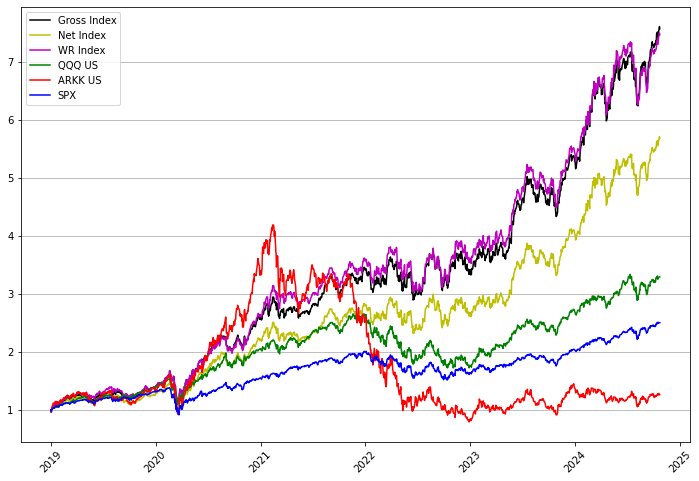

Performances:
            Gross Index  Net Index  WR Index  QQQ US    SPX  ARKK US
2019-12-31        37.38      25.14     37.91   38.41  31.09    33.75
2020-12-31        88.66      77.51     91.69   48.41  18.33   148.73
2021-12-31        31.55      25.72     34.83   27.42  28.73   -24.02
2022-12-31         0.03      -4.22      1.30  -32.58 -18.18   -66.97
2023-12-31        56.59      52.20     51.64   54.03  24.76    67.64
2024-12-31        41.66      39.44     36.28   21.11  22.72    -9.97


Volatilities:
            Gross Index  Net Index  WR Index  QQQ US    SPX  ARKK US
2019-12-31        22.87      22.75     22.64   18.41  13.93    29.59
2020-12-31        35.25      35.23     35.38   30.78  28.78    42.31
2021-12-31        24.97      24.97     25.35   22.47  18.05    40.34
2022-12-31        26.18      26.17     25.95   27.29  20.43    57.77
2023-12-31        25.43      25.42     25.06   23.55  17.73    49.32
2024-12-31        21.74      21.74     21.57   17.73  12.79    37.66


Dr

,WR Betas,DR Betas,DR-D0 P&L (bps),WR-D0 P&L (bps)
Ideal,1.22,1.22,5.25,5.25
Market,1.0,1.0,-43.73,-43.73
Momentum,0.71,0.66,-3.36,-3.61
Beta,0.71,0.71,-8.52,-8.52
M2MP Velocity,0.23,0.37,4.57,2.84
Value,0.21,0.37,-5.1,-2.89
Pharmaceuticals,0.08,0.07,1.89,2.16
USGG2YR,0.06,0.16,-1.04,-0.39
US10YR RR,0.05,-0.0,-0.0,0.17
Application Software,0.03,0.02,0.28,0.41


In [67]:
# PORTFOLIO CONSTRUCTION W/ NAIVE INCREMENTAL MVO AND ESTIMATED ALPHAS, GENERAL AND X-SECTIONAL - NEW VAL ADJ

import pandas as pd
import math
import numpy as np
import os
import csv
import yfinance as yf
import matplotlib.pyplot as plt
import psycopg2
import requests
import json
import tkinter as tk
import re
from datetime import datetime
from datetime import timedelta
from datetime import date
from sklearn.linear_model import Ridge
from sqlalchemy import create_engine
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import r2_score
from scipy import optimize 
from scipy.optimize import linprog
import warnings


def annual_reports(SummaryP_df, anchor):
        
    SummaryP_df.index = SummaryP_df.index.map(lambda x: datetime(x.year, x.month, x.day))
    SummaryPY_df = SummaryP_df.resample('Y').last()
    SummaryPY_df.loc[SummaryP_df.index[0]] = 1
    SummaryPY_df = SummaryPY_df.sort_index()
    SummaryPY_df = round(100 * SummaryPY_df.pct_change(), 2).dropna()
    print('Performances:')
    print(SummaryPY_df)
    print('')

    SummaryV_df = round(100 * SummaryP_df.pct_change().ewm(halflife = 84).std() * np.sqrt(252), 2).dropna()
    SummaryVY_df = round(SummaryV_df.resample('Y').mean(), 2)
    print('')
    print('Volatilities:')
    print(SummaryVY_df)
    print('')

    SummaryD_df = round(100 * (SummaryP_df / SummaryP_df.rolling(252, min_periods = 21).max() - 1), 2).dropna()
    SummaryDY_df = SummaryD_df.resample('Y').min()
    print('')
    print('Drawdowns:')
    print(SummaryDY_df)
    print('')

    SummaryC_df = round(100 * ((SummaryP_df[1: ].T ** (252 / SummaryP_df[1:].index.map(lambda x: (x - SummaryP_df.index[0]).days).values)).T - 1), 2)
    SummaryCY_df = SummaryC_df.resample('Y').last()
    print('')
    print('CAGR:')
    print(SummaryCY_df)
    print('')

    SummaryCDY_df = round(SummaryCY_df / abs(SummaryDY_df), 2)
    print('')
    print('CAGR/DD:')
    print(SummaryCDY_df)
    print('')

    SummarySY_df = round(SummaryPY_df / abs(SummaryVY_df), 2)
    print('')
    print('Sharpe:')
    print(SummarySY_df)
    print('')

    SummaryCorr_df = SummaryP_df.rolling(252).corr(SummaryP_df[anchor].rolling(252))
    SummaryCorrY_df = SummaryCorr_df.resample('Y').mean()
    SummaryBY_df = round(SummaryCorrY_df * (SummaryVY_df.T / SummaryVY_df[anchor]).T, 2)
    print('')
    print('Betas ' + anchor + ':')
    print(SummaryBY_df)
    print('')

    SummaryAY_df = round(SummaryPY_df - (SummaryBY_df.T * SummaryPY_df[anchor]).T, 2)
    print('')
    print('Alphas ' + anchor + ':')
    print(SummaryAY_df)    
                
    return

def predictors_to_Cfeatures(pred_df, c_features_l, sector_s):
    
    exp_g = 10
    m_omd = 5
    IDwinsor_L = 0.025
    IDwinsor_H = 0.990
    winsor_L = 0.01
    Vwinsor_H = 0.90
    IQuant = 10
    field_l = ['GS', 'GGP', 'GE', 'G', 'G Vol', 'G r2', 'E Vol', 'S Vol', 'OM', 'OMp', 'ROIp', 'ROIdp', 'Alloc']    
    sc_df = pd.DataFrame(np.nan, index = pred_df.index, columns = field_l)

    pred_df['P/Ee'][pred_df['P/Ee'] < 0] = abs(pred_df['P/Ee'][pred_df['P/Ee'] < 0]) * 100
    pred_df['P/Eo'][pred_df['P/Eo'] < 0] = abs(pred_df['P/Eo'][pred_df['P/Eo'] < 0]) * 100
    pred_df['P/GP'][pred_df['P/GP'] < 0] = abs(pred_df['P/GP'][pred_df['P/GP'] < 0]) * 100
    pred_df['P/S'][pred_df['P/S'] < 0] = abs(pred_df['P/S'][pred_df['P/S'] < 0]) * 100
    pred_df['sP/E'][pred_df['sP/E'] < 0] = abs(pred_df['sP/E'][pred_df['sP/E'] < 0]) * 100
    pred_df['sP/S'][pred_df['sP/S'] < 0] = abs(pred_df['sP/S'][pred_df['sP/S'] < 0]) * 100
    pred_df['sP/GP'][pred_df['sP/GP'] < 0] = abs(pred_df['sP/GP'][pred_df['sP/GP'] < 0]) * 100
    pred_df = fix_na(pred_df, 'r2 S', 'r2 GP')
    pred_df = fix_na(pred_df, 'GS', 'GGP')
    aux_df = pred_df[['sP/S', 'sP/GP']]
    ratio = aux_df.median()['sP/GP'] / aux_df.median()['sP/S']
    aux_df['sP/S'] *= ratio
    aux_df = aux_df.T.fillna(method = 'ffill').T
    pred_df['sP/GP'] = aux_df['sP/GP']

    featuresC_df = pd.DataFrame(np.nan, index = pred_df.index, columns = c_features_l)

    sc_df['GS'] = pred_df['GS']
    sc_df['GGP'] = pred_df['GGP']
    sc_df['GE'] = pred_df['GE']
    sc_df['G'] = pred_df[['GE','GGP', 'GS']].min(axis = 1)
    sc_df['G Vol'] = pred_df[['GE','GGP', 'GS']].std(axis = 1)
    sc_df['G r2'] = pred_df[['r2 S', 'r2 GP', 'r2 E']].mean(axis = 1)
    sc_df['E Vol'] = pred_df['E Vol'].map(lambda x: max(1, x / 100))
    sc_df['S Vol'] = pred_df['S Vol'].map(lambda x: max(1, x / 100))
    sc_df['OM'] = pred_df['OM-t0'].map(lambda x: min(x, 60))
    sc_df['OMp'] = pred_df['OMd'].map(lambda x: min(x, 0))
    sc_df['ROIp'] = pred_df['ROI-P'].map(lambda x: min(x, 0))
    sc_df['ROIdp'] = pred_df['ROId'].map(lambda x: min(x, 0))
    sc_df['G r2'] = sc_df['G r2'].replace({-np.inf: 1})
    sc_df['Alloc'] = (25 * sc_df['G'] * (sc_df['G r2'] ** 5) / sc_df['E Vol'] / sc_df['S Vol'] + 
                      5 * sc_df['OM'] + 50 * sc_df['OMp'] + 50 * sc_df['ROIp'] + 50 * sc_df['ROIdp'])
    
    featuresC_df['Ideal'] = winsorize(sc_df['Alloc'], IDwinsor_L, IDwinsor_H)

    Value_s = (3 * pred_df['sP/E'] + pred_df['sP/GP']) / 4
    featuresC_df['Value'] = -winsorize(Value_s, winsor_L, Vwinsor_H) 
    featuresC_df['Size'] = -pd.Series(np.log(pred_df['Size']), index = pred_df.index)

    featuresC_df -= featuresC_df.mean()
    featuresC_df /= featuresC_df.std()
    featuresC_df = featuresC_df.fillna(0)
    
    return featuresC_df

def predictors_to_Mfeatures(MacroPxs_df, sPxs_df, m_features_l, sector_s):
        
    MacroPxs_df['US10YR RR'] = MacroPxs_df['USGG10YR'] - MacroPxs_df['T10YIE']
    MacroPxs_df['YC'] = MacroPxs_df['USGG10YR'] - MacroPxs_df['USGG2YR']
    MacroPxs_df['2Y IR Vol'] = MacroPxs_df['USGG2YR'].ewm(halflife = hl).std() * np.sqrt(252)
    MacroPxs_df = MacroPxs_df.loc[sPxs_df.index]
    MacroPxs_df = (MacroPxs_df - MacroPxs_df.ewm(halflife = hl).mean())
    MacroPxs_df = MacroPxs_df.pct_change()

    MacroFactor_df = pd.DataFrame(np.nan, index = sPxs_df.columns, columns = m_features_l)
    for c_mf in m_features_l:
        c_mf_s = sPxs_df.pct_change().join(MacroPxs_df[c_mf])[-hl:].cov()[c_mf].drop(c_mf)    
        featVar_s = MacroPxs_df[c_mf].ewm(halflife = hl).var().iloc[-1]
        MacroFactor_df[c_mf] = c_mf_s / featVar_s

    for c_feat in m_features_l:
        MacroFactor_df[c_feat] = winsorize(MacroFactor_df[c_feat], winsor_L, winsor_H).values

    naT_l = MacroFactor_df.isna().sum(axis = 1)[MacroFactor_df.isna().sum(axis = 1) > 0].index
    naF_l = MacroFactor_df.loc[naT_l].T[MacroFactor_df.loc[naT_l].T.isna()].index.tolist()  
    MacroFactor_df.loc[naT_l, naF_l] = MacroFactor_df.median().values
    MacroFactor_df -= MacroFactor_df.mean()
    MacroFactor_df /= MacroFactor_df.std()

    return MacroFactor_df, MacroPxs_df[m_features_l]

def predictors_to_Pfeatures(sPxs_df, p_features_l, sector_s):

    lag_M1 = -252
    lag_M3 = -21
    beta_adj = True

    featuresP_df = pd.DataFrame(np.nan, index = sPxs_df.columns, columns = p_features_l)
    sRetPxs_df = sPxs_df.pct_change().dropna()
    sRetMkt_s = sMkt_s.pct_change().dropna()    
    sCovPxs_s = sRetPxs_df.ewm(halflife = hl).cov(sRetMkt_s.ewm(halflife = hl)).iloc[-1]
    sVarMkt = sRetMkt_s.ewm(halflife = hl).cov(sRetMkt_s.ewm(halflife = hl)).iloc[-1]
    featuresP_df['Beta'] = winsorize(sCovPxs_s / sVarMkt, 0, winsor_H)
    featuresP_df['Vol'] = -winsorize(sRetPxs_df.ewm(halflife = hl).std().iloc[-1], 0, winsor_H)
    Mom_s = pd.Series((featuresP_df.index.map(lambda x: sPxs_df[x].iloc[lag_M3]) / 
                       featuresP_df.index.map(lambda x: sPxs_df[x].iloc[lag_M1])), index = featuresP_df.index)
    featuresP_df['Momentum'] = winsorize(Mom_s, winsor_L, winsor_H)

    featuresP_df -= featuresP_df.mean()
    featuresP_df /= featuresP_df.std()
    
    return featuresP_df

def round_down(n, decimals = 0): 
    multiplier = 10 ** decimals 
    return int(math.floor(n * multiplier) / multiplier)

def Set_DF(dframe):
    
    dframe.index = dframe[dframe.columns.values.tolist()[0]]
    dframe.index.name = dframe.columns.values.tolist()[0]
    New_df = dframe.drop(dframe.columns.values.tolist()[0], axis=1)
    
    return New_df

def DD_Index(dframe):
    
    dframe['dummy'] = dframe.index
    dframe.drop_duplicates(['dummy'], inplace=True)
    dframe.drop('dummy', axis=1, inplace=True)
    New_df = dframe
    
    return New_df 

def open_df(*args):
    open_str = args[0]
    
    query_open = 'SELECT * FROM ' + open_str
    opened_df = pd.read_sql_query(query_open, engine)
    opened_df = Set_DF(opened_df)
    opened_df = DD_Index(opened_df)
    opened_df = opened_df.sort_index()
    
    return opened_df

def fix_na(base_df, col_b, col_t):

    aux = base_df[[col_b, col_t]]
    aux = aux.T.fillna(method = 'ffill').T
    base_df[col_t] = aux[col_t]
    
    return base_df

def winsorize(Rt_s, floor, cap):
    
    w_up = np.quantile(Rt_s.dropna().values, q = cap)
    w_down = np.quantile(Rt_s.dropna().values, q = floor)    
    w_s = Rt_s.clip(w_down, w_up)
    
    return w_s

def get_predictors(c_date, exclusion_l):
    
    rel_found = False
    count = 0
    attempts_cap = 30
    while (not rel_found) & (count < attempts_cap):
        try:
            pred_df = open_df('valuation_' + c_date.strftime('%Y%m%d') + selection_scope)
            rel_found = True            
        except:
            c_date = c_date - timedelta(1)
            c_date = c_date - timedelta((c_date.weekday() % 4) * (c_date.weekday() // 4))
            count += 1
    
    pred_df = pred_df.dropna(thresh = pred_df.shape[1] // 2)
    pred_df['P/Ee'][pred_df['P/Ee'] <= 0] = 100
    pred_df['P/Eo'][pred_df['P/Eo'] <= 0] = 100
    pred_df['P/S'][pred_df['P/S'] <= 0] = 100  
    exclusion_l = [t for t in exclusion_l if t in pred_df.index]
    pred_df = pred_df.drop(exclusion_l)
    
    return pred_df, c_date

def loadings(ret_s, res_s):
    
    Pbeta = 0
    PZ = 0      
    if (res_s.std() != 0):
        Pbeta = round(res_s.cov(ret_s) / (res_s.std() ** 2), 3)
        if (ret_s.std() != 0):        
            PZ = round(abs(Pbeta) / ((ret_s.std() ** 2) / (res_s.std() ** 2)), 3)
    
    return Pbeta, PZ

def mlr(ALLfeatures_df):
    
    model = LinearRegression()
    lr_mod = model.fit(ALLfeatures_df[all_features_l].values, ALLfeatures_df['Rt'].values)
    lr_values = lr_mod.predict(ALLfeatures_df[all_features_l].values)
    fRet_s = round(pd.Series(lr_mod.coef_, index = all_features_l), 3)
    fRet_s.name = 'MLR Factor Rets'
    fcast_s = pd.Series(lr_values, index = ALLfeatures_df.index)
    fcast_s.name = 'Ret Fcast'   
    y0 = lr_mod.intercept_
    mlr_r2 = round(100 * lr_mod.score(ALLfeatures_df[all_features_l].values, ALLfeatures_df['Rt'].values), 2)
    
    return fcast_s, fRet_s, y0, mlr_r2

def w_mlr(x_m, y_a, w_a, idx_l, c_l, itcp):
    
    model = LinearRegression(fit_intercept = itcp)
    lr_mod = model.fit(x_m, y_a, w_a)
    lr_values = lr_mod.predict(x_m)
    fRet_s = pd.Series(lr_mod.coef_, index = c_l)    
    fcast_s = pd.Series(lr_values, index = idx_l)
    fRet_s.name = 'wMLR Factor Rets'
    fcast_s.name = 'wMLR Ret Fcast'   
    y0 = lr_mod.intercept_
    mlr_r2 = round(100 * lr_mod.score(x_m, y_a, w_a), 2)
    
    return fcast_s, fRet_s, y0, mlr_r2

def ridge(x_m, y_a, idx_l, c_l):
    
    xv_n = 10
    ridge_n = 30
    step = 3  
    lambda_penalty = 10
    
    lambda_array = np.arange(ridge_n)
    lambda_array = lambda_array[::step]
    x_df = pd.DataFrame(x_m.T)
    y_df = pd.DataFrame(y_a.T)

    cv_mse_df = pd.DataFrame(np.nan, index = lambda_array, columns = ['Train', 'Val'])
    beta_df = pd.DataFrame(np.nan, index = lambda_array, columns = np.arange(x_df.shape[1]).tolist() + ['df'])
    val_r2 = np.inf
    shift_lambda = False
    for c_lambda in lambda_array:
        if (shift_lambda):
            c_lambda += lambda_penalty
        try:        
            Rmodel = Ridge(alpha = c_lambda, normalize = False, tol = 0.001, solver = 'auto', random_state = 42)
            valRMSE_tot = 0
            trainRMSE_tot = 0
            for c in np.arange(xv_n):
                init_v = xv_n * c
                end_v = init_v + xv_n
                valX_df = x_df.iloc[init_v: end_v]
                valY_df = y_df.iloc[init_v: end_v]
                trainX_df = x_df.drop(valX_df.index)
                trainY_df = y_df.drop(valX_df.index)

                I_m = np.identity(trainX_df.shape[1])
                lambda_matrix = I_m * np.array([c_lambda] * trainX_df.shape[1])
                beta_array = np.linalg.inv((trainX_df.T.values.dot(trainX_df.values)) + lambda_matrix).dot(trainX_df.T.values.dot(trainY_df.values))
                hat_matrix = (trainX_df.values).dot(np.linalg.inv((trainX_df.T.values.dot(trainX_df.values)) + lambda_matrix)).dot(trainX_df.T.values)        

                if (c == 0):
                    edf = np.trace(hat_matrix)
                    beta_df.loc[c_lambda] = pd.DataFrame(beta_array)[0].tolist() + [edf]

                ridge_mod = Rmodel.fit(trainX_df.values, trainY_df.values)
                trainRidge_f = ridge_mod.predict(trainX_df.values)
                valRidge_f = ridge_mod.predict(valX_df.values)
                trainRidge_mse = np.sum((trainY_df.values - trainRidge_f) ** 2)
                valRidge_mse = np.sum((valY_df.values - valRidge_f) ** 2)
                trainRMSE_tot += trainRidge_mse 
                valRMSE_tot += valRidge_mse 
            cv_mse_df.loc[c_lambda, 'Train'] = 100 * trainRMSE_tot / xv_n
            cv_mse_df.loc[c_lambda, 'Val'] = 100 * valRMSE_tot / xv_n
            if (valRMSE_tot < val_r2):
                bestRidge_f = ridge_mod.predict(x_df.values)
                bestRidge_fr = pd.DataFrame(beta_array)[0].values
                bestLambda = c_lambda
                Rintercept = ridge_mod.intercept_
                val_r2 = valRMSE_tot
                best_edf = edf
        except:
            val_r2 = np.inf
            shift_lambda = True
            print('Ridge lambda' + str(c_lambda) + ' singular!!')            

    bestRidgeRt_s = pd.Series(pd.DataFrame(bestRidge_f)[0].values, index = idx_l)
    bestRidgeFS_s = pd.Series(bestRidge_fr, index = c_l)
    bestRidgeFS_s.name = 'Ridge Factor Rets'
    beta_df.index = beta_df['df']
    beta_df = beta_df.drop(['df'], axis = 1)
    beta_df.sort_index().plot(figsize = (12, 8))
    plt.show()
    cv_mse_df['Val'].plot(figsize = (12, 8), c = 'r')
    plt.title('Ridge, df = ' + str(round(best_edf, 2)) + ' out of ' + str(x_m.shape[0]))
    plt.show()
    Ridge_r2 = round(100 * (pd.DataFrame(bestRidge_f).join(y_df, rsuffix = '_label').corr().iloc[0, 1] ** 2), 3)

    return bestRidgeRt_s, bestRidgeFS_s, Rintercept, Ridge_r2, bestLambda

def interest_pxs(port_s, Pxs_df):

    add_l = [t for t in port_s.index if t not in Pxs_df.columns]       
    compPx_df = pd.DataFrame(np.nan, index = Pxs_df.index[-long_w: ], columns = ['dummy'])
    for missing_t in add_l:
        try:
            ticker_s = yf.download([t_dikt[missing_t]], period = str(long_w + 200) + 'd')['Close']
            ticker_s.index = ticker_s.index.map(lambda x: x.date())
            ticker_s.name = missing_t
            compPx_df = compPx_df.join(ticker_s)
        except:
            print(missing_t + ' FAILED')
    
    compPx_df = compPx_df.fillna(method = 'bfill').fillna(method = 'ffill')
    IntPxs_df = Pxs_df.join(compPx_df)[port_s.index][-long_w:]
    IntPxs_df = IntPxs_df.fillna(method = 'bfill').fillna(method = 'ffill')
    
    return IntPxs_df

def calc_cov(port_s, cPort_s, IntPxs_df):

    missingA_l = [t for t in LJJPort_lastA_s.index if t not in cPort_s.index]
    mPort_s = pd.Series(cPort_s.median(), index = missingA_l)
    cPort_s = pd.concat([cPort_s, mPort_s]).sort_values()
    cov_df = IntPxs_df.pct_change()[-252:].ewm(halflife = hl).cov().loc[IntPxs_df.index[-1]]
    
    return cov_df, cPort_s

def MaximizeReturns(MeanReturns, PortfolioSize):
    
    c = (np.multiply(-1, MeanReturns))
    A = np.ones([PortfolioSize,1]).T
    b=[1]
    res = linprog(c, A_ub = A, b_ub = b, bounds = (0,1), method = 'highs') 
    
    return res

def MinimizeRisk(CovarReturns, PortfolioSize):
    
    def  f(x, CovarReturns):
        func = np.matmul(np.matmul(x, CovarReturns), x.T) 
        return func

    def constraintEq(x):
        A=np.ones(x.shape)
        b=1
        constraintVal = np.matmul(A,x.T)-b 
        return constraintVal
    
    xinit=np.repeat(0.1, PortfolioSize)
    cons = ({'type': 'eq', 'fun':constraintEq})
    lb = 0
    ub = 1
    bnds = tuple([(lb,ub) for x in xinit])

    opt = optimize.minimize (f, x0 = xinit, args = (CovarReturns),  bounds = bnds, \
                             constraints = cons, tol = 10**-3)
    
    return opt

def MinimizeRiskConstr(MeanReturns, CovarReturns, PortfolioSize, R):
    
    def  f(x,CovarReturns):
         
        func = np.matmul(np.matmul(x,CovarReturns ), x.T)
        return func

    def constraintEq(x):
        AEq=np.ones(x.shape)
        bEq=1
        EqconstraintVal = np.matmul(AEq,x.T)-bEq 
        return EqconstraintVal
    
    def constraintIneq(x, MeanReturns, R):
        AIneq = np.array(MeanReturns)
        bIneq = R
        IneqconstraintVal = np.matmul(AIneq,x.T) - bIneq
        return IneqconstraintVal
    

    xinit=np.repeat(0.1, PortfolioSize)
    cons = ({'type': 'eq', 'fun':constraintEq},
            {'type':'ineq', 'fun':constraintIneq, 'args':(MeanReturns,R) })
    lb = 0
    ub = 1
    bnds = tuple([(lb,ub) for x in xinit])

    opt = optimize.minimize (f, args = (CovarReturns), method ='trust-constr',  \
                        x0 = xinit,   bounds = bnds, constraints = cons, tol = 10**-3)
    
    return  opt

def MaximizeSharpeRatioOptmzn(MeanReturns, CovarReturns, RiskFreeRate, PortfolioSize):
    
    # define maximization of Sharpe Ratio using principle of duality
    def  f(x, MeanReturns, CovarReturns, RiskFreeRate, PortfolioSize):
        funcDenomr = np.sqrt(np.matmul(np.matmul(x, CovarReturns), x.T) )
        funcNumer = np.matmul(np.array(MeanReturns),x.T)-RiskFreeRate
        func = -(funcNumer / funcDenomr)
        return func

    #define equality constraint representing fully invested portfolio
    def constraintEq(x):
        A=np.ones(x.shape)
        b=1
        constraintVal = np.matmul(A,x.T)-b 
        return constraintVal
    
    
    #define bounds and other parameters
    xinit=np.repeat(0.33, PortfolioSize)
    cons = ({'type': 'eq', 'fun':constraintEq})
    lb = 0
    ub = 1
    bnds = tuple([(lb,ub) for x in xinit])
    
    #invoke minimize solver
    opt = optimize.minimize (f, x0 = xinit, args = (MeanReturns, CovarReturns,\
                             RiskFreeRate, PortfolioSize), method = 'SLSQP',  \
                             bounds = bnds, constraints = cons, tol = 10**-3)
    
    return opt

def BiCriterionFunctionOptmzn(MeanReturns, CovarReturns, RiskAversParam, PortfolioSize, AllocCap, AllocFloor):
       
    def  f(x, MeanReturns, CovarReturns, RiskAversParam, PortfolioSize):
        PortfolioVariance = np.matmul(np.matmul(x, CovarReturns), x.T) 
        PortfolioExpReturn = np.matmul(np.array(MeanReturns),x.T)
        func = RiskAversParam * PortfolioVariance - (1-RiskAversParam)*PortfolioExpReturn
        return func

    def ConstraintEq(x):
        A = np.ones(x.shape)
        b = 1
        constraintVal = np.matmul(A, x.T) - b 
        return constraintVal
    
    xinit=np.repeat(0.01, PortfolioSize)
    cons = ({'type': 'eq', 'fun':ConstraintEq})
    bnds = [(AllocFloor, AllocCap)] * PortfolioSize

    opt = optimize.minimize (f, x0 = xinit, args = ( MeanReturns, CovarReturns,\
                                                    RiskAversParam, PortfolioSize), \
                             method = 'SLSQP',  bounds = bnds, constraints = cons, \
                             tol = 10**-3)
    return opt

def mvo(alphas_s, Scov_m, LWcov_m, Fcov_m, PCAcov_m, r0, select_universe, port_size, AllocCap):
     
    cov_l = [Scov_m, LWcov_m, Fcov_m, PCAcov_m]
    sharpeMVO = True
    alloc_df = pd.DataFrame(np.nan, index = alphas_s.index, columns = ['Sample', 'LW', 'Fac', 'PCA'])
    
    for idx, cov_m in enumerate(cov_l):  
        
        alphas_a = alphas_s.values
        # MARKOWITZ, OPTIMAL EX-ANTE SHARPE
        if (sharpeMVO):            
            maxSharpeRatio = 0
            result = MaximizeSharpeRatioOptmzn(alphas_a, cov_m, r0 / 100, select_universe)
            markS_a = result.x
            Risk = markS_a.dot(cov_m).dot(markS_a.T) ** (1 / 2)
            expReturn = alphas_a.dot(markS_a.T)
            maxSharpeRatio = (np.array(expReturn) - r0) / Risk   
            markS_s = round(pd.Series(markS_a, index = alphas_s.index), 4).sort_values(ascending = False)

        # MARKOWITZ, CAPPED EX-ANTE PORTFOLIO VOL, ALLOCATION BOUNDS            
        xOptimal =[]
        minRiskPoint = []
        expPortfolioReturnPoint =[]
        for points in range(0, ra_scenarios):
            ra_p = points / ra_scenarios
            result = BiCriterionFunctionOptmzn(alphas_a, cov_m, ra_p, select_universe, AllocCap, AllocFloor)
            xOptimal.append(result.x)
        xOptimalArray = np.array(xOptimal)
        riskPoint = (np.diagonal(xOptimalArray.dot(cov_m).dot(xOptimalArray.T)) ** (1 / 2))
        retPoint= xOptimalArray.dot(alphas_a)
        riskRet_s = pd.Series(retPoint, index = riskPoint)
        C_volP_cap = max(volP_cap, riskRet_s.index.min())
        sharpe_s = pd.Series(riskRet_s[riskRet_s.index <= C_volP_cap].values / riskRet_s[riskRet_s.index <= C_volP_cap].index.values)
        best_c = sharpe_s.argmax()
        markSC_a = xOptimalArray[best_c]  
        markSC_s = round(pd.Series(markSC_a, index = alphas_s.index), 4).sort_values(ascending = False)

        if (sharpeMVO):
            alloc_s = (((9 * markSC_s + markS_s) / 10).sort_values()[-select_universe:] / 
                       ((9 * markSC_s + markS_s) / 10).sort_values()[-select_universe:].sum()).fillna(0)
        else:
            alloc_s = (markSC_s.sort_values()[-select_universe:] / markSC_s.sort_values()[-select_universe:].sum()).fillna(0)              
        alloc_df.loc[alloc_s.index, alloc_df.columns[idx]] = alloc_s
    
    alloc_df['Avg'] = alloc_df.mean(axis = 1)
    alloc_df = alloc_df.sort_values(by = ['Avg'], ascending = False)
    alloc_s = alloc_df['Avg']
        
    return alloc_s

def cap_sn(alloc_s):

    alloc_x = alloc_s[alloc_s > AllocCap]
    while (alloc_x.shape[0] > 0):
        alloc1_s = alloc_s[alloc_s <= AllocCap]
        alloc2_s = alloc_x - AllocCap
        excess = alloc2_s.sum()
        alloc1_s += (alloc1_s * excess) / alloc1_s.sum()
        alloc_x -= alloc2_s
        alloc_s = pd.concat([alloc1_s, alloc_x]).sort_values()    
        alloc_x = alloc_s[alloc_s > AllocCap]
        
    return alloc_s.sort_values(ascending = False)

def devAdj_size(SPxs_df, alloc_s):

    MAV_w = 63
    zs_cap = 3
    zs_floor = -2.0
    penalty_r = 2
    boost_r = 2

    allocPerf_s = (SPxs_df[alloc_s.index].iloc[-1] / SPxs_df[alloc_s.index][-MAV_w:].mean() - 1)
    vol_S = (SPxs_df[alloc_s.index].pct_change().ewm(halflife = MAV_w).std() * np.sqrt(10)).iloc[-1]
    MAVDev_S = round(allocPerf_s / vol_S, 3)
    penalty_s = (MAVDev_S - zs_cap).clip(0, 100)
    boost_s = (zs_floor - MAVDev_S).clip(0, 100)
    Fpenalty_s = pd.Series(np.exp(penalty_s.values / penalty_r), index = penalty_s.index)
    Fboost_s = pd.Series(np.exp(boost_s.values / boost_r), index = boost_s.index)
    Falloc_s = alloc_s / Fpenalty_s
    Falloc_s *= Fboost_s
    leaveOUT_l = Fpenalty_s[Fpenalty_s > 1].index.tolist() + Fboost_s[Fboost_s > 1].index.tolist() + Falloc_s[Falloc_s == AllocCap].index.tolist()
    adj_l = [t for t in Falloc_s.index if t not in leaveOUT_l]
    adj_size = 1 - Falloc_s.sum()
    Falloc_s.loc[adj_l] = Falloc_s.loc[adj_l] * (1 + adj_size / Falloc_s.loc[adj_l].sum())
    diff_s = round(Falloc_s - alloc_s, 2)
    Falloc_s.name = 'Alloc'
    if (abs(diff_s).sum() > 1):
        print('RELEVANT ADJUSTMENTS:')
        print(diff_s)
        print('')  
    
    return Falloc_s

def mean_rev(asset_l, SPS_df, SPGP_df, FPS_df, FPGP_df, PEGS_df, PEGGP_df, c):
    
    val_w = 126
    val_hl = 252
    val_m = 2
    highB = 10  
    lowB = 1.5

    secSPS_df = SPS_df.groupby(SPS_df.columns.map(lambda x: sector_s.loc[x]), axis = 1).mean()
    secSPGP_df = SPGP_df.groupby(SPGP_df.columns.map(lambda x: sector_s.loc[x]), axis = 1).mean()
    secFPS_df = FPS_df.groupby(FPS_df.columns.map(lambda x: sector_s.loc[x]), axis = 1).mean()
    secFPGP_df = FPGP_df.groupby(FPGP_df.columns.map(lambda x: sector_s.loc[x]), axis = 1).mean()
    secPEGS_df = PEGS_df.groupby(PEGS_df.columns.map(lambda x: sector_s.loc[x]), axis = 1).mean()
    secPEGGP_df = PEGGP_df.groupby(PEGGP_df.columns.map(lambda x: sector_s.loc[x]), axis = 1).mean()    

    val_s = pd.Series(0, index = pd.Index(asset_l, name = 'MeanR'))
    for ticker in asset_l:
        try:
            absSPS_s = SPS_df[ticker].fillna(method = 'ffill')    
            relSPS_s = (absSPS_s - secSPS_df[sector_s.loc[ticker]])
            mavSPS = absSPS_s[-val_w:].mean()
            DrelSPS = (relSPS_s.clip(0, 1) * (absSPS_s - mavSPS)).iloc[-1]
            
            try:
                absSPGP_s = SPGP_df[ticker].fillna(method = 'ffill')
                relSPGP_s = (absSPGP_s - secSPGP_df[sector_s.loc[ticker]])
                mavSPGP = absSPGP_s[-val_w:].mean()
                DrelSPGP = (relSPGP_s.clip(0, 1) * (absSPGP_s - mavSPGP)).iloc[-1]
            except:
                if (c == 1):
                    print('sGP failed for ' + ticker)
                relSPGP_s = relSPS_s.copy()
                DrelSPGP = DrelSPS.copy()

            absFPS_s = FPS_df[ticker].fillna(method = 'ffill')
            relFPS_s = (absFPS_s - secFPS_df[sector_s.loc[ticker]])
            mavFPS = absFPS_s[-val_w:].mean()
            DrelFPS = (relFPS_s.clip(0, 1) * (absFPS_s - mavFPS)).iloc[-1]

            try:
                absFPGP_s = sFPGP_df[ticker].fillna(method = 'ffill')
                relFPGP_s = (absFPGP_s - secFPGP_df[sector_s.loc[ticker]])
                mavFPGP = absFPGP_s[-val_w:].mean()
                DrelFPGP = (relFPGP_s.clip(0, 1) * (absFPGP_s - mavFPGP)).iloc[-1]
            except:
                if (c == 1):
                    print('fGP failed for ' + ticker)
                relFPGP_s = relFPS_s.copy()
                DrelFPGP = DrelFPS.copy()

            LTvalS = (relSPS_s - relSPS_s.ewm(halflife = val_hl).mean()).dropna().clip(0, highB).iloc[-1]
            LTvalGP = (relSPGP_s - relSPGP_s.ewm(halflife = val_hl).mean()).dropna().clip(0, highB).iloc[-1]
            STval = (DrelFPS + DrelFPGP)

            Tval = (((((min(max(LTvalS + LTvalGP, 0), 1)) * STval) + 1) ** val_m) - 1)
#           Tval = (max(min(((min(max(LTvalS + LTvalGP, 0), 1)) * STval), highB), lowB) - lowB) ** val_m 

            val_s.loc[ticker] = min(highB, max(0, round(Tval, 2)))                                             
        except:
            if (c == 1):
                print('MeanR error for ' + ticker)
            else:
                pass
        
    return val_s

def utilityF(ALLfeatures_df, select_universe, FactRets_df, Idio_df, PCAIdio_df, PCALoadings_df, 
             PCAFactorRets_df, dt, sector_s, port_size, SPS_df, SPGP_df, FPS_df, FPGP_df, PEGS_df, PEGGP_df):

    FactorCov = True
    xv_list = ['IdM w', 'IdP w', 'Alpha', 'Vol', 'BetaP', 'MomP', 'uS', 'uF', 'uP', 'uLW', 'UA']
    int_features_l = ['Momentum', 'Ideal']
    scope_features_l = int_features_l + m_features_l + ['Beta', 'Vol', 'Value']
    hl_idio = 126
    concentration_f = 3
    ideal_w = 10
    momentum_w = 5
    idioMLR_r = [1, 3, 5]
    idioPCA_r = [1, 3, 5]
    bp_m = 2
    mp_m = 1
    Awinsor_H = 0.995

    FactRets_df = FactRets_df.dropna(how = 'all')
    Idio_df = Idio_df.dropna(how = 'all')

    best_sharpe = -np.inf
    cv_df = pd.DataFrame(np.nan, index = np.arange(len(idioMLR_r) + len(idioPCA_r)) + 1, columns = xv_list)
    c = 1
    u_best = -np.inf
    for idioMLR_w in idioMLR_r:
        for idioPCA_w in idioPCA_r:
            IdealMLRfExp_s = round(100 * (ALLfeatures_df['Ideal'].clip(0, ALLfeatures_df['Ideal'].max()) * FactRets_df['Ideal'].ewm(halflife = hl_idio // 3).mean().iloc[-1] / 
                                          FactRets_df['Ideal'][-hl_idio:].ewm(halflife = hl_idio // 6).std().iloc[-1]).map(lambda x: max(0, x)), 2)
            MomMLRfExp_s = round(100 * (ALLfeatures_df['Momentum'].clip(0, ALLfeatures_df['Momentum'].max()) * FactRets_df['Momentum'].ewm(halflife = hl_idio // 3).mean().iloc[-1] / 
                                        FactRets_df['Momentum'][-hl_idio:].ewm(halflife = hl_idio // 6).std().iloc[-1]).map(lambda x: max(0, x)), 2)
            IdioMLR_s = round(100 * Idio_df.dropna(how = 'all')[-hl_idio:].ewm(halflife = hl_idio // 3).mean().iloc[-1].dropna() / 
                              Idio_df.dropna(how = 'all')[-hl_idio:].ewm(halflife = hl_idio // 6).std().iloc[-1].dropna(), 2)
            IdioPCA_s = round(100 * PCAIdio_df.dropna(how = 'all')[-hl_idio:].ewm(halflife = hl_idio // 3).mean().iloc[-1].dropna() / 
                              PCAIdio_df.dropna(how = 'all')[-hl_idio:].ewm(halflife = hl_idio // 6).std().iloc[-1].dropna(), 2)        

            IdealMLRfExp_s.name = 'Ideal'
            MomMLRfExp_s.name = 'Mom'
            IdioMLR_s.name = 'IdMLR'
            IdioPCA_s.name = 'IdPCA'

            IexpAlpha_df = pd.DataFrame(IdealMLRfExp_s).join(MomMLRfExp_s).join(IdioMLR_s).join(IdioPCA_s)
            expAlpha_df = IexpAlpha_df.sort_values(by = ['Ideal'], ascending = False)[:3 * select_universe]

            expAlpha_df['Ideal'] *= ideal_w / (ideal_w + momentum_w + idioMLR_w + idioPCA_w)
            expAlpha_df['Mom'] *= momentum_w / (ideal_w + momentum_w + idioMLR_w + idioPCA_w)
            expAlpha_df['IdMLR'] *= idioMLR_w / (ideal_w + momentum_w + idioMLR_w + idioPCA_w)        
            expAlpha_df['IdPCA'] *= idioPCA_w / (ideal_w + momentum_w + idioMLR_w + idioPCA_w)
            expAlpha_df['Sum'] = expAlpha_df.sum(axis = 1)  
            expAlpha_df['Sum'] = winsorize(expAlpha_df['Sum'], 0, Awinsor_H).map(lambda x: round(x, 2))

            cLport_s = expAlpha_df['Sum'].sort_values(ascending = False)[:select_universe]  
            cLport_s = cLport_s ** concentration_f
            cLport_s /= cLport_s.sum()
            cSport_s = cLport_s[:port_size].copy() 
            cSport_s /= cSport_s.sum()

            FactorLoadings_df = ALLfeatures_df.loc[cSport_s.index, FactRets_df.columns]
            FactorRet_df = pd.DataFrame(FactRets_df[-cov_lag:].values.dot(FactorLoadings_df.T.values), 
                                        index = FactRets_df[-cov_lag:].index, columns = FactorLoadings_df.index)  
            FBcov_df = FactorRet_df.ewm(halflife = hl).cov().loc[FactorRet_df.index[-1]] 

            PCARet_df = pd.DataFrame(PCALoadings_df.loc[cSport_s.index].values.dot(PCAFactorRets_df[-cov_lag:][PCAFactorRets_df.columns[:PCALoadings_df.shape[1]]].T), 
                                     index = cSport_s.index, columns = PCAFactorRets_df[-cov_lag:].index).T
            PCACov_df = PCARet_df.ewm(halflife = hl).cov().loc[PCARet_df.index[-1]]        

            SBcorr_m = np.triu(Pxs_df[cSport_s.index].pct_change()[-cov_lag:].ewm(halflife = hl).corr().loc[Pxs_df.index[-1]])
            avg_corr = (np.sum(SBcorr_m) - SBcorr_m.shape[0]) / ((SBcorr_m.shape[0] * (SBcorr_m.shape[0] - 1)) / 2)
            corr_df = pd.DataFrame(np.identity(cSport_s.shape[0]), index = cSport_s.index, columns = cSport_s.index).replace({0: avg_corr})
            std_s = Pxs_df[cSport_s.index].pct_change()[-cov_lag:].ewm(halflife = hl).std().iloc[-1]
            LWCov_df = (std_s.values.T * corr_df).T * std_s

            SBcov_df = Pxs_df[cSport_s.index].pct_change()[-cov_lag:].ewm(halflife = hl).cov().loc[Pxs_df.index[-1]]

            beta_p = (cSport_s * (ALLfeatures_df['Beta'].loc[cSport_s.index] ** 2)).sum() * bp_m
            mom_p = (cSport_s * (ALLfeatures_df['Momentum'].loc[cSport_s.index] ** 2)).sum() * mp_m
            Alpha_p = (cSport_s * cLport_s.loc[cSport_s.index]).sum()
            volS_p = (cSport_s.values.dot(SBcov_df.values).dot(cSport_s.values) * 252) ** (1 / 2) * 100
            volF_p = (cSport_s.values.dot(FBcov_df.values).dot(cSport_s.values) * 252) ** (1 / 2) * 100
            volP_p = (cSport_s.values.dot(PCACov_df.values).dot(cSport_s.values) * 252) ** (1 / 2) * 100
            us_p = Alpha_p * (1 - cSport_s.values.dot(SBcov_df.values).dot(cSport_s.values) * 21 * 100 * (1 / 2)) - beta_p - mom_p
            uf_p = Alpha_p * (1 - cSport_s.values.dot(FBcov_df.values).dot(cSport_s.values) * 21 * 100 * (1 / 2)) - beta_p - mom_p
            up_p = Alpha_p * (1 - cSport_s.values.dot(PCACov_df.values).dot(cSport_s.values) * 21 * 100 * (1 / 2)) - beta_p - mom_p
            ulw_p = Alpha_p * (1 - cSport_s.values.dot(LWCov_df.values).dot(cSport_s.values) * 21 * 100 * (1 / 2)) - beta_p - mom_p
            uA_p = (us_p + uf_p + up_p + ulw_p) / 3 + abs(min(us_p, uf_p, up_p, ulw_p))

            cv_df.loc[c, 'IdM w'] = idioMLR_w
            cv_df.loc[c, 'IdP w'] = idioPCA_w
            cv_df.loc[c, 'Alpha'] = round(Alpha_p, 2)
            cv_df.loc[c, 'Vol'] = round((volS_p + volF_p + volP_p) / 3, 2)
            cv_df.loc[c, 'BetaP'] = round(beta_p, 2)
            cv_df.loc[c, 'MomP'] = round(mom_p, 2)
            cv_df.loc[c, 'uS'] = round(us_p, 2)
            cv_df.loc[c, 'uF'] = round(uf_p, 2)
            cv_df.loc[c, 'uP'] = round(up_p, 2)
            cv_df.loc[c, 'uLW'] = round(ulw_p, 2)        
            cv_df.loc[c, 'UA'] = round(uA_p, 2)
            if (uA_p > u_best):
                FexpAlpha_df = expAlpha_df.loc[cLport_s.index]              
                Lport_s = cLport_s.copy()            

            c += 1

    return FexpAlpha_df, Lport_s, cv_df

def on_selection_models(value):
    global target_model
    target_model = value
    root.destroy()
    
def clean_dates(dt_range, exclusionDates_l):
    
    auxDt_s = pd.Series(dt_range)
    auxDt_s.index = pd.Series(dt_range).map(lambda x: x.strftime('%m%d')).tolist()
    validDT_l = [d for d in auxDt_s.index.tolist() if d not in exclusionDates_l]
    dt_range = sorted(pd.unique(auxDt_s.loc[validDT_l].tolist()).tolist())
    
    return dt_range    
    
def start_models(dt_range, Sectors_df, Pxs_df, FactorRets_df, IdioRets_df):      
        
    sector_s = Sectors_df[Sectors_df[target_class].isna() == False][target_class]
    for idx, c_dt in enumerate(dt_range):  
        p_dt = Pxs_df.index[Pxs_df.index.tolist().index(c_dt) - 1]
        valid_start = False 
        pred_dt = c_dt
        while (not valid_start):
            pred_df, c_date = get_predictors(pred_dt, exclusion_l)
            exc_ffields = [f for f in all_fundamentals_l if f not in pred_df.columns]
            exc_tickers = [t for t in pred_df.index if t not in sector_s.index]
            if (len(exc_ffields) == 0):
                pred_df = pred_df.drop(exc_tickers)
                valid_start = True
                print('Fundamentals date: ' + c_date.strftime('%d-%b-%Y'))
            else:
                pred_dt = Pxs_df[Pxs_df.index < pred_dt].index[-1]
                
        sPxs_df = Pxs_df[Pxs_df.index < c_dt][-long_w: ]
        Check_s = round(100 * sPxs_df[pred_df.index].pct_change().rolling(volCheck_w).std().iloc[-1], 4)
        SBweights_s = np.log(pred_df['Size'])
        sizeExc_l = SBweights_s[SBweights_s.replace({np.inf: np.nan, -np.inf: np.nan}).isna()].index.tolist()
        zeroVol_l = Check_s[Check_s == 0].index.tolist()
        excall_l = pd.unique(sizeExc_l + zeroVol_l).tolist()
        pred_df = pred_df.drop(excall_l)
        asset_l = pred_df.index.tolist()

        FlatWeights_s = pd.Series(1, index = pred_df.index)       
        sIdioRets_df = IdioRets_df[IdioRets_df.index < c_dt].dropna(how = 'all')
        if (sIdioRets_df.shape[0] >= (2 * hl)):
            print('idio var weights')
            var_s = sIdioRets_df[-252:][asset_l].ewm(halflife = hl).var().iloc[-1]
            mean_var = var_s.mean()
            VBWeights_s = var_s.fillna(mean_var) ** (-1)
            VBWeights_s /= VBWeights_s.std()
            Weights_s = VBWeights_s[asset_l]        
        else:
            print('size weights')
            Weights_s = SBweights_s[asset_l].copy()
        w_s = Weights_s ** (1 / 2)

        MacroPxs_df = Pxs_df[Pxs_df.index < c_dt][macroFeatures_l][-long_w: ]
        sPxs_df = Pxs_df[Pxs_df.index < c_dt][-long_w: ][asset_l]
        sMkt_s = Pxs_df[Pxs_df.index < c_dt][-long_w: ][anchor_asset]

        ## LOADINGS ENGINEERING, TIME SERIES

        featuresP_df = predictors_to_Pfeatures(sPxs_df, p_features_l, sector_s)
        featuresC_df = predictors_to_Cfeatures(pred_df, c_features_l, sector_s)
        featuresM_df, MacroFeatures_df = predictors_to_Mfeatures(MacroPxs_df, sPxs_df, m_features_l, sector_s)
        XSStyleLoadings_df = featuresP_df.join(featuresC_df)

        ## INTERCEPT, BETA RETURNS AND RESIDUALS, CROSS SECTION: SIMPLE LINEAR MODEL (LN(MKT CAP) AS WEIGHTS) - 1

        XSMktRet = Pxs_df[anchor_asset].loc[c_dt] / Pxs_df[anchor_asset].loc[p_dt] - 1    
        RawAssetRets_s = Pxs_df[asset_l].loc[c_dt] / Pxs_df[asset_l].loc[p_dt] - 1    
        XSAssetRets = winsorize(RawAssetRets_s, winsor_L, winsor_H)
        XSAssetRets.name = 'Rt'

        # FACTOR ORTHOGONALIZATION

        sBetas_s = featuresP_df['Beta']
        FactorLoadings_df = pd.DataFrame(sBetas_s)

        sIdeal_s = featuresC_df['Ideal']
        FactorLoadings_df[sIdeal_s.name] = othogonalize(FactorLoadings_df, sIdeal_s)    

        XSSectorLoadings_df = pd.DataFrame(0, index = asset_l, columns = sector_l)
        for c_sector in sector_l:
            stock_l = [t for t in asset_l if t in sector_s[sector_s == c_sector].index]
            XSSectorLoadings_df.loc[stock_l, c_sector] = 1   
        XSSectorLoadings_df = (XSSectorLoadings_df - XSSectorLoadings_df.mean())
        sectorR_l = sector_l.copy()
        sectorR_l.remove(sacr_sector)
        for c_sector in sectorR_l:
            FactorLoadings_df[c_sector] = othogonalize(FactorLoadings_df, XSSectorLoadings_df[c_sector]).values        

        sSize_s = featuresC_df['Size']
        FactorLoadings_df[sSize_s.name] = othogonalize(FactorLoadings_df, sSize_s)

        for c_Sfeat in XSStyleLoadings_df.columns:
            if (c_Sfeat not in FactorLoadings_df.columns):
                FactorLoadings_df[c_Sfeat] = othogonalize(FactorLoadings_df, XSStyleLoadings_df[c_Sfeat]).values

        for c_Mfeat in m_features_l:
            FactorLoadings_df[c_Mfeat] = othogonalize(FactorLoadings_df, featuresM_df[c_Mfeat]).values

        FactorLoadings_df['Market'] = 1
        x = FactorLoadings_df.copy()

        # MULTI-VARIATE REGRESSION, ORTHOGONAL BASIS, NO INTERCEPT

        if (ridge_b):
            aXSOStockRet_s, aXSOFacRet_s, aXSOy0, aXSOmlr_r2, aXSOLambda = ridge2(FactorLoadings_df, XSAssetRets, w_s, 
                                                                                  asset_l, FactorLoadings_df.columns.tolist())    
        else:
            aXSOStockRet_s, aXSOFacRet_s, aXSOy0, aXSOmlr_r2 = w_mlr2(FactorLoadings_df.values, XSAssetRets.values, w_s.values, 
                                                                      asset_l, FactorLoadings_df.columns.tolist(), False)
        aXSOFacRet_s.loc[sacr_sector] = 0    
        FactorLoadings_df[sacr_sector] = XSSectorLoadings_df[sacr_sector]
        FactorRets_df.loc[c_dt] = aXSOFacRet_s

        IdioRets_df.loc[c_dt, asset_l] = RawAssetRets_s - (FactorLoadings_df * FactorRets_df.loc[c_dt]).sum(axis = 1)
        modelR2 = round(100 * (FactorLoadings_df * FactorRets_df.loc[c_dt]).sum(axis = 1).corr(RawAssetRets_s) ** 2, 2)

        if (len(dt_range) == 1):
            print('r2: ' + str(modelR2))
            print('')
            RawAssetRets_s.hist(bins = 30)
            plt.title('Dist of Returns')
            plt.show()
            IdioRets_df.iloc[-1].hist(bins = 30)
            plt.title('Dist of Residuals')
            plt.show()        
        else:
            print(c_dt.strftime('%d-%b-%y') + ' r2: ' + str(modelR2))
        print('Sum of sectors: ' + str(round(100 * FactorRets_df[sector_l].iloc[-1].sum(), 2)) + '%') 
        dSummary_df = pd.DataFrame(round(100 * FactorRets_df.loc[c_dt], 2))
        if (target_class == 'Custom Sector 1'):
            ETFRets_s = pd.Series(100 * (FactorRets_df[sector_l].columns.map(lambda x: Pxs_df.loc[c_dt, sector_ETF_map[x]]) / 
                              FactorRets_df[sector_l].columns.map(lambda x: Pxs_df.loc[p_dt, sector_ETF_map[x]]) - 1).values, 
                              index = sector_l)
            ETFRets_s.name = 'ETFs'
            dSummary_df = pd.DataFrame(round(100 * FactorRets_df.loc[c_dt], 2))
            dSummary_df['ETF Rets'] = np.nan
            dSummary_df.loc[sector_l, 'ETF Rets'] = round(ETFRets_s, 2)
        print('Daily Factor Rets:')
        print(dSummary_df)
        print('')

    FactorRets_df = FactorRets_df.sort_index()
    IdioRets_df = IdioRets_df.sort_index()
    if (len(dt_range) > 0): 
        FactorRets_df.to_sql('factor_returns' + factExt + secExt, engine, index = True, if_exists = 'replace')
        IdioRets_df.to_sql('idio_returns' + factExt + secExt, engine, index = True, if_exists = 'replace')
                    
    return FactorRets_df, IdioRets_df

def trading_costs(a_port, p_port):
    
    trade_cost = 0.20
    
    incl_l = [t for t in p_port.index if t not in a_port.index]
    incl_s = pd.Series(0, index = incl_l)
    a_port = pd.concat([a_port, incl_s])
    a_port.name = 'CPort'
    p_port.name = 'PPort'
    trade_df = pd.DataFrame(a_port).join(p_port).fillna(0).sort_values(by = ['CPort'], ascending = False)
    trade_df = round(100 * trade_df, 2)
    trade_df['Trade'] = trade_df['CPort'] - trade_df['PPort']
    turnover = abs(trade_df['Trade']).sum()
    t_cost = turnover * trade_cost / 100
    
    return trade_df, t_cost, turnover

def othogonalize(cbasis_df, newF_s):
    
    ortF_model = LinearRegression(fit_intercept = True)
    residualF_a = newF_s.values
    for c_basis in cbasis_df.columns:
        x_a = cbasis_df[c_basis].values.reshape(-1, 1)
        y_a = residualF_a
        ortF_m = ortF_model.fit(x_a, residualF_a)
        spanned_a = ortF_m.predict(x_a)
        residualF_a -= spanned_a
    orthogonal_s = pd.Series(residualF_a, index = newF_s.index)

    return orthogonal_s 

def rebalancing(selectionN_df, selectionA_df):

    rebFrequency_d = 5
    averaging_period = 1
    averaging_p = True

    selectionN_df = selectionN_df.dropna(how = 'all')
    selectionA_df = selectionA_df.dropna(how = 'all')
    dt_l = selectionN_df.index[1:].tolist()
    reb_dt_l = dt_l[:: rebFrequency_d]
    perfSummary_df = pd.DataFrame(0, index = selectionN_df.index, columns = ['Gross Index', 'Net Index', 'WR Index', 'Port Turnover (%)', 'TCost (%)', 'WR PT (%)', 'WR TC (%)'])
    perfSummary_df.iloc[0]['Gross Index'] = 1
    perfSummary_df.iloc[0]['Net Index'] = 1
    perfSummary_df.iloc[0]['WR Index'] = 1
    p_dt = selectionN_df.index[0]
    wra_dt = selectionN_df.index[0]
    wrp_dt = wra_dt
    wrp_port = pd.Series(selectionA_df.loc[wrp_dt].dropna().values, index = selectionN_df.loc[wrp_dt].dropna().values)
    wra_port = pd.Series(selectionA_df.loc[wra_dt].dropna().values, index = selectionN_df.loc[wra_dt].dropna().values)
    for a_dt in dt_l:    
        a_port = pd.Series(selectionA_df.loc[a_dt].dropna().values, index = selectionN_df.loc[a_dt].dropna().values)
        p_port = pd.Series(selectionA_df.loc[p_dt].dropna().values, index = selectionN_df.loc[p_dt].dropna().values)        
        g_index = (((p_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / p_port.index.map(lambda x: Pxs_df.loc[p_dt, x]) - 1) * 
                   p_port).sum() + 1) * perfSummary_df.loc[p_dt, 'Gross Index']      
        Ap_port = p_port * (p_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / p_port.index.map(lambda x: Pxs_df.loc[p_dt, x]))
        Ap_port /= Ap_port.sum()
        DRtrade_df, t_cost, turnover = trading_costs(a_port, Ap_port)
        perfSummary_df.loc[a_dt, 'Port Turnover (%)'] = turnover
        perfSummary_df.loc[a_dt, 'TCost (%)'] = t_cost    
        perfSummary_df.loc[a_dt, 'Gross Index'] = g_index
        perfSummary_df.loc[a_dt, 'Net Index'] = (g_index * (perfSummary_df.loc[p_dt, 'Net Index'] / 
                                                            perfSummary_df.loc[p_dt, 'Gross Index']) - t_cost / 100)         
        if (a_dt in reb_dt_l):        
            wra_dt = a_dt
            wra_port = pd.Series(selectionA_df.loc[wra_dt].dropna().values, index = selectionN_df.loc[wra_dt].dropna().values)
            if (averaging_p):            
                for i in np.arange(min(averaging_period, selectionN_df[selectionN_df.index < a_dt].shape[0]))[1:]:
                    pAvg_dt = selectionN_df.index[selectionN_df.index.tolist().index(wra_dt) - i]
                    pAvg_port = pd.Series(selectionA_df.loc[pAvg_dt].dropna().values, index = selectionN_df.loc[pAvg_dt].dropna().values)

                    incl_l = [t for t in pAvg_port.index if t not in wra_port.index]
                    incl_s = pd.Series(0, index = incl_l)
                    wra_port = pd.concat([wra_port, incl_s])
                    incl_l = [t for t in wra_port.index if t not in pAvg_port.index]
                    incl_s = pd.Series(0, index = incl_l)
                    pAvg_port = pd.concat([pAvg_port, incl_s])    
                    wra_port += pAvg_port

                wra_port = wra_port.sort_values(ascending = False)[:port_size] / wra_port.sort_values(ascending = False)[:port_size].sum()
                wra_port = cap_sn(wra_port)               

        wr_index = (((wrp_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / wrp_port.index.map(lambda x: Pxs_df.loc[wrp_dt, x]) - 1) * 
                     wrp_port).sum() + 1) * perfSummary_df.loc[wrp_dt, 'WR Index']     
        if (a_dt in reb_dt_l):
            Awrp_port = wrp_port * (wrp_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / wrp_port.index.map(lambda x: Pxs_df.loc[wrp_dt, x]))    
            Awrp_port /= Awrp_port.sum()
            WRtrade_df, wrt_cost, wr_turnover = trading_costs(wra_port, Awrp_port)
        else:
            WRtrade_df, wrt_cost, wr_turnover = trading_costs(wra_port, wrp_port)
        perfSummary_df.loc[a_dt, 'WR PT (%)'] = wr_turnover
        perfSummary_df.loc[a_dt, 'WR TC (%)'] = wrt_cost    
        perfSummary_df.loc[a_dt, 'WR Index'] = wr_index - wrt_cost / 100    

        if (a_dt == dt_l[-1]):
            allLPTickers_s = pd.Series(pd.unique(DRtrade_df.index.tolist() + 
                                                 WRtrade_df.index.tolist())).map(lambda x: x.split(' ')[0]).tolist()
            LPTickersPxs_s = yf.download(allLPTickers_s, period = '1d')['Adj Close'].T

            last_DRport_df = pd.DataFrame(round(100 * p_port, 2).values, index = p_port.index, columns = ['P Al'])
            last_DRres_s = p_port * (p_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / 
                                     p_port.index.map(lambda x: Pxs_df.loc[p_dt, x]) - 1)
            lastDailyDR_df = pd.DataFrame(round(pd.Series(100 * (DRtrade_df.index.map(lambda x: Pxs_df.loc[a_dt, x]) / DRtrade_df.index.map(lambda x: Pxs_df.loc[p_dt, x]) - 1)), 2).values, 
                                          index = DRtrade_df.index, columns = ['Daily'])      
            last_DRres_df = pd.DataFrame(round(100 * last_DRres_s, 2), columns = ['LD Ct'])
            DRSummary_df = DRtrade_df.join(last_DRport_df).join(lastDailyDR_df).join(last_DRres_df).fillna(0)
            DRSummary_df['LC Pxs'] = DRSummary_df.index.map(lambda x: round(Pxs_df.loc[a_dt, x], 2))
            DRSummary_df['RT Pxs'] = DRSummary_df.index.map(lambda x: round(LPTickersPxs_s.loc[x.split(' ')[0]][0], 2))
            DRSummary_df['RT'] = pd.Series(round(pd.Series(100 * (DRtrade_df.index.map(lambda x: LPTickersPxs_s.loc[x.split(' ')[0]][0]) / 
                                                                  DRtrade_df.index.map(lambda x: Pxs_df.loc[a_dt, x]) - 1)), 2).values, index = DRtrade_df.index)                
            DRSummary_df['RT Ct'] = (p_port * DRSummary_df['RT']).fillna(0).map(lambda x: round(x, 2))
            DRSummary_df.loc['Total'] = '' 
            DRSummary_df.loc['Total', 'LD Ct'] = round(100 * last_DRres_s.sum(), 2)
            DRSummary_df.loc['Total', 'RT Ct'] = (p_port * DRSummary_df['RT']).fillna(0).map(lambda x: round(x, 2)).sum()

            last_WRport = wra_port * (wra_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / 
                                      wra_port.index.map(lambda x: Pxs_df.loc[wra_dt, x]))
            last_WRport = round(100 * (last_WRport / last_WRport.sum()).sort_values(ascending = False), 2)
            last_WRport_df = pd.DataFrame(last_WRport, columns = ['P Al'])
            lastInd_s = wrp_port * wrp_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / wrp_port.index.map(lambda x: Pxs_df.loc[wra_dt, x])
            prevInd_s = wrp_port * wrp_port.index.map(lambda x: Pxs_df.loc[p_dt, x]) / wrp_port.index.map(lambda x: Pxs_df.loc[wra_dt, x])        
            RTInd_s = wrp_port * wrp_port.index.map(lambda x: LPTickersPxs_s.loc[x.split(' ')[0]][0]) / wrp_port.index.map(lambda x: Pxs_df.loc[wra_dt, x])        
            lastDailyWR_df = pd.DataFrame(round(pd.Series(100 * (wrp_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) / wrp_port.index.map(lambda x: Pxs_df.loc[p_dt, x]) - 1)), 2).values, 
                                          index = wrp_port.index, columns = ['Daily'])        
            last_WRres_df = pd.DataFrame(round(100 * (lastInd_s - prevInd_s), 2), columns = ['LD Ct'])
            WRSummary_df = WRtrade_df.join(last_WRport_df).join(lastDailyWR_df).join(last_WRres_df)
            WRSummary_df['LC Pxs'] = WRSummary_df.index.map(lambda x: round(Pxs_df.loc[a_dt, x], 2))
            WRSummary_df['RT Pxs'] = WRSummary_df.index.map(lambda x: round(LPTickersPxs_s.loc[x.split(' ')[0]][0], 2))        
            WRSummary_df['RT'] = pd.Series(round(pd.Series(100 * (wrp_port.index.map(lambda x: LPTickersPxs_s.loc[x.split(' ')[0]][0]) / 
                                                                  wrp_port.index.map(lambda x: Pxs_df.loc[a_dt, x]) - 1)), 2).values, index = wrp_port.index)         
            WRSummary_df['RT Ct'] = round(100 * (RTInd_s - lastInd_s), 2)
            WRSummary_df.loc['Total'] = ''
            WRSummary_df.loc['Total', 'LD Ct'] = round(100 * (lastInd_s - prevInd_s).sum(), 2)
            WRSummary_df.loc['Total', 'RT Ct'] = round(100 * (RTInd_s - lastInd_s).sum(), 2)

        p_dt = a_dt
        wrp_dt = wra_dt
        wrp_port = wra_port.copy()
        
    return perfSummary_df, DRSummary_df.fillna(0), WRSummary_df.fillna(0)

def w_mlr2(x_m, y_a, w_a, idx_l, c_l, itcp):
    
    model = LinearRegression(fit_intercept = itcp)
    x_m = (x_m.T * w_a).T
    y_a = y_a * w_a
    lr_mod = model.fit(x_m, y_a)
    lr_values = lr_mod.predict(x_m) / w_a
    fRet_s = pd.Series(lr_mod.coef_, index = c_l)    
    fcast_s = pd.Series(lr_values, index = idx_l)
    fRet_s.name = 'wMLR Factor Rets'
    fcast_s.name = 'wMLR Ret Fcast'   
    y0 = lr_mod.intercept_
    mlr_r2 = round(100 * lr_mod.score(x_m, y_a), 2)
    
    return fcast_s, fRet_s, y0, mlr_r2

def ridge2(x_df, y_s, w_s, idx_l, c_l):
    
    xv_n = 10
    ridge_n = 30
    step = 3  
    lambda_penalty = 10
    
    lambda_array = np.arange(ridge_n)
    lambda_array = lambda_array[::step]
    x_df = (x_df.T * w_s).T
    y_s = y_s * w_s 
    y_s.name = 'Labels'

    cv_mse_df = pd.DataFrame(np.nan, index = lambda_array, columns = ['Train', 'Val'])
    beta_df = pd.DataFrame(np.nan, index = lambda_array, columns = np.arange(x_df.shape[1]).tolist() + ['df'])
    val_r2 = np.inf
    shift_lambda = False
    for c_lambda in lambda_array:
        if (shift_lambda):
            c_lambda += lambda_penalty
        try:        
            Rmodel = Ridge(alpha = c_lambda, normalize = False, tol = 0.001, solver = 'auto', random_state = 42)
            valRMSE_tot = 0
            trainRMSE_tot = 0
            for c in np.arange(xv_n):
                init_v = xv_n * c
                end_v = init_v + xv_n
                valX_df = x_df.iloc[init_v: end_v]
                valY_df = y_s.iloc[init_v: end_v]
                valW_s = w_s.iloc[init_v: end_v]
                trainX_df = x_df.drop(valX_df.index)
                trainY_df = y_s.drop(valY_df.index)
                trainW_s = w_s.drop(valW_s.index)

                I_m = np.identity(trainX_df.shape[1])
                lambda_matrix = I_m * np.array([c_lambda] * trainX_df.shape[1])
                beta_array = np.linalg.inv((trainX_df.T.values.dot(trainX_df.values)) + lambda_matrix).dot(trainX_df.T.values.dot(trainY_df.values))
                hat_matrix = (trainX_df.values).dot(np.linalg.inv((trainX_df.T.values.dot(trainX_df.values)) + lambda_matrix)).dot(trainX_df.T.values)        

                if (c == 0):
                    edf = np.trace(hat_matrix)
                    beta_df.loc[c_lambda] = pd.DataFrame(beta_array)[0].tolist() + [edf]

                ridge_mod = Rmodel.fit(trainX_df.values, trainY_df.values)
                trainRidge_f = ridge_mod.predict(trainX_df.values) / trainW_s.values
                valRidge_f = ridge_mod.predict(valX_df.values) / valW_s.values
                trainRidge_mse = np.sum((trainY_df.values - trainRidge_f) ** 2)
                valRidge_mse = np.sum((valY_df.values - valRidge_f) ** 2)
                trainRMSE_tot += trainRidge_mse 
                valRMSE_tot += valRidge_mse 
            cv_mse_df.loc[c_lambda, 'Train'] = 100 * trainRMSE_tot / xv_n
            cv_mse_df.loc[c_lambda, 'Val'] = 100 * valRMSE_tot / xv_n
            if (valRMSE_tot < val_r2):
                bestRidge_f = ridge_mod.predict(x_df.values) / w_s.values
                bestRidge_fr = pd.DataFrame(beta_array)[0].values
                bestLambda = c_lambda
                Rintercept = ridge_mod.intercept_
                val_r2 = valRMSE_tot
                best_edf = edf
        except:
            val_r2 = np.inf
            shift_lambda = True
            print('Ridge lambda' + str(c_lambda) + ' singular!!')            

    bestRidgeRt_s = pd.Series(pd.DataFrame(bestRidge_f)[0].values, index = idx_l)
    bestRidgeFS_s = pd.Series(bestRidge_fr, index = c_l)
    bestRidgeFS_s.name = 'Ridge Factor Rets'
    beta_df.index = beta_df['df']
    beta_df = beta_df.drop(['df'], axis = 1)
    beta_df.sort_index().plot(figsize = (12, 8))
    plt.legend().remove()
    plt.show()
    cv_mse_df['Val'].plot(figsize = (12, 8), c = 'r')
    plt.title('Ridge, df = ' + str(round(best_edf, 2)) + ' out of ' + str(x_df.shape[1]))
    plt.show()
    Ridge_r2 = round(100 * (pd.DataFrame(bestRidgeRt_s).join(y_s).corr().iloc[0, 1] ** 2), 3)

    return bestRidgeRt_s, bestRidgeFS_s, Rintercept, Ridge_r2, bestLambda

def on_selection_class(value):
    global target_class
    target_class = value
    root.destroy()

warnings.filterwarnings('ignore')
dbase = "visiblealpha_laptop"
conn = psycopg2.connect(host="localhost", user="postgres", password="akf7a7j5", dbname=dbase, port=5432)
cursor = conn.cursor()
cursor.execute("select relname from pg_class where relkind='r' and relname !~ '^(pg_|sql_)';")
tables_list = cursor.fetchall()
new_tables_list = list(pd.DataFrame(tables_list, columns=['Old'])['Old'])

cnxn_string = ("postgresql+psycopg2://{username}:{pswd}"
              "@{host}:{port}/{database}")

engine = create_engine(cnxn_string.format(
    username="postgres",
    pswd="akf7a7j5",
    host="localhost",
    port=5432,
    database=dbase))

today = date.today()
stocks = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Tickers_VA.csv")
all_tickers_l = stocks['tickers'].tolist()
selection_scope = ''
init_cap = 1000000
beta_w = 126
cov_lag = 252
long_w = 1000
q_quant = 30
hl = 42
volCheck_w = 10
port_size = 20
select_universe = 50
alloc_delta = 5
AllocCap = 0.100 #0.150
AllocFloor = 0.015
volP_cap = 25
ra_scenarios = 50
pastAlpha_floor = -10
mlr_w = 1
wmlr_w = 2
ridge_w = 1
winsor_L = 0.010
winsor_H = 0.990
factor_MIX = .75
val_w = 252
minP_scale = 10
mr_L = 1
mr_H = 5

val_adj = True
mvo_b = False
proportional_b = True
mix = True
fundamentalMix = True

sizeSTD_adj = True
cap_allocations = True
anchor_asset = 'SPX'
sacr_sector = 'Health Care'
ridge_b = True
factExt = ''
if (ridge_b):
    factExt = '_ridge'

riskFree_asset = 'USGG2YR'
t_dikt = {'CAPA US': 'QSI', 'MTTR US': 'MTTR', 'SIVB US': 'SIVB', 'ARKG US': 'ARKG', 'VKTX US': 'VKTX', 
          'CPRI US': 'CPRI', 'CLSK US': 'CLSK'}
exclusion_l = ['BABA US', 'XPEV US', 'NIO US', 'TME US', 'JD US', 'PDD US', 'VNET US', 'ZLAB US', 'WB US', 
               'OCFT US', 'BGNE US', 'MOMO US', 'ZTO US', 'NTES US']
macroFeatures_l = ['CRB Index Index Points', 'Brent USD/Bbl', 'M2CP Velocity', 'M2MP Velocity', 'T5YIFR', 'T10YIE', 'USGG2YR', 
                   'USGG10YR', 'VIX']
all_fundamentals_l = ['sP/S', 'sP/E', 'sP/GP', 'P/S', 'P/Ee', 'P/GP', 'P/Eo', 'OM-t0', 'OM', 'OMd', 'GS', 'GE', 'r2 S', 'r2 E', 
                      'GGP', 'r2 GP', 'Size', 'ROI-P', 'ROI', 'ROId','ROE-P', 'ROE', 'ROEd', 'S Vol', 'E Vol', 'GP Vol', 'r&d']
model_l = ['MLR', 'wMLR', 'Ridge', 'Mix']
exclusionDates_l = ['0704', '1225', '0101']

sector_ETF_map = {'Software': 'IGV US',
                 'Industrials': 'XLI US',
                 'Health Care': 'XLV US',
                 'Consumer Goods': 'XLP US',
                 'Hardware': 'SOXX US',
                 'Financials': 'XLF US',
                 'Consumer Services': 'XLY US',
                 'Energy': 'XLE US',
                 'Utilities': 'XLU US',
                 'Telecommunications': 'XLC US',
                 'Materials': 'XLB US'}


sectors = pd.read_csv(r"C:\Users\Utilizador\OneDrive\Documentos\Malta\Systematic\Custom_Segmentation.csv")
Sectors_df = pd.DataFrame(sectors)
Sectors_df = Set_DF(Sectors_df)
Sectors_df = DD_Index(Sectors_df)
class_list = Sectors_df.columns.tolist()

root = tk.Tk()
tkvar = tk.StringVar(root)
popupMenu = tk.OptionMenu(root, tkvar, *class_list, command = on_selection_class)
tk.Label(root, text = "Choose a classification: ").grid(row = 0, column = 0)
popupMenu.grid(row = 1, column = 0)
root.mainloop()

print(target_class)
print('')
secExt = '_cs' + target_class[-1]
sector_l = pd.unique(Sectors_df.dropna(subset = [target_class])[target_class]).tolist()
sector_s = Sectors_df[Sectors_df[target_class].isna() == False][target_class]
Pxs_df = open_df('prices_relation')


m_features_l = ['T10YIE', 'VIX', '2Y IR Vol', 'USGG2YR', 'US10YR RR', 'Brent USD/Bbl', 'M2MP Velocity']
c_features_l = ['Ideal', 'Size', 'Value']
p_features_l = ['Beta', 'Momentum', 'Vol'] 
SLICEall_features_l = ['Market'] + p_features_l + sector_l + c_features_l + m_features_l 
all_features_l = SLICEall_features_l.copy()

STdt_str = input('Enter Start Date (empty for 1st available or YY/MM/DD): ')
firstS_dt = False
try:
    st_date = datetime.strptime(STdt_str, "%y/%m/%d").date()
except:
    st_date = Pxs_df.index[-1]
    firstS_dt = True
    
ENdt_str = input('Enter End Date (empty for last or YY/MM/DD): ')
try:
    end_date = datetime.strptime(ENdt_str, "%y/%m/%d").date()
except:
    end_date = Pxs_df.index[-1]  

st_date = Pxs_df[Pxs_df.index >= st_date].index[0]
far_st_date = Pxs_df.index[Pxs_df.index.tolist().index(st_date) - (hl * 2)]
dt_range = Pxs_df[Pxs_df.index >= st_date][Pxs_df[Pxs_df.index >= st_date].index <= end_date].index.tolist() 
dt_range = clean_dates(dt_range, exclusionDates_l)
try:
    selectionN_df = open_df('idio_stock_selection' + factExt + secExt)
    selectionA_df = open_df('idio_stock_allocations' + factExt + secExt)
    if (firstS_dt):
        st_date = selectionN_df.index[0]
    oss = input('Override portfolio (Y/y or empty)? ').upper()
    if (oss == 'Y'):
        selectionN_df = pd.DataFrame(np.nan, index = dt_range, columns = np.arange(port_size) + 1)
        selectionA_df = pd.DataFrame(np.nan, index = dt_range, columns = np.arange(port_size) + 1)        
except:
    selectionN_df = pd.DataFrame(np.nan, index = dt_range, columns = np.arange(port_size) + 1)
    selectionA_df = pd.DataFrame(np.nan, index = dt_range, columns = np.arange(port_size) + 1)
dt_range = Pxs_df[Pxs_df.index >= far_st_date][Pxs_df[Pxs_df.index >= far_st_date].index <= end_date].index.tolist() 
dt_range = clean_dates(dt_range, exclusionDates_l)  
FselectionN_df = open_df('ideal_stock_selection')
FselectionA_df = open_df('ideal_stock_allocations')

try:
    FactRets_df = open_df('factor_returns' + factExt + secExt)    
    Idio_df = open_df('idio_returns' + factExt + secExt)
    missingDates_l = [d for d in dt_range if d not in FactRets_df.index]
except:
    missingDates_l = dt_range.copy()
    FactRets_df = pd.DataFrame(np.nan, index = pd.unique(dt_range).tolist(), columns = all_features_l)    
    Idio_df = pd.DataFrame(np.nan, index = pd.unique(dt_range).tolist(), columns = all_tickers_l) 

statistical_b = True
statistical_w = 0.5
if (statistical_b):
    try:
        PCAIdioRets_df = open_df('pca_idio_returns')
        PCAFactorRets_df = open_df('pca_factor_returns')
    except:
        statistical_b = False
else:
    PCAIdioRets_df = Idio_df.copy()
    PCAFactorRets_df = FactRets_df.copy()

if (len(missingDates_l) > 0):
    missingDates_l = sorted(missingDates_l)
    FactRets_df, Idio_df = start_models(missingDates_l, Sectors_df, Pxs_df, FactRets_df, Idio_df)

FactRets_df = FactRets_df.sort_index()
Idio_df = Idio_df.sort_index()

stock_dt_range = [d for d in dt_range if d not in selectionN_df.dropna(how = 'all').index]
stock_dt_range = sorted(pd.Series(stock_dt_range)[pd.Series(stock_dt_range) >= st_date].tolist())
PnLBreakdown_df = pd.DataFrame(0, index = stock_dt_range, columns = SLICEall_features_l + ['Idio'])
skip_dets = False
if (end_date not in stock_dt_range):
    stock_dt_range.append(end_date)
    skip_dets = True
    
SPS_df = open_df('valuation_sps')
SPGP_df = open_df('valuation_spgp')
FPS_df = open_df('valuation_fps')
FPGP_df = open_df('valuation_fpgp')
PEGS_df = open_df('valuation_pegs')
PEGGP_df = open_df('valuation_peggp')    

p_dt = Pxs_df[Pxs_df.index < stock_dt_range[0]].index[-1]
for idx, c_dt in enumerate(stock_dt_range):    
    print(c_dt.strftime('%d-%b-%y'))
    valid_start = False 
    mvo_good = False
    prop_good = False
    pred_dt = c_dt
    while (not valid_start):
        pred_df, c_date = get_predictors(pred_dt, exclusion_l)
        exc_ffields = [f for f in all_fundamentals_l if f not in pred_df.columns]
        exc_tickers = [t for t in pred_df.index if t not in sector_s.index]
        if (len(exc_ffields) == 0):
            pred_df = pred_df.drop(exc_tickers)
            valid_start = True
            print('Fundamentals date: ' + c_date.strftime('%d-%b-%Y'))
        else:
            pred_dt = Pxs_df[Pxs_df.index < pred_dt].index[-1]
            
    pca_dt = c_dt
    pca_found = False
    pca_c = 0
    while (not pca_found):
        try:
            PCALoadings_df = open_df('pca_loadings_' + pca_dt.strftime('%y%m%d'))
            pca_found = True
            print('PCA dt: ' + pca_dt.strftime('%d-%b-%Y'))
        except:
            pca_dt = Pxs_df[Pxs_df.index < pca_dt].index[-1]
            if (pca_c > 20):
                break
            pca_c += 1            
            
    sPxs_df = Pxs_df[Pxs_df.index < c_dt][-long_w: ]
    Check_s = round(100 * sPxs_df[pred_df.index].pct_change().rolling(volCheck_w).std().iloc[-1], 4)
    SBweights_s = np.log(pred_df['Size'])
    sizeExc_l = SBweights_s[SBweights_s.replace({np.inf: np.nan, -np.inf: np.nan}).isna()].index.tolist()
    zeroVol_l = Check_s[Check_s == 0].index.tolist()
    excall_l = pd.unique(sizeExc_l + zeroVol_l).tolist()
    pred_df = pred_df.drop(excall_l)
    asset_l = pred_df.index.tolist()
    FlatWeights_s = pd.Series(1, index = pred_df.index)

    MacroPxs_df = Pxs_df[Pxs_df.index < c_dt][macroFeatures_l][-long_w: ]
    sPxs_df = Pxs_df[Pxs_df.index < c_dt][-long_w: ][asset_l]
    sMkt_s = Pxs_df[Pxs_df.index < c_dt][-long_w: ][anchor_asset]
    
    featuresP_df = predictors_to_Pfeatures(sPxs_df, p_features_l, sector_s)
    featuresC_df = predictors_to_Cfeatures(pred_df, c_features_l, sector_s)
    featuresM_df, MacroFeatures_df = predictors_to_Mfeatures(MacroPxs_df, sPxs_df, m_features_l, sector_s)
    XSStyleLoadings_df = featuresP_df.join(featuresC_df)

    ## INTERCEPT, BETA RETURNS AND RESIDUALS, CROSS SECTION: SIMPLE LINEAR MODEL (LN(MKT CAP) AS WEIGHTS) - 1

    XSMktRet = Pxs_df[anchor_asset].loc[c_dt] / Pxs_df[anchor_asset].loc[p_dt] - 1    
    RawAssetRets_s = Pxs_df[asset_l].loc[c_dt] / Pxs_df[asset_l].loc[p_dt] - 1    
    XSAssetRets = winsorize(RawAssetRets_s, winsor_L, winsor_H)
    XSAssetRets.name = 'Rt'
    
    # FACTOR ORTHOGONALIZATION
    
    sBetas_s = featuresP_df['Beta']
    FactorLoadings_df = pd.DataFrame(sBetas_s)
    
    sIdeal_s = featuresC_df['Ideal']
    FactorLoadings_df[sIdeal_s.name] = othogonalize(FactorLoadings_df, sIdeal_s)    

    XSSectorLoadings_df = pd.DataFrame(0, index = asset_l, columns = sector_l)
    for c_sector in sector_l:
        stock_l = [t for t in asset_l if t in sector_s[sector_s == c_sector].index]
        XSSectorLoadings_df.loc[stock_l, c_sector] = 1   
    XSSectorLoadings_df = (XSSectorLoadings_df - XSSectorLoadings_df.mean())
    sectorR_l = sector_l.copy()
    sectorR_l.remove(sacr_sector)
    for c_sector in sectorR_l:
        FactorLoadings_df[c_sector] = othogonalize(FactorLoadings_df, XSSectorLoadings_df[c_sector]).values        

    sSize_s = featuresC_df['Size']
    FactorLoadings_df[sSize_s.name] = othogonalize(FactorLoadings_df, sSize_s)

    for c_Sfeat in XSStyleLoadings_df.columns:
        if (c_Sfeat not in FactorLoadings_df.columns):
            FactorLoadings_df[c_Sfeat] = othogonalize(FactorLoadings_df, XSStyleLoadings_df[c_Sfeat]).values

    for c_Mfeat in m_features_l:
        FactorLoadings_df[c_Mfeat] = othogonalize(FactorLoadings_df, featuresM_df[c_Mfeat]).values
        
    FactorLoadings_df['Market'] = 1
    FactorLoadings_df[sacr_sector] = XSSectorLoadings_df[sacr_sector]
    
    ALLfeatures_df = FactorLoadings_df.join(XSAssetRets)
    sFactRets_df = FactRets_df[FactRets_df.index < c_dt]
    sIdio_df = Idio_df[Idio_df.index < c_dt]
    sPCAIdioRets_df = PCAIdioRets_df[PCAIdioRets_df.index < c_dt]
    sPCAFactorRets_df = PCAFactorRets_df[PCAFactorRets_df.index < c_dt]    
    sSPS_df = SPS_df[SPS_df.index < c_dt]
    sSPGP_df = SPGP_df[SPGP_df.index < c_dt]
    sFPS_df = FPS_df[FPS_df.index < c_dt]
    sFPGP_df = FPGP_df[FPGP_df.index < c_dt]
    sPEGS_df = PEGS_df[PEGS_df.index < c_dt]
    sPEGGP_df = PEGGP_df[PEGGP_df.index < c_dt]        
    if (RawAssetRets_s.sum() != 0):   
        Fport_s = pd.Series(FselectionA_df.loc[c_dt].dropna().values, index = FselectionN_df.loc[c_dt].dropna().values)
        Fport_s.name = 'F Alloc'
        dropF = [t for t in Fport_s.index if t not in asset_l]
        Fport_s = Fport_s.drop(dropF)        
        r0 = Pxs_df.loc[c_dt, riskFree_asset]
        Weights_df, alphas_s, c_xVal_df = utilityF(ALLfeatures_df, select_universe, sFactRets_df, sIdio_df, 
                                                   sPCAIdioRets_df, PCALoadings_df, sPCAFactorRets_df, c_dt, 
                                                   sector_s, port_size, sSPS_df, sSPGP_df, sFPS_df, sFPGP_df, 
                                                   sPEGS_df, sPEGGP_df)
        iPort_s = alphas_s.copy()
        IntPxs_df = interest_pxs(iPort_s, sPxs_df)     

        if (mvo_b) | (mix):            
            try:
                cov_df = IntPxs_df.pct_change()[-cov_lag:].ewm(halflife = hl).cov().loc[IntPxs_df.index[-1]]
                Scov_m = cov_df.values * 21                

                avg_corr = pd.DataFrame(np.triu(IntPxs_df.pct_change()[-cov_lag:].ewm(halflife = hl).corr().loc[IntPxs_df.index[-1]].values), 
                                        index = IntPxs_df.columns, columns = IntPxs_df.columns).sum().sum() / ((IntPxs_df.shape[1] - 1) * 
                                                                                                               (1 + 1 * (IntPxs_df.shape[1] - 2) / 2))
                Std_a = IntPxs_df.pct_change()[-cov_lag:].ewm(halflife = hl).std().loc[IntPxs_df.index[-1]]
                MCorr_df = pd.DataFrame(np.identity(IntPxs_df.shape[1]), index = IntPxs_df.columns, columns = IntPxs_df.columns).replace({0: avg_corr})
                LWCov_df = (Std_a.T * MCorr_df).T * Std_a
                LW_coef = 0.5
                LWcov_m = (LW_coef * LWCov_df + (1 - LW_coef) * cov_df).values * 21 

                sFactorLoadings_df = FactorLoadings_df.loc[IntPxs_df.columns]
                FactorCov_df = pd.DataFrame(sFactRets_df[-cov_lag:].values.dot(sFactorLoadings_df.T.values), 
                                            index = sFactRets_df[-cov_lag:].index, columns = sFactorLoadings_df.index)  
                FactorCov_df = FactorCov_df.ewm(halflife = hl).cov().loc[FactorCov_df.index[-1]]
                Fcov_m = FactorCov_df.values * 21 
                
                PCARets_df = pd.DataFrame(PCALoadings_df.loc[alphas_s.index].values.dot(sPCAFactorRets_df[-cov_lag:][PCALoadings_df.columns].values.T).T, 
                                          index = sPCAFactorRets_df[-cov_lag:].index, columns = alphas_s.index)
                PCACov_df = PCARets_df.ewm(halflife = hl).cov().loc[PCARets_df.index[-1]]  
                PCAcov_m = PCACov_df.values * 21 
                    
                alloc_s = mvo(alphas_s, Scov_m, LWcov_m, Fcov_m, PCAcov_m, r0, select_universe, port_size, AllocCap)
                mvo_good = True
            except:
                print('Continuous MVO failed')
        if (proportional_b) | (mix):
            try:
                if (mvo_good):
                    alloc_s = pd.DataFrame(alphas_s).join(alloc_s, rsuffix = '_MVO').fillna(0).sum(axis = 1).sort_values(ascending = False)
                    alloc_s /= alloc_s.sum()
                else:
                    alloc_s = alphas_s / alphas_s.sum() 
                prop_good = True
                print(c_xVal_df)
                print('')
            except:
                print('Discrete MVO failed')
        if (fundamentalMix):
            try:
                mm = max(factor_MIX * (mvo_good + prop_good), 1)
                alloc_s = pd.DataFrame(mm * alloc_s).join(Fport_s, how = 'outer').fillna(0).sum(axis = 1).sort_values(ascending = False)
                alloc_s = alloc_s / alloc_s.sum()            
            except:
                print('Fundamentals failed')
        if (mvo_good) | (prop_good):
            meanR_s = mean_rev(alloc_s.index, sSPS_df, sSPGP_df, sFPS_df, sFPGP_df, sPEGS_df, sPEGGP_df, 1)
            alloc_s /= meanR_s.clip(mr_L, mr_H)
            alloc_s = alloc_s.sort_values(ascending = False)
            alloc_s = alloc_s[:port_size] / alloc_s[:port_size].sum()
            if (cap_allocations):
                alloc_s = cap_sn(alloc_s)   
            if (sizeSTD_adj):
                alloc_s = devAdj_size(sPxs_df, alloc_s) 
                alloc_s = cap_sn(alloc_s)                
            selectionN_df.loc[c_dt] = alloc_s.index.tolist() + [np.nan] * (selectionN_df.shape[1] - alloc_s.shape[0])
            selectionA_df.loc[c_dt] = alloc_s.tolist() + [np.nan] * (selectionA_df.shape[1] - alloc_s.shape[0])  
            
            FullP_df = round(Weights_df, 2).join(round(100 * alloc_s, 2), how = 'outer').fillna(0).sort_values(by = ['Alloc'], ascending = False)
            fwd21_s = round(pd.Series(100 * (FullP_df.index.map(lambda x: Pxs_df.loc[Pxs_df.index[Pxs_df.index.tolist().index(c_dt) + min(Pxs_df[Pxs_df.index > c_dt].shape[0], 21)], x])
                                             / FullP_df.index.map(lambda x: Pxs_df.loc[c_dt, x]) - 1), index = FullP_df.index), 2)
            fwd21_s.name = '1M Fwd'
            FullP_df['VA'] = meanR_s
            FullP_df = FullP_df.join(fwd21_s)
            FullP_df['Sector'] = FullP_df.index.map(lambda x: Sectors_df.loc[x, target_class][:10])
            print(FullP_df[:60])
            print('Check: ' + str(round(FullP_df['Alloc'].sum(), 0)))
            print('')
        else:
            selectionN_df.loc[c_dt] = selectionN_df.loc[p_dt]
            selectionA_df.loc[c_dt] = selectionA_df.loc[p_dt]
            print('REPEAT PREVIOUS!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')             
    else:
        if (idx > 0):
            selectionN_df.loc[c_dt] = selectionN_df.loc[p_dt]
            selectionA_df.loc[c_dt] = selectionA_df.loc[p_dt]
            print('REPEAT PREVIOUS!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!') 
        else:
            print('Skip ' + c_dt.strftime('%d-%b-%Y'))
    if (idx > 0):
        pPort_s = pd.Series(selectionA_df.loc[p_dt].values, index = selectionN_df.loc[p_dt]).dropna()
        DailyRet_s = 100 * FactRets_df.loc[c_dt]
        FactorExp_s = (pALLfeatures_df[DailyRet_s.index].loc[pPort_s.index].T * pPort_s).sum(axis = 1)
        FactorRet_s = (DailyRet_s * FactorExp_s)
        DailyPnL_s = round(((pPort_s.index.map(lambda x: Pxs_df.loc[c_dt, x]) / 
                             pPort_s.index.map(lambda x: Pxs_df.loc[p_dt, x]) - 1) * pPort_s) * 100, 2)
        idioDaily = round(DailyPnL_s.sum() - FactorRet_s.sum(), 2)  
        PnLBreakdown_df.loc[c_dt, SLICEall_features_l] = round(FactorRet_s, 2)
        PnLBreakdown_df.loc[c_dt, 'Idio'] = idioDaily
        cumulative_s = PnLBreakdown_df[:c_dt].sum()
        cumulative_s.name = 'Cumulative'
        PnLBreakdownSum_df = pd.DataFrame(PnLBreakdown_df.loc[c_dt].fillna(0)).join(cumulative_s)
        PnLBreakdownSum_df.loc['Total'] = PnLBreakdownSum_df.sum()
        print(round(PnLBreakdownSum_df, 2)) 
        print('')            

    pALLfeatures_df = ALLfeatures_df.copy()
    p_dt = c_dt        
                
selectionN_df = selectionN_df.sort_index() 
selectionA_df = selectionA_df.sort_index()
if (len(stock_dt_range) > 0):
    save_p = input('Save portfolio files? (Y/y or empty) ').upper()
    if (save_p == 'Y'):
        selectionN_df.to_sql('idio_stock_selection' + factExt + secExt, engine, index = True, if_exists = 'replace')
        selectionA_df.to_sql('idio_stock_allocations' + factExt + secExt, engine, index = True, if_exists = 'replace')    

pnl_s = pd.Series(np.nan, index = selectionN_df.index)
pnl_s.iloc[0] = 1
pnl_s.name = 'IDIO'
for idx, c_dt in enumerate(pnl_s.index[1:]):
    p_dt = pnl_s.index[idx]
    pnl_s.loc[c_dt] = (((selectionN_df.loc[p_dt].dropna().map(lambda x: Pxs_df.loc[c_dt, x]) / 
                         selectionN_df.loc[p_dt].dropna().map(lambda x: Pxs_df.loc[p_dt, x]) - 1) * 
                        selectionA_df.loc[p_dt].dropna()).sum() + 1) * pnl_s.loc[p_dt]
    
qqq_s = Pxs_df[Pxs_df.index >= pnl_s.index[0]]['QQQ US']
qqq_s /= qqq_s.iloc[0]
spx_s = Pxs_df[Pxs_df.index >= pnl_s.index[0]]['SPX']
spx_s /= spx_s.iloc[0]
arkk_s = Pxs_df[Pxs_df.index >= pnl_s.index[0]]['ARKK US']
arkk_s /= arkk_s.iloc[0]    

#TRANSACTION COSTS & REBALANCING STRATEGY

perfSummary_df, DRtrade_df, WRtrade_df = rebalancing(selectionN_df, selectionA_df)
avg_turnover = round(perfSummary_df['Port Turnover (%)'].mean(), 2)
ttl_costs = round(perfSummary_df['TCost (%)'].sum(), 2)
wr_avg_turnover = round(perfSummary_df['WR PT (%)'].mean(), 2)
wr_ttl_costs = round(perfSummary_df['WR TC (%)'].sum(), 2)
print('')
print('Average F Daily Turnover (%): ' + str(avg_turnover))
print('Total F Costs (%): ' + str(ttl_costs))
print('Average F Annual Costs (%): ' + str(round(252 * ttl_costs / perfSummary_df.shape[0], 2)))
print('Average WR Daily Turnover (%): ' + str(wr_avg_turnover))
print('Total WR Costs (%): ' + str(wr_ttl_costs))
print('Average WR Annual Costs (%): ' + str(round(252 * wr_ttl_costs / perfSummary_df.shape[0], 2)))
print('')
print(c_dt.strftime('%d-%b-%Y') + ' DAILY Summary - WR:')
print(WRtrade_df)
print('')
print(c_dt.strftime('%d-%b-%Y') + ' DAILY Summary - DR:')
print(DRtrade_df)
print('')

print(c_dt.strftime('%d-%b-%Y') + ' DRG Daily P&L: ' + 
      str(round(100 * (perfSummary_df['Gross Index'].iloc[-1] / perfSummary_df['Gross Index'].iloc[-2] - 1), 2)))
print(c_dt.strftime('%d-%b-%Y') + ' DRN Daily P&L: ' + 
      str(round(100 * (perfSummary_df['Net Index'].iloc[-1] / perfSummary_df['Net Index'].iloc[-2] - 1), 2)))
print(c_dt.strftime('%d-%b-%Y') + ' WR Daily P&L: ' + 
      str(round(100 * (perfSummary_df['WR Index'].iloc[-1] / perfSummary_df['WR Index'].iloc[-2] - 1), 2)))
print(c_dt.strftime('%d-%b-%Y') + ' SPX Daily P&L: ' + str(round(100 * (spx_s.iloc[-1] / spx_s.iloc[-2] - 1), 2)))
print(c_dt.strftime('%d-%b-%Y') + ' QQQ Daily P&L: ' + str(round(100 * (qqq_s.iloc[-1] / qqq_s.iloc[-2] - 1), 2)))
print(c_dt.strftime('%d-%b-%Y') + ' ARKK Daily P&L: ' + str(round(100 * (arkk_s.iloc[-1] / arkk_s.iloc[-2] - 1), 2)))
print('')

print('MOST FREQUENT NAMES:')
print(selectionN_df.stack().value_counts()[:50])
print('')
if (len(stock_dt_range) > 0) & (not skip_dets):
    print('CUMULATIVE P&L BREAKDOWN:')
    print(round(PnLBreakdown_df.sum(), 2))
    print('')
    print('LAST DAY P&L BREAKDOWN:')
    print(round(PnLBreakdown_df.iloc[-1], 2))
    print('')
    
indexes_df = perfSummary_df.T[perfSummary_df.columns.map(lambda x: x.find('Index')) != -1].T    
indexes_df['Gross Index'].plot(figsize = (12, 8), c = 'k')
indexes_df['Net Index'].plot(c = 'y')
indexes_df['WR Index'].plot(c = 'm')
(Pxs_df['QQQ US'].loc[indexes_df.index] / Pxs_df['QQQ US'].loc[indexes_df.index].iloc[0]).plot(c = 'g')
(Pxs_df['ARKK US'].loc[indexes_df.index] / Pxs_df['ARKK US'].loc[indexes_df.index].iloc[0]).plot(c = 'r')
(Pxs_df['SPX'].loc[indexes_df.index] / Pxs_df['SPX'].loc[indexes_df.index].iloc[0]).plot(c = 'b').legend(loc = 'best')
plt.grid(axis = 'y')
plt.xticks(rotation = 45)
plt.show()        

SummaryP_df = indexes_df.join(qqq_s).join(spx_s).join(arkk_s)
annual_reports(SummaryP_df, 'SPX')

DRbetas_s = (ALLfeatures_df.drop(['Rt'], axis = 1).loc[DRtrade_df[DRtrade_df.index.map(lambda x: x.find('Total')) == -1].index].T * 
             DRtrade_df[DRtrade_df.index.map(lambda x: x.find('Total')) == -1]['CPort'] / 
             DRtrade_df[DRtrade_df.index.map(lambda x: x.find('Total')) == -1]['CPort'].sum()).T.sum().sort_values(ascending = False).map(lambda x: round(x, 2))

WRbetas_s = (ALLfeatures_df.drop(['Rt'], axis = 1).loc[WRtrade_df[WRtrade_df.index.map(lambda x: x.find('Total')) == -1].index].T * 
             WRtrade_df[WRtrade_df.index.map(lambda x: x.find('Total')) == -1]['CPort'] / 
             WRtrade_df[WRtrade_df.index.map(lambda x: x.find('Total')) == -1]['CPort'].sum()).T.sum().sort_values(ascending = False).map(lambda x: round(x, 2))

All_df = pd.DataFrame(WRbetas_s.values, index = WRbetas_s.index, columns = ['WR Betas'])
All_df['DR Betas'] = DRbetas_s
All_df['DR-D0 P&L (bps)'] = round(10000 * DRbetas_s * FactRets_df.iloc[-1], 2)
All_df['WR-D0 P&L (bps)'] = round(10000 * WRbetas_s * FactRets_df.iloc[-1], 2)
All_df.loc['Total'] = ''
All_df.loc['Total', 'DR-D0 P&L (bps)'] = round(10000 * (DRbetas_s * FactRets_df.iloc[-1]).sum(), 2)
All_df.loc['Total', 'WR-D0 P&L (bps)'] = round(10000 * (WRbetas_s * FactRets_df.iloc[-1]).sum(), 2)

DRIdio = round(DRtrade_df.loc['Total', 'LD Ct'] * 100 - All_df.loc['Total', 'DR-D0 P&L (bps)'], 2)
WRIdio = round(WRtrade_df.loc['Total', 'LD Ct'] * 100 - All_df.loc['Total', 'WR-D0 P&L (bps)'], 2)
print('')
print('DR Idio ' + c_dt.strftime('%d-%b-%y') + ': ' + str(DRIdio))
print('WR Idio ' + c_dt.strftime('%d-%b-%y') + ': ' + str(WRIdio))
print('')
All_df